In [2]:
import csv
import numpy as np
import cv2
import sys
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
frame_count = 0

images_names_list = glob.glob("/Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/camera_cal/*.jpg")




In [3]:
def rgb2bgr(image):
    image_tmp = np.zeros_like(image)
    image_tmp[:,:,2] = image[:,:,0]
    image_tmp[:,:,1] = image[:,:,1]
    image_tmp[:,:,0] = image[:,:,2]
    plt.imshow(image_tmp)
    return image_tmp


# Creating a Object point

In [4]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((9*6,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)



In [5]:
def normalize_minMAx(image):
    min_val = image.min()
    #print(min_val)
    max_val = image.max()
   # print(max_val)
   # print((255*(image-min_val)/max_val).astype(np.uint8))
    image_normalize = (255*((image-min_val)/max_val)).astype(np.uint8)
    #print(image_normalize)
    return image_normalize
    
    

In [6]:
def normalize_absolate(image):
    
    image_absolute = np.absolute(image)
    image_scale = np.uint8(255*image_absolute/np.max(image_absolute))
    return image_scale

In [7]:
#objp

In [8]:
def threshold_images(image, min_threshold=20,max_threshold=100):
    image_tmp = np.zeros_like(image)
    image_tmp[(image>=min_threshold) &(image<=max_threshold)]=1
    return image_tmp

In [9]:
def show_image(image,image_name='image'):
    cv2.destroyAllWindows()
    cv2.imshow(image_name,image)
    cv2.waitKey(0)

In [10]:
def show_image_plt(image):
    plt.figure()
    plt.imshow(image)

In [11]:
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    grey = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    if orient =='x':
        sobel_gradient=cv2.Sobel(grey,cv2.CV_64F,1,0)
    elif orient =='y':
        sobel_gradient=cv2.Sobel(grey,cv2.CV_64F,0,1)
    else:
        print("Wrong orient value")
    sobel_gradient_abs = np.absolute(sobel_gradient)
    sobel_scale = np.uint8(255*sobel_gradient_abs/np.max(sobel_gradient_abs))
    mask_image = np.zeros_like(sobel_scale)
    mask_image[(sobel_scale >= thresh_min) & (sobel_scale <= thresh_max)] = 1
    return mask_image

In [12]:
# read images
object_points =[]  #3D points
image_points=[]    #2D points

for image_path in images_names_list:
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    #print(image.shape)
    retval,corners = cv2.findChessboardCorners(gray,(9,6),None)
    #print(image_path,retval)
    if retval == True:
        object_points.append(objp)
        #cv2.cornerSubPix(gray,(11,11),(-1,-1),criteria)
        image_points.append(corners)
    cv2.drawChessboardCorners(image, (9,6), corners,retval)
    #show_image(image,"image name")
    #break
     #retval, corners
cv2.destroyAllWindows()



# Camera Calibration

In [13]:
retval, cameraMatrix, distCoeffs, rvecs, tvecs=cv2.calibrateCamera(object_points, image_points, gray.shape[::-1],None,None)

# UnDistort chessboard images

In [14]:
def undistort_Image(image,cameraMatrix,distCoeffs):
    return cv2.undistort(image,cameraMatrix,distCoeffs,None)
    

# Undistort the all the chess board images

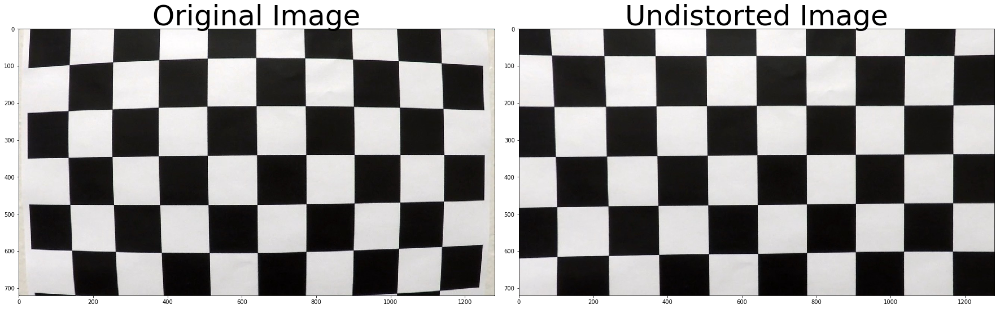

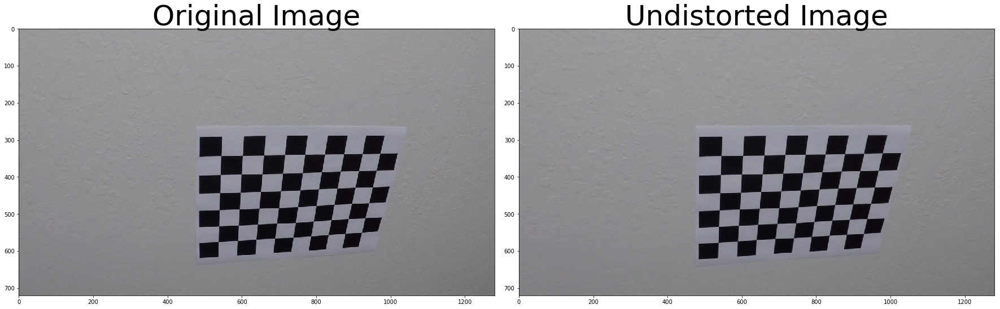

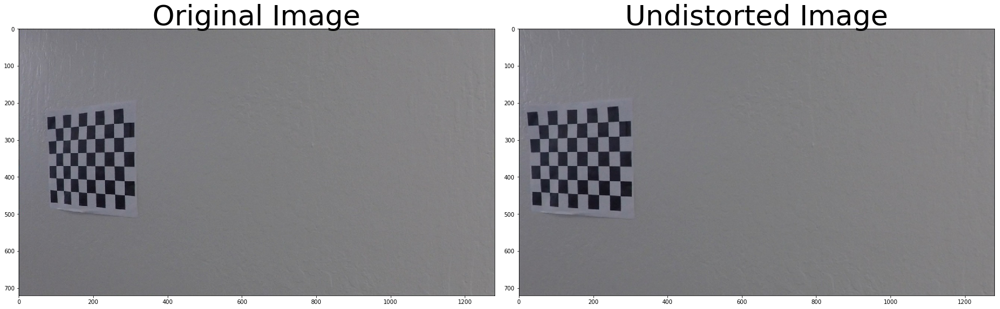

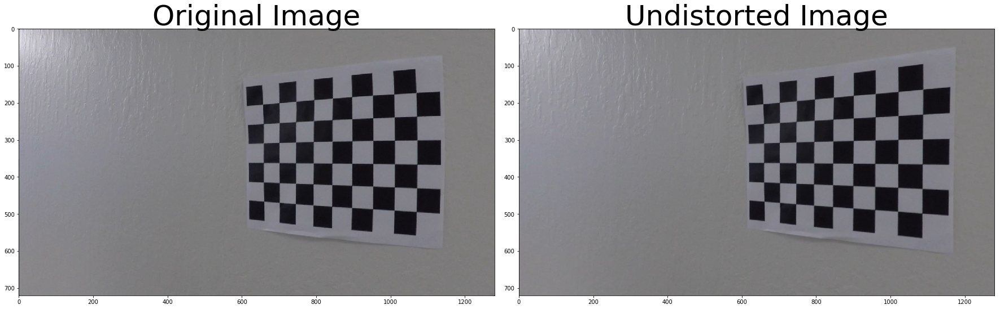

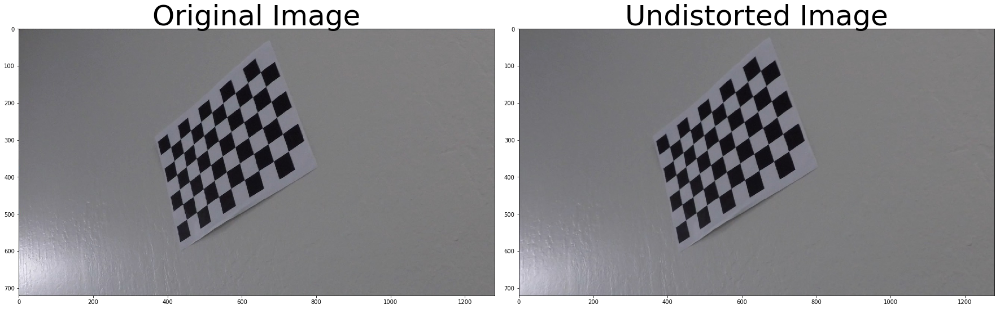

...

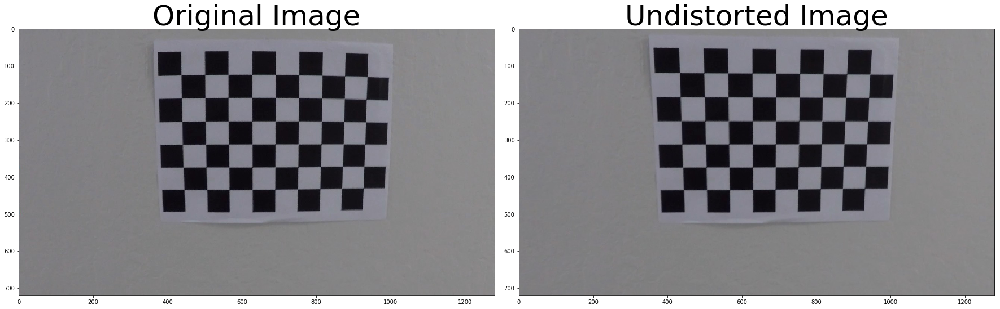

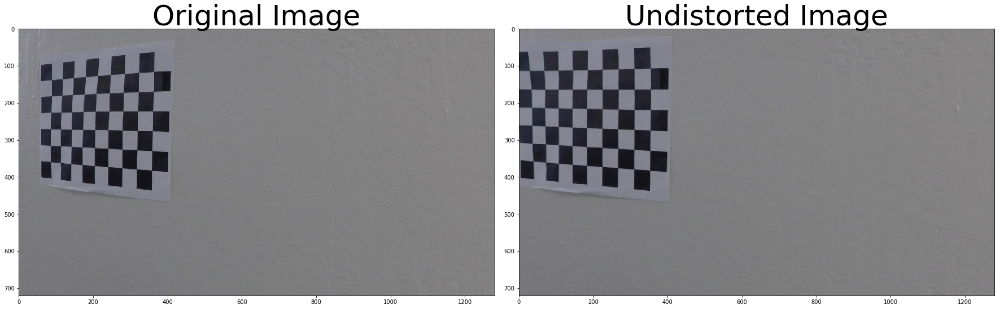

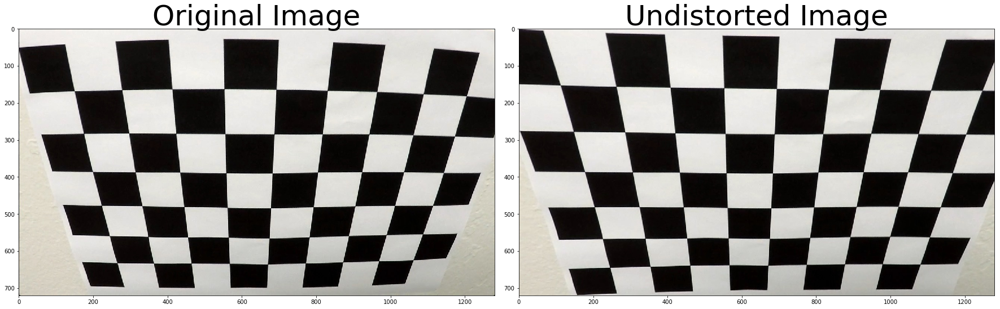

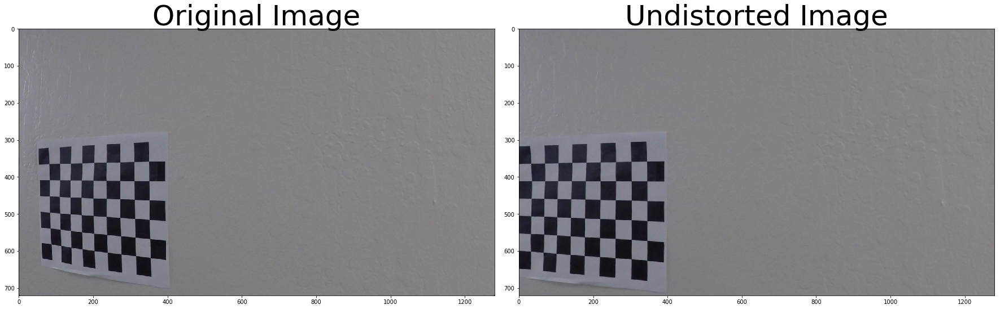

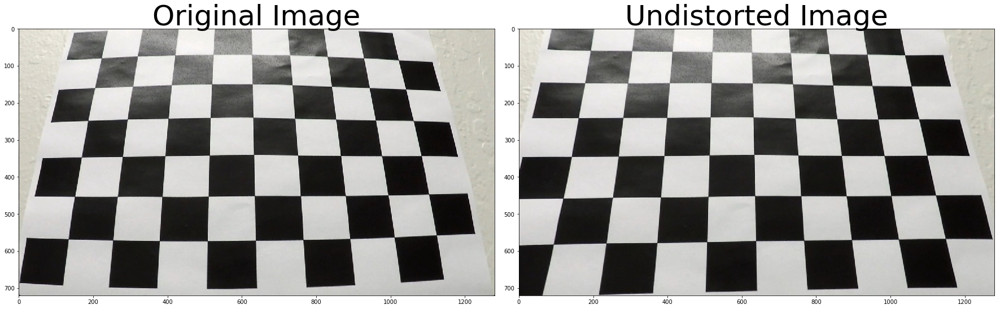

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


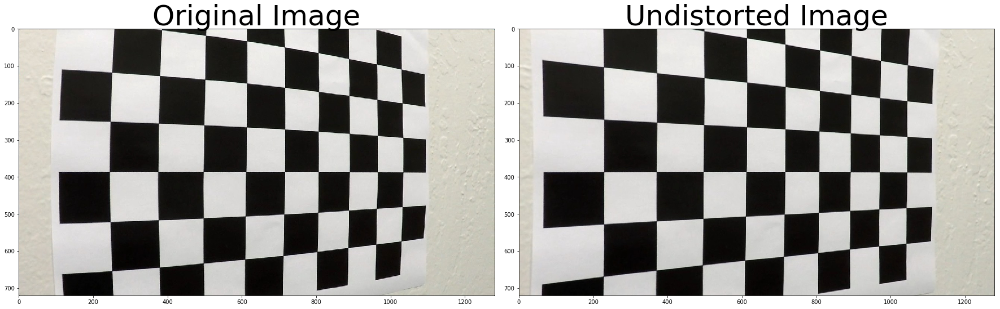

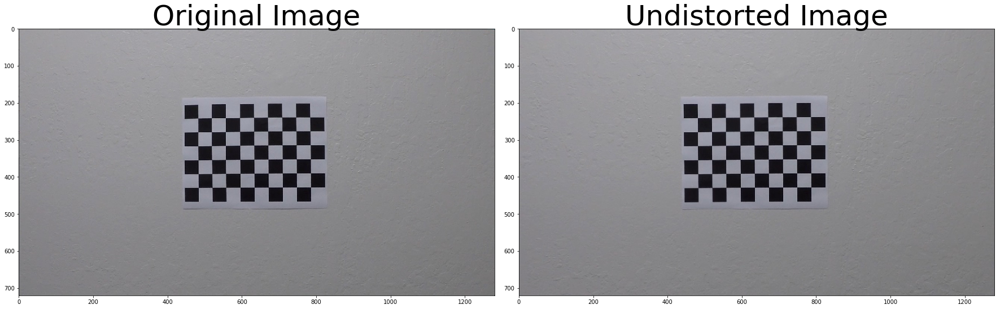

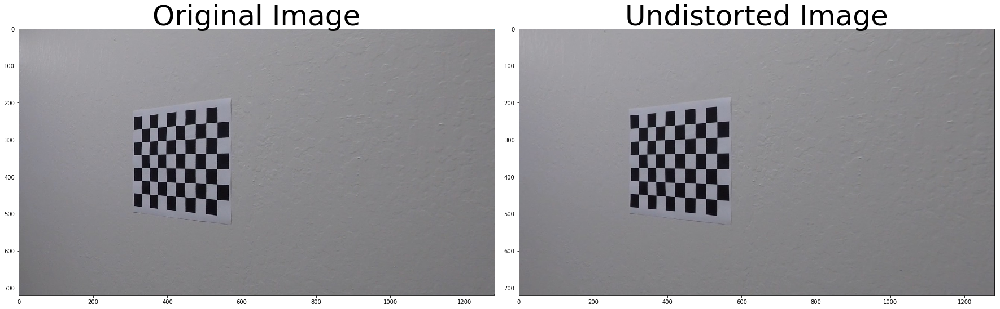

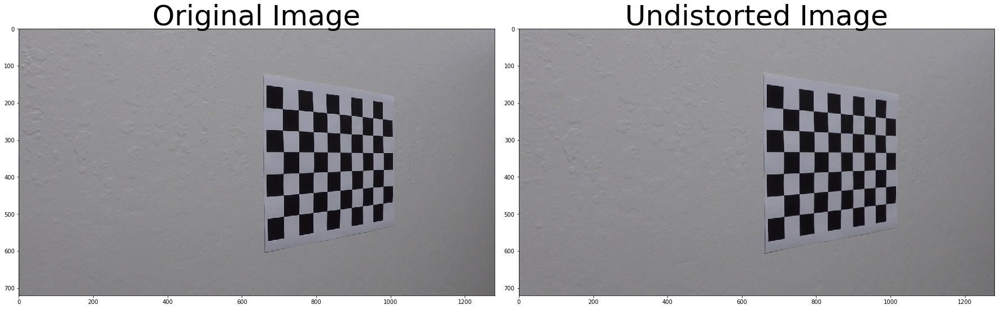

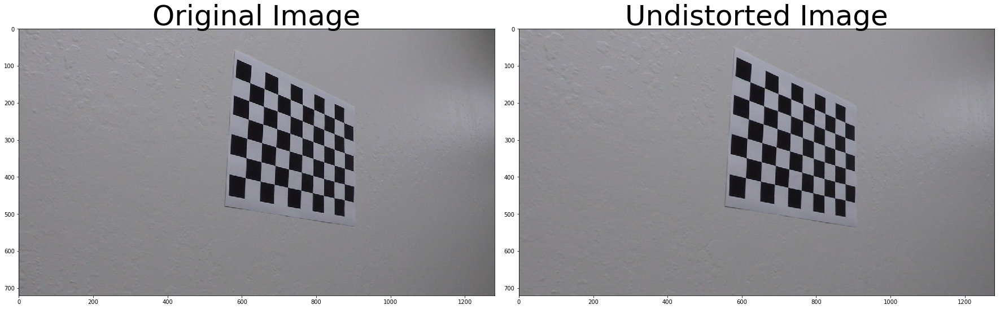

In [15]:
images_names_list = glob.glob("/Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/camera_cal/*.jpg")
for image_path in images_names_list:
    image =mpimg.imread(image_path)
    undistort_image = undistort_Image(image,cameraMatrix,distCoeffs)
    plot_image = np.concatenate((image, undistort_image), axis=1)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistort_image)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    #cv2.imshow(image_path,plot_image)
    #cv2.waitKey(0)
    

In [16]:
#cv2.imshow(np.concatenate((image, undistort_image), axis=1))
#cv2.waitKey(0)

In [17]:
#cv2.destroyAllWindows()

# undistorted test images 

In [18]:
test_images_names_list = glob.glob("/Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/test_images/*.jpg")

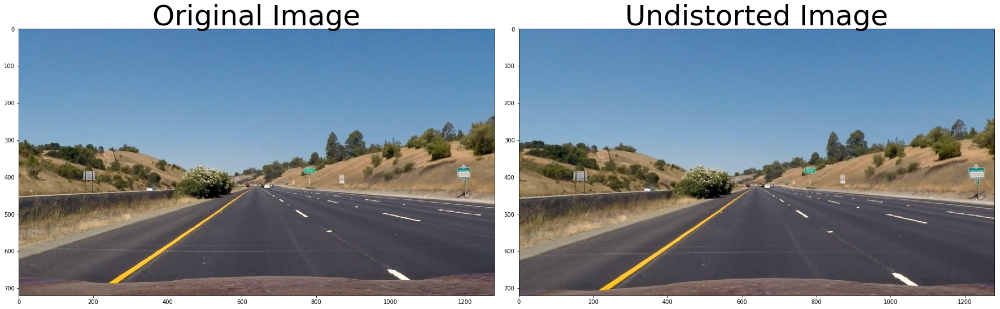

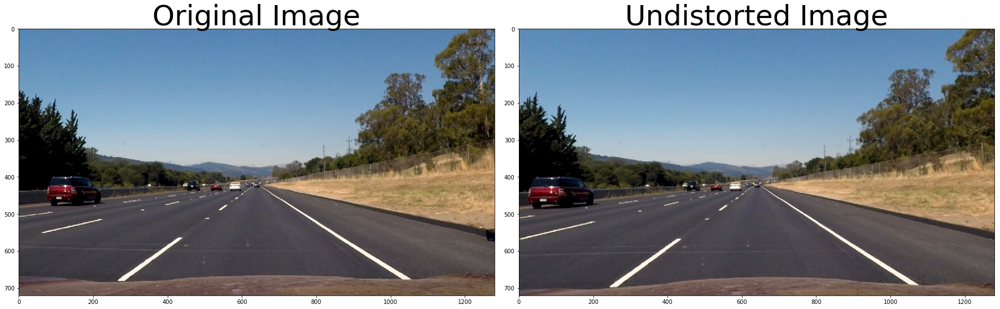

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


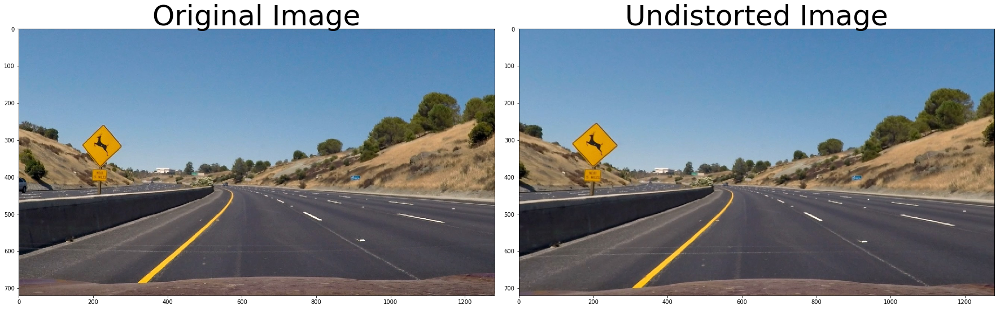

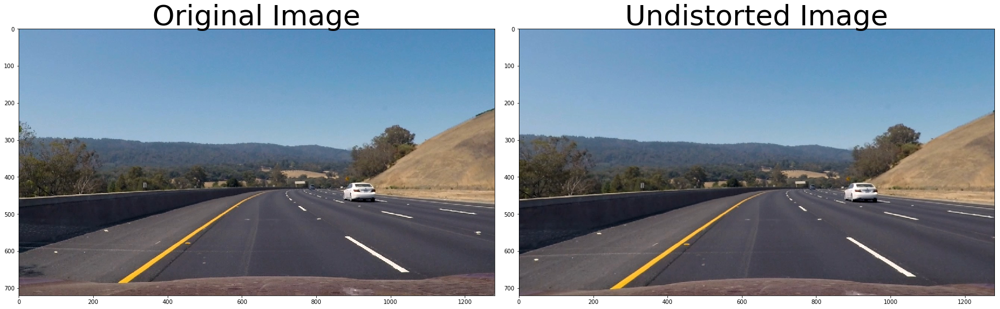

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


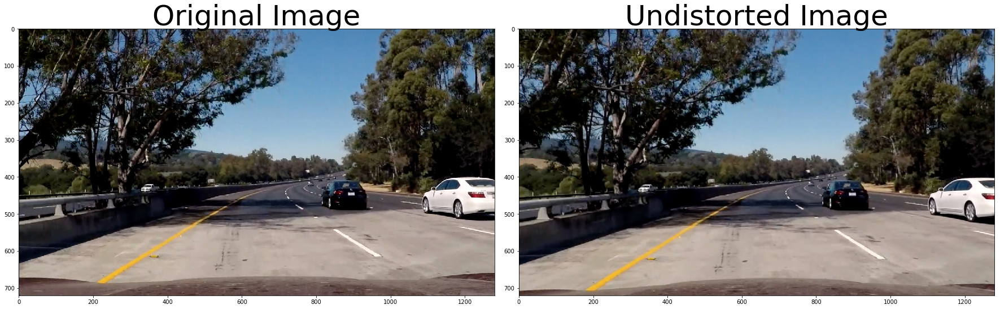

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [19]:
for image_path in test_images_names_list:
    image = mpimg.imread(image_path)
    #binary_mask_generator(image)
    #image = cv2.imread(image_path)
    #image = cv2.cvtColor(image,cv2.COLORBGR2RGB)
    undistort_image = undistort_Image(image,cameraMatrix,distCoeffs)
    plot_image = np.concatenate((image, undistort_image), axis=1)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistort_image)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    #cv2.imshow(image_path,plot_image)
    #cv2.waitKey(0)
    

In [20]:
#test_images_names_list

##  Binary lane mask Image Generation

In [46]:
def binary_mask_generator(image,low_thre=0,high_thre=255,visualization = False):
    R_channel = image[:,:,0]
    G_channel = image[:,:,1]
    B_channel = image[:,:,2]
    HSL_image = cv2.cvtColor(image,cv2.COLOR_RGB2HLS).astype(np.float)
    H_channel = HSL_image[:,:,0]
    S_channel = HSL_image[:,:,2]
    L_channel = HSL_image[:,:,1]
    
    #gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    #sobel_y = cv2.Sobel(gray,cv2.CV_64F,0,1,ksize=3)
    #sobel_y = normalize_absolate(sobel_y)
    sobel_x_binary = abs_sobel_thresh(image, orient='x', thresh_min=30, thresh_max=100)
    sobel_y_binary = abs_sobel_thresh(image, orient='y', thresh_min=20, thresh_max=100)
    S_binary = threshold_images(S_channel,120,255)
    combined_binary = np.zeros_like(sobel_x_binary)
    combined_binary[(S_binary == 1) | (sobel_x_binary == 1)] = 1
    color_binary = np.dstack(( np.zeros_like(sobel_x_binary), sobel_x_binary, S_binary))
    if(visualization):
            f, axarr = plt.subplots(2, 2)
            #plt.figure()
            axarr[0,0].imshow(image)
            axarr[0,0].set_title("Image")
            #plt.figure()
            axarr[0,1].imshow(sobel_x_binary,cmap='gray')
            axarr[0,1].set_title("sobel operation in x axis binary image")
            #plt.figure()
            axarr[1,0].imshow(S_binary,cmap='gray')
            axarr[1,0].set_title("S channel binary image")
            #plt.figure()
            #plt.imshow(combined_binary,cmap='gray')
            #plt.title("combined binary image")
            #plt.figure()
            axarr[1,1].imshow(np.uint8(255*color_binary))
            axarr[1,1].set_title("stacked color image")  
    return combined_binary
    
  
    
    
     

# Visualize  binary images mask for all the test images

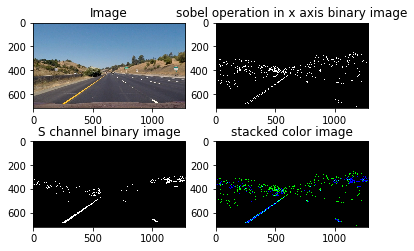

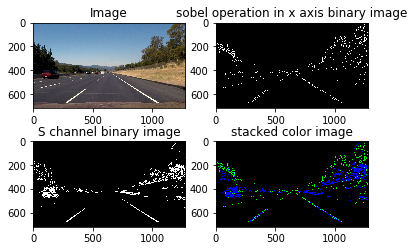

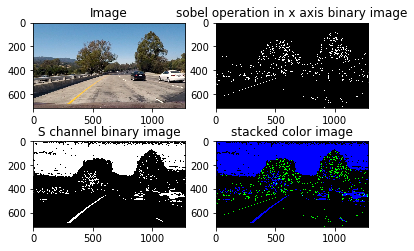

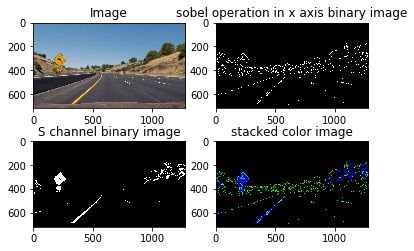

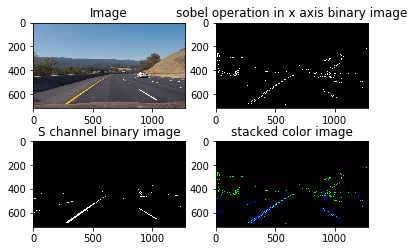

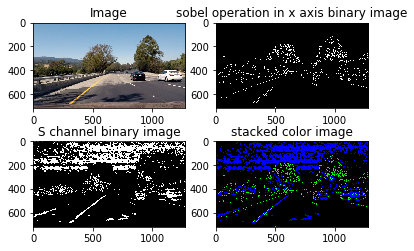

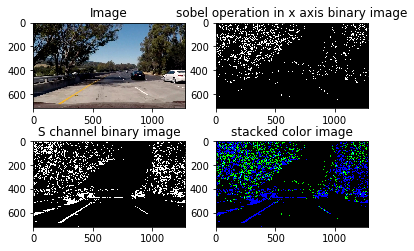

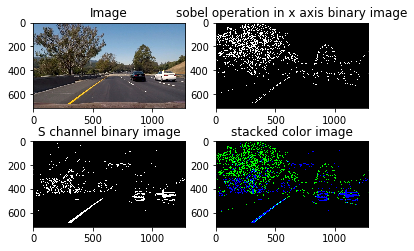

In [47]:
for image_path in test_images_names_list:
    image = mpimg.imread(image_path)
    binary_mask_generator(image,visualization = True)

In [23]:
#image = mpimg.imread(test_images_names_list[0])

In [24]:
#test_images_names_list

# Perspective Transform

In [25]:
# Bird eye view of the lane
def wrap_image(image):
    
    x_len = image.shape[1]
    y_len = image.shape[0]
    source_points = np.float32([[x_len/7*6-50,y_len-50],
                 [x_len/2+70,y_len/2+100],
                 [(x_len/2)-60,y_len/2+100],
                 [x_len/6+50,y_len-50]
                ])
    destination_point = np.float32([[x_len/7*6-50,y_len],
                     [x_len/7*6-50,0],
                     [x_len/8+100,0],
                     [x_len/8+100,y_len]
                    ])
    #print(source_points)
    #print(destination_point)
    M = cv2.getPerspectiveTransform(source_points,destination_point)
    wraped = cv2.warpPerspective(image,M,(x_len,y_len),flags=cv2.INTER_LINEAR)
    return wraped

In [26]:
#test_images_names_list[0:2]

# Visualize binary mask and perspective transform of the lane images

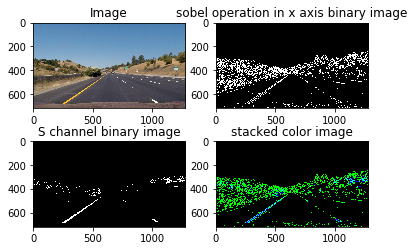

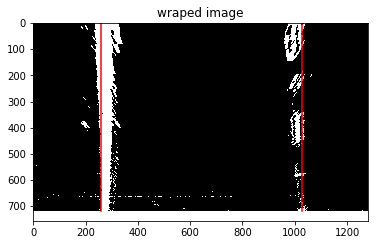

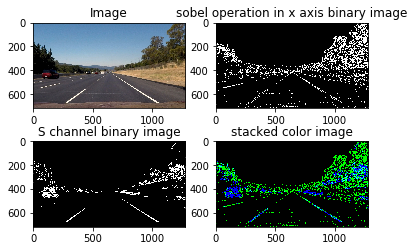

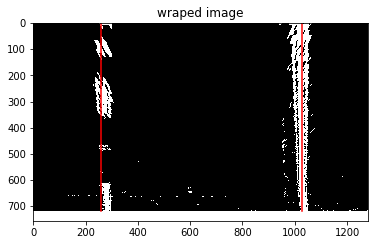

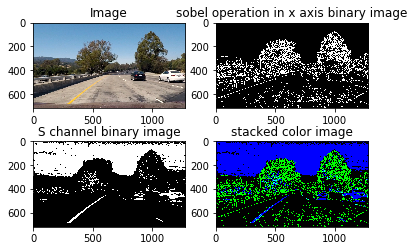

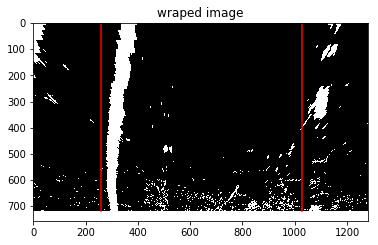

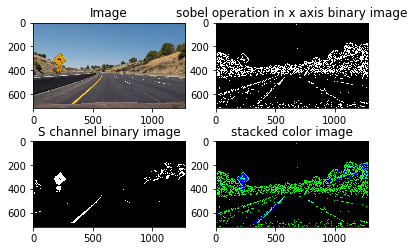

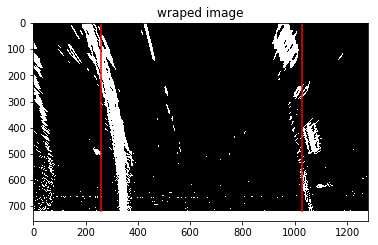

In [27]:
for image_path in test_images_names_list[0:4]:
    x_len = image.shape[1]
    y_len = image.shape[0]
    image = mpimg.imread(image_path)
    binary_mask = binary_mask_generator(image,visualization = True)
    wrap = wrap_image(binary_mask)
    plt.figure()
    plt.imshow(wrap,cmap='gray')
    plt.plot([x_len/7*6-70,x_len/7*6-70,],[y_len,0],'r')
    plt.plot([x_len/8+100,x_len/8+100],[y_len,0],'r')
    plt.title("wraped image")
    

# Find Lines

In [28]:
def lines_ROC(wrap,visualization = False):
    binary_warped = wrap
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2)
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    print("array sizes  leftx:{},lefty:{}, rightx:{} and righty:{}".format(leftx.size,lefty.size,rightx.size,righty.size))
    
    # Fit a second order polynomial to each
    if(leftx.size>0 and lefty.size>0):
        left_fit = np.polyfit(lefty, leftx, 2)
    if(rightx.size>0 and righty.size>0):
        right_fit = np.polyfit(righty, rightx, 2)
    # check optimized lane detection
    #lines_ROC2(wrap,left_fit,right_fit),rue

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    if(visualization):
        plt.figure()
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        plt.title("sliding windows lane detection")
        ploty = np.linspace(0, 719, num=720)# to cover same y-range as image
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    y_eval = np.max(ploty)
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    #print(left_curverad, 'm', right_curverad, 'm')
    return left_curverad,right_curverad,left_fitx,right_fitx,out_img,left_fit,right_fit
    # Example values: 632.1 m    626.2 m

In [29]:
def lines_ROC2(wrap,left_fit,right_fit,visualization = False):
    binary_warped = wrap
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    print("array sizes  leftx:{},lefty:{}, rightx:{} and righty:{}".format(leftx.size,lefty.size,rightx.size,righty.size))
    
    # Fit a second order polynomial to each
    if(leftx.size>0 and lefty.size>0):
        left_fit = np.polyfit(lefty, leftx, 2)
    if(rightx.size>0 and righty.size>0):
        right_fit = np.polyfit(righty, rightx, 2)
    #left_fit = np.polyfit(lefty, leftx, 2)
    #right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    if(visualization):
        plt.figure()
        plt.imshow(result)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.title("lane detection with out sliding windows step")
        plt.ylim(720, 0)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    y_eval = np.max(ploty)
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    #print(left_curverad, 'm', right_curverad, 'm')
    # Example values: 632.1 m    626.2 m
    return left_curverad,right_curverad,left_fitx,right_fitx,out_img

array sizes  leftx:37685,lefty:37685, rightx:20276 and righty:20276


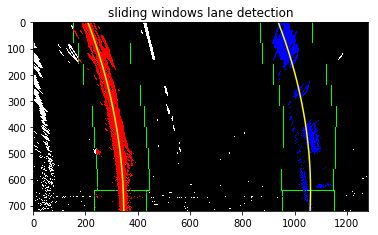

In [30]:
_=lines_ROC(wrap,True)

In [31]:
# frame_update: At which multiples of frame line fit parameters extracted
# frame_count: global parameter used to indicate the measure of current frame
def find_lines(wrap,frame_count,left_fit,right_fit,frame_update=3,visualization = False):
    print("frame_count:{},left_fit:{},right_fit:{},frame_update:{}".format(frame_count,left_fit,right_fit,frame_update))      
    #print("(not left_fit)",type(left_fit))
    if ((frame_count % frame_update == 0) or (len(left_fit)==0) or (len (right_fit)==0)):
        left_curverad,right_curverad,left_fitx,right_fitx,out_img,left_fit,right_fit=lines_ROC(wrap,visualization)    
    else:
        left_curverad,right_curverad,left_fitx,right_fitx,out_img = lines_ROC2(wrap,left_fit,right_fit,visualization)
        
    return left_curverad,right_curverad,left_fitx,right_fitx,out_img,left_fit,right_fit
        
        

In [55]:
# frame_update_var: At which multiples of frame line fit parameters extracted
# frame_count: global parameter used to indicate the measure of current frame
# average_update_var: variable used to indicate how many updated frame variables used for taking mean to achive desired result
left_fit_array=[]
right_fit_array=[]

def process_image_multiframe(image):
    left_fit = []
    right_fit = []
    frame_update_var =2
    average_update_var=2
    #visualization=True
    visualization=False
    # declare global variable
    global frame_count
    global left_fit_array
    global right_fit_array
    print("left_fit_array:{},right_fit_array:{}".format(left_fit_array,right_fit_array))
    #print("frame_count",frame_count)
    #print("image ",image)
    #print("cameraMatrix",cameraMatrix)
    if(len(left_fit_array)>=average_update_var):
        left_fit = np.mean(left_fit_array,axis=0)
        right_fit = np.mean(right_fit_array,axis=0)
        left_fit_array.pop(0)
        right_fit_array.pop(0)
        
    # Update variable for every frame
    frame_count+=1
    # undistort images
    undistort_image = undistort_Image(image,cameraMatrix,distCoeffs)
    #show_image_plt(undistort_image)
    #lane mask
    binary_image = binary_mask_generator(undistort_image,visualization=visualization)
    #show_image_plt(binary_image)
    #perceptive transform
    perceptive_transform_image = wrap_image(binary_image)
    #show_image_plt(perceptive_transform_image)
    left_curverad,right_curverad,left_fitx,right_fitx,out_img,left_fit,right_fit = find_lines(perceptive_transform_image,frame_count= frame_count,left_fit=left_fit,right_fit=right_fit,frame_update=frame_update_var,visualization = visualization)
    if (frame_count%frame_update_var == 0):
        left_fit_array.append(left_fit)
        right_fit_array.append(right_fit)
    # average Radius of curvature
    avg_ROC = (left_curverad+right_curverad)/2
    # horizantal distance 
    lane_width = np.mean(right_fitx-left_fitx)
    final_image_no_text = unwrap_image(undistort_image,perceptive_transform_image,left_fitx,right_fitx,visualization=visualization)
    font = cv2.FONT_HERSHEY_SIMPLEX
    result = cv2.putText(final_image_no_text,"Radius of curvature: {} ".format(avg_ROC),(100,100), font, 1, (255,255,255), 2, cv2.LINE_AA)
    result = cv2.putText(result,"lane width: {} ".format(lane_width),(100,200), font, 1, (255,255,255), 2, cv2.LINE_AA)
    
    #cv2.putText(result,"Radius of curvature: {}".format(avg_ROC),(10,10),"FONT_HERSHEY_PLAIN",2,(0,255,0))
    return result

In [51]:
def lines_ROC3(wrap):
    warped = 255*wrap
    window_centroids = find_window_centroids(warped, window_width, window_height, margin)

    # If we found any window centers
    if len(window_centroids) > 0:
        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        r_points = np.zeros_like(warped)
    
        # Go through each level and draw the windows 	
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255
    
        # Draw the results
        template_right = np.array(r_points,np.uint8) # add both left and right window pixels together
        template_left = np.array(l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template_right) # create a zero color channel
        template = np.array(cv2.merge((zero_channel,template_right,template_left)),np.uint8) # make window pixels green
        plt.figure()
        plt.imshow(template)
        #template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage = np.array(cv2.merge((warped,warped,warped)),np.uint8) # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
 
    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((warped,warped,warped)),np.uint8)

    # Display the final results
    plt.figure
    plt.imshow(output)
    plt.title('window fitting results')
    plt.show()
    
    leftx=np.array([int(np.mean(np.where(template_left[itr] ==255)))  for itr in range(template_left.shape[0])])
    

# Measure Curvature

In [50]:
def unwrap_image(undist,warped,left_fitx,right_fitx, visualization = False):
    x_len = warped.shape[1]
    y_len = warped.shape[0]
    source_points = np.float32([[x_len/7*6-50,y_len-50],
                 [x_len/2+70,y_len/2+100],
                 [(x_len/2)-60,y_len/2+100],
                 [x_len/6+50,y_len-50]
                ])
    destination_point = np.float32([[x_len/7*6-50,y_len],
                     [x_len/7*6-50,0],
                     [x_len/8+100,0],
                     [x_len/8+100,y_len]
                    ])
    
    Minv = cv2.getPerspectiveTransform(destination_point,source_points)
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
    

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    #plt.figure()
   #plt.imshow(color_warp)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    #plt.figure()
    #plt.imshow(newwarp)
    # Combine the result with the original image
    
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    if(visualization):
        plt.figure()
        plt.imshow(result)

    return result

In [35]:
#plt.imshow(image)

In [36]:
#_=unwrap_image(image,wrap,left_fitx,right_fitx)

In [37]:
import imageio
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML


In [38]:
def process_image(image):
    # undistort images
    undistort_image = undistort_Image(image,cameraMatrix,distCoeffs)
    #show_image_plt(undistort_image)
    #lane mask
    binary_image = binary_mask_generator(undistort_image)
    #show_image_plt(binary_image)
    #perceptive transform
    perceptive_transform_image = wrap_image(binary_image)
    #show_image_plt(perceptive_transform_image)
    left_curverad,right_curverad,left_fitx,right_fitx,_,_,_ = lines_ROC(perceptive_transform_image)
    # average Radius of curvature
    avg_ROC = (left_curverad+right_curverad)/2
    # horizantal distance 
    lane_width = np.mean(right_fitx-left_fitx)
    final_image_no_text = unwrap_image(undistort_image,perceptive_transform_image,left_fitx,right_fitx)
    font = cv2.FONT_HERSHEY_SIMPLEX
    result = cv2.putText(final_image_no_text,"Radius of curvature: {} ".format(avg_ROC),(100,100), font, 1, (255,255,255), 2, cv2.LINE_AA)
    result = cv2.putText(result,"lane width: {} ".format(lane_width),(100,200), font, 1, (255,255,255), 2, cv2.LINE_AA)
    
    #cv2.putText(result,"Radius of curvature: {}".format(avg_ROC),(10,10),"FONT_HERSHEY_PLAIN",2,(0,255,0))
    return result

array sizes  leftx:42975,lefty:42975, rightx:14237 and righty:14237
array sizes  leftx:14181,lefty:14181, rightx:32983 and righty:32983
array sizes  leftx:37242,lefty:37242, rightx:13710 and righty:13710


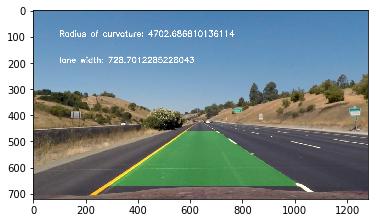

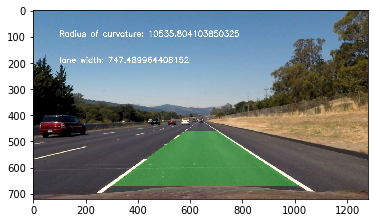

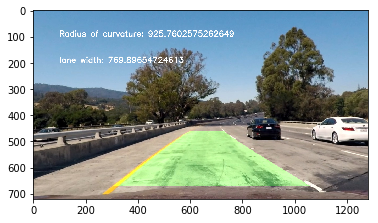

In [39]:
for image_path in test_images_names_list[0:3]:
    image = mpimg.imread(image_path)
    plt.figure()
    plt.imshow(process_image(image))

In [56]:
frame_count=0
for image_path in test_images_names_list[0:]:
    image = mpimg.imread(image_path)
    process_image_multiframe(image)
    #plt.figure()
    #plt.imshow(process_image_multiframe(image))

left_fit_array:[],right_fit_array:[]
frame_count:1,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32738,lefty:32738, rightx:9157 and righty:9157
left_fit_array:[],right_fit_array:[]
frame_count:2,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10085,lefty:10085, rightx:26683 and righty:26683
left_fit_array:[array([  3.52611318e-05,   7.84058466e-05,   2.66954211e+02])],right_fit_array:[array([ -1.89756963e-07,   1.42446914e-02,   1.01831201e+03])]
frame_count:3,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36056,lefty:36056, rightx:4669 and righty:4669
left_fit_array:[array([  3.52611318e-05,   7.84058466e-05,   2.66954211e+02])],right_fit_array:[array([ -1.89756963e-07,   1.42446914e-02,   1.01831201e+03])]
frame_count:4,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28205,lefty:28205, rightx:12110 and righty:12110
left_fit_array:[array([  3.52611318e-05,   7.84058466e-05,   2.66954211e+02]), array([ -2.63830243e-04,   3.77421135e-01,   

In [41]:
# directory address
video_save_dir="/Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/"
video_input_dir="/Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/"

In [57]:
frame_count = 0 
white_output = video_save_dir+"project_video1.mp4"
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("D:/Udacity_selfdriving/CarND-LaneLines-P1/test_videos/solidWhiteRight.mp4").subclip(0,8)
#clip1 = VideoFileClip(video_input_dir+"project_video.mp4").subclip(-10,-1)
clip1 = VideoFileClip(video_input_dir+"project_video.mp4")
#white_clip = clip1.fl_image(process_image_multiframe) #NOTE: this function expects color images!!
white_clip = clip1.fl_image(process_image_multiframe) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

left_fit_array:[array([  1.11495735e-04,  -1.40785647e-01,   3.68085926e+02]), array([  1.42068449e-04,  -3.32421531e-01,   4.82568828e+02])],right_fit_array:[array([  1.84564136e-04,  -2.26568992e-01,   1.16140142e+03]), array([  2.41385493e-04,  -3.17361721e-01,   1.20738323e+03])]
frame_count:1,left_fit:[  1.26782092e-04  -2.36603589e-01   4.25327377e+02],right_fit:[  2.12974815e-04  -2.71965357e-01   1.18439233e+03],frame_update:2
array sizes  leftx:18858,lefty:18858, rightx:4761 and righty:4761
[MoviePy] >>>> Building video /Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/project_video1.mp4
[MoviePy] Writing video /Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/project_video1.mp4


  0%|          | 0/1261 [00:00<?, ?it/s]

left_fit_array:[array([  1.42068449e-04,  -3.32421531e-01,   4.82568828e+02])],right_fit_array:[array([  2.41385493e-04,  -3.17361721e-01,   1.20738323e+03])]
frame_count:2,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28329,lefty:28329, rightx:10865 and righty:10865


  0%|          | 1/1261 [00:00<03:47,  5.54it/s]

left_fit_array:[array([  1.42068449e-04,  -3.32421531e-01,   4.82568828e+02]), array([ -2.73479658e-04,   3.71123816e-01,   2.09455670e+02])],right_fit_array:[array([  2.41385493e-04,  -3.17361721e-01,   1.20738323e+03]), array([ -2.05002039e-04,   3.68714935e-01,   9.44776494e+02])]
frame_count:3,left_fit:[ -6.57056043e-05   1.93511427e-02   3.46012249e+02],right_fit:[  1.81917272e-05   2.56766068e-02   1.07607986e+03],frame_update:2
array sizes  leftx:23627,lefty:23627, rightx:10053 and righty:10053


  0%|          | 2/1261 [00:00<03:54,  5.36it/s]

left_fit_array:[array([ -2.73479658e-04,   3.71123816e-01,   2.09455670e+02])],right_fit_array:[array([ -2.05002039e-04,   3.68714935e-01,   9.44776494e+02])]
frame_count:4,left_fit:[],right_fit:[],frame_update:2


  0%|          | 3/1261 [00:00<03:53,  5.38it/s]

array sizes  leftx:28299,lefty:28299, rightx:10879 and righty:10879
left_fit_array:[array([ -2.73479658e-04,   3.71123816e-01,   2.09455670e+02]), array([ -2.87321758e-04,   3.88527119e-01,   2.06139418e+02])],right_fit_array:[array([ -2.05002039e-04,   3.68714935e-01,   9.44776494e+02]), array([ -2.79180161e-04,   4.57444861e-01,   9.16062967e+02])]
frame_count:5,left_fit:[ -2.80400708e-04   3.79825467e-01   2.07797544e+02],right_fit:[ -2.42091100e-04   4.13079898e-01   9.30419730e+02],frame_update:2
array sizes  leftx:27704,lefty:27704, rightx:12184 and righty:12184


  0%|          | 4/1261 [00:00<03:48,  5.49it/s]

left_fit_array:[array([ -2.87321758e-04,   3.88527119e-01,   2.06139418e+02])],right_fit_array:[array([ -2.79180161e-04,   4.57444861e-01,   9.16062967e+02])]
frame_count:6,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27723,lefty:27723, rightx:11543 and righty:11543


  0%|          | 5/1261 [00:00<03:48,  5.51it/s]

left_fit_array:[array([ -2.87321758e-04,   3.88527119e-01,   2.06139418e+02]), array([ -2.64302580e-04,   3.83135425e-01,   2.04430428e+02])],right_fit_array:[array([ -2.79180161e-04,   4.57444861e-01,   9.16062967e+02]), array([ -2.68317167e-04,   4.68598906e-01,   9.04500054e+02])]


  0%|          | 6/1261 [00:01<03:49,  5.48it/s]

frame_count:7,left_fit:[ -2.75812169e-04   3.85831272e-01   2.05284923e+02],right_fit:[ -2.73748664e-04   4.63021884e-01   9.10281511e+02],frame_update:2
array sizes  leftx:27503,lefty:27503, rightx:12539 and righty:12539
left_fit_array:[array([ -2.64302580e-04,   3.83135425e-01,   2.04430428e+02])],right_fit_array:[array([ -2.68317167e-04,   4.68598906e-01,   9.04500054e+02])]
frame_count:8,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:26291,lefty:26291, rightx:11425 and righty:11425


  1%|          | 7/1261 [00:01<03:45,  5.57it/s]

left_fit_array:[array([ -2.64302580e-04,   3.83135425e-01,   2.04430428e+02]), array([ -2.70501550e-04,   3.98857038e-01,   1.98872606e+02])],right_fit_array:[array([ -2.68317167e-04,   4.68598906e-01,   9.04500054e+02]), array([ -1.76974396e-04,   3.96310711e-01,   9.14109460e+02])]
frame_count:9,left_fit:[ -2.67402065e-04   3.90996232e-01   2.01651517e+02],right_fit:[ -2.22645781e-04   4.32454809e-01   9.09304757e+02],frame_update:2
array sizes  leftx:26871,lefty:26871, rightx:11187 and righty:11187


  1%|          | 8/1261 [00:01<03:57,  5.29it/s]

left_fit_array:[array([ -2.70501550e-04,   3.98857038e-01,   1.98872606e+02])],right_fit_array:[array([ -1.76974396e-04,   3.96310711e-01,   9.14109460e+02])]
frame_count:10,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27485,lefty:27485, rightx:11058 and righty:11058


  1%|          | 9/1261 [00:01<04:08,  5.03it/s]

left_fit_array:[array([ -2.70501550e-04,   3.98857038e-01,   1.98872606e+02]), array([ -2.61155071e-04,   4.02964402e-01,   1.93064484e+02])],right_fit_array:[array([ -1.76974396e-04,   3.96310711e-01,   9.14109460e+02]), array([  5.34586906e-05,   2.58295226e-01,   9.26965986e+02])]
frame_count:11,left_fit:[ -2.65828310e-04   4.00910720e-01   1.95968545e+02],right_fit:[ -6.17578528e-05   3.27302969e-01   9.20537723e+02],frame_update:2


  1%|          | 10/1261 [00:01<04:05,  5.10it/s]

array sizes  leftx:28427,lefty:28427, rightx:11507 and righty:11507
left_fit_array:[array([ -2.61155071e-04,   4.02964402e-01,   1.93064484e+02])],right_fit_array:[array([  5.34586906e-05,   2.58295226e-01,   9.26965986e+02])]


  1%|          | 11/1261 [00:02<04:05,  5.09it/s]

frame_count:12,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29192,lefty:29192, rightx:11247 and righty:11247
left_fit_array:[array([ -2.61155071e-04,   4.02964402e-01,   1.93064484e+02]), array([ -2.27316731e-04,   3.82450603e-01,   1.91782767e+02])],right_fit_array:[array([  5.34586906e-05,   2.58295226e-01,   9.26965986e+02]), array([ -8.02868344e-05,   3.37312965e-01,   9.14418199e+02])]
frame_count:13,left_fit:[ -2.44235901e-04   3.92707502e-01   1.92423625e+02],right_fit:[ -1.34140719e-05   2.97804095e-01   9.20692092e+02],frame_update:2
array sizes  leftx:28854,lefty:28854, rightx:10720 and righty:10720


  1%|          | 12/1261 [00:02<03:58,  5.24it/s]

left_fit_array:[array([ -2.27316731e-04,   3.82450603e-01,   1.91782767e+02])],right_fit_array:[array([ -8.02868344e-05,   3.37312965e-01,   9.14418199e+02])]
frame_count:14,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28544,lefty:28544, rightx:10154 and righty:10154


  1%|          | 13/1261 [00:02<03:53,  5.35it/s]

left_fit_array:[array([ -2.27316731e-04,   3.82450603e-01,   1.91782767e+02]), array([ -2.16183900e-04,   3.82857271e-01,   1.83309781e+02])],right_fit_array:[array([ -8.02868344e-05,   3.37312965e-01,   9.14418199e+02]), array([ -7.77796343e-05,   3.14564896e-01,   9.27695114e+02])]


  1%|          | 14/1261 [00:02<03:55,  5.30it/s]

frame_count:15,left_fit:[ -2.21750315e-04   3.82653937e-01   1.87546274e+02],right_fit:[ -7.90332343e-05   3.25938930e-01   9.21056656e+02],frame_update:2
array sizes  leftx:28738,lefty:28738, rightx:10509 and righty:10509
left_fit_array:[array([ -2.16183900e-04,   3.82857271e-01,   1.83309781e+02])],right_fit_array:[array([ -7.77796343e-05,   3.14564896e-01,   9.27695114e+02])]
frame_count:16,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28349,lefty:28349, rightx:9712 and righty:9712


  1%|          | 15/1261 [00:02<03:51,  5.38it/s]

left_fit_array:[array([ -2.16183900e-04,   3.82857271e-01,   1.83309781e+02]), array([ -2.22847996e-04,   3.84624445e-01,   1.84890195e+02])],right_fit_array:[array([ -7.77796343e-05,   3.14564896e-01,   9.27695114e+02]), array([ -1.78835105e-04,   4.18300201e-01,   8.93467569e+02])]
frame_count:17,left_fit:[ -2.19515948e-04   3.83740858e-01   1.84099988e+02],right_fit:[ -1.28307370e-04   3.66432548e-01   9.10581342e+02],frame_update:2
array sizes  leftx:27599,lefty:27599, rightx:10987 and righty:10987


  1%|▏         | 16/1261 [00:03<04:00,  5.18it/s]

left_fit_array:[array([ -2.22847996e-04,   3.84624445e-01,   1.84890195e+02])],right_fit_array:[array([ -1.78835105e-04,   4.18300201e-01,   8.93467569e+02])]
frame_count:18,left_fit:[],right_fit:[],frame_update:2


  1%|▏         | 17/1261 [00:03<04:04,  5.08it/s]

array sizes  leftx:27672,lefty:27672, rightx:12050 and righty:12050
left_fit_array:[array([ -2.22847996e-04,   3.84624445e-01,   1.84890195e+02]), array([ -1.79496835e-04,   3.50978970e-01,   1.89363979e+02])],right_fit_array:[array([ -1.78835105e-04,   4.18300201e-01,   8.93467569e+02]), array([ -2.09428412e-04,   4.64761169e-01,   8.69207893e+02])]
frame_count:19,left_fit:[ -2.01172416e-04   3.67801707e-01   1.87127087e+02],right_fit:[ -1.94131759e-04   4.41530685e-01   8.81337731e+02],frame_update:2
array sizes  leftx:27047,lefty:27047, rightx:11859 and righty:11859


  1%|▏         | 18/1261 [00:03<04:09,  4.97it/s]

left_fit_array:[array([ -1.79496835e-04,   3.50978970e-01,   1.89363979e+02])],right_fit_array:[array([ -2.09428412e-04,   4.64761169e-01,   8.69207893e+02])]
frame_count:20,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28037,lefty:28037, rightx:11667 and righty:11667


  2%|▏         | 19/1261 [00:03<04:08,  5.00it/s]

left_fit_array:[array([ -1.79496835e-04,   3.50978970e-01,   1.89363979e+02]), array([ -1.62222508e-04,   3.39358660e-01,   1.87380483e+02])],right_fit_array:[array([ -2.09428412e-04,   4.64761169e-01,   8.69207893e+02]), array([ -1.44974106e-04,   4.02163372e-01,   8.82163947e+02])]


  2%|▏         | 20/1261 [00:03<03:58,  5.20it/s]

frame_count:21,left_fit:[ -1.70859672e-04   3.45168815e-01   1.88372231e+02],right_fit:[ -1.77201259e-04   4.33462271e-01   8.75685920e+02],frame_update:2
array sizes  leftx:27839,lefty:27839, rightx:11269 and righty:11269
left_fit_array:[array([ -1.62222508e-04,   3.39358660e-01,   1.87380483e+02])],right_fit_array:[array([ -1.44974106e-04,   4.02163372e-01,   8.82163947e+02])]
frame_count:22,left_fit:[],right_fit:[],frame_update:2


  2%|▏         | 21/1261 [00:04<04:04,  5.07it/s]

array sizes  leftx:27237,lefty:27237, rightx:10663 and righty:10663
left_fit_array:[array([ -1.62222508e-04,   3.39358660e-01,   1.87380483e+02]), array([ -1.50504449e-04,   3.34141941e-01,   1.82131585e+02])],right_fit_array:[array([ -1.44974106e-04,   4.02163372e-01,   8.82163947e+02]), array([ -4.25305384e-05,   3.17880760e-01,   9.05882262e+02])]


  2%|▏         | 22/1261 [00:04<04:12,  4.90it/s]

frame_count:23,left_fit:[ -1.56363479e-04   3.36750300e-01   1.84756034e+02],right_fit:[ -9.37523221e-05   3.60022066e-01   8.94023104e+02],frame_update:2
array sizes  leftx:28990,lefty:28990, rightx:10976 and righty:10976
left_fit_array:[array([ -1.50504449e-04,   3.34141941e-01,   1.82131585e+02])],right_fit_array:[array([ -4.25305384e-05,   3.17880760e-01,   9.05882262e+02])]


  2%|▏         | 23/1261 [00:04<04:17,  4.80it/s]

frame_count:24,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29533,lefty:29533, rightx:10996 and righty:10996
left_fit_array:[array([ -1.50504449e-04,   3.34141941e-01,   1.82131585e+02]), array([ -1.40879726e-04,   3.24988161e-01,   1.76566065e+02])],right_fit_array:[array([ -4.25305384e-05,   3.17880760e-01,   9.05882262e+02]), array([ -6.32887728e-05,   2.94253227e-01,   9.27582596e+02])]


  2%|▏         | 24/1261 [00:04<04:21,  4.74it/s]

frame_count:25,left_fit:[ -1.45692088e-04   3.29565051e-01   1.79348825e+02],right_fit:[ -5.29096556e-05   3.06066994e-01   9.16732429e+02],frame_update:2
array sizes  leftx:29568,lefty:29568, rightx:10522 and righty:10522
left_fit_array:[array([ -1.40879726e-04,   3.24988161e-01,   1.76566065e+02])],right_fit_array:[array([ -6.32887728e-05,   2.94253227e-01,   9.27582596e+02])]


  2%|▏         | 25/1261 [00:04<04:24,  4.67it/s]

frame_count:26,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30607,lefty:30607, rightx:11363 and righty:11363
left_fit_array:[array([ -1.40879726e-04,   3.24988161e-01,   1.76566065e+02]), array([ -1.66949750e-04,   3.32588638e-01,   1.80244126e+02])],right_fit_array:[array([ -6.32887728e-05,   2.94253227e-01,   9.27582596e+02]), array([ -2.12619521e-04,   4.09843995e-01,   9.04023089e+02])]


  2%|▏         | 26/1261 [00:05<04:27,  4.62it/s]

frame_count:27,left_fit:[ -1.53914738e-04   3.28788400e-01   1.78405095e+02],right_fit:[ -1.37954147e-04   3.52048611e-01   9.15802842e+02],frame_update:2
array sizes  leftx:29000,lefty:29000, rightx:9968 and righty:9968
left_fit_array:[array([ -1.66949750e-04,   3.32588638e-01,   1.80244126e+02])],right_fit_array:[array([ -2.12619521e-04,   4.09843995e-01,   9.04023089e+02])]


  2%|▏         | 27/1261 [00:05<04:25,  4.64it/s]

frame_count:28,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28493,lefty:28493, rightx:9274 and righty:9274
left_fit_array:[array([ -1.66949750e-04,   3.32588638e-01,   1.80244126e+02]), array([ -1.96554376e-04,   3.46520303e-01,   1.77935261e+02])],right_fit_array:[array([ -2.12619521e-04,   4.09843995e-01,   9.04023089e+02]), array([ -1.41387599e-04,   3.38051594e-01,   9.27319166e+02])]
frame_count:29,left_fit:[ -1.81752063e-04   3.39554471e-01   1.79089693e+02],right_fit:[ -1.77003560e-04   3.73947794e-01   9.15671127e+02],frame_update:2


  2%|▏         | 28/1261 [00:05<04:13,  4.86it/s]

array sizes  leftx:29885,lefty:29885, rightx:10021 and righty:10021
left_fit_array:[array([ -1.96554376e-04,   3.46520303e-01,   1.77935261e+02])],right_fit_array:[array([ -1.41387599e-04,   3.38051594e-01,   9.27319166e+02])]
frame_count:30,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29147,lefty:29147, rightx:9895 and righty:9895


  2%|▏         | 30/1261 [00:05<04:00,  5.13it/s]

left_fit_array:[array([ -1.96554376e-04,   3.46520303e-01,   1.77935261e+02]), array([ -1.98926962e-04,   3.42424211e-01,   1.79028007e+02])],right_fit_array:[array([ -1.41387599e-04,   3.38051594e-01,   9.27319166e+02]), array([ -1.73105369e-04,   3.49521290e-01,   9.34523125e+02])]
frame_count:31,left_fit:[ -1.97740669e-04   3.44472257e-01   1.78481634e+02],right_fit:[ -1.57246484e-04   3.43786442e-01   9.30921146e+02],frame_update:2
array sizes  leftx:29662,lefty:29662, rightx:9268 and righty:9268
left_fit_array:[array([ -1.98926962e-04,   3.42424211e-01,   1.79028007e+02])],right_fit_array:[array([ -1.73105369e-04,   3.49521290e-01,   9.34523125e+02])]


  2%|▏         | 31/1261 [00:06<04:39,  4.40it/s]

frame_count:32,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29548,lefty:29548, rightx:11730 and righty:11730
left_fit_array:[array([ -1.98926962e-04,   3.42424211e-01,   1.79028007e+02]), array([ -2.43693266e-04,   3.71722300e-01,   1.81972683e+02])],right_fit_array:[array([ -1.73105369e-04,   3.49521290e-01,   9.34523125e+02]), array([ -2.53055953e-04,   4.60981545e-01,   8.93746107e+02])]


  3%|▎         | 32/1261 [00:06<04:33,  4.49it/s]

frame_count:33,left_fit:[ -2.21310114e-04   3.57073255e-01   1.80500345e+02],right_fit:[ -2.13080661e-04   4.05251418e-01   9.14134616e+02],frame_update:2
array sizes  leftx:28637,lefty:28637, rightx:11989 and righty:11989
left_fit_array:[array([ -2.43693266e-04,   3.71722300e-01,   1.81972683e+02])],right_fit_array:[array([ -2.53055953e-04,   4.60981545e-01,   8.93746107e+02])]


  3%|▎         | 33/1261 [00:06<04:38,  4.41it/s]

frame_count:34,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28441,lefty:28441, rightx:11434 and righty:11434
left_fit_array:[array([ -2.43693266e-04,   3.71722300e-01,   1.81972683e+02]), array([ -2.61118610e-04,   3.81056174e-01,   1.84015017e+02])],right_fit_array:[array([ -2.53055953e-04,   4.60981545e-01,   8.93746107e+02]), array([ -6.70643606e-05,   3.49675732e-01,   9.04654294e+02])]


  3%|▎         | 34/1261 [00:06<04:43,  4.32it/s]

frame_count:35,left_fit:[ -2.52405938e-04   3.76389237e-01   1.82993850e+02],right_fit:[ -1.60060157e-04   4.05328638e-01   8.99200201e+02],frame_update:2
array sizes  leftx:28937,lefty:28937, rightx:11831 and righty:11831
left_fit_array:[array([ -2.61118610e-04,   3.81056174e-01,   1.84015017e+02])],right_fit_array:[array([ -6.70643606e-05,   3.49675732e-01,   9.04654294e+02])]
frame_count:36,left_fit:[],right_fit:[],frame_update:2


  3%|▎         | 35/1261 [00:07<04:30,  4.53it/s]

array sizes  leftx:28440,lefty:28440, rightx:10682 and righty:10682
left_fit_array:[array([ -2.61118610e-04,   3.81056174e-01,   1.84015017e+02]), array([ -2.86040675e-04,   4.02562430e-01,   1.83624308e+02])],right_fit_array:[array([ -6.70643606e-05,   3.49675732e-01,   9.04654294e+02]), array([ -5.48600284e-05,   3.37883881e-01,   9.02081773e+02])]
frame_count:37,left_fit:[ -2.73579642e-04   3.91809302e-01   1.83819662e+02],right_fit:[ -6.09621945e-05   3.43779806e-01   9.03368033e+02],frame_update:2


  3%|▎         | 36/1261 [00:07<04:25,  4.61it/s]

array sizes  leftx:27935,lefty:27935, rightx:10612 and righty:10612
left_fit_array:[array([ -2.86040675e-04,   4.02562430e-01,   1.83624308e+02])],right_fit_array:[array([ -5.48600284e-05,   3.37883881e-01,   9.02081773e+02])]
frame_count:38,left_fit:[],right_fit:[],frame_update:2


  3%|▎         | 37/1261 [00:07<04:22,  4.66it/s]

array sizes  leftx:27395,lefty:27395, rightx:10627 and righty:10627
left_fit_array:[array([ -2.86040675e-04,   4.02562430e-01,   1.83624308e+02]), array([ -3.12722266e-04,   4.29163668e-01,   1.81076099e+02])],right_fit_array:[array([ -5.48600284e-05,   3.37883881e-01,   9.02081773e+02]), array([ -1.91646681e-04,   4.34302981e-01,   8.82010720e+02])]


  3%|▎         | 38/1261 [00:07<04:29,  4.53it/s]

frame_count:39,left_fit:[ -2.99381471e-04   4.15863049e-01   1.82350203e+02],right_fit:[ -1.23253355e-04   3.86093431e-01   8.92046246e+02],frame_update:2
array sizes  leftx:28019,lefty:28019, rightx:10514 and righty:10514
left_fit_array:[array([ -3.12722266e-04,   4.29163668e-01,   1.81076099e+02])],right_fit_array:[array([ -1.91646681e-04,   4.34302981e-01,   8.82010720e+02])]


  3%|▎         | 39/1261 [00:07<04:23,  4.64it/s]

frame_count:40,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28331,lefty:28331, rightx:10292 and righty:10292
left_fit_array:[array([ -3.12722266e-04,   4.29163668e-01,   1.81076099e+02]), array([ -3.41831168e-04,   4.57553399e-01,   1.77782982e+02])],right_fit_array:[array([ -1.91646681e-04,   4.34302981e-01,   8.82010720e+02]), array([ -2.88822921e-04,   5.26516632e-01,   8.55840501e+02])]
frame_count:41,left_fit:[ -3.27276717e-04   4.43358534e-01   1.79429540e+02],right_fit:[ -2.40234801e-04   4.80409806e-01   8.68925610e+02],frame_update:2
array sizes  leftx:28018,lefty:28018, rightx:11286 and righty:11286


  3%|▎         | 41/1261 [00:08<03:59,  5.10it/s]

left_fit_array:[array([ -3.41831168e-04,   4.57553399e-01,   1.77782982e+02])],right_fit_array:[array([ -2.88822921e-04,   5.26516632e-01,   8.55840501e+02])]
frame_count:42,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27823,lefty:27823, rightx:11778 and righty:11778
left_fit_array:[array([ -3.41831168e-04,   4.57553399e-01,   1.77782982e+02]), array([ -3.42400388e-04,   4.66125486e-01,   1.73465878e+02])],right_fit_array:[array([ -2.88822921e-04,   5.26516632e-01,   8.55840501e+02]), array([ -2.95284654e-04,   5.38135639e-01,   8.53286141e+02])]


  3%|▎         | 42/1261 [00:08<04:01,  5.04it/s]

frame_count:43,left_fit:[ -3.42115778e-04   4.61839443e-01   1.75624430e+02],right_fit:[ -2.92053787e-04   5.32326136e-01   8.54563321e+02],frame_update:2
array sizes  leftx:26431,lefty:26431, rightx:12317 and righty:12317
left_fit_array:[array([ -3.42400388e-04,   4.66125486e-01,   1.73465878e+02])],right_fit_array:[array([ -2.95284654e-04,   5.38135639e-01,   8.53286141e+02])]
frame_count:44,left_fit:[],right_fit:[],frame_update:2


  3%|▎         | 43/1261 [00:08<04:02,  5.02it/s]

array sizes  leftx:26883,lefty:26883, rightx:12215 and righty:12215
left_fit_array:[array([ -3.42400388e-04,   4.66125486e-01,   1.73465878e+02]), array([ -3.42033916e-04,   4.79778391e-01,   1.66995347e+02])],right_fit_array:[array([ -2.95284654e-04,   5.38135639e-01,   8.53286141e+02]), array([ -2.84501632e-04,   5.28319304e-01,   8.59182704e+02])]
frame_count:45,left_fit:[ -3.42217152e-04   4.72951939e-01   1.70230613e+02],right_fit:[ -2.89893143e-04   5.33227471e-01   8.56234422e+02],frame_update:2
array sizes  leftx:27806,lefty:27806, rightx:12750 and righty:12750


  3%|▎         | 44/1261 [00:08<04:06,  4.94it/s]

left_fit_array:[array([ -3.42033916e-04,   4.79778391e-01,   1.66995347e+02])],right_fit_array:[array([ -2.84501632e-04,   5.28319304e-01,   8.59182704e+02])]


  4%|▎         | 45/1261 [00:09<04:37,  4.39it/s]

frame_count:46,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27529,lefty:27529, rightx:12107 and righty:12107
left_fit_array:[array([ -3.42033916e-04,   4.79778391e-01,   1.66995347e+02]), array([ -3.08209911e-04,   4.63463679e-01,   1.62964418e+02])],right_fit_array:[array([ -2.84501632e-04,   5.28319304e-01,   8.59182704e+02]), array([ -2.09416984e-04,   4.50909119e-01,   8.83997146e+02])]
frame_count:47,left_fit:[ -3.25121914e-04   4.71621035e-01   1.64979882e+02],right_fit:[ -2.46959308e-04   4.89614211e-01   8.71589925e+02],frame_update:2
array sizes  leftx:27904,lefty:27904, rightx:12380 and righty:12380


  4%|▎         | 46/1261 [00:09<04:18,  4.71it/s]

left_fit_array:[array([ -3.08209911e-04,   4.63463679e-01,   1.62964418e+02])],right_fit_array:[array([ -2.09416984e-04,   4.50909119e-01,   8.83997146e+02])]
frame_count:48,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27876,lefty:27876, rightx:11225 and righty:11225

  4%|▍         | 48/1261 [00:09<04:31,  4.47it/s]


left_fit_array:[array([ -3.08209911e-04,   4.63463679e-01,   1.62964418e+02]), array([ -2.88930357e-04,   4.55066280e-01,   1.59370409e+02])],right_fit_array:[array([ -2.09416984e-04,   4.50909119e-01,   8.83997146e+02]), array([ -9.41584585e-05,   3.71551585e-01,   8.97419878e+02])]
frame_count:49,left_fit:[ -2.98570134e-04   4.59264979e-01   1.61167413e+02],right_fit:[ -1.51787721e-04   4.11230352e-01   8.90708512e+02],frame_update:2
array sizes  leftx:28465,lefty:28465, rightx:11537 and righty:11537


  4%|▍         | 49/1261 [00:10<04:22,  4.63it/s]

left_fit_array:[array([ -2.88930357e-04,   4.55066280e-01,   1.59370409e+02])],right_fit_array:[array([ -9.41584585e-05,   3.71551585e-01,   8.97419878e+02])]
frame_count:50,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29054,lefty:29054, rightx:10844 and righty:10844
left_fit_array:[array([ -2.88930357e-04,   4.55066280e-01,   1.59370409e+02]), array([ -2.57514198e-04,   4.36156244e-01,   1.57463235e+02])],right_fit_array:[array([ -9.41584585e-05,   3.71551585e-01,   8.97419878e+02]), array([ -9.19565789e-05,   3.52191207e-01,   9.04587032e+02])]


  4%|▍         | 50/1261 [00:10<04:09,  4.86it/s]

frame_count:51,left_fit:[ -2.73222278e-04   4.45611262e-01   1.58416822e+02],right_fit:[ -9.30575187e-05   3.61871396e-01   9.01003455e+02],frame_update:2
array sizes  leftx:29086,lefty:29086, rightx:11465 and righty:11465
left_fit_array:[array([ -2.57514198e-04,   4.36156244e-01,   1.57463235e+02])],right_fit_array:[array([ -9.19565789e-05,   3.52191207e-01,   9.04587032e+02])]
frame_count:52,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29512,lefty:29512, rightx:11384 and righty:11384


  4%|▍         | 52/1261 [00:10<03:48,  5.30it/s]

left_fit_array:[array([ -2.57514198e-04,   4.36156244e-01,   1.57463235e+02]), array([ -2.20173863e-04,   4.13063340e-01,   1.57187921e+02])],right_fit_array:[array([ -9.19565789e-05,   3.52191207e-01,   9.04587032e+02]), array([ -1.73924536e-04,   4.14641120e-01,   8.91964782e+02])]
frame_count:53,left_fit:[ -2.38844030e-04   4.24609792e-01   1.57325578e+02],right_fit:[ -1.32940558e-04   3.83416163e-01   8.98275907e+02],frame_update:2
array sizes  leftx:30433,lefty:30433, rightx:11000 and righty:11000
left_fit_array:[array([ -2.20173863e-04,   4.13063340e-01,   1.57187921e+02])],right_fit_array:[array([ -1.73924536e-04,   4.14641120e-01,   8.91964782e+02])]


  4%|▍         | 53/1261 [00:10<03:40,  5.48it/s]

frame_count:54,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29201,lefty:29201, rightx:10793 and righty:10793
left_fit_array:[array([ -2.20173863e-04,   4.13063340e-01,   1.57187921e+02]), array([ -2.16757203e-04,   4.06309479e-01,   1.59960350e+02])],right_fit_array:[array([ -1.73924536e-04,   4.14641120e-01,   8.91964782e+02]), array([ -2.75743443e-04,   5.13094646e-01,   8.63482253e+02])]
frame_count:55,left_fit:[ -2.18465533e-04   4.09686410e-01   1.58574136e+02],right_fit:[ -2.24833989e-04   4.63867883e-01   8.77723518e+02],frame_update:2
array sizes  leftx:30519,lefty:30519, rightx:11966 and righty:11966


  4%|▍         | 55/1261 [00:11<03:38,  5.52it/s]

left_fit_array:[array([ -2.16757203e-04,   4.06309479e-01,   1.59960350e+02])],right_fit_array:[array([ -2.75743443e-04,   5.13094646e-01,   8.63482253e+02])]
frame_count:56,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30306,lefty:30306, rightx:12485 and righty:12485
left_fit_array:[array([ -2.16757203e-04,   4.06309479e-01,   1.59960350e+02]), array([ -1.66280938e-04,   3.71086038e-01,   1.61253083e+02])],right_fit_array:[array([ -2.75743443e-04,   5.13094646e-01,   8.63482253e+02]), array([ -2.69327009e-04,   5.16023688e-01,   8.59198488e+02])]


  4%|▍         | 56/1261 [00:11<03:39,  5.50it/s]

frame_count:57,left_fit:[ -1.91519070e-04   3.88697759e-01   1.60606717e+02],right_fit:[ -2.72535226e-04   5.14559167e-01   8.61340371e+02],frame_update:2
array sizes  leftx:30468,lefty:30468, rightx:12309 and righty:12309
left_fit_array:[array([ -1.66280938e-04,   3.71086038e-01,   1.61253083e+02])],right_fit_array:[array([ -2.69327009e-04,   5.16023688e-01,   8.59198488e+02])]
frame_count:58,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30313,lefty:30313, rightx:12346 and righty:12346


  5%|▍         | 58/1261 [00:11<03:37,  5.54it/s]

left_fit_array:[array([ -1.66280938e-04,   3.71086038e-01,   1.61253083e+02]), array([ -1.49534633e-04,   3.52426879e-01,   1.64212992e+02])],right_fit_array:[array([ -2.69327009e-04,   5.16023688e-01,   8.59198488e+02]), array([ -2.16921195e-04,   4.75688312e-01,   8.64541912e+02])]
frame_count:59,left_fit:[ -1.57907786e-04   3.61756458e-01   1.62733037e+02],right_fit:[ -2.43124102e-04   4.95856000e-01   8.61870200e+02],frame_update:2
array sizes  leftx:30661,lefty:30661, rightx:12721 and righty:12721
left_fit_array:[array([ -1.49534633e-04,   3.52426879e-01,   1.64212992e+02])],right_fit_array:[array([ -2.16921195e-04,   4.75688312e-01,   8.64541912e+02])]


  5%|▍         | 59/1261 [00:11<03:35,  5.57it/s]

frame_count:60,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29089,lefty:29089, rightx:11525 and righty:11525
left_fit_array:[array([ -1.49534633e-04,   3.52426879e-01,   1.64212992e+02]), array([ -1.44208893e-04,   3.34054104e-01,   1.72884726e+02])],right_fit_array:[array([ -2.16921195e-04,   4.75688312e-01,   8.64541912e+02]), array([ -4.73222921e-05,   3.86695549e-01,   8.61821157e+02])]


  5%|▍         | 60/1261 [00:12<03:46,  5.31it/s]

frame_count:61,left_fit:[ -1.46871763e-04   3.43240491e-01   1.68548859e+02],right_fit:[ -1.32121744e-04   4.31191930e-01   8.63181534e+02],frame_update:2
array sizes  leftx:29228,lefty:29228, rightx:10954 and righty:10954
left_fit_array:[array([ -1.44208893e-04,   3.34054104e-01,   1.72884726e+02])],right_fit_array:[array([ -4.73222921e-05,   3.86695549e-01,   8.61821157e+02])]
frame_count:62,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29550,lefty:29550, rightx:10904 and righty:10904


  5%|▍         | 62/1261 [00:12<03:46,  5.30it/s]

left_fit_array:[array([ -1.44208893e-04,   3.34054104e-01,   1.72884726e+02]), array([ -1.86214256e-04,   3.52596141e-01,   1.75525017e+02])],right_fit_array:[array([ -4.73222921e-05,   3.86695549e-01,   8.61821157e+02]), array([ -1.03041256e-04,   4.22808248e-01,   8.45936910e+02])]
frame_count:63,left_fit:[ -1.65211574e-04   3.43325122e-01   1.74204871e+02],right_fit:[ -7.51817738e-05   4.04751898e-01   8.53879034e+02],frame_update:2
array sizes  leftx:29779,lefty:29779, rightx:10738 and righty:10738


  5%|▍         | 63/1261 [00:12<03:51,  5.18it/s]

left_fit_array:[array([ -1.86214256e-04,   3.52596141e-01,   1.75525017e+02])],right_fit_array:[array([ -1.03041256e-04,   4.22808248e-01,   8.45936910e+02])]
frame_count:64,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28917,lefty:28917, rightx:10847 and righty:10847
left_fit_array:[array([ -1.86214256e-04,   3.52596141e-01,   1.75525017e+02]), array([ -2.13408353e-04,   3.65420136e-01,   1.75930302e+02])],right_fit_array:[array([ -1.03041256e-04,   4.22808248e-01,   8.45936910e+02]), array([ -1.57408880e-04,   4.52482834e-01,   8.42025125e+02])]
frame_count:65,left_fit:[ -1.99811304e-04   3.59008138e-01   1.75727659e+02],right_fit:[ -1.30225068e-04   4.37645541e-01   8.43981018e+02],frame_update:2
array sizes  leftx:28757,lefty:28757, rightx:10738 and righty:10738


  5%|▌         | 65/1261 [00:12<03:36,  5.53it/s]

left_fit_array:[array([ -2.13408353e-04,   3.65420136e-01,   1.75930302e+02])],right_fit_array:[array([ -1.57408880e-04,   4.52482834e-01,   8.42025125e+02])]
frame_count:66,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29613,lefty:29613, rightx:10409 and righty:10409
left_fit_array:[array([ -2.13408353e-04,   3.65420136e-01,   1.75930302e+02]), array([ -2.37139889e-04,   3.75517103e-01,   1.76053414e+02])],right_fit_array:[array([ -1.57408880e-04,   4.52482834e-01,   8.42025125e+02]), array([ -2.29244586e-04,   4.98247235e-01,   8.38015171e+02])]


  5%|▌         | 66/1261 [00:13<03:37,  5.51it/s]

frame_count:67,left_fit:[ -2.25274121e-04   3.70468619e-01   1.75991858e+02],right_fit:[ -1.93326733e-04   4.75365035e-01   8.40020148e+02],frame_update:2
array sizes  leftx:29115,lefty:29115, rightx:12221 and righty:12221
left_fit_array:[array([ -2.37139889e-04,   3.75517103e-01,   1.76053414e+02])],right_fit_array:[array([ -2.29244586e-04,   4.98247235e-01,   8.38015171e+02])]
frame_count:68,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30155,lefty:30155, rightx:12301 and righty:12301


  5%|▌         | 68/1261 [00:13<03:34,  5.55it/s]

left_fit_array:[array([ -2.37139889e-04,   3.75517103e-01,   1.76053414e+02]), array([ -2.43870680e-04,   3.76235210e-01,   1.77749327e+02])],right_fit_array:[array([ -2.29244586e-04,   4.98247235e-01,   8.38015171e+02]), array([ -1.85826488e-04,   4.59756189e-01,   8.42027181e+02])]
frame_count:69,left_fit:[ -2.40505284e-04   3.75876157e-01   1.76901370e+02],right_fit:[ -2.07535537e-04   4.79001712e-01   8.40021176e+02],frame_update:2
array sizes  leftx:31188,lefty:31188, rightx:12592 and righty:12592
left_fit_array:[array([ -2.43870680e-04,   3.76235210e-01,   1.77749327e+02])],right_fit_array:[array([ -1.85826488e-04,   4.59756189e-01,   8.42027181e+02])]


  5%|▌         | 69/1261 [00:13<03:34,  5.56it/s]

frame_count:70,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30811,lefty:30811, rightx:11723 and righty:11723
left_fit_array:[array([ -2.43870680e-04,   3.76235210e-01,   1.77749327e+02]), array([ -2.32017965e-04,   3.64995218e-01,   1.79269094e+02])],right_fit_array:[array([ -1.85826488e-04,   4.59756189e-01,   8.42027181e+02]), array([ -1.28764867e-04,   4.01292085e-01,   8.52485241e+02])]
frame_count:71,left_fit:[ -2.37944323e-04   3.70615214e-01   1.78509210e+02],right_fit:[ -1.57295678e-04   4.30524137e-01   8.47256211e+02],frame_update:2
array sizes  leftx:30785,lefty:30785, rightx:11108 and righty:11108


  6%|▌         | 71/1261 [00:14<03:31,  5.62it/s]

left_fit_array:[array([ -2.32017965e-04,   3.64995218e-01,   1.79269094e+02])],right_fit_array:[array([ -1.28764867e-04,   4.01292085e-01,   8.52485241e+02])]
frame_count:72,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30465,lefty:30465, rightx:10925 and righty:10925
left_fit_array:[array([ -2.32017965e-04,   3.64995218e-01,   1.79269094e+02]), array([ -2.13160764e-04,   3.53435870e-01,   1.77646765e+02])],right_fit_array:[array([ -1.28764867e-04,   4.01292085e-01,   8.52485241e+02]), array([ -6.98257043e-05,   3.52413315e-01,   8.65563952e+02])]


  6%|▌         | 72/1261 [00:14<03:50,  5.15it/s]

frame_count:73,left_fit:[ -2.22589364e-04   3.59215544e-01   1.78457930e+02],right_fit:[ -9.92952858e-05   3.76852700e-01   8.59024596e+02],frame_update:2
array sizes  leftx:31589,lefty:31589, rightx:10363 and righty:10363
left_fit_array:[array([ -2.13160764e-04,   3.53435870e-01,   1.77646765e+02])],right_fit_array:[array([ -6.98257043e-05,   3.52413315e-01,   8.65563952e+02])]


  6%|▌         | 73/1261 [00:14<03:50,  5.14it/s]

frame_count:74,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31136,lefty:31136, rightx:10634 and righty:10634
left_fit_array:[array([ -2.13160764e-04,   3.53435870e-01,   1.77646765e+02]), array([ -1.72311018e-04,   3.24545615e-01,   1.77444343e+02])],right_fit_array:[array([ -6.98257043e-05,   3.52413315e-01,   8.65563952e+02]), array([ -2.25249636e-04,   4.38434104e-01,   8.62491602e+02])]
frame_count:75,left_fit:[ -1.92735891e-04   3.38990743e-01   1.77545554e+02],right_fit:[ -1.47537670e-04   3.95423709e-01   8.64027777e+02],frame_update:2
array sizes  leftx:31606,lefty:31606, rightx:10649 and righty:10649


  6%|▌         | 75/1261 [00:14<03:42,  5.34it/s]

left_fit_array:[array([ -1.72311018e-04,   3.24545615e-01,   1.77444343e+02])],right_fit_array:[array([ -2.25249636e-04,   4.38434104e-01,   8.62491602e+02])]
frame_count:76,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31409,lefty:31409, rightx:10784 and righty:10784
left_fit_array:[array([ -1.72311018e-04,   3.24545615e-01,   1.77444343e+02]), array([ -1.29771191e-04,   2.95133619e-01,   1.76899462e+02])],right_fit_array:[array([ -2.25249636e-04,   4.38434104e-01,   8.62491602e+02]), array([ -1.50143391e-04,   3.69309622e-01,   8.79046161e+02])]


  6%|▌         | 76/1261 [00:14<03:41,  5.34it/s]

frame_count:77,left_fit:[ -1.51041104e-04   3.09839617e-01   1.77171902e+02],right_fit:[ -1.87696514e-04   4.03871863e-01   8.70768881e+02],frame_update:2
array sizes  leftx:31266,lefty:31266, rightx:10627 and righty:10627
left_fit_array:[array([ -1.29771191e-04,   2.95133619e-01,   1.76899462e+02])],right_fit_array:[array([ -1.50143391e-04,   3.69309622e-01,   8.79046161e+02])]
frame_count:78,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32071,lefty:32071, rightx:10173 and righty:10173

  6%|▌         | 78/1261 [00:15<03:40,  5.36it/s]


left_fit_array:[array([ -1.29771191e-04,   2.95133619e-01,   1.76899462e+02]), array([ -1.02554418e-04,   2.75055667e-01,   1.74568395e+02])],right_fit_array:[array([ -1.50143391e-04,   3.69309622e-01,   8.79046161e+02]), array([ -1.64129529e-04,   3.61175328e-01,   8.92423191e+02])]
frame_count:79,left_fit:[ -1.16162805e-04   2.85094643e-01   1.75733928e+02],right_fit:[ -1.57136460e-04   3.65242475e-01   8.85734676e+02],frame_update:2
array sizes  leftx:31926,lefty:31926, rightx:10525 and righty:10525
left_fit_array:[array([ -1.02554418e-04,   2.75055667e-01,   1.74568395e+02])],right_fit_array:[array([ -1.64129529e-04,   3.61175328e-01,   8.92423191e+02])]


  6%|▋         | 79/1261 [00:15<03:40,  5.35it/s]

frame_count:80,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32244,lefty:32244, rightx:10909 and righty:10909
left_fit_array:[array([ -1.02554418e-04,   2.75055667e-01,   1.74568395e+02]), array([ -8.97749032e-05,   2.61573918e-01,   1.72752572e+02])],right_fit_array:[array([ -1.64129529e-04,   3.61175328e-01,   8.92423191e+02]), array([ -3.10982398e-04,   4.80017322e-01,   8.79085416e+02])]
frame_count:81,left_fit:[ -9.61646606e-05   2.68314793e-01   1.73660484e+02],right_fit:[ -2.37555963e-04   4.20596325e-01   8.85754303e+02],frame_update:2
array sizes  leftx:31908,lefty:31908, rightx:11230 and righty:11230


  6%|▋         | 81/1261 [00:15<03:37,  5.43it/s]

left_fit_array:[array([ -8.97749032e-05,   2.61573918e-01,   1.72752572e+02])],right_fit_array:[array([ -3.10982398e-04,   4.80017322e-01,   8.79085416e+02])]
frame_count:82,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31807,lefty:31807, rightx:12276 and righty:12276
left_fit_array:[array([ -8.97749032e-05,   2.61573918e-01,   1.72752572e+02]), array([ -8.02897778e-05,   2.43724920e-01,   1.78080732e+02])],right_fit_array:[array([ -3.10982398e-04,   4.80017322e-01,   8.79085416e+02]), array([ -2.54750634e-04,   4.43171765e-01,   8.76836265e+02])]


  7%|▋         | 82/1261 [00:16<03:36,  5.45it/s]

frame_count:83,left_fit:[ -8.50323405e-05   2.52649419e-01   1.75416652e+02],right_fit:[ -2.82866516e-04   4.61594543e-01   8.77960840e+02],frame_update:2
array sizes  leftx:32288,lefty:32288, rightx:11835 and righty:11835
left_fit_array:[array([ -8.02897778e-05,   2.43724920e-01,   1.78080732e+02])],right_fit_array:[array([ -2.54750634e-04,   4.43171765e-01,   8.76836265e+02])]
frame_count:84,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31783,lefty:31783, rightx:11740 and righty:11740


  7%|▋         | 84/1261 [00:16<03:31,  5.57it/s]

left_fit_array:[array([ -8.02897778e-05,   2.43724920e-01,   1.78080732e+02]), array([ -8.90171472e-05,   2.42392540e-01,   1.77551477e+02])],right_fit_array:[array([ -2.54750634e-04,   4.43171765e-01,   8.76836265e+02]), array([ -1.23184382e-04,   3.59626777e-01,   8.89553702e+02])]
frame_count:85,left_fit:[ -8.46534625e-05   2.43058730e-01   1.77816104e+02],right_fit:[ -1.88967508e-04   4.01399271e-01   8.83194983e+02],frame_update:2
array sizes  leftx:32349,lefty:32349, rightx:11903 and righty:11903
left_fit_array:[array([ -8.90171472e-05,   2.42392540e-01,   1.77551477e+02])],right_fit_array:[array([ -1.23184382e-04,   3.59626777e-01,   8.89553702e+02])]


  7%|▋         | 85/1261 [00:16<03:31,  5.56it/s]

frame_count:86,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31865,lefty:31865, rightx:11979 and righty:11979
left_fit_array:[array([ -8.90171472e-05,   2.42392540e-01,   1.77551477e+02]), array([ -1.04751209e-04,   2.51556580e-01,   1.72376332e+02])],right_fit_array:[array([ -1.23184382e-04,   3.59626777e-01,   8.89553702e+02]), array([ -6.18264387e-05,   2.87910790e-01,   9.14458103e+02])]
frame_count:87,left_fit:[ -9.68841781e-05   2.46974560e-01   1.74963904e+02],right_fit:[ -9.25054104e-05   3.23768783e-01   9.02005902e+02],frame_update:2
array sizes  leftx:31820,lefty:31820, rightx:11917 and righty:11917


  7%|▋         | 87/1261 [00:17<03:41,  5.31it/s]

left_fit_array:[array([ -1.04751209e-04,   2.51556580e-01,   1.72376332e+02])],right_fit_array:[array([ -6.18264387e-05,   2.87910790e-01,   9.14458103e+02])]
frame_count:88,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32259,lefty:32259, rightx:10662 and righty:10662
left_fit_array:[array([ -1.04751209e-04,   2.51556580e-01,   1.72376332e+02]), array([ -1.64425907e-04,   2.76510611e-01,   1.82379575e+02])],right_fit_array:[array([ -6.18264387e-05,   2.87910790e-01,   9.14458103e+02]), array([ -1.72920101e-04,   3.85611223e-01,   8.85324436e+02])]


  7%|▋         | 88/1261 [00:17<03:37,  5.40it/s]

frame_count:89,left_fit:[ -1.34588558e-04   2.64033595e-01   1.77377954e+02],right_fit:[ -1.17373270e-04   3.36761006e-01   8.99891269e+02],frame_update:2
array sizes  leftx:31761,lefty:31761, rightx:10853 and righty:10853
left_fit_array:[array([ -1.64425907e-04,   2.76510611e-01,   1.82379575e+02])],right_fit_array:[array([ -1.72920101e-04,   3.85611223e-01,   8.85324436e+02])]
frame_count:90,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31868,lefty:31868, rightx:10198 and righty:10198


  7%|▋         | 90/1261 [00:17<03:30,  5.56it/s]

left_fit_array:[array([ -1.64425907e-04,   2.76510611e-01,   1.82379575e+02]), array([ -2.13192559e-04,   3.00175937e-01,   1.90417699e+02])],right_fit_array:[array([ -1.72920101e-04,   3.85611223e-01,   8.85324436e+02]), array([ -1.75588379e-04,   4.00082636e-01,   8.70368197e+02])]
frame_count:91,left_fit:[ -1.88809233e-04   2.88343274e-01   1.86398637e+02],right_fit:[ -1.74254240e-04   3.92846929e-01   8.77846316e+02],frame_update:2
array sizes  leftx:30502,lefty:30502, rightx:11749 and righty:11749
left_fit_array:[array([ -2.13192559e-04,   3.00175937e-01,   1.90417699e+02])],right_fit_array:[array([ -1.75588379e-04,   4.00082636e-01,   8.70368197e+02])]


  7%|▋         | 91/1261 [00:17<03:38,  5.35it/s]

frame_count:92,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30874,lefty:30874, rightx:12131 and righty:12131
left_fit_array:[array([ -2.13192559e-04,   3.00175937e-01,   1.90417699e+02]), array([ -2.42684724e-04,   3.20392407e-01,   1.92852321e+02])],right_fit_array:[array([ -1.75588379e-04,   4.00082636e-01,   8.70368197e+02]), array([ -2.48381101e-04,   4.68539144e-01,   8.53885134e+02])]


  7%|▋         | 92/1261 [00:17<03:41,  5.27it/s]

frame_count:93,left_fit:[ -2.27938642e-04   3.10284172e-01   1.91635010e+02],right_fit:[ -2.11984740e-04   4.34310890e-01   8.62126665e+02],frame_update:2
array sizes  leftx:30121,lefty:30121, rightx:12912 and righty:12912
left_fit_array:[array([ -2.42684724e-04,   3.20392407e-01,   1.92852321e+02])],right_fit_array:[array([ -2.48381101e-04,   4.68539144e-01,   8.53885134e+02])]
frame_count:94,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30676,lefty:30676, rightx:13317 and righty:13317


  7%|▋         | 94/1261 [00:18<03:37,  5.36it/s]

left_fit_array:[array([ -2.42684724e-04,   3.20392407e-01,   1.92852321e+02]), array([ -2.49923827e-04,   3.30186015e-01,   1.93263192e+02])],right_fit_array:[array([ -2.48381101e-04,   4.68539144e-01,   8.53885134e+02]), array([ -1.94455093e-04,   4.23328081e-01,   8.59474193e+02])]
frame_count:95,left_fit:[ -2.46304275e-04   3.25289211e-01   1.93057757e+02],right_fit:[ -2.21418097e-04   4.45933613e-01   8.56679663e+02],frame_update:2
array sizes  leftx:29835,lefty:29835, rightx:12992 and righty:12992
left_fit_array:[array([ -2.49923827e-04,   3.30186015e-01,   1.93263192e+02])],right_fit_array:[array([ -1.94455093e-04,   4.23328081e-01,   8.59474193e+02])]


  8%|▊         | 96/1261 [00:18<03:17,  5.91it/s]

frame_count:96,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30290,lefty:30290, rightx:11666 and righty:11666
left_fit_array:[array([ -2.49923827e-04,   3.30186015e-01,   1.93263192e+02]), array([ -2.41110060e-04,   3.28069828e-01,   1.92542714e+02])],right_fit_array:[array([ -1.94455093e-04,   4.23328081e-01,   8.59474193e+02]), array([ -1.58966946e-04,   3.79870793e-01,   8.71975355e+02])]
frame_count:97,left_fit:[ -2.45516943e-04   3.29127921e-01   1.92902953e+02],right_fit:[ -1.76711019e-04   4.01599437e-01   8.65724774e+02],frame_update:2
array sizes  leftx:30432,lefty:30432, rightx:11175 and righty:11175


  8%|▊         | 97/1261 [00:18<03:19,  5.83it/s]

left_fit_array:[array([ -2.41110060e-04,   3.28069828e-01,   1.92542714e+02])],right_fit_array:[array([ -1.58966946e-04,   3.79870793e-01,   8.71975355e+02])]
frame_count:98,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30723,lefty:30723, rightx:11628 and righty:11628
left_fit_array:[array([ -2.41110060e-04,   3.28069828e-01,   1.92542714e+02]), array([ -2.36082210e-04,   3.30047514e-01,   1.91375956e+02])],right_fit_array:[array([ -1.58966946e-04,   3.79870793e-01,   8.71975355e+02]), array([ -1.10971468e-04,   3.44337210e-01,   8.78474068e+02])]


  8%|▊         | 98/1261 [00:18<03:20,  5.80it/s]

frame_count:99,left_fit:[ -2.38596135e-04   3.29058671e-01   1.91959335e+02],right_fit:[ -1.34969207e-04   3.62104002e-01   8.75224712e+02],frame_update:2
array sizes  leftx:30037,lefty:30037, rightx:11039 and righty:11039
left_fit_array:[array([ -2.36082210e-04,   3.30047514e-01,   1.91375956e+02])],right_fit_array:[array([ -1.10971468e-04,   3.44337210e-01,   8.78474068e+02])]
frame_count:100,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30695,lefty:30695, rightx:10938 and righty:10938


  8%|▊         | 100/1261 [00:19<03:18,  5.85it/s]

left_fit_array:[array([ -2.36082210e-04,   3.30047514e-01,   1.91375956e+02]), array([ -2.20621590e-04,   3.20984279e-01,   1.92229576e+02])],right_fit_array:[array([ -1.10971468e-04,   3.44337210e-01,   8.78474068e+02]), array([ -1.78397965e-04,   3.79966614e-01,   8.78172865e+02])]
frame_count:101,left_fit:[ -2.28351900e-04   3.25515897e-01   1.91802766e+02],right_fit:[ -1.44684717e-04   3.62151912e-01   8.78323467e+02],frame_update:2
array sizes  leftx:30107,lefty:30107, rightx:10891 and righty:10891
left_fit_array:[array([ -2.20621590e-04,   3.20984279e-01,   1.92229576e+02])],right_fit_array:[array([ -1.78397965e-04,   3.79966614e-01,   8.78172865e+02])]


  8%|▊         | 101/1261 [00:19<03:25,  5.65it/s]

frame_count:102,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30932,lefty:30932, rightx:11004 and righty:11004
left_fit_array:[array([ -2.20621590e-04,   3.20984279e-01,   1.92229576e+02]), array([ -2.22186920e-04,   3.25067624e-01,   1.91458790e+02])],right_fit_array:[array([ -1.78397965e-04,   3.79966614e-01,   8.78172865e+02]), array([ -1.91519044e-04,   3.80272592e-01,   8.84068584e+02])]
frame_count:103,left_fit:[ -2.21404255e-04   3.23025951e-01   1.91844183e+02],right_fit:[ -1.84958505e-04   3.80119603e-01   8.81120725e+02],frame_update:2
array sizes  leftx:30218,lefty:30218, rightx:10366 and righty:10366


  8%|▊         | 103/1261 [00:19<03:26,  5.60it/s]

left_fit_array:[array([ -2.22186920e-04,   3.25067624e-01,   1.91458790e+02])],right_fit_array:[array([ -1.91519044e-04,   3.80272592e-01,   8.84068584e+02])]
frame_count:104,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29845,lefty:29845, rightx:11145 and righty:11145
left_fit_array:[array([ -2.22186920e-04,   3.25067624e-01,   1.91458790e+02]), array([ -2.24990011e-04,   3.26157834e-01,   1.93912570e+02])],right_fit_array:[array([ -1.91519044e-04,   3.80272592e-01,   8.84068584e+02]), array([ -2.98645359e-04,   4.73295855e-01,   8.68084808e+02])]


  8%|▊         | 104/1261 [00:20<03:22,  5.71it/s]

frame_count:105,left_fit:[ -2.23588466e-04   3.25612729e-01   1.92685680e+02],right_fit:[ -2.45082202e-04   4.26784223e-01   8.76076696e+02],frame_update:2
array sizes  leftx:30132,lefty:30132, rightx:12035 and righty:12035
left_fit_array:[array([ -2.24990011e-04,   3.26157834e-01,   1.93912570e+02])],right_fit_array:[array([ -2.98645359e-04,   4.73295855e-01,   8.68084808e+02])]
frame_count:106,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30836,lefty:30836, rightx:11446 and righty:11446


  8%|▊         | 106/1261 [00:20<03:20,  5.75it/s]

left_fit_array:[array([ -2.24990011e-04,   3.26157834e-01,   1.93912570e+02]), array([ -2.01325246e-04,   3.13839865e-01,   1.92753296e+02])],right_fit_array:[array([ -2.98645359e-04,   4.73295855e-01,   8.68084808e+02]), array([ -2.61902876e-04,   4.32540706e-01,   8.85842718e+02])]
frame_count:107,left_fit:[ -2.13157628e-04   3.19998849e-01   1.93332933e+02],right_fit:[ -2.80274117e-04   4.52918280e-01   8.76963763e+02],frame_update:2
array sizes  leftx:30241,lefty:30241, rightx:11403 and righty:11403
left_fit_array:[array([ -2.01325246e-04,   3.13839865e-01,   1.92753296e+02])],right_fit_array:[array([ -2.61902876e-04,   4.32540706e-01,   8.85842718e+02])]


  8%|▊         | 107/1261 [00:20<03:20,  5.74it/s]

frame_count:108,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30279,lefty:30279, rightx:11689 and righty:11689
left_fit_array:[array([ -2.01325246e-04,   3.13839865e-01,   1.92753296e+02]), array([ -2.09950424e-04,   3.24245757e-01,   1.89251461e+02])],right_fit_array:[array([ -2.61902876e-04,   4.32540706e-01,   8.85842718e+02]), array([ -2.26407797e-04,   3.84451424e-01,   9.09216537e+02])]
frame_count:109,left_fit:[ -2.05637835e-04   3.19042811e-01   1.91002379e+02],right_fit:[ -2.44155336e-04   4.08496065e-01   8.97529627e+02],frame_update:2
array sizes  leftx:30604,lefty:30604, rightx:12589 and righty:12589


  9%|▊         | 109/1261 [00:20<03:16,  5.88it/s]

left_fit_array:[array([ -2.09950424e-04,   3.24245757e-01,   1.89251461e+02])],right_fit_array:[array([ -2.26407797e-04,   3.84451424e-01,   9.09216537e+02])]
frame_count:110,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31081,lefty:31081, rightx:12775 and righty:12775
left_fit_array:[array([ -2.09950424e-04,   3.24245757e-01,   1.89251461e+02]), array([ -2.23761230e-04,   3.31241813e-01,   1.94038575e+02])],right_fit_array:[array([ -2.26407797e-04,   3.84451424e-01,   9.09216537e+02]), array([ -7.88741118e-05,   3.06693047e-01,   9.11707683e+02])]


  9%|▊         | 110/1261 [00:21<03:18,  5.81it/s]

frame_count:111,left_fit:[ -2.16855827e-04   3.27743785e-01   1.91645018e+02],right_fit:[ -1.52640954e-04   3.45572236e-01   9.10462110e+02],frame_update:2
array sizes  leftx:30889,lefty:30889, rightx:11705 and righty:11705
left_fit_array:[array([ -2.23761230e-04,   3.31241813e-01,   1.94038575e+02])],right_fit_array:[array([ -7.88741118e-05,   3.06693047e-01,   9.11707683e+02])]
frame_count:112,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31212,lefty:31212, rightx:10959 and righty:10959


  9%|▉         | 112/1261 [00:21<03:10,  6.03it/s]

left_fit_array:[array([ -2.23761230e-04,   3.31241813e-01,   1.94038575e+02]), array([ -2.34312386e-04,   3.39012694e-01,   1.94676147e+02])],right_fit_array:[array([ -7.88741118e-05,   3.06693047e-01,   9.11707683e+02]), array([ -8.20580367e-05,   2.96595456e-01,   9.16586407e+02])]
frame_count:113,left_fit:[ -2.29036808e-04   3.35127254e-01   1.94357361e+02],right_fit:[ -8.04660742e-05   3.01644252e-01   9.14147045e+02],frame_update:2
array sizes  leftx:31707,lefty:31707, rightx:11281 and righty:11281
left_fit_array:[array([ -2.34312386e-04,   3.39012694e-01,   1.94676147e+02])],right_fit_array:[array([ -8.20580367e-05,   2.96595456e-01,   9.16586407e+02])]


  9%|▉         | 113/1261 [00:21<03:21,  5.69it/s]

frame_count:114,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29785,lefty:29785, rightx:11003 and righty:11003
left_fit_array:[array([ -2.34312386e-04,   3.39012694e-01,   1.94676147e+02]), array([ -2.43662439e-04,   3.48021444e-01,   1.93604980e+02])],right_fit_array:[array([ -8.20580367e-05,   2.96595456e-01,   9.16586407e+02]), array([ -1.96516996e-04,   3.70339959e-01,   9.12022113e+02])]
frame_count:115,left_fit:[ -2.38987412e-04   3.43517069e-01   1.94140563e+02],right_fit:[ -1.39287517e-04   3.33467708e-01   9.14304260e+02],frame_update:2
array sizes  leftx:30705,lefty:30705, rightx:11290 and righty:11290


  9%|▉         | 115/1261 [00:21<03:24,  5.59it/s]

left_fit_array:[array([ -2.43662439e-04,   3.48021444e-01,   1.93604980e+02])],right_fit_array:[array([ -1.96516996e-04,   3.70339959e-01,   9.12022113e+02])]
frame_count:116,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30273,lefty:30273, rightx:10583 and righty:10583
left_fit_array:[array([ -2.43662439e-04,   3.48021444e-01,   1.93604980e+02]), array([ -2.76253577e-04,   3.71696431e-01,   1.95054900e+02])],right_fit_array:[array([ -1.96516996e-04,   3.70339959e-01,   9.12022113e+02]), array([ -2.62819255e-04,   4.40803343e-01,   8.92406426e+02])]


  9%|▉         | 116/1261 [00:22<03:25,  5.58it/s]

frame_count:117,left_fit:[ -2.59958008e-04   3.59858937e-01   1.94329940e+02],right_fit:[ -2.29668126e-04   4.05571651e-01   9.02214269e+02],frame_update:2
array sizes  leftx:29805,lefty:29805, rightx:11296 and righty:11296
left_fit_array:[array([ -2.76253577e-04,   3.71696431e-01,   1.95054900e+02])],right_fit_array:[array([ -2.62819255e-04,   4.40803343e-01,   8.92406426e+02])]
frame_count:118,left_fit:[],right_fit:[],frame_update:2


  9%|▉         | 117/1261 [00:22<03:29,  5.45it/s]

array sizes  leftx:30268,lefty:30268, rightx:12161 and righty:12161
left_fit_array:[array([ -2.76253577e-04,   3.71696431e-01,   1.95054900e+02]), array([ -2.76808631e-04,   3.75694828e-01,   1.94309692e+02])],right_fit_array:[array([ -2.62819255e-04,   4.40803343e-01,   8.92406426e+02]), array([ -3.10471777e-04,   4.95655823e-01,   8.78213949e+02])]
frame_count:119,left_fit:[ -2.76531104e-04   3.73695629e-01   1.94682296e+02],right_fit:[ -2.86645516e-04   4.68229583e-01   8.85310187e+02],frame_update:2
array sizes  leftx:29551,lefty:29551, rightx:12446 and righty:12446


  9%|▉         | 119/1261 [00:22<03:26,  5.54it/s]

left_fit_array:[array([ -2.76808631e-04,   3.75694828e-01,   1.94309692e+02])],right_fit_array:[array([ -3.10471777e-04,   4.95655823e-01,   8.78213949e+02])]
frame_count:120,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30443,lefty:30443, rightx:13046 and righty:13046
left_fit_array:[array([ -2.76808631e-04,   3.75694828e-01,   1.94309692e+02]), array([ -2.60065250e-04,   3.67986131e-01,   1.95670511e+02])],right_fit_array:[array([ -3.10471777e-04,   4.95655823e-01,   8.78213949e+02]), array([ -2.88980994e-04,   4.85241717e-01,   8.77392007e+02])]


 10%|▉         | 120/1261 [00:22<03:23,  5.60it/s]

frame_count:121,left_fit:[ -2.68436941e-04   3.71840480e-01   1.94990102e+02],right_fit:[ -2.99726386e-04   4.90448770e-01   8.77802978e+02],frame_update:2
array sizes  leftx:29797,lefty:29797, rightx:12496 and righty:12496
left_fit_array:[array([ -2.60065250e-04,   3.67986131e-01,   1.95670511e+02])],right_fit_array:[array([ -2.88980994e-04,   4.85241717e-01,   8.77392007e+02])]
frame_count:122,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29943,lefty:29943, rightx:11614 and righty:11614


 10%|▉         | 122/1261 [00:23<03:30,  5.40it/s]

left_fit_array:[array([ -2.60065250e-04,   3.67986131e-01,   1.95670511e+02]), array([ -2.67137596e-04,   3.78489013e-01,   1.94925293e+02])],right_fit_array:[array([ -2.88980994e-04,   4.85241717e-01,   8.77392007e+02]), array([ -1.85050243e-04,   4.28129714e-01,   8.82048800e+02])]
frame_count:123,left_fit:[ -2.63601423e-04   3.73237572e-01   1.95297902e+02],right_fit:[ -2.37015619e-04   4.56685715e-01   8.79720403e+02],frame_update:2
array sizes  leftx:29776,lefty:29776, rightx:11020 and righty:11020
left_fit_array:[array([ -2.67137596e-04,   3.78489013e-01,   1.94925293e+02])],right_fit_array:[array([ -1.85050243e-04,   4.28129714e-01,   8.82048800e+02])]


 10%|▉         | 123/1261 [00:23<03:35,  5.29it/s]

frame_count:124,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29742,lefty:29742, rightx:11288 and righty:11288
left_fit_array:[array([ -2.67137596e-04,   3.78489013e-01,   1.94925293e+02]), array([ -2.83723134e-04,   3.95440726e-01,   1.94560387e+02])],right_fit_array:[array([ -1.85050243e-04,   4.28129714e-01,   8.82048800e+02]), array([ -2.78055680e-04,   4.99824661e-01,   8.63095258e+02])]


 10%|▉         | 124/1261 [00:23<03:42,  5.12it/s]

frame_count:125,left_fit:[ -2.75430365e-04   3.86964869e-01   1.94742840e+02],right_fit:[ -2.31552962e-04   4.63977187e-01   8.72572029e+02],frame_update:2
array sizes  leftx:29562,lefty:29562, rightx:10565 and righty:10565
left_fit_array:[array([ -2.83723134e-04,   3.95440726e-01,   1.94560387e+02])],right_fit_array:[array([ -2.78055680e-04,   4.99824661e-01,   8.63095258e+02])]
frame_count:126,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30113,lefty:30113, rightx:10528 and righty:10528

 10%|▉         | 126/1261 [00:23<03:30,  5.38it/s]


left_fit_array:[array([ -2.83723134e-04,   3.95440726e-01,   1.94560387e+02]), array([ -2.93849807e-04,   4.07030100e-01,   1.93509305e+02])],right_fit_array:[array([ -2.78055680e-04,   4.99824661e-01,   8.63095258e+02]), array([ -2.42957399e-04,   4.83810879e-01,   8.61824982e+02])]
frame_count:127,left_fit:[ -2.88786471e-04   4.01235413e-01   1.94034846e+02],right_fit:[ -2.60506540e-04   4.91817770e-01   8.62460120e+02],frame_update:2
array sizes  leftx:30061,lefty:30061, rightx:10370 and righty:10370
left_fit_array:[array([ -2.93849807e-04,   4.07030100e-01,   1.93509305e+02])],right_fit_array:[array([ -2.42957399e-04,   4.83810879e-01,   8.61824982e+02])]


 10%|█         | 127/1261 [00:24<03:30,  5.38it/s]

frame_count:128,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29959,lefty:29959, rightx:10711 and righty:10711
left_fit_array:[array([ -2.93849807e-04,   4.07030100e-01,   1.93509305e+02]), array([ -2.79551624e-04,   4.01728147e-01,   1.90810019e+02])],right_fit_array:[array([ -2.42957399e-04,   4.83810879e-01,   8.61824982e+02]), array([ -3.58779473e-04,   5.69627988e-01,   8.54861562e+02])]
frame_count:129,left_fit:[ -2.86700716e-04   4.04379123e-01   1.92159662e+02],right_fit:[ -3.00868436e-04   5.26719433e-01   8.58343272e+02],frame_update:2


 10%|█         | 128/1261 [00:24<03:29,  5.42it/s]

array sizes  leftx:30068,lefty:30068, rightx:11060 and righty:11060
left_fit_array:[array([ -2.79551624e-04,   4.01728147e-01,   1.90810019e+02])],right_fit_array:[array([ -3.58779473e-04,   5.69627988e-01,   8.54861562e+02])]
frame_count:130,left_fit:[],right_fit:[],frame_update:2


 10%|█         | 129/1261 [00:24<03:37,  5.20it/s]

array sizes  leftx:30260,lefty:30260, rightx:12717 and righty:12717
left_fit_array:[array([ -2.79551624e-04,   4.01728147e-01,   1.90810019e+02]), array([ -2.87878166e-04,   4.12993114e-01,   1.90102466e+02])],right_fit_array:[array([ -3.58779473e-04,   5.69627988e-01,   8.54861562e+02]), array([ -3.03983151e-04,   5.44855250e-01,   8.49289479e+02])]
frame_count:131,left_fit:[ -2.83714895e-04   4.07360631e-01   1.90456242e+02],right_fit:[ -3.31381312e-04   5.57241619e-01   8.52075521e+02],frame_update:2
array sizes  leftx:30129,lefty:30129, rightx:13277 and righty:13277


 10%|█         | 131/1261 [00:24<03:29,  5.39it/s]

left_fit_array:[array([ -2.87878166e-04,   4.12993114e-01,   1.90102466e+02])],right_fit_array:[array([ -3.03983151e-04,   5.44855250e-01,   8.49289479e+02])]
frame_count:132,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29962,lefty:29962, rightx:13400 and righty:13400
left_fit_array:[array([ -2.87878166e-04,   4.12993114e-01,   1.90102466e+02]), array([ -2.55819138e-04,   3.93007879e-01,   1.91274242e+02])],right_fit_array:[array([ -3.03983151e-04,   5.44855250e-01,   8.49289479e+02]), array([ -2.54208337e-04,   5.02085983e-01,   8.56842915e+02])]


 10%|█         | 132/1261 [00:25<03:28,  5.40it/s]

frame_count:133,left_fit:[ -2.71848652e-04   4.03000497e-01   1.90688354e+02],right_fit:[ -2.79095744e-04   5.23470617e-01   8.53066197e+02],frame_update:2
array sizes  leftx:29465,lefty:29465, rightx:12814 and righty:12814
left_fit_array:[array([ -2.55819138e-04,   3.93007879e-01,   1.91274242e+02])],right_fit_array:[array([ -2.54208337e-04,   5.02085983e-01,   8.56842915e+02])]
frame_count:134,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29588,lefty:29588, rightx:11837 and righty:11837


 11%|█         | 134/1261 [00:25<03:20,  5.62it/s]

left_fit_array:[array([ -2.55819138e-04,   3.93007879e-01,   1.91274242e+02]), array([ -2.35397901e-04,   3.76841565e-01,   1.95263460e+02])],right_fit_array:[array([ -2.54208337e-04,   5.02085983e-01,   8.56842915e+02]), array([ -2.17614207e-04,   4.74787993e-01,   8.62429529e+02])]
frame_count:135,left_fit:[ -2.45608519e-04   3.84924722e-01   1.93268851e+02],right_fit:[ -2.35911272e-04   4.88436988e-01   8.59636222e+02],frame_update:2
array sizes  leftx:29421,lefty:29421, rightx:10828 and righty:10828
left_fit_array:[array([ -2.35397901e-04,   3.76841565e-01,   1.95263460e+02])],right_fit_array:[array([ -2.17614207e-04,   4.74787993e-01,   8.62429529e+02])]


 11%|█         | 135/1261 [00:25<03:28,  5.41it/s]

frame_count:136,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29223,lefty:29223, rightx:11008 and righty:11008
left_fit_array:[array([ -2.35397901e-04,   3.76841565e-01,   1.95263460e+02]), array([ -2.29561802e-04,   3.73865125e-01,   1.96589120e+02])],right_fit_array:[array([ -2.17614207e-04,   4.74787993e-01,   8.62429529e+02]), array([ -2.26964115e-04,   4.81903365e-01,   8.63377437e+02])]
frame_count:137,left_fit:[ -2.32479852e-04   3.75353345e-01   1.95926290e+02],right_fit:[ -2.22289161e-04   4.78345679e-01   8.62903483e+02],frame_update:2
array sizes  leftx:29068,lefty:29068, rightx:10577 and righty:10577


 11%|█         | 137/1261 [00:26<03:24,  5.50it/s]

left_fit_array:[array([ -2.29561802e-04,   3.73865125e-01,   1.96589120e+02])],right_fit_array:[array([ -2.26964115e-04,   4.81903365e-01,   8.63377437e+02])]
frame_count:138,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29502,lefty:29502, rightx:11521 and righty:11521
left_fit_array:[array([ -2.29561802e-04,   3.73865125e-01,   1.96589120e+02]), array([ -2.22230607e-04,   3.69726437e-01,   1.94807339e+02])],right_fit_array:[array([ -2.26964115e-04,   4.81903365e-01,   8.63377437e+02]), array([ -1.42887175e-04,   4.00673881e-01,   8.87816054e+02])]


 11%|█         | 138/1261 [00:26<03:24,  5.49it/s]

frame_count:139,left_fit:[ -2.25896205e-04   3.71795781e-01   1.95698230e+02],right_fit:[ -1.84925645e-04   4.41288623e-01   8.75596746e+02],frame_update:2
array sizes  leftx:29721,lefty:29721, rightx:11261 and righty:11261
left_fit_array:[array([ -2.22230607e-04,   3.69726437e-01,   1.94807339e+02])],right_fit_array:[array([ -1.42887175e-04,   4.00673881e-01,   8.87816054e+02])]
frame_count:140,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29481,lefty:29481, rightx:10941 and righty:10941


 11%|█         | 140/1261 [00:26<03:22,  5.55it/s]

left_fit_array:[array([ -2.22230607e-04,   3.69726437e-01,   1.94807339e+02]), array([ -2.20802974e-04,   3.64630919e-01,   1.93959212e+02])],right_fit_array:[array([ -1.42887175e-04,   4.00673881e-01,   8.87816054e+02]), array([ -7.21544806e-05,   3.28926061e-01,   9.08777620e+02])]
frame_count:141,left_fit:[ -2.21516791e-04   3.67178678e-01   1.94383275e+02],right_fit:[ -1.07520828e-04   3.64799971e-01   8.98296837e+02],frame_update:2
array sizes  leftx:30203,lefty:30203, rightx:10947 and righty:10947
left_fit_array:[array([ -2.20802974e-04,   3.64630919e-01,   1.93959212e+02])],right_fit_array:[array([ -7.21544806e-05,   3.28926061e-01,   9.08777620e+02])]


 11%|█         | 141/1261 [00:26<03:23,  5.49it/s]

frame_count:142,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30282,lefty:30282, rightx:10654 and righty:10654
left_fit_array:[array([ -2.20802974e-04,   3.64630919e-01,   1.93959212e+02]), array([ -2.17020952e-04,   3.60655559e-01,   1.91761189e+02])],right_fit_array:[array([ -7.21544806e-05,   3.28926061e-01,   9.08777620e+02]), array([ -1.90802385e-04,   4.05991402e-01,   9.05234827e+02])]
frame_count:143,left_fit:[ -2.18911963e-04   3.62643239e-01   1.92860200e+02],right_fit:[ -1.31478433e-04   3.67458732e-01   9.07006223e+02],frame_update:2
array sizes  leftx:30149,lefty:30149, rightx:11632 and righty:11632


 11%|█▏        | 143/1261 [00:27<03:25,  5.45it/s]

left_fit_array:[array([ -2.17020952e-04,   3.60655559e-01,   1.91761189e+02])],right_fit_array:[array([ -1.90802385e-04,   4.05991402e-01,   9.05234827e+02])]
frame_count:144,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30216,lefty:30216, rightx:12792 and righty:12792
left_fit_array:[array([ -2.17020952e-04,   3.60655559e-01,   1.91761189e+02]), array([ -1.95866879e-04,   3.37061767e-01,   1.99117574e+02])],right_fit_array:[array([ -1.90802385e-04,   4.05991402e-01,   9.05234827e+02]), array([ -2.00709677e-04,   4.30758983e-01,   8.89419700e+02])]


 11%|█▏        | 144/1261 [00:27<03:28,  5.35it/s]

frame_count:145,left_fit:[ -2.06443915e-04   3.48858663e-01   1.95439382e+02],right_fit:[ -1.95756031e-04   4.18375192e-01   8.97327264e+02],frame_update:2
array sizes  leftx:30443,lefty:30443, rightx:12794 and righty:12794
left_fit_array:[array([ -1.95866879e-04,   3.37061767e-01,   1.99117574e+02])],right_fit_array:[array([ -2.00709677e-04,   4.30758983e-01,   8.89419700e+02])]
frame_count:146,left_fit:[],right_fit:[],frame_update:2


 11%|█▏        | 145/1261 [00:27<03:30,  5.31it/s]

array sizes  leftx:30455,lefty:30455, rightx:13243 and righty:13243
left_fit_array:[array([ -1.95866879e-04,   3.37061767e-01,   1.99117574e+02]), array([ -1.89321605e-04,   3.27775190e-01,   2.00715555e+02])],right_fit_array:[array([ -2.00709677e-04,   4.30758983e-01,   8.89419700e+02]), array([ -1.47224701e-04,   3.79640889e-01,   8.99702932e+02])]
frame_count:147,left_fit:[ -1.92594242e-04   3.32418479e-01   1.99916565e+02],right_fit:[ -1.73967189e-04   4.05199936e-01   8.94561316e+02],frame_update:2
array sizes  leftx:30630,lefty:30630, rightx:11950 and righty:11950


 12%|█▏        | 147/1261 [00:27<03:25,  5.42it/s]

left_fit_array:[array([ -1.89321605e-04,   3.27775190e-01,   2.00715555e+02])],right_fit_array:[array([ -1.47224701e-04,   3.79640889e-01,   8.99702932e+02])]
frame_count:148,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30720,lefty:30720, rightx:11611 and righty:11611
left_fit_array:[array([ -1.89321605e-04,   3.27775190e-01,   2.00715555e+02]), array([ -1.91166653e-04,   3.25969210e-01,   2.03321156e+02])],right_fit_array:[array([ -1.47224701e-04,   3.79640889e-01,   8.99702932e+02]), array([ -7.06719162e-05,   3.25147192e-01,   9.09264490e+02])]


 12%|█▏        | 148/1261 [00:28<03:24,  5.43it/s]

frame_count:149,left_fit:[ -1.90244129e-04   3.26872200e-01   2.02018356e+02],right_fit:[ -1.08948309e-04   3.52394041e-01   9.04483711e+02],frame_update:2
array sizes  leftx:29373,lefty:29373, rightx:11628 and righty:11628
left_fit_array:[array([ -1.91166653e-04,   3.25969210e-01,   2.03321156e+02])],right_fit_array:[array([ -7.06719162e-05,   3.25147192e-01,   9.09264490e+02])]
frame_count:150,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29287,lefty:29287, rightx:11727 and righty:11727


 12%|█▏        | 150/1261 [00:28<03:17,  5.63it/s]

left_fit_array:[array([ -1.91166653e-04,   3.25969210e-01,   2.03321156e+02]), array([ -2.00303907e-04,   3.22229500e-01,   2.13188782e+02])],right_fit_array:[array([ -7.06719162e-05,   3.25147192e-01,   9.09264490e+02]), array([ -1.94769629e-04,   4.31152691e-01,   8.79740083e+02])]
frame_count:151,left_fit:[ -1.95735280e-04   3.24099355e-01   2.08254969e+02],right_fit:[ -1.32720773e-04   3.78149941e-01   8.94502287e+02],frame_update:2
array sizes  leftx:29805,lefty:29805, rightx:11362 and righty:11362
left_fit_array:[array([ -2.00303907e-04,   3.22229500e-01,   2.13188782e+02])],right_fit_array:[array([ -1.94769629e-04,   4.31152691e-01,   8.79740083e+02])]


 12%|█▏        | 151/1261 [00:28<03:14,  5.71it/s]

frame_count:152,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30103,lefty:30103, rightx:10995 and righty:10995
left_fit_array:[array([ -2.00303907e-04,   3.22229500e-01,   2.13188782e+02]), array([ -1.77289611e-04,   3.07938282e-01,   2.10183681e+02])],right_fit_array:[array([ -1.94769629e-04,   4.31152691e-01,   8.79740083e+02]), array([ -2.16640638e-04,   4.23379840e-01,   8.94037049e+02])]
frame_count:153,left_fit:[ -1.88796759e-04   3.15083891e-01   2.11686232e+02],right_fit:[ -2.05705134e-04   4.27266265e-01   8.86888566e+02],frame_update:2
array sizes  leftx:30682,lefty:30682, rightx:10779 and righty:10779


 12%|█▏        | 153/1261 [00:28<03:12,  5.77it/s]

left_fit_array:[array([ -1.77289611e-04,   3.07938282e-01,   2.10183681e+02])],right_fit_array:[array([ -2.16640638e-04,   4.23379840e-01,   8.94037049e+02])]
frame_count:154,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31028,lefty:31028, rightx:11760 and righty:11760
left_fit_array:[array([ -1.77289611e-04,   3.07938282e-01,   2.10183681e+02]), array([ -1.92302346e-04,   3.17928007e-01,   2.08537372e+02])],right_fit_array:[array([ -2.16640638e-04,   4.23379840e-01,   8.94037049e+02]), array([ -3.29307534e-04,   5.28149666e-01,   8.70817408e+02])]


 12%|█▏        | 154/1261 [00:29<03:11,  5.78it/s]

frame_count:155,left_fit:[ -1.84795978e-04   3.12933145e-01   2.09360527e+02],right_fit:[ -2.72974086e-04   4.75764753e-01   8.82427229e+02],frame_update:2
array sizes  leftx:30609,lefty:30609, rightx:12003 and righty:12003
left_fit_array:[array([ -1.92302346e-04,   3.17928007e-01,   2.08537372e+02])],right_fit_array:[array([ -3.29307534e-04,   5.28149666e-01,   8.70817408e+02])]
frame_count:156,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31001,lefty:31001, rightx:12800 and righty:12800


 12%|█▏        | 156/1261 [00:29<03:13,  5.72it/s]

left_fit_array:[array([ -1.92302346e-04,   3.17928007e-01,   2.08537372e+02]), array([ -1.82080942e-04,   3.20110500e-01,   1.98840721e+02])],right_fit_array:[array([ -3.29307534e-04,   5.28149666e-01,   8.70817408e+02]), array([ -2.71192557e-04,   4.68041136e-01,   8.92560345e+02])]
frame_count:157,left_fit:[ -1.87191644e-04   3.19019253e-01   2.03689047e+02],right_fit:[ -3.00250045e-04   4.98095401e-01   8.81688876e+02],frame_update:2
array sizes  leftx:30450,lefty:30450, rightx:12825 and righty:12825
left_fit_array:[array([ -1.82080942e-04,   3.20110500e-01,   1.98840721e+02])],right_fit_array:[array([ -2.71192557e-04,   4.68041136e-01,   8.92560345e+02])]


 12%|█▏        | 157/1261 [00:29<03:13,  5.70it/s]

frame_count:158,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30618,lefty:30618, rightx:13020 and righty:13020
left_fit_array:[array([ -1.82080942e-04,   3.20110500e-01,   1.98840721e+02]), array([ -1.86302858e-04,   3.23788942e-01,   1.95576488e+02])],right_fit_array:[array([ -2.71192557e-04,   4.68041136e-01,   8.92560345e+02]), array([ -2.15780066e-04,   4.26753902e-01,   8.94650512e+02])]
frame_count:159,left_fit:[ -1.84191900e-04   3.21949721e-01   1.97208605e+02],right_fit:[ -2.43486311e-04   4.47397519e-01   8.93605429e+02],frame_update:2
array sizes  leftx:30441,lefty:30441, rightx:12086 and righty:12086


 13%|█▎        | 159/1261 [00:29<03:19,  5.54it/s]

left_fit_array:[array([ -1.86302858e-04,   3.23788942e-01,   1.95576488e+02])],right_fit_array:[array([ -2.15780066e-04,   4.26753902e-01,   8.94650512e+02])]
frame_count:160,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30151,lefty:30151, rightx:11501 and righty:11501
left_fit_array:[array([ -1.86302858e-04,   3.23788942e-01,   1.95576488e+02]), array([ -1.99019231e-04,   3.31342512e-01,   1.93360399e+02])],right_fit_array:[array([ -2.15780066e-04,   4.26753902e-01,   8.94650512e+02]), array([ -5.17418650e-05,   3.42584435e-01,   8.93663545e+02])]


 13%|█▎        | 160/1261 [00:30<03:18,  5.55it/s]

frame_count:161,left_fit:[ -1.92661044e-04   3.27565727e-01   1.94468443e+02],right_fit:[ -1.33760965e-04   3.84669168e-01   8.94157029e+02],frame_update:2
array sizes  leftx:29628,lefty:29628, rightx:10861 and righty:10861
left_fit_array:[array([ -1.99019231e-04,   3.31342512e-01,   1.93360399e+02])],right_fit_array:[array([ -5.17418650e-05,   3.42584435e-01,   8.93663545e+02])]
frame_count:162,left_fit:[],right_fit:[],frame_update:2


 13%|█▎        | 161/1261 [00:30<03:26,  5.32it/s]

array sizes  leftx:30528,lefty:30528, rightx:10993 and righty:10993
left_fit_array:[array([ -1.99019231e-04,   3.31342512e-01,   1.93360399e+02]), array([ -2.11793432e-04,   3.47124949e-01,   1.85704864e+02])],right_fit_array:[array([ -5.17418650e-05,   3.42584435e-01,   8.93663545e+02]), array([ -8.99263384e-05,   3.52877915e-01,   8.95150986e+02])]
frame_count:163,left_fit:[ -2.05406331e-04   3.39233731e-01   1.89532631e+02],right_fit:[ -7.08341017e-05   3.47731175e-01   8.94407265e+02],frame_update:2
array sizes  leftx:31222,lefty:31222, rightx:11538 and righty:11538


 13%|█▎        | 163/1261 [00:30<03:27,  5.30it/s]

left_fit_array:[array([ -2.11793432e-04,   3.47124949e-01,   1.85704864e+02])],right_fit_array:[array([ -8.99263384e-05,   3.52877915e-01,   8.95150986e+02])]
frame_count:164,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30913,lefty:30913, rightx:11432 and righty:11432
left_fit_array:[array([ -2.11793432e-04,   3.47124949e-01,   1.85704864e+02]), array([ -2.17892438e-04,   3.57891612e-01,   1.77484674e+02])],right_fit_array:[array([ -8.99263384e-05,   3.52877915e-01,   8.95150986e+02]), array([ -3.59940126e-05,   2.97437553e-01,   9.10302532e+02])]


 13%|█▎        | 164/1261 [00:30<03:22,  5.42it/s]

frame_count:165,left_fit:[ -2.14842935e-04   3.52508281e-01   1.81594769e+02],right_fit:[ -6.29601755e-05   3.25157734e-01   9.02726759e+02],frame_update:2
array sizes  leftx:30420,lefty:30420, rightx:10788 and righty:10788
left_fit_array:[array([ -2.17892438e-04,   3.57891612e-01,   1.77484674e+02])],right_fit_array:[array([ -3.59940126e-05,   2.97437553e-01,   9.10302532e+02])]
frame_count:166,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30548,lefty:30548, rightx:10893 and righty:10893


 13%|█▎        | 166/1261 [00:31<03:20,  5.47it/s]

left_fit_array:[array([ -2.17892438e-04,   3.57891612e-01,   1.77484674e+02]), array([ -2.37611876e-04,   3.71072254e-01,   1.79264615e+02])],right_fit_array:[array([ -3.59940126e-05,   2.97437553e-01,   9.10302532e+02]), array([ -2.47598655e-04,   4.85192253e-01,   8.61553217e+02])]
frame_count:167,left_fit:[ -2.27752157e-04   3.64481933e-01   1.78374644e+02],right_fit:[ -1.41796334e-04   3.91314903e-01   8.85927875e+02],frame_update:2
array sizes  leftx:31036,lefty:31036, rightx:11947 and righty:11947
left_fit_array:[array([ -2.37611876e-04,   3.71072254e-01,   1.79264615e+02])],right_fit_array:[array([ -2.47598655e-04,   4.85192253e-01,   8.61553217e+02])]


 13%|█▎        | 167/1261 [00:31<03:25,  5.32it/s]

frame_count:168,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30102,lefty:30102, rightx:13506 and righty:13506
left_fit_array:[array([ -2.37611876e-04,   3.71072254e-01,   1.79264615e+02]), array([ -2.25271761e-04,   3.66549225e-01,   1.78038688e+02])],right_fit_array:[array([ -2.47598655e-04,   4.85192253e-01,   8.61553217e+02]), array([ -2.21617785e-04,   4.79124531e-01,   8.52905599e+02])]
frame_count:169,left_fit:[ -2.31441819e-04   3.68810739e-01   1.78651652e+02],right_fit:[ -2.34608220e-04   4.82158392e-01   8.57229408e+02],frame_update:2


 13%|█▎        | 168/1261 [00:31<03:27,  5.26it/s]

array sizes  leftx:31472,lefty:31472, rightx:12455 and righty:12455
left_fit_array:[array([ -2.25271761e-04,   3.66549225e-01,   1.78038688e+02])],right_fit_array:[array([ -2.21617785e-04,   4.79124531e-01,   8.52905599e+02])]
frame_count:170,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31827,lefty:31827, rightx:12853 and righty:12853


 13%|█▎        | 170/1261 [00:32<03:17,  5.52it/s]

left_fit_array:[array([ -2.25271761e-04,   3.66549225e-01,   1.78038688e+02]), array([ -2.03031849e-04,   3.61871377e-01,   1.68269337e+02])],right_fit_array:[array([ -2.21617785e-04,   4.79124531e-01,   8.52905599e+02]), array([ -1.92403757e-04,   4.24444386e-01,   8.78733151e+02])]
frame_count:171,left_fit:[ -2.14151805e-04   3.64210301e-01   1.73154013e+02],right_fit:[ -2.07010771e-04   4.51784458e-01   8.65819375e+02],frame_update:2
array sizes  leftx:31580,lefty:31580, rightx:12782 and righty:12782
left_fit_array:[array([ -2.03031849e-04,   3.61871377e-01,   1.68269337e+02])],right_fit_array:[array([ -1.92403757e-04,   4.24444386e-01,   8.78733151e+02])]


 14%|█▎        | 171/1261 [00:32<03:16,  5.56it/s]

frame_count:172,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31635,lefty:31635, rightx:12614 and righty:12614
left_fit_array:[array([ -2.03031849e-04,   3.61871377e-01,   1.68269337e+02]), array([ -1.72705682e-04,   3.42631316e-01,   1.64229488e+02])],right_fit_array:[array([ -1.92403757e-04,   4.24444386e-01,   8.78733151e+02]), array([ -1.64128581e-04,   3.79317689e-01,   8.96167247e+02])]
frame_count:173,left_fit:[ -1.87868766e-04   3.52251347e-01   1.66249412e+02],right_fit:[ -1.78266169e-04   4.01881037e-01   8.87450199e+02],frame_update:2
array sizes  leftx:31631,lefty:31631, rightx:11572 and righty:11572


 14%|█▎        | 173/1261 [00:32<03:14,  5.60it/s]

left_fit_array:[array([ -1.72705682e-04,   3.42631316e-01,   1.64229488e+02])],right_fit_array:[array([ -1.64128581e-04,   3.79317689e-01,   8.96167247e+02])]
frame_count:174,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31212,lefty:31212, rightx:11193 and righty:11193
left_fit_array:[array([ -1.72705682e-04,   3.42631316e-01,   1.64229488e+02]), array([ -1.69559808e-04,   3.35643806e-01,   1.64915670e+02])],right_fit_array:[array([ -1.64128581e-04,   3.79317689e-01,   8.96167247e+02]), array([ -2.97906295e-04,   4.75385740e-01,   8.76257889e+02])]


 14%|█▍        | 174/1261 [00:32<03:16,  5.53it/s]

frame_count:175,left_fit:[ -1.71132745e-04   3.39137561e-01   1.64572579e+02],right_fit:[ -2.31017438e-04   4.27351715e-01   8.86212568e+02],frame_update:2
array sizes  leftx:30385,lefty:30385, rightx:10836 and righty:10836
left_fit_array:[array([ -1.69559808e-04,   3.35643806e-01,   1.64915670e+02])],right_fit_array:[array([ -2.97906295e-04,   4.75385740e-01,   8.76257889e+02])]
frame_count:176,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29601,lefty:29601, rightx:11165 and righty:11165


 14%|█▍        | 176/1261 [00:33<03:18,  5.46it/s]

left_fit_array:[array([ -1.69559808e-04,   3.35643806e-01,   1.64915670e+02]), array([ -1.94484390e-04,   3.47060182e-01,   1.67726462e+02])],right_fit_array:[array([ -2.97906295e-04,   4.75385740e-01,   8.76257889e+02]), array([ -4.89076222e-04,   6.62476685e-01,   8.26734766e+02])]
frame_count:177,left_fit:[ -1.82022099e-04   3.41351994e-01   1.66321066e+02],right_fit:[ -3.93491258e-04   5.68931213e-01   8.51496327e+02],frame_update:2
array sizes  leftx:29528,lefty:29528, rightx:11200 and righty:11200
left_fit_array:[array([ -1.94484390e-04,   3.47060182e-01,   1.67726462e+02])],right_fit_array:[array([ -4.89076222e-04,   6.62476685e-01,   8.26734766e+02])]


 14%|█▍        | 177/1261 [00:33<03:21,  5.37it/s]

frame_count:178,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30611,lefty:30611, rightx:10910 and righty:10910
left_fit_array:[array([ -1.94484390e-04,   3.47060182e-01,   1.67726462e+02]), array([ -1.95586263e-04,   3.49791538e-01,   1.62185581e+02])],right_fit_array:[array([ -4.89076222e-04,   6.62476685e-01,   8.26734766e+02]), array([ -4.95868017e-04,   6.68348015e-01,   8.32692174e+02])]


 14%|█▍        | 178/1261 [00:33<03:25,  5.27it/s]

frame_count:179,left_fit:[ -1.95035326e-04   3.48425860e-01   1.64956021e+02],right_fit:[ -4.92472119e-04   6.65412350e-01   8.29713470e+02],frame_update:2
array sizes  leftx:30434,lefty:30434, rightx:11823 and righty:11823
left_fit_array:[array([ -1.95586263e-04,   3.49791538e-01,   1.62185581e+02])],right_fit_array:[array([ -4.95868017e-04,   6.68348015e-01,   8.32692174e+02])]
frame_count:180,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30012,lefty:30012, rightx:12864 and righty:12864


 14%|█▍        | 180/1261 [00:33<03:22,  5.35it/s]

left_fit_array:[array([ -1.95586263e-04,   3.49791538e-01,   1.62185581e+02]), array([ -1.87559102e-04,   3.41460419e-01,   1.63527924e+02])],right_fit_array:[array([ -4.95868017e-04,   6.68348015e-01,   8.32692174e+02]), array([ -4.34458835e-04,   6.32929745e-01,   8.41503288e+02])]
frame_count:181,left_fit:[ -1.91572683e-04   3.45625978e-01   1.62856752e+02],right_fit:[ -4.65163426e-04   6.50638880e-01   8.37097731e+02],frame_update:2
array sizes  leftx:30501,lefty:30501, rightx:12699 and righty:12699
left_fit_array:[array([ -1.87559102e-04,   3.41460419e-01,   1.63527924e+02])],right_fit_array:[array([ -4.34458835e-04,   6.32929745e-01,   8.41503288e+02])]


 14%|█▍        | 181/1261 [00:34<03:18,  5.43it/s]

frame_count:182,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29911,lefty:29911, rightx:12982 and righty:12982
left_fit_array:[array([ -1.87559102e-04,   3.41460419e-01,   1.63527924e+02]), array([ -2.31685835e-04,   3.66047934e-01,   1.64819420e+02])],right_fit_array:[array([ -4.34458835e-04,   6.32929745e-01,   8.41503288e+02]), array([ -3.76090545e-04,   5.96014347e-01,   8.45947112e+02])]
frame_count:183,left_fit:[ -2.09622469e-04   3.53754176e-01   1.64173672e+02],right_fit:[ -4.05274690e-04   6.14472046e-01   8.43725200e+02],frame_update:2
array sizes  leftx:30489,lefty:30489, rightx:12901 and righty:12901


 15%|█▍        | 183/1261 [00:34<03:15,  5.52it/s]

left_fit_array:[array([ -2.31685835e-04,   3.66047934e-01,   1.64819420e+02])],right_fit_array:[array([ -3.76090545e-04,   5.96014347e-01,   8.45947112e+02])]
frame_count:184,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30331,lefty:30331, rightx:11341 and righty:11341
left_fit_array:[array([ -2.31685835e-04,   3.66047934e-01,   1.64819420e+02]), array([ -2.71044459e-04,   3.87507930e-01,   1.65609306e+02])],right_fit_array:[array([ -3.76090545e-04,   5.96014347e-01,   8.45947112e+02]), array([ -2.19259805e-04,   5.16211580e-01,   8.51446118e+02])]


 15%|█▍        | 184/1261 [00:34<03:48,  4.71it/s]

frame_count:185,left_fit:[ -2.51365147e-04   3.76777932e-01   1.65214363e+02],right_fit:[ -2.97675175e-04   5.56112963e-01   8.48696615e+02],frame_update:2
array sizes  leftx:29512,lefty:29512, rightx:10786 and righty:10786
left_fit_array:[array([ -2.71044459e-04,   3.87507930e-01,   1.65609306e+02])],right_fit_array:[array([ -2.19259805e-04,   5.16211580e-01,   8.51446118e+02])]
frame_count:186,left_fit:[],right_fit:[],frame_update:2


 15%|█▍        | 185/1261 [00:34<03:45,  4.77it/s]

array sizes  leftx:30047,lefty:30047, rightx:11175 and righty:11175
left_fit_array:[array([ -2.71044459e-04,   3.87507930e-01,   1.65609306e+02]), array([ -3.18195998e-04,   4.15698899e-01,   1.69163787e+02])],right_fit_array:[array([ -2.19259805e-04,   5.16211580e-01,   8.51446118e+02]), array([ -2.88532699e-04,   5.79819536e-01,   8.26819329e+02])]
frame_count:187,left_fit:[ -2.94620228e-04   4.01603414e-01   1.67386547e+02],right_fit:[ -2.53896252e-04   5.48015558e-01   8.39132724e+02],frame_update:2
array sizes  leftx:29010,lefty:29010, rightx:10951 and righty:10951


 15%|█▍        | 187/1261 [00:35<03:33,  5.04it/s]

left_fit_array:[array([ -3.18195998e-04,   4.15698899e-01,   1.69163787e+02])],right_fit_array:[array([ -2.88532699e-04,   5.79819536e-01,   8.26819329e+02])]
frame_count:188,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28910,lefty:28910, rightx:11365 and righty:11365
left_fit_array:[array([ -3.18195998e-04,   4.15698899e-01,   1.69163787e+02]), array([ -3.57198056e-04,   4.43180888e-01,   1.73088297e+02])],right_fit_array:[array([ -2.88532699e-04,   5.79819536e-01,   8.26819329e+02]), array([ -4.15455603e-04,   7.02846228e-01,   7.88268993e+02])]


 15%|█▍        | 188/1261 [00:35<03:26,  5.20it/s]

frame_count:189,left_fit:[ -3.37697027e-04   4.29439893e-01   1.71126042e+02],right_fit:[ -3.51994151e-04   6.41332882e-01   8.07544161e+02],frame_update:2
array sizes  leftx:28777,lefty:28777, rightx:12294 and righty:12294
left_fit_array:[array([ -3.57198056e-04,   4.43180888e-01,   1.73088297e+02])],right_fit_array:[array([ -4.15455603e-04,   7.02846228e-01,   7.88268993e+02])]
frame_count:190,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28023,lefty:28023, rightx:12643 and righty:12643


 15%|█▌        | 190/1261 [00:35<03:21,  5.32it/s]

left_fit_array:[array([ -3.57198056e-04,   4.43180888e-01,   1.73088297e+02]), array([ -3.69526289e-04,   4.60911748e-01,   1.72044788e+02])],right_fit_array:[array([ -4.15455603e-04,   7.02846228e-01,   7.88268993e+02]), array([ -3.07802149e-04,   6.28511369e-01,   7.93589176e+02])]
frame_count:191,left_fit:[ -3.63362173e-04   4.52046318e-01   1.72566542e+02],right_fit:[ -3.61628876e-04   6.65678798e-01   7.90929085e+02],frame_update:2
array sizes  leftx:27973,lefty:27973, rightx:13695 and righty:13695
left_fit_array:[array([ -3.69526289e-04,   4.60911748e-01,   1.72044788e+02])],right_fit_array:[array([ -3.07802149e-04,   6.28511369e-01,   7.93589176e+02])]


 15%|█▌        | 191/1261 [00:36<03:23,  5.25it/s]

frame_count:192,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27879,lefty:27879, rightx:13302 and righty:13302
left_fit_array:[array([ -3.69526289e-04,   4.60911748e-01,   1.72044788e+02]), array([ -3.64159238e-04,   4.65735680e-01,   1.73506306e+02])],right_fit_array:[array([ -3.07802149e-04,   6.28511369e-01,   7.93589176e+02]), array([ -2.97694490e-04,   6.27932280e-01,   7.86752529e+02])]
frame_count:193,left_fit:[ -3.66842764e-04   4.63323714e-01   1.72775547e+02],right_fit:[ -3.02748320e-04   6.28221824e-01   7.90170852e+02],frame_update:2
array sizes  leftx:28493,lefty:28493, rightx:13331 and righty:13331


 15%|█▌        | 193/1261 [00:36<03:25,  5.20it/s]

left_fit_array:[array([ -3.64159238e-04,   4.65735680e-01,   1.73506306e+02])],right_fit_array:[array([ -2.97694490e-04,   6.27932280e-01,   7.86752529e+02])]
frame_count:194,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28695,lefty:28695, rightx:11193 and righty:11193


 15%|█▌        | 194/1261 [00:36<03:20,  5.32it/s]

left_fit_array:[array([ -3.64159238e-04,   4.65735680e-01,   1.73506306e+02]), array([ -3.18211017e-04,   4.41987179e-01,   1.75680795e+02])],right_fit_array:[array([ -2.97694490e-04,   6.27932280e-01,   7.86752529e+02]), array([ -2.92849137e-04,   6.08782095e-01,   7.94088660e+02])]
frame_count:195,left_fit:[ -3.41185127e-04   4.53861429e-01   1.74593551e+02],right_fit:[ -2.95271813e-04   6.18357187e-01   7.90420595e+02],frame_update:2
array sizes  leftx:28369,lefty:28369, rightx:11484 and righty:11484
left_fit_array:[array([ -3.18211017e-04,   4.41987179e-01,   1.75680795e+02])],right_fit_array:[array([ -2.92849137e-04,   6.08782095e-01,   7.94088660e+02])]


 15%|█▌        | 195/1261 [00:36<03:17,  5.40it/s]

frame_count:196,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28803,lefty:28803, rightx:11036 and righty:11036
left_fit_array:[array([ -3.18211017e-04,   4.41987179e-01,   1.75680795e+02]), array([ -3.02788284e-04,   4.33708864e-01,   1.75887790e+02])],right_fit_array:[array([ -2.92849137e-04,   6.08782095e-01,   7.94088660e+02]), array([ -3.10617593e-04,   6.11100655e-01,   8.00103700e+02])]
frame_count:197,left_fit:[ -3.10499650e-04   4.37848021e-01   1.75784292e+02],right_fit:[ -3.01733365e-04   6.09941375e-01   7.97096180e+02],frame_update:2
array sizes  leftx:29709,lefty:29709, rightx:11265 and righty:11265


 16%|█▌        | 197/1261 [00:37<03:21,  5.28it/s]

left_fit_array:[array([ -3.02788284e-04,   4.33708864e-01,   1.75887790e+02])],right_fit_array:[array([ -3.10617593e-04,   6.11100655e-01,   8.00103700e+02])]
frame_count:198,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30728,lefty:30728, rightx:11747 and righty:11747


 16%|█▌        | 198/1261 [00:37<03:21,  5.27it/s]

left_fit_array:[array([ -3.02788284e-04,   4.33708864e-01,   1.75887790e+02]), array([ -2.49621106e-04,   4.05964235e-01,   1.62452745e+02])],right_fit_array:[array([ -3.10617593e-04,   6.11100655e-01,   8.00103700e+02]), array([ -1.10026243e-04,   3.91156447e-01,   8.79841241e+02])]
frame_count:199,left_fit:[ -2.76204695e-04   4.19836549e-01   1.69170267e+02],right_fit:[ -2.10321918e-04   5.01128551e-01   8.39972470e+02],frame_update:2
array sizes  leftx:31111,lefty:31111, rightx:12514 and righty:12514
left_fit_array:[array([ -2.49621106e-04,   4.05964235e-01,   1.62452745e+02])],right_fit_array:[array([ -1.10026243e-04,   3.91156447e-01,   8.79841241e+02])]


 16%|█▌        | 199/1261 [00:37<03:17,  5.37it/s]

frame_count:200,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31937,lefty:31937, rightx:12687 and righty:12687
left_fit_array:[array([ -2.49621106e-04,   4.05964235e-01,   1.62452745e+02]), array([ -2.12269304e-04,   3.93001777e-01,   1.46320195e+02])],right_fit_array:[array([ -1.10026243e-04,   3.91156447e-01,   8.79841241e+02]), array([ -7.13564094e-05,   2.94175647e-01,   9.33199703e+02])]
frame_count:201,left_fit:[ -2.30945205e-04   3.99483006e-01   1.54386470e+02],right_fit:[ -9.06913262e-05   3.42666047e-01   9.06520472e+02],frame_update:2
array sizes  leftx:32587,lefty:32587, rightx:11451 and righty:11451


 16%|█▌        | 201/1261 [00:37<03:17,  5.36it/s]

left_fit_array:[array([ -2.12269304e-04,   3.93001777e-01,   1.46320195e+02])],right_fit_array:[array([ -7.13564094e-05,   2.94175647e-01,   9.33199703e+02])]
frame_count:202,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33117,lefty:33117, rightx:11404 and righty:11404
left_fit_array:[array([ -2.12269304e-04,   3.93001777e-01,   1.46320195e+02]), array([ -1.94600257e-04,   3.73615317e-01,   1.47402985e+02])],right_fit_array:[array([ -7.13564094e-05,   2.94175647e-01,   9.33199703e+02]), array([ -2.01797819e-04,   3.86719570e-01,   9.19676846e+02])]


 16%|█▌        | 202/1261 [00:38<03:13,  5.48it/s]

frame_count:203,left_fit:[ -2.03434781e-04   3.83308547e-01   1.46861590e+02],right_fit:[ -1.36577114e-04   3.40447609e-01   9.26438274e+02],frame_update:2
array sizes  leftx:32297,lefty:32297, rightx:11837 and righty:11837
left_fit_array:[array([ -1.94600257e-04,   3.73615317e-01,   1.47402985e+02])],right_fit_array:[array([ -2.01797819e-04,   3.86719570e-01,   9.19676846e+02])]
frame_count:204,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32297,lefty:32297, rightx:10911 and righty:10911


 16%|█▌        | 204/1261 [00:38<03:05,  5.70it/s]

left_fit_array:[array([ -1.94600257e-04,   3.73615317e-01,   1.47402985e+02]), array([ -2.06169713e-04,   3.69479332e-01,   1.54531012e+02])],right_fit_array:[array([ -2.01797819e-04,   3.86719570e-01,   9.19676846e+02]), array([ -1.80017286e-04,   3.99085607e-01,   8.96399961e+02])]
frame_count:205,left_fit:[ -2.00384985e-04   3.71547325e-01   1.50966999e+02],right_fit:[ -1.90907552e-04   3.92902589e-01   9.08038404e+02],frame_update:2
array sizes  leftx:31750,lefty:31750, rightx:11188 and righty:11188
left_fit_array:[array([ -2.06169713e-04,   3.69479332e-01,   1.54531012e+02])],right_fit_array:[array([ -1.80017286e-04,   3.99085607e-01,   8.96399961e+02])]


 16%|█▋        | 205/1261 [00:38<03:10,  5.54it/s]

frame_count:206,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31707,lefty:31707, rightx:11807 and righty:11807
left_fit_array:[array([ -2.06169713e-04,   3.69479332e-01,   1.54531012e+02]), array([ -2.24950128e-04,   3.81074673e-01,   1.55781758e+02])],right_fit_array:[array([ -1.80017286e-04,   3.99085607e-01,   8.96399961e+02]), array([ -2.66336385e-04,   5.01373612e-01,   8.62626248e+02])]


 16%|█▋        | 206/1261 [00:38<03:16,  5.36it/s]

frame_count:207,left_fit:[ -2.15559921e-04   3.75277002e-01   1.55156385e+02],right_fit:[ -2.23176835e-04   4.50229609e-01   8.79513104e+02],frame_update:2
array sizes  leftx:31559,lefty:31559, rightx:13070 and righty:13070
left_fit_array:[array([ -2.24950128e-04,   3.81074673e-01,   1.55781758e+02])],right_fit_array:[array([ -2.66336385e-04,   5.01373612e-01,   8.62626248e+02])]
frame_count:208,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31008,lefty:31008, rightx:11806 and righty:11806


 16%|█▋        | 208/1261 [00:39<03:11,  5.51it/s]

left_fit_array:[array([ -2.24950128e-04,   3.81074673e-01,   1.55781758e+02]), array([ -2.42938842e-04,   3.87520976e-01,   1.63315857e+02])],right_fit_array:[array([ -2.66336385e-04,   5.01373612e-01,   8.62626248e+02]), array([ -2.34176139e-04,   5.10661400e-01,   8.39965006e+02])]
frame_count:209,left_fit:[ -2.33944485e-04   3.84297824e-01   1.59548808e+02],right_fit:[ -2.50256262e-04   5.06017506e-01   8.51295627e+02],frame_update:2
array sizes  leftx:30441,lefty:30441, rightx:11429 and righty:11429
left_fit_array:[array([ -2.42938842e-04,   3.87520976e-01,   1.63315857e+02])],right_fit_array:[array([ -2.34176139e-04,   5.10661400e-01,   8.39965006e+02])]


 17%|█▋        | 209/1261 [00:39<03:08,  5.57it/s]

frame_count:210,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30768,lefty:30768, rightx:11174 and righty:11174
left_fit_array:[array([ -2.42938842e-04,   3.87520976e-01,   1.63315857e+02]), array([ -2.54594300e-04,   3.97303348e-01,   1.62417230e+02])],right_fit_array:[array([ -2.34176139e-04,   5.10661400e-01,   8.39965006e+02]), array([ -2.25944299e-04,   5.12259545e-01,   8.38644305e+02])]
frame_count:211,left_fit:[ -2.48766571e-04   3.92412162e-01   1.62866543e+02],right_fit:[ -2.30060219e-04   5.11460472e-01   8.39304655e+02],frame_update:2
array sizes  leftx:30742,lefty:30742, rightx:11613 and righty:11613


 17%|█▋        | 211/1261 [00:39<03:08,  5.57it/s]

left_fit_array:[array([ -2.54594300e-04,   3.97303348e-01,   1.62417230e+02])],right_fit_array:[array([ -2.25944299e-04,   5.12259545e-01,   8.38644305e+02])]
frame_count:212,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31456,lefty:31456, rightx:11319 and righty:11319
left_fit_array:[array([ -2.54594300e-04,   3.97303348e-01,   1.62417230e+02]), array([ -2.41676757e-04,   3.95446900e-01,   1.54678704e+02])],right_fit_array:[array([ -2.25944299e-04,   5.12259545e-01,   8.38644305e+02]), array([ -2.69191834e-04,   4.92551090e-01,   8.68323815e+02])]


 17%|█▋        | 212/1261 [00:39<03:13,  5.42it/s]

frame_count:213,left_fit:[ -2.48135528e-04   3.96375124e-01   1.58547967e+02],right_fit:[ -2.47568067e-04   5.02405318e-01   8.53484060e+02],frame_update:2
array sizes  leftx:31345,lefty:31345, rightx:11890 and righty:11890
left_fit_array:[array([ -2.41676757e-04,   3.95446900e-01,   1.54678704e+02])],right_fit_array:[array([ -2.69191834e-04,   4.92551090e-01,   8.68323815e+02])]
frame_count:214,left_fit:[],right_fit:[],frame_update:2


 17%|█▋        | 213/1261 [00:40<03:17,  5.31it/s]

array sizes  leftx:31446,lefty:31446, rightx:11609 and righty:11609
left_fit_array:[array([ -2.41676757e-04,   3.95446900e-01,   1.54678704e+02]), array([ -2.69434531e-04,   4.16303220e-01,   1.51970983e+02])],right_fit_array:[array([ -2.69191834e-04,   4.92551090e-01,   8.68323815e+02]), array([ -1.78355863e-04,   4.32496014e-01,   8.71832861e+02])]
frame_count:215,left_fit:[ -2.55555644e-04   4.05875060e-01   1.53324844e+02],right_fit:[ -2.23773848e-04   4.62523552e-01   8.70078338e+02],frame_update:2
array sizes  leftx:31507,lefty:31507, rightx:11069 and righty:11069


 17%|█▋        | 215/1261 [00:40<03:08,  5.55it/s]

left_fit_array:[array([ -2.69434531e-04,   4.16303220e-01,   1.51970983e+02])],right_fit_array:[array([ -1.78355863e-04,   4.32496014e-01,   8.71832861e+02])]
frame_count:216,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31290,lefty:31290, rightx:11006 and righty:11006
left_fit_array:[array([ -2.69434531e-04,   4.16303220e-01,   1.51970983e+02]), array([ -2.98579780e-04,   4.41710644e-01,   1.47175361e+02])],right_fit_array:[array([ -1.78355863e-04,   4.32496014e-01,   8.71832861e+02]), array([ -2.81063577e-04,   5.30992167e-01,   8.43201448e+02])]


 17%|█▋        | 216/1261 [00:40<03:06,  5.60it/s]

frame_count:217,left_fit:[ -2.84007155e-04   4.29006932e-01   1.49573172e+02],right_fit:[ -2.29709720e-04   4.81744091e-01   8.57517155e+02],frame_update:2
array sizes  leftx:31298,lefty:31298, rightx:12090 and righty:12090
left_fit_array:[array([ -2.98579780e-04,   4.41710644e-01,   1.47175361e+02])],right_fit_array:[array([ -2.81063577e-04,   5.30992167e-01,   8.43201448e+02])]
frame_count:218,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30840,lefty:30840, rightx:12696 and righty:12696


 17%|█▋        | 218/1261 [00:40<03:06,  5.60it/s]

left_fit_array:[array([ -2.98579780e-04,   4.41710644e-01,   1.47175361e+02]), array([ -2.94874007e-04,   4.45890394e-01,   1.42982314e+02])],right_fit_array:[array([ -2.81063577e-04,   5.30992167e-01,   8.43201448e+02]), array([ -2.30838902e-04,   4.96468365e-01,   8.40332980e+02])]
frame_count:219,left_fit:[ -2.96726893e-04   4.43800519e-01   1.45078837e+02],right_fit:[ -2.55951239e-04   5.13730266e-01   8.41767214e+02],frame_update:2
array sizes  leftx:31461,lefty:31461, rightx:12684 and righty:12684
left_fit_array:[array([ -2.94874007e-04,   4.45890394e-01,   1.42982314e+02])],right_fit_array:[array([ -2.30838902e-04,   4.96468365e-01,   8.40332980e+02])]


 17%|█▋        | 219/1261 [00:41<03:03,  5.68it/s]

frame_count:220,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31171,lefty:31171, rightx:13859 and righty:13859
left_fit_array:[array([ -2.94874007e-04,   4.45890394e-01,   1.42982314e+02]), array([ -2.67326209e-04,   4.28955076e-01,   1.42513866e+02])],right_fit_array:[array([ -2.30838902e-04,   4.96468365e-01,   8.40332980e+02]), array([ -1.76982464e-04,   4.56307784e-01,   8.40609660e+02])]
frame_count:221,left_fit:[ -2.81100108e-04   4.37422735e-01   1.42748090e+02],right_fit:[ -2.03910683e-04   4.76388074e-01   8.40471320e+02],frame_update:2
array sizes  leftx:31442,lefty:31442, rightx:12466 and righty:12466


 18%|█▊        | 221/1261 [00:41<03:03,  5.68it/s]

left_fit_array:[array([ -2.67326209e-04,   4.28955076e-01,   1.42513866e+02])],right_fit_array:[array([ -1.76982464e-04,   4.56307784e-01,   8.40609660e+02])]
frame_count:222,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31874,lefty:31874, rightx:12203 and righty:12203
left_fit_array:[array([ -2.67326209e-04,   4.28955076e-01,   1.42513866e+02]), array([ -2.39069935e-04,   4.19178906e-01,   1.35528838e+02])],right_fit_array:[array([ -1.76982464e-04,   4.56307784e-01,   8.40609660e+02]), array([ -5.17201376e-06,   3.36315351e-01,   8.64106166e+02])]


 18%|█▊        | 222/1261 [00:41<03:01,  5.72it/s]

frame_count:223,left_fit:[ -2.53198072e-04   4.24066991e-01   1.39021352e+02],right_fit:[ -9.10772389e-05   3.96311567e-01   8.52357913e+02],frame_update:2
array sizes  leftx:31673,lefty:31673, rightx:11757 and righty:11757
left_fit_array:[array([ -2.39069935e-04,   4.19178906e-01,   1.35528838e+02])],right_fit_array:[array([ -5.17201376e-06,   3.36315351e-01,   8.64106166e+02])]
frame_count:224,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31579,lefty:31579, rightx:11167 and righty:11167


 18%|█▊        | 224/1261 [00:42<03:13,  5.35it/s]

left_fit_array:[array([ -2.39069935e-04,   4.19178906e-01,   1.35528838e+02]), array([ -2.14085843e-04,   4.02038048e-01,   1.35494687e+02])],right_fit_array:[array([ -5.17201376e-06,   3.36315351e-01,   8.64106166e+02]), array([ -8.29055688e-05,   3.60414401e-01,   8.67481089e+02])]
frame_count:225,left_fit:[ -2.26577889e-04   4.10608477e-01   1.35511763e+02],right_fit:[ -4.40387913e-05   3.48364876e-01   8.65793627e+02],frame_update:2
array sizes  leftx:31557,lefty:31557, rightx:11141 and righty:11141


 18%|█▊        | 225/1261 [00:42<03:20,  5.17it/s]

left_fit_array:[array([ -2.14085843e-04,   4.02038048e-01,   1.35494687e+02])],right_fit_array:[array([ -8.29055688e-05,   3.60414401e-01,   8.67481089e+02])]
frame_count:226,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31811,lefty:31811, rightx:10755 and righty:10755


 18%|█▊        | 226/1261 [00:42<03:15,  5.28it/s]

left_fit_array:[array([ -2.14085843e-04,   4.02038048e-01,   1.35494687e+02]), array([ -2.28425400e-04,   4.07452752e-01,   1.37418836e+02])],right_fit_array:[array([ -8.29055688e-05,   3.60414401e-01,   8.67481089e+02]), array([ -1.01608119e-04,   3.77010425e-01,   8.57704718e+02])]
frame_count:227,left_fit:[ -2.21255621e-04   4.04745400e-01   1.36456762e+02],right_fit:[ -9.22568441e-05   3.68712413e-01   8.62592903e+02],frame_update:2
array sizes  leftx:31202,lefty:31202, rightx:10432 and righty:10432
left_fit_array:[array([ -2.28425400e-04,   4.07452752e-01,   1.37418836e+02])],right_fit_array:[array([ -1.01608119e-04,   3.77010425e-01,   8.57704718e+02])]


 18%|█▊        | 227/1261 [00:42<03:12,  5.39it/s]

frame_count:228,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31191,lefty:31191, rightx:10778 and righty:10778
left_fit_array:[array([ -2.28425400e-04,   4.07452752e-01,   1.37418836e+02]), array([ -2.30392797e-04,   4.04791178e-01,   1.38126432e+02])],right_fit_array:[array([ -1.01608119e-04,   3.77010425e-01,   8.57704718e+02]), array([ -2.50710404e-04,   5.00639322e-01,   8.31376026e+02])]
frame_count:229,left_fit:[ -2.29409098e-04   4.06121965e-01   1.37772634e+02],right_fit:[ -1.76159262e-04   4.38824873e-01   8.44540372e+02],frame_update:2
array sizes  leftx:32032,lefty:32032, rightx:11315 and righty:11315


 18%|█▊        | 229/1261 [00:42<03:09,  5.44it/s]

left_fit_array:[array([ -2.30392797e-04,   4.04791178e-01,   1.38126432e+02])],right_fit_array:[array([ -2.50710404e-04,   5.00639322e-01,   8.31376026e+02])]
frame_count:230,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31850,lefty:31850, rightx:12440 and righty:12440
left_fit_array:[array([ -2.30392797e-04,   4.04791178e-01,   1.38126432e+02]), array([ -2.05226914e-04,   3.87456852e-01,   1.36380891e+02])],right_fit_array:[array([ -2.50710404e-04,   5.00639322e-01,   8.31376026e+02]), array([ -2.04301718e-04,   4.49387896e-01,   8.43704278e+02])]


 18%|█▊        | 230/1261 [00:43<03:08,  5.48it/s]

frame_count:231,left_fit:[ -2.17809856e-04   3.96124015e-01   1.37253661e+02],right_fit:[ -2.27506061e-04   4.75013609e-01   8.37540152e+02],frame_update:2
array sizes  leftx:32742,lefty:32742, rightx:11645 and righty:11645
left_fit_array:[array([ -2.05226914e-04,   3.87456852e-01,   1.36380891e+02])],right_fit_array:[array([ -2.04301718e-04,   4.49387896e-01,   8.43704278e+02])]
frame_count:232,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31885,lefty:31885, rightx:12666 and righty:12666


 18%|█▊        | 232/1261 [00:43<03:05,  5.54it/s]

left_fit_array:[array([ -2.05226914e-04,   3.87456852e-01,   1.36380891e+02]), array([ -1.76533082e-04,   3.65135442e-01,   1.35252893e+02])],right_fit_array:[array([ -2.04301718e-04,   4.49387896e-01,   8.43704278e+02]), array([ -1.91863605e-04,   4.29121265e-01,   8.48855739e+02])]
frame_count:233,left_fit:[ -1.90879998e-04   3.76296147e-01   1.35816892e+02],right_fit:[ -1.98082662e-04   4.39254581e-01   8.46280008e+02],frame_update:2
array sizes  leftx:32226,lefty:32226, rightx:12378 and righty:12378
left_fit_array:[array([ -1.76533082e-04,   3.65135442e-01,   1.35252893e+02])],right_fit_array:[array([ -1.91863605e-04,   4.29121265e-01,   8.48855739e+02])]


 18%|█▊        | 233/1261 [00:43<03:02,  5.63it/s]

frame_count:234,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32298,lefty:32298, rightx:11682 and righty:11682
left_fit_array:[array([ -1.76533082e-04,   3.65135442e-01,   1.35252893e+02]), array([ -1.59411866e-04,   3.52411422e-01,   1.30968125e+02])],right_fit_array:[array([ -1.91863605e-04,   4.29121265e-01,   8.48855739e+02]), array([ -1.31205988e-04,   3.78174679e-01,   8.60317310e+02])]
frame_count:235,left_fit:[ -1.67972474e-04   3.58773432e-01   1.33110509e+02],right_fit:[ -1.61534796e-04   4.03647972e-01   8.54586524e+02],frame_update:2
array sizes  leftx:32030,lefty:32030, rightx:11157 and righty:11157


 19%|█▊        | 235/1261 [00:44<03:05,  5.52it/s]

left_fit_array:[array([ -1.59411866e-04,   3.52411422e-01,   1.30968125e+02])],right_fit_array:[array([ -1.31205988e-04,   3.78174679e-01,   8.60317310e+02])]
frame_count:236,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32534,lefty:32534, rightx:11153 and righty:11153
left_fit_array:[array([ -1.59411866e-04,   3.52411422e-01,   1.30968125e+02]), array([ -1.58130181e-04,   3.45860730e-01,   1.30615272e+02])],right_fit_array:[array([ -1.31205988e-04,   3.78174679e-01,   8.60317310e+02]), array([ -2.27759767e-04,   4.45328725e-01,   8.47866469e+02])]


 19%|█▊        | 236/1261 [00:44<03:07,  5.47it/s]

frame_count:237,left_fit:[ -1.58771023e-04   3.49136076e-01   1.30791699e+02],right_fit:[ -1.79482877e-04   4.11751702e-01   8.54091889e+02],frame_update:2
array sizes  leftx:32074,lefty:32074, rightx:10482 and righty:10482
left_fit_array:[array([ -1.58130181e-04,   3.45860730e-01,   1.30615272e+02])],right_fit_array:[array([ -2.27759767e-04,   4.45328725e-01,   8.47866469e+02])]
frame_count:238,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32265,lefty:32265, rightx:10184 and righty:10184


 19%|█▉        | 238/1261 [00:44<03:02,  5.61it/s]

left_fit_array:[array([ -1.58130181e-04,   3.45860730e-01,   1.30615272e+02]), array([ -1.93428000e-04,   3.62869028e-01,   1.32162531e+02])],right_fit_array:[array([ -2.27759767e-04,   4.45328725e-01,   8.47866469e+02]), array([ -2.44818464e-04,   4.79956838e-01,   8.29470235e+02])]
frame_count:239,left_fit:[ -1.75779091e-04   3.54364879e-01   1.31388902e+02],right_fit:[ -2.36289115e-04   4.62642781e-01   8.38668352e+02],frame_update:2
array sizes  leftx:31889,lefty:31889, rightx:10287 and righty:10287
left_fit_array:[array([ -1.93428000e-04,   3.62869028e-01,   1.32162531e+02])],right_fit_array:[array([ -2.44818464e-04,   4.79956838e-01,   8.29470235e+02])]


 19%|█▉        | 239/1261 [00:44<03:01,  5.62it/s]

frame_count:240,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32101,lefty:32101, rightx:11068 and righty:11068
left_fit_array:[array([ -1.93428000e-04,   3.62869028e-01,   1.32162531e+02]), array([ -2.08248546e-04,   3.64523577e-01,   1.36010682e+02])],right_fit_array:[array([ -2.44818464e-04,   4.79956838e-01,   8.29470235e+02]), array([ -3.56888679e-04,   5.93657900e-01,   7.99337787e+02])]
frame_count:241,left_fit:[ -2.00838273e-04   3.63696303e-01   1.34086607e+02],right_fit:[ -3.00853572e-04   5.36807369e-01   8.14404011e+02],frame_update:2
array sizes  leftx:31573,lefty:31573, rightx:12459 and righty:12459


 19%|█▉        | 241/1261 [00:45<02:57,  5.74it/s]

left_fit_array:[array([ -2.08248546e-04,   3.64523577e-01,   1.36010682e+02])],right_fit_array:[array([ -3.56888679e-04,   5.93657900e-01,   7.99337787e+02])]
frame_count:242,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30802,lefty:30802, rightx:12554 and righty:12554
left_fit_array:[array([ -2.08248546e-04,   3.64523577e-01,   1.36010682e+02]), array([ -2.05096461e-04,   3.62498657e-01,   1.34638045e+02])],right_fit_array:[array([ -3.56888679e-04,   5.93657900e-01,   7.99337787e+02]), array([ -3.15946703e-04,   5.60056542e-01,   8.05735003e+02])]


 19%|█▉        | 242/1261 [00:45<02:55,  5.79it/s]

frame_count:243,left_fit:[ -2.06672503e-04   3.63511117e-01   1.35324363e+02],right_fit:[ -3.36417691e-04   5.76857221e-01   8.02536395e+02],frame_update:2
array sizes  leftx:31216,lefty:31216, rightx:12450 and righty:12450
left_fit_array:[array([ -2.05096461e-04,   3.62498657e-01,   1.34638045e+02])],right_fit_array:[array([ -3.15946703e-04,   5.60056542e-01,   8.05735003e+02])]
frame_count:244,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30810,lefty:30810, rightx:11683 and righty:11683


 19%|█▉        | 244/1261 [00:45<02:55,  5.79it/s]

left_fit_array:[array([ -2.05096461e-04,   3.62498657e-01,   1.34638045e+02]), array([ -2.19635090e-04,   3.68886365e-01,   1.34482079e+02])],right_fit_array:[array([ -3.15946703e-04,   5.60056542e-01,   8.05735003e+02]), array([ -3.06900740e-04,   5.56181207e-01,   8.05907078e+02])]
frame_count:245,left_fit:[ -2.12365775e-04   3.65692511e-01   1.34560062e+02],right_fit:[ -3.11423721e-04   5.58118874e-01   8.05821041e+02],frame_update:2
array sizes  leftx:31325,lefty:31325, rightx:11273 and righty:11273
left_fit_array:[array([ -2.19635090e-04,   3.68886365e-01,   1.34482079e+02])],right_fit_array:[array([ -3.06900740e-04,   5.56181207e-01,   8.05907078e+02])]


 19%|█▉        | 245/1261 [00:45<02:57,  5.73it/s]

frame_count:246,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30920,lefty:30920, rightx:10257 and righty:10257
left_fit_array:[array([ -2.19635090e-04,   3.68886365e-01,   1.34482079e+02]), array([ -2.28160778e-04,   3.69183427e-01,   1.36681086e+02])],right_fit_array:[array([ -3.06900740e-04,   5.56181207e-01,   8.05907078e+02]), array([ -2.71517491e-04,   5.37019965e-01,   8.03090064e+02])]
frame_count:247,left_fit:[ -2.23897934e-04   3.69034896e-01   1.35581583e+02],right_fit:[ -2.89209116e-04   5.46600586e-01   8.04498571e+02],frame_update:2
array sizes  leftx:31684,lefty:31684, rightx:11487 and righty:11487


 20%|█▉        | 247/1261 [00:46<02:56,  5.74it/s]

left_fit_array:[array([ -2.28160778e-04,   3.69183427e-01,   1.36681086e+02])],right_fit_array:[array([ -2.71517491e-04,   5.37019965e-01,   8.03090064e+02])]
frame_count:248,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32227,lefty:32227, rightx:11059 and righty:11059
left_fit_array:[array([ -2.28160778e-04,   3.69183427e-01,   1.36681086e+02]), array([ -2.34622663e-04,   3.71349700e-01,   1.36171928e+02])],right_fit_array:[array([ -2.71517491e-04,   5.37019965e-01,   8.03090064e+02]), array([ -2.49515997e-04,   5.13435775e-01,   8.06652028e+02])]


 20%|█▉        | 248/1261 [00:46<02:56,  5.75it/s]

frame_count:249,left_fit:[ -2.31391721e-04   3.70266563e-01   1.36426507e+02],right_fit:[ -2.60516744e-04   5.25227870e-01   8.04871046e+02],frame_update:2
array sizes  leftx:31343,lefty:31343, rightx:10462 and righty:10462
left_fit_array:[array([ -2.34622663e-04,   3.71349700e-01,   1.36171928e+02])],right_fit_array:[array([ -2.49515997e-04,   5.13435775e-01,   8.06652028e+02])]
frame_count:250,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31361,lefty:31361, rightx:10474 and righty:10474


 20%|█▉        | 250/1261 [00:46<02:54,  5.80it/s]

left_fit_array:[array([ -2.34622663e-04,   3.71349700e-01,   1.36171928e+02]), array([ -2.36881111e-04,   3.72575889e-01,   1.36773393e+02])],right_fit_array:[array([ -2.49515997e-04,   5.13435775e-01,   8.06652028e+02]), array([ -3.81888135e-04,   6.14209086e-01,   7.90553168e+02])]
frame_count:251,left_fit:[ -2.35751887e-04   3.71962794e-01   1.36472660e+02],right_fit:[ -3.15702066e-04   5.63822430e-01   7.98602598e+02],frame_update:2
array sizes  leftx:31760,lefty:31760, rightx:11601 and righty:11601
left_fit_array:[array([ -2.36881111e-04,   3.72575889e-01,   1.36773393e+02])],right_fit_array:[array([ -3.81888135e-04,   6.14209086e-01,   7.90553168e+02])]


 20%|█▉        | 251/1261 [00:46<02:54,  5.80it/s]

frame_count:252,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31765,lefty:31765, rightx:12101 and righty:12101
left_fit_array:[array([ -2.36881111e-04,   3.72575889e-01,   1.36773393e+02]), array([ -2.31519743e-04,   3.64329684e-01,   1.38676998e+02])],right_fit_array:[array([ -3.81888135e-04,   6.14209086e-01,   7.90553168e+02]), array([ -3.10499052e-04,   5.52328024e-01,   8.04733088e+02])]
frame_count:253,left_fit:[ -2.34200427e-04   3.68452786e-01   1.37725195e+02],right_fit:[ -3.46193594e-04   5.83268555e-01   7.97643128e+02],frame_update:2
array sizes  leftx:31006,lefty:31006, rightx:12751 and righty:12751


 20%|██        | 253/1261 [00:47<02:52,  5.84it/s]

left_fit_array:[array([ -2.31519743e-04,   3.64329684e-01,   1.38676998e+02])],right_fit_array:[array([ -3.10499052e-04,   5.52328024e-01,   8.04733088e+02])]
frame_count:254,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31284,lefty:31284, rightx:13662 and righty:13662
left_fit_array:[array([ -2.31519743e-04,   3.64329684e-01,   1.38676998e+02]), array([ -2.10030653e-04,   3.46887681e-01,   1.41765727e+02])],right_fit_array:[array([ -3.10499052e-04,   5.52328024e-01,   8.04733088e+02]), array([ -2.61589253e-04,   5.05904328e-01,   8.15187415e+02])]


 20%|██        | 254/1261 [00:47<02:53,  5.81it/s]

frame_count:255,left_fit:[ -2.20775198e-04   3.55608683e-01   1.40221362e+02],right_fit:[ -2.86044153e-04   5.29116176e-01   8.09960251e+02],frame_update:2
array sizes  leftx:31864,lefty:31864, rightx:13202 and righty:13202
left_fit_array:[array([ -2.10030653e-04,   3.46887681e-01,   1.41765727e+02])],right_fit_array:[array([ -2.61589253e-04,   5.05904328e-01,   8.15187415e+02])]
frame_count:256,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31356,lefty:31356, rightx:12813 and righty:12813


 20%|██        | 256/1261 [00:47<02:52,  5.84it/s]

left_fit_array:[array([ -2.10030653e-04,   3.46887681e-01,   1.41765727e+02]), array([ -1.89433989e-04,   3.24336341e-01,   1.48725667e+02])],right_fit_array:[array([ -2.61589253e-04,   5.05904328e-01,   8.15187415e+02]), array([ -2.36370553e-04,   4.77902272e-01,   8.23972695e+02])]
frame_count:257,left_fit:[ -1.99732321e-04   3.35612011e-01   1.45245697e+02],right_fit:[ -2.48979903e-04   4.91903300e-01   8.19580055e+02],frame_update:2
array sizes  leftx:31439,lefty:31439, rightx:12346 and righty:12346
left_fit_array:[array([ -1.89433989e-04,   3.24336341e-01,   1.48725667e+02])],right_fit_array:[array([ -2.36370553e-04,   4.77902272e-01,   8.23972695e+02])]


 20%|██        | 257/1261 [00:47<02:51,  5.84it/s]

frame_count:258,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30533,lefty:30533, rightx:11005 and righty:11005
left_fit_array:[array([ -1.89433989e-04,   3.24336341e-01,   1.48725667e+02]), array([ -1.98178583e-04,   3.22211889e-01,   1.54456689e+02])],right_fit_array:[array([ -2.36370553e-04,   4.77902272e-01,   8.23972695e+02]), array([ -2.64895154e-04,   4.87124777e-01,   8.25378696e+02])]
frame_count:259,left_fit:[ -1.93806286e-04   3.23274115e-01   1.51591178e+02],right_fit:[ -2.50632854e-04   4.82513524e-01   8.24675696e+02],frame_update:2
array sizes  leftx:30660,lefty:30660, rightx:11515 and righty:11515


 21%|██        | 259/1261 [00:48<02:50,  5.86it/s]

left_fit_array:[array([ -1.98178583e-04,   3.22211889e-01,   1.54456689e+02])],right_fit_array:[array([ -2.64895154e-04,   4.87124777e-01,   8.25378696e+02])]
frame_count:260,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31465,lefty:31465, rightx:10930 and righty:10930
left_fit_array:[array([ -1.98178583e-04,   3.22211889e-01,   1.54456689e+02]), array([ -1.99124130e-04,   3.13235793e-01,   1.61395274e+02])],right_fit_array:[array([ -2.64895154e-04,   4.87124777e-01,   8.25378696e+02]), array([ -2.56410231e-04,   4.69801448e-01,   8.34461017e+02])]


 21%|██        | 260/1261 [00:48<02:50,  5.86it/s]

frame_count:261,left_fit:[ -1.98651357e-04   3.17723841e-01   1.57925981e+02],right_fit:[ -2.60652693e-04   4.78463112e-01   8.29919857e+02],frame_update:2
array sizes  leftx:31352,lefty:31352, rightx:10887 and righty:10887
left_fit_array:[array([ -1.99124130e-04,   3.13235793e-01,   1.61395274e+02])],right_fit_array:[array([ -2.56410231e-04,   4.69801448e-01,   8.34461017e+02])]
frame_count:262,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31360,lefty:31360, rightx:10622 and righty:10622


 21%|██        | 262/1261 [00:48<02:50,  5.86it/s]

left_fit_array:[array([ -1.99124130e-04,   3.13235793e-01,   1.61395274e+02]), array([ -1.97637982e-04,   3.11943623e-01,   1.63291304e+02])],right_fit_array:[array([ -2.56410231e-04,   4.69801448e-01,   8.34461017e+02]), array([ -2.33164463e-04,   4.37021960e-01,   8.51442507e+02])]
frame_count:263,left_fit:[ -1.98381056e-04   3.12589708e-01   1.62343289e+02],right_fit:[ -2.44787347e-04   4.53411704e-01   8.42951762e+02],frame_update:2
array sizes  leftx:31648,lefty:31648, rightx:10549 and righty:10549
left_fit_array:[array([ -1.97637982e-04,   3.11943623e-01,   1.63291304e+02])],right_fit_array:[array([ -2.33164463e-04,   4.37021960e-01,   8.51442507e+02])]


 21%|██        | 263/1261 [00:48<02:50,  5.86it/s]

frame_count:264,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31613,lefty:31613, rightx:11366 and righty:11366
left_fit_array:[array([ -1.97637982e-04,   3.11943623e-01,   1.63291304e+02]), array([ -1.92301691e-04,   3.00375226e-01,   1.70282611e+02])],right_fit_array:[array([ -2.33164463e-04,   4.37021960e-01,   8.51442507e+02]), array([ -3.66287676e-04,   5.40269168e-01,   8.39756947e+02])]
frame_count:265,left_fit:[ -1.94969836e-04   3.06159425e-01   1.66786957e+02],right_fit:[ -2.99726069e-04   4.88645564e-01   8.45599727e+02],frame_update:2
array sizes  leftx:31607,lefty:31607, rightx:12934 and righty:12934


 21%|██        | 265/1261 [00:49<02:49,  5.86it/s]

left_fit_array:[array([ -1.92301691e-04,   3.00375226e-01,   1.70282611e+02])],right_fit_array:[array([ -3.66287676e-04,   5.40269168e-01,   8.39756947e+02])]
frame_count:266,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31519,lefty:31519, rightx:13113 and righty:13113
left_fit_array:[array([ -1.92301691e-04,   3.00375226e-01,   1.70282611e+02]), array([ -1.85901639e-04,   2.89057651e-01,   1.74206530e+02])],right_fit_array:[array([ -3.66287676e-04,   5.40269168e-01,   8.39756947e+02]), array([ -3.00145171e-04,   4.85667850e-01,   8.53562917e+02])]


 21%|██        | 266/1261 [00:49<02:50,  5.84it/s]

frame_count:267,left_fit:[ -1.89101665e-04   2.94716438e-01   1.72244571e+02],right_fit:[ -3.33216423e-04   5.12968509e-01   8.46659932e+02],frame_update:2
array sizes  leftx:31305,lefty:31305, rightx:13284 and righty:13284
left_fit_array:[array([ -1.85901639e-04,   2.89057651e-01,   1.74206530e+02])],right_fit_array:[array([ -3.00145171e-04,   4.85667850e-01,   8.53562917e+02])]
frame_count:268,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31857,lefty:31857, rightx:13030 and righty:13030


 21%|██▏       | 268/1261 [00:49<02:50,  5.82it/s]

left_fit_array:[array([ -1.85901639e-04,   2.89057651e-01,   1.74206530e+02]), array([ -1.87295150e-04,   2.86922431e-01,   1.75302491e+02])],right_fit_array:[array([ -3.00145171e-04,   4.85667850e-01,   8.53562917e+02]), array([ -2.37991568e-04,   4.27113036e-01,   8.69876460e+02])]
frame_count:269,left_fit:[ -1.86598394e-04   2.87990041e-01   1.74754511e+02],right_fit:[ -2.69068369e-04   4.56390443e-01   8.61719689e+02],frame_update:2
array sizes  leftx:32423,lefty:32423, rightx:13056 and righty:13056
left_fit_array:[array([ -1.87295150e-04,   2.86922431e-01,   1.75302491e+02])],right_fit_array:[array([ -2.37991568e-04,   4.27113036e-01,   8.69876460e+02])]


 21%|██▏       | 269/1261 [00:49<02:51,  5.77it/s]

frame_count:270,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32619,lefty:32619, rightx:13062 and righty:13062
left_fit_array:[array([ -1.87295150e-04,   2.86922431e-01,   1.75302491e+02]), array([ -1.82857898e-04,   2.84516141e-01,   1.72792650e+02])],right_fit_array:[array([ -2.37991568e-04,   4.27113036e-01,   8.69876460e+02]), array([ -1.66431597e-04,   3.55027726e-01,   8.95064007e+02])]
frame_count:271,left_fit:[ -1.85076524e-04   2.85719286e-01   1.74047570e+02],right_fit:[ -2.02211582e-04   3.91070381e-01   8.82470234e+02],frame_update:2
array sizes  leftx:32786,lefty:32786, rightx:11635 and righty:11635


 21%|██▏       | 271/1261 [00:50<02:50,  5.81it/s]

left_fit_array:[array([ -1.82857898e-04,   2.84516141e-01,   1.72792650e+02])],right_fit_array:[array([ -1.66431597e-04,   3.55027726e-01,   8.95064007e+02])]
frame_count:272,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32139,lefty:32139, rightx:11429 and righty:11429
left_fit_array:[array([ -1.82857898e-04,   2.84516141e-01,   1.72792650e+02]), array([ -1.85724779e-04,   2.76653712e-01,   1.80568667e+02])],right_fit_array:[array([ -1.66431597e-04,   3.55027726e-01,   8.95064007e+02]), array([ -2.53849616e-04,   4.25541748e-01,   8.79111394e+02])]


 22%|██▏       | 272/1261 [00:50<02:49,  5.82it/s]

frame_count:273,left_fit:[ -1.84291338e-04   2.80584926e-01   1.76680659e+02],right_fit:[ -2.10140607e-04   3.90284737e-01   8.87087701e+02],frame_update:2
array sizes  leftx:31673,lefty:31673, rightx:10944 and righty:10944
left_fit_array:[array([ -1.85724779e-04,   2.76653712e-01,   1.80568667e+02])],right_fit_array:[array([ -2.53849616e-04,   4.25541748e-01,   8.79111394e+02])]
frame_count:274,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31346,lefty:31346, rightx:10915 and righty:10915


 22%|██▏       | 274/1261 [00:50<02:48,  5.86it/s]

left_fit_array:[array([ -1.85724779e-04,   2.76653712e-01,   1.80568667e+02]), array([ -2.03414600e-04,   2.83395649e-01,   1.88783035e+02])],right_fit_array:[array([ -2.53849616e-04,   4.25541748e-01,   8.79111394e+02]), array([ -2.04907825e-04,   4.10132323e-01,   8.69393029e+02])]
frame_count:275,left_fit:[ -1.94569689e-04   2.80024680e-01   1.84675851e+02],right_fit:[ -2.29378721e-04   4.17837035e-01   8.74252212e+02],frame_update:2
array sizes  leftx:30915,lefty:30915, rightx:12177 and righty:12177
left_fit_array:[array([ -2.03414600e-04,   2.83395649e-01,   1.88783035e+02])],right_fit_array:[array([ -2.04907825e-04,   4.10132323e-01,   8.69393029e+02])]


 22%|██▏       | 275/1261 [00:50<02:49,  5.81it/s]

frame_count:276,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30612,lefty:30612, rightx:12274 and righty:12274
left_fit_array:[array([ -2.03414600e-04,   2.83395649e-01,   1.88783035e+02]), array([ -2.03885835e-04,   2.78175414e-01,   1.96014146e+02])],right_fit_array:[array([ -2.04907825e-04,   4.10132323e-01,   8.69393029e+02]), array([ -2.57315533e-04,   4.58739832e-01,   8.58848198e+02])]
frame_count:277,left_fit:[ -2.03650217e-04   2.80785532e-01   1.92398590e+02],right_fit:[ -2.31111679e-04   4.34436077e-01   8.64120614e+02],frame_update:2
array sizes  leftx:31661,lefty:31661, rightx:12804 and righty:12804


 22%|██▏       | 277/1261 [00:51<02:48,  5.83it/s]

left_fit_array:[array([ -2.03885835e-04,   2.78175414e-01,   1.96014146e+02])],right_fit_array:[array([ -2.57315533e-04,   4.58739832e-01,   8.58848198e+02])]
frame_count:278,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30997,lefty:30997, rightx:13546 and righty:13546
left_fit_array:[array([ -2.03885835e-04,   2.78175414e-01,   1.96014146e+02]), array([ -1.84117740e-04,   2.68764368e-01,   1.94351446e+02])],right_fit_array:[array([ -2.57315533e-04,   4.58739832e-01,   8.58848198e+02]), array([ -2.21692163e-04,   4.12958368e-01,   8.78407595e+02])]


 22%|██▏       | 278/1261 [00:51<02:49,  5.79it/s]

frame_count:279,left_fit:[ -1.94001787e-04   2.73469891e-01   1.95182796e+02],right_fit:[ -2.39503848e-04   4.35849100e-01   8.68627896e+02],frame_update:2
array sizes  leftx:31436,lefty:31436, rightx:13451 and righty:13451
left_fit_array:[array([ -1.84117740e-04,   2.68764368e-01,   1.94351446e+02])],right_fit_array:[array([ -2.21692163e-04,   4.12958368e-01,   8.78407595e+02])]
frame_count:280,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31324,lefty:31324, rightx:12801 and righty:12801


 22%|██▏       | 280/1261 [00:51<02:54,  5.63it/s]

left_fit_array:[array([ -1.84117740e-04,   2.68764368e-01,   1.94351446e+02]), array([ -1.79289427e-04,   2.60664412e-01,   2.00224421e+02])],right_fit_array:[array([ -2.21692163e-04,   4.12958368e-01,   8.78407595e+02]), array([ -1.61488764e-04,   3.55680265e-01,   8.90466113e+02])]
frame_count:281,left_fit:[ -1.81703584e-04   2.64714390e-01   1.97287934e+02],right_fit:[ -1.91590463e-04   3.84319317e-01   8.84436854e+02],frame_update:2
array sizes  leftx:31118,lefty:31118, rightx:12474 and righty:12474
left_fit_array:[array([ -1.79289427e-04,   2.60664412e-01,   2.00224421e+02])],right_fit_array:[array([ -1.61488764e-04,   3.55680265e-01,   8.90466113e+02])]


 22%|██▏       | 281/1261 [00:51<02:54,  5.62it/s]

frame_count:282,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30927,lefty:30927, rightx:11146 and righty:11146
left_fit_array:[array([ -1.79289427e-04,   2.60664412e-01,   2.00224421e+02]), array([ -1.67659501e-04,   2.47600146e-01,   2.06061631e+02])],right_fit_array:[array([ -1.61488764e-04,   3.55680265e-01,   8.90466113e+02]), array([ -9.69370245e-05,   3.13058769e-01,   9.00825353e+02])]
frame_count:283,left_fit:[ -1.73474464e-04   2.54132279e-01   2.03143026e+02],right_fit:[ -1.29212894e-04   3.34369517e-01   8.95645733e+02],frame_update:2
array sizes  leftx:31372,lefty:31372, rightx:11125 and righty:11125


 22%|██▏       | 283/1261 [00:52<02:55,  5.58it/s]

left_fit_array:[array([ -1.67659501e-04,   2.47600146e-01,   2.06061631e+02])],right_fit_array:[array([ -9.69370245e-05,   3.13058769e-01,   9.00825353e+02])]
frame_count:284,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31067,lefty:31067, rightx:10998 and righty:10998
left_fit_array:[array([ -1.67659501e-04,   2.47600146e-01,   2.06061631e+02]), array([ -1.54001843e-04,   2.31880817e-01,   2.12996467e+02])],right_fit_array:[array([ -9.69370245e-05,   3.13058769e-01,   9.00825353e+02]), array([ -1.50585687e-04,   3.35055665e-01,   9.05063430e+02])]


 23%|██▎       | 284/1261 [00:52<02:54,  5.59it/s]

frame_count:285,left_fit:[ -1.60830672e-04   2.39740481e-01   2.09529049e+02],right_fit:[ -1.23761356e-04   3.24057217e-01   9.02944392e+02],frame_update:2
array sizes  leftx:31246,lefty:31246, rightx:11006 and righty:11006
left_fit_array:[array([ -1.54001843e-04,   2.31880817e-01,   2.12996467e+02])],right_fit_array:[array([ -1.50585687e-04,   3.35055665e-01,   9.05063430e+02])]
frame_count:286,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31960,lefty:31960, rightx:10624 and righty:10624


 23%|██▎       | 286/1261 [00:52<02:55,  5.56it/s]

left_fit_array:[array([ -1.54001843e-04,   2.31880817e-01,   2.12996467e+02]), array([ -1.38340701e-04,   2.15700562e-01,   2.19555959e+02])],right_fit_array:[array([ -1.50585687e-04,   3.35055665e-01,   9.05063430e+02]), array([ -9.10130227e-05,   2.70170055e-01,   9.26862258e+02])]
frame_count:287,left_fit:[ -1.46171272e-04   2.23790689e-01   2.16276213e+02],right_fit:[ -1.20799355e-04   3.02612860e-01   9.15962844e+02],frame_update:2
array sizes  leftx:31736,lefty:31736, rightx:11309 and righty:11309
left_fit_array:[array([ -1.38340701e-04,   2.15700562e-01,   2.19555959e+02])],right_fit_array:[array([ -9.10130227e-05,   2.70170055e-01,   9.26862258e+02])]


 23%|██▎       | 287/1261 [00:53<02:52,  5.64it/s]

frame_count:288,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31612,lefty:31612, rightx:10808 and righty:10808
left_fit_array:[array([ -1.38340701e-04,   2.15700562e-01,   2.19555959e+02]), array([ -1.27614619e-04,   2.02393643e-01,   2.24131161e+02])],right_fit_array:[array([ -9.10130227e-05,   2.70170055e-01,   9.26862258e+02]), array([ -1.54200231e-04,   3.02234624e-01,   9.34210125e+02])]
frame_count:289,left_fit:[ -1.32977660e-04   2.09047103e-01   2.21843560e+02],right_fit:[ -1.22606627e-04   2.86202340e-01   9.30536191e+02],frame_update:2
array sizes  leftx:31657,lefty:31657, rightx:11348 and righty:11348


 23%|██▎       | 289/1261 [00:53<02:49,  5.75it/s]

left_fit_array:[array([ -1.27614619e-04,   2.02393643e-01,   2.24131161e+02])],right_fit_array:[array([ -1.54200231e-04,   3.02234624e-01,   9.34210125e+02])]
frame_count:290,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32204,lefty:32204, rightx:12686 and righty:12686
left_fit_array:[array([ -1.27614619e-04,   2.02393643e-01,   2.24131161e+02]), array([ -1.10993015e-04,   1.80043731e-01,   2.36159037e+02])],right_fit_array:[array([ -1.54200231e-04,   3.02234624e-01,   9.34210125e+02]), array([ -1.86330649e-04,   3.35179312e-01,   9.27483028e+02])]


 23%|██▎       | 290/1261 [00:53<02:47,  5.81it/s]

frame_count:291,left_fit:[ -1.19303817e-04   1.91218687e-01   2.30145099e+02],right_fit:[ -1.70265440e-04   3.18706968e-01   9.30846576e+02],frame_update:2
array sizes  leftx:31487,lefty:31487, rightx:12868 and righty:12868
left_fit_array:[array([ -1.10993015e-04,   1.80043731e-01,   2.36159037e+02])],right_fit_array:[array([ -1.86330649e-04,   3.35179312e-01,   9.27483028e+02])]
frame_count:292,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31985,lefty:31985, rightx:12702 and righty:12702


 23%|██▎       | 292/1261 [00:53<02:44,  5.88it/s]

left_fit_array:[array([ -1.10993015e-04,   1.80043731e-01,   2.36159037e+02]), array([ -1.14098820e-04,   1.72121027e-01,   2.45297259e+02])],right_fit_array:[array([ -1.86330649e-04,   3.35179312e-01,   9.27483028e+02]), array([ -1.38750155e-04,   2.98808783e-01,   9.31954895e+02])]
frame_count:293,left_fit:[ -1.12545917e-04   1.76082379e-01   2.40728148e+02],right_fit:[ -1.62540402e-04   3.16994048e-01   9.29718962e+02],frame_update:2
array sizes  leftx:31423,lefty:31423, rightx:11887 and righty:11887
left_fit_array:[array([ -1.14098820e-04,   1.72121027e-01,   2.45297259e+02])],right_fit_array:[array([ -1.38750155e-04,   2.98808783e-01,   9.31954895e+02])]


 23%|██▎       | 293/1261 [00:54<02:44,  5.87it/s]

frame_count:294,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31585,lefty:31585, rightx:10989 and righty:10989
left_fit_array:[array([ -1.14098820e-04,   1.72121027e-01,   2.45297259e+02]), array([ -9.77622967e-05,   1.55063576e-01,   2.51304860e+02])],right_fit_array:[array([ -1.38750155e-04,   2.98808783e-01,   9.31954895e+02]), array([ -8.50395310e-05,   2.61428190e-01,   9.39136432e+02])]
frame_count:295,left_fit:[ -1.05930558e-04   1.63592301e-01   2.48301059e+02],right_fit:[ -1.11894843e-04   2.80118487e-01   9.35545664e+02],frame_update:2
array sizes  leftx:31387,lefty:31387, rightx:11217 and righty:11217


 23%|██▎       | 295/1261 [00:54<02:43,  5.89it/s]

left_fit_array:[array([ -9.77622967e-05,   1.55063576e-01,   2.51304860e+02])],right_fit_array:[array([ -8.50395310e-05,   2.61428190e-01,   9.39136432e+02])]
frame_count:296,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31611,lefty:31611, rightx:11054 and righty:11054
left_fit_array:[array([ -9.77622967e-05,   1.55063576e-01,   2.51304860e+02]), array([ -1.08619849e-04,   1.64478603e-01,   2.51303663e+02])],right_fit_array:[array([ -8.50395310e-05,   2.61428190e-01,   9.39136432e+02]), array([ -1.65050540e-04,   3.10468708e-01,   9.34578699e+02])]


 23%|██▎       | 296/1261 [00:54<02:43,  5.90it/s]

frame_count:297,left_fit:[ -1.03191073e-04   1.59771090e-01   2.51304262e+02],right_fit:[ -1.25045035e-04   2.85948449e-01   9.36857565e+02],frame_update:2
array sizes  leftx:31722,lefty:31722, rightx:10521 and righty:10521
left_fit_array:[array([ -1.08619849e-04,   1.64478603e-01,   2.51303663e+02])],right_fit_array:[array([ -1.65050540e-04,   3.10468708e-01,   9.34578699e+02])]
frame_count:298,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32034,lefty:32034, rightx:10103 and righty:10103


 24%|██▎       | 298/1261 [00:54<02:42,  5.91it/s]

left_fit_array:[array([ -1.08619849e-04,   1.64478603e-01,   2.51303663e+02]), array([ -1.09902366e-04,   1.65805272e-01,   2.51132613e+02])],right_fit_array:[array([ -1.65050540e-04,   3.10468708e-01,   9.34578699e+02]), array([ -1.40560870e-04,   3.00053800e-01,   9.33804752e+02])]
frame_count:299,left_fit:[ -1.09261108e-04   1.65141937e-01   2.51218138e+02],right_fit:[ -1.52805705e-04   3.05261254e-01   9.34191725e+02],frame_update:2
array sizes  leftx:32150,lefty:32150, rightx:10573 and righty:10573
left_fit_array:[array([ -1.09902366e-04,   1.65805272e-01,   2.51132613e+02])],right_fit_array:[array([ -1.40560870e-04,   3.00053800e-01,   9.33804752e+02])]


 24%|██▎       | 299/1261 [00:55<02:44,  5.86it/s]

frame_count:300,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32083,lefty:32083, rightx:10773 and righty:10773
left_fit_array:[array([ -1.09902366e-04,   1.65805272e-01,   2.51132613e+02]), array([ -1.00108273e-04,   1.61819214e-01,   2.48431024e+02])],right_fit_array:[array([ -1.40560870e-04,   3.00053800e-01,   9.33804752e+02]), array([ -2.13486927e-04,   3.51974176e-01,   9.29505617e+02])]
frame_count:301,left_fit:[ -1.05005320e-04   1.63812243e-01   2.49781819e+02],right_fit:[ -1.77023898e-04   3.26013988e-01   9.31655185e+02],frame_update:2
array sizes  leftx:32181,lefty:32181, rightx:11091 and righty:11091


 24%|██▍       | 301/1261 [00:55<02:46,  5.75it/s]

left_fit_array:[array([ -1.00108273e-04,   1.61819214e-01,   2.48431024e+02])],right_fit_array:[array([ -2.13486927e-04,   3.51974176e-01,   9.29505617e+02])]
frame_count:302,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31912,lefty:31912, rightx:12645 and righty:12645
left_fit_array:[array([ -1.00108273e-04,   1.61819214e-01,   2.48431024e+02]), array([ -8.95265305e-05,   1.57504211e-01,   2.45888557e+02])],right_fit_array:[array([ -2.13486927e-04,   3.51974176e-01,   9.29505617e+02]), array([ -1.78016553e-04,   3.30005990e-01,   9.32038702e+02])]


 24%|██▍       | 302/1261 [00:55<02:47,  5.71it/s]

frame_count:303,left_fit:[ -9.48174020e-05   1.59661712e-01   2.47159791e+02],right_fit:[ -1.95751740e-04   3.40990083e-01   9.30772159e+02],frame_update:2
array sizes  leftx:32232,lefty:32232, rightx:12371 and righty:12371
left_fit_array:[array([ -8.95265305e-05,   1.57504211e-01,   2.45888557e+02])],right_fit_array:[array([ -1.78016553e-04,   3.30005990e-01,   9.32038702e+02])]
frame_count:304,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31608,lefty:31608, rightx:12567 and righty:12567


 24%|██▍       | 304/1261 [00:56<02:55,  5.44it/s]

left_fit_array:[array([ -8.95265305e-05,   1.57504211e-01,   2.45888557e+02]), array([ -7.28731346e-05,   1.50542197e-01,   2.40983473e+02])],right_fit_array:[array([ -1.78016553e-04,   3.30005990e-01,   9.32038702e+02]), array([ -1.24767558e-04,   2.75313563e-01,   9.47456867e+02])]
frame_count:305,left_fit:[ -8.11998326e-05   1.54023204e-01   2.43436015e+02],right_fit:[ -1.51392056e-04   3.02659776e-01   9.39747784e+02],frame_update:2
array sizes  leftx:32645,lefty:32645, rightx:12021 and righty:12021
left_fit_array:[array([ -7.28731346e-05,   1.50542197e-01,   2.40983473e+02])],right_fit_array:[array([ -1.24767558e-04,   2.75313563e-01,   9.47456867e+02])]

 24%|██▍       | 305/1261 [00:56<03:01,  5.27it/s]


frame_count:306,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32739,lefty:32739, rightx:11635 and righty:11635
left_fit_array:[array([ -7.28731346e-05,   1.50542197e-01,   2.40983473e+02]), array([ -7.06954735e-05,   1.50779900e-01,   2.38524219e+02])],right_fit_array:[array([ -1.24767558e-04,   2.75313563e-01,   9.47456867e+02]), array([  8.71238620e-05,   1.45753666e-01,   9.65543809e+02])]
frame_count:307,left_fit:[ -7.17843041e-05   1.50661049e-01   2.39753846e+02],right_fit:[ -1.88218479e-05   2.10533614e-01   9.56500338e+02],frame_update:2

 24%|██▍       | 306/1261 [00:56<03:04,  5.18it/s]


array sizes  leftx:31782,lefty:31782, rightx:10880 and righty:10880
left_fit_array:[array([ -7.06954735e-05,   1.50779900e-01,   2.38524219e+02])],right_fit_array:[array([  8.71238620e-05,   1.45753666e-01,   9.65543809e+02])]
frame_count:308,left_fit:[],right_fit:[],frame_update:2


 24%|██▍       | 307/1261 [00:56<03:06,  5.11it/s]

array sizes  leftx:32040,lefty:32040, rightx:10994 and righty:10994
left_fit_array:[array([ -7.06954735e-05,   1.50779900e-01,   2.38524219e+02]), array([ -6.21422368e-05,   1.37913295e-01,   2.45049143e+02])],right_fit_array:[array([  8.71238620e-05,   1.45753666e-01,   9.65543809e+02]), array([  3.55935992e-05,   1.61852568e-01,   9.65605778e+02])]
frame_count:309,left_fit:[ -6.64188552e-05   1.44346598e-01   2.41786681e+02],right_fit:[  6.13587306e-05   1.53803117e-01   9.65574793e+02],frame_update:2
array sizes  leftx:32706,lefty:32706, rightx:10419 and righty:10419


 25%|██▍       | 309/1261 [00:56<03:02,  5.22it/s]

left_fit_array:[array([ -6.21422368e-05,   1.37913295e-01,   2.45049143e+02])],right_fit_array:[array([  3.55935992e-05,   1.61852568e-01,   9.65605778e+02])]
frame_count:310,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32833,lefty:32833, rightx:9757 and righty:9757
left_fit_array:[array([ -6.21422368e-05,   1.37913295e-01,   2.45049143e+02]), array([ -5.83255994e-05,   1.12803859e-01,   2.64094893e+02])],right_fit_array:[array([  3.55935992e-05,   1.61852568e-01,   9.65605778e+02]), array([  8.24896975e-05,   1.29451427e-01,   9.63846150e+02])]


 25%|██▍       | 310/1261 [00:57<03:00,  5.28it/s]

frame_count:311,left_fit:[ -6.02339181e-05   1.25358577e-01   2.54572018e+02],right_fit:[  5.90416484e-05   1.45651998e-01   9.64725964e+02],frame_update:2
array sizes  leftx:31314,lefty:31314, rightx:10129 and righty:10129
left_fit_array:[array([ -5.83255994e-05,   1.12803859e-01,   2.64094893e+02])],right_fit_array:[array([  8.24896975e-05,   1.29451427e-01,   9.63846150e+02])]
frame_count:312,left_fit:[],right_fit:[],frame_update:2


 25%|██▍       | 311/1261 [00:57<03:02,  5.21it/s]

array sizes  leftx:31798,lefty:31798, rightx:11317 and righty:11317
left_fit_array:[array([ -5.83255994e-05,   1.12803859e-01,   2.64094893e+02]), array([ -6.80025626e-05,   1.05262009e-01,   2.76637806e+02])],right_fit_array:[array([  8.24896975e-05,   1.29451427e-01,   9.63846150e+02]), array([ -5.99978376e-05,   2.36339292e-01,   9.42559363e+02])]
frame_count:313,left_fit:[ -6.31640810e-05   1.09032934e-01   2.70366350e+02],right_fit:[  1.12459299e-05   1.82895359e-01   9.53202757e+02],frame_update:2
array sizes  leftx:32360,lefty:32360, rightx:12012 and righty:12012


 25%|██▍       | 313/1261 [00:57<02:52,  5.49it/s]

left_fit_array:[array([ -6.80025626e-05,   1.05262009e-01,   2.76637806e+02])],right_fit_array:[array([ -5.99978376e-05,   2.36339292e-01,   9.42559363e+02])]
frame_count:314,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31741,lefty:31741, rightx:13028 and righty:13028
left_fit_array:[array([ -6.80025626e-05,   1.05262009e-01,   2.76637806e+02]), array([ -3.52427115e-05,   6.15975861e-02,   2.96536868e+02])],right_fit_array:[array([ -5.99978376e-05,   2.36339292e-01,   9.42559363e+02]), array([ -5.49173677e-06,   1.91882052e-01,   9.43826095e+02])]


 25%|██▍       | 314/1261 [00:57<02:53,  5.45it/s]

frame_count:315,left_fit:[ -5.16226371e-05   8.34297975e-02   2.86587337e+02],right_fit:[ -3.27447872e-05   2.14110672e-01   9.43192729e+02],frame_update:2
array sizes  leftx:31737,lefty:31737, rightx:12574 and righty:12574
left_fit_array:[array([ -3.52427115e-05,   6.15975861e-02,   2.96536868e+02])],right_fit_array:[array([ -5.49173677e-06,   1.91882052e-01,   9.43826095e+02])]
frame_count:316,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32368,lefty:32368, rightx:11072 and righty:11072


 25%|██▌       | 316/1261 [00:58<02:52,  5.48it/s]

left_fit_array:[array([ -3.52427115e-05,   6.15975861e-02,   2.96536868e+02]), array([ -1.71908904e-05,   4.55987998e-02,   2.99489758e+02])],right_fit_array:[array([ -5.49173677e-06,   1.91882052e-01,   9.43826095e+02]), array([  1.82375518e-05,   1.46026391e-01,   9.64164109e+02])]
frame_count:317,left_fit:[ -2.62168010e-05   5.35981929e-02   2.98013313e+02],right_fit:[  6.37290751e-06   1.68954221e-01   9.53995102e+02],frame_update:2
array sizes  leftx:31446,lefty:31446, rightx:11057 and righty:11057
left_fit_array:[array([ -1.71908904e-05,   4.55987998e-02,   2.99489758e+02])],right_fit_array:[array([  1.82375518e-05,   1.46026391e-01,   9.64164109e+02])]


 25%|██▌       | 317/1261 [00:58<02:51,  5.52it/s]

frame_count:318,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31766,lefty:31766, rightx:10075 and righty:10075
left_fit_array:[array([ -1.71908904e-05,   4.55987998e-02,   2.99489758e+02]), array([ -1.45656074e-05,   4.51748226e-02,   2.97876747e+02])],right_fit_array:[array([  1.82375518e-05,   1.46026391e-01,   9.64164109e+02]), array([  2.63291551e-05,   1.12645855e-01,   9.86573348e+02])]
frame_count:319,left_fit:[ -1.58782489e-05   4.53868112e-02   2.98683252e+02],right_fit:[  2.22833535e-05   1.29336123e-01   9.75368729e+02],frame_update:2
array sizes  leftx:31942,lefty:31942, rightx:10297 and righty:10297


 25%|██▌       | 319/1261 [00:58<02:47,  5.62it/s]

left_fit_array:[array([ -1.45656074e-05,   4.51748226e-02,   2.97876747e+02])],right_fit_array:[array([  2.63291551e-05,   1.12645855e-01,   9.86573348e+02])]
frame_count:320,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32148,lefty:32148, rightx:9947 and righty:9947
left_fit_array:[array([ -1.45656074e-05,   4.51748226e-02,   2.97876747e+02]), array([ -2.26799625e-06,   2.20973680e-02,   3.09990938e+02])],right_fit_array:[array([  2.63291551e-05,   1.12645855e-01,   9.86573348e+02]), array([ -1.59825612e-06,   1.31021130e-01,   9.81306396e+02])]


 25%|██▌       | 320/1261 [00:58<02:45,  5.68it/s]

frame_count:321,left_fit:[ -8.41680184e-06   3.36360953e-02   3.03933843e+02],right_fit:[  1.23654495e-05   1.21833493e-01   9.83939872e+02],frame_update:2
array sizes  leftx:31613,lefty:31613, rightx:10196 and righty:10196
left_fit_array:[array([ -2.26799625e-06,   2.20973680e-02,   3.09990938e+02])],right_fit_array:[array([ -1.59825612e-06,   1.31021130e-01,   9.81306396e+02])]
frame_count:322,left_fit:[],right_fit:[],frame_update:2


 25%|██▌       | 321/1261 [00:59<02:52,  5.45it/s]

array sizes  leftx:32323,lefty:32323, rightx:10352 and righty:10352
left_fit_array:[array([ -2.26799625e-06,   2.20973680e-02,   3.09990938e+02]), array([  1.46412191e-05,   3.74566017e-03,   3.16895682e+02])],right_fit_array:[array([ -1.59825612e-06,   1.31021130e-01,   9.81306396e+02]), array([ -1.57064842e-04,   2.43773901e-01,   9.67740069e+02])]
frame_count:323,left_fit:[  6.18661145e-06   1.29215141e-02   3.13443310e+02],right_fit:[ -7.93315489e-05   1.87397516e-01   9.74523232e+02],frame_update:2
array sizes  leftx:32495,lefty:32495, rightx:10736 and righty:10736


 26%|██▌       | 323/1261 [00:59<02:58,  5.24it/s]

left_fit_array:[array([  1.46412191e-05,   3.74566017e-03,   3.16895682e+02])],right_fit_array:[array([ -1.57064842e-04,   2.43773901e-01,   9.67740069e+02])]
frame_count:324,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32475,lefty:32475, rightx:11682 and righty:11682
left_fit_array:[array([  1.46412191e-05,   3.74566017e-03,   3.16895682e+02]), array([  2.64308589e-05,  -9.63065848e-03,   3.21335746e+02])],right_fit_array:[array([ -1.57064842e-04,   2.43773901e-01,   9.67740069e+02]), array([ -1.48543296e-04,   2.44049659e-01,   9.68125902e+02])]


 26%|██▌       | 324/1261 [00:59<02:57,  5.29it/s]

frame_count:325,left_fit:[  2.05360390e-05  -2.94249916e-03   3.19115714e+02],right_fit:[ -1.52804069e-04   2.43911780e-01   9.67932985e+02],frame_update:2
array sizes  leftx:33116,lefty:33116, rightx:11706 and righty:11706
left_fit_array:[array([  2.64308589e-05,  -9.63065848e-03,   3.21335746e+02])],right_fit_array:[array([ -1.48543296e-04,   2.44049659e-01,   9.68125902e+02])]
frame_count:326,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32981,lefty:32981, rightx:12705 and righty:12705


 26%|██▌       | 326/1261 [01:00<02:54,  5.37it/s]

left_fit_array:[array([  2.64308589e-05,  -9.63065848e-03,   3.21335746e+02]), array([  3.36625790e-05,  -1.11490760e-02,   3.18180683e+02])],right_fit_array:[array([ -1.48543296e-04,   2.44049659e-01,   9.68125902e+02]), array([ -9.73708098e-05,   1.93287941e-01,   9.84877199e+02])]
frame_count:327,left_fit:[  3.00467190e-05  -1.03898672e-02   3.19758214e+02],right_fit:[ -1.22957053e-04   2.18668800e-01   9.76501550e+02],frame_update:2
array sizes  leftx:32873,lefty:32873, rightx:12337 and righty:12337
left_fit_array:[array([  3.36625790e-05,  -1.11490760e-02,   3.18180683e+02])],right_fit_array:[array([ -9.73708098e-05,   1.93287941e-01,   9.84877199e+02])]


 26%|██▌       | 327/1261 [01:00<02:51,  5.44it/s]

frame_count:328,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33346,lefty:33346, rightx:12702 and righty:12702
left_fit_array:[array([  3.36625790e-05,  -1.11490760e-02,   3.18180683e+02]), array([  3.32561121e-05,  -1.29699612e-02,   3.16241081e+02])],right_fit_array:[array([ -9.73708098e-05,   1.93287941e-01,   9.84877199e+02]), array([ -6.73601277e-05,   1.59245640e-01,   9.97646932e+02])]
frame_count:329,left_fit:[  3.34593456e-05  -1.20595186e-02   3.17210882e+02],right_fit:[ -8.23654688e-05   1.76266791e-01   9.91262066e+02],frame_update:2
array sizes  leftx:33734,lefty:33734, rightx:11336 and righty:11336


 26%|██▌       | 329/1261 [01:00<02:44,  5.66it/s]

left_fit_array:[array([  3.32561121e-05,  -1.29699612e-02,   3.16241081e+02])],right_fit_array:[array([ -6.73601277e-05,   1.59245640e-01,   9.97646932e+02])]
frame_count:330,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33728,lefty:33728, rightx:11359 and righty:11359
left_fit_array:[array([  3.32561121e-05,  -1.29699612e-02,   3.16241081e+02]), array([  1.77515063e-05,   7.90187644e-03,   3.04701716e+02])],right_fit_array:[array([ -6.73601277e-05,   1.59245640e-01,   9.97646932e+02]), array([  2.28430028e-05,   9.15805236e-02,   1.01958665e+03])]


 26%|██▌       | 330/1261 [01:00<02:42,  5.74it/s]

frame_count:331,left_fit:[  2.55038092e-05  -2.53404239e-03   3.10471398e+02],right_fit:[ -2.22585625e-05   1.25413082e-01   1.00861679e+03],frame_update:2
array sizes  leftx:32724,lefty:32724, rightx:10317 and righty:10317
left_fit_array:[array([  1.77515063e-05,   7.90187644e-03,   3.04701716e+02])],right_fit_array:[array([  2.28430028e-05,   9.15805236e-02,   1.01958665e+03])]
frame_count:332,left_fit:[],right_fit:[],frame_update:2


 26%|██▌       | 331/1261 [01:01<02:48,  5.51it/s]

array sizes  leftx:32213,lefty:32213, rightx:10505 and righty:10505
left_fit_array:[array([  1.77515063e-05,   7.90187644e-03,   3.04701716e+02]), array([  1.06759590e-05,  -6.42663815e-03,   3.18508038e+02])],right_fit_array:[array([  2.28430028e-05,   9.15805236e-02,   1.01958665e+03]), array([  1.99731160e-05,   1.05511462e-01,   1.00530872e+03])]
frame_count:333,left_fit:[  1.42137327e-05   7.37619147e-04   3.11604877e+02],right_fit:[  2.14080594e-05   9.85459929e-02   1.01244769e+03],frame_update:2
array sizes  leftx:31811,lefty:31811, rightx:9704 and righty:9704


 26%|██▋       | 333/1261 [01:01<02:51,  5.41it/s]

left_fit_array:[array([  1.06759590e-05,  -6.42663815e-03,   3.18508038e+02])],right_fit_array:[array([  1.99731160e-05,   1.05511462e-01,   1.00530872e+03])]
frame_count:334,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31431,lefty:31431, rightx:10214 and righty:10214
left_fit_array:[array([  1.06759590e-05,  -6.42663815e-03,   3.18508038e+02]), array([ -1.98938742e-05,  -2.10628058e-03,   3.31792438e+02])],right_fit_array:[array([  1.99731160e-05,   1.05511462e-01,   1.00530872e+03]), array([ -1.29894484e-04,   2.40240157e-01,   9.65809911e+02])]


 26%|██▋       | 334/1261 [01:01<02:48,  5.50it/s]

frame_count:335,left_fit:[ -4.60895761e-06  -4.26645936e-03   3.25150238e+02],right_fit:[ -5.49606842e-05   1.72875810e-01   9.85559315e+02],frame_update:2
array sizes  leftx:31911,lefty:31911, rightx:10875 and righty:10875
left_fit_array:[array([ -1.98938742e-05,  -2.10628058e-03,   3.31792438e+02])],right_fit_array:[array([ -1.29894484e-04,   2.40240157e-01,   9.65809911e+02])]
frame_count:336,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31766,lefty:31766, rightx:11542 and righty:11542


 27%|██▋       | 336/1261 [01:01<02:44,  5.62it/s]

left_fit_array:[array([ -1.98938742e-05,  -2.10628058e-03,   3.31792438e+02]), array([ -2.52983883e-05,   6.54561582e-03,   3.29160847e+02])],right_fit_array:[array([ -1.29894484e-04,   2.40240157e-01,   9.65809911e+02]), array([ -6.16297724e-05,   1.83680803e-01,   9.77577412e+02])]
frame_count:337,left_fit:[ -2.25961313e-05   2.21966762e-03   3.30476643e+02],right_fit:[ -9.57621284e-05   2.11960480e-01   9.71693661e+02],frame_update:2
array sizes  leftx:31947,lefty:31947, rightx:11255 and righty:11255
left_fit_array:[array([ -2.52983883e-05,   6.54561582e-03,   3.29160847e+02])],right_fit_array:[array([ -6.16297724e-05,   1.83680803e-01,   9.77577412e+02])]


 27%|██▋       | 337/1261 [01:02<02:45,  5.58it/s]

frame_count:338,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32579,lefty:32579, rightx:12540 and righty:12540
left_fit_array:[array([ -2.52983883e-05,   6.54561582e-03,   3.29160847e+02]), array([ -1.05123388e-05,   1.20427333e-02,   3.18080267e+02])],right_fit_array:[array([ -6.16297724e-05,   1.83680803e-01,   9.77577412e+02]), array([ -5.20942809e-05,   1.49171462e-01,   1.00216736e+03])]
frame_count:339,left_fit:[ -1.79053635e-05   9.29417456e-03   3.23620557e+02],right_fit:[ -5.68620266e-05   1.66426132e-01   9.89872384e+02],frame_update:2
array sizes  leftx:32296,lefty:32296, rightx:12117 and righty:12117


 27%|██▋       | 339/1261 [01:02<02:42,  5.66it/s]

left_fit_array:[array([ -1.05123388e-05,   1.20427333e-02,   3.18080267e+02])],right_fit_array:[array([ -5.20942809e-05,   1.49171462e-01,   1.00216736e+03])]
frame_count:340,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32489,lefty:32489, rightx:11286 and righty:11286
left_fit_array:[array([ -1.05123388e-05,   1.20427333e-02,   3.18080267e+02]), array([ -1.08107933e-06,   1.97280253e-03,   3.21090743e+02])],right_fit_array:[array([ -5.20942809e-05,   1.49171462e-01,   1.00216736e+03]), array([  3.25378389e-06,   9.67063270e-02,   1.01311689e+03])]


 27%|██▋       | 340/1261 [01:02<02:46,  5.53it/s]

frame_count:341,left_fit:[ -5.79670905e-06   7.00776792e-03   3.19585505e+02],right_fit:[ -2.44202485e-05   1.22938894e-01   1.00764212e+03],frame_update:2
array sizes  leftx:32122,lefty:32122, rightx:10815 and righty:10815
left_fit_array:[array([ -1.08107933e-06,   1.97280253e-03,   3.21090743e+02])],right_fit_array:[array([  3.25378389e-06,   9.67063270e-02,   1.01311689e+03])]
frame_count:342,left_fit:[],right_fit:[],frame_update:2


 27%|██▋       | 341/1261 [01:02<02:50,  5.40it/s]

array sizes  leftx:31774,lefty:31774, rightx:9861 and righty:9861
left_fit_array:[array([ -1.08107933e-06,   1.97280253e-03,   3.21090743e+02]), array([  1.38144813e-05,  -1.74370112e-02,   3.30603062e+02])],right_fit_array:[array([  3.25378389e-06,   9.67063270e-02,   1.01311689e+03]), array([  7.99224014e-05,   5.88751691e-02,   1.01129751e+03])]
frame_count:343,left_fit:[  6.36670100e-06  -7.73210433e-03   3.25846903e+02],right_fit:[  4.15880926e-05   7.77907480e-02   1.01220720e+03],frame_update:2
array sizes  leftx:31643,lefty:31643, rightx:10155 and righty:10155


 27%|██▋       | 343/1261 [01:03<02:47,  5.47it/s]

left_fit_array:[array([  1.38144813e-05,  -1.74370112e-02,   3.30603062e+02])],right_fit_array:[array([  7.99224014e-05,   5.88751691e-02,   1.01129751e+03])]
frame_count:344,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31654,lefty:31654, rightx:10295 and righty:10295
left_fit_array:[array([  1.38144813e-05,  -1.74370112e-02,   3.30603062e+02]), array([  3.56521849e-05,  -3.88797868e-02,   3.37700797e+02])],right_fit_array:[array([  7.99224014e-05,   5.88751691e-02,   1.01129751e+03]), array([  7.11433662e-05,   6.24558819e-02,   1.00770406e+03])]


 27%|██▋       | 344/1261 [01:03<02:43,  5.61it/s]

frame_count:345,left_fit:[  2.47333331e-05  -2.81583990e-02   3.34151929e+02],right_fit:[  7.55328838e-05   6.06655255e-02   1.00950079e+03],frame_update:2
array sizes  leftx:31805,lefty:31805, rightx:10728 and righty:10728
left_fit_array:[array([  3.56521849e-05,  -3.88797868e-02,   3.37700797e+02])],right_fit_array:[array([  7.11433662e-05,   6.24558819e-02,   1.00770406e+03])]
frame_count:346,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31897,lefty:31897, rightx:9922 and righty:9922


 27%|██▋       | 346/1261 [01:03<02:40,  5.71it/s]

left_fit_array:[array([  3.56521849e-05,  -3.88797868e-02,   3.37700797e+02]), array([  5.39160473e-05,  -4.29303915e-02,   3.31470753e+02])],right_fit_array:[array([  7.11433662e-05,   6.24558819e-02,   1.00770406e+03]), array([  1.62348674e-05,   8.11927007e-02,   1.01531529e+03])]
frame_count:347,left_fit:[  4.47841161e-05  -4.09050892e-02   3.34585775e+02],right_fit:[  4.36891168e-05   7.18242913e-02   1.01150968e+03],frame_update:2
array sizes  leftx:32672,lefty:32672, rightx:10261 and righty:10261
left_fit_array:[array([  5.39160473e-05,  -4.29303915e-02,   3.31470753e+02])],right_fit_array:[array([  1.62348674e-05,   8.11927007e-02,   1.01531529e+03])]


 28%|██▊       | 347/1261 [01:03<02:41,  5.65it/s]

frame_count:348,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32299,lefty:32299, rightx:10928 and righty:10928
left_fit_array:[array([  5.39160473e-05,  -4.29303915e-02,   3.31470753e+02]), array([  3.20900760e-05,  -2.53002691e-02,   3.28538613e+02])],right_fit_array:[array([  1.62348674e-05,   8.11927007e-02,   1.01531529e+03]), array([ -7.55830553e-05,   1.51977728e-01,   1.00573223e+03])]
frame_count:349,left_fit:[  4.30030616e-05  -3.41153303e-02   3.30004683e+02],right_fit:[ -2.96740939e-05   1.16585214e-01   1.01052376e+03],frame_update:2
array sizes  leftx:31959,lefty:31959, rightx:11058 and righty:11058


 28%|██▊       | 349/1261 [01:04<02:38,  5.74it/s]

left_fit_array:[array([  3.20900760e-05,  -2.53002691e-02,   3.28538613e+02])],right_fit_array:[array([ -7.55830553e-05,   1.51977728e-01,   1.00573223e+03])]
frame_count:350,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31895,lefty:31895, rightx:11533 and righty:11533
left_fit_array:[array([  3.20900760e-05,  -2.53002691e-02,   3.28538613e+02]), array([  2.25157360e-05,  -1.58905632e-02,   3.26115548e+02])],right_fit_array:[array([ -7.55830553e-05,   1.51977728e-01,   1.00573223e+03]), array([ -5.12800627e-05,   1.34434068e-01,   1.00978694e+03])]


 28%|██▊       | 350/1261 [01:04<02:37,  5.78it/s]

frame_count:351,left_fit:[  2.73029060e-05  -2.05954161e-02   3.27327080e+02],right_fit:[ -6.34315590e-05   1.43205898e-01   1.00775959e+03],frame_update:2
array sizes  leftx:32225,lefty:32225, rightx:11082 and righty:11082
left_fit_array:[array([  2.25157360e-05,  -1.58905632e-02,   3.26115548e+02])],right_fit_array:[array([ -5.12800627e-05,   1.34434068e-01,   1.00978694e+03])]
frame_count:352,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31575,lefty:31575, rightx:12524 and righty:12524


 28%|██▊       | 352/1261 [01:04<02:35,  5.85it/s]

left_fit_array:[array([  2.25157360e-05,  -1.58905632e-02,   3.26115548e+02]), array([ -5.64298467e-06,   6.76688789e-03,   3.20410111e+02])],right_fit_array:[array([ -5.12800627e-05,   1.34434068e-01,   1.00978694e+03]), array([ -1.99290574e-05,   9.94948135e-02,   1.02130611e+03])]
frame_count:353,left_fit:[  8.43637565e-06  -4.56183766e-03   3.23262830e+02],right_fit:[ -3.56045601e-05   1.16964441e-01   1.01554653e+03],frame_update:2
array sizes  leftx:31202,lefty:31202, rightx:12537 and righty:12537
left_fit_array:[array([ -5.64298467e-06,   6.76688789e-03,   3.20410111e+02])],right_fit_array:[array([ -1.99290574e-05,   9.94948135e-02,   1.02130611e+03])]


 28%|██▊       | 353/1261 [01:04<02:35,  5.84it/s]

frame_count:354,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32634,lefty:32634, rightx:11343 and righty:11343
left_fit_array:[array([ -5.64298467e-06,   6.76688789e-03,   3.20410111e+02]), array([ -3.63668768e-05,   3.70541835e-02,   3.10266425e+02])],right_fit_array:[array([ -1.99290574e-05,   9.94948135e-02,   1.02130611e+03]), array([  6.12556408e-05,   2.83012834e-02,   1.04195348e+03])]
frame_count:355,left_fit:[ -2.10049307e-05   2.19105357e-02   3.15338268e+02],right_fit:[  2.06632917e-05   6.38980484e-02   1.03162980e+03],frame_update:2
array sizes  leftx:32273,lefty:32273, rightx:11315 and righty:11315


 28%|██▊       | 355/1261 [01:05<02:35,  5.84it/s]

left_fit_array:[array([ -3.63668768e-05,   3.70541835e-02,   3.10266425e+02])],right_fit_array:[array([  6.12556408e-05,   2.83012834e-02,   1.04195348e+03])]
frame_count:356,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32240,lefty:32240, rightx:11213 and righty:11213
left_fit_array:[array([ -3.63668768e-05,   3.70541835e-02,   3.10266425e+02]), array([ -7.58140388e-05,   6.79459218e-02,   3.05853006e+02])],right_fit_array:[array([  6.12556408e-05,   2.83012834e-02,   1.04195348e+03]), array([ -3.33730084e-06,   6.86893789e-02,   1.03647657e+03])]


 28%|██▊       | 356/1261 [01:05<02:35,  5.84it/s]

frame_count:357,left_fit:[ -5.60904578e-05   5.25000527e-02   3.08059716e+02],right_fit:[  2.89591700e-05   4.84953311e-02   1.03921502e+03],frame_update:2
array sizes  leftx:32130,lefty:32130, rightx:11512 and righty:11512
left_fit_array:[array([ -7.58140388e-05,   6.79459218e-02,   3.05853006e+02])],right_fit_array:[array([ -3.33730084e-06,   6.86893789e-02,   1.03647657e+03])]
frame_count:358,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32164,lefty:32164, rightx:10454 and righty:10454


 28%|██▊       | 358/1261 [01:05<02:33,  5.89it/s]

left_fit_array:[array([ -7.58140388e-05,   6.79459218e-02,   3.05853006e+02]), array([ -6.87790095e-05,   5.50587089e-02,   3.14682866e+02])],right_fit_array:[array([ -3.33730084e-06,   6.86893789e-02,   1.03647657e+03]), array([  1.74536681e-05,   6.13121824e-02,   1.02994311e+03])]
frame_count:359,left_fit:[ -7.22965241e-05   6.15023154e-02   3.10267936e+02],right_fit:[  7.05818362e-06   6.50007807e-02   1.03320984e+03],frame_update:2
array sizes  leftx:32102,lefty:32102, rightx:10582 and righty:10582
left_fit_array:[array([ -6.87790095e-05,   5.50587089e-02,   3.14682866e+02])],right_fit_array:[array([  1.74536681e-05,   6.13121824e-02,   1.02994311e+03])]


 28%|██▊       | 359/1261 [01:05<02:33,  5.87it/s]

frame_count:360,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31677,lefty:31677, rightx:11048 and righty:11048
left_fit_array:[array([ -6.87790095e-05,   5.50587089e-02,   3.14682866e+02]), array([ -5.95541169e-05,   5.24974013e-02,   3.16293837e+02])],right_fit_array:[array([  1.74536681e-05,   6.13121824e-02,   1.02994311e+03]), array([ -1.43198593e-04,   2.00737546e-01,   1.00289900e+03])]
frame_count:361,left_fit:[ -6.41665632e-05   5.37780551e-02   3.15488352e+02],right_fit:[ -6.28724623e-05   1.31024864e-01   1.01642106e+03],frame_update:2
array sizes  leftx:31324,lefty:31324, rightx:12564 and righty:12564


 29%|██▊       | 361/1261 [01:06<02:33,  5.86it/s]

left_fit_array:[array([ -5.95541169e-05,   5.24974013e-02,   3.16293837e+02])],right_fit_array:[array([ -1.43198593e-04,   2.00737546e-01,   1.00289900e+03])]
frame_count:362,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30959,lefty:30959, rightx:13460 and righty:13460
left_fit_array:[array([ -5.95541169e-05,   5.24974013e-02,   3.16293837e+02]), array([ -6.06373592e-06,   1.97903464e-02,   3.17550427e+02])],right_fit_array:[array([ -1.43198593e-04,   2.00737546e-01,   1.00289900e+03]), array([ -7.82716008e-05,   1.44571377e-01,   1.01591483e+03])]


 29%|██▊       | 362/1261 [01:06<02:34,  5.84it/s]

frame_count:363,left_fit:[ -3.28089264e-05   3.61438739e-02   3.16922132e+02],right_fit:[ -1.10735097e-04   1.72654462e-01   1.00940691e+03],frame_update:2
array sizes  leftx:31276,lefty:31276, rightx:12728 and righty:12728
left_fit_array:[array([ -6.06373592e-06,   1.97903464e-02,   3.17550427e+02])],right_fit_array:[array([ -7.82716008e-05,   1.44571377e-01,   1.01591483e+03])]
frame_count:364,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31832,lefty:31832, rightx:12867 and righty:12867


 29%|██▉       | 364/1261 [01:06<02:32,  5.87it/s]

left_fit_array:[array([ -6.06373592e-06,   1.97903464e-02,   3.17550427e+02]), array([  6.22195170e-05,  -3.60255435e-02,   3.28714557e+02])],right_fit_array:[array([ -7.82716008e-05,   1.44571377e-01,   1.01591483e+03]), array([ -2.56602527e-05,   9.98492033e-02,   1.02222906e+03])]
frame_count:365,left_fit:[  2.80778905e-05  -8.11759853e-03   3.23132492e+02],right_fit:[ -5.19659267e-05   1.22210290e-01   1.01907195e+03],frame_update:2
array sizes  leftx:31129,lefty:31129, rightx:10867 and righty:10867
left_fit_array:[array([  6.22195170e-05,  -3.60255435e-02,   3.28714557e+02])],right_fit_array:[array([ -2.56602527e-05,   9.98492033e-02,   1.02222906e+03])]


 29%|██▉       | 365/1261 [01:06<02:33,  5.85it/s]

frame_count:366,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31385,lefty:31385, rightx:10622 and righty:10622
left_fit_array:[array([  6.22195170e-05,  -3.60255435e-02,   3.28714557e+02]), array([  1.08850496e-04,  -8.28652337e-02,   3.42231483e+02])],right_fit_array:[array([ -2.56602527e-05,   9.98492033e-02,   1.02222906e+03]), array([  3.64496118e-05,   7.39698281e-02,   1.01759513e+03])]
frame_count:367,left_fit:[  8.55350064e-05  -5.94453886e-02   3.35473020e+02],right_fit:[  5.39467955e-06   8.69095157e-02   1.01991210e+03],frame_update:2
array sizes  leftx:30695,lefty:30695, rightx:11103 and righty:11103


 29%|██▉       | 367/1261 [01:07<02:32,  5.86it/s]

left_fit_array:[array([  1.08850496e-04,  -8.28652337e-02,   3.42231483e+02])],right_fit_array:[array([  3.64496118e-05,   7.39698281e-02,   1.01759513e+03])]
frame_count:368,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31414,lefty:31414, rightx:10981 and righty:10981
left_fit_array:[array([  1.08850496e-04,  -8.28652337e-02,   3.42231483e+02]), array([  1.42778284e-04,  -1.12672793e-01,   3.46062165e+02])],right_fit_array:[array([  3.64496118e-05,   7.39698281e-02,   1.01759513e+03]), array([ -3.14559586e-06,   9.02255977e-02,   1.02037489e+03])]


 29%|██▉       | 368/1261 [01:07<02:32,  5.84it/s]

frame_count:369,left_fit:[  1.25814390e-04  -9.77690132e-02   3.44146824e+02],right_fit:[  1.66520080e-05   8.20977129e-02   1.01898501e+03],frame_update:2
array sizes  leftx:31320,lefty:31320, rightx:10980 and righty:10980
left_fit_array:[array([  1.42778284e-04,  -1.12672793e-01,   3.46062165e+02])],right_fit_array:[array([ -3.14559586e-06,   9.02255977e-02,   1.02037489e+03])]
frame_count:370,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31562,lefty:31562, rightx:9513 and righty:9513


 29%|██▉       | 370/1261 [01:07<02:31,  5.86it/s]

left_fit_array:[array([  1.42778284e-04,  -1.12672793e-01,   3.46062165e+02]), array([  1.43618052e-04,  -1.26681144e-01,   3.52350361e+02])],right_fit_array:[array([ -3.14559586e-06,   9.02255977e-02,   1.02037489e+03]), array([ -3.33366383e-05,   1.17572872e-01,   1.01238672e+03])]
frame_count:371,left_fit:[  1.43198168e-04  -1.19676968e-01   3.49206263e+02],right_fit:[ -1.82411171e-05   1.03899235e-01   1.01638081e+03],frame_update:2
array sizes  leftx:32394,lefty:32394, rightx:9812 and righty:9812
left_fit_array:[array([  1.43618052e-04,  -1.26681144e-01,   3.52350361e+02])],right_fit_array:[array([ -3.33366383e-05,   1.17572872e-01,   1.01238672e+03])]


 29%|██▉       | 371/1261 [01:07<02:32,  5.85it/s]

frame_count:372,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30915,lefty:30915, rightx:11121 and righty:11121
left_fit_array:[array([  1.43618052e-04,  -1.26681144e-01,   3.52350361e+02]), array([  1.33982090e-04,  -1.24026935e-01,   3.49831717e+02])],right_fit_array:[array([ -3.33366383e-05,   1.17572872e-01,   1.01238672e+03]), array([ -7.86962700e-05,   1.56662946e-01,   1.00751007e+03])]
frame_count:373,left_fit:[  1.38800071e-04  -1.25354040e-01   3.51091039e+02],right_fit:[ -5.60164542e-05   1.37117909e-01   1.00994839e+03],frame_update:2
array sizes  leftx:30843,lefty:30843, rightx:11870 and righty:11870


 30%|██▉       | 373/1261 [01:08<02:31,  5.88it/s]

left_fit_array:[array([  1.33982090e-04,  -1.24026935e-01,   3.49831717e+02])],right_fit_array:[array([ -7.86962700e-05,   1.56662946e-01,   1.00751007e+03])]
frame_count:374,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31976,lefty:31976, rightx:11627 and righty:11627
left_fit_array:[array([  1.33982090e-04,  -1.24026935e-01,   3.49831717e+02]), array([  1.09235731e-04,  -1.03744409e-01,   3.40868115e+02])],right_fit_array:[array([ -7.86962700e-05,   1.56662946e-01,   1.00751007e+03]), array([ -4.65304188e-05,   1.17121622e-01,   1.02099304e+03])]


 30%|██▉       | 374/1261 [01:08<02:31,  5.86it/s]

frame_count:375,left_fit:[  1.21608911e-04  -1.13885672e-01   3.45349916e+02],right_fit:[ -6.26133444e-05   1.36892284e-01   1.01425156e+03],frame_update:2
array sizes  leftx:31907,lefty:31907, rightx:12108 and righty:12108
left_fit_array:[array([  1.09235731e-04,  -1.03744409e-01,   3.40868115e+02])],right_fit_array:[array([ -4.65304188e-05,   1.17121622e-01,   1.02099304e+03])]
frame_count:376,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31561,lefty:31561, rightx:11347 and righty:11347


 30%|██▉       | 376/1261 [01:08<02:31,  5.83it/s]

left_fit_array:[array([  1.09235731e-04,  -1.03744409e-01,   3.40868115e+02]), array([  6.16180968e-05,  -8.38980670e-02,   3.45393820e+02])],right_fit_array:[array([ -4.65304188e-05,   1.17121622e-01,   1.02099304e+03]), array([  2.54006336e-05,   6.46469466e-02,   1.02015126e+03])]
frame_count:377,left_fit:[  8.54269141e-05  -9.38212381e-02   3.43130967e+02],right_fit:[ -1.05648926e-05   9.08842842e-02   1.02057215e+03],frame_update:2
array sizes  leftx:31493,lefty:31493, rightx:9618 and righty:9618
left_fit_array:[array([  6.16180968e-05,  -8.38980670e-02,   3.45393820e+02])],right_fit_array:[array([  2.54006336e-05,   6.46469466e-02,   1.02015126e+03])]


 30%|██▉       | 377/1261 [01:09<02:33,  5.78it/s]

frame_count:378,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31446,lefty:31446, rightx:9445 and righty:9445
left_fit_array:[array([  6.16180968e-05,  -8.38980670e-02,   3.45393820e+02]), array([  1.28794446e-05,  -6.10081768e-02,   3.50704029e+02])],right_fit_array:[array([  2.54006336e-05,   6.46469466e-02,   1.02015126e+03]), array([  6.15483669e-05,   5.53084294e-02,   1.01159638e+03])]
frame_count:379,left_fit:[  3.72487707e-05  -7.24531219e-02   3.48048924e+02],right_fit:[  4.34745003e-05   5.99776880e-02   1.01587382e+03],frame_update:2
array sizes  leftx:31479,lefty:31479, rightx:9763 and righty:9763


 30%|███       | 379/1261 [01:09<02:34,  5.73it/s]

left_fit_array:[array([  1.28794446e-05,  -6.10081768e-02,   3.50704029e+02])],right_fit_array:[array([  6.15483669e-05,   5.53084294e-02,   1.01159638e+03])]
frame_count:380,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32007,lefty:32007, rightx:9210 and righty:9210
left_fit_array:[array([  1.28794446e-05,  -6.10081768e-02,   3.50704029e+02]), array([ -2.14919035e-05,  -3.05753459e-02,   3.44636717e+02])],right_fit_array:[array([  6.15483669e-05,   5.53084294e-02,   1.01159638e+03]), array([  5.06487666e-05,   4.97479719e-02,   1.01881663e+03])]


 30%|███       | 380/1261 [01:09<02:33,  5.73it/s]

frame_count:381,left_fit:[ -4.30622947e-06  -4.57917613e-02   3.47670373e+02],right_fit:[  5.60985667e-05   5.25282006e-02   1.01520651e+03],frame_update:2
array sizes  leftx:32066,lefty:32066, rightx:10122 and righty:10122
left_fit_array:[array([ -2.14919035e-05,  -3.05753459e-02,   3.44636717e+02])],right_fit_array:[array([  5.06487666e-05,   4.97479719e-02,   1.01881663e+03])]
frame_count:382,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32393,lefty:32393, rightx:9238 and righty:9238


 30%|███       | 382/1261 [01:09<02:37,  5.59it/s]

left_fit_array:[array([ -2.14919035e-05,  -3.05753459e-02,   3.44636717e+02]), array([ -4.17740234e-05,  -1.88497334e-03,   3.34348690e+02])],right_fit_array:[array([  5.06487666e-05,   4.97479719e-02,   1.01881663e+03]), array([  1.06129752e-05,   6.14683138e-02,   1.02862800e+03])]
frame_count:383,left_fit:[ -3.16329635e-05  -1.62301596e-02   3.39492704e+02],right_fit:[  3.06308709e-05   5.56081428e-02   1.02372232e+03],frame_update:2
array sizes  leftx:32495,lefty:32495, rightx:9948 and righty:9948
left_fit_array:[array([ -4.17740234e-05,  -1.88497334e-03,   3.34348690e+02])],right_fit_array:[array([  1.06129752e-05,   6.14683138e-02,   1.02862800e+03])]


 30%|███       | 383/1261 [01:10<02:39,  5.50it/s]

frame_count:384,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32343,lefty:32343, rightx:9615 and righty:9615
left_fit_array:[array([ -4.17740234e-05,  -1.88497334e-03,   3.34348690e+02]), array([ -4.52690345e-05,   1.82937706e-03,   3.35543426e+02])],right_fit_array:[array([  1.06129752e-05,   6.14683138e-02,   1.02862800e+03]), array([ -1.09756070e-04,   1.62737746e-01,   1.00953519e+03])]
frame_count:385,left_fit:[ -4.35215289e-05  -2.77981447e-05   3.34946058e+02],right_fit:[ -4.95715472e-05   1.12103030e-01   1.01908159e+03],frame_update:2
array sizes  leftx:32267,lefty:32267, rightx:9884 and righty:9884


 31%|███       | 385/1261 [01:10<02:40,  5.45it/s]

left_fit_array:[array([ -4.52690345e-05,   1.82937706e-03,   3.35543426e+02])],right_fit_array:[array([ -1.09756070e-04,   1.62737746e-01,   1.00953519e+03])]
frame_count:386,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31991,lefty:31991, rightx:12132 and righty:12132
left_fit_array:[array([ -4.52690345e-05,   1.82937706e-03,   3.35543426e+02]), array([ -2.61095050e-05,  -4.78348622e-03,   3.34339067e+02])],right_fit_array:[array([ -1.09756070e-04,   1.62737746e-01,   1.00953519e+03]), array([ -4.81836486e-05,   1.22156492e-01,   1.01348612e+03])]


 31%|███       | 386/1261 [01:10<02:38,  5.53it/s]

frame_count:387,left_fit:[ -3.56892697e-05  -1.47705458e-03   3.34941247e+02],right_fit:[ -7.89698591e-05   1.42447119e-01   1.01151065e+03],frame_update:2
array sizes  leftx:31997,lefty:31997, rightx:11756 and righty:11756
left_fit_array:[array([ -2.61095050e-05,  -4.78348622e-03,   3.34339067e+02])],right_fit_array:[array([ -4.81836486e-05,   1.22156492e-01,   1.01348612e+03])]
frame_count:388,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32507,lefty:32507, rightx:10901 and righty:10901


 31%|███       | 388/1261 [01:10<02:33,  5.68it/s]

left_fit_array:[array([ -2.61095050e-05,  -4.78348622e-03,   3.34339067e+02]), array([ -2.37853602e-05,   1.37434977e-02,   3.19840316e+02])],right_fit_array:[array([ -4.81836486e-05,   1.22156492e-01,   1.01348612e+03]), array([ -2.73978022e-05,   9.03139607e-02,   1.02891201e+03])]
frame_count:389,left_fit:[ -2.49474326e-05   4.48000572e-03   3.27089691e+02],right_fit:[ -3.77907254e-05   1.06235226e-01   1.02119906e+03],frame_update:2
array sizes  leftx:31863,lefty:31863, rightx:12318 and righty:12318
left_fit_array:[array([ -2.37853602e-05,   1.37434977e-02,   3.19840316e+02])],right_fit_array:[array([ -2.73978022e-05,   9.03139607e-02,   1.02891201e+03])]


 31%|███       | 389/1261 [01:11<02:36,  5.58it/s]

frame_count:390,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33131,lefty:33131, rightx:10502 and righty:10502
left_fit_array:[array([ -2.37853602e-05,   1.37434977e-02,   3.19840316e+02]), array([ -1.00964200e-05,   1.06070359e-02,   3.16668019e+02])],right_fit_array:[array([ -2.73978022e-05,   9.03139607e-02,   1.02891201e+03]), array([  4.02818804e-05,   4.22459424e-02,   1.03445052e+03])]
frame_count:391,left_fit:[ -1.69408901e-05   1.21752668e-02   3.18254167e+02],right_fit:[  6.44203910e-06   6.62799515e-02   1.03168127e+03],frame_update:2
array sizes  leftx:32683,lefty:32683, rightx:9822 and righty:9822


 31%|███       | 391/1261 [01:11<02:32,  5.72it/s]

left_fit_array:[array([ -1.00964200e-05,   1.06070359e-02,   3.16668019e+02])],right_fit_array:[array([  4.02818804e-05,   4.22459424e-02,   1.03445052e+03])]
frame_count:392,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32597,lefty:32597, rightx:10561 and righty:10561
left_fit_array:[array([ -1.00964200e-05,   1.06070359e-02,   3.16668019e+02]), array([ -3.99089451e-06,   1.75546138e-02,   3.08299237e+02])],right_fit_array:[array([  4.02818804e-05,   4.22459424e-02,   1.03445052e+03]), array([  5.95101387e-05,   1.86582929e-02,   1.04055441e+03])]


 31%|███       | 392/1261 [01:11<02:30,  5.79it/s]

frame_count:393,left_fit:[ -7.04365726e-06   1.40808248e-02   3.12483628e+02],right_fit:[  4.98960096e-05   3.04521176e-02   1.03750247e+03],frame_update:2
array sizes  leftx:31797,lefty:31797, rightx:11454 and righty:11454
left_fit_array:[array([ -3.99089451e-06,   1.75546138e-02,   3.08299237e+02])],right_fit_array:[array([  5.95101387e-05,   1.86582929e-02,   1.04055441e+03])]
frame_count:394,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32153,lefty:32153, rightx:10351 and righty:10351


 31%|███       | 394/1261 [01:12<02:32,  5.68it/s]

left_fit_array:[array([ -3.99089451e-06,   1.75546138e-02,   3.08299237e+02]), array([ -2.50182939e-05,   3.71922542e-02,   3.04156849e+02])],right_fit_array:[array([  5.95101387e-05,   1.86582929e-02,   1.04055441e+03]), array([  2.24763608e-05,   5.75819206e-02,   1.02533775e+03])]
frame_count:395,left_fit:[ -1.45045942e-05   2.73734340e-02   3.06228043e+02],right_fit:[  4.09932498e-05   3.81201067e-02   1.03294608e+03],frame_update:2
array sizes  leftx:31994,lefty:31994, rightx:10653 and righty:10653
left_fit_array:[array([ -2.50182939e-05,   3.71922542e-02,   3.04156849e+02])],right_fit_array:[array([  2.24763608e-05,   5.75819206e-02,   1.02533775e+03])]


 31%|███▏      | 395/1261 [01:12<02:31,  5.71it/s]

frame_count:396,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32352,lefty:32352, rightx:10686 and righty:10686
left_fit_array:[array([ -2.50182939e-05,   3.71922542e-02,   3.04156849e+02]), array([ -3.25430986e-05,   4.97523824e-02,   2.96902695e+02])],right_fit_array:[array([  2.24763608e-05,   5.75819206e-02,   1.02533775e+03]), array([  2.53126857e-05,   5.39312390e-02,   1.02492614e+03])]
frame_count:397,left_fit:[ -2.87806962e-05   4.34723183e-02   3.00529772e+02],right_fit:[  2.38945233e-05   5.57565798e-02   1.02513194e+03],frame_update:2
array sizes  leftx:32303,lefty:32303, rightx:10030 and righty:10030


 31%|███▏      | 397/1261 [01:12<02:34,  5.58it/s]

left_fit_array:[array([ -3.25430986e-05,   4.97523824e-02,   2.96902695e+02])],right_fit_array:[array([  2.53126857e-05,   5.39312390e-02,   1.02492614e+03])]
frame_count:398,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32358,lefty:32358, rightx:10397 and righty:10397
left_fit_array:[array([ -3.25430986e-05,   4.97523824e-02,   2.96902695e+02]), array([ -5.07081845e-05,   7.34702908e-02,   2.86136160e+02])],right_fit_array:[array([  2.53126857e-05,   5.39312390e-02,   1.02492614e+03]), array([ -1.46578138e-05,   7.89274548e-02,   1.02447693e+03])]


 32%|███▏      | 398/1261 [01:12<02:35,  5.55it/s]

frame_count:399,left_fit:[ -4.16256415e-05   6.16113366e-02   2.91519428e+02],right_fit:[  5.32743597e-06   6.64293469e-02   1.02470154e+03],frame_update:2
array sizes  leftx:32992,lefty:32992, rightx:10857 and righty:10857
left_fit_array:[array([ -5.07081845e-05,   7.34702908e-02,   2.86136160e+02])],right_fit_array:[array([ -1.46578138e-05,   7.89274548e-02,   1.02447693e+03])]
frame_count:400,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32858,lefty:32858, rightx:10958 and righty:10958


 32%|███▏      | 400/1261 [01:13<02:32,  5.65it/s]

left_fit_array:[array([ -5.07081845e-05,   7.34702908e-02,   2.86136160e+02]), array([ -4.81747755e-05,   7.32860524e-02,   2.82959135e+02])],right_fit_array:[array([ -1.46578138e-05,   7.89274548e-02,   1.02447693e+03]), array([ -1.71317336e-05,   8.29416126e-02,   1.02330685e+03])]
frame_count:401,left_fit:[ -4.94414800e-05   7.33781716e-02   2.84547647e+02],right_fit:[ -1.58947737e-05   8.09345337e-02   1.02389189e+03],frame_update:2
array sizes  leftx:32720,lefty:32720, rightx:9610 and righty:9610
left_fit_array:[array([ -4.81747755e-05,   7.32860524e-02,   2.82959135e+02])],right_fit_array:[array([ -1.71317336e-05,   8.29416126e-02,   1.02330685e+03])]


 32%|███▏      | 401/1261 [01:13<02:34,  5.58it/s]

frame_count:402,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33296,lefty:33296, rightx:10141 and righty:10141
left_fit_array:[array([ -4.81747755e-05,   7.32860524e-02,   2.82959135e+02]), array([ -4.58429993e-05,   7.38771161e-02,   2.80614270e+02])],right_fit_array:[array([ -1.71317336e-05,   8.29416126e-02,   1.02330685e+03]), array([  6.00326776e-05,   2.42444110e-02,   1.03300742e+03])]
frame_count:403,left_fit:[ -4.70088874e-05   7.35815843e-02   2.81786702e+02],right_fit:[  2.14504720e-05   5.35930118e-02   1.02815714e+03],frame_update:2
array sizes  leftx:33013,lefty:33013, rightx:11550 and righty:11550


 32%|███▏      | 403/1261 [01:13<02:32,  5.64it/s]

left_fit_array:[array([ -4.58429993e-05,   7.38771161e-02,   2.80614270e+02])],right_fit_array:[array([  6.00326776e-05,   2.42444110e-02,   1.03300742e+03])]
frame_count:404,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32898,lefty:32898, rightx:10640 and righty:10640
left_fit_array:[array([ -4.58429993e-05,   7.38771161e-02,   2.80614270e+02]), array([ -3.36512785e-05,   6.40207532e-02,   2.82264787e+02])],right_fit_array:[array([  6.00326776e-05,   2.42444110e-02,   1.03300742e+03]), array([  8.90632775e-05,  -1.06231293e-03,   1.03321174e+03])]


 32%|███▏      | 404/1261 [01:13<02:29,  5.73it/s]

frame_count:405,left_fit:[ -3.97471389e-05   6.89489347e-02   2.81439529e+02],right_fit:[  7.45479775e-05   1.15910490e-02   1.03310958e+03],frame_update:2
array sizes  leftx:33172,lefty:33172, rightx:9902 and righty:9902
left_fit_array:[array([ -3.36512785e-05,   6.40207532e-02,   2.82264787e+02])],right_fit_array:[array([  8.90632775e-05,  -1.06231293e-03,   1.03321174e+03])]
frame_count:406,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32381,lefty:32381, rightx:10389 and righty:10389


 32%|███▏      | 406/1261 [01:14<02:26,  5.85it/s]

left_fit_array:[array([ -3.36512785e-05,   6.40207532e-02,   2.82264787e+02]), array([ -1.79832066e-05,   5.28004125e-02,   2.82156367e+02])],right_fit_array:[array([  8.90632775e-05,  -1.06231293e-03,   1.03321174e+03]), array([  2.27842788e-05,   3.98313352e-02,   1.02830131e+03])]
frame_count:407,left_fit:[ -2.58172425e-05   5.84105829e-02   2.82210577e+02],right_fit:[  5.59237781e-05   1.93845112e-02   1.03075652e+03],frame_update:2
array sizes  leftx:32579,lefty:32579, rightx:11877 and righty:11877
left_fit_array:[array([ -1.79832066e-05,   5.28004125e-02,   2.82156367e+02])],right_fit_array:[array([  2.27842788e-05,   3.98313352e-02,   1.02830131e+03])]


 32%|███▏      | 407/1261 [01:14<02:28,  5.77it/s]

frame_count:408,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33524,lefty:33524, rightx:10697 and righty:10697
left_fit_array:[array([ -1.79832066e-05,   5.28004125e-02,   2.82156367e+02]), array([ -2.32809329e-06,   4.72306636e-02,   2.76105603e+02])],right_fit_array:[array([  2.27842788e-05,   3.98313352e-02,   1.02830131e+03]), array([  4.46182798e-05,   1.39950462e-02,   1.03631705e+03])]
frame_count:409,left_fit:[ -1.01556499e-05   5.00155381e-02   2.79130985e+02],right_fit:[  3.37012793e-05   2.69131907e-02   1.03230918e+03],frame_update:2
array sizes  leftx:33726,lefty:33726, rightx:9450 and righty:9450


 32%|███▏      | 409/1261 [01:14<02:31,  5.62it/s]

left_fit_array:[array([ -2.32809329e-06,   4.72306636e-02,   2.76105603e+02])],right_fit_array:[array([  4.46182798e-05,   1.39950462e-02,   1.03631705e+03])]
frame_count:410,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33163,lefty:33163, rightx:10535 and righty:10535
left_fit_array:[array([ -2.32809329e-06,   4.72306636e-02,   2.76105603e+02]), array([  2.35774588e-05,   2.83135895e-02,   2.76766011e+02])],right_fit_array:[array([  4.46182798e-05,   1.39950462e-02,   1.03631705e+03]), array([  1.16011966e-05,   4.06756165e-02,   1.03022764e+03])]


 33%|███▎      | 410/1261 [01:14<02:32,  5.57it/s]

frame_count:411,left_fit:[  1.06246828e-05   3.77721266e-02   2.76435807e+02],right_fit:[  2.81097382e-05   2.73353314e-02   1.03327235e+03],frame_update:2
array sizes  leftx:32816,lefty:32816, rightx:9948 and righty:9948
left_fit_array:[array([  2.35774588e-05,   2.83135895e-02,   2.76766011e+02])],right_fit_array:[array([  1.16011966e-05,   4.06756165e-02,   1.03022764e+03])]
frame_count:412,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33380,lefty:33380, rightx:9630 and righty:9630


 33%|███▎      | 412/1261 [01:15<02:34,  5.49it/s]

left_fit_array:[array([  2.35774588e-05,   2.83135895e-02,   2.76766011e+02]), array([  2.64835255e-05,   1.88561218e-02,   2.79334528e+02])],right_fit_array:[array([  1.16011966e-05,   4.06756165e-02,   1.03022764e+03]), array([ -3.41616717e-05,   9.03493720e-02,   1.01512367e+03])]
frame_count:413,left_fit:[  2.50304922e-05   2.35848556e-02   2.78050269e+02],right_fit:[ -1.12802376e-05   6.55124943e-02   1.02267565e+03],frame_update:2
array sizes  leftx:33603,lefty:33603, rightx:8965 and righty:8965
left_fit_array:[array([  2.64835255e-05,   1.88561218e-02,   2.79334528e+02])],right_fit_array:[array([ -3.41616717e-05,   9.03493720e-02,   1.01512367e+03])]


 33%|███▎      | 413/1261 [01:15<02:32,  5.56it/s]

frame_count:414,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32664,lefty:32664, rightx:10491 and righty:10491
left_fit_array:[array([  2.64835255e-05,   1.88561218e-02,   2.79334528e+02]), array([  1.63529011e-05,   2.05267558e-02,   2.80041847e+02])],right_fit_array:[array([ -3.41616717e-05,   9.03493720e-02,   1.01512367e+03]), array([  5.50402560e-05,   3.52206543e-02,   1.01787259e+03])]
frame_count:415,left_fit:[  2.14182133e-05   1.96914388e-02   2.79688187e+02],right_fit:[  1.04392921e-05   6.27850132e-02   1.01649813e+03],frame_update:2
array sizes  leftx:32702,lefty:32702, rightx:9936 and righty:9936


 33%|███▎      | 415/1261 [01:15<02:31,  5.59it/s]

left_fit_array:[array([  1.63529011e-05,   2.05267558e-02,   2.80041847e+02])],right_fit_array:[array([  5.50402560e-05,   3.52206543e-02,   1.01787259e+03])]
frame_count:416,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32421,lefty:32421, rightx:9846 and righty:9846
left_fit_array:[array([  1.63529011e-05,   2.05267558e-02,   2.80041847e+02]), array([ -1.67207680e-05,   3.08057026e-02,   2.86326947e+02])],right_fit_array:[array([  5.50402560e-05,   3.52206543e-02,   1.01787259e+03]), array([  1.14540154e-04,  -6.25939961e-04,   1.01475820e+03])]


 33%|███▎      | 416/1261 [01:15<02:29,  5.64it/s]

frame_count:417,left_fit:[ -1.83933430e-07   2.56662292e-02   2.83184397e+02],right_fit:[  8.47902049e-05   1.72973572e-02   1.01631539e+03],frame_update:2
array sizes  leftx:33160,lefty:33160, rightx:9114 and righty:9114
left_fit_array:[array([ -1.67207680e-05,   3.08057026e-02,   2.86326947e+02])],right_fit_array:[array([  1.14540154e-04,  -6.25939961e-04,   1.01475820e+03])]
frame_count:418,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32882,lefty:32882, rightx:9028 and righty:9028


 33%|███▎      | 418/1261 [01:16<02:28,  5.66it/s]

left_fit_array:[array([ -1.67207680e-05,   3.08057026e-02,   2.86326947e+02]), array([ -4.10267404e-05,   5.31067964e-02,   2.78906198e+02])],right_fit_array:[array([  1.14540154e-04,  -6.25939961e-04,   1.01475820e+03]), array([  2.35455495e-05,   5.12466220e-02,   1.01203088e+03])]
frame_count:419,left_fit:[ -2.88737542e-05   4.19562495e-02   2.82616572e+02],right_fit:[  6.90428517e-05   2.53103410e-02   1.01339454e+03],frame_update:2
array sizes  leftx:33027,lefty:33027, rightx:9764 and righty:9764
left_fit_array:[array([ -4.10267404e-05,   5.31067964e-02,   2.78906198e+02])],right_fit_array:[array([  2.35455495e-05,   5.12466220e-02,   1.01203088e+03])]


 33%|███▎      | 419/1261 [01:16<02:27,  5.71it/s]

frame_count:420,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33153,lefty:33153, rightx:10165 and righty:10165
left_fit_array:[array([ -4.10267404e-05,   5.31067964e-02,   2.78906198e+02]), array([ -4.21034224e-05,   6.27946583e-02,   2.71623645e+02])],right_fit_array:[array([  2.35455495e-05,   5.12466220e-02,   1.01203088e+03]), array([  2.99073739e-05,   3.64462795e-02,   1.01959748e+03])]
frame_count:421,left_fit:[ -4.15650814e-05   5.79507273e-02   2.75264921e+02],right_fit:[  2.67264617e-05   4.38464507e-02   1.01581418e+03],frame_update:2
array sizes  leftx:32602,lefty:32602, rightx:9879 and righty:9879


 33%|███▎      | 421/1261 [01:16<02:24,  5.80it/s]

left_fit_array:[array([ -4.21034224e-05,   6.27946583e-02,   2.71623645e+02])],right_fit_array:[array([  2.99073739e-05,   3.64462795e-02,   1.01959748e+03])]
frame_count:422,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32978,lefty:32978, rightx:9484 and righty:9484
left_fit_array:[array([ -4.21034224e-05,   6.27946583e-02,   2.71623645e+02]), array([ -3.04807947e-05,   5.03046658e-02,   2.76840151e+02])],right_fit_array:[array([  2.99073739e-05,   3.64462795e-02,   1.01959748e+03]), array([ -3.36871490e-05,   9.95875041e-02,   1.00176030e+03])]


 33%|███▎      | 422/1261 [01:16<02:24,  5.82it/s]

frame_count:423,left_fit:[ -3.62921086e-05   5.65496620e-02   2.74231898e+02],right_fit:[ -1.88988757e-06   6.80168918e-02   1.01067889e+03],frame_update:2
array sizes  leftx:32008,lefty:32008, rightx:10246 and righty:10246
left_fit_array:[array([ -3.04807947e-05,   5.03046658e-02,   2.76840151e+02])],right_fit_array:[array([ -3.36871490e-05,   9.95875041e-02,   1.00176030e+03])]
frame_count:424,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32362,lefty:32362, rightx:11091 and righty:11091


 34%|███▎      | 424/1261 [01:17<02:23,  5.85it/s]

left_fit_array:[array([ -3.04807947e-05,   5.03046658e-02,   2.76840151e+02]), array([ -3.33544712e-05,   5.15186953e-02,   2.76634390e+02])],right_fit_array:[array([ -3.36871490e-05,   9.95875041e-02,   1.00176030e+03]), array([  1.78178244e-06,   7.41186492e-02,   1.00043540e+03])]
frame_count:425,left_fit:[ -3.19176329e-05   5.09116806e-02   2.76737271e+02],right_fit:[ -1.59526833e-05   8.68530767e-02   1.00109785e+03],frame_update:2
array sizes  leftx:32687,lefty:32687, rightx:10072 and righty:10072
left_fit_array:[array([ -3.33544712e-05,   5.15186953e-02,   2.76634390e+02])],right_fit_array:[array([  1.78178244e-06,   7.41186492e-02,   1.00043540e+03])]


 34%|███▎      | 425/1261 [01:17<02:24,  5.79it/s]

frame_count:426,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33112,lefty:33112, rightx:10141 and righty:10141
left_fit_array:[array([ -3.33544712e-05,   5.15186953e-02,   2.76634390e+02]), array([ -4.23853097e-05,   6.55744482e-02,   2.69462094e+02])],right_fit_array:[array([  1.78178244e-06,   7.41186492e-02,   1.00043540e+03]), array([  4.46009097e-05,   3.78210979e-02,   1.00675314e+03])]
frame_count:427,left_fit:[ -3.78698905e-05   5.85465718e-02   2.73048242e+02],right_fit:[  2.31913461e-05   5.59698736e-02   1.00359427e+03],frame_update:2
array sizes  leftx:33578,lefty:33578, rightx:10642 and righty:10642


 34%|███▍      | 427/1261 [01:17<02:23,  5.83it/s]

left_fit_array:[array([ -4.23853097e-05,   6.55744482e-02,   2.69462094e+02])],right_fit_array:[array([  4.46009097e-05,   3.78210979e-02,   1.00675314e+03])]
frame_count:428,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32398,lefty:32398, rightx:11635 and righty:11635
left_fit_array:[array([ -4.23853097e-05,   6.55744482e-02,   2.69462094e+02]), array([ -4.08887947e-05,   7.38963240e-02,   2.60975816e+02])],right_fit_array:[array([  4.46009097e-05,   3.78210979e-02,   1.00675314e+03]), array([  9.40640800e-05,  -7.59390853e-03,   1.01761209e+03])]


 34%|███▍      | 428/1261 [01:17<02:23,  5.83it/s]

frame_count:429,left_fit:[ -4.16370522e-05   6.97353861e-02   2.65218955e+02],right_fit:[  6.93324948e-05   1.51135947e-02   1.01218261e+03],frame_update:2
array sizes  leftx:33111,lefty:33111, rightx:9780 and righty:9780
left_fit_array:[array([ -4.08887947e-05,   7.38963240e-02,   2.60975816e+02])],right_fit_array:[array([  9.40640800e-05,  -7.59390853e-03,   1.01761209e+03])]
frame_count:430,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33413,lefty:33413, rightx:9742 and righty:9742


 34%|███▍      | 430/1261 [01:18<02:28,  5.58it/s]

left_fit_array:[array([ -4.08887947e-05,   7.38963240e-02,   2.60975816e+02]), array([ -3.15946365e-05,   6.24133516e-02,   2.63260679e+02])],right_fit_array:[array([  9.40640800e-05,  -7.59390853e-03,   1.01761209e+03]), array([  6.92614881e-06,   5.52707600e-02,   1.00364229e+03])]
frame_count:431,left_fit:[ -3.62417156e-05   6.81548378e-02   2.62118248e+02],right_fit:[  5.04951144e-05   2.38384257e-02   1.01062719e+03],frame_update:2
array sizes  leftx:33565,lefty:33565, rightx:10389 and righty:10389
left_fit_array:[array([ -3.15946365e-05,   6.24133516e-02,   2.63260679e+02])],right_fit_array:[array([  6.92614881e-06,   5.52707600e-02,   1.00364229e+03])]


 34%|███▍      | 431/1261 [01:18<02:30,  5.51it/s]

frame_count:432,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32470,lefty:32470, rightx:10831 and righty:10831
left_fit_array:[array([ -3.15946365e-05,   6.24133516e-02,   2.63260679e+02]), array([ -1.96995069e-05,   6.54199232e-02,   2.52995562e+02])],right_fit_array:[array([  6.92614881e-06,   5.52707600e-02,   1.00364229e+03]), array([  3.90377729e-05,   1.59432819e-02,   1.01713970e+03])]
frame_count:433,left_fit:[ -2.56470717e-05   6.39166374e-02   2.58128121e+02],right_fit:[  2.29819609e-05   3.56070209e-02   1.01039099e+03],frame_update:2
array sizes  leftx:33107,lefty:33107, rightx:9966 and righty:9966


 34%|███▍      | 433/1261 [01:18<02:26,  5.66it/s]

left_fit_array:[array([ -1.96995069e-05,   6.54199232e-02,   2.52995562e+02])],right_fit_array:[array([  3.90377729e-05,   1.59432819e-02,   1.01713970e+03])]
frame_count:434,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33516,lefty:33516, rightx:9487 and righty:9487
left_fit_array:[array([ -1.96995069e-05,   6.54199232e-02,   2.52995562e+02]), array([ -4.87648961e-06,   6.21640679e-02,   2.45632660e+02])],right_fit_array:[array([  3.90377729e-05,   1.59432819e-02,   1.01713970e+03]), array([  4.06701377e-05,   1.05146687e-03,   1.02724510e+03])]


 34%|███▍      | 434/1261 [01:19<02:24,  5.72it/s]

frame_count:435,left_fit:[ -1.22879982e-05   6.37919955e-02   2.49314111e+02],right_fit:[  3.98539553e-05   8.49737436e-03   1.02219240e+03],frame_update:2
array sizes  leftx:33269,lefty:33269, rightx:9515 and righty:9515
left_fit_array:[array([ -4.87648961e-06,   6.21640679e-02,   2.45632660e+02])],right_fit_array:[array([  4.06701377e-05,   1.05146687e-03,   1.02724510e+03])]
frame_count:436,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33448,lefty:33448, rightx:9552 and righty:9552


 35%|███▍      | 436/1261 [01:19<02:26,  5.62it/s]

left_fit_array:[array([ -4.87648961e-06,   6.21640679e-02,   2.45632660e+02]), array([ -1.60416425e-07,   5.13463440e-02,   2.49954166e+02])],right_fit_array:[array([  4.06701377e-05,   1.05146687e-03,   1.02724510e+03]), array([ -5.32818096e-05,   9.65583433e-02,   1.00419918e+03])]
frame_count:437,left_fit:[ -2.51845302e-06   5.67552059e-02   2.47793413e+02],right_fit:[ -6.30583594e-06   4.88049051e-02   1.01572214e+03],frame_update:2
array sizes  leftx:33302,lefty:33302, rightx:9736 and righty:9736
left_fit_array:[array([ -1.60416425e-07,   5.13463440e-02,   2.49954166e+02])],right_fit_array:[array([ -5.32818096e-05,   9.65583433e-02,   1.00419918e+03])]


 35%|███▍      | 437/1261 [01:19<02:28,  5.53it/s]

frame_count:438,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33513,lefty:33513, rightx:9720 and righty:9720
left_fit_array:[array([ -1.60416425e-07,   5.13463440e-02,   2.49954166e+02]), array([  3.87019065e-05,  -1.78690918e-03,   2.70541775e+02])],right_fit_array:[array([ -5.32818096e-05,   9.65583433e-02,   1.00419918e+03]), array([  4.04776932e-05,   4.08131544e-02,   1.00055330e+03])]
frame_count:439,left_fit:[  1.92707451e-05   2.47797174e-02   2.60247970e+02],right_fit:[ -6.40205817e-06   6.86857488e-02   1.00237624e+03],frame_update:2
array sizes  leftx:32538,lefty:32538, rightx:11262 and righty:11262


 35%|███▍      | 439/1261 [01:19<02:30,  5.46it/s]

left_fit_array:[array([  3.87019065e-05,  -1.78690918e-03,   2.70541775e+02])],right_fit_array:[array([  4.04776932e-05,   4.08131544e-02,   1.00055330e+03])]
frame_count:440,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33183,lefty:33183, rightx:9379 and righty:9379
left_fit_array:[array([  3.87019065e-05,  -1.78690918e-03,   2.70541775e+02]), array([  5.42001942e-05,  -2.29422617e-02,   2.77071631e+02])],right_fit_array:[array([  4.04776932e-05,   4.08131544e-02,   1.00055330e+03]), array([ -3.57434068e-05,   9.42129831e-02,   9.90820440e+02])]


 35%|███▍      | 440/1261 [01:20<02:27,  5.58it/s]

frame_count:441,left_fit:[  4.64510504e-05  -1.23645854e-02   2.73806703e+02],right_fit:[  2.36714322e-06   6.75130687e-02   9.95686869e+02],frame_update:2
array sizes  leftx:32903,lefty:32903, rightx:10130 and righty:10130
left_fit_array:[array([  5.42001942e-05,  -2.29422617e-02,   2.77071631e+02])],right_fit_array:[array([ -3.57434068e-05,   9.42129831e-02,   9.90820440e+02])]
frame_count:442,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32560,lefty:32560, rightx:10107 and righty:10107


 35%|███▌      | 442/1261 [01:20<02:26,  5.59it/s]

left_fit_array:[array([  5.42001942e-05,  -2.29422617e-02,   2.77071631e+02]), array([  6.94596803e-05,  -4.51549412e-02,   2.85162348e+02])],right_fit_array:[array([ -3.57434068e-05,   9.42129831e-02,   9.90820440e+02]), array([  1.64386812e-05,   6.55646247e-02,   9.90349989e+02])]
frame_count:443,left_fit:[  6.18299372e-05  -3.40486015e-02   2.81116990e+02],right_fit:[ -9.65236282e-06   7.98888039e-02   9.90585214e+02],frame_update:2
array sizes  leftx:32957,lefty:32957, rightx:9735 and righty:9735
left_fit_array:[array([  6.94596803e-05,  -4.51549412e-02,   2.85162348e+02])],right_fit_array:[array([  1.64386812e-05,   6.55646247e-02,   9.90349989e+02])]


 35%|███▌      | 443/1261 [01:20<02:26,  5.59it/s]

frame_count:444,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33868,lefty:33868, rightx:9803 and righty:9803
left_fit_array:[array([  6.94596803e-05,  -4.51549412e-02,   2.85162348e+02]), array([  6.51240697e-05,  -2.47327015e-02,   2.67309673e+02])],right_fit_array:[array([  1.64386812e-05,   6.55646247e-02,   9.90349989e+02]), array([ -3.00775008e-05,   7.16151875e-02,   1.00688928e+03])]
frame_count:445,left_fit:[  6.72918750e-05  -3.49438214e-02   2.76236011e+02],right_fit:[ -6.81940981e-06   6.85899061e-02   9.98619635e+02],frame_update:2
array sizes  leftx:34468,lefty:34468, rightx:9077 and righty:9077


 35%|███▌      | 445/1261 [01:21<02:26,  5.57it/s]

left_fit_array:[array([  6.51240697e-05,  -2.47327015e-02,   2.67309673e+02])],right_fit_array:[array([ -3.00775008e-05,   7.16151875e-02,   1.00688928e+03])]
frame_count:446,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33999,lefty:33999, rightx:9911 and righty:9911
left_fit_array:[array([  6.51240697e-05,  -2.47327015e-02,   2.67309673e+02]), array([  6.29663543e-05,  -2.67849674e-02,   2.65730740e+02])],right_fit_array:[array([ -3.00775008e-05,   7.16151875e-02,   1.00688928e+03]), array([ -9.04249767e-05,   1.29360587e-01,   9.95392913e+02])]


 35%|███▌      | 446/1261 [01:21<02:23,  5.68it/s]

frame_count:447,left_fit:[  6.40452120e-05  -2.57588344e-02   2.66520206e+02],right_fit:[ -6.02512387e-05   1.00487887e-01   1.00114110e+03],frame_update:2
array sizes  leftx:34128,lefty:34128, rightx:9044 and righty:9044
left_fit_array:[array([  6.29663543e-05,  -2.67849674e-02,   2.65730740e+02])],right_fit_array:[array([ -9.04249767e-05,   1.29360587e-01,   9.95392913e+02])]
frame_count:448,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34319,lefty:34319, rightx:9676 and righty:9676


 36%|███▌      | 448/1261 [01:21<02:20,  5.79it/s]

left_fit_array:[array([  6.29663543e-05,  -2.67849674e-02,   2.65730740e+02]), array([  6.17877563e-05,  -4.86933463e-02,   2.81274306e+02])],right_fit_array:[array([ -9.04249767e-05,   1.29360587e-01,   9.95392913e+02]), array([ -5.64959737e-05,   1.21521150e-01,   9.82932832e+02])]
frame_count:449,left_fit:[  6.23770553e-05  -3.77391569e-02   2.73502523e+02],right_fit:[ -7.34604752e-05   1.25440868e-01   9.89162872e+02],frame_update:2
array sizes  leftx:34547,lefty:34547, rightx:9973 and righty:9973
left_fit_array:[array([  6.17877563e-05,  -4.86933463e-02,   2.81274306e+02])],right_fit_array:[array([ -5.64959737e-05,   1.21521150e-01,   9.82932832e+02])]


 36%|███▌      | 449/1261 [01:21<02:19,  5.80it/s]

frame_count:450,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34197,lefty:34197, rightx:9489 and righty:9489
left_fit_array:[array([  6.17877563e-05,  -4.86933463e-02,   2.81274306e+02]), array([  4.97801442e-05,  -5.25474697e-02,   2.86825872e+02])],right_fit_array:[array([ -5.64959737e-05,   1.21521150e-01,   9.82932832e+02]), array([  8.29616186e-05,   4.19580077e-02,   9.88166811e+02])]
frame_count:451,left_fit:[  5.57839503e-05  -5.06204080e-02   2.84050089e+02],right_fit:[  1.32328224e-05   8.17395787e-02   9.85549821e+02],frame_update:2
array sizes  leftx:33902,lefty:33902, rightx:9892 and righty:9892


 36%|███▌      | 451/1261 [01:22<02:18,  5.84it/s]

left_fit_array:[array([  4.97801442e-05,  -5.25474697e-02,   2.86825872e+02])],right_fit_array:[array([  8.29616186e-05,   4.19580077e-02,   9.88166811e+02])]
frame_count:452,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33949,lefty:33949, rightx:10031 and righty:10031
left_fit_array:[array([  4.97801442e-05,  -5.25474697e-02,   2.86825872e+02]), array([  4.58164195e-05,  -5.71892500e-02,   2.89938303e+02])],right_fit_array:[array([  8.29616186e-05,   4.19580077e-02,   9.88166811e+02]), array([ -7.12790758e-05,   1.23890151e-01,   9.83609153e+02])]


 36%|███▌      | 452/1261 [01:22<02:17,  5.86it/s]

frame_count:453,left_fit:[  4.77982819e-05  -5.48683598e-02   2.88382087e+02],right_fit:[  5.84127137e-06   8.29240793e-02   9.85887982e+02],frame_update:2
array sizes  leftx:34504,lefty:34504, rightx:9395 and righty:9395
left_fit_array:[array([  4.58164195e-05,  -5.71892500e-02,   2.89938303e+02])],right_fit_array:[array([ -7.12790758e-05,   1.23890151e-01,   9.83609153e+02])]
frame_count:454,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32993,lefty:32993, rightx:11074 and righty:11074


 36%|███▌      | 454/1261 [01:22<02:17,  5.86it/s]

left_fit_array:[array([  4.58164195e-05,  -5.71892500e-02,   2.89938303e+02]), array([  4.11557632e-05,  -5.20025187e-02,   2.87016079e+02])],right_fit_array:[array([ -7.12790758e-05,   1.23890151e-01,   9.83609153e+02]), array([ -4.29612504e-05,   9.85508907e-02,   9.93746779e+02])]
frame_count:455,left_fit:[  4.34860914e-05  -5.45958843e-02   2.88477191e+02],right_fit:[ -5.71201631e-05   1.11220521e-01   9.88677966e+02],frame_update:2
array sizes  leftx:33769,lefty:33769, rightx:9645 and righty:9645
left_fit_array:[array([  4.11557632e-05,  -5.20025187e-02,   2.87016079e+02])],right_fit_array:[array([ -4.29612504e-05,   9.85508907e-02,   9.93746779e+02])]


 36%|███▌      | 455/1261 [01:22<02:18,  5.83it/s]

frame_count:456,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33971,lefty:33971, rightx:10039 and righty:10039
left_fit_array:[array([  4.11557632e-05,  -5.20025187e-02,   2.87016079e+02]), array([  1.35819666e-05,  -4.54404713e-02,   2.98060913e+02])],right_fit_array:[array([ -4.29612504e-05,   9.85508907e-02,   9.93746779e+02]), array([ -1.08958692e-04,   1.60464874e-01,   9.79377821e+02])]
frame_count:457,left_fit:[  2.73688649e-05  -4.87214950e-02   2.92538496e+02],right_fit:[ -7.59599715e-05   1.29507882e-01   9.86562300e+02],frame_update:2
array sizes  leftx:34370,lefty:34370, rightx:9861 and righty:9861


 36%|███▌      | 457/1261 [01:23<02:16,  5.87it/s]

left_fit_array:[array([  1.35819666e-05,  -4.54404713e-02,   2.98060913e+02])],right_fit_array:[array([ -1.08958692e-04,   1.60464874e-01,   9.79377821e+02])]
frame_count:458,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32021,lefty:32021, rightx:12219 and righty:12219
left_fit_array:[array([  1.35819666e-05,  -4.54404713e-02,   2.98060913e+02]), array([  1.15838358e-05,  -4.64763941e-02,   3.02430686e+02])],right_fit_array:[array([ -1.08958692e-04,   1.60464874e-01,   9.79377821e+02]), array([ -4.40128582e-05,   1.09988950e-01,   9.87354120e+02])]


 36%|███▋      | 458/1261 [01:23<02:16,  5.87it/s]

frame_count:459,left_fit:[  1.25829012e-05  -4.59584327e-02   3.00245799e+02],right_fit:[ -7.64857753e-05   1.35226912e-01   9.83365971e+02],frame_update:2
array sizes  leftx:33166,lefty:33166, rightx:10816 and righty:10816
left_fit_array:[array([  1.15838358e-05,  -4.64763941e-02,   3.02430686e+02])],right_fit_array:[array([ -4.40128582e-05,   1.09988950e-01,   9.87354120e+02])]
frame_count:460,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33426,lefty:33426, rightx:9324 and righty:9324


 36%|███▋      | 460/1261 [01:23<02:17,  5.84it/s]

left_fit_array:[array([  1.15838358e-05,  -4.64763941e-02,   3.02430686e+02]), array([ -8.57268191e-06,  -4.14908910e-02,   3.11435268e+02])],right_fit_array:[array([ -4.40128582e-05,   1.09988950e-01,   9.87354120e+02]), array([ -2.22691371e-05,   9.60321688e-02,   9.86448190e+02])]
frame_count:461,left_fit:[  1.50557696e-06  -4.39836425e-02   3.06932977e+02],right_fit:[ -3.31409976e-05   1.03010559e-01   9.86901155e+02],frame_update:2
array sizes  leftx:32747,lefty:32747, rightx:10588 and righty:10588
left_fit_array:[array([ -8.57268191e-06,  -4.14908910e-02,   3.11435268e+02])],right_fit_array:[array([ -2.22691371e-05,   9.60321688e-02,   9.86448190e+02])]


 37%|███▋      | 461/1261 [01:23<02:17,  5.82it/s]

frame_count:462,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32870,lefty:32870, rightx:9578 and righty:9578
left_fit_array:[array([ -8.57268191e-06,  -4.14908910e-02,   3.11435268e+02]), array([ -2.10259987e-05,  -2.51731570e-02,   3.05911252e+02])],right_fit_array:[array([ -2.22691371e-05,   9.60321688e-02,   9.86448190e+02]), array([  1.13015896e-04,   4.07803243e-03,   1.00290131e+03])]
frame_count:463,left_fit:[ -1.47993403e-05  -3.33320240e-02   3.08673260e+02],right_fit:[  4.53733797e-05   5.00551006e-02   9.94674749e+02],frame_update:2
array sizes  leftx:34094,lefty:34094, rightx:8584 and righty:8584


 37%|███▋      | 463/1261 [01:24<02:17,  5.82it/s]

left_fit_array:[array([ -2.10259987e-05,  -2.51731570e-02,   3.05911252e+02])],right_fit_array:[array([  1.13015896e-04,   4.07803243e-03,   1.00290131e+03])]
frame_count:464,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33869,lefty:33869, rightx:9514 and righty:9514
left_fit_array:[array([ -2.10259987e-05,  -2.51731570e-02,   3.05911252e+02]), array([ -3.97948330e-05,   5.16090954e-03,   2.90810092e+02])],right_fit_array:[array([  1.13015896e-04,   4.07803243e-03,   1.00290131e+03]), array([  9.85799217e-05,  -1.68330484e-02,   1.02257733e+03])]


 37%|███▋      | 464/1261 [01:24<02:16,  5.85it/s]

frame_count:465,left_fit:[ -3.04104158e-05  -1.00061237e-02   2.98360672e+02],right_fit:[  1.05797909e-04  -6.37750800e-03   1.01273932e+03],frame_update:2
array sizes  leftx:32301,lefty:32301, rightx:9711 and righty:9711
left_fit_array:[array([ -3.97948330e-05,   5.16090954e-03,   2.90810092e+02])],right_fit_array:[array([  9.85799217e-05,  -1.68330484e-02,   1.02257733e+03])]
frame_count:466,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32385,lefty:32385, rightx:9989 and righty:9989


 37%|███▋      | 466/1261 [01:24<02:15,  5.86it/s]

left_fit_array:[array([ -3.97948330e-05,   5.16090954e-03,   2.90810092e+02]), array([ -6.41880113e-05,   1.92752928e-02,   2.95328316e+02])],right_fit_array:[array([  9.85799217e-05,  -1.68330484e-02,   1.02257733e+03]), array([  8.68748571e-05,  -8.99702237e-03,   1.01604306e+03])]
frame_count:467,left_fit:[ -5.19914221e-05   1.22181012e-02   2.93069204e+02],right_fit:[  9.27273894e-05  -1.29150354e-02   1.01931019e+03],frame_update:2
array sizes  leftx:33423,lefty:33423, rightx:8583 and righty:8583
left_fit_array:[array([ -6.41880113e-05,   1.92752928e-02,   2.95328316e+02])],right_fit_array:[array([  8.68748571e-05,  -8.99702237e-03,   1.01604306e+03])]


 37%|███▋      | 467/1261 [01:24<02:15,  5.84it/s]

frame_count:468,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33440,lefty:33440, rightx:8388 and righty:8388
left_fit_array:[array([ -6.41880113e-05,   1.92752928e-02,   2.95328316e+02]), array([ -8.41194176e-05,   3.56113294e-02,   2.95066713e+02])],right_fit_array:[array([  8.68748571e-05,  -8.99702237e-03,   1.01604306e+03]), array([  2.70010924e-05,   3.55658082e-02,   1.00715614e+03])]
frame_count:469,left_fit:[ -7.41537145e-05   2.74433111e-02   2.95197514e+02],right_fit:[  5.69379748e-05   1.32843929e-02   1.01159960e+03],frame_update:2
array sizes  leftx:33536,lefty:33536, rightx:9382 and righty:9382


 37%|███▋      | 469/1261 [01:25<02:15,  5.87it/s]

left_fit_array:[array([ -8.41194176e-05,   3.56113294e-02,   2.95066713e+02])],right_fit_array:[array([  2.70010924e-05,   3.55658082e-02,   1.00715614e+03])]
frame_count:470,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33392,lefty:33392, rightx:9565 and righty:9565
left_fit_array:[array([ -8.41194176e-05,   3.56113294e-02,   2.95066713e+02]), array([ -6.43532382e-05,   2.85267061e-02,   2.94840648e+02])],right_fit_array:[array([  2.70010924e-05,   3.55658082e-02,   1.00715614e+03]), array([  2.28217874e-05,   3.74296589e-02,   1.00614688e+03])]


 37%|███▋      | 470/1261 [01:25<02:15,  5.85it/s]

frame_count:471,left_fit:[ -7.42363279e-05   3.20690177e-02   2.94953681e+02],right_fit:[  2.49114399e-05   3.64977336e-02   1.00665151e+03],frame_update:2
array sizes  leftx:33881,lefty:33881, rightx:8811 and righty:8811
left_fit_array:[array([ -6.43532382e-05,   2.85267061e-02,   2.94840648e+02])],right_fit_array:[array([  2.28217874e-05,   3.74296589e-02,   1.00614688e+03])]
frame_count:472,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33701,lefty:33701, rightx:10739 and righty:10739


 37%|███▋      | 472/1261 [01:25<02:14,  5.88it/s]

left_fit_array:[array([ -6.43532382e-05,   2.85267061e-02,   2.94840648e+02]), array([ -5.52155193e-05,   3.15302408e-02,   2.89660948e+02])],right_fit_array:[array([  2.28217874e-05,   3.74296589e-02,   1.00614688e+03]), array([  5.67381968e-05,   3.04089678e-03,   1.01356037e+03])]
frame_count:473,left_fit:[ -5.97843788e-05   3.00284735e-02   2.92250798e+02],right_fit:[  3.97799921e-05   2.02352779e-02   1.00985363e+03],frame_update:2
array sizes  leftx:33295,lefty:33295, rightx:10441 and righty:10441
left_fit_array:[array([ -5.52155193e-05,   3.15302408e-02,   2.89660948e+02])],right_fit_array:[array([  5.67381968e-05,   3.04089678e-03,   1.01356037e+03])]


 38%|███▊      | 473/1261 [01:25<02:16,  5.76it/s]

frame_count:474,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33677,lefty:33677, rightx:10188 and righty:10188
left_fit_array:[array([ -5.52155193e-05,   3.15302408e-02,   2.89660948e+02]), array([ -3.26534844e-05,   2.38676229e-02,   2.86690182e+02])],right_fit_array:[array([  5.67381968e-05,   3.04089678e-03,   1.01356037e+03]), array([  1.15909608e-04,  -5.24710142e-02,   1.02863629e+03])]
frame_count:475,left_fit:[ -4.39345018e-05   2.76989319e-02   2.88175565e+02],right_fit:[  8.63239026e-05  -2.47150587e-02   1.02109833e+03],frame_update:2
array sizes  leftx:34380,lefty:34380, rightx:9840 and righty:9840


 38%|███▊      | 475/1261 [01:26<02:16,  5.77it/s]

left_fit_array:[array([ -3.26534844e-05,   2.38676229e-02,   2.86690182e+02])],right_fit_array:[array([  1.15909608e-04,  -5.24710142e-02,   1.02863629e+03])]
frame_count:476,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35219,lefty:35219, rightx:9166 and righty:9166
left_fit_array:[array([ -3.26534844e-05,   2.38676229e-02,   2.86690182e+02]), array([ -1.24848736e-05,   1.90850791e-02,   2.80676961e+02])],right_fit_array:[array([  1.15909608e-04,  -5.24710142e-02,   1.02863629e+03]), array([  9.85955479e-05,  -6.04693952e-02,   1.03964157e+03])]


 38%|███▊      | 476/1261 [01:26<02:14,  5.82it/s]

frame_count:477,left_fit:[ -2.25691790e-05   2.14763510e-02   2.83683571e+02],right_fit:[  1.07252578e-04  -5.64702047e-02   1.03413893e+03],frame_update:2
array sizes  leftx:34622,lefty:34622, rightx:9697 and righty:9697
left_fit_array:[array([ -1.24848736e-05,   1.90850791e-02,   2.80676961e+02])],right_fit_array:[array([  9.85955479e-05,  -6.04693952e-02,   1.03964157e+03])]
frame_count:478,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34703,lefty:34703, rightx:10686 and righty:10686


 38%|███▊      | 478/1261 [01:26<02:13,  5.88it/s]

left_fit_array:[array([ -1.24848736e-05,   1.90850791e-02,   2.80676961e+02]), array([  9.68504692e-06,   8.51288553e-03,   2.78443682e+02])],right_fit_array:[array([  9.85955479e-05,  -6.04693952e-02,   1.03964157e+03]), array([  4.51871389e-05,  -3.04931029e-02,   1.04206022e+03])]
frame_count:479,left_fit:[ -1.39991334e-06   1.37989823e-02   2.79560321e+02],right_fit:[  7.18913434e-05  -4.54812491e-02   1.04085090e+03],frame_update:2
array sizes  leftx:35925,lefty:35925, rightx:8890 and righty:8890
left_fit_array:[array([  9.68504692e-06,   8.51288553e-03,   2.78443682e+02])],right_fit_array:[array([  4.51871389e-05,  -3.04931029e-02,   1.04206022e+03])]


 38%|███▊      | 479/1261 [01:26<02:13,  5.85it/s]

frame_count:480,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36192,lefty:36192, rightx:9803 and righty:9803
left_fit_array:[array([  9.68504692e-06,   8.51288553e-03,   2.78443682e+02]), array([  1.38799370e-05,   1.04247152e-02,   2.73860745e+02])],right_fit_array:[array([  4.51871389e-05,  -3.04931029e-02,   1.04206022e+03]), array([  3.53737185e-05,  -2.88370150e-02,   1.04818324e+03])]
frame_count:481,left_fit:[  1.17824919e-05   9.46880037e-03   2.76152213e+02],right_fit:[  4.02804287e-05  -2.96650589e-02   1.04512173e+03],frame_update:2
array sizes  leftx:36437,lefty:36437, rightx:10325 and righty:10325


 38%|███▊      | 481/1261 [01:27<02:14,  5.81it/s]

left_fit_array:[array([  1.38799370e-05,   1.04247152e-02,   2.73860745e+02])],right_fit_array:[array([  3.53737185e-05,  -2.88370150e-02,   1.04818324e+03])]
frame_count:482,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35019,lefty:35019, rightx:10534 and righty:10534
left_fit_array:[array([  1.38799370e-05,   1.04247152e-02,   2.73860745e+02]), array([  1.83942711e-05,   7.44508451e-03,   2.73641216e+02])],right_fit_array:[array([  3.53737185e-05,  -2.88370150e-02,   1.04818324e+03]), array([ -2.94494525e-05,   2.38762314e-02,   1.04362131e+03])]


 38%|███▊      | 482/1261 [01:27<02:14,  5.81it/s]

frame_count:483,left_fit:[  1.61371040e-05   8.93489986e-03   2.73750980e+02],right_fit:[  2.96213302e-06  -2.48039175e-03   1.04590228e+03],frame_update:2
array sizes  leftx:36581,lefty:36581, rightx:8962 and righty:8962
left_fit_array:[array([  1.83942711e-05,   7.44508451e-03,   2.73641216e+02])],right_fit_array:[array([ -2.94494525e-05,   2.38762314e-02,   1.04362131e+03])]
frame_count:484,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36326,lefty:36326, rightx:9263 and righty:9263


 38%|███▊      | 484/1261 [01:27<02:17,  5.66it/s]

left_fit_array:[array([  1.83942711e-05,   7.44508451e-03,   2.73641216e+02]), array([  2.43771884e-05,   9.23749977e-03,   2.64734248e+02])],right_fit_array:[array([ -2.94494525e-05,   2.38762314e-02,   1.04362131e+03]), array([ -5.08890243e-05,   3.33367897e-02,   1.05053516e+03])]
frame_count:485,left_fit:[  2.13857297e-05   8.34129214e-03   2.69187732e+02],right_fit:[ -4.01692384e-05   2.86065106e-02   1.04707824e+03],frame_update:2
array sizes  leftx:36070,lefty:36070, rightx:10112 and righty:10112
left_fit_array:[array([  2.43771884e-05,   9.23749977e-03,   2.64734248e+02])],right_fit_array:[array([ -5.08890243e-05,   3.33367897e-02,   1.05053516e+03])]


 38%|███▊      | 485/1261 [01:27<02:26,  5.31it/s]

frame_count:486,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37058,lefty:37058, rightx:11151 and righty:11151
left_fit_array:[array([  2.43771884e-05,   9.23749977e-03,   2.64734248e+02]), array([  2.35495129e-05,  -4.77250348e-03,   2.73838116e+02])],right_fit_array:[array([ -5.08890243e-05,   3.33367897e-02,   1.05053516e+03]), array([  3.30309282e-05,  -1.53006363e-02,   1.05250755e+03])]


 39%|███▊      | 486/1261 [01:28<02:27,  5.24it/s]

frame_count:487,left_fit:[  2.39633506e-05   2.23249814e-03   2.69286182e+02],right_fit:[ -8.92904800e-06   9.01807670e-03   1.05152136e+03],frame_update:2
array sizes  leftx:36551,lefty:36551, rightx:10533 and righty:10533
left_fit_array:[array([  2.35495129e-05,  -4.77250348e-03,   2.73838116e+02])],right_fit_array:[array([  3.30309282e-05,  -1.53006363e-02,   1.05250755e+03])]
frame_count:488,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36861,lefty:36861, rightx:9965 and righty:9965


 39%|███▊      | 488/1261 [01:28<02:19,  5.55it/s]

left_fit_array:[array([  2.35495129e-05,  -4.77250348e-03,   2.73838116e+02]), array([  3.06634702e-06,  -4.10796665e-03,   2.84155047e+02])],right_fit_array:[array([  3.30309282e-05,  -1.53006363e-02,   1.05250755e+03]), array([  8.63352780e-05,  -4.67496247e-02,   1.04959267e+03])]
frame_count:489,left_fit:[  1.33079299e-05  -4.44023507e-03   2.78996582e+02],right_fit:[  5.96831031e-05  -3.10251305e-02   1.05105011e+03],frame_update:2
array sizes  leftx:36166,lefty:36166, rightx:9962 and righty:9962
left_fit_array:[array([  3.06634702e-06,  -4.10796665e-03,   2.84155047e+02])],right_fit_array:[array([  8.63352780e-05,  -4.67496247e-02,   1.04959267e+03])]


 39%|███▉      | 489/1261 [01:28<02:17,  5.62it/s]

frame_count:490,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34799,lefty:34799, rightx:11138 and righty:11138
left_fit_array:[array([  3.06634702e-06,  -4.10796665e-03,   2.84155047e+02]), array([ -4.84992345e-06,  -1.63847739e-02,   2.99794409e+02])],right_fit_array:[array([  8.63352780e-05,  -4.67496247e-02,   1.04959267e+03]), array([  7.23256572e-05,  -1.68350985e-02,   1.03242593e+03])]
frame_count:491,left_fit:[ -8.91788215e-07  -1.02463703e-02   2.91974728e+02],right_fit:[  7.93304676e-05  -3.17923616e-02   1.04100930e+03],frame_update:2
array sizes  leftx:36373,lefty:36373, rightx:9948 and righty:9948


 39%|███▉      | 491/1261 [01:29<02:17,  5.59it/s]

left_fit_array:[array([ -4.84992345e-06,  -1.63847739e-02,   2.99794409e+02])],right_fit_array:[array([  7.23256572e-05,  -1.68350985e-02,   1.03242593e+03])]
frame_count:492,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36140,lefty:36140, rightx:9377 and righty:9377
left_fit_array:[array([ -4.84992345e-06,  -1.63847739e-02,   2.99794409e+02]), array([  4.05317367e-06,  -2.42772081e-02,   3.02382938e+02])],right_fit_array:[array([  7.23256572e-05,  -1.68350985e-02,   1.03242593e+03]), array([ -3.80765484e-05,   6.39395230e-02,   1.02123072e+03])]


 39%|███▉      | 492/1261 [01:29<02:15,  5.68it/s]

frame_count:493,left_fit:[ -3.98374891e-07  -2.03309910e-02   3.01088673e+02],right_fit:[  1.71245544e-05   2.35522122e-02   1.02682833e+03],frame_update:2
array sizes  leftx:35946,lefty:35946, rightx:9879 and righty:9879
left_fit_array:[array([  4.05317367e-06,  -2.42772081e-02,   3.02382938e+02])],right_fit_array:[array([ -3.80765484e-05,   6.39395230e-02,   1.02123072e+03])]
frame_count:494,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34659,lefty:34659, rightx:11143 and righty:11143


 39%|███▉      | 494/1261 [01:29<02:12,  5.77it/s]

left_fit_array:[array([  4.05317367e-06,  -2.42772081e-02,   3.02382938e+02]), array([ -9.34707425e-06,  -8.33464897e-04,   2.92574528e+02])],right_fit_array:[array([ -3.80765484e-05,   6.39395230e-02,   1.02123072e+03]), array([ -7.90987116e-05,   1.03521883e-01,   1.01665790e+03])]
frame_count:495,left_fit:[ -2.64695029e-06  -1.25553365e-02   2.97478733e+02],right_fit:[ -5.85876300e-05   8.37307031e-02   1.01894431e+03],frame_update:2
array sizes  leftx:35565,lefty:35565, rightx:10494 and righty:10494
left_fit_array:[array([ -9.34707425e-06,  -8.33464897e-04,   2.92574528e+02])],right_fit_array:[array([ -7.90987116e-05,   1.03521883e-01,   1.01665790e+03])]


 39%|███▉      | 495/1261 [01:29<02:12,  5.76it/s]

frame_count:496,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36910,lefty:36910, rightx:9036 and righty:9036
left_fit_array:[array([ -9.34707425e-06,  -8.33464897e-04,   2.92574528e+02]), array([  1.85378291e-05,  -1.08591360e-02,   2.84804225e+02])],right_fit_array:[array([ -7.90987116e-05,   1.03521883e-01,   1.01665790e+03]), array([ -6.87193240e-05,   7.67102072e-02,   1.03131027e+03])]
frame_count:497,left_fit:[  4.59537741e-06  -5.84630045e-03   2.88689377e+02],right_fit:[ -7.39090178e-05   9.01160452e-02   1.02398409e+03],frame_update:2
array sizes  leftx:36377,lefty:36377, rightx:9389 and righty:9389


 39%|███▉      | 497/1261 [01:30<02:11,  5.79it/s]

left_fit_array:[array([  1.85378291e-05,  -1.08591360e-02,   2.84804225e+02])],right_fit_array:[array([ -6.87193240e-05,   7.67102072e-02,   1.03131027e+03])]
frame_count:498,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35448,lefty:35448, rightx:11457 and righty:11457
left_fit_array:[array([  1.85378291e-05,  -1.08591360e-02,   2.84804225e+02]), array([  4.72797901e-06,  -1.18505462e-03,   2.84188553e+02])],right_fit_array:[array([ -6.87193240e-05,   7.67102072e-02,   1.03131027e+03]), array([  1.19372692e-05,   2.79692854e-02,   1.03385199e+03])]


 39%|███▉      | 498/1261 [01:30<02:11,  5.79it/s]

frame_count:499,left_fit:[  1.16329040e-05  -6.02209531e-03   2.84496389e+02],right_fit:[ -2.83910274e-05   5.23397463e-02   1.03258113e+03],frame_update:2
array sizes  leftx:35866,lefty:35866, rightx:10424 and righty:10424
left_fit_array:[array([  4.72797901e-06,  -1.18505462e-03,   2.84188553e+02])],right_fit_array:[array([  1.19372692e-05,   2.79692854e-02,   1.03385199e+03])]
frame_count:500,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36758,lefty:36758, rightx:9467 and righty:9467


 40%|███▉      | 500/1261 [01:30<02:19,  5.45it/s]

left_fit_array:[array([  4.72797901e-06,  -1.18505462e-03,   2.84188553e+02]), array([  9.56681210e-06,  -5.96270457e-03,   2.83992338e+02])],right_fit_array:[array([  1.19372692e-05,   2.79692854e-02,   1.03385199e+03]), array([  1.77887489e-05,   1.67654728e-02,   1.03604056e+03])]
frame_count:501,left_fit:[  7.14739555e-06  -3.57387960e-03   2.84090445e+02],right_fit:[  1.48630090e-05   2.23673791e-02   1.03494628e+03],frame_update:2
array sizes  leftx:37362,lefty:37362, rightx:9012 and righty:9012
left_fit_array:[array([  9.56681210e-06,  -5.96270457e-03,   2.83992338e+02])],right_fit_array:[array([  1.77887489e-05,   1.67654728e-02,   1.03604056e+03])]


 40%|███▉      | 501/1261 [01:30<02:21,  5.38it/s]

frame_count:502,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37132,lefty:37132, rightx:9494 and righty:9494
left_fit_array:[array([  9.56681210e-06,  -5.96270457e-03,   2.83992338e+02]), array([ -9.77863233e-06,   2.89855445e-02,   2.65720130e+02])],right_fit_array:[array([  1.77887489e-05,   1.67654728e-02,   1.03604056e+03]), array([  6.53681158e-05,  -2.89993390e-02,   1.05478793e+03])]
frame_count:503,left_fit:[ -1.05910113e-07   1.15114200e-02   2.74856234e+02],right_fit:[  4.15784323e-05  -6.11693309e-03   1.04541424e+03],frame_update:2
array sizes  leftx:36971,lefty:36971, rightx:11292 and righty:11292

 40%|███▉      | 503/1261 [01:31<02:22,  5.30it/s]


left_fit_array:[array([ -9.77863233e-06,   2.89855445e-02,   2.65720130e+02])],right_fit_array:[array([  6.53681158e-05,  -2.89993390e-02,   1.05478793e+03])]
frame_count:504,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36502,lefty:36502, rightx:11830 and righty:11830
left_fit_array:[array([ -9.77863233e-06,   2.89855445e-02,   2.65720130e+02]), array([ -9.95720585e-08,   2.11328994e-02,   2.68727554e+02])],right_fit_array:[array([  6.53681158e-05,  -2.89993390e-02,   1.05478793e+03]), array([  3.45399610e-05,  -5.99950639e-03,   1.05290953e+03])]


 40%|███▉      | 504/1261 [01:31<02:19,  5.43it/s]

frame_count:505,left_fit:[ -4.93910219e-06   2.50592220e-02   2.67223842e+02],right_fit:[  4.99540384e-05  -1.74994227e-02   1.05384873e+03],frame_update:2
array sizes  leftx:37150,lefty:37150, rightx:10558 and righty:10558
left_fit_array:[array([ -9.95720585e-08,   2.11328994e-02,   2.68727554e+02])],right_fit_array:[array([  3.45399610e-05,  -5.99950639e-03,   1.05290953e+03])]
frame_count:506,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37280,lefty:37280, rightx:9775 and righty:9775


 40%|████      | 506/1261 [01:31<02:17,  5.50it/s]

left_fit_array:[array([ -9.95720585e-08,   2.11328994e-02,   2.68727554e+02]), array([ -1.84628189e-05,   3.76874549e-02,   2.65551217e+02])],right_fit_array:[array([  3.45399610e-05,  -5.99950639e-03,   1.05290953e+03]), array([  5.93100984e-05,  -3.73036810e-02,   1.06218046e+03])]
frame_count:507,left_fit:[ -9.28119550e-06   2.94101772e-02   2.67139385e+02],right_fit:[  4.69250297e-05  -2.16515937e-02   1.05754499e+03],frame_update:2
array sizes  leftx:37229,lefty:37229, rightx:8563 and righty:8563
left_fit_array:[array([ -1.84628189e-05,   3.76874549e-02,   2.65551217e+02])],right_fit_array:[array([  5.93100984e-05,  -3.73036810e-02,   1.06218046e+03])]


 40%|████      | 507/1261 [01:31<02:17,  5.47it/s]

frame_count:508,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36700,lefty:36700, rightx:9016 and righty:9016
left_fit_array:[array([ -1.84628189e-05,   3.76874549e-02,   2.65551217e+02]), array([ -4.26719328e-05,   6.37416618e-02,   2.57567085e+02])],right_fit_array:[array([  5.93100984e-05,  -3.73036810e-02,   1.06218046e+03]), array([ -2.94850652e-05,   4.58378395e-02,   1.04603579e+03])]
frame_count:509,left_fit:[ -3.05673759e-05   5.07145584e-02   2.61559151e+02],right_fit:[  1.49125166e-05   4.26707924e-03   1.05410813e+03],frame_update:2
array sizes  leftx:37388,lefty:37388, rightx:8524 and righty:8524


 40%|████      | 509/1261 [01:32<02:13,  5.62it/s]

left_fit_array:[array([ -4.26719328e-05,   6.37416618e-02,   2.57567085e+02])],right_fit_array:[array([ -2.94850652e-05,   4.58378395e-02,   1.04603579e+03])]
frame_count:510,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37527,lefty:37527, rightx:9145 and righty:9145
left_fit_array:[array([ -4.26719328e-05,   6.37416618e-02,   2.57567085e+02]), array([ -2.67410827e-05,   5.43701623e-02,   2.55651489e+02])],right_fit_array:[array([ -2.94850652e-05,   4.58378395e-02,   1.04603579e+03]), array([ -1.42389924e-05,   2.75062313e-02,   1.04765647e+03])]


 40%|████      | 510/1261 [01:32<02:12,  5.67it/s]

frame_count:511,left_fit:[ -3.47065077e-05   5.90559121e-02   2.56609287e+02],right_fit:[ -2.18620288e-05   3.66720354e-02   1.04684613e+03],frame_update:2
array sizes  leftx:36684,lefty:36684, rightx:10687 and righty:10687
left_fit_array:[array([ -2.67410827e-05,   5.43701623e-02,   2.55651489e+02])],right_fit_array:[array([ -1.42389924e-05,   2.75062313e-02,   1.04765647e+03])]
frame_count:512,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36370,lefty:36370, rightx:11464 and righty:11464


 41%|████      | 512/1261 [01:32<02:13,  5.61it/s]

left_fit_array:[array([ -2.67410827e-05,   5.43701623e-02,   2.55651489e+02]), array([ -2.24026058e-05,   4.98526165e-02,   2.56952700e+02])],right_fit_array:[array([ -1.42389924e-05,   2.75062313e-02,   1.04765647e+03]), array([  6.65173551e-05,  -1.60495436e-02,   1.04557109e+03])]
frame_count:513,left_fit:[ -2.45718442e-05   5.21113894e-02   2.56302094e+02],right_fit:[  2.61391814e-05   5.72834387e-03   1.04661378e+03],frame_update:2
array sizes  leftx:35651,lefty:35651, rightx:11876 and righty:11876
left_fit_array:[array([ -2.24026058e-05,   4.98526165e-02,   2.56952700e+02])],right_fit_array:[array([  6.65173551e-05,  -1.60495436e-02,   1.04557109e+03])]


 41%|████      | 513/1261 [01:32<02:18,  5.41it/s]

frame_count:514,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36473,lefty:36473, rightx:10036 and righty:10036
left_fit_array:[array([ -2.24026058e-05,   4.98526165e-02,   2.56952700e+02]), array([ -2.11701082e-05,   3.78427187e-02,   2.67849676e+02])],right_fit_array:[array([  6.65173551e-05,  -1.60495436e-02,   1.04557109e+03]), array([  6.92335957e-06,   3.78783700e-02,   1.02537855e+03])]
frame_count:515,left_fit:[ -2.17863570e-05   4.38476676e-02   2.62401188e+02],right_fit:[  3.67203573e-05   1.09144132e-02   1.03547482e+03],frame_update:2
array sizes  leftx:35851,lefty:35851, rightx:10399 and righty:10399


 41%|████      | 515/1261 [01:33<02:15,  5.52it/s]

left_fit_array:[array([ -2.11701082e-05,   3.78427187e-02,   2.67849676e+02])],right_fit_array:[array([  6.92335957e-06,   3.78783700e-02,   1.02537855e+03])]
frame_count:516,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34863,lefty:34863, rightx:10233 and righty:10233
left_fit_array:[array([ -2.11701082e-05,   3.78427187e-02,   2.67849676e+02]), array([ -3.01086280e-05,   5.20398532e-02,   2.62374489e+02])],right_fit_array:[array([  6.92335957e-06,   3.78783700e-02,   1.02537855e+03]), array([ -3.48425879e-06,   4.29463525e-02,   1.02573290e+03])]


 41%|████      | 516/1261 [01:33<02:13,  5.57it/s]

frame_count:517,left_fit:[ -2.56393681e-05   4.49412860e-02   2.65112083e+02],right_fit:[  1.71955039e-06   4.04123613e-02   1.02555573e+03],frame_update:2
array sizes  leftx:33886,lefty:33886, rightx:10688 and righty:10688
left_fit_array:[array([ -3.01086280e-05,   5.20398532e-02,   2.62374489e+02])],right_fit_array:[array([ -3.48425879e-06,   4.29463525e-02,   1.02573290e+03])]
frame_count:518,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33452,lefty:33452, rightx:10076 and righty:10076


 41%|████      | 518/1261 [01:33<02:11,  5.66it/s]

left_fit_array:[array([ -3.01086280e-05,   5.20398532e-02,   2.62374489e+02]), array([ -1.48375108e-05,   5.38431934e-02,   2.52886653e+02])],right_fit_array:[array([ -3.48425879e-06,   4.29463525e-02,   1.02573290e+03]), array([  7.04836567e-06,   1.75379866e-02,   1.03974499e+03])]
frame_count:519,left_fit:[ -2.24730694e-05   5.29415233e-02   2.57630571e+02],right_fit:[  1.78205344e-06   3.02421696e-02   1.03273894e+03],frame_update:2
array sizes  leftx:33182,lefty:33182, rightx:8767 and righty:8767
left_fit_array:[array([ -1.48375108e-05,   5.38431934e-02,   2.52886653e+02])],right_fit_array:[array([  7.04836567e-06,   1.75379866e-02,   1.03974499e+03])]


 41%|████      | 519/1261 [01:34<02:11,  5.65it/s]

frame_count:520,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32921,lefty:32921, rightx:8987 and righty:8987
left_fit_array:[array([ -1.48375108e-05,   5.38431934e-02,   2.52886653e+02]), array([  1.04369933e-05,   3.51525867e-02,   2.54861925e+02])],right_fit_array:[array([  7.04836567e-06,   1.75379866e-02,   1.03974499e+03]), array([ -9.68737632e-05,   1.06327892e-01,   1.02747985e+03])]
frame_count:521,left_fit:[ -2.20025878e-06   4.44978901e-02   2.53874289e+02],right_fit:[ -4.49126988e-05   6.19329394e-02   1.03361242e+03],frame_update:2
array sizes  leftx:32071,lefty:32071, rightx:8952 and righty:8952


 41%|████▏     | 521/1261 [01:34<02:18,  5.34it/s]

left_fit_array:[array([  1.04369933e-05,   3.51525867e-02,   2.54861925e+02])],right_fit_array:[array([ -9.68737632e-05,   1.06327892e-01,   1.02747985e+03])]
frame_count:522,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30553,lefty:30553, rightx:11415 and righty:11415
left_fit_array:[array([  1.04369933e-05,   3.51525867e-02,   2.54861925e+02]), array([  4.65433449e-05,  -1.12353055e-02,   2.72710126e+02])],right_fit_array:[array([ -9.68737632e-05,   1.06327892e-01,   1.02747985e+03]), array([ -3.62720453e-05,   6.34613516e-02,   1.03043750e+03])]


 41%|████▏     | 522/1261 [01:34<02:19,  5.28it/s]

frame_count:523,left_fit:[  2.84901691e-05   1.19586406e-02   2.63786025e+02],right_fit:[ -6.65729043e-05   8.48946219e-02   1.02895867e+03],frame_update:2
array sizes  leftx:31556,lefty:31556, rightx:11989 and righty:11989
left_fit_array:[array([  4.65433449e-05,  -1.12353055e-02,   2.72710126e+02])],right_fit_array:[array([ -3.62720453e-05,   6.34613516e-02,   1.03043750e+03])]
frame_count:524,left_fit:[],right_fit:[],frame_update:2


 42%|████▏     | 524/1261 [01:34<02:15,  5.43it/s]

array sizes  leftx:32297,lefty:32297, rightx:11761 and righty:11761
left_fit_array:[array([  4.65433449e-05,  -1.12353055e-02,   2.72710126e+02]), array([  2.30522417e-05,  -3.96291282e-03,   2.78404211e+02])],right_fit_array:[array([ -3.62720453e-05,   6.34613516e-02,   1.03043750e+03]), array([  8.01705865e-05,  -1.91503509e-02,   1.04388372e+03])]
frame_count:525,left_fit:[  3.47977933e-05  -7.59910918e-03   2.75557169e+02],right_fit:[  2.19492706e-05   2.21555004e-02   1.03716061e+03],frame_update:2
array sizes  leftx:32317,lefty:32317, rightx:10989 and righty:10989
left_fit_array:[array([  2.30522417e-05,  -3.96291282e-03,   2.78404211e+02])],right_fit_array:[array([  8.01705865e-05,  -1.91503509e-02,   1.04388372e+03])]


 42%|████▏     | 525/1261 [01:35<02:14,  5.46it/s]

frame_count:526,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32004,lefty:32004, rightx:9940 and righty:9940
left_fit_array:[array([  2.30522417e-05,  -3.96291282e-03,   2.78404211e+02]), array([ -3.61511394e-06,  -2.93133619e-04,   2.88728024e+02])],right_fit_array:[array([  8.01705865e-05,  -1.91503509e-02,   1.04388372e+03]), array([  4.36447477e-05,   6.42990484e-03,   1.03491528e+03])]
frame_count:527,left_fit:[  9.71856390e-06  -2.12802322e-03   2.83566118e+02],right_fit:[  6.19076671e-05  -6.36022303e-03   1.03939950e+03],frame_update:2
array sizes  leftx:31148,lefty:31148, rightx:11157 and righty:11157


 42%|████▏     | 527/1261 [01:35<02:11,  5.59it/s]

left_fit_array:[array([ -3.61511394e-06,  -2.93133619e-04,   2.88728024e+02])],right_fit_array:[array([  4.36447477e-05,   6.42990484e-03,   1.03491528e+03])]
frame_count:528,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30293,lefty:30293, rightx:12514 and righty:12514
left_fit_array:[array([ -3.61511394e-06,  -2.93133619e-04,   2.88728024e+02]), array([ -1.57091278e-05,   2.77966740e-02,   2.70512184e+02])],right_fit_array:[array([  4.36447477e-05,   6.42990484e-03,   1.03491528e+03]), array([ -6.99974635e-05,   7.25830878e-02,   1.03944013e+03])]


 42%|████▏     | 528/1261 [01:35<02:09,  5.64it/s]

frame_count:529,left_fit:[ -9.66212085e-06   1.37517702e-02   2.79620104e+02],right_fit:[ -1.31763579e-05   3.95064963e-02   1.03717771e+03],frame_update:2
array sizes  leftx:31651,lefty:31651, rightx:11487 and righty:11487
left_fit_array:[array([ -1.57091278e-05,   2.77966740e-02,   2.70512184e+02])],right_fit_array:[array([ -6.99974635e-05,   7.25830878e-02,   1.03944013e+03])]
frame_count:530,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30886,lefty:30886, rightx:13191 and righty:13191


 42%|████▏     | 530/1261 [01:36<02:12,  5.52it/s]

left_fit_array:[array([ -1.57091278e-05,   2.77966740e-02,   2.70512184e+02]), array([ -8.68081886e-06,   2.55786622e-02,   2.68433929e+02])],right_fit_array:[array([ -6.99974635e-05,   7.25830878e-02,   1.03944013e+03]), array([ -2.92160089e-05,   3.24424455e-02,   1.05050886e+03])]
frame_count:531,left_fit:[ -1.21949733e-05   2.66876681e-02   2.69473057e+02],right_fit:[ -4.96067362e-05   5.25127666e-02   1.04497450e+03],frame_update:2
array sizes  leftx:30319,lefty:30319, rightx:14002 and righty:14002
left_fit_array:[array([ -8.68081886e-06,   2.55786622e-02,   2.68433929e+02])],right_fit_array:[array([ -2.92160089e-05,   3.24424455e-02,   1.05050886e+03])]


 42%|████▏     | 531/1261 [01:36<02:14,  5.43it/s]

frame_count:532,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28445,lefty:28445, rightx:13309 and righty:13309
left_fit_array:[array([ -8.68081886e-06,   2.55786622e-02,   2.68433929e+02]), array([ -8.10310168e-06,   1.10606791e-03,   2.90369877e+02])],right_fit_array:[array([ -2.92160089e-05,   3.24424455e-02,   1.05050886e+03]), array([ -1.09698268e-05,   4.26676385e-02,   1.03023758e+03])]
frame_count:533,left_fit:[ -8.39196027e-06   1.33423651e-02   2.79401903e+02],right_fit:[ -2.00929178e-05   3.75550420e-02   1.04037322e+03],frame_update:2
array sizes  leftx:25687,lefty:25687, rightx:10513 and righty:10513


 42%|████▏     | 533/1261 [01:36<02:14,  5.41it/s]

left_fit_array:[array([ -8.10310168e-06,   1.10606791e-03,   2.90369877e+02])],right_fit_array:[array([ -1.09698268e-05,   4.26676385e-02,   1.03023758e+03])]
frame_count:534,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:25663,lefty:25663, rightx:10320 and righty:10320
left_fit_array:[array([ -8.10310168e-06,   1.10606791e-03,   2.90369877e+02]), array([ -2.64101749e-05,  -9.39620983e-05,   3.03335250e+02])],right_fit_array:[array([ -1.09698268e-05,   4.26676385e-02,   1.03023758e+03]), array([ -3.25771997e-05,   8.19842893e-02,   1.00814240e+03])]


 42%|████▏     | 534/1261 [01:36<02:13,  5.44it/s]

frame_count:535,left_fit:[ -1.72566383e-05   5.06052905e-04   2.96852564e+02],right_fit:[ -2.17735133e-05   6.23259639e-02   1.01918999e+03],frame_update:2
array sizes  leftx:24889,lefty:24889, rightx:9092 and righty:9092
left_fit_array:[array([ -2.64101749e-05,  -9.39620983e-05,   3.03335250e+02])],right_fit_array:[array([ -3.25771997e-05,   8.19842893e-02,   1.00814240e+03])]


 42%|████▏     | 535/1261 [01:37<02:20,  5.18it/s]

frame_count:536,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24519,lefty:24519, rightx:9867 and righty:9867
left_fit_array:[array([ -2.64101749e-05,  -9.39620983e-05,   3.03335250e+02]), array([ -7.31234542e-05,   5.40336289e-02,   2.86493279e+02])],right_fit_array:[array([ -3.25771997e-05,   8.19842893e-02,   1.00814240e+03]), array([  2.43631010e-06,   3.83734915e-02,   1.02686394e+03])]
frame_count:537,left_fit:[ -4.97668146e-05   2.69698334e-02   2.94914265e+02],right_fit:[ -1.50704448e-05   6.01788904e-02   1.01750317e+03],frame_update:2


 43%|████▎     | 536/1261 [01:37<02:22,  5.07it/s]

array sizes  leftx:26508,lefty:26508, rightx:9763 and righty:9763
left_fit_array:[array([ -7.31234542e-05,   5.40336289e-02,   2.86493279e+02])],right_fit_array:[array([  2.43631010e-06,   3.83734915e-02,   1.02686394e+03])]
frame_count:538,left_fit:[],right_fit:[],frame_update:2


 43%|████▎     | 537/1261 [01:37<02:23,  5.04it/s]

array sizes  leftx:26743,lefty:26743, rightx:9737 and righty:9737
left_fit_array:[array([ -7.31234542e-05,   5.40336289e-02,   2.86493279e+02]), array([ -2.87448506e-05,   4.30400405e-02,   2.79933770e+02])],right_fit_array:[array([  2.43631010e-06,   3.83734915e-02,   1.02686394e+03]), array([ -2.80020905e-05,   4.39435330e-02,   1.03854499e+03])]
frame_count:539,left_fit:[ -5.09341524e-05   4.85368347e-02   2.83213524e+02],right_fit:[ -1.27828902e-05   4.11585122e-02   1.03270447e+03],frame_update:2
array sizes  leftx:29612,lefty:29612, rightx:10391 and righty:10391


 43%|████▎     | 539/1261 [01:37<02:20,  5.15it/s]

left_fit_array:[array([ -2.87448506e-05,   4.30400405e-02,   2.79933770e+02])],right_fit_array:[array([ -2.80020905e-05,   4.39435330e-02,   1.03854499e+03])]
frame_count:540,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28200,lefty:28200, rightx:12148 and righty:12148
left_fit_array:[array([ -2.87448506e-05,   4.30400405e-02,   2.79933770e+02]), array([ -5.18231106e-05,   6.02555011e-02,   2.75061867e+02])],right_fit_array:[array([ -2.80020905e-05,   4.39435330e-02,   1.03854499e+03]), array([ -2.82818727e-06,   2.01984680e-02,   1.04609585e+03])]


 43%|████▎     | 540/1261 [01:38<02:17,  5.23it/s]

frame_count:541,left_fit:[ -4.02839806e-05   5.16477708e-02   2.77497818e+02],right_fit:[ -1.54151389e-05   3.20710005e-02   1.04232042e+03],frame_update:2
array sizes  leftx:29976,lefty:29976, rightx:13355 and righty:13355
left_fit_array:[array([ -5.18231106e-05,   6.02555011e-02,   2.75061867e+02])],right_fit_array:[array([ -2.82818727e-06,   2.01984680e-02,   1.04609585e+03])]
frame_count:542,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29075,lefty:29075, rightx:14180 and righty:14180


 43%|████▎     | 542/1261 [01:38<02:13,  5.39it/s]

left_fit_array:[array([ -5.18231106e-05,   6.02555011e-02,   2.75061867e+02]), array([ -3.50743004e-05,   4.08290351e-02,   2.83172051e+02])],right_fit_array:[array([ -2.82818727e-06,   2.01984680e-02,   1.04609585e+03]), array([ -1.36735171e-05,   2.81985495e-02,   1.04551574e+03])]
frame_count:543,left_fit:[ -4.34487055e-05   5.05422681e-02   2.79116959e+02],right_fit:[ -8.25085217e-06   2.41985088e-02   1.04580580e+03],frame_update:2
array sizes  leftx:28804,lefty:28804, rightx:12903 and righty:12903
left_fit_array:[array([ -3.50743004e-05,   4.08290351e-02,   2.83172051e+02])],right_fit_array:[array([ -1.36735171e-05,   2.81985495e-02,   1.04551574e+03])]


 43%|████▎     | 543/1261 [01:38<02:12,  5.42it/s]

frame_count:544,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28950,lefty:28950, rightx:11680 and righty:11680
left_fit_array:[array([ -3.50743004e-05,   4.08290351e-02,   2.83172051e+02]), array([ -5.94299554e-05,   5.49786991e-02,   2.82521575e+02])],right_fit_array:[array([ -1.36735171e-05,   2.81985495e-02,   1.04551574e+03]), array([ -1.14906618e-05,   2.63133053e-02,   1.04371943e+03])]
frame_count:545,left_fit:[ -4.72521279e-05   4.79038671e-02   2.82846813e+02],right_fit:[ -1.25820894e-05   2.72559274e-02   1.04461759e+03],frame_update:2
array sizes  leftx:29128,lefty:29128, rightx:9702 and righty:9702


 43%|████▎     | 545/1261 [01:38<02:11,  5.44it/s]

left_fit_array:[array([ -5.94299554e-05,   5.49786991e-02,   2.82521575e+02])],right_fit_array:[array([ -1.14906618e-05,   2.63133053e-02,   1.04371943e+03])]
frame_count:546,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29825,lefty:29825, rightx:9128 and righty:9128
left_fit_array:[array([ -5.94299554e-05,   5.49786991e-02,   2.82521575e+02]), array([ -3.37479564e-05,   4.18236330e-02,   2.82291787e+02])],right_fit_array:[array([ -1.14906618e-05,   2.63133053e-02,   1.04371943e+03]), array([  1.86192330e-05,   4.65840852e-03,   1.04595843e+03])]


 43%|████▎     | 546/1261 [01:39<02:10,  5.49it/s]

frame_count:547,left_fit:[ -4.65889559e-05   4.84011660e-02   2.82406681e+02],right_fit:[  3.56428558e-06   1.54858569e-02   1.04483893e+03],frame_update:2
array sizes  leftx:29809,lefty:29809, rightx:8573 and righty:8573
left_fit_array:[array([ -3.37479564e-05,   4.18236330e-02,   2.82291787e+02])],right_fit_array:[array([  1.86192330e-05,   4.65840852e-03,   1.04595843e+03])]
frame_count:548,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31348,lefty:31348, rightx:8390 and righty:8390


 43%|████▎     | 548/1261 [01:39<02:07,  5.57it/s]

left_fit_array:[array([ -3.37479564e-05,   4.18236330e-02,   2.82291787e+02]), array([ -6.61603097e-06,   4.20519748e-02,   2.74382546e+02])],right_fit_array:[array([  1.86192330e-05,   4.65840852e-03,   1.04595843e+03]), array([  6.43311181e-05,  -3.73387239e-02,   1.05530239e+03])]
frame_count:549,left_fit:[ -2.01819937e-05   4.19378039e-02   2.78337166e+02],right_fit:[  4.14751756e-05  -1.63401577e-02   1.05063041e+03],frame_update:2
array sizes  leftx:32155,lefty:32155, rightx:8303 and righty:8303
left_fit_array:[array([ -6.61603097e-06,   4.20519748e-02,   2.74382546e+02])],right_fit_array:[array([  6.43311181e-05,  -3.73387239e-02,   1.05530239e+03])]


 44%|████▎     | 549/1261 [01:39<02:05,  5.66it/s]

frame_count:550,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33647,lefty:33647, rightx:8308 and righty:8308
left_fit_array:[array([ -6.61603097e-06,   4.20519748e-02,   2.74382546e+02]), array([ -3.59494179e-05,   6.02913935e-02,   2.69486439e+02])],right_fit_array:[array([  6.43311181e-05,  -3.73387239e-02,   1.05530239e+03]), array([  1.08466766e-04,  -8.84765094e-02,   1.07120943e+03])]
frame_count:551,left_fit:[ -2.12827244e-05   5.11716841e-02   2.71934493e+02],right_fit:[  8.63989423e-05  -6.29076167e-02   1.06325591e+03],frame_update:2
array sizes  leftx:34100,lefty:34100, rightx:8245 and righty:8245


 44%|████▎     | 551/1261 [01:39<02:07,  5.56it/s]

left_fit_array:[array([ -3.59494179e-05,   6.02913935e-02,   2.69486439e+02])],right_fit_array:[array([  1.08466766e-04,  -8.84765094e-02,   1.07120943e+03])]
frame_count:552,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33700,lefty:33700, rightx:8134 and righty:8134
left_fit_array:[array([ -3.59494179e-05,   6.02913935e-02,   2.69486439e+02]), array([ -8.31375035e-05,   1.07545095e-01,   2.51828923e+02])],right_fit_array:[array([  1.08466766e-04,  -8.84765094e-02,   1.07120943e+03]), array([  1.26302230e-05,  -2.15584893e-02,   1.07339102e+03])]


 44%|████▍     | 552/1261 [01:40<02:05,  5.63it/s]

frame_count:553,left_fit:[ -5.95434607e-05   8.39182442e-02   2.60657681e+02],right_fit:[  6.05484947e-05  -5.50174994e-02   1.07230022e+03],frame_update:2
array sizes  leftx:32904,lefty:32904, rightx:8603 and righty:8603
left_fit_array:[array([ -8.31375035e-05,   1.07545095e-01,   2.51828923e+02])],right_fit_array:[array([  1.26302230e-05,  -2.15584893e-02,   1.07339102e+03])]
frame_count:554,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31886,lefty:31886, rightx:9189 and righty:9189


 44%|████▍     | 554/1261 [01:40<02:02,  5.77it/s]

left_fit_array:[array([ -8.31375035e-05,   1.07545095e-01,   2.51828923e+02]), array([ -5.88764012e-05,   8.86447394e-02,   2.52780427e+02])],right_fit_array:[array([  1.26302230e-05,  -2.15584893e-02,   1.07339102e+03]), array([  3.80757775e-05,  -6.04984966e-02,   1.08972248e+03])]
frame_count:555,left_fit:[ -7.10069524e-05   9.80949172e-02   2.52304675e+02],right_fit:[  2.53530002e-05  -4.10284930e-02   1.08155675e+03],frame_update:2
array sizes  leftx:30623,lefty:30623, rightx:9293 and righty:9293
left_fit_array:[array([ -5.88764012e-05,   8.86447394e-02,   2.52780427e+02])],right_fit_array:[array([  3.80757775e-05,  -6.04984966e-02,   1.08972248e+03])]


 44%|████▍     | 555/1261 [01:40<02:03,  5.71it/s]

frame_count:556,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28938,lefty:28938, rightx:10363 and righty:10363
left_fit_array:[array([ -5.88764012e-05,   8.86447394e-02,   2.52780427e+02]), array([ -4.64342228e-05,   8.23616275e-02,   2.52870159e+02])],right_fit_array:[array([  3.80757775e-05,  -6.04984966e-02,   1.08972248e+03]), array([  4.47541383e-05,  -7.01892756e-02,   1.09121108e+03])]
frame_count:557,left_fit:[ -5.26553120e-05   8.55031835e-02   2.52825293e+02],right_fit:[  4.14149579e-05  -6.53438861e-02   1.09046678e+03],frame_update:2
array sizes  leftx:28115,lefty:28115, rightx:10203 and righty:10203


 44%|████▍     | 557/1261 [01:41<02:05,  5.63it/s]

left_fit_array:[array([ -4.64342228e-05,   8.23616275e-02,   2.52870159e+02])],right_fit_array:[array([  4.47541383e-05,  -7.01892756e-02,   1.09121108e+03])]
frame_count:558,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:26497,lefty:26497, rightx:9880 and righty:9880
left_fit_array:[array([ -4.64342228e-05,   8.23616275e-02,   2.52870159e+02]), array([ -8.60294226e-05,   1.02793357e-01,   2.58896474e+02])],right_fit_array:[array([  4.47541383e-05,  -7.01892756e-02,   1.09121108e+03]), array([ -6.31565333e-05,  -4.99195620e-03,   1.07653306e+03])]


 44%|████▍     | 558/1261 [01:41<02:05,  5.58it/s]

frame_count:559,left_fit:[ -6.62318227e-05   9.25774925e-02   2.55883316e+02],right_fit:[ -9.20119749e-06  -3.75906159e-02   1.08387207e+03],frame_update:2
array sizes  leftx:26800,lefty:26800, rightx:9820 and righty:9820
left_fit_array:[array([ -8.60294226e-05,   1.02793357e-01,   2.58896474e+02])],right_fit_array:[array([ -6.31565333e-05,  -4.99195620e-03,   1.07653306e+03])]
frame_count:560,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27892,lefty:27892, rightx:10315 and righty:10315


 44%|████▍     | 560/1261 [01:41<02:03,  5.66it/s]

left_fit_array:[array([ -8.60294226e-05,   1.02793357e-01,   2.58896474e+02]), array([ -7.84292493e-05,   1.23396800e-01,   2.30541055e+02])],right_fit_array:[array([ -6.31565333e-05,  -4.99195620e-03,   1.07653306e+03]), array([  3.29525534e-05,  -8.76706905e-02,   1.11721436e+03])]
frame_count:561,left_fit:[ -8.22293359e-05   1.13095079e-01   2.44718765e+02],right_fit:[ -1.51019899e-05  -4.63313233e-02   1.09687371e+03],frame_update:2
array sizes  leftx:29141,lefty:29141, rightx:12992 and righty:12992
left_fit_array:[array([ -7.84292493e-05,   1.23396800e-01,   2.30541055e+02])],right_fit_array:[array([  3.29525534e-05,  -8.76706905e-02,   1.11721436e+03])]


 44%|████▍     | 561/1261 [01:41<02:02,  5.71it/s]

frame_count:562,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31705,lefty:31705, rightx:12949 and righty:12949
left_fit_array:[array([ -7.84292493e-05,   1.23396800e-01,   2.30541055e+02]), array([ -2.84004152e-05,   1.43717857e-01,   1.78859943e+02])],right_fit_array:[array([  3.29525534e-05,  -8.76706905e-02,   1.11721436e+03]), array([  1.14102621e-04,  -2.33402100e-01,   1.19832280e+03])]
frame_count:563,left_fit:[ -5.34148323e-05   1.33557328e-01   2.04700499e+02],right_fit:[  7.35275874e-05  -1.60536395e-01   1.15776858e+03],frame_update:2
array sizes  leftx:30306,lefty:30306, rightx:12670 and righty:12670


 45%|████▍     | 563/1261 [01:42<02:00,  5.79it/s]

left_fit_array:[array([ -2.84004152e-05,   1.43717857e-01,   1.78859943e+02])],right_fit_array:[array([  1.14102621e-04,  -2.33402100e-01,   1.19832280e+03])]
frame_count:564,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:25346,lefty:25346, rightx:8741 and righty:8741
left_fit_array:[array([ -2.84004152e-05,   1.43717857e-01,   1.78859943e+02]), array([ -4.81164115e-05,   1.24574125e-01,   2.01953597e+02])],right_fit_array:[array([  1.14102621e-04,  -2.33402100e-01,   1.19832280e+03]), array([  4.90801038e-05,  -1.37882857e-01,   1.16041719e+03])]


 45%|████▍     | 564/1261 [01:42<02:03,  5.66it/s]

frame_count:565,left_fit:[ -3.82584134e-05   1.34145991e-01   1.90406770e+02],right_fit:[  8.15913626e-05  -1.85642479e-01   1.17936999e+03],frame_update:2
array sizes  leftx:18606,lefty:18606, rightx:5893 and righty:5893
left_fit_array:[array([ -4.81164115e-05,   1.24574125e-01,   2.01953597e+02])],right_fit_array:[array([  4.90801038e-05,  -1.37882857e-01,   1.16041719e+03])]
frame_count:566,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15605,lefty:15605, rightx:8825 and righty:8825


 45%|████▍     | 566/1261 [01:42<02:00,  5.78it/s]

left_fit_array:[array([ -4.81164115e-05,   1.24574125e-01,   2.01953597e+02]), array([ -7.62400980e-05,   9.92061060e-02,   2.44781352e+02])],right_fit_array:[array([  4.90801038e-05,  -1.37882857e-01,   1.16041719e+03]), array([  1.04713423e-04,  -6.28199003e-02,   1.08046037e+03])]
frame_count:567,left_fit:[ -6.21782547e-05   1.11890115e-01   2.23367475e+02],right_fit:[  7.68967634e-05  -1.00351379e-01   1.12043878e+03],frame_update:2
array sizes  leftx:14195,lefty:14195, rightx:8964 and righty:8964
left_fit_array:[array([ -7.62400980e-05,   9.92061060e-02,   2.44781352e+02])],right_fit_array:[array([  1.04713423e-04,  -6.28199003e-02,   1.08046037e+03])]


 45%|████▍     | 567/1261 [01:42<01:58,  5.85it/s]

frame_count:568,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14712,lefty:14712, rightx:7081 and righty:7081
left_fit_array:[array([ -7.62400980e-05,   9.92061060e-02,   2.44781352e+02]), array([ -1.78648933e-05,   5.10364397e-03,   2.90754194e+02])],right_fit_array:[array([  1.04713423e-04,  -6.28199003e-02,   1.08046037e+03]), array([  4.67535109e-05,  -1.40097116e-03,   1.04259769e+03])]
frame_count:569,left_fit:[ -4.70524957e-05   5.21548750e-02   2.67767773e+02],right_fit:[  7.57334669e-05  -3.21104357e-02   1.06152903e+03],frame_update:2
array sizes  leftx:13876,lefty:13876, rightx:7251 and righty:7251


 45%|████▌     | 569/1261 [01:43<01:59,  5.81it/s]

left_fit_array:[array([ -1.78648933e-05,   5.10364397e-03,   2.90754194e+02])],right_fit_array:[array([  4.67535109e-05,  -1.40097116e-03,   1.04259769e+03])]
frame_count:570,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13575,lefty:13575, rightx:7744 and righty:7744
left_fit_array:[array([ -1.78648933e-05,   5.10364397e-03,   2.90754194e+02]), array([ -2.24841603e-05,   2.81995237e-02,   2.77007074e+02])],right_fit_array:[array([  4.67535109e-05,  -1.40097116e-03,   1.04259769e+03]), array([ -1.17266434e-05,   2.55864897e-02,   1.05331101e+03])]


 45%|████▌     | 570/1261 [01:43<01:58,  5.84it/s]

frame_count:571,left_fit:[ -2.01745268e-05   1.66515838e-02   2.83880634e+02],right_fit:[  1.75134338e-05   1.20927593e-02   1.04795435e+03],frame_update:2
array sizes  leftx:14174,lefty:14174, rightx:7883 and righty:7883
left_fit_array:[array([ -2.24841603e-05,   2.81995237e-02,   2.77007074e+02])],right_fit_array:[array([ -1.17266434e-05,   2.55864897e-02,   1.05331101e+03])]
frame_count:572,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16095,lefty:16095, rightx:7239 and righty:7239


 45%|████▌     | 572/1261 [01:43<01:58,  5.81it/s]

left_fit_array:[array([ -2.24841603e-05,   2.81995237e-02,   2.77007074e+02]), array([  3.64477948e-06,   2.43592003e-02,   2.64828507e+02])],right_fit_array:[array([ -1.17266434e-05,   2.55864897e-02,   1.05331101e+03]), array([ -3.35311900e-06,  -1.74316377e-02,   1.08593775e+03])]
frame_count:573,left_fit:[ -9.41969040e-06   2.62793620e-02   2.70917790e+02],right_fit:[ -7.53988119e-06   4.07742604e-03   1.06962438e+03],frame_update:2
array sizes  leftx:14423,lefty:14423, rightx:7111 and righty:7111
left_fit_array:[array([  3.64477948e-06,   2.43592003e-02,   2.64828507e+02])],right_fit_array:[array([ -3.35311900e-06,  -1.74316377e-02,   1.08593775e+03])]


 45%|████▌     | 573/1261 [01:43<01:56,  5.90it/s]

frame_count:574,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14101,lefty:14101, rightx:6572 and righty:6572
left_fit_array:[array([  3.64477948e-06,   2.43592003e-02,   2.64828507e+02]), array([ -1.29030130e-05,   4.93381338e-02,   2.54781243e+02])],right_fit_array:[array([ -3.35311900e-06,  -1.74316377e-02,   1.08593775e+03]), array([  7.06088601e-07,  -2.84441786e-02,   1.09367244e+03])]
frame_count:575,left_fit:[ -4.62911675e-06   3.68486671e-02   2.59804875e+02],right_fit:[ -1.32351520e-06  -2.29379081e-02   1.08980510e+03],frame_update:2
array sizes  leftx:13401,lefty:13401, rightx:5959 and righty:5959


 46%|████▌     | 575/1261 [01:44<01:54,  6.00it/s]

left_fit_array:[array([ -1.29030130e-05,   4.93381338e-02,   2.54781243e+02])],right_fit_array:[array([  7.06088601e-07,  -2.84441786e-02,   1.09367244e+03])]
frame_count:576,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12783,lefty:12783, rightx:6734 and righty:6734
left_fit_array:[array([ -1.29030130e-05,   4.93381338e-02,   2.54781243e+02]), array([  2.87874642e-05,  -7.10757943e-03,   2.76982018e+02])],right_fit_array:[array([  7.06088601e-07,  -2.84441786e-02,   1.09367244e+03]), array([ -9.97686753e-05,   8.51955036e-02,   1.06563062e+03])]


 46%|████▌     | 577/1261 [01:44<01:51,  6.13it/s]

frame_count:577,left_fit:[  7.94222563e-06   2.11152772e-02   2.65881630e+02],right_fit:[ -4.95312934e-05   2.83756625e-02   1.07965153e+03],frame_update:2
array sizes  leftx:12580,lefty:12580, rightx:8919 and righty:8919
left_fit_array:[array([  2.87874642e-05,  -7.10757943e-03,   2.76982018e+02])],right_fit_array:[array([ -9.97686753e-05,   8.51955036e-02,   1.06563062e+03])]
frame_count:578,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11753,lefty:11753, rightx:7462 and righty:7462


 46%|████▌     | 578/1261 [01:44<01:51,  6.14it/s]

left_fit_array:[array([  2.87874642e-05,  -7.10757943e-03,   2.76982018e+02]), array([  1.13383248e-04,  -1.07351756e-01,   3.10202737e+02])],right_fit_array:[array([ -9.97686753e-05,   8.51955036e-02,   1.06563062e+03]), array([ -5.95944840e-05,   8.50912053e-02,   1.04696118e+03])]
frame_count:579,left_fit:[  7.10853562e-05  -5.72296678e-02   2.93592377e+02],right_fit:[ -7.96815797e-05   8.51433545e-02   1.05629590e+03],frame_update:2
array sizes  leftx:10135,lefty:10135, rightx:6916 and righty:6916
left_fit_array:[array([  1.13383248e-04,  -1.07351756e-01,   3.10202737e+02])],right_fit_array:[array([ -5.95944840e-05,   8.50912053e-02,   1.04696118e+03])]


 46%|████▌     | 580/1261 [01:44<01:47,  6.36it/s]

frame_count:580,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9470,lefty:9470, rightx:6422 and righty:6422
left_fit_array:[array([  1.13383248e-04,  -1.07351756e-01,   3.10202737e+02]), array([  4.12452997e-05,  -5.28029030e-02,   3.06500432e+02])],right_fit_array:[array([ -5.95944840e-05,   8.50912053e-02,   1.04696118e+03]), array([ -8.89526070e-05,   1.44582664e-01,   1.01777850e+03])]
frame_count:581,left_fit:[  7.73142739e-05  -8.00773296e-02   3.08351585e+02],right_fit:[ -7.42735455e-05   1.14836935e-01   1.03236984e+03],frame_update:2
array sizes  leftx:9021,lefty:9021, rightx:6579 and righty:6579
left_fit_array:[array([  4.12452997e-05,  -5.28029030e-02,   3.06500432e+02])],right_fit_array:[array([ -8.89526070e-05,   1.44582664e-01,   1.01777850e+03])]


 46%|████▌     | 582/1261 [01:45<01:40,  6.73it/s]

frame_count:582,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8384,lefty:8384, rightx:6861 and righty:6861
left_fit_array:[array([  4.12452997e-05,  -5.28029030e-02,   3.06500432e+02]), array([  3.36943162e-05,  -4.43182313e-02,   3.04393228e+02])],right_fit_array:[array([ -8.89526070e-05,   1.44582664e-01,   1.01777850e+03]), array([  1.00421803e-05,   6.71747819e-02,   1.03235670e+03])]
frame_count:583,left_fit:[  3.74698080e-05  -4.85605672e-02   3.05446830e+02],right_fit:[ -3.94552134e-05   1.05878723e-01   1.02506760e+03],frame_update:2
array sizes  leftx:8456,lefty:8456, rightx:6454 and righty:6454
left_fit_array:[array([  3.36943162e-05,  -4.43182313e-02,   3.04393228e+02])],right_fit_array:[array([  1.00421803e-05,   6.71747819e-02,   1.03235670e+03])]


 46%|████▋     | 584/1261 [01:45<01:38,  6.87it/s]

frame_count:584,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8672,lefty:8672, rightx:5510 and righty:5510
left_fit_array:[array([  3.36943162e-05,  -4.43182313e-02,   3.04393228e+02]), array([ -1.49833750e-05,   1.40369804e-02,   2.85533112e+02])],right_fit_array:[array([  1.00421803e-05,   6.71747819e-02,   1.03235670e+03]), array([ -4.99121141e-05,   1.13301737e-01,   1.01904343e+03])]
frame_count:585,left_fit:[  9.35547063e-06  -1.51406255e-02   2.94963170e+02],right_fit:[ -1.99349669e-05   9.02382594e-02   1.02570007e+03],frame_update:2
array sizes  leftx:8177,lefty:8177, rightx:5844 and righty:5844
left_fit_array:[array([ -1.49833750e-05,   1.40369804e-02,   2.85533112e+02])],right_fit_array:[array([ -4.99121141e-05,   1.13301737e-01,   1.01904343e+03])]


 46%|████▋     | 586/1261 [01:45<01:37,  6.92it/s]

frame_count:586,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9035,lefty:9035, rightx:5745 and righty:5745
left_fit_array:[array([ -1.49833750e-05,   1.40369804e-02,   2.85533112e+02]), array([  3.51432525e-05,  -3.27977213e-02,   2.92387224e+02])],right_fit_array:[array([ -4.99121141e-05,   1.13301737e-01,   1.01904343e+03]), array([  6.86618807e-05,   5.30554828e-03,   1.03669987e+03])]
frame_count:587,left_fit:[  1.00799388e-05  -9.38037047e-03   2.88960168e+02],right_fit:[  9.37488327e-06   5.93036426e-02   1.02787165e+03],frame_update:2
array sizes  leftx:7834,lefty:7834, rightx:5976 and righty:5976
left_fit_array:[array([  3.51432525e-05,  -3.27977213e-02,   2.92387224e+02])],right_fit_array:[array([  6.86618807e-05,   5.30554828e-03,   1.03669987e+03])]


 47%|████▋     | 588/1261 [01:46<01:37,  6.88it/s]

frame_count:588,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8304,lefty:8304, rightx:5990 and righty:5990
left_fit_array:[array([  3.51432525e-05,  -3.27977213e-02,   2.92387224e+02]), array([  2.29346121e-05,  -1.85183461e-02,   2.89912246e+02])],right_fit_array:[array([  6.86618807e-05,   5.30554828e-03,   1.03669987e+03]), array([  1.05798058e-04,  -2.76490752e-02,   1.04080505e+03])]
frame_count:589,left_fit:[  2.90389323e-05  -2.56580337e-02   2.91149735e+02],right_fit:[  8.72299692e-05  -1.11717635e-02   1.03875246e+03],frame_update:2
array sizes  leftx:7777,lefty:7777, rightx:7177 and righty:7177
left_fit_array:[array([  2.29346121e-05,  -1.85183461e-02,   2.89912246e+02])],right_fit_array:[array([  1.05798058e-04,  -2.76490752e-02,   1.04080505e+03])]


 47%|████▋     | 590/1261 [01:46<01:38,  6.82it/s]

frame_count:590,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8778,lefty:8778, rightx:6633 and righty:6633
left_fit_array:[array([  2.29346121e-05,  -1.85183461e-02,   2.89912246e+02]), array([ -5.96455822e-06,   2.09140815e-02,   2.78023983e+02])],right_fit_array:[array([  1.05798058e-04,  -2.76490752e-02,   1.04080505e+03]), array([  2.65000158e-04,  -1.17540206e-01,   1.04860150e+03])]
frame_count:591,left_fit:[  8.48502692e-06   1.19786769e-03   2.83968114e+02],right_fit:[  1.85399108e-04  -7.25946408e-02   1.04470328e+03],frame_update:2
array sizes  leftx:8899,lefty:8899, rightx:5911 and righty:5911
left_fit_array:[array([ -5.96455822e-06,   2.09140815e-02,   2.78023983e+02])],right_fit_array:[array([  2.65000158e-04,  -1.17540206e-01,   1.04860150e+03])]


 47%|████▋     | 591/1261 [01:46<01:38,  6.83it/s]

frame_count:592,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10112,lefty:10112, rightx:6189 and righty:6189
left_fit_array:[array([ -5.96455822e-06,   2.09140815e-02,   2.78023983e+02]), array([ -7.89456694e-05,   1.23811351e-01,   2.33166939e+02])],right_fit_array:[array([  2.65000158e-04,  -1.17540206e-01,   1.04860150e+03]), array([  1.78330329e-04,  -1.13445625e-01,   1.07447426e+03])]
frame_count:593,left_fit:[ -4.24551138e-05   7.23627164e-02   2.55595461e+02],right_fit:[  2.21665243e-04  -1.15492916e-01   1.06153788e+03],frame_update:2
array sizes  leftx:10309,lefty:10309, rightx:6695 and righty:6695


 47%|████▋     | 593/1261 [01:46<01:46,  6.28it/s]

left_fit_array:[array([ -7.89456694e-05,   1.23811351e-01,   2.33166939e+02])],right_fit_array:[array([  1.78330329e-04,  -1.13445625e-01,   1.07447426e+03])]
frame_count:594,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10196,lefty:10196, rightx:6220 and righty:6220
left_fit_array:[array([ -7.89456694e-05,   1.23811351e-01,   2.33166939e+02]), array([ -1.35592627e-04,   1.92538896e-01,   2.09369259e+02])],right_fit_array:[array([  1.78330329e-04,  -1.13445625e-01,   1.07447426e+03]), array([ -5.38270173e-05,   2.12289663e-02,   1.06106033e+03])]


 47%|████▋     | 594/1261 [01:47<01:48,  6.17it/s]

frame_count:595,left_fit:[ -1.07269148e-04   1.58175124e-01   2.21268099e+02],right_fit:[  6.22516557e-05  -4.61083294e-02   1.06776730e+03],frame_update:2
array sizes  leftx:10577,lefty:10577, rightx:5769 and righty:5769
left_fit_array:[array([ -1.35592627e-04,   1.92538896e-01,   2.09369259e+02])],right_fit_array:[array([ -5.38270173e-05,   2.12289663e-02,   1.06106033e+03])]
frame_count:596,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10062,lefty:10062, rightx:5933 and righty:5933


 47%|████▋     | 596/1261 [01:47<01:47,  6.21it/s]

left_fit_array:[array([ -1.35592627e-04,   1.92538896e-01,   2.09369259e+02]), array([ -1.21870768e-04,   1.81220949e-01,   2.09467292e+02])],right_fit_array:[array([ -5.38270173e-05,   2.12289663e-02,   1.06106033e+03]), array([  9.48887784e-05,  -8.18057543e-02,   1.07191483e+03])]
frame_count:597,left_fit:[ -1.28731697e-04   1.86879922e-01   2.09418275e+02],right_fit:[  2.05308806e-05  -3.02883940e-02   1.06648758e+03],frame_update:2
array sizes  leftx:10540,lefty:10540, rightx:5368 and righty:5368
left_fit_array:[array([ -1.21870768e-04,   1.81220949e-01,   2.09467292e+02])],right_fit_array:[array([  9.48887784e-05,  -8.18057543e-02,   1.07191483e+03])]


 47%|████▋     | 598/1261 [01:47<01:42,  6.44it/s]

frame_count:598,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11056,lefty:11056, rightx:4607 and righty:4607
left_fit_array:[array([ -1.21870768e-04,   1.81220949e-01,   2.09467292e+02]), array([ -3.33955438e-05,   1.04539017e-01,   2.17840960e+02])],right_fit_array:[array([  9.48887784e-05,  -8.18057543e-02,   1.07191483e+03]), array([  1.33769526e-04,  -1.42754339e-01,   1.09920257e+03])]
frame_count:599,left_fit:[ -7.76331559e-05   1.42879983e-01   2.13654126e+02],right_fit:[  1.14329152e-04  -1.12280047e-01   1.08555870e+03],frame_update:2
array sizes  leftx:11064,lefty:11064, rightx:4255 and righty:4255
left_fit_array:[array([ -3.33955438e-05,   1.04539017e-01,   2.17840960e+02])],right_fit_array:[array([  1.33769526e-04,  -1.42754339e-01,   1.09920257e+03])]


 48%|████▊     | 600/1261 [01:47<01:39,  6.63it/s]

frame_count:600,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11127,lefty:11127, rightx:4234 and righty:4234
left_fit_array:[array([ -3.33955438e-05,   1.04539017e-01,   2.17840960e+02]), array([  1.58068672e-04,  -9.46490489e-02,   2.62156815e+02])],right_fit_array:[array([  1.33769526e-04,  -1.42754339e-01,   1.09920257e+03]), array([  3.70578761e-05,  -6.36017505e-02,   1.08833297e+03])]
frame_count:601,left_fit:[  6.23365639e-05   4.94498384e-03   2.39998887e+02],right_fit:[  8.54137011e-05  -1.03178045e-01   1.09376777e+03],frame_update:2
array sizes  leftx:11549,lefty:11549, rightx:4411 and righty:4411
left_fit_array:[array([  1.58068672e-04,  -9.46490489e-02,   2.62156815e+02])],right_fit_array:[array([  3.70578761e-05,  -6.36017505e-02,   1.08833297e+03])]


 48%|████▊     | 602/1261 [01:48<01:41,  6.50it/s]

frame_count:602,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11857,lefty:11857, rightx:3953 and righty:3953
left_fit_array:[array([  1.58068672e-04,  -9.46490489e-02,   2.62156815e+02]), array([  1.08896209e-04,  -3.43013616e-02,   2.37634787e+02])],right_fit_array:[array([  3.70578761e-05,  -6.36017505e-02,   1.08833297e+03]), array([ -2.24372134e-05,  -5.14116641e-02,   1.10342496e+03])]
frame_count:603,left_fit:[  1.33482440e-04  -6.44752052e-02   2.49895801e+02],right_fit:[  7.31033133e-06  -5.75067073e-02   1.09587897e+03],frame_update:2
array sizes  leftx:12612,lefty:12612, rightx:3759 and righty:3759


 48%|████▊     | 603/1261 [01:48<01:46,  6.20it/s]

left_fit_array:[array([  1.08896209e-04,  -3.43013616e-02,   2.37634787e+02])],right_fit_array:[array([ -2.24372134e-05,  -5.14116641e-02,   1.10342496e+03])]
frame_count:604,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14018,lefty:14018, rightx:3876 and righty:3876
left_fit_array:[array([  1.08896209e-04,  -3.43013616e-02,   2.37634787e+02]), array([  3.57651077e-05,   2.70264703e-02,   2.23158219e+02])],right_fit_array:[array([ -2.24372134e-05,  -5.14116641e-02,   1.10342496e+03]), array([  4.75952195e-05,  -1.05035235e-01,   1.11887765e+03])]


 48%|████▊     | 604/1261 [01:48<01:48,  6.08it/s]

frame_count:605,left_fit:[  7.23306583e-05  -3.63744563e-03   2.30396503e+02],right_fit:[  1.25790031e-05  -7.82234493e-02   1.11115131e+03],frame_update:2
array sizes  leftx:14418,lefty:14418, rightx:3030 and righty:3030
left_fit_array:[array([  3.57651077e-05,   2.70264703e-02,   2.23158219e+02])],right_fit_array:[array([  4.75952195e-05,  -1.05035235e-01,   1.11887765e+03])]
frame_count:606,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14574,lefty:14574, rightx:4461 and righty:4461


 48%|████▊     | 606/1261 [01:48<01:50,  5.95it/s]

left_fit_array:[array([  3.57651077e-05,   2.70264703e-02,   2.23158219e+02]), array([  7.58333560e-05,  -3.34994876e-02,   2.48020217e+02])],right_fit_array:[array([  4.75952195e-05,  -1.05035235e-01,   1.11887765e+03]), array([  1.10242916e-04,  -1.17026751e-01,   1.09713508e+03])]
frame_count:607,left_fit:[  5.57992319e-05  -3.23650863e-03   2.35589218e+02],right_fit:[  7.89190675e-05  -1.11030993e-01   1.10800637e+03],frame_update:2
array sizes  leftx:16491,lefty:16491, rightx:6165 and righty:6165
left_fit_array:[array([  7.58333560e-05,  -3.34994876e-02,   2.48020217e+02])],right_fit_array:[array([  1.10242916e-04,  -1.17026751e-01,   1.09713508e+03])]


 48%|████▊     | 607/1261 [01:49<01:50,  5.92it/s]

frame_count:608,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18773,lefty:18773, rightx:5626 and righty:5626
left_fit_array:[array([  7.58333560e-05,  -3.34994876e-02,   2.48020217e+02]), array([  3.50234401e-04,  -3.06085928e-01,   3.14687901e+02])],right_fit_array:[array([  1.10242916e-04,  -1.17026751e-01,   1.09713508e+03]), array([  2.75283480e-04,  -2.26986516e-01,   1.08834819e+03])]
frame_count:609,left_fit:[  2.13033879e-04  -1.69792708e-01   2.81354059e+02],right_fit:[  1.92763198e-04  -1.72006634e-01   1.09274163e+03],frame_update:2
array sizes  leftx:19592,lefty:19592, rightx:5661 and righty:5661


 48%|████▊     | 609/1261 [01:49<01:50,  5.91it/s]

left_fit_array:[array([  3.50234401e-04,  -3.06085928e-01,   3.14687901e+02])],right_fit_array:[array([  2.75283480e-04,  -2.26986516e-01,   1.08834819e+03])]
frame_count:610,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:19988,lefty:19988, rightx:5495 and righty:5495
left_fit_array:[array([  3.50234401e-04,  -3.06085928e-01,   3.14687901e+02]), array([  2.57009299e-04,  -2.38177966e-01,   2.99105928e+02])],right_fit_array:[array([  2.75283480e-04,  -2.26986516e-01,   1.08834819e+03]), array([  2.60077483e-04,  -2.45628471e-01,   1.10147150e+03])]


 48%|████▊     | 610/1261 [01:49<01:51,  5.84it/s]

frame_count:611,left_fit:[  3.03621850e-04  -2.72131947e-01   3.06896915e+02],right_fit:[  2.67680481e-04  -2.36307494e-01   1.09490984e+03],frame_update:2
array sizes  leftx:22825,lefty:22825, rightx:5966 and righty:5966
left_fit_array:[array([  2.57009299e-04,  -2.38177966e-01,   2.99105928e+02])],right_fit_array:[array([  2.60077483e-04,  -2.45628471e-01,   1.10147150e+03])]
frame_count:612,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21258,lefty:21258, rightx:6307 and righty:6307


 49%|████▊     | 612/1261 [01:49<01:53,  5.71it/s]

left_fit_array:[array([  2.57009299e-04,  -2.38177966e-01,   2.99105928e+02]), array([  2.54895476e-04,  -2.36437794e-01,   2.93434753e+02])],right_fit_array:[array([  2.60077483e-04,  -2.45628471e-01,   1.10147150e+03]), array([  2.67093508e-04,  -2.74218494e-01,   1.11274600e+03])]
frame_count:613,left_fit:[  2.55952388e-04  -2.37307880e-01   2.96270341e+02],right_fit:[  2.63585495e-04  -2.59923483e-01   1.10710875e+03],frame_update:2
array sizes  leftx:19703,lefty:19703, rightx:5652 and righty:5652
left_fit_array:[array([  2.54895476e-04,  -2.36437794e-01,   2.93434753e+02])],right_fit_array:[array([  2.67093508e-04,  -2.74218494e-01,   1.11274600e+03])]


 49%|████▊     | 613/1261 [01:50<01:57,  5.50it/s]

frame_count:614,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24026,lefty:24026, rightx:116 and righty:116
left_fit_array:[array([  2.54895476e-04,  -2.36437794e-01,   2.93434753e+02]), array([  2.90920273e-04,  -2.95442422e-01,   3.17364873e+02])],right_fit_array:[array([  2.67093508e-04,  -2.74218494e-01,   1.11274600e+03]), array([  3.73566557e-03,  -4.08548577e+00,   1.79331243e+03])]
frame_count:615,left_fit:[  2.72907875e-04  -2.65940108e-01   3.05399813e+02],right_fit:[  2.00137954e-03  -2.17985213e+00   1.45302921e+03],frame_update:2


 49%|████▊     | 614/1261 [01:50<02:00,  5.36it/s]

array sizes  leftx:26058,lefty:26058, rightx:2491 and righty:2491
left_fit_array:[array([  2.90920273e-04,  -2.95442422e-01,   3.17364873e+02])],right_fit_array:[array([  3.73566557e-03,  -4.08548577e+00,   1.79331243e+03])]
frame_count:616,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:25551,lefty:25551, rightx:6404 and righty:6404


 49%|████▉     | 616/1261 [01:50<01:55,  5.57it/s]

left_fit_array:[array([  2.90920273e-04,  -2.95442422e-01,   3.17364873e+02]), array([  2.73584952e-04,  -3.07090859e-01,   3.26090642e+02])],right_fit_array:[array([  3.73566557e-03,  -4.08548577e+00,   1.79331243e+03]), array([  2.57923472e-04,  -2.67855818e-01,   1.10860348e+03])]
frame_count:617,left_fit:[  2.82252613e-04  -3.01266641e-01   3.21727757e+02],right_fit:[  1.99679452e-03  -2.17667080e+00   1.45095795e+03],frame_update:2
array sizes  leftx:25211,lefty:25211, rightx:1179 and righty:1179
left_fit_array:[array([  2.73584952e-04,  -3.07090859e-01,   3.26090642e+02])],right_fit_array:[array([  2.57923472e-04,  -2.67855818e-01,   1.10860348e+03])]


 49%|████▉     | 617/1261 [01:50<01:53,  5.66it/s]

frame_count:618,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24816,lefty:24816, rightx:6032 and righty:6032
left_fit_array:[array([  2.73584952e-04,  -3.07090859e-01,   3.26090642e+02]), array([  3.03788258e-04,  -3.85846595e-01,   3.65991714e+02])],right_fit_array:[array([  2.57923472e-04,  -2.67855818e-01,   1.10860348e+03]), array([  2.21918027e-04,  -2.78404593e-01,   1.11021724e+03])]
frame_count:619,left_fit:[  2.88686605e-04  -3.46468727e-01   3.46041178e+02],right_fit:[  2.39920749e-04  -2.73130206e-01   1.10941036e+03],frame_update:2
array sizes  leftx:22865,lefty:22865, rightx:6336 and righty:6336


 49%|████▉     | 619/1261 [01:51<01:53,  5.68it/s]

left_fit_array:[array([  3.03788258e-04,  -3.85846595e-01,   3.65991714e+02])],right_fit_array:[array([  2.21918027e-04,  -2.78404593e-01,   1.11021724e+03])]
frame_count:620,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21268,lefty:21268, rightx:6150 and righty:6150
left_fit_array:[array([  3.03788258e-04,  -3.85846595e-01,   3.65991714e+02]), array([  3.31122186e-04,  -4.56098784e-01,   4.04811998e+02])],right_fit_array:[array([  2.21918027e-04,  -2.78404593e-01,   1.11021724e+03]), array([  1.43348712e-04,  -2.25952060e-01,   1.10191980e+03])]


 49%|████▉     | 620/1261 [01:51<01:51,  5.73it/s]

frame_count:621,left_fit:[  3.17455222e-04  -4.20972690e-01   3.85401856e+02],right_fit:[  1.82633369e-04  -2.52178326e-01   1.10606852e+03],frame_update:2
array sizes  leftx:24764,lefty:24764, rightx:6233 and righty:6233
left_fit_array:[array([  3.31122186e-04,  -4.56098784e-01,   4.04811998e+02])],right_fit_array:[array([  1.43348712e-04,  -2.25952060e-01,   1.10191980e+03])]
frame_count:622,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27899,lefty:27899, rightx:5982 and righty:5982


 49%|████▉     | 622/1261 [01:51<01:45,  6.07it/s]

left_fit_array:[array([  3.31122186e-04,  -4.56098784e-01,   4.04811998e+02]), array([  2.96632676e-04,  -4.51722710e-01,   4.15865208e+02])],right_fit_array:[array([  1.43348712e-04,  -2.25952060e-01,   1.10191980e+03]), array([  9.24714818e-05,  -1.98933077e-01,   1.10754076e+03])]
frame_count:623,left_fit:[  3.13877431e-04  -4.53910747e-01   4.10338603e+02],right_fit:[  1.17910097e-04  -2.12442568e-01   1.10473028e+03],frame_update:2
array sizes  leftx:27434,lefty:27434, rightx:6163 and righty:6163
left_fit_array:[array([  2.96632676e-04,  -4.51722710e-01,   4.15865208e+02])],right_fit_array:[array([  9.24714818e-05,  -1.98933077e-01,   1.10754076e+03])]


 49%|████▉     | 623/1261 [01:51<01:46,  6.01it/s]

frame_count:624,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27783,lefty:27783, rightx:6576 and righty:6576
left_fit_array:[array([  2.96632676e-04,  -4.51722710e-01,   4.15865208e+02]), array([  2.79703728e-04,  -4.30474328e-01,   4.13641693e+02])],right_fit_array:[array([  9.24714818e-05,  -1.98933077e-01,   1.10754076e+03]), array([  5.18876157e-05,  -1.82833788e-01,   1.12587959e+03])]
frame_count:625,left_fit:[  2.88168202e-04  -4.41098519e-01   4.14753451e+02],right_fit:[  7.21795487e-05  -1.90883433e-01   1.11671017e+03],frame_update:2
array sizes  leftx:29585,lefty:29585, rightx:6171 and righty:6171


 50%|████▉     | 625/1261 [01:52<01:47,  5.90it/s]

left_fit_array:[array([  2.79703728e-04,  -4.30474328e-01,   4.13641693e+02])],right_fit_array:[array([  5.18876157e-05,  -1.82833788e-01,   1.12587959e+03])]
frame_count:626,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:26514,lefty:26514, rightx:7165 and righty:7165
left_fit_array:[array([  2.79703728e-04,  -4.30474328e-01,   4.13641693e+02]), array([  3.39198850e-04,  -5.44230397e-01,   4.78686728e+02])],right_fit_array:[array([  5.18876157e-05,  -1.82833788e-01,   1.12587959e+03]), array([  1.76807776e-04,  -2.65060586e-01,   1.12830401e+03])]


 50%|████▉     | 626/1261 [01:52<01:47,  5.92it/s]

frame_count:627,left_fit:[  3.09451289e-04  -4.87352362e-01   4.46164211e+02],right_fit:[  1.14347696e-04  -2.23947187e-01   1.12709180e+03],frame_update:2
array sizes  leftx:24447,lefty:24447, rightx:7462 and righty:7462
left_fit_array:[array([  3.39198850e-04,  -5.44230397e-01,   4.78686728e+02])],right_fit_array:[array([  1.76807776e-04,  -2.65060586e-01,   1.12830401e+03])]
frame_count:628,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23157,lefty:23157, rightx:7744 and righty:7744


 50%|████▉     | 628/1261 [01:52<01:46,  5.96it/s]

left_fit_array:[array([  3.39198850e-04,  -5.44230397e-01,   4.78686728e+02]), array([  3.64635862e-04,  -5.85710673e-01,   5.01417605e+02])],right_fit_array:[array([  1.76807776e-04,  -2.65060586e-01,   1.12830401e+03]), array([  1.52269961e-04,  -2.60784294e-01,   1.14069805e+03])]
frame_count:629,left_fit:[  3.51917356e-04  -5.64970535e-01   4.90052166e+02],right_fit:[  1.64538869e-04  -2.62922440e-01   1.13450103e+03],frame_update:2
array sizes  leftx:27450,lefty:27450, rightx:6348 and righty:6348
left_fit_array:[array([  3.64635862e-04,  -5.85710673e-01,   5.01417605e+02])],right_fit_array:[array([  1.52269961e-04,  -2.60784294e-01,   1.14069805e+03])]


 50%|████▉     | 629/1261 [01:52<01:46,  5.96it/s]

frame_count:630,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29086,lefty:29086, rightx:5934 and righty:5934
left_fit_array:[array([  3.64635862e-04,  -5.85710673e-01,   5.01417605e+02]), array([  2.93416704e-04,  -5.48628003e-01,   5.11908324e+02])],right_fit_array:[array([  1.52269961e-04,  -2.60784294e-01,   1.14069805e+03]), array([  2.33766109e-04,  -3.11097569e-01,   1.15098479e+03])]
frame_count:631,left_fit:[  3.29026283e-04  -5.67169338e-01   5.06662964e+02],right_fit:[  1.93018035e-04  -2.85940932e-01   1.14584142e+03],frame_update:2
array sizes  leftx:30577,lefty:30577, rightx:6344 and righty:6344


 50%|█████     | 631/1261 [01:53<01:49,  5.74it/s]

left_fit_array:[array([  2.93416704e-04,  -5.48628003e-01,   5.11908324e+02])],right_fit_array:[array([  2.33766109e-04,  -3.11097569e-01,   1.15098479e+03])]
frame_count:632,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31812,lefty:31812, rightx:7270 and righty:7270
left_fit_array:[array([  2.93416704e-04,  -5.48628003e-01,   5.11908324e+02]), array([  1.99751381e-04,  -3.83761483e-01,   4.29310953e+02])],right_fit_array:[array([  2.33766109e-04,  -3.11097569e-01,   1.15098479e+03]), array([  2.72024444e-04,  -3.66214359e-01,   1.19629496e+03])]


 50%|█████     | 632/1261 [01:53<01:50,  5.71it/s]

frame_count:633,left_fit:[  2.46584043e-04  -4.66194743e-01   4.70609638e+02],right_fit:[  2.52895276e-04  -3.38655964e-01   1.17363987e+03],frame_update:2
array sizes  leftx:32812,lefty:32812, rightx:7173 and righty:7173
left_fit_array:[array([  1.99751381e-04,  -3.83761483e-01,   4.29310953e+02])],right_fit_array:[array([  2.72024444e-04,  -3.66214359e-01,   1.19629496e+03])]
frame_count:634,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32623,lefty:32623, rightx:6887 and righty:6887


 50%|█████     | 634/1261 [01:53<01:48,  5.78it/s]

left_fit_array:[array([  1.99751381e-04,  -3.83761483e-01,   4.29310953e+02]), array([  1.91159437e-04,  -3.51106551e-01,   4.06408706e+02])],right_fit_array:[array([  2.72024444e-04,  -3.66214359e-01,   1.19629496e+03]), array([  2.67875715e-04,  -3.79659451e-01,   1.20637476e+03])]
frame_count:635,left_fit:[  1.95455409e-04  -3.67434017e-01   4.17859829e+02],right_fit:[  2.69950079e-04  -3.72936905e-01   1.20133486e+03],frame_update:2
array sizes  leftx:31281,lefty:31281, rightx:6997 and righty:6997
left_fit_array:[array([  1.91159437e-04,  -3.51106551e-01,   4.06408706e+02])],right_fit_array:[array([  2.67875715e-04,  -3.79659451e-01,   1.20637476e+03])]


 50%|█████     | 635/1261 [01:53<01:50,  5.66it/s]

frame_count:636,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29669,lefty:29669, rightx:7631 and righty:7631
left_fit_array:[array([  1.91159437e-04,  -3.51106551e-01,   4.06408706e+02]), array([  2.05382157e-04,  -4.25023912e-01,   4.60886322e+02])],right_fit_array:[array([  2.67875715e-04,  -3.79659451e-01,   1.20637476e+03]), array([  1.87149772e-04,  -2.88638857e-01,   1.16168724e+03])]
frame_count:637,left_fit:[  1.98270797e-04  -3.88065231e-01   4.33647514e+02],right_fit:[  2.27512744e-04  -3.34149154e-01   1.18403100e+03],frame_update:2
array sizes  leftx:31201,lefty:31201, rightx:7296 and righty:7296


 51%|█████     | 637/1261 [01:54<01:48,  5.73it/s]

left_fit_array:[array([  2.05382157e-04,  -4.25023912e-01,   4.60886322e+02])],right_fit_array:[array([  1.87149772e-04,  -2.88638857e-01,   1.16168724e+03])]
frame_count:638,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31791,lefty:31791, rightx:7047 and righty:7047
left_fit_array:[array([  2.05382157e-04,  -4.25023912e-01,   4.60886322e+02]), array([  2.11963522e-04,  -5.07032944e-01,   5.31662285e+02])],right_fit_array:[array([  1.87149772e-04,  -2.88638857e-01,   1.16168724e+03]), array([  2.79143910e-04,  -3.29574497e-01,   1.13733070e+03])]


 51%|█████     | 638/1261 [01:54<01:50,  5.64it/s]

frame_count:639,left_fit:[  2.08672839e-04  -4.66028428e-01   4.96274304e+02],right_fit:[  2.33146841e-04  -3.09106677e-01   1.14950897e+03],frame_update:2
array sizes  leftx:32147,lefty:32147, rightx:7129 and righty:7129
left_fit_array:[array([  2.11963522e-04,  -5.07032944e-01,   5.31662285e+02])],right_fit_array:[array([  2.79143910e-04,  -3.29574497e-01,   1.13733070e+03])]
frame_count:640,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32357,lefty:32357, rightx:6492 and righty:6492


 51%|█████     | 640/1261 [01:54<01:49,  5.65it/s]

left_fit_array:[array([  2.11963522e-04,  -5.07032944e-01,   5.31662285e+02]), array([  1.64892913e-04,  -4.40979279e-01,   5.11855365e+02])],right_fit_array:[array([  2.79143910e-04,  -3.29574497e-01,   1.13733070e+03]), array([  2.55841086e-04,  -3.25110349e-01,   1.15016532e+03])]
frame_count:641,left_fit:[  1.88428217e-04  -4.74006112e-01   5.21758825e+02],right_fit:[  2.67492498e-04  -3.27342423e-01   1.14374801e+03],frame_update:2
array sizes  leftx:33746,lefty:33746, rightx:6726 and righty:6726
left_fit_array:[array([  1.64892913e-04,  -4.40979279e-01,   5.11855365e+02])],right_fit_array:[array([  2.55841086e-04,  -3.25110349e-01,   1.15016532e+03])]


 51%|█████     | 641/1261 [01:55<01:50,  5.59it/s]

frame_count:642,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36023,lefty:36023, rightx:6094 and righty:6094
left_fit_array:[array([  1.64892913e-04,  -4.40979279e-01,   5.11855365e+02]), array([  1.24617666e-04,  -3.20445137e-01,   4.42855293e+02])],right_fit_array:[array([  2.55841086e-04,  -3.25110349e-01,   1.15016532e+03]), array([  1.96064056e-04,  -3.13097926e-01,   1.18625361e+03])]
frame_count:643,left_fit:[  1.44755290e-04  -3.80712208e-01   4.77355329e+02],right_fit:[  2.25952571e-04  -3.19104138e-01   1.16820946e+03],frame_update:2
array sizes  leftx:35995,lefty:35995, rightx:5924 and righty:5924


 51%|█████     | 643/1261 [01:55<01:48,  5.69it/s]

left_fit_array:[array([  1.24617666e-04,  -3.20445137e-01,   4.42855293e+02])],right_fit_array:[array([  1.96064056e-04,  -3.13097926e-01,   1.18625361e+03])]
frame_count:644,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35227,lefty:35227, rightx:7196 and righty:7196
left_fit_array:[array([  1.24617666e-04,  -3.20445137e-01,   4.42855293e+02]), array([  1.18483197e-04,  -3.09022100e-01,   4.42854589e+02])],right_fit_array:[array([  1.96064056e-04,  -3.13097926e-01,   1.18625361e+03]), array([  1.87881004e-04,  -3.14537204e-01,   1.19039131e+03])]


 51%|█████     | 644/1261 [01:55<01:47,  5.73it/s]

frame_count:645,left_fit:[  1.21550432e-04  -3.14733618e-01   4.42854941e+02],right_fit:[  1.91972530e-04  -3.13817565e-01   1.18832246e+03],frame_update:2
array sizes  leftx:34650,lefty:34650, rightx:6267 and righty:6267
left_fit_array:[array([  1.18483197e-04,  -3.09022100e-01,   4.42854589e+02])],right_fit_array:[array([  1.87881004e-04,  -3.14537204e-01,   1.19039131e+03])]
frame_count:646,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34751,lefty:34751, rightx:7579 and righty:7579


 51%|█████     | 646/1261 [01:55<01:45,  5.85it/s]

left_fit_array:[array([  1.18483197e-04,  -3.09022100e-01,   4.42854589e+02]), array([  1.18325009e-04,  -3.21543906e-01,   4.60394398e+02])],right_fit_array:[array([  1.87881004e-04,  -3.14537204e-01,   1.19039131e+03]), array([  2.36835226e-04,  -3.31438899e-01,   1.18102292e+03])]
frame_count:647,left_fit:[  1.18404103e-04  -3.15283003e-01   4.51624494e+02],right_fit:[  2.12358115e-04  -3.22988051e-01   1.18570711e+03],frame_update:2
array sizes  leftx:34798,lefty:34798, rightx:6449 and righty:6449
left_fit_array:[array([  1.18325009e-04,  -3.21543906e-01,   4.60394398e+02])],right_fit_array:[array([  2.36835226e-04,  -3.31438899e-01,   1.18102292e+03])]


 51%|█████▏    | 647/1261 [01:56<01:45,  5.84it/s]

frame_count:648,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34689,lefty:34689, rightx:6505 and righty:6505
left_fit_array:[array([  1.18325009e-04,  -3.21543906e-01,   4.60394398e+02]), array([  1.28574771e-04,  -3.35087361e-01,   4.70536809e+02])],right_fit_array:[array([  2.36835226e-04,  -3.31438899e-01,   1.18102292e+03]), array([  2.20017102e-04,  -3.19574446e-01,   1.17635428e+03])]
frame_count:649,left_fit:[  1.23449890e-04  -3.28315633e-01   4.65465604e+02],right_fit:[  2.28426164e-04  -3.25506672e-01   1.17868860e+03],frame_update:2
array sizes  leftx:36260,lefty:36260, rightx:7060 and righty:7060


 51%|█████▏    | 649/1261 [01:56<01:45,  5.81it/s]

left_fit_array:[array([  1.28574771e-04,  -3.35087361e-01,   4.70536809e+02])],right_fit_array:[array([  2.20017102e-04,  -3.19574446e-01,   1.17635428e+03])]
frame_count:650,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35938,lefty:35938, rightx:7806 and righty:7806
left_fit_array:[array([  1.28574771e-04,  -3.35087361e-01,   4.70536809e+02]), array([  1.33057795e-04,  -3.25770953e-01,   4.65625049e+02])],right_fit_array:[array([  2.20017102e-04,  -3.19574446e-01,   1.17635428e+03]), array([  1.81853920e-04,  -2.85977281e-01,   1.16923741e+03])]


 52%|█████▏    | 650/1261 [01:56<01:50,  5.55it/s]

frame_count:651,left_fit:[  1.30816283e-04  -3.30429157e-01   4.68080929e+02],right_fit:[  2.00935511e-04  -3.02775863e-01   1.17279585e+03],frame_update:2
array sizes  leftx:35903,lefty:35903, rightx:7629 and righty:7629
left_fit_array:[array([  1.33057795e-04,  -3.25770953e-01,   4.65625049e+02])],right_fit_array:[array([  1.81853920e-04,  -2.85977281e-01,   1.16923741e+03])]
frame_count:652,left_fit:[],right_fit:[],frame_update:2


 52%|█████▏    | 651/1261 [01:56<01:54,  5.34it/s]

array sizes  leftx:35961,lefty:35961, rightx:7788 and righty:7788
left_fit_array:[array([  1.33057795e-04,  -3.25770953e-01,   4.65625049e+02]), array([  1.37659095e-04,  -3.08554648e-01,   4.54154277e+02])],right_fit_array:[array([  1.81853920e-04,  -2.85977281e-01,   1.16923741e+03]), array([  1.84225542e-04,  -2.86815917e-01,   1.17109117e+03])]
frame_count:653,left_fit:[  1.35358445e-04  -3.17162800e-01   4.59889663e+02],right_fit:[  1.83039731e-04  -2.86396599e-01   1.17016429e+03],frame_update:2
array sizes  leftx:34761,lefty:34761, rightx:8222 and righty:8222


 52%|█████▏    | 653/1261 [01:57<01:49,  5.55it/s]

left_fit_array:[array([  1.37659095e-04,  -3.08554648e-01,   4.54154277e+02])],right_fit_array:[array([  1.84225542e-04,  -2.86815917e-01,   1.17109117e+03])]
frame_count:654,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33272,lefty:33272, rightx:7698 and righty:7698
left_fit_array:[array([  1.37659095e-04,  -3.08554648e-01,   4.54154277e+02]), array([  1.56258554e-04,  -3.19338674e-01,   4.56777085e+02])],right_fit_array:[array([  1.84225542e-04,  -2.86815917e-01,   1.17109117e+03]), array([  2.21425378e-04,  -3.09633428e-01,   1.16888122e+03])]


 52%|█████▏    | 654/1261 [01:57<01:47,  5.65it/s]

frame_count:655,left_fit:[  1.46958825e-04  -3.13946661e-01   4.55465681e+02],right_fit:[  2.02825460e-04  -2.98224672e-01   1.16998620e+03],frame_update:2
array sizes  leftx:34938,lefty:34938, rightx:6319 and righty:6319
left_fit_array:[array([  1.56258554e-04,  -3.19338674e-01,   4.56777085e+02])],right_fit_array:[array([  2.21425378e-04,  -3.09633428e-01,   1.16888122e+03])]
frame_count:656,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34011,lefty:34011, rightx:6022 and righty:6022


 52%|█████▏    | 656/1261 [01:57<01:45,  5.73it/s]

left_fit_array:[array([  1.56258554e-04,  -3.19338674e-01,   4.56777085e+02]), array([  2.01107896e-04,  -3.51777097e-01,   4.63858263e+02])],right_fit_array:[array([  2.21425378e-04,  -3.09633428e-01,   1.16888122e+03]), array([  2.36645886e-04,  -3.19366996e-01,   1.17115834e+03])]
frame_count:657,left_fit:[  1.78683225e-04  -3.35557885e-01   4.60317674e+02],right_fit:[  2.29035632e-04  -3.14500212e-01   1.17001978e+03],frame_update:2
array sizes  leftx:34779,lefty:34779, rightx:6508 and righty:6508
left_fit_array:[array([  2.01107896e-04,  -3.51777097e-01,   4.63858263e+02])],right_fit_array:[array([  2.36645886e-04,  -3.19366996e-01,   1.17115834e+03])]


 52%|█████▏    | 657/1261 [01:57<01:46,  5.70it/s]

frame_count:658,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34276,lefty:34276, rightx:7238 and righty:7238
left_fit_array:[array([  2.01107896e-04,  -3.51777097e-01,   4.63858263e+02]), array([  2.36229806e-04,  -3.75662425e-01,   4.67178716e+02])],right_fit_array:[array([  2.36645886e-04,  -3.19366996e-01,   1.17115834e+03]), array([  1.63723484e-04,  -2.65656991e-01,   1.16506410e+03])]
frame_count:659,left_fit:[  2.18668851e-04  -3.63719761e-01   4.65518490e+02],right_fit:[  2.00184685e-04  -2.92511994e-01   1.16811122e+03],frame_update:2
array sizes  leftx:34399,lefty:34399, rightx:7869 and righty:7869


 52%|█████▏    | 659/1261 [01:58<01:43,  5.82it/s]

left_fit_array:[array([  2.36229806e-04,  -3.75662425e-01,   4.67178716e+02])],right_fit_array:[array([  1.63723484e-04,  -2.65656991e-01,   1.16506410e+03])]
frame_count:660,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34675,lefty:34675, rightx:7280 and righty:7280
left_fit_array:[array([  2.36229806e-04,  -3.75662425e-01,   4.67178716e+02]), array([  2.55189621e-04,  -3.91165590e-01,   4.69209263e+02])],right_fit_array:[array([  1.63723484e-04,  -2.65656991e-01,   1.16506410e+03]), array([  1.61846964e-04,  -2.64398828e-01,   1.16527854e+03])]


 52%|█████▏    | 660/1261 [01:58<01:42,  5.85it/s]

frame_count:661,left_fit:[  2.45709714e-04  -3.83414008e-01   4.68193990e+02],right_fit:[  1.62785224e-04  -2.65027910e-01   1.16517132e+03],frame_update:2
array sizes  leftx:34070,lefty:34070, rightx:7501 and righty:7501
left_fit_array:[array([  2.55189621e-04,  -3.91165590e-01,   4.69209263e+02])],right_fit_array:[array([  1.61846964e-04,  -2.64398828e-01,   1.16527854e+03])]
frame_count:662,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35995,lefty:35995, rightx:7468 and righty:7468


 52%|█████▏    | 662/1261 [01:58<01:49,  5.49it/s]

left_fit_array:[array([  2.55189621e-04,  -3.91165590e-01,   4.69209263e+02]), array([  2.40573594e-04,  -3.77278820e-01,   4.64093511e+02])],right_fit_array:[array([  1.61846964e-04,  -2.64398828e-01,   1.16527854e+03]), array([  9.55493093e-05,  -2.05576259e-01,   1.15536334e+03])]
frame_count:663,left_fit:[  2.47881608e-04  -3.84222205e-01   4.66651387e+02],right_fit:[  1.28698136e-04  -2.34987543e-01   1.16032094e+03],frame_update:2
array sizes  leftx:35390,lefty:35390, rightx:8366 and righty:8366


 53%|█████▎    | 663/1261 [01:58<01:51,  5.37it/s]

left_fit_array:[array([  2.40573594e-04,  -3.77278820e-01,   4.64093511e+02])],right_fit_array:[array([  9.55493093e-05,  -2.05576259e-01,   1.15536334e+03])]
frame_count:664,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33802,lefty:33802, rightx:9276 and righty:9276
left_fit_array:[array([  2.40573594e-04,  -3.77278820e-01,   4.64093511e+02]), array([  2.47353023e-04,  -3.76243946e-01,   4.59127214e+02])],right_fit_array:[array([  9.55493093e-05,  -2.05576259e-01,   1.15536334e+03]), array([  1.31570772e-04,  -2.34573474e-01,   1.16236638e+03])]


 53%|█████▎    | 664/1261 [01:59<01:49,  5.43it/s]

frame_count:665,left_fit:[  2.43963308e-04  -3.76761383e-01   4.61610362e+02],right_fit:[  1.13560041e-04  -2.20074866e-01   1.15886486e+03],frame_update:2
array sizes  leftx:33405,lefty:33405, rightx:9169 and righty:9169
left_fit_array:[array([  2.47353023e-04,  -3.76243946e-01,   4.59127214e+02])],right_fit_array:[array([  1.31570772e-04,  -2.34573474e-01,   1.16236638e+03])]
frame_count:666,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32697,lefty:32697, rightx:9371 and righty:9371


 53%|█████▎    | 666/1261 [01:59<01:44,  5.68it/s]

left_fit_array:[array([  2.47353023e-04,  -3.76243946e-01,   4.59127214e+02]), array([  2.31002251e-04,  -3.70314591e-01,   4.61691094e+02])],right_fit_array:[array([  1.31570772e-04,  -2.34573474e-01,   1.16236638e+03]), array([  1.45418236e-04,  -2.34335362e-01,   1.15756480e+03])]
frame_count:667,left_fit:[  2.39177637e-04  -3.73279269e-01   4.60409154e+02],right_fit:[  1.38494504e-04  -2.34454418e-01   1.15996559e+03],frame_update:2
array sizes  leftx:32186,lefty:32186, rightx:8345 and righty:8345
left_fit_array:[array([  2.31002251e-04,  -3.70314591e-01,   4.61691094e+02])],right_fit_array:[array([  1.45418236e-04,  -2.34335362e-01,   1.15756480e+03])]


 53%|█████▎    | 667/1261 [01:59<01:44,  5.67it/s]

frame_count:668,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32592,lefty:32592, rightx:7176 and righty:7176
left_fit_array:[array([  2.31002251e-04,  -3.70314591e-01,   4.61691094e+02]), array([  2.13309371e-04,  -3.70700944e-01,   4.70633478e+02])],right_fit_array:[array([  1.45418236e-04,  -2.34335362e-01,   1.15756480e+03]), array([  2.52557254e-04,  -2.89423845e-01,   1.15784204e+03])]
frame_count:669,left_fit:[  2.22155811e-04  -3.70507768e-01   4.66162286e+02],right_fit:[  1.98987745e-04  -2.61879603e-01   1.15770342e+03],frame_update:2
array sizes  leftx:33386,lefty:33386, rightx:7361 and righty:7361


 53%|█████▎    | 669/1261 [01:59<01:43,  5.71it/s]

left_fit_array:[array([  2.13309371e-04,  -3.70700944e-01,   4.70633478e+02])],right_fit_array:[array([  2.52557254e-04,  -2.89423845e-01,   1.15784204e+03])]
frame_count:670,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33707,lefty:33707, rightx:7778 and righty:7778
left_fit_array:[array([  2.13309371e-04,  -3.70700944e-01,   4.70633478e+02]), array([  1.90047161e-04,  -3.39981284e-01,   4.58750959e+02])],right_fit_array:[array([  2.52557254e-04,  -2.89423845e-01,   1.15784204e+03]), array([  1.64671405e-04,  -2.42632261e-01,   1.16133024e+03])]


 53%|█████▎    | 670/1261 [02:00<01:42,  5.76it/s]

frame_count:671,left_fit:[  2.01678266e-04  -3.55341114e-01   4.64692218e+02],right_fit:[  2.08614330e-04  -2.66028053e-01   1.15958614e+03],frame_update:2
array sizes  leftx:35004,lefty:35004, rightx:7976 and righty:7976
left_fit_array:[array([  1.90047161e-04,  -3.39981284e-01,   4.58750959e+02])],right_fit_array:[array([  1.64671405e-04,  -2.42632261e-01,   1.16133024e+03])]
frame_count:672,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34014,lefty:34014, rightx:8417 and righty:8417


 53%|█████▎    | 672/1261 [02:00<01:41,  5.82it/s]

left_fit_array:[array([  1.90047161e-04,  -3.39981284e-01,   4.58750959e+02]), array([  1.76373206e-04,  -3.26577347e-01,   4.55043298e+02])],right_fit_array:[array([  1.64671405e-04,  -2.42632261e-01,   1.16133024e+03]), array([  1.15959427e-04,  -2.13299112e-01,   1.16237515e+03])]
frame_count:673,left_fit:[  1.83210184e-04  -3.33279316e-01   4.56897128e+02],right_fit:[  1.40315416e-04  -2.27965686e-01   1.16185269e+03],frame_update:2
array sizes  leftx:33628,lefty:33628, rightx:8605 and righty:8605
left_fit_array:[array([  1.76373206e-04,  -3.26577347e-01,   4.55043298e+02])],right_fit_array:[array([  1.15959427e-04,  -2.13299112e-01,   1.16237515e+03])]


 53%|█████▎    | 673/1261 [02:00<01:40,  5.84it/s]

frame_count:674,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34007,lefty:34007, rightx:7962 and righty:7962
left_fit_array:[array([  1.76373206e-04,  -3.26577347e-01,   4.55043298e+02]), array([  1.49814787e-04,  -3.10273694e-01,   4.56726314e+02])],right_fit_array:[array([  1.15959427e-04,  -2.13299112e-01,   1.16237515e+03]), array([  1.35263075e-04,  -2.21564312e-01,   1.15932572e+03])]
frame_count:675,left_fit:[  1.63093997e-04  -3.18425520e-01   4.55884806e+02],right_fit:[  1.25611251e-04  -2.17431712e-01   1.16085043e+03],frame_update:2
array sizes  leftx:33677,lefty:33677, rightx:8838 and righty:8838


 54%|█████▎    | 675/1261 [02:00<01:40,  5.86it/s]

left_fit_array:[array([  1.49814787e-04,  -3.10273694e-01,   4.56726314e+02])],right_fit_array:[array([  1.35263075e-04,  -2.21564312e-01,   1.15932572e+03])]
frame_count:676,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34337,lefty:34337, rightx:9133 and righty:9133
left_fit_array:[array([  1.49814787e-04,  -3.10273694e-01,   4.56726314e+02]), array([  1.47986337e-04,  -3.14273581e-01,   4.62027973e+02])],right_fit_array:[array([  1.35263075e-04,  -2.21564312e-01,   1.15932572e+03]), array([  1.31337669e-04,  -2.07110311e-01,   1.15186385e+03])]


 54%|█████▎    | 676/1261 [02:01<01:39,  5.88it/s]

frame_count:677,left_fit:[  1.48900562e-04  -3.12273637e-01   4.59377144e+02],right_fit:[  1.33300372e-04  -2.14337312e-01   1.15559479e+03],frame_update:2
array sizes  leftx:34065,lefty:34065, rightx:9112 and righty:9112
left_fit_array:[array([  1.47986337e-04,  -3.14273581e-01,   4.62027973e+02])],right_fit_array:[array([  1.31337669e-04,  -2.07110311e-01,   1.15186385e+03])]
frame_count:678,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34085,lefty:34085, rightx:9024 and righty:9024


 54%|█████▍    | 678/1261 [02:01<01:39,  5.87it/s]

left_fit_array:[array([  1.47986337e-04,  -3.14273581e-01,   4.62027973e+02]), array([  1.49876831e-04,  -3.16874843e-01,   4.65674302e+02])],right_fit_array:[array([  1.31337669e-04,  -2.07110311e-01,   1.15186385e+03]), array([  1.81421324e-04,  -2.40137448e-01,   1.15184358e+03])]
frame_count:679,left_fit:[  1.48931584e-04  -3.15574212e-01   4.63851137e+02],right_fit:[  1.56379496e-04  -2.23623880e-01   1.15185372e+03],frame_update:2
array sizes  leftx:33210,lefty:33210, rightx:8976 and righty:8976
left_fit_array:[array([  1.49876831e-04,  -3.16874843e-01,   4.65674302e+02])],right_fit_array:[array([  1.81421324e-04,  -2.40137448e-01,   1.15184358e+03])]


 54%|█████▍    | 679/1261 [02:01<01:39,  5.85it/s]

frame_count:680,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32214,lefty:32214, rightx:8082 and righty:8082
left_fit_array:[array([  1.49876831e-04,  -3.16874843e-01,   4.65674302e+02]), array([  1.41778875e-04,  -3.00006352e-01,   4.60642232e+02])],right_fit_array:[array([  1.81421324e-04,  -2.40137448e-01,   1.15184358e+03]), array([  2.59751248e-04,  -2.83852049e-01,   1.15558533e+03])]
frame_count:681,left_fit:[  1.45827853e-04  -3.08440598e-01   4.63158267e+02],right_fit:[  2.20586286e-04  -2.61994748e-01   1.15371445e+03],frame_update:2
array sizes  leftx:32998,lefty:32998, rightx:8109 and righty:8109


 54%|█████▍    | 681/1261 [02:02<01:41,  5.73it/s]

left_fit_array:[array([  1.41778875e-04,  -3.00006352e-01,   4.60642232e+02])],right_fit_array:[array([  2.59751248e-04,  -2.83852049e-01,   1.15558533e+03])]
frame_count:682,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33925,lefty:33925, rightx:6978 and righty:6978
left_fit_array:[array([  1.41778875e-04,  -3.00006352e-01,   4.60642232e+02]), array([  1.41799893e-04,  -2.96854207e-01,   4.59458787e+02])],right_fit_array:[array([  2.59751248e-04,  -2.83852049e-01,   1.15558533e+03]), array([  1.60299622e-04,  -2.26885019e-01,   1.15045319e+03])]


 54%|█████▍    | 682/1261 [02:02<01:46,  5.44it/s]

frame_count:683,left_fit:[  1.41789384e-04  -2.98430280e-01   4.60050509e+02],right_fit:[  2.10025435e-04  -2.55368534e-01   1.15301926e+03],frame_update:2
array sizes  leftx:33692,lefty:33692, rightx:7749 and righty:7749
left_fit_array:[array([  1.41799893e-04,  -2.96854207e-01,   4.59458787e+02])],right_fit_array:[array([  1.60299622e-04,  -2.26885019e-01,   1.15045319e+03])]


 54%|█████▍    | 683/1261 [02:02<01:50,  5.24it/s]

frame_count:684,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31808,lefty:31808, rightx:9045 and righty:9045
left_fit_array:[array([  1.41799893e-04,  -2.96854207e-01,   4.59458787e+02]), array([  1.39661328e-04,  -2.84592516e-01,   4.53055381e+02])],right_fit_array:[array([  1.60299622e-04,  -2.26885019e-01,   1.15045319e+03]), array([  2.16343116e-04,  -2.66384172e-01,   1.15595646e+03])]
frame_count:685,left_fit:[  1.40730610e-04  -2.90723362e-01   4.56257084e+02],right_fit:[  1.88321369e-04  -2.46634596e-01   1.15320482e+03],frame_update:2


 54%|█████▍    | 684/1261 [02:02<01:49,  5.27it/s]

array sizes  leftx:33516,lefty:33516, rightx:8288 and righty:8288
left_fit_array:[array([  1.39661328e-04,  -2.84592516e-01,   4.53055381e+02])],right_fit_array:[array([  2.16343116e-04,  -2.66384172e-01,   1.15595646e+03])]
frame_count:686,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34073,lefty:34073, rightx:7750 and righty:7750


 54%|█████▍    | 686/1261 [02:02<01:43,  5.58it/s]

left_fit_array:[array([  1.39661328e-04,  -2.84592516e-01,   4.53055381e+02]), array([  1.38455791e-04,  -2.76581133e-01,   4.48350576e+02])],right_fit_array:[array([  2.16343116e-04,  -2.66384172e-01,   1.15595646e+03]), array([  1.69451551e-04,  -2.34171148e-01,   1.15337870e+03])]
frame_count:687,left_fit:[  1.39058560e-04  -2.80586824e-01   4.50702978e+02],right_fit:[  1.92897334e-04  -2.50277660e-01   1.15466758e+03],frame_update:2
array sizes  leftx:33678,lefty:33678, rightx:8159 and righty:8159
left_fit_array:[array([  1.38455791e-04,  -2.76581133e-01,   4.48350576e+02])],right_fit_array:[array([  1.69451551e-04,  -2.34171148e-01,   1.15337870e+03])]


 54%|█████▍    | 687/1261 [02:03<01:42,  5.62it/s]

frame_count:688,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32737,lefty:32737, rightx:9614 and righty:9614
left_fit_array:[array([  1.38455791e-04,  -2.76581133e-01,   4.48350576e+02]), array([  1.43520582e-04,  -2.81511575e-01,   4.50907789e+02])],right_fit_array:[array([  1.69451551e-04,  -2.34171148e-01,   1.15337870e+03]), array([  1.43488077e-04,  -2.02589908e-01,   1.14207361e+03])]
frame_count:689,left_fit:[  1.40988187e-04  -2.79046354e-01   4.49629183e+02],right_fit:[  1.56469814e-04  -2.18380528e-01   1.14772615e+03],frame_update:2
array sizes  leftx:33173,lefty:33173, rightx:9608 and righty:9608


 55%|█████▍    | 689/1261 [02:03<01:40,  5.69it/s]

left_fit_array:[array([  1.43520582e-04,  -2.81511575e-01,   4.50907789e+02])],right_fit_array:[array([  1.43488077e-04,  -2.02589908e-01,   1.14207361e+03])]
frame_count:690,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33190,lefty:33190, rightx:9677 and righty:9677
left_fit_array:[array([  1.43520582e-04,  -2.81511575e-01,   4.50907789e+02]), array([  1.51252810e-04,  -2.67307705e-01,   4.36188319e+02])],right_fit_array:[array([  1.43488077e-04,  -2.02589908e-01,   1.14207361e+03]), array([  1.40676706e-04,  -2.11723357e-01,   1.15233814e+03])]


 55%|█████▍    | 690/1261 [02:03<01:39,  5.75it/s]

frame_count:691,left_fit:[  1.47386696e-04  -2.74409640e-01   4.43548054e+02],right_fit:[  1.42082392e-04  -2.07156632e-01   1.14720587e+03],frame_update:2
array sizes  leftx:34418,lefty:34418, rightx:8279 and righty:8279
left_fit_array:[array([  1.51252810e-04,  -2.67307705e-01,   4.36188319e+02])],right_fit_array:[array([  1.40676706e-04,  -2.11723357e-01,   1.15233814e+03])]
frame_count:692,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32682,lefty:32682, rightx:9069 and righty:9069


 55%|█████▍    | 692/1261 [02:03<01:37,  5.85it/s]

left_fit_array:[array([  1.51252810e-04,  -2.67307705e-01,   4.36188319e+02]), array([  1.97924996e-04,  -3.06598134e-01,   4.43607194e+02])],right_fit_array:[array([  1.40676706e-04,  -2.11723357e-01,   1.15233814e+03]), array([  1.87058887e-04,  -2.51844146e-01,   1.15544434e+03])]
frame_count:693,left_fit:[  1.74588903e-04  -2.86952920e-01   4.39897757e+02],right_fit:[  1.63867797e-04  -2.31783752e-01   1.15389124e+03],frame_update:2
array sizes  leftx:32294,lefty:32294, rightx:8845 and righty:8845
left_fit_array:[array([  1.97924996e-04,  -3.06598134e-01,   4.43607194e+02])],right_fit_array:[array([  1.87058887e-04,  -2.51844146e-01,   1.15544434e+03])]


 55%|█████▍    | 693/1261 [02:04<01:37,  5.84it/s]

frame_count:694,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34622,lefty:34622, rightx:7793 and righty:7793
left_fit_array:[array([  1.97924996e-04,  -3.06598134e-01,   4.43607194e+02]), array([  2.28948106e-04,  -3.38096377e-01,   4.52105540e+02])],right_fit_array:[array([  1.87058887e-04,  -2.51844146e-01,   1.15544434e+03]), array([  7.44750658e-05,  -1.72092785e-01,   1.14055131e+03])]
frame_count:695,left_fit:[  2.13436551e-04  -3.22347256e-01   4.47856367e+02],right_fit:[  1.30766976e-04  -2.11968466e-01   1.14799783e+03],frame_update:2
array sizes  leftx:33978,lefty:33978, rightx:8045 and righty:8045


 55%|█████▌    | 695/1261 [02:04<01:36,  5.86it/s]

left_fit_array:[array([  2.28948106e-04,  -3.38096377e-01,   4.52105540e+02])],right_fit_array:[array([  7.44750658e-05,  -1.72092785e-01,   1.14055131e+03])]
frame_count:696,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34635,lefty:34635, rightx:7823 and righty:7823
left_fit_array:[array([  2.28948106e-04,  -3.38096377e-01,   4.52105540e+02]), array([  2.35549016e-04,  -3.45619072e-01,   4.52910176e+02])],right_fit_array:[array([  7.44750658e-05,  -1.72092785e-01,   1.14055131e+03]), array([  1.51430435e-04,  -2.18355870e-01,   1.14597513e+03])]


 55%|█████▌    | 696/1261 [02:04<01:36,  5.87it/s]

frame_count:697,left_fit:[  2.32248561e-04  -3.41857724e-01   4.52507858e+02],right_fit:[  1.12952751e-04  -1.95224327e-01   1.14326322e+03],frame_update:2
array sizes  leftx:33510,lefty:33510, rightx:8843 and righty:8843
left_fit_array:[array([  2.35549016e-04,  -3.45619072e-01,   4.52910176e+02])],right_fit_array:[array([  1.51430435e-04,  -2.18355870e-01,   1.14597513e+03])]
frame_count:698,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33078,lefty:33078, rightx:8584 and righty:8584


 55%|█████▌    | 698/1261 [02:05<01:35,  5.91it/s]

left_fit_array:[array([  2.35549016e-04,  -3.45619072e-01,   4.52910176e+02]), array([  2.50861145e-04,  -3.66941359e-01,   4.59518558e+02])],right_fit_array:[array([  1.51430435e-04,  -2.18355870e-01,   1.14597513e+03]), array([  1.20979272e-04,  -1.86742847e-01,   1.13721020e+03])]
frame_count:699,left_fit:[  2.43205080e-04  -3.56280215e-01   4.56214367e+02],right_fit:[  1.36204854e-04  -2.02549358e-01   1.14159267e+03],frame_update:2
array sizes  leftx:33213,lefty:33213, rightx:9063 and righty:9063
left_fit_array:[array([  2.50861145e-04,  -3.66941359e-01,   4.59518558e+02])],right_fit_array:[array([  1.20979272e-04,  -1.86742847e-01,   1.13721020e+03])]


 55%|█████▌    | 699/1261 [02:05<01:35,  5.90it/s]

frame_count:700,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31815,lefty:31815, rightx:10769 and righty:10769
left_fit_array:[array([  2.50861145e-04,  -3.66941359e-01,   4.59518558e+02]), array([  2.51845525e-04,  -3.79316563e-01,   4.67876093e+02])],right_fit_array:[array([  1.20979272e-04,  -1.86742847e-01,   1.13721020e+03]), array([  1.56222506e-04,  -2.05406253e-01,   1.13505482e+03])]
frame_count:701,left_fit:[  2.51353335e-04  -3.73128961e-01   4.63697325e+02],right_fit:[  1.38600889e-04  -1.96074550e-01   1.13613251e+03],frame_update:2
array sizes  leftx:33520,lefty:33520, rightx:9054 and righty:9054


 56%|█████▌    | 701/1261 [02:05<01:38,  5.71it/s]

left_fit_array:[array([  2.51845525e-04,  -3.79316563e-01,   4.67876093e+02])],right_fit_array:[array([  1.56222506e-04,  -2.05406253e-01,   1.13505482e+03])]
frame_count:702,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32729,lefty:32729, rightx:9446 and righty:9446
left_fit_array:[array([  2.51845525e-04,  -3.79316563e-01,   4.67876093e+02]), array([  2.55438054e-04,  -4.01383332e-01,   4.81198644e+02])],right_fit_array:[array([  1.56222506e-04,  -2.05406253e-01,   1.13505482e+03]), array([  2.12190869e-04,  -2.50774733e-01,   1.13804009e+03])]


 56%|█████▌    | 702/1261 [02:05<01:37,  5.76it/s]

frame_count:703,left_fit:[  2.53641790e-04  -3.90349948e-01   4.74537368e+02],right_fit:[  1.84206687e-04  -2.28090493e-01   1.13654745e+03],frame_update:2
array sizes  leftx:33367,lefty:33367, rightx:8122 and righty:8122
left_fit_array:[array([  2.55438054e-04,  -4.01383332e-01,   4.81198644e+02])],right_fit_array:[array([  2.12190869e-04,  -2.50774733e-01,   1.13804009e+03])]
frame_count:704,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32634,lefty:32634, rightx:8208 and righty:8208


 56%|█████▌    | 704/1261 [02:06<01:39,  5.62it/s]

left_fit_array:[array([  2.55438054e-04,  -4.01383332e-01,   4.81198644e+02]), array([  2.34476650e-04,  -3.81847712e-01,   4.74709685e+02])],right_fit_array:[array([  2.12190869e-04,  -2.50774733e-01,   1.13804009e+03]), array([  2.62339160e-04,  -2.78002758e-01,   1.14282259e+03])]
frame_count:705,left_fit:[  2.44957352e-04  -3.91615522e-01   4.77954164e+02],right_fit:[  2.37265014e-04  -2.64388745e-01   1.14043134e+03],frame_update:2
array sizes  leftx:32573,lefty:32573, rightx:7967 and righty:7967
left_fit_array:[array([  2.34476650e-04,  -3.81847712e-01,   4.74709685e+02])],right_fit_array:[array([  2.62339160e-04,  -2.78002758e-01,   1.14282259e+03])]


 56%|█████▌    | 705/1261 [02:06<01:39,  5.57it/s]

frame_count:706,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34177,lefty:34177, rightx:7779 and righty:7779
left_fit_array:[array([  2.34476650e-04,  -3.81847712e-01,   4.74709685e+02]), array([  2.17454429e-04,  -3.77757056e-01,   4.78057710e+02])],right_fit_array:[array([  2.62339160e-04,  -2.78002758e-01,   1.14282259e+03]), array([  2.21146858e-04,  -2.52922291e-01,   1.13776741e+03])]
frame_count:707,left_fit:[  2.25965540e-04  -3.79802384e-01   4.76383697e+02],right_fit:[  2.41743009e-04  -2.65462524e-01   1.14029500e+03],frame_update:2
array sizes  leftx:32772,lefty:32772, rightx:8680 and righty:8680


 56%|█████▌    | 707/1261 [02:06<01:37,  5.67it/s]

left_fit_array:[array([  2.17454429e-04,  -3.77757056e-01,   4.78057710e+02])],right_fit_array:[array([  2.21146858e-04,  -2.52922291e-01,   1.13776741e+03])]
frame_count:708,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33924,lefty:33924, rightx:8473 and righty:8473
left_fit_array:[array([  2.17454429e-04,  -3.77757056e-01,   4.78057710e+02]), array([  1.97423911e-04,  -3.56304791e-01,   4.70094106e+02])],right_fit_array:[array([  2.21146858e-04,  -2.52922291e-01,   1.13776741e+03]), array([  2.37512415e-04,  -2.72610270e-01,   1.14434193e+03])]


 56%|█████▌    | 708/1261 [02:06<01:36,  5.71it/s]

frame_count:709,left_fit:[  2.07439170e-04  -3.67030924e-01   4.74075908e+02],right_fit:[  2.29329637e-04  -2.62766280e-01   1.14105467e+03],frame_update:2
array sizes  leftx:32116,lefty:32116, rightx:9071 and righty:9071
left_fit_array:[array([  1.97423911e-04,  -3.56304791e-01,   4.70094106e+02])],right_fit_array:[array([  2.37512415e-04,  -2.72610270e-01,   1.14434193e+03])]
frame_count:710,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32237,lefty:32237, rightx:9341 and righty:9341


 56%|█████▋    | 710/1261 [02:07<01:38,  5.61it/s]

left_fit_array:[array([  1.97423911e-04,  -3.56304791e-01,   4.70094106e+02]), array([  1.98994416e-04,  -3.61172244e-01,   4.72697221e+02])],right_fit_array:[array([  2.37512415e-04,  -2.72610270e-01,   1.14434193e+03]), array([  1.91216476e-04,  -2.34097847e-01,   1.13445229e+03])]
frame_count:711,left_fit:[  1.98209164e-04  -3.58738517e-01   4.71395664e+02],right_fit:[  2.14364446e-04  -2.53354059e-01   1.13939711e+03],frame_update:2
array sizes  leftx:32676,lefty:32676, rightx:9128 and righty:9128
left_fit_array:[array([  1.98994416e-04,  -3.61172244e-01,   4.72697221e+02])],right_fit_array:[array([  1.91216476e-04,  -2.34097847e-01,   1.13445229e+03])]


 56%|█████▋    | 711/1261 [02:07<01:38,  5.57it/s]

frame_count:712,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32975,lefty:32975, rightx:9444 and righty:9444
left_fit_array:[array([  1.98994416e-04,  -3.61172244e-01,   4.72697221e+02]), array([  1.95014123e-04,  -3.57855500e-01,   4.72493715e+02])],right_fit_array:[array([  1.91216476e-04,  -2.34097847e-01,   1.13445229e+03]), array([  2.02907776e-04,  -2.44286871e-01,   1.13603429e+03])]
frame_count:713,left_fit:[  1.97004269e-04  -3.59513872e-01   4.72595468e+02],right_fit:[  1.97062126e-04  -2.39192359e-01   1.13524329e+03],frame_update:2
array sizes  leftx:32574,lefty:32574, rightx:10070 and righty:10070


 57%|█████▋    | 713/1261 [02:07<01:37,  5.63it/s]

left_fit_array:[array([  1.95014123e-04,  -3.57855500e-01,   4.72493715e+02])],right_fit_array:[array([  2.02907776e-04,  -2.44286871e-01,   1.13603429e+03])]
frame_count:714,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33311,lefty:33311, rightx:8647 and righty:8647
left_fit_array:[array([  1.95014123e-04,  -3.57855500e-01,   4.72493715e+02]), array([  1.89134374e-04,  -3.43313771e-01,   4.64215767e+02])],right_fit_array:[array([  2.02907776e-04,  -2.44286871e-01,   1.13603429e+03]), array([  2.19333823e-04,  -2.73422828e-01,   1.14743628e+03])]


 57%|█████▋    | 714/1261 [02:07<01:37,  5.62it/s]

frame_count:715,left_fit:[  1.92074248e-04  -3.50584636e-01   4.68354741e+02],right_fit:[  2.11120799e-04  -2.58854849e-01   1.14173529e+03],frame_update:2
array sizes  leftx:32464,lefty:32464, rightx:8051 and righty:8051
left_fit_array:[array([  1.89134374e-04,  -3.43313771e-01,   4.64215767e+02])],right_fit_array:[array([  2.19333823e-04,  -2.73422828e-01,   1.14743628e+03])]
frame_count:716,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30558,lefty:30558, rightx:7556 and righty:7556


 57%|█████▋    | 716/1261 [02:08<01:35,  5.73it/s]

left_fit_array:[array([  1.89134374e-04,  -3.43313771e-01,   4.64215767e+02]), array([  1.74857351e-04,  -3.42237407e-01,   4.73149662e+02])],right_fit_array:[array([  2.19333823e-04,  -2.73422828e-01,   1.14743628e+03]), array([  2.90561336e-04,  -3.15821728e-01,   1.14736326e+03])]
frame_count:717,left_fit:[  1.81995862e-04  -3.42775589e-01   4.68682714e+02],right_fit:[  2.54947579e-04  -2.94622278e-01   1.14739977e+03],frame_update:2
array sizes  leftx:32149,lefty:32149, rightx:6827 and righty:6827
left_fit_array:[array([  1.74857351e-04,  -3.42237407e-01,   4.73149662e+02])],right_fit_array:[array([  2.90561336e-04,  -3.15821728e-01,   1.14736326e+03])]


 57%|█████▋    | 717/1261 [02:08<01:35,  5.70it/s]

frame_count:718,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31110,lefty:31110, rightx:7765 and righty:7765
left_fit_array:[array([  1.74857351e-04,  -3.42237407e-01,   4.73149662e+02]), array([  1.76282246e-04,  -3.34687361e-01,   4.67850589e+02])],right_fit_array:[array([  2.90561336e-04,  -3.15821728e-01,   1.14736326e+03]), array([  2.44467313e-04,  -2.97780380e-01,   1.15464984e+03])]
frame_count:719,left_fit:[  1.75569798e-04  -3.38462384e-01   4.70500125e+02],right_fit:[  2.67514325e-04  -3.06801054e-01   1.15100655e+03],frame_update:2
array sizes  leftx:32668,lefty:32668, rightx:8152 and righty:8152


 57%|█████▋    | 719/1261 [02:08<01:33,  5.77it/s]

left_fit_array:[array([  1.76282246e-04,  -3.34687361e-01,   4.67850589e+02])],right_fit_array:[array([  2.44467313e-04,  -2.97780380e-01,   1.15464984e+03])]
frame_count:720,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32099,lefty:32099, rightx:8710 and righty:8710
left_fit_array:[array([  1.76282246e-04,  -3.34687361e-01,   4.67850589e+02]), array([  1.65705037e-04,  -3.22583549e-01,   4.64975518e+02])],right_fit_array:[array([  2.44467313e-04,  -2.97780380e-01,   1.15464984e+03]), array([  2.22093165e-04,  -2.92922455e-01,   1.16264729e+03])]


 57%|█████▋    | 720/1261 [02:08<01:35,  5.69it/s]

frame_count:721,left_fit:[  1.70993642e-04  -3.28635455e-01   4.66413053e+02],right_fit:[  2.33280239e-04  -2.95351417e-01   1.15864857e+03],frame_update:2
array sizes  leftx:31765,lefty:31765, rightx:8743 and righty:8743
left_fit_array:[array([  1.65705037e-04,  -3.22583549e-01,   4.64975518e+02])],right_fit_array:[array([  2.22093165e-04,  -2.92922455e-01,   1.16264729e+03])]
frame_count:722,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32738,lefty:32738, rightx:9820 and righty:9820

 57%|█████▋    | 722/1261 [02:09<01:37,  5.50it/s]


left_fit_array:[array([  1.65705037e-04,  -3.22583549e-01,   4.64975518e+02]), array([  1.83301088e-04,  -3.35641061e-01,   4.66219964e+02])],right_fit_array:[array([  2.22093165e-04,  -2.92922455e-01,   1.16264729e+03]), array([  2.49512583e-04,  -3.25709582e-01,   1.17593943e+03])]
frame_count:723,left_fit:[  1.74503063e-04  -3.29112305e-01   4.65597741e+02],right_fit:[  2.35802874e-04  -3.09316019e-01   1.16929336e+03],frame_update:2
array sizes  leftx:32180,lefty:32180, rightx:9253 and righty:9253
left_fit_array:[array([  1.83301088e-04,  -3.35641061e-01,   4.66219964e+02])],right_fit_array:[array([  2.49512583e-04,  -3.25709582e-01,   1.17593943e+03])]


 57%|█████▋    | 723/1261 [02:09<01:36,  5.59it/s]

frame_count:724,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33362,lefty:33362, rightx:9611 and righty:9611
left_fit_array:[array([  1.83301088e-04,  -3.35641061e-01,   4.66219964e+02]), array([  1.96293130e-04,  -3.45773333e-01,   4.68872913e+02])],right_fit_array:[array([  2.49512583e-04,  -3.25709582e-01,   1.17593943e+03]), array([  1.57044620e-04,  -2.59069150e-01,   1.17296822e+03])]
frame_count:725,left_fit:[  1.89797109e-04  -3.40707197e-01   4.67546439e+02],right_fit:[  2.03278601e-04  -2.92389366e-01   1.17445382e+03],frame_update:2
array sizes  leftx:32809,lefty:32809, rightx:10207 and righty:10207


 57%|█████▋    | 725/1261 [02:09<01:36,  5.53it/s]

left_fit_array:[array([  1.96293130e-04,  -3.45773333e-01,   4.68872913e+02])],right_fit_array:[array([  1.57044620e-04,  -2.59069150e-01,   1.17296822e+03])]
frame_count:726,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33627,lefty:33627, rightx:9546 and righty:9546
left_fit_array:[array([  1.96293130e-04,  -3.45773333e-01,   4.68872913e+02]), array([  1.96124072e-04,  -3.36055520e-01,   4.63303054e+02])],right_fit_array:[array([  1.57044620e-04,  -2.59069150e-01,   1.17296822e+03]), array([  1.51066599e-04,  -2.65636487e-01,   1.18373470e+03])]


 58%|█████▊    | 726/1261 [02:10<01:40,  5.32it/s]

frame_count:727,left_fit:[  1.96208601e-04  -3.40914427e-01   4.66087984e+02],right_fit:[  1.54055609e-04  -2.62352818e-01   1.17835146e+03],frame_update:2
array sizes  leftx:32972,lefty:32972, rightx:10247 and righty:10247
left_fit_array:[array([  1.96124072e-04,  -3.36055520e-01,   4.63303054e+02])],right_fit_array:[array([  1.51066599e-04,  -2.65636487e-01,   1.18373470e+03])]
frame_count:728,left_fit:[],right_fit:[],frame_update:2


 58%|█████▊    | 727/1261 [02:10<01:40,  5.31it/s]

array sizes  leftx:32774,lefty:32774, rightx:9507 and righty:9507
left_fit_array:[array([  1.96124072e-04,  -3.36055520e-01,   4.63303054e+02]), array([  1.91196976e-04,  -3.44626048e-01,   4.73109923e+02])],right_fit_array:[array([  1.51066599e-04,  -2.65636487e-01,   1.18373470e+03]), array([  1.99461469e-04,  -3.02516520e-01,   1.18977922e+03])]
frame_count:729,left_fit:[  1.93660524e-04  -3.40340784e-01   4.68206489e+02],right_fit:[  1.75264034e-04  -2.84076504e-01   1.18675696e+03],frame_update:2
array sizes  leftx:31336,lefty:31336, rightx:9815 and righty:9815


 58%|█████▊    | 729/1261 [02:10<01:36,  5.54it/s]

left_fit_array:[array([  1.91196976e-04,  -3.44626048e-01,   4.73109923e+02])],right_fit_array:[array([  1.99461469e-04,  -3.02516520e-01,   1.18977922e+03])]
frame_count:730,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32583,lefty:32583, rightx:9399 and righty:9399
left_fit_array:[array([  1.91196976e-04,  -3.44626048e-01,   4.73109923e+02]), array([  2.20129614e-04,  -3.76735821e-01,   4.85072251e+02])],right_fit_array:[array([  1.99461469e-04,  -3.02516520e-01,   1.18977922e+03]), array([  2.18783533e-04,  -3.21256594e-01,   1.19514341e+03])]


 58%|█████▊    | 730/1261 [02:10<01:37,  5.47it/s]

frame_count:731,left_fit:[  2.05663295e-04  -3.60680935e-01   4.79091087e+02],right_fit:[  2.09122501e-04  -3.11886557e-01   1.19246131e+03],frame_update:2
array sizes  leftx:32270,lefty:32270, rightx:9327 and righty:9327
left_fit_array:[array([  2.20129614e-04,  -3.76735821e-01,   4.85072251e+02])],right_fit_array:[array([  2.18783533e-04,  -3.21256594e-01,   1.19514341e+03])]
frame_count:732,left_fit:[],right_fit:[],frame_update:2


 58%|█████▊    | 731/1261 [02:10<01:40,  5.28it/s]

array sizes  leftx:33006,lefty:33006, rightx:9798 and righty:9798
left_fit_array:[array([  2.20129614e-04,  -3.76735821e-01,   4.85072251e+02]), array([  2.34651164e-04,  -3.95194891e-01,   4.94591404e+02])],right_fit_array:[array([  2.18783533e-04,  -3.21256594e-01,   1.19514341e+03]), array([  1.50717324e-04,  -2.71391976e-01,   1.18976354e+03])]
frame_count:733,left_fit:[  2.27390389e-04  -3.85965356e-01   4.89831827e+02],right_fit:[  1.84750428e-04  -2.96324285e-01   1.19245347e+03],frame_update:2
array sizes  leftx:31505,lefty:31505, rightx:9534 and righty:9534


 58%|█████▊    | 733/1261 [02:11<01:37,  5.44it/s]

left_fit_array:[array([  2.34651164e-04,  -3.95194891e-01,   4.94591404e+02])],right_fit_array:[array([  1.50717324e-04,  -2.71391976e-01,   1.18976354e+03])]
frame_count:734,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31218,lefty:31218, rightx:9709 and righty:9709
left_fit_array:[array([  2.34651164e-04,  -3.95194891e-01,   4.94591404e+02]), array([  2.61111688e-04,  -4.40092241e-01,   5.16836703e+02])],right_fit_array:[array([  1.50717324e-04,  -2.71391976e-01,   1.18976354e+03]), array([  1.34144885e-04,  -2.39793788e-01,   1.17481720e+03])]


 58%|█████▊    | 734/1261 [02:11<01:35,  5.54it/s]

frame_count:735,left_fit:[  2.47881426e-04  -4.17643566e-01   5.05714054e+02],right_fit:[  1.42431105e-04  -2.55592882e-01   1.18229037e+03],frame_update:2
array sizes  leftx:31729,lefty:31729, rightx:10891 and righty:10891
left_fit_array:[array([  2.61111688e-04,  -4.40092241e-01,   5.16836703e+02])],right_fit_array:[array([  1.34144885e-04,  -2.39793788e-01,   1.17481720e+03])]
frame_count:736,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31499,lefty:31499, rightx:10516 and righty:10516


 58%|█████▊    | 736/1261 [02:11<01:33,  5.65it/s]

left_fit_array:[array([  2.61111688e-04,  -4.40092241e-01,   5.16836703e+02]), array([  2.38624071e-04,  -4.20976177e-01,   5.14026573e+02])],right_fit_array:[array([  1.34144885e-04,  -2.39793788e-01,   1.17481720e+03]), array([  1.50040101e-04,  -2.51670777e-01,   1.17902761e+03])]
frame_count:737,left_fit:[  2.49867879e-04  -4.30534209e-01   5.15431638e+02],right_fit:[  1.42092493e-04  -2.45732282e-01   1.17692241e+03],frame_update:2
array sizes  leftx:32410,lefty:32410, rightx:10834 and righty:10834
left_fit_array:[array([  2.38624071e-04,  -4.20976177e-01,   5.14026573e+02])],right_fit_array:[array([  1.50040101e-04,  -2.51670777e-01,   1.17902761e+03])]


 58%|█████▊    | 737/1261 [02:11<01:32,  5.67it/s]

frame_count:738,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32377,lefty:32377, rightx:10305 and righty:10305
left_fit_array:[array([  2.38624071e-04,  -4.20976177e-01,   5.14026573e+02]), array([  2.35462728e-04,  -4.17984672e-01,   5.15492531e+02])],right_fit_array:[array([  1.50040101e-04,  -2.51670777e-01,   1.17902761e+03]), array([  1.90796621e-04,  -2.92710594e-01,   1.19018714e+03])]
frame_count:739,left_fit:[  2.37043400e-04  -4.19480425e-01   5.14759552e+02],right_fit:[  1.70418361e-04  -2.72190685e-01   1.18460738e+03],frame_update:2
array sizes  leftx:32813,lefty:32813, rightx:9981 and righty:9981


 59%|█████▊    | 739/1261 [02:12<01:32,  5.62it/s]

left_fit_array:[array([  2.35462728e-04,  -4.17984672e-01,   5.15492531e+02])],right_fit_array:[array([  1.90796621e-04,  -2.92710594e-01,   1.19018714e+03])]
frame_count:740,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32029,lefty:32029, rightx:9340 and righty:9340
left_fit_array:[array([  2.35462728e-04,  -4.17984672e-01,   5.15492531e+02]), array([  2.31246097e-04,  -4.15441645e-01,   5.16817148e+02])],right_fit_array:[array([  1.90796621e-04,  -2.92710594e-01,   1.19018714e+03]), array([  2.21982023e-04,  -3.18568356e-01,   1.19745230e+03])]


 59%|█████▊    | 740/1261 [02:12<01:32,  5.62it/s]

frame_count:741,left_fit:[  2.33354413e-04  -4.16713159e-01   5.16154840e+02],right_fit:[  2.06389322e-04  -3.05639475e-01   1.19381972e+03],frame_update:2
array sizes  leftx:31974,lefty:31974, rightx:8679 and righty:8679
left_fit_array:[array([  2.31246097e-04,  -4.15441645e-01,   5.16817148e+02])],right_fit_array:[array([  2.21982023e-04,  -3.18568356e-01,   1.19745230e+03])]
frame_count:742,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32199,lefty:32199, rightx:8303 and righty:8303

 59%|█████▉    | 742/1261 [02:12<01:35,  5.42it/s]


left_fit_array:[array([  2.31246097e-04,  -4.15441645e-01,   5.16817148e+02]), array([  2.08804019e-04,  -4.07081313e-01,   5.23258133e+02])],right_fit_array:[array([  2.21982023e-04,  -3.18568356e-01,   1.19745230e+03]), array([  2.49255493e-04,  -3.30201518e-01,   1.19528113e+03])]
frame_count:743,left_fit:[  2.20025058e-04  -4.11261479e-01   5.20037641e+02],right_fit:[  2.35618758e-04  -3.24384937e-01   1.19636672e+03],frame_update:2
array sizes  leftx:31956,lefty:31956, rightx:9404 and righty:9404
left_fit_array:[array([  2.08804019e-04,  -4.07081313e-01,   5.23258133e+02])],right_fit_array:[array([  2.49255493e-04,  -3.30201518e-01,   1.19528113e+03])]


 59%|█████▉    | 743/1261 [02:13<01:38,  5.23it/s]

frame_count:744,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31886,lefty:31886, rightx:9314 and righty:9314
left_fit_array:[array([  2.08804019e-04,  -4.07081313e-01,   5.23258133e+02]), array([  2.14642979e-04,  -4.14680920e-01,   5.29533949e+02])],right_fit_array:[array([  2.49255493e-04,  -3.30201518e-01,   1.19528113e+03]), array([  2.54104466e-04,  -3.36243905e-01,   1.19556254e+03])]
frame_count:745,left_fit:[  2.11723499e-04  -4.10881117e-01   5.26396041e+02],right_fit:[  2.51679979e-04  -3.33222711e-01   1.19542183e+03],frame_update:2
array sizes  leftx:31731,lefty:31731, rightx:9337 and righty:9337

 59%|█████▉    | 745/1261 [02:13<01:37,  5.27it/s]


left_fit_array:[array([  2.14642979e-04,  -4.14680920e-01,   5.29533949e+02])],right_fit_array:[array([  2.54104466e-04,  -3.36243905e-01,   1.19556254e+03])]
frame_count:746,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31981,lefty:31981, rightx:9801 and righty:9801
left_fit_array:[array([  2.14642979e-04,  -4.14680920e-01,   5.29533949e+02]), array([  2.10097210e-04,  -4.09548739e-01,   5.30007563e+02])],right_fit_array:[array([  2.54104466e-04,  -3.36243905e-01,   1.19556254e+03]), array([  2.32974111e-04,  -3.22842804e-01,   1.19540683e+03])]


 59%|█████▉    | 746/1261 [02:13<01:43,  4.99it/s]

frame_count:747,left_fit:[  2.12370095e-04  -4.12114830e-01   5.29770756e+02],right_fit:[  2.43539288e-04  -3.29543354e-01   1.19548468e+03],frame_update:2
array sizes  leftx:32370,lefty:32370, rightx:9856 and righty:9856
left_fit_array:[array([  2.10097210e-04,  -4.09548739e-01,   5.30007563e+02])],right_fit_array:[array([  2.32974111e-04,  -3.22842804e-01,   1.19540683e+03])]


 59%|█████▉    | 747/1261 [02:14<01:59,  4.30it/s]

frame_count:748,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33079,lefty:33079, rightx:10085 and righty:10085
left_fit_array:[array([  2.10097210e-04,  -4.09548739e-01,   5.30007563e+02]), array([  1.78742519e-04,  -3.75706044e-01,   5.22584288e+02])],right_fit_array:[array([  2.32974111e-04,  -3.22842804e-01,   1.19540683e+03]), array([  1.99247937e-04,  -3.02177205e-01,   1.19973407e+03])]


 59%|█████▉    | 748/1261 [02:14<01:55,  4.43it/s]

frame_count:749,left_fit:[  1.94419864e-04  -3.92627391e-01   5.26295926e+02],right_fit:[  2.16111024e-04  -3.12510005e-01   1.19757045e+03],frame_update:2
array sizes  leftx:32907,lefty:32907, rightx:10332 and righty:10332
left_fit_array:[array([  1.78742519e-04,  -3.75706044e-01,   5.22584288e+02])],right_fit_array:[array([  1.99247937e-04,  -3.02177205e-01,   1.19973407e+03])]
frame_count:750,left_fit:[],right_fit:[],frame_update:2


 59%|█████▉    | 749/1261 [02:14<01:53,  4.51it/s]

array sizes  leftx:32629,lefty:32629, rightx:9533 and righty:9533
left_fit_array:[array([  1.78742519e-04,  -3.75706044e-01,   5.22584288e+02]), array([  1.60691417e-04,  -3.50619768e-01,   5.15714213e+02])],right_fit_array:[array([  1.99247937e-04,  -3.02177205e-01,   1.19973407e+03]), array([  2.15206512e-04,  -3.30204268e-01,   1.21513697e+03])]


 59%|█████▉    | 750/1261 [02:14<02:01,  4.22it/s]

frame_count:751,left_fit:[  1.69716968e-04  -3.63162906e-01   5.19149251e+02],right_fit:[  2.07227224e-04  -3.16190737e-01   1.20743552e+03],frame_update:2
array sizes  leftx:32432,lefty:32432, rightx:9079 and righty:9079
left_fit_array:[array([  1.60691417e-04,  -3.50619768e-01,   5.15714213e+02])],right_fit_array:[array([  2.15206512e-04,  -3.30204268e-01,   1.21513697e+03])]


 60%|█████▉    | 751/1261 [02:14<01:55,  4.40it/s]

frame_count:752,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32614,lefty:32614, rightx:9124 and righty:9124
left_fit_array:[array([  1.60691417e-04,  -3.50619768e-01,   5.15714213e+02]), array([  1.55467016e-04,  -3.49681087e-01,   5.20642028e+02])],right_fit_array:[array([  2.15206512e-04,  -3.30204268e-01,   1.21513697e+03]), array([  2.51293732e-04,  -3.70942334e-01,   1.22905838e+03])]


 60%|█████▉    | 752/1261 [02:15<01:54,  4.43it/s]

frame_count:753,left_fit:[  1.58079217e-04  -3.50150427e-01   5.18178121e+02],right_fit:[  2.33250122e-04  -3.50573301e-01   1.22209768e+03],frame_update:2
array sizes  leftx:32112,lefty:32112, rightx:9652 and righty:9652
left_fit_array:[array([  1.55467016e-04,  -3.49681087e-01,   5.20642028e+02])],right_fit_array:[array([  2.51293732e-04,  -3.70942334e-01,   1.22905838e+03])]


 60%|█████▉    | 753/1261 [02:15<01:50,  4.60it/s]

frame_count:754,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32700,lefty:32700, rightx:8595 and righty:8595
left_fit_array:[array([  1.55467016e-04,  -3.49681087e-01,   5.20642028e+02]), array([  1.47110049e-04,  -3.42453890e-01,   5.22888474e+02])],right_fit_array:[array([  2.51293732e-04,  -3.70942334e-01,   1.22905838e+03]), array([  2.83446801e-04,  -3.95768445e-01,   1.23949643e+03])]


 60%|█████▉    | 754/1261 [02:15<01:47,  4.70it/s]

frame_count:755,left_fit:[  1.51288533e-04  -3.46067489e-01   5.21765251e+02],right_fit:[  2.67370266e-04  -3.83355389e-01   1.23427741e+03],frame_update:2
array sizes  leftx:32235,lefty:32235, rightx:9248 and righty:9248
left_fit_array:[array([  1.47110049e-04,  -3.42453890e-01,   5.22888474e+02])],right_fit_array:[array([  2.83446801e-04,  -3.95768445e-01,   1.23949643e+03])]


 60%|█████▉    | 755/1261 [02:15<01:47,  4.72it/s]

frame_count:756,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33074,lefty:33074, rightx:9117 and righty:9117
left_fit_array:[array([  1.47110049e-04,  -3.42453890e-01,   5.22888474e+02]), array([  1.60565337e-04,  -3.64302715e-01,   5.38342290e+02])],right_fit_array:[array([  2.83446801e-04,  -3.95768445e-01,   1.23949643e+03]), array([  2.30745184e-04,  -3.61354606e-01,   1.23635507e+03])]
frame_count:757,left_fit:[  1.53837693e-04  -3.53378302e-01   5.30615382e+02],right_fit:[  2.57095992e-04  -3.78561525e-01   1.23792575e+03],frame_update:2
array sizes  leftx:31820,lefty:31820, rightx:9962 and righty:9962


 60%|██████    | 757/1261 [02:16<01:39,  5.08it/s]

left_fit_array:[array([  1.60565337e-04,  -3.64302715e-01,   5.38342290e+02])],right_fit_array:[array([  2.30745184e-04,  -3.61354606e-01,   1.23635507e+03])]
frame_count:758,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33174,lefty:33174, rightx:9441 and righty:9441
left_fit_array:[array([  1.60565337e-04,  -3.64302715e-01,   5.38342290e+02]), array([  1.56912149e-04,  -3.47853931e-01,   5.31333231e+02])],right_fit_array:[array([  2.30745184e-04,  -3.61354606e-01,   1.23635507e+03]), array([  2.13891563e-04,  -3.60857446e-01,   1.24853560e+03])]


 60%|██████    | 758/1261 [02:16<01:36,  5.23it/s]

frame_count:759,left_fit:[  1.58738743e-04  -3.56078323e-01   5.34837761e+02],right_fit:[  2.22318374e-04  -3.61106026e-01   1.24244534e+03],frame_update:2
array sizes  leftx:32712,lefty:32712, rightx:9362 and righty:9362
left_fit_array:[array([  1.56912149e-04,  -3.47853931e-01,   5.31333231e+02])],right_fit_array:[array([  2.13891563e-04,  -3.60857446e-01,   1.24853560e+03])]
frame_count:760,left_fit:[],right_fit:[],frame_update:2


 60%|██████    | 759/1261 [02:16<01:36,  5.22it/s]

array sizes  leftx:32325,lefty:32325, rightx:10196 and righty:10196
left_fit_array:[array([  1.56912149e-04,  -3.47853931e-01,   5.31333231e+02]), array([  1.60313382e-04,  -3.33853664e-01,   5.23109048e+02])],right_fit_array:[array([  2.13891563e-04,  -3.60857446e-01,   1.24853560e+03]), array([  1.34213569e-04,  -2.92972344e-01,   1.24072367e+03])]
frame_count:761,left_fit:[  1.58612765e-04  -3.40853798e-01   5.27221140e+02],right_fit:[  1.74052566e-04  -3.26914895e-01   1.24462963e+03],frame_update:2
array sizes  leftx:33390,lefty:33390, rightx:10276 and righty:10276


 60%|██████    | 761/1261 [02:16<01:38,  5.10it/s]

left_fit_array:[array([  1.60313382e-04,  -3.33853664e-01,   5.23109048e+02])],right_fit_array:[array([  1.34213569e-04,  -2.92972344e-01,   1.24072367e+03])]
frame_count:762,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33849,lefty:33849, rightx:9849 and righty:9849
left_fit_array:[array([  1.60313382e-04,  -3.33853664e-01,   5.23109048e+02]), array([  1.91524828e-04,  -3.53505862e-01,   5.25594176e+02])],right_fit_array:[array([  1.34213569e-04,  -2.92972344e-01,   1.24072367e+03]), array([  1.46835143e-04,  -2.94707121e-01,   1.23895901e+03])]
frame_count:763,left_fit:[  1.75919105e-04  -3.43679763e-01   5.24351612e+02],right_fit:[  1.40524356e-04  -2.93839732e-01   1.23984134e+03],frame_update:2
array sizes  leftx:32901,lefty:32901, rightx:10494 and righty:10494


 61%|██████    | 763/1261 [02:17<01:41,  4.89it/s]

left_fit_array:[array([  1.91524828e-04,  -3.53505862e-01,   5.25594176e+02])],right_fit_array:[array([  1.46835143e-04,  -2.94707121e-01,   1.23895901e+03])]
frame_count:764,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33194,lefty:33194, rightx:9087 and righty:9087
left_fit_array:[array([  1.91524828e-04,  -3.53505862e-01,   5.25594176e+02]), array([  1.84042978e-04,  -3.37113104e-01,   5.16723117e+02])],right_fit_array:[array([  1.46835143e-04,  -2.94707121e-01,   1.23895901e+03]), array([  1.58967319e-04,  -3.11513102e-01,   1.24694732e+03])]


 61%|██████    | 764/1261 [02:17<01:41,  4.90it/s]

frame_count:765,left_fit:[  1.87783903e-04  -3.45309483e-01   5.21158646e+02],right_fit:[  1.52901231e-04  -3.03110111e-01   1.24295317e+03],frame_update:2
array sizes  leftx:33759,lefty:33759, rightx:9652 and righty:9652
left_fit_array:[array([  1.84042978e-04,  -3.37113104e-01,   5.16723117e+02])],right_fit_array:[array([  1.58967319e-04,  -3.11513102e-01,   1.24694732e+03])]


 61%|██████    | 765/1261 [02:17<01:45,  4.70it/s]

frame_count:766,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33545,lefty:33545, rightx:9731 and righty:9731
left_fit_array:[array([  1.84042978e-04,  -3.37113104e-01,   5.16723117e+02]), array([  1.93349452e-04,  -3.35518296e-01,   5.12427935e+02])],right_fit_array:[array([  1.58967319e-04,  -3.11513102e-01,   1.24694732e+03]), array([  2.25590341e-04,  -3.49932109e-01,   1.25204813e+03])]


 61%|██████    | 766/1261 [02:18<01:52,  4.39it/s]

frame_count:767,left_fit:[  1.88696215e-04  -3.36315700e-01   5.14575526e+02],right_fit:[  1.92278830e-04  -3.30722605e-01   1.24949772e+03],frame_update:2
array sizes  leftx:33838,lefty:33838, rightx:9902 and righty:9902
left_fit_array:[array([  1.93349452e-04,  -3.35518296e-01,   5.12427935e+02])],right_fit_array:[array([  2.25590341e-04,  -3.49932109e-01,   1.25204813e+03])]
frame_count:768,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34517,lefty:34517, rightx:9730 and righty:9730


 61%|██████    | 767/1261 [02:18<01:43,  4.76it/s]

left_fit_array:[array([  1.93349452e-04,  -3.35518296e-01,   5.12427935e+02]), array([  2.49879824e-04,  -3.86740599e-01,   5.22633279e+02])],right_fit_array:[array([  2.25590341e-04,  -3.49932109e-01,   1.25204813e+03]), array([  1.16948608e-04,  -2.65684678e-01,   1.23759521e+03])]
frame_count:769,left_fit:[  2.21614638e-04  -3.61129447e-01   5.17530607e+02],right_fit:[  1.71269475e-04  -3.07808394e-01   1.24482167e+03],frame_update:2
array sizes  leftx:34091,lefty:34091, rightx:10855 and righty:10855


 61%|██████    | 769/1261 [02:18<01:38,  4.97it/s]

left_fit_array:[array([  2.49879824e-04,  -3.86740599e-01,   5.22633279e+02])],right_fit_array:[array([  1.16948608e-04,  -2.65684678e-01,   1.23759521e+03])]
frame_count:770,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34237,lefty:34237, rightx:10294 and righty:10294
left_fit_array:[array([  2.49879824e-04,  -3.86740599e-01,   5.22633279e+02]), array([  2.68179316e-04,  -4.13875826e-01,   5.35047118e+02])],right_fit_array:[array([  1.16948608e-04,  -2.65684678e-01,   1.23759521e+03]), array([  1.66482742e-04,  -2.85483405e-01,   1.23163033e+03])]


 61%|██████    | 770/1261 [02:18<01:35,  5.17it/s]

frame_count:771,left_fit:[  2.59029570e-04  -4.00308213e-01   5.28840199e+02],right_fit:[  1.41715675e-04  -2.75584041e-01   1.23461277e+03],frame_update:2
array sizes  leftx:33494,lefty:33494, rightx:10363 and righty:10363
left_fit_array:[array([  2.68179316e-04,  -4.13875826e-01,   5.35047118e+02])],right_fit_array:[array([  1.66482742e-04,  -2.85483405e-01,   1.23163033e+03])]
frame_count:772,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34019,lefty:34019, rightx:10851 and righty:10851


 61%|██████    | 772/1261 [02:19<01:32,  5.28it/s]

left_fit_array:[array([  2.68179316e-04,  -4.13875826e-01,   5.35047118e+02]), array([  2.53504148e-04,  -4.03642528e-01,   5.34740058e+02])],right_fit_array:[array([  1.66482742e-04,  -2.85483405e-01,   1.23163033e+03]), array([  8.39858169e-05,  -2.04397932e-01,   1.21672383e+03])]
frame_count:773,left_fit:[  2.60841732e-04  -4.08759177e-01   5.34893588e+02],right_fit:[  1.25234279e-04  -2.44940668e-01   1.22417708e+03],frame_update:2
array sizes  leftx:35025,lefty:35025, rightx:11362 and righty:11362
left_fit_array:[array([  2.53504148e-04,  -4.03642528e-01,   5.34740058e+02])],right_fit_array:[array([  8.39858169e-05,  -2.04397932e-01,   1.21672383e+03])]


 61%|██████▏   | 773/1261 [02:19<01:36,  5.06it/s]

frame_count:774,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34568,lefty:34568, rightx:10990 and righty:10990
left_fit_array:[array([  2.53504148e-04,  -4.03642528e-01,   5.34740058e+02]), array([  2.28474985e-04,  -3.74679905e-01,   5.22762403e+02])],right_fit_array:[array([  8.39858169e-05,  -2.04397932e-01,   1.21672383e+03]), array([  1.29955653e-04,  -2.51608292e-01,   1.23338684e+03])]
frame_count:775,left_fit:[  2.40989566e-04  -3.89161216e-01   5.28751230e+02],right_fit:[  1.06970735e-04  -2.28003112e-01   1.22505534e+03],frame_update:2

 61%|██████▏   | 774/1261 [02:19<01:35,  5.11it/s]


array sizes  leftx:34139,lefty:34139, rightx:10846 and righty:10846
left_fit_array:[array([  2.28474985e-04,  -3.74679905e-01,   5.22762403e+02])],right_fit_array:[array([  1.29955653e-04,  -2.51608292e-01,   1.23338684e+03])]
frame_count:776,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33633,lefty:33633, rightx:11439 and righty:11439


 61%|██████▏   | 775/1261 [02:19<01:31,  5.31it/s]

left_fit_array:[array([  2.28474985e-04,  -3.74679905e-01,   5.22762403e+02]), array([  2.10280839e-04,  -3.60573608e-01,   5.20439911e+02])],right_fit_array:[array([  1.29955653e-04,  -2.51608292e-01,   1.23338684e+03]), array([  1.87057197e-04,  -2.83906152e-01,   1.23375393e+03])]
frame_count:777,left_fit:[  2.19377912e-04  -3.67626756e-01   5.21601157e+02],right_fit:[  1.58506425e-04  -2.67757222e-01   1.23357039e+03],frame_update:2
array sizes  leftx:34132,lefty:34132, rightx:9619 and righty:9619


 62%|██████▏   | 776/1261 [02:19<01:36,  5.03it/s]

left_fit_array:[array([  2.10280839e-04,  -3.60573608e-01,   5.20439911e+02])],right_fit_array:[array([  1.87057197e-04,  -2.83906152e-01,   1.23375393e+03])]
frame_count:778,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33517,lefty:33517, rightx:9696 and righty:9696


 62%|██████▏   | 777/1261 [02:20<01:38,  4.92it/s]

left_fit_array:[array([  2.10280839e-04,  -3.60573608e-01,   5.20439911e+02]), array([  2.15290162e-04,  -3.73700279e-01,   5.28417380e+02])],right_fit_array:[array([  1.87057197e-04,  -2.83906152e-01,   1.23375393e+03]), array([  1.86370408e-04,  -2.64136781e-01,   1.22163234e+03])]
frame_count:779,left_fit:[  2.12785501e-04  -3.67136944e-01   5.24428645e+02],right_fit:[  1.86713803e-04  -2.74021467e-01   1.22769313e+03],frame_update:2
array sizes  leftx:33566,lefty:33566, rightx:9869 and righty:9869


 62%|██████▏   | 778/1261 [02:20<01:39,  4.87it/s]

left_fit_array:[array([  2.15290162e-04,  -3.73700279e-01,   5.28417380e+02])],right_fit_array:[array([  1.86370408e-04,  -2.64136781e-01,   1.22163234e+03])]
frame_count:780,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33030,lefty:33030, rightx:10646 and righty:10646


 62%|██████▏   | 780/1261 [02:20<01:40,  4.79it/s]

left_fit_array:[array([  2.15290162e-04,  -3.73700279e-01,   5.28417380e+02]), array([  1.96738463e-04,  -3.69148166e-01,   5.33798885e+02])],right_fit_array:[array([  1.86370408e-04,  -2.64136781e-01,   1.22163234e+03]), array([  2.07028902e-04,  -2.62169630e-01,   1.21086478e+03])]
frame_count:781,left_fit:[  2.06014313e-04  -3.71424223e-01   5.31108132e+02],right_fit:[  1.96699655e-04  -2.63153206e-01   1.21624856e+03],frame_update:2
array sizes  leftx:32842,lefty:32842, rightx:9928 and righty:9928


 62%|██████▏   | 781/1261 [02:20<01:31,  5.27it/s]

left_fit_array:[array([  1.96738463e-04,  -3.69148166e-01,   5.33798885e+02])],right_fit_array:[array([  2.07028902e-04,  -2.62169630e-01,   1.21086478e+03])]
frame_count:782,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32441,lefty:32441, rightx:10123 and righty:10123
left_fit_array:[array([  1.96738463e-04,  -3.69148166e-01,   5.33798885e+02]), array([  1.70032244e-04,  -3.33766316e-01,   5.20719841e+02])],right_fit_array:[array([  2.07028902e-04,  -2.62169630e-01,   1.21086478e+03]), array([  1.99559744e-04,  -2.59918960e-01,   1.21296964e+03])]


 62%|██████▏   | 782/1261 [02:21<01:28,  5.38it/s]

frame_count:783,left_fit:[  1.83385354e-04  -3.51457241e-01   5.27259363e+02],right_fit:[  2.03294323e-04  -2.61044295e-01   1.21191721e+03],frame_update:2
array sizes  leftx:33116,lefty:33116, rightx:10494 and righty:10494
left_fit_array:[array([  1.70032244e-04,  -3.33766316e-01,   5.20719841e+02])],right_fit_array:[array([  1.99559744e-04,  -2.59918960e-01,   1.21296964e+03])]
frame_count:784,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33396,lefty:33396, rightx:11177 and righty:11177


 62%|██████▏   | 784/1261 [02:21<01:27,  5.48it/s]

left_fit_array:[array([  1.70032244e-04,  -3.33766316e-01,   5.20719841e+02]), array([  1.53269394e-04,  -3.06672579e-01,   5.07990640e+02])],right_fit_array:[array([  1.99559744e-04,  -2.59918960e-01,   1.21296964e+03]), array([  1.32687936e-04,  -2.02943760e-01,   1.20258102e+03])]
frame_count:785,left_fit:[  1.61650819e-04  -3.20219448e-01   5.14355240e+02],right_fit:[  1.66123840e-04  -2.31431360e-01   1.20777533e+03],frame_update:2
array sizes  leftx:33022,lefty:33022, rightx:11571 and righty:11571
left_fit_array:[array([  1.53269394e-04,  -3.06672579e-01,   5.07990640e+02])],right_fit_array:[array([  1.32687936e-04,  -2.02943760e-01,   1.20258102e+03])]


 62%|██████▏   | 785/1261 [02:21<01:24,  5.64it/s]

frame_count:786,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34138,lefty:34138, rightx:11041 and righty:11041
left_fit_array:[array([  1.53269394e-04,  -3.06672579e-01,   5.07990640e+02]), array([  1.54976320e-04,  -2.90224934e-01,   4.95565881e+02])],right_fit_array:[array([  1.32687936e-04,  -2.02943760e-01,   1.20258102e+03]), array([  1.58668104e-04,  -2.25888891e-01,   1.20787706e+03])]
frame_count:787,left_fit:[  1.54122857e-04  -2.98448757e-01   5.01778260e+02],right_fit:[  1.45678020e-04  -2.14416326e-01   1.20522904e+03],frame_update:2
array sizes  leftx:32905,lefty:32905, rightx:11720 and righty:11720


 62%|██████▏   | 787/1261 [02:22<01:28,  5.37it/s]

left_fit_array:[array([  1.54976320e-04,  -2.90224934e-01,   4.95565881e+02])],right_fit_array:[array([  1.58668104e-04,  -2.25888891e-01,   1.20787706e+03])]
frame_count:788,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33248,lefty:33248, rightx:10954 and righty:10954


 62%|██████▏   | 788/1261 [02:22<01:27,  5.39it/s]

left_fit_array:[array([  1.54976320e-04,  -2.90224934e-01,   4.95565881e+02]), array([  1.56414991e-04,  -2.89068417e-01,   4.96103800e+02])],right_fit_array:[array([  1.58668104e-04,  -2.25888891e-01,   1.20787706e+03]), array([  2.03499365e-04,  -2.55449019e-01,   1.20807019e+03])]
frame_count:789,left_fit:[  1.55695656e-04  -2.89646675e-01   4.95834841e+02],right_fit:[  1.81083735e-04  -2.40668955e-01   1.20797363e+03],frame_update:2
array sizes  leftx:32810,lefty:32810, rightx:10617 and righty:10617
left_fit_array:[array([  1.56414991e-04,  -2.89068417e-01,   4.96103800e+02])],right_fit_array:[array([  2.03499365e-04,  -2.55449019e-01,   1.20807019e+03])]


 63%|██████▎   | 789/1261 [02:22<01:27,  5.39it/s]

frame_count:790,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32846,lefty:32846, rightx:10243 and righty:10243
left_fit_array:[array([  1.56414991e-04,  -2.89068417e-01,   4.96103800e+02]), array([  1.70670190e-04,  -3.08295355e-01,   5.05228619e+02])],right_fit_array:[array([  2.03499365e-04,  -2.55449019e-01,   1.20807019e+03]), array([  2.49407715e-04,  -2.69894320e-01,   1.19842009e+03])]


 63%|██████▎   | 790/1261 [02:22<01:30,  5.23it/s]

frame_count:791,left_fit:[  1.63542591e-04  -2.98681886e-01   5.00666209e+02],right_fit:[  2.26453540e-04  -2.62671670e-01   1.20324514e+03],frame_update:2
array sizes  leftx:32301,lefty:32301, rightx:10454 and righty:10454
left_fit_array:[array([  1.70670190e-04,  -3.08295355e-01,   5.05228619e+02])],right_fit_array:[array([  2.49407715e-04,  -2.69894320e-01,   1.19842009e+03])]
frame_count:792,left_fit:[],right_fit:[],frame_update:2


 63%|██████▎   | 791/1261 [02:22<01:29,  5.24it/s]

array sizes  leftx:32458,lefty:32458, rightx:11427 and righty:11427
left_fit_array:[array([  1.70670190e-04,  -3.08295355e-01,   5.05228619e+02]), array([  1.63896133e-04,  -2.99990154e-01,   5.03781067e+02])],right_fit_array:[array([  2.49407715e-04,  -2.69894320e-01,   1.19842009e+03]), array([  2.02777784e-04,  -2.47549714e-01,   1.19715988e+03])]
frame_count:793,left_fit:[  1.67283162e-04  -3.04142755e-01   5.04504843e+02],right_fit:[  2.26092750e-04  -2.58722017e-01   1.19778998e+03],frame_update:2
array sizes  leftx:32657,lefty:32657, rightx:10781 and righty:10781


 63%|██████▎   | 793/1261 [02:23<01:29,  5.21it/s]

left_fit_array:[array([  1.63896133e-04,  -2.99990154e-01,   5.03781067e+02])],right_fit_array:[array([  2.02777784e-04,  -2.47549714e-01,   1.19715988e+03])]
frame_count:794,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32623,lefty:32623, rightx:10080 and righty:10080


 63%|██████▎   | 794/1261 [02:23<01:30,  5.16it/s]

left_fit_array:[array([  1.63896133e-04,  -2.99990154e-01,   5.03781067e+02]), array([  1.39883921e-04,  -2.78793030e-01,   4.99472715e+02])],right_fit_array:[array([  2.02777784e-04,  -2.47549714e-01,   1.19715988e+03]), array([  1.59050285e-04,  -2.15007715e-01,   1.19019005e+03])]
frame_count:795,left_fit:[  1.51890027e-04  -2.89391592e-01   5.01626891e+02],right_fit:[  1.80914035e-04  -2.31278714e-01   1.19367496e+03],frame_update:2
array sizes  leftx:32512,lefty:32512, rightx:10349 and righty:10349
left_fit_array:[array([  1.39883921e-04,  -2.78793030e-01,   4.99472715e+02])],right_fit_array:[array([  1.59050285e-04,  -2.15007715e-01,   1.19019005e+03])]


 63%|██████▎   | 795/1261 [02:23<01:29,  5.22it/s]

frame_count:796,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32539,lefty:32539, rightx:11697 and righty:11697
left_fit_array:[array([  1.39883921e-04,  -2.78793030e-01,   4.99472715e+02]), array([  1.13235682e-04,  -2.55965276e-01,   4.96174820e+02])],right_fit_array:[array([  1.59050285e-04,  -2.15007715e-01,   1.19019005e+03]), array([  1.23998846e-04,  -1.71215277e-01,   1.17294779e+03])]


 63%|██████▎   | 796/1261 [02:23<01:30,  5.16it/s]

frame_count:797,left_fit:[  1.26559802e-04  -2.67379153e-01   4.97823767e+02],right_fit:[  1.41524565e-04  -1.93111496e-01   1.18156892e+03],frame_update:2
array sizes  leftx:31521,lefty:31521, rightx:12847 and righty:12847
left_fit_array:[array([  1.13235682e-04,  -2.55965276e-01,   4.96174820e+02])],right_fit_array:[array([  1.23998846e-04,  -1.71215277e-01,   1.17294779e+03])]
frame_count:798,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31677,lefty:31677, rightx:11847 and righty:11847

 63%|██████▎   | 798/1261 [02:24<01:31,  5.07it/s]


left_fit_array:[array([  1.13235682e-04,  -2.55965276e-01,   4.96174820e+02]), array([  8.96177936e-05,  -2.27453392e-01,   4.88481739e+02])],right_fit_array:[array([  1.23998846e-04,  -1.71215277e-01,   1.17294779e+03]), array([  1.79674133e-04,  -2.09983501e-01,   1.17334142e+03])]
frame_count:799,left_fit:[  1.01426738e-04  -2.41709334e-01   4.92328280e+02],right_fit:[  1.51836490e-04  -1.90599389e-01   1.17314461e+03],frame_update:2
array sizes  leftx:31789,lefty:31789, rightx:11643 and righty:11643


 63%|██████▎   | 799/1261 [02:24<01:28,  5.22it/s]

left_fit_array:[array([  8.96177936e-05,  -2.27453392e-01,   4.88481739e+02])],right_fit_array:[array([  1.79674133e-04,  -2.09983501e-01,   1.17334142e+03])]
frame_count:800,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32040,lefty:32040, rightx:11301 and righty:11301
left_fit_array:[array([  8.96177936e-05,  -2.27453392e-01,   4.88481739e+02]), array([  9.74412804e-05,  -2.13700775e-01,   4.75338770e+02])],right_fit_array:[array([  1.79674133e-04,  -2.09983501e-01,   1.17334142e+03]), array([  1.86780768e-04,  -2.15571012e-01,   1.17771426e+03])]


 63%|██████▎   | 800/1261 [02:24<01:26,  5.36it/s]

frame_count:801,left_fit:[  9.35295370e-05  -2.20577083e-01   4.81910255e+02],right_fit:[  1.83227450e-04  -2.12777256e-01   1.17552784e+03],frame_update:2
array sizes  leftx:32156,lefty:32156, rightx:10594 and righty:10594
left_fit_array:[array([  9.74412804e-05,  -2.13700775e-01,   4.75338770e+02])],right_fit_array:[array([  1.86780768e-04,  -2.15571012e-01,   1.17771426e+03])]
frame_count:802,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32102,lefty:32102, rightx:10574 and righty:10574


 64%|██████▎   | 802/1261 [02:24<01:24,  5.46it/s]

left_fit_array:[array([  9.74412804e-05,  -2.13700775e-01,   4.75338770e+02]), array([  8.98280210e-05,  -1.88741294e-01,   4.59654667e+02])],right_fit_array:[array([  1.86780768e-04,  -2.15571012e-01,   1.17771426e+03]), array([  1.89214846e-04,  -2.19872081e-01,   1.18179083e+03])]
frame_count:803,left_fit:[  9.36346507e-05  -2.01221034e-01   4.67496718e+02],right_fit:[  1.87997807e-04  -2.17721547e-01   1.17975255e+03],frame_update:2
array sizes  leftx:32311,lefty:32311, rightx:10989 and righty:10989
left_fit_array:[array([  8.98280210e-05,  -1.88741294e-01,   4.59654667e+02])],right_fit_array:[array([  1.89214846e-04,  -2.19872081e-01,   1.18179083e+03])]


 64%|██████▎   | 803/1261 [02:25<01:24,  5.43it/s]

frame_count:804,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32898,lefty:32898, rightx:11268 and righty:11268
left_fit_array:[array([  8.98280210e-05,  -1.88741294e-01,   4.59654667e+02]), array([  9.16923134e-05,  -1.80470253e-01,   4.51033626e+02])],right_fit_array:[array([  1.89214846e-04,  -2.19872081e-01,   1.18179083e+03]), array([  6.00877166e-05,  -1.24341429e-01,   1.16749649e+03])]
frame_count:805,left_fit:[  9.07601672e-05  -1.84605774e-01   4.55344146e+02],right_fit:[  1.24651281e-04  -1.72106755e-01   1.17464366e+03],frame_update:2
array sizes  leftx:31944,lefty:31944, rightx:10835 and righty:10835


 64%|██████▍   | 805/1261 [02:25<01:25,  5.34it/s]

left_fit_array:[array([  9.16923134e-05,  -1.80470253e-01,   4.51033626e+02])],right_fit_array:[array([  6.00877166e-05,  -1.24341429e-01,   1.16749649e+03])]
frame_count:806,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31963,lefty:31963, rightx:11281 and righty:11281
left_fit_array:[array([  9.16923134e-05,  -1.80470253e-01,   4.51033626e+02]), array([  1.31300226e-04,  -2.24815768e-01,   4.67526304e+02])],right_fit_array:[array([  6.00877166e-05,  -1.24341429e-01,   1.16749649e+03]), array([  8.08927112e-06,  -3.98385136e-02,   1.12830380e+03])]


 64%|██████▍   | 806/1261 [02:25<01:25,  5.29it/s]

frame_count:807,left_fit:[  1.11496270e-04  -2.02643011e-01   4.59279965e+02],right_fit:[  3.40884939e-05  -8.20899714e-02   1.14790014e+03],frame_update:2
array sizes  leftx:31449,lefty:31449, rightx:11523 and righty:11523
left_fit_array:[array([  1.31300226e-04,  -2.24815768e-01,   4.67526304e+02])],right_fit_array:[array([  8.08927112e-06,  -3.98385136e-02,   1.12830380e+03])]
frame_count:808,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32243,lefty:32243, rightx:12162 and righty:12162


 64%|██████▍   | 808/1261 [02:25<01:24,  5.34it/s]

left_fit_array:[array([  1.31300226e-04,  -2.24815768e-01,   4.67526304e+02]), array([  1.42741550e-04,  -2.22682509e-01,   4.60282845e+02])],right_fit_array:[array([  8.08927112e-06,  -3.98385136e-02,   1.12830380e+03]), array([  5.55782822e-05,  -6.45874174e-02,   1.12626251e+03])]
frame_count:809,left_fit:[  1.37020888e-04  -2.23749139e-01   4.63904575e+02],right_fit:[  3.18337767e-05  -5.22129655e-02   1.12728315e+03],frame_update:2
array sizes  leftx:31345,lefty:31345, rightx:12990 and righty:12990
left_fit_array:[array([  1.42741550e-04,  -2.22682509e-01,   4.60282845e+02])],right_fit_array:[array([  5.55782822e-05,  -6.45874174e-02,   1.12626251e+03])]


 64%|██████▍   | 809/1261 [02:26<01:23,  5.43it/s]

frame_count:810,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31976,lefty:31976, rightx:12741 and righty:12741
left_fit_array:[array([  1.42741550e-04,  -2.22682509e-01,   4.60282845e+02]), array([  1.75134531e-04,  -2.35646504e-01,   4.53715923e+02])],right_fit_array:[array([  5.55782822e-05,  -6.45874174e-02,   1.12626251e+03]), array([  8.21805100e-05,  -8.60522105e-02,   1.13033154e+03])]
frame_count:811,left_fit:[  1.58938040e-04  -2.29164506e-01   4.56999384e+02],right_fit:[  6.88793961e-05  -7.53198139e-02   1.12829703e+03],frame_update:2
array sizes  leftx:32073,lefty:32073, rightx:12149 and righty:12149


 64%|██████▍   | 811/1261 [02:26<01:21,  5.53it/s]

left_fit_array:[array([  1.75134531e-04,  -2.35646504e-01,   4.53715923e+02])],right_fit_array:[array([  8.21805100e-05,  -8.60522105e-02,   1.13033154e+03])]
frame_count:812,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32088,lefty:32088, rightx:11817 and righty:11817
left_fit_array:[array([  1.75134531e-04,  -2.35646504e-01,   4.53715923e+02]), array([  2.08946599e-04,  -2.47606858e-01,   4.43555874e+02])],right_fit_array:[array([  8.21805100e-05,  -8.60522105e-02,   1.13033154e+03]), array([  2.32791873e-04,  -1.75782331e-01,   1.14372440e+03])]


 64%|██████▍   | 813/1261 [02:26<01:13,  6.10it/s]

frame_count:813,left_fit:[  1.92040565e-04  -2.41626681e-01   4.48635898e+02],right_fit:[  1.57486191e-04  -1.30917270e-01   1.13702797e+03],frame_update:2
array sizes  leftx:32279,lefty:32279, rightx:12514 and righty:12514
left_fit_array:[array([  2.08946599e-04,  -2.47606858e-01,   4.43555874e+02])],right_fit_array:[array([  2.32791873e-04,  -1.75782331e-01,   1.14372440e+03])]
frame_count:814,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33090,lefty:33090, rightx:11210 and righty:11210
left_fit_array:[array([  2.08946599e-04,  -2.47606858e-01,   4.43555874e+02]), array([  2.21965186e-04,  -2.45185753e-01,   4.29279709e+02])],right_fit_array:[array([  2.32791873e-04,  -1.75782331e-01,   1.14372440e+03]), array([  2.67298776e-04,  -2.14781513e-01,   1.15675107e+03])]


 65%|██████▍   | 814/1261 [02:26<01:13,  6.09it/s]

frame_count:815,left_fit:[  2.15455892e-04  -2.46396305e-01   4.36417791e+02],right_fit:[  2.50045325e-04  -1.95281922e-01   1.15023773e+03],frame_update:2
array sizes  leftx:33100,lefty:33100, rightx:12018 and righty:12018
left_fit_array:[array([  2.21965186e-04,  -2.45185753e-01,   4.29279709e+02])],right_fit_array:[array([  2.67298776e-04,  -2.14781513e-01,   1.15675107e+03])]
frame_count:816,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33385,lefty:33385, rightx:11352 and righty:11352


 65%|██████▍   | 816/1261 [02:27<01:17,  5.73it/s]

left_fit_array:[array([  2.21965186e-04,  -2.45185753e-01,   4.29279709e+02]), array([  2.08610315e-04,  -2.40886180e-01,   4.25504772e+02])],right_fit_array:[array([  2.67298776e-04,  -2.14781513e-01,   1.15675107e+03]), array([  1.89066018e-04,  -1.68664601e-01,   1.14670854e+03])]
frame_count:817,left_fit:[  2.15287750e-04  -2.43035966e-01   4.27392240e+02],right_fit:[  2.28182397e-04  -1.91723057e-01   1.15172980e+03],frame_update:2
array sizes  leftx:33541,lefty:33541, rightx:11334 and righty:11334
left_fit_array:[array([  2.08610315e-04,  -2.40886180e-01,   4.25504772e+02])],right_fit_array:[array([  1.89066018e-04,  -1.68664601e-01,   1.14670854e+03])]


 65%|██████▍   | 817/1261 [02:27<01:18,  5.67it/s]

frame_count:818,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32476,lefty:32476, rightx:11194 and righty:11194
left_fit_array:[array([  2.08610315e-04,  -2.40886180e-01,   4.25504772e+02]), array([  2.15478578e-04,  -2.81300856e-01,   4.48135491e+02])],right_fit_array:[array([  1.89066018e-04,  -1.68664601e-01,   1.14670854e+03]), array([  2.22205263e-04,  -1.73362139e-01,   1.12263763e+03])]
frame_count:819,left_fit:[  2.12044446e-04  -2.61093518e-01   4.36820131e+02],right_fit:[  2.05635641e-04  -1.71013370e-01   1.13467308e+03],frame_update:2
array sizes  leftx:32554,lefty:32554, rightx:11802 and righty:11802


 65%|██████▍   | 819/1261 [02:27<01:18,  5.63it/s]

left_fit_array:[array([  2.15478578e-04,  -2.81300856e-01,   4.48135491e+02])],right_fit_array:[array([  2.22205263e-04,  -1.73362139e-01,   1.12263763e+03])]
frame_count:820,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31958,lefty:31958, rightx:11867 and righty:11867
left_fit_array:[array([  2.15478578e-04,  -2.81300856e-01,   4.48135491e+02]), array([  1.85672811e-04,  -2.55118911e-01,   4.40116606e+02])],right_fit_array:[array([  2.22205263e-04,  -1.73362139e-01,   1.12263763e+03]), array([  2.14700276e-04,  -1.73788164e-01,   1.12249235e+03])]


 65%|██████▌   | 820/1261 [02:28<01:17,  5.69it/s]

frame_count:821,left_fit:[  2.00575695e-04  -2.68209883e-01   4.44126048e+02],right_fit:[  2.18452770e-04  -1.73575151e-01   1.12256499e+03],frame_update:2
array sizes  leftx:33711,lefty:33711, rightx:11331 and righty:11331
left_fit_array:[array([  1.85672811e-04,  -2.55118911e-01,   4.40116606e+02])],right_fit_array:[array([  2.14700276e-04,  -1.73788164e-01,   1.12249235e+03])]
frame_count:822,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33772,lefty:33772, rightx:10656 and righty:10656


 65%|██████▌   | 822/1261 [02:28<01:11,  6.14it/s]

left_fit_array:[array([  1.85672811e-04,  -2.55118911e-01,   4.40116606e+02]), array([  1.67733228e-04,  -2.38533337e-01,   4.31097440e+02])],right_fit_array:[array([  2.14700276e-04,  -1.73788164e-01,   1.12249235e+03]), array([  2.24048878e-04,  -2.02532615e-01,   1.13456263e+03])]
frame_count:823,left_fit:[  1.76703020e-04  -2.46826124e-01   4.35607023e+02],right_fit:[  2.19374577e-04  -1.88160389e-01   1.12852749e+03],frame_update:2
array sizes  leftx:33568,lefty:33568, rightx:10364 and righty:10364
left_fit_array:[array([  1.67733228e-04,  -2.38533337e-01,   4.31097440e+02])],right_fit_array:[array([  2.24048878e-04,  -2.02532615e-01,   1.13456263e+03])]


 65%|██████▌   | 824/1261 [02:28<01:06,  6.55it/s]

frame_count:824,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33793,lefty:33793, rightx:10442 and righty:10442
left_fit_array:[array([  1.67733228e-04,  -2.38533337e-01,   4.31097440e+02]), array([  1.41724181e-04,  -2.07213196e-01,   4.15509492e+02])],right_fit_array:[array([  2.24048878e-04,  -2.02532615e-01,   1.13456263e+03]), array([  2.33796719e-04,  -2.32183748e-01,   1.14795297e+03])]
frame_count:825,left_fit:[  1.54728704e-04  -2.22873267e-01   4.23303466e+02],right_fit:[  2.28922798e-04  -2.17358182e-01   1.14125780e+03],frame_update:2
array sizes  leftx:33579,lefty:33579, rightx:11050 and righty:11050
left_fit_array:[array([  1.41724181e-04,  -2.07213196e-01,   4.15509492e+02])],right_fit_array:[array([  2.33796719e-04,  -2.32183748e-01,   1.14795297e+03])]


 65%|██████▌   | 825/1261 [02:28<01:07,  6.50it/s]

frame_count:826,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33979,lefty:33979, rightx:10148 and righty:10148
left_fit_array:[array([  1.41724181e-04,  -2.07213196e-01,   4.15509492e+02]), array([  1.27304709e-04,  -2.06569113e-01,   4.17023346e+02])],right_fit_array:[array([  2.33796719e-04,  -2.32183748e-01,   1.14795297e+03]), array([  2.56448764e-04,  -2.61809183e-01,   1.15165206e+03])]
frame_count:827,left_fit:[  1.34514445e-04  -2.06891155e-01   4.16266419e+02],right_fit:[  2.45122741e-04  -2.46996466e-01   1.14980251e+03],frame_update:2
array sizes  leftx:34045,lefty:34045, rightx:9964 and righty:9964


 66%|██████▌   | 827/1261 [02:29<01:11,  6.06it/s]

left_fit_array:[array([  1.27304709e-04,  -2.06569113e-01,   4.17023346e+02])],right_fit_array:[array([  2.56448764e-04,  -2.61809183e-01,   1.15165206e+03])]
frame_count:828,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34017,lefty:34017, rightx:10701 and righty:10701
left_fit_array:[array([  1.27304709e-04,  -2.06569113e-01,   4.17023346e+02]), array([  1.38237487e-04,  -2.24003574e-01,   4.23639745e+02])],right_fit_array:[array([  2.56448764e-04,  -2.61809183e-01,   1.15165206e+03]), array([  2.52644334e-04,  -2.59762429e-01,   1.14477522e+03])]


 66%|██████▌   | 828/1261 [02:29<01:14,  5.80it/s]

frame_count:829,left_fit:[  1.32771098e-04  -2.15286344e-01   4.20331546e+02],right_fit:[  2.54546549e-04  -2.60785806e-01   1.14821364e+03],frame_update:2
array sizes  leftx:33394,lefty:33394, rightx:11113 and righty:11113
left_fit_array:[array([  1.38237487e-04,  -2.24003574e-01,   4.23639745e+02])],right_fit_array:[array([  2.52644334e-04,  -2.59762429e-01,   1.14477522e+03])]
frame_count:830,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33348,lefty:33348, rightx:9949 and righty:9949


 66%|██████▌   | 830/1261 [02:29<01:19,  5.42it/s]

left_fit_array:[array([  1.38237487e-04,  -2.24003574e-01,   4.23639745e+02]), array([  1.24680247e-04,  -2.15798825e-01,   4.23151230e+02])],right_fit_array:[array([  2.52644334e-04,  -2.59762429e-01,   1.14477522e+03]), array([  2.16788249e-04,  -2.39251018e-01,   1.14072612e+03])]
frame_count:831,left_fit:[  1.31458867e-04  -2.19901199e-01   4.23395487e+02],right_fit:[  2.34716291e-04  -2.49506724e-01   1.14275067e+03],frame_update:2
array sizes  leftx:33268,lefty:33268, rightx:10718 and righty:10718


 66%|██████▌   | 831/1261 [02:29<01:19,  5.43it/s]

left_fit_array:[array([  1.24680247e-04,  -2.15798825e-01,   4.23151230e+02])],right_fit_array:[array([  2.16788249e-04,  -2.39251018e-01,   1.14072612e+03])]
frame_count:832,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33621,lefty:33621, rightx:11118 and righty:11118
left_fit_array:[array([  1.24680247e-04,  -2.15798825e-01,   4.23151230e+02]), array([  1.37345029e-04,  -2.16283533e-01,   4.16902844e+02])],right_fit_array:[array([  2.16788249e-04,  -2.39251018e-01,   1.14072612e+03]), array([  2.08093273e-04,  -2.40886609e-01,   1.14348865e+03])]


 66%|██████▌   | 832/1261 [02:30<01:18,  5.48it/s]

frame_count:833,left_fit:[  1.31012638e-04  -2.16041179e-01   4.20027037e+02],right_fit:[  2.12440761e-04  -2.40068814e-01   1.14210739e+03],frame_update:2
array sizes  leftx:33042,lefty:33042, rightx:10344 and righty:10344
left_fit_array:[array([  1.37345029e-04,  -2.16283533e-01,   4.16902844e+02])],right_fit_array:[array([  2.08093273e-04,  -2.40886609e-01,   1.14348865e+03])]
frame_count:834,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32682,lefty:32682, rightx:10428 and righty:10428


 66%|██████▌   | 834/1261 [02:30<01:18,  5.46it/s]

left_fit_array:[array([  1.37345029e-04,  -2.16283533e-01,   4.16902844e+02]), array([  1.44348673e-04,  -2.16061562e-01,   4.11330715e+02])],right_fit_array:[array([  2.08093273e-04,  -2.40886609e-01,   1.14348865e+03]), array([  2.12102423e-04,  -2.54879781e-01,   1.14803859e+03])]
frame_count:835,left_fit:[  1.40846851e-04  -2.16172548e-01   4.14116780e+02],right_fit:[  2.10097848e-04  -2.47883195e-01   1.14576362e+03],frame_update:2
array sizes  leftx:32771,lefty:32771, rightx:9011 and righty:9011
left_fit_array:[array([  1.44348673e-04,  -2.16061562e-01,   4.11330715e+02])],right_fit_array:[array([  2.12102423e-04,  -2.54879781e-01,   1.14803859e+03])]


 66%|██████▌   | 835/1261 [02:30<01:20,  5.28it/s]

frame_count:836,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33139,lefty:33139, rightx:10084 and righty:10084
left_fit_array:[array([  1.44348673e-04,  -2.16061562e-01,   4.11330715e+02]), array([  1.59176583e-04,  -2.12681554e-01,   3.97791298e+02])],right_fit_array:[array([  2.12102423e-04,  -2.54879781e-01,   1.14803859e+03]), array([  2.45055752e-04,  -2.86831269e-01,   1.15743370e+03])]
frame_count:837,left_fit:[  1.51762628e-04  -2.14371558e-01   4.04561007e+02],right_fit:[  2.28579087e-04  -2.70855525e-01   1.15273614e+03],frame_update:2
array sizes  leftx:32450,lefty:32450, rightx:11286 and righty:11286


 66%|██████▋   | 837/1261 [02:31<01:17,  5.49it/s]

left_fit_array:[array([  1.59176583e-04,  -2.12681554e-01,   3.97791298e+02])],right_fit_array:[array([  2.45055752e-04,  -2.86831269e-01,   1.15743370e+03])]
frame_count:838,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33447,lefty:33447, rightx:11455 and righty:11455
left_fit_array:[array([  1.59176583e-04,  -2.12681554e-01,   3.97791298e+02]), array([  1.71053335e-04,  -2.02449986e-01,   3.79682491e+02])],right_fit_array:[array([  2.45055752e-04,  -2.86831269e-01,   1.15743370e+03]), array([  2.54122910e-04,  -3.12616901e-01,   1.17198576e+03])]


 66%|██████▋   | 838/1261 [02:31<01:17,  5.48it/s]

frame_count:839,left_fit:[  1.65114959e-04  -2.07565770e-01   3.88736895e+02],right_fit:[  2.49589331e-04  -2.99724085e-01   1.16470973e+03],frame_update:2
array sizes  leftx:33389,lefty:33389, rightx:11405 and righty:11405
left_fit_array:[array([  1.71053335e-04,  -2.02449986e-01,   3.79682491e+02])],right_fit_array:[array([  2.54122910e-04,  -3.12616901e-01,   1.17198576e+03])]
frame_count:840,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34194,lefty:34194, rightx:9709 and righty:9709


 67%|██████▋   | 840/1261 [02:31<01:18,  5.39it/s]

left_fit_array:[array([  1.71053335e-04,  -2.02449986e-01,   3.79682491e+02]), array([  2.15969127e-04,  -2.51776595e-01,   3.89727277e+02])],right_fit_array:[array([  2.54122910e-04,  -3.12616901e-01,   1.17198576e+03]), array([  2.42747351e-04,  -3.01005936e-01,   1.16249676e+03])]
frame_count:841,left_fit:[  1.93511231e-04  -2.27113290e-01   3.84704884e+02],right_fit:[  2.48435131e-04  -3.06811418e-01   1.16724126e+03],frame_update:2
array sizes  leftx:33262,lefty:33262, rightx:10784 and righty:10784
left_fit_array:[array([  2.15969127e-04,  -2.51776595e-01,   3.89727277e+02])],right_fit_array:[array([  2.42747351e-04,  -3.01005936e-01,   1.16249676e+03])]


 67%|██████▋   | 841/1261 [02:31<01:18,  5.35it/s]

frame_count:842,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34457,lefty:34457, rightx:10255 and righty:10255
left_fit_array:[array([  2.15969127e-04,  -2.51776595e-01,   3.89727277e+02]), array([  2.31008921e-04,  -2.69710210e-01,   3.89805509e+02])],right_fit_array:[array([  2.42747351e-04,  -3.01005936e-01,   1.16249676e+03]), array([  2.26189273e-04,  -2.94434847e-01,   1.16084397e+03])]
frame_count:843,left_fit:[  2.23489024e-04  -2.60743402e-01   3.89766393e+02],right_fit:[  2.34468312e-04  -2.97720391e-01   1.16167037e+03],frame_update:2


 67%|██████▋   | 842/1261 [02:31<01:19,  5.25it/s]

array sizes  leftx:34802,lefty:34802, rightx:10283 and righty:10283
left_fit_array:[array([  2.31008921e-04,  -2.69710210e-01,   3.89805509e+02])],right_fit_array:[array([  2.26189273e-04,  -2.94434847e-01,   1.16084397e+03])]
frame_count:844,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34601,lefty:34601, rightx:10439 and righty:10439


 67%|██████▋   | 844/1261 [02:32<01:20,  5.21it/s]

left_fit_array:[array([  2.31008921e-04,  -2.69710210e-01,   3.89805509e+02]), array([  2.35777331e-04,  -2.62810362e-01,   3.76350763e+02])],right_fit_array:[array([  2.26189273e-04,  -2.94434847e-01,   1.16084397e+03]), array([  2.39858580e-04,  -3.21720530e-01,   1.17194416e+03])]
frame_count:845,left_fit:[  2.33393126e-04  -2.66260286e-01   3.83078136e+02],right_fit:[  2.33023926e-04  -3.08077688e-01   1.16639407e+03],frame_update:2
array sizes  leftx:35078,lefty:35078, rightx:9280 and righty:9280
left_fit_array:[array([  2.35777331e-04,  -2.62810362e-01,   3.76350763e+02])],right_fit_array:[array([  2.39858580e-04,  -3.21720530e-01,   1.17194416e+03])]


 67%|██████▋   | 845/1261 [02:32<01:18,  5.33it/s]

frame_count:846,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34768,lefty:34768, rightx:8533 and righty:8533
left_fit_array:[array([  2.35777331e-04,  -2.62810362e-01,   3.76350763e+02]), array([  2.31723705e-04,  -2.65608611e-01,   3.72302230e+02])],right_fit_array:[array([  2.39858580e-04,  -3.21720530e-01,   1.17194416e+03]), array([  1.63329642e-04,  -2.56482451e-01,   1.16085710e+03])]
frame_count:847,left_fit:[  2.33750518e-04  -2.64209486e-01   3.74326497e+02],right_fit:[  2.01594111e-04  -2.89101490e-01   1.16640063e+03],frame_update:2
array sizes  leftx:35170,lefty:35170, rightx:9435 and righty:9435


 67%|██████▋   | 847/1261 [02:32<01:16,  5.40it/s]

left_fit_array:[array([  2.31723705e-04,  -2.65608611e-01,   3.72302230e+02])],right_fit_array:[array([  1.63329642e-04,  -2.56482451e-01,   1.16085710e+03])]
frame_count:848,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35497,lefty:35497, rightx:8735 and righty:8735
left_fit_array:[array([  2.31723705e-04,  -2.65608611e-01,   3.72302230e+02]), array([  2.20409100e-04,  -2.76667014e-01,   3.81304839e+02])],right_fit_array:[array([  1.63329642e-04,  -2.56482451e-01,   1.16085710e+03]), array([  1.17358966e-04,  -2.34827415e-01,   1.15745318e+03])]


 67%|██████▋   | 848/1261 [02:33<01:16,  5.38it/s]

frame_count:849,left_fit:[  2.26066403e-04  -2.71137812e-01   3.76803535e+02],right_fit:[  1.40344304e-04  -2.45654933e-01   1.15915514e+03],frame_update:2
array sizes  leftx:35378,lefty:35378, rightx:9466 and righty:9466
left_fit_array:[array([  2.20409100e-04,  -2.76667014e-01,   3.81304839e+02])],right_fit_array:[array([  1.17358966e-04,  -2.34827415e-01,   1.15745318e+03])]
frame_count:850,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36011,lefty:36011, rightx:9866 and righty:9866


 67%|██████▋   | 850/1261 [02:33<01:16,  5.40it/s]

left_fit_array:[array([  2.20409100e-04,  -2.76667014e-01,   3.81304839e+02]), array([  2.17029518e-04,  -2.75811909e-01,   3.77229556e+02])],right_fit_array:[array([  1.17358966e-04,  -2.34827415e-01,   1.15745318e+03]), array([  2.13519753e-04,  -3.05346691e-01,   1.17546394e+03])]
frame_count:851,left_fit:[  2.18719309e-04  -2.76239461e-01   3.79267198e+02],right_fit:[  1.65439360e-04  -2.70087053e-01   1.16645856e+03],frame_update:2
array sizes  leftx:35157,lefty:35157, rightx:10816 and righty:10816
left_fit_array:[array([  2.17029518e-04,  -2.75811909e-01,   3.77229556e+02])],right_fit_array:[array([  2.13519753e-04,  -3.05346691e-01,   1.17546394e+03])]


 67%|██████▋   | 851/1261 [02:33<01:15,  5.46it/s]

frame_count:852,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34672,lefty:34672, rightx:9848 and righty:9848
left_fit_array:[array([  2.17029518e-04,  -2.75811909e-01,   3.77229556e+02]), array([  1.82433600e-04,  -2.67412727e-01,   3.84925676e+02])],right_fit_array:[array([  2.13519753e-04,  -3.05346691e-01,   1.17546394e+03]), array([  2.08337699e-04,  -3.10410595e-01,   1.17946333e+03])]
frame_count:853,left_fit:[  1.99731559e-04  -2.71612318e-01   3.81077616e+02],right_fit:[  2.10928726e-04  -3.07878643e-01   1.17746364e+03],frame_update:2
array sizes  leftx:35089,lefty:35089, rightx:9885 and righty:9885


 68%|██████▊   | 853/1261 [02:34<01:16,  5.34it/s]

left_fit_array:[array([  1.82433600e-04,  -2.67412727e-01,   3.84925676e+02])],right_fit_array:[array([  2.08337699e-04,  -3.10410595e-01,   1.17946333e+03])]
frame_count:854,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34049,lefty:34049, rightx:10634 and righty:10634
left_fit_array:[array([  1.82433600e-04,  -2.67412727e-01,   3.84925676e+02]), array([  1.39140623e-04,  -2.46144754e-01,   3.88508571e+02])],right_fit_array:[array([  2.08337699e-04,  -3.10410595e-01,   1.17946333e+03]), array([  1.54328032e-04,  -2.72419261e-01,   1.17658688e+03])]


 68%|██████▊   | 854/1261 [02:34<01:17,  5.27it/s]

frame_count:855,left_fit:[  1.60787112e-04  -2.56778740e-01   3.86717123e+02],right_fit:[  1.81332866e-04  -2.91414928e-01   1.17802510e+03],frame_update:2
array sizes  leftx:33709,lefty:33709, rightx:11548 and righty:11548
left_fit_array:[array([  1.39140623e-04,  -2.46144754e-01,   3.88508571e+02])],right_fit_array:[array([  1.54328032e-04,  -2.72419261e-01,   1.17658688e+03])]
frame_count:856,left_fit:[],right_fit:[],frame_update:2


 68%|██████▊   | 855/1261 [02:34<01:18,  5.17it/s]

array sizes  leftx:34617,lefty:34617, rightx:10194 and righty:10194
left_fit_array:[array([  1.39140623e-04,  -2.46144754e-01,   3.88508571e+02]), array([  1.18964962e-04,  -2.23180981e-01,   3.80001353e+02])],right_fit_array:[array([  1.54328032e-04,  -2.72419261e-01,   1.17658688e+03]), array([  1.75555927e-04,  -3.03464244e-01,   1.19176721e+03])]
frame_count:857,left_fit:[  1.29052793e-04  -2.34662868e-01   3.84254962e+02],right_fit:[  1.64941979e-04  -2.87941752e-01   1.18417704e+03],frame_update:2


 68%|██████▊   | 856/1261 [02:34<01:20,  5.06it/s]

array sizes  leftx:34178,lefty:34178, rightx:9328 and righty:9328
left_fit_array:[array([  1.18964962e-04,  -2.23180981e-01,   3.80001353e+02])],right_fit_array:[array([  1.75555927e-04,  -3.03464244e-01,   1.19176721e+03])]
frame_count:858,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34510,lefty:34510, rightx:8721 and righty:8721


 68%|██████▊   | 858/1261 [02:35<01:18,  5.16it/s]

left_fit_array:[array([  1.18964962e-04,  -2.23180981e-01,   3.80001353e+02]), array([  1.09422355e-04,  -2.16496758e-01,   3.81367648e+02])],right_fit_array:[array([  1.75555927e-04,  -3.03464244e-01,   1.19176721e+03]), array([  1.19063809e-04,  -2.43155853e-01,   1.17667894e+03])]
frame_count:859,left_fit:[  1.14193658e-04  -2.19838869e-01   3.80684501e+02],right_fit:[  1.47309868e-04  -2.73310049e-01   1.18422307e+03],frame_update:2
array sizes  leftx:32405,lefty:32405, rightx:9296 and righty:9296
left_fit_array:[array([  1.09422355e-04,  -2.16496758e-01,   3.81367648e+02])],right_fit_array:[array([  1.19063809e-04,  -2.43155853e-01,   1.17667894e+03])]


 68%|██████▊   | 859/1261 [02:35<01:16,  5.28it/s]

frame_count:860,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33355,lefty:33355, rightx:9847 and righty:9847
left_fit_array:[array([  1.09422355e-04,  -2.16496758e-01,   3.81367648e+02]), array([  1.24496215e-04,  -2.37374043e-01,   3.90948644e+02])],right_fit_array:[array([  1.19063809e-04,  -2.43155853e-01,   1.17667894e+03]), array([  1.51586919e-04,  -2.63468927e-01,   1.17275507e+03])]
frame_count:861,left_fit:[  1.16959285e-04  -2.26935400e-01   3.86158146e+02],right_fit:[  1.35325364e-04  -2.53312390e-01   1.17471701e+03],frame_update:2
array sizes  leftx:33281,lefty:33281, rightx:10348 and righty:10348


 68%|██████▊   | 861/1261 [02:35<01:13,  5.41it/s]

left_fit_array:[array([  1.24496215e-04,  -2.37374043e-01,   3.90948644e+02])],right_fit_array:[array([  1.51586919e-04,  -2.63468927e-01,   1.17275507e+03])]
frame_count:862,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33634,lefty:33634, rightx:9521 and righty:9521
left_fit_array:[array([  1.24496215e-04,  -2.37374043e-01,   3.90948644e+02]), array([  1.32990841e-04,  -2.41634473e-01,   3.91862857e+02])],right_fit_array:[array([  1.51586919e-04,  -2.63468927e-01,   1.17275507e+03]), array([  1.92727557e-04,  -2.93414405e-01,   1.17531494e+03])]


 68%|██████▊   | 862/1261 [02:35<01:14,  5.35it/s]

frame_count:863,left_fit:[  1.28743528e-04  -2.39504258e-01   3.91405751e+02],right_fit:[  1.72157238e-04  -2.78441666e-01   1.17403501e+03],frame_update:2
array sizes  leftx:32614,lefty:32614, rightx:9572 and righty:9572
left_fit_array:[array([  1.32990841e-04,  -2.41634473e-01,   3.91862857e+02])],right_fit_array:[array([  1.92727557e-04,  -2.93414405e-01,   1.17531494e+03])]
frame_count:864,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32943,lefty:32943, rightx:9366 and righty:9366


 69%|██████▊   | 864/1261 [02:36<01:12,  5.44it/s]

left_fit_array:[array([  1.32990841e-04,  -2.41634473e-01,   3.91862857e+02]), array([  1.40661487e-04,  -2.34264203e-01,   3.83838654e+02])],right_fit_array:[array([  1.92727557e-04,  -2.93414405e-01,   1.17531494e+03]), array([  2.14081924e-04,  -3.13529691e-01,   1.18020948e+03])]
frame_count:865,left_fit:[  1.36826164e-04  -2.37949338e-01   3.87850756e+02],right_fit:[  2.03404741e-04  -3.03472048e-01   1.17776221e+03],frame_update:2
array sizes  leftx:32831,lefty:32831, rightx:9685 and righty:9685
left_fit_array:[array([  1.40661487e-04,  -2.34264203e-01,   3.83838654e+02])],right_fit_array:[array([  2.14081924e-04,  -3.13529691e-01,   1.18020948e+03])]


 69%|██████▊   | 865/1261 [02:36<01:12,  5.48it/s]

frame_count:866,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33858,lefty:33858, rightx:10440 and righty:10440
left_fit_array:[array([  1.40661487e-04,  -2.34264203e-01,   3.83838654e+02]), array([  1.44111262e-04,  -2.14022081e-01,   3.67058104e+02])],right_fit_array:[array([  2.14081924e-04,  -3.13529691e-01,   1.18020948e+03]), array([  2.07295713e-04,  -3.24489244e-01,   1.19269802e+03])]
frame_count:867,left_fit:[  1.42386375e-04  -2.24143142e-01   3.75448379e+02],right_fit:[  2.10688819e-04  -3.19009468e-01   1.18645375e+03],frame_update:2
array sizes  leftx:33164,lefty:33164, rightx:10729 and righty:10729


 69%|██████▉   | 867/1261 [02:36<01:13,  5.35it/s]

left_fit_array:[array([  1.44111262e-04,  -2.14022081e-01,   3.67058104e+02])],right_fit_array:[array([  2.07295713e-04,  -3.24489244e-01,   1.19269802e+03])]
frame_count:868,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33682,lefty:33682, rightx:10625 and righty:10625
left_fit_array:[array([  1.44111262e-04,  -2.14022081e-01,   3.67058104e+02]), array([  1.35363246e-04,  -1.99932415e-01,   3.61248661e+02])],right_fit_array:[array([  2.07295713e-04,  -3.24489244e-01,   1.19269802e+03]), array([  2.24343902e-04,  -3.48935192e-01,   1.20095686e+03])]


 69%|██████▉   | 868/1261 [02:36<01:14,  5.26it/s]

frame_count:869,left_fit:[  1.39737254e-04  -2.06977248e-01   3.64153383e+02],right_fit:[  2.15819808e-04  -3.36712218e-01   1.19682744e+03],frame_update:2
array sizes  leftx:34679,lefty:34679, rightx:8565 and righty:8565
left_fit_array:[array([  1.35363246e-04,  -1.99932415e-01,   3.61248661e+02])],right_fit_array:[array([  2.24343902e-04,  -3.48935192e-01,   1.20095686e+03])]
frame_count:870,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34818,lefty:34818, rightx:8529 and righty:8529


 69%|██████▉   | 870/1261 [02:37<01:15,  5.21it/s]

left_fit_array:[array([  1.35363246e-04,  -1.99932415e-01,   3.61248661e+02]), array([  1.29082265e-04,  -2.09011995e-01,   3.70998404e+02])],right_fit_array:[array([  2.24343902e-04,  -3.48935192e-01,   1.20095686e+03]), array([  1.68906781e-04,  -2.96955617e-01,   1.18763443e+03])]
frame_count:871,left_fit:[  1.32222756e-04  -2.04472205e-01   3.66123532e+02],right_fit:[  1.96625342e-04  -3.22945405e-01   1.19429565e+03],frame_update:2
array sizes  leftx:34728,lefty:34728, rightx:8819 and righty:8819


 69%|██████▉   | 871/1261 [02:37<01:14,  5.22it/s]

left_fit_array:[array([  1.29082265e-04,  -2.09011995e-01,   3.70998404e+02])],right_fit_array:[array([  1.68906781e-04,  -2.96955617e-01,   1.18763443e+03])]
frame_count:872,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35734,lefty:35734, rightx:9032 and righty:9032
left_fit_array:[array([  1.29082265e-04,  -2.09011995e-01,   3.70998404e+02]), array([  1.30867165e-04,  -2.13078872e-01,   3.73144203e+02])],right_fit_array:[array([  1.68906781e-04,  -2.96955617e-01,   1.18763443e+03]), array([  1.66695052e-04,  -3.08713554e-01,   1.19426558e+03])]


 69%|██████▉   | 872/1261 [02:37<01:13,  5.27it/s]

frame_count:873,left_fit:[  1.29974715e-04  -2.11045434e-01   3.72071303e+02],right_fit:[  1.67800916e-04  -3.02834586e-01   1.19095001e+03],frame_update:2
array sizes  leftx:34592,lefty:34592, rightx:10281 and righty:10281
left_fit_array:[array([  1.30867165e-04,  -2.13078872e-01,   3.73144203e+02])],right_fit_array:[array([  1.66695052e-04,  -3.08713554e-01,   1.19426558e+03])]
frame_count:874,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36660,lefty:36660, rightx:10718 and righty:10718


 69%|██████▉   | 874/1261 [02:37<01:11,  5.40it/s]

left_fit_array:[array([  1.30867165e-04,  -2.13078872e-01,   3.73144203e+02]), array([  1.28598563e-04,  -2.01268554e-01,   3.64223875e+02])],right_fit_array:[array([  1.66695052e-04,  -3.08713554e-01,   1.19426558e+03]), array([  2.12979367e-04,  -3.52442046e-01,   1.20885360e+03])]
frame_count:875,left_fit:[  1.29732864e-04  -2.07173713e-01   3.68684039e+02],right_fit:[  1.89837209e-04  -3.30577800e-01   1.20155959e+03],frame_update:2
array sizes  leftx:37251,lefty:37251, rightx:10071 and righty:10071
left_fit_array:[array([  1.28598563e-04,  -2.01268554e-01,   3.64223875e+02])],right_fit_array:[array([  2.12979367e-04,  -3.52442046e-01,   1.20885360e+03])]


 69%|██████▉   | 875/1261 [02:38<01:10,  5.48it/s]

frame_count:876,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36701,lefty:36701, rightx:10050 and righty:10050
left_fit_array:[array([  1.28598563e-04,  -2.01268554e-01,   3.64223875e+02]), array([  1.40849378e-04,  -2.03744460e-01,   3.60496420e+02])],right_fit_array:[array([  2.12979367e-04,  -3.52442046e-01,   1.20885360e+03]), array([  2.28800122e-04,  -3.75177150e-01,   1.21893656e+03])]
frame_count:877,left_fit:[  1.34723970e-04  -2.02506507e-01   3.62360147e+02],right_fit:[  2.20889744e-04  -3.63809598e-01   1.21389508e+03],frame_update:2
array sizes  leftx:35987,lefty:35987, rightx:9816 and righty:9816


 70%|██████▉   | 877/1261 [02:38<01:08,  5.59it/s]

left_fit_array:[array([  1.40849378e-04,  -2.03744460e-01,   3.60496420e+02])],right_fit_array:[array([  2.28800122e-04,  -3.75177150e-01,   1.21893656e+03])]
frame_count:878,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36173,lefty:36173, rightx:10922 and righty:10922
left_fit_array:[array([  1.40849378e-04,  -2.03744460e-01,   3.60496420e+02]), array([  1.55336177e-04,  -2.16401830e-01,   3.64491855e+02])],right_fit_array:[array([  2.28800122e-04,  -3.75177150e-01,   1.21893656e+03]), array([  1.48826916e-04,  -3.11560699e-01,   1.21038364e+03])]


 70%|██████▉   | 878/1261 [02:38<01:08,  5.59it/s]

frame_count:879,left_fit:[  1.48092777e-04  -2.10073145e-01   3.62494137e+02],right_fit:[  1.88813519e-04  -3.43368925e-01   1.21466010e+03],frame_update:2
array sizes  leftx:37498,lefty:37498, rightx:10493 and righty:10493
left_fit_array:[array([  1.55336177e-04,  -2.16401830e-01,   3.64491855e+02])],right_fit_array:[array([  1.48826916e-04,  -3.11560699e-01,   1.21038364e+03])]
frame_count:880,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37926,lefty:37926, rightx:9520 and righty:9520


 70%|██████▉   | 880/1261 [02:39<01:09,  5.50it/s]

left_fit_array:[array([  1.55336177e-04,  -2.16401830e-01,   3.64491855e+02]), array([  1.79371342e-04,  -2.44929422e-01,   3.73190149e+02])],right_fit_array:[array([  1.48826916e-04,  -3.11560699e-01,   1.21038364e+03]), array([  1.76115408e-04,  -3.36131983e-01,   1.21624249e+03])]
frame_count:881,left_fit:[  1.67353760e-04  -2.30665626e-01   3.68841002e+02],right_fit:[  1.62471162e-04  -3.23846341e-01   1.21331306e+03],frame_update:2
array sizes  leftx:37137,lefty:37137, rightx:8246 and righty:8246
left_fit_array:[array([  1.79371342e-04,  -2.44929422e-01,   3.73190149e+02])],right_fit_array:[array([  1.76115408e-04,  -3.36131983e-01,   1.21624249e+03])]


 70%|██████▉   | 881/1261 [02:39<01:08,  5.58it/s]

frame_count:882,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37288,lefty:37288, rightx:7636 and righty:7636
left_fit_array:[array([  1.79371342e-04,  -2.44929422e-01,   3.73190149e+02]), array([  1.84888359e-04,  -2.59617047e-01,   3.79894982e+02])],right_fit_array:[array([  1.76115408e-04,  -3.36131983e-01,   1.21624249e+03]), array([  7.46967907e-05,  -2.36364306e-01,   1.19448101e+03])]
frame_count:883,left_fit:[  1.82129851e-04  -2.52273234e-01   3.76542565e+02],right_fit:[  1.25406099e-04  -2.86248144e-01   1.20536175e+03],frame_update:2
array sizes  leftx:37715,lefty:37715, rightx:7850 and righty:7850


 70%|███████   | 883/1261 [02:39<01:09,  5.48it/s]

left_fit_array:[array([  1.84888359e-04,  -2.59617047e-01,   3.79894982e+02])],right_fit_array:[array([  7.46967907e-05,  -2.36364306e-01,   1.19448101e+03])]
frame_count:884,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37129,lefty:37129, rightx:9712 and righty:9712
left_fit_array:[array([  1.84888359e-04,  -2.59617047e-01,   3.79894982e+02]), array([  1.72658026e-04,  -2.51881560e-01,   3.76384564e+02])],right_fit_array:[array([  7.46967907e-05,  -2.36364306e-01,   1.19448101e+03]), array([  7.75766926e-05,  -2.53897749e-01,   1.20112117e+03])]


 70%|███████   | 884/1261 [02:39<01:10,  5.38it/s]

frame_count:885,left_fit:[  1.78773193e-04  -2.55749303e-01   3.78139773e+02],right_fit:[  7.61367416e-05  -2.45131027e-01   1.19780109e+03],frame_update:2
array sizes  leftx:36254,lefty:36254, rightx:11321 and righty:11321
left_fit_array:[array([  1.72658026e-04,  -2.51881560e-01,   3.76384564e+02])],right_fit_array:[array([  7.75766926e-05,  -2.53897749e-01,   1.20112117e+03])]
frame_count:886,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36075,lefty:36075, rightx:10643 and righty:10643


 70%|███████   | 886/1261 [02:40<01:07,  5.56it/s]

left_fit_array:[array([  1.72658026e-04,  -2.51881560e-01,   3.76384564e+02]), array([  1.33001434e-04,  -2.36873607e-01,   3.84513186e+02])],right_fit_array:[array([  7.75766926e-05,  -2.53897749e-01,   1.20112117e+03]), array([  1.76657234e-04,  -2.94734028e-01,   1.19377260e+03])]
frame_count:887,left_fit:[  1.52829730e-04  -2.44377583e-01   3.80448875e+02],right_fit:[  1.27116963e-04  -2.74315888e-01   1.19744689e+03],frame_update:2
array sizes  leftx:35401,lefty:35401, rightx:10022 and righty:10022
left_fit_array:[array([  1.33001434e-04,  -2.36873607e-01,   3.84513186e+02])],right_fit_array:[array([  1.76657234e-04,  -2.94734028e-01,   1.19377260e+03])]


 70%|███████   | 887/1261 [02:40<01:07,  5.52it/s]

frame_count:888,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36519,lefty:36519, rightx:8961 and righty:8961
left_fit_array:[array([  1.33001434e-04,  -2.36873607e-01,   3.84513186e+02]), array([  1.41816459e-04,  -2.57432473e-01,   3.97333399e+02])],right_fit_array:[array([  1.76657234e-04,  -2.94734028e-01,   1.19377260e+03]), array([  1.40215139e-04,  -2.57805677e-01,   1.18048970e+03])]
frame_count:889,left_fit:[  1.37408946e-04  -2.47153040e-01   3.90923293e+02],right_fit:[  1.58436187e-04  -2.76269852e-01   1.18713115e+03],frame_update:2


 70%|███████   | 888/1261 [02:40<01:08,  5.41it/s]

array sizes  leftx:35810,lefty:35810, rightx:10366 and righty:10366
left_fit_array:[array([  1.41816459e-04,  -2.57432473e-01,   3.97333399e+02])],right_fit_array:[array([  1.40215139e-04,  -2.57805677e-01,   1.18048970e+03])]
frame_count:890,left_fit:[],right_fit:[],frame_update:2


 70%|███████   | 889/1261 [02:40<01:10,  5.25it/s]

array sizes  leftx:35051,lefty:35051, rightx:9626 and righty:9626
left_fit_array:[array([  1.41816459e-04,  -2.57432473e-01,   3.97333399e+02]), array([  1.06687534e-04,  -2.38598603e-01,   4.02460376e+02])],right_fit_array:[array([  1.40215139e-04,  -2.57805677e-01,   1.18048970e+03]), array([  1.84859626e-04,  -2.84958016e-01,   1.17711530e+03])]
frame_count:891,left_fit:[  1.24251996e-04  -2.48015538e-01   3.99896888e+02],right_fit:[  1.62537383e-04  -2.71381846e-01   1.17880250e+03],frame_update:2
array sizes  leftx:35745,lefty:35745, rightx:9139 and righty:9139


 71%|███████   | 891/1261 [02:41<01:11,  5.19it/s]

left_fit_array:[array([  1.06687534e-04,  -2.38598603e-01,   4.02460376e+02])],right_fit_array:[array([  1.84859626e-04,  -2.84958016e-01,   1.17711530e+03])]
frame_count:892,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35524,lefty:35524, rightx:8503 and righty:8503
left_fit_array:[array([  1.06687534e-04,  -2.38598603e-01,   4.02460376e+02]), array([  6.89341271e-05,  -1.89395507e-01,   3.84878617e+02])],right_fit_array:[array([  1.84859626e-04,  -2.84958016e-01,   1.17711530e+03]), array([  2.12948068e-04,  -3.22987107e-01,   1.19269025e+03])]


 71%|███████   | 892/1261 [02:41<01:11,  5.19it/s]

frame_count:893,left_fit:[  8.78108303e-05  -2.13997055e-01   3.93669496e+02],right_fit:[  1.98903847e-04  -3.03972562e-01   1.18490277e+03],frame_update:2
array sizes  leftx:35338,lefty:35338, rightx:8276 and righty:8276
left_fit_array:[array([  6.89341271e-05,  -1.89395507e-01,   3.84878617e+02])],right_fit_array:[array([  2.12948068e-04,  -3.22987107e-01,   1.19269025e+03])]
frame_count:894,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34768,lefty:34768, rightx:8272 and righty:8272


 71%|███████   | 894/1261 [02:41<01:09,  5.31it/s]

left_fit_array:[array([  6.89341271e-05,  -1.89395507e-01,   3.84878617e+02]), array([  6.18549983e-05,  -1.77523722e-01,   3.81905747e+02])],right_fit_array:[array([  2.12948068e-04,  -3.22987107e-01,   1.19269025e+03]), array([  9.80156618e-05,  -2.23686765e-01,   1.17627010e+03])]
frame_count:895,left_fit:[  6.53945627e-05  -1.83459614e-01   3.83392182e+02],right_fit:[  1.55481865e-04  -2.73336936e-01   1.18448017e+03],frame_update:2
array sizes  leftx:35517,lefty:35517, rightx:8307 and righty:8307
left_fit_array:[array([  6.18549983e-05,  -1.77523722e-01,   3.81905747e+02])],right_fit_array:[array([  9.80156618e-05,  -2.23686765e-01,   1.17627010e+03])]


 71%|███████   | 895/1261 [02:41<01:08,  5.38it/s]

frame_count:896,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35256,lefty:35256, rightx:8857 and righty:8857
left_fit_array:[array([  6.18549983e-05,  -1.77523722e-01,   3.81905747e+02]), array([  6.79155931e-05,  -1.89038916e-01,   3.92278170e+02])],right_fit_array:[array([  9.80156618e-05,  -2.23686765e-01,   1.17627010e+03]), array([  1.29583369e-04,  -2.38356383e-01,   1.17381893e+03])]
frame_count:897,left_fit:[  6.48852957e-05  -1.83281319e-01   3.87091958e+02],right_fit:[  1.13799516e-04  -2.31021574e-01   1.17504452e+03],frame_update:2
array sizes  leftx:34570,lefty:34570, rightx:9731 and righty:9731


 71%|███████   | 897/1261 [02:42<01:07,  5.42it/s]

left_fit_array:[array([  6.79155931e-05,  -1.89038916e-01,   3.92278170e+02])],right_fit_array:[array([  1.29583369e-04,  -2.38356383e-01,   1.17381893e+03])]
frame_count:898,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34766,lefty:34766, rightx:9759 and righty:9759
left_fit_array:[array([  6.79155931e-05,  -1.89038916e-01,   3.92278170e+02]), array([  7.73739250e-05,  -1.86131740e-01,   3.91298796e+02])],right_fit_array:[array([  1.29583369e-04,  -2.38356383e-01,   1.17381893e+03]), array([  1.52314395e-04,  -2.61845704e-01,   1.18299548e+03])]


 71%|███████   | 898/1261 [02:42<01:06,  5.48it/s]

frame_count:899,left_fit:[  7.26447591e-05  -1.87585328e-01   3.91788483e+02],right_fit:[  1.40948882e-04  -2.50101044e-01   1.17840721e+03],frame_update:2
array sizes  leftx:34357,lefty:34357, rightx:10582 and righty:10582
left_fit_array:[array([  7.73739250e-05,  -1.86131740e-01,   3.91298796e+02])],right_fit_array:[array([  1.52314395e-04,  -2.61845704e-01,   1.18299548e+03])]
frame_count:900,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34705,lefty:34705, rightx:10074 and righty:10074


 71%|███████▏  | 900/1261 [02:42<01:04,  5.57it/s]

left_fit_array:[array([  7.73739250e-05,  -1.86131740e-01,   3.91298796e+02]), array([  9.29760339e-05,  -1.90450179e-01,   3.90355216e+02])],right_fit_array:[array([  1.52314395e-04,  -2.61845704e-01,   1.18299548e+03]), array([  1.13446925e-04,  -2.34806941e-01,   1.18050374e+03])]
frame_count:901,left_fit:[  8.51749795e-05  -1.88290960e-01   3.90827006e+02],right_fit:[  1.32880660e-04  -2.48326323e-01   1.18174961e+03],frame_update:2
array sizes  leftx:34309,lefty:34309, rightx:10983 and righty:10983
left_fit_array:[array([  9.29760339e-05,  -1.90450179e-01,   3.90355216e+02])],right_fit_array:[array([  1.13446925e-04,  -2.34806941e-01,   1.18050374e+03])]


 71%|███████▏  | 901/1261 [02:42<01:03,  5.64it/s]

frame_count:902,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33946,lefty:33946, rightx:10225 and righty:10225
left_fit_array:[array([  9.29760339e-05,  -1.90450179e-01,   3.90355216e+02]), array([  9.43042598e-05,  -2.01458604e-01,   4.01031429e+02])],right_fit_array:[array([  1.13446925e-04,  -2.34806941e-01,   1.18050374e+03]), array([  1.52022012e-04,  -2.55873999e-01,   1.17546859e+03])]
frame_count:903,left_fit:[  9.36401468e-05  -1.95954392e-01   3.95693322e+02],right_fit:[  1.32734468e-04  -2.45340470e-01   1.17798616e+03],frame_update:2
array sizes  leftx:34730,lefty:34730, rightx:9205 and righty:9205


 72%|███████▏  | 903/1261 [02:43<01:02,  5.73it/s]

left_fit_array:[array([  9.43042598e-05,  -2.01458604e-01,   4.01031429e+02])],right_fit_array:[array([  1.52022012e-04,  -2.55873999e-01,   1.17546859e+03])]
frame_count:904,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35513,lefty:35513, rightx:8576 and righty:8576
left_fit_array:[array([  9.43042598e-05,  -2.01458604e-01,   4.01031429e+02]), array([  8.99940874e-05,  -1.82736794e-01,   3.89684105e+02])],right_fit_array:[array([  1.52022012e-04,  -2.55873999e-01,   1.17546859e+03]), array([  1.38782372e-04,  -2.46087768e-01,   1.17741332e+03])]


 72%|███████▏  | 904/1261 [02:43<01:02,  5.73it/s]

frame_count:905,left_fit:[  9.21491736e-05  -1.92097699e-01   3.95357767e+02],right_fit:[  1.45402192e-04  -2.50980883e-01   1.17644095e+03],frame_update:2
array sizes  leftx:34908,lefty:34908, rightx:8824 and righty:8824
left_fit_array:[array([  8.99940874e-05,  -1.82736794e-01,   3.89684105e+02])],right_fit_array:[array([  1.38782372e-04,  -2.46087768e-01,   1.17741332e+03])]
frame_count:906,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34976,lefty:34976, rightx:8574 and righty:8574


 72%|███████▏  | 906/1261 [02:43<01:01,  5.76it/s]

left_fit_array:[array([  8.99940874e-05,  -1.82736794e-01,   3.89684105e+02]), array([  9.42283724e-05,  -1.65368590e-01,   3.75184938e+02])],right_fit_array:[array([  1.38782372e-04,  -2.46087768e-01,   1.17741332e+03]), array([  1.48956698e-04,  -2.61090278e-01,   1.18524477e+03])]
frame_count:907,left_fit:[  9.21112299e-05  -1.74052692e-01   3.82434521e+02],right_fit:[  1.43869535e-04  -2.53589023e-01   1.18132904e+03],frame_update:2
array sizes  leftx:34487,lefty:34487, rightx:9575 and righty:9575
left_fit_array:[array([  9.42283724e-05,  -1.65368590e-01,   3.75184938e+02])],right_fit_array:[array([  1.48956698e-04,  -2.61090278e-01,   1.18524477e+03])]


 72%|███████▏  | 907/1261 [02:43<01:01,  5.78it/s]

frame_count:908,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33994,lefty:33994, rightx:9908 and righty:9908
left_fit_array:[array([  9.42283724e-05,  -1.65368590e-01,   3.75184938e+02]), array([  8.74753031e-05,  -1.49023646e-01,   3.66422259e+02])],right_fit_array:[array([  1.48956698e-04,  -2.61090278e-01,   1.18524477e+03]), array([  1.73549201e-04,  -2.81849135e-01,   1.18895908e+03])]
frame_count:909,left_fit:[  9.08518377e-05  -1.57196118e-01   3.70803598e+02],right_fit:[  1.61252950e-04  -2.71469706e-01   1.18710193e+03],frame_update:2
array sizes  leftx:33515,lefty:33515, rightx:11126 and righty:11126


 72%|███████▏  | 909/1261 [02:44<01:00,  5.77it/s]

left_fit_array:[array([  8.74753031e-05,  -1.49023646e-01,   3.66422259e+02])],right_fit_array:[array([  1.73549201e-04,  -2.81849135e-01,   1.18895908e+03])]
frame_count:910,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34692,lefty:34692, rightx:9534 and righty:9534
left_fit_array:[array([  8.74753031e-05,  -1.49023646e-01,   3.66422259e+02]), array([  1.49726698e-04,  -2.06976484e-01,   3.79607020e+02])],right_fit_array:[array([  1.73549201e-04,  -2.81849135e-01,   1.18895908e+03]), array([  2.79044884e-04,  -3.52841006e-01,   1.19032972e+03])]


 72%|███████▏  | 910/1261 [02:44<01:00,  5.78it/s]

frame_count:911,left_fit:[  1.18601000e-04  -1.78000065e-01   3.73014639e+02],right_fit:[  2.26297043e-04  -3.17345070e-01   1.18964440e+03],frame_update:2
array sizes  leftx:35524,lefty:35524, rightx:9104 and righty:9104
left_fit_array:[array([  1.49726698e-04,  -2.06976484e-01,   3.79607020e+02])],right_fit_array:[array([  2.79044884e-04,  -3.52841006e-01,   1.19032972e+03])]
frame_count:912,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34739,lefty:34739, rightx:10286 and righty:10286


 72%|███████▏  | 912/1261 [02:44<01:00,  5.75it/s]

left_fit_array:[array([  1.49726698e-04,  -2.06976484e-01,   3.79607020e+02]), array([  1.83411762e-04,  -2.44115306e-01,   3.90083521e+02])],right_fit_array:[array([  2.79044884e-04,  -3.52841006e-01,   1.19032972e+03]), array([  2.70794610e-04,  -3.49174600e-01,   1.18556444e+03])]
frame_count:913,left_fit:[  1.66569230e-04  -2.25545895e-01   3.84845270e+02],right_fit:[  2.74919747e-04  -3.51007803e-01   1.18794708e+03],frame_update:2
array sizes  leftx:35825,lefty:35825, rightx:10285 and righty:10285
left_fit_array:[array([  1.83411762e-04,  -2.44115306e-01,   3.90083521e+02])],right_fit_array:[array([  2.70794610e-04,  -3.49174600e-01,   1.18556444e+03])]


 72%|███████▏  | 913/1261 [02:45<01:01,  5.67it/s]

frame_count:914,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35998,lefty:35998, rightx:9657 and righty:9657
left_fit_array:[array([  1.83411762e-04,  -2.44115306e-01,   3.90083521e+02]), array([  1.80685752e-04,  -2.44779233e-01,   3.89525135e+02])],right_fit_array:[array([  2.70794610e-04,  -3.49174600e-01,   1.18556444e+03]), array([  2.34677475e-04,  -3.30894909e-01,   1.18470373e+03])]
frame_count:915,left_fit:[  1.82048757e-04  -2.44447270e-01   3.89804328e+02],right_fit:[  2.52736042e-04  -3.40034755e-01   1.18513409e+03],frame_update:2
array sizes  leftx:36231,lefty:36231, rightx:9092 and righty:9092


 73%|███████▎  | 915/1261 [02:45<01:01,  5.62it/s]

left_fit_array:[array([  1.80685752e-04,  -2.44779233e-01,   3.89525135e+02])],right_fit_array:[array([  2.34677475e-04,  -3.30894909e-01,   1.18470373e+03])]
frame_count:916,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37491,lefty:37491, rightx:8517 and righty:8517
left_fit_array:[array([  1.80685752e-04,  -2.44779233e-01,   3.89525135e+02]), array([  1.88134510e-04,  -2.45016828e-01,   3.83982636e+02])],right_fit_array:[array([  2.34677475e-04,  -3.30894909e-01,   1.18470373e+03]), array([  1.96583785e-04,  -3.04499480e-01,   1.18367585e+03])]


 73%|███████▎  | 916/1261 [02:45<01:00,  5.67it/s]

frame_count:917,left_fit:[  1.84410131e-04  -2.44898031e-01   3.86753885e+02],right_fit:[  2.15630630e-04  -3.17697194e-01   1.18418979e+03],frame_update:2
array sizes  leftx:37522,lefty:37522, rightx:8482 and righty:8482
left_fit_array:[array([  1.88134510e-04,  -2.45016828e-01,   3.83982636e+02])],right_fit_array:[array([  1.96583785e-04,  -3.04499480e-01,   1.18367585e+03])]
frame_count:918,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37119,lefty:37119, rightx:8741 and righty:8741


 73%|███████▎  | 918/1261 [02:45<01:01,  5.56it/s]

left_fit_array:[array([  1.88134510e-04,  -2.45016828e-01,   3.83982636e+02]), array([  1.95600609e-04,  -2.51435021e-01,   3.82921554e+02])],right_fit_array:[array([  1.96583785e-04,  -3.04499480e-01,   1.18367585e+03]), array([  1.96075172e-04,  -3.15480899e-01,   1.18939427e+03])]
frame_count:919,left_fit:[  1.91867559e-04  -2.48225925e-01   3.83452095e+02],right_fit:[  1.96329478e-04  -3.09990190e-01   1.18653506e+03],frame_update:2
array sizes  leftx:37585,lefty:37585, rightx:8759 and righty:8759
left_fit_array:[array([  1.95600609e-04,  -2.51435021e-01,   3.82921554e+02])],right_fit_array:[array([  1.96075172e-04,  -3.15480899e-01,   1.18939427e+03])]


 73%|███████▎  | 919/1261 [02:46<01:02,  5.46it/s]

frame_count:920,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37176,lefty:37176, rightx:10247 and righty:10247
left_fit_array:[array([  1.95600609e-04,  -2.51435021e-01,   3.82921554e+02]), array([  2.12277666e-04,  -2.74138218e-01,   3.87728329e+02])],right_fit_array:[array([  1.96075172e-04,  -3.15480899e-01,   1.18939427e+03]), array([  2.26536723e-04,  -3.33815926e-01,   1.19267201e+03])]
frame_count:921,left_fit:[  2.03939137e-04  -2.62786619e-01   3.85324942e+02],right_fit:[  2.11305947e-04  -3.24648413e-01   1.19103314e+03],frame_update:2


 73%|███████▎  | 920/1261 [02:46<01:04,  5.31it/s]

array sizes  leftx:37614,lefty:37614, rightx:9877 and righty:9877
left_fit_array:[array([  2.12277666e-04,  -2.74138218e-01,   3.87728329e+02])],right_fit_array:[array([  2.26536723e-04,  -3.33815926e-01,   1.19267201e+03])]


 73%|███████▎  | 921/1261 [02:46<01:06,  5.10it/s]

frame_count:922,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36512,lefty:36512, rightx:9743 and righty:9743
left_fit_array:[array([  2.12277666e-04,  -2.74138218e-01,   3.87728329e+02]), array([  1.97689103e-04,  -2.84946688e-01,   3.99577696e+02])],right_fit_array:[array([  2.26536723e-04,  -3.33815926e-01,   1.19267201e+03]), array([  2.12182077e-04,  -3.24305114e-01,   1.18640595e+03])]
frame_count:923,left_fit:[  2.04983384e-04  -2.79542453e-01   3.93653012e+02],right_fit:[  2.19359400e-04  -3.29060520e-01   1.18953898e+03],frame_update:2
array sizes  leftx:36639,lefty:36639, rightx:10082 and righty:10082


 73%|███████▎  | 923/1261 [02:46<01:03,  5.32it/s]

left_fit_array:[array([  1.97689103e-04,  -2.84946688e-01,   3.99577696e+02])],right_fit_array:[array([  2.12182077e-04,  -3.24305114e-01,   1.18640595e+03])]
frame_count:924,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36323,lefty:36323, rightx:11379 and righty:11379
left_fit_array:[array([  1.97689103e-04,  -2.84946688e-01,   3.99577696e+02]), array([  1.82042302e-04,  -2.81321974e-01,   4.00283195e+02])],right_fit_array:[array([  2.12182077e-04,  -3.24305114e-01,   1.18640595e+03]), array([  1.55858469e-04,  -2.77523861e-01,   1.17822818e+03])]


 73%|███████▎  | 924/1261 [02:47<01:02,  5.35it/s]

frame_count:925,left_fit:[  1.89865703e-04  -2.83134331e-01   3.99930446e+02],right_fit:[  1.84020273e-04  -3.00914488e-01   1.18231706e+03],frame_update:2
array sizes  leftx:35930,lefty:35930, rightx:10795 and righty:10795
left_fit_array:[array([  1.82042302e-04,  -2.81321974e-01,   4.00283195e+02])],right_fit_array:[array([  1.55858469e-04,  -2.77523861e-01,   1.17822818e+03])]
frame_count:926,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35498,lefty:35498, rightx:10310 and righty:10310


 73%|███████▎  | 926/1261 [02:47<01:02,  5.34it/s]

left_fit_array:[array([  1.82042302e-04,  -2.81321974e-01,   4.00283195e+02]), array([  1.69554191e-04,  -2.88377508e-01,   4.10014065e+02])],right_fit_array:[array([  1.55858469e-04,  -2.77523861e-01,   1.17822818e+03]), array([  1.71739013e-04,  -2.81931774e-01,   1.17305833e+03])]
frame_count:927,left_fit:[  1.75798247e-04  -2.84849741e-01   4.05148630e+02],right_fit:[  1.63798741e-04  -2.79727818e-01   1.17564325e+03],frame_update:2
array sizes  leftx:36594,lefty:36594, rightx:10282 and righty:10282
left_fit_array:[array([  1.69554191e-04,  -2.88377508e-01,   4.10014065e+02])],right_fit_array:[array([  1.71739013e-04,  -2.81931774e-01,   1.17305833e+03])]


 74%|███████▎  | 927/1261 [02:47<01:01,  5.45it/s]

frame_count:928,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36684,lefty:36684, rightx:9507 and righty:9507
left_fit_array:[array([  1.69554191e-04,  -2.88377508e-01,   4.10014065e+02]), array([  1.60225252e-04,  -2.80453904e-01,   4.07735613e+02])],right_fit_array:[array([  1.71739013e-04,  -2.81931774e-01,   1.17305833e+03]), array([  1.12516809e-04,  -2.24004578e-01,   1.16215211e+03])]
frame_count:929,left_fit:[  1.64889722e-04  -2.84415706e-01   4.08874839e+02],right_fit:[  1.42127911e-04  -2.52968176e-01   1.16760522e+03],frame_update:2
array sizes  leftx:36428,lefty:36428, rightx:9649 and righty:9649


 74%|███████▎  | 929/1261 [02:47<01:01,  5.38it/s]

left_fit_array:[array([  1.60225252e-04,  -2.80453904e-01,   4.07735613e+02])],right_fit_array:[array([  1.12516809e-04,  -2.24004578e-01,   1.16215211e+03])]
frame_count:930,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37203,lefty:37203, rightx:9158 and righty:9158
left_fit_array:[array([  1.60225252e-04,  -2.80453904e-01,   4.07735613e+02]), array([  1.23828677e-04,  -2.47589018e-01,   3.99455902e+02])],right_fit_array:[array([  1.12516809e-04,  -2.24004578e-01,   1.16215211e+03]), array([  8.76013514e-05,  -2.24755203e-01,   1.16944974e+03])]


 74%|███████▍  | 930/1261 [02:48<01:01,  5.41it/s]

frame_count:931,left_fit:[  1.42026965e-04  -2.64021461e-01   4.03595757e+02],right_fit:[  1.00059080e-04  -2.24379891e-01   1.16580093e+03],frame_update:2
array sizes  leftx:36983,lefty:36983, rightx:10596 and righty:10596
left_fit_array:[array([  1.23828677e-04,  -2.47589018e-01,   3.99455902e+02])],right_fit_array:[array([  8.76013514e-05,  -2.24755203e-01,   1.16944974e+03])]
frame_count:932,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35924,lefty:35924, rightx:10801 and righty:10801


 74%|███████▍  | 932/1261 [02:48<01:00,  5.45it/s]

left_fit_array:[array([  1.23828677e-04,  -2.47589018e-01,   3.99455902e+02]), array([  1.19517524e-04,  -2.54820094e-01,   4.07470340e+02])],right_fit_array:[array([  8.76013514e-05,  -2.24755203e-01,   1.16944974e+03]), array([  2.22849340e-04,  -2.99386306e-01,   1.17295066e+03])]
frame_count:933,left_fit:[  1.21673101e-04  -2.51204556e-01   4.03463121e+02],right_fit:[  1.55225346e-04  -2.62070755e-01   1.17120020e+03],frame_update:2
array sizes  leftx:35348,lefty:35348, rightx:11017 and righty:11017
left_fit_array:[array([  1.19517524e-04,  -2.54820094e-01,   4.07470340e+02])],right_fit_array:[array([  2.22849340e-04,  -2.99386306e-01,   1.17295066e+03])]


 74%|███████▍  | 933/1261 [02:48<01:00,  5.43it/s]

frame_count:934,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35192,lefty:35192, rightx:10281 and righty:10281
left_fit_array:[array([  1.19517524e-04,  -2.54820094e-01,   4.07470340e+02]), array([  8.72186932e-05,  -2.30252192e-01,   4.08530634e+02])],right_fit_array:[array([  2.22849340e-04,  -2.99386306e-01,   1.17295066e+03]), array([  2.25371159e-04,  -3.06601715e-01,   1.17595528e+03])]
frame_count:935,left_fit:[  1.03368109e-04  -2.42536143e-01   4.08000487e+02],right_fit:[  2.24110249e-04  -3.02994011e-01   1.17445297e+03],frame_update:2
array sizes  leftx:36537,lefty:36537, rightx:9139 and righty:9139


 74%|███████▍  | 935/1261 [02:49<00:59,  5.50it/s]

left_fit_array:[array([  8.72186932e-05,  -2.30252192e-01,   4.08530634e+02])],right_fit_array:[array([  2.25371159e-04,  -3.06601715e-01,   1.17595528e+03])]
frame_count:936,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35716,lefty:35716, rightx:10532 and righty:10532
left_fit_array:[array([  8.72186932e-05,  -2.30252192e-01,   4.08530634e+02]), array([  7.08485295e-05,  -2.15291798e-01,   4.08625192e+02])],right_fit_array:[array([  2.25371159e-04,  -3.06601715e-01,   1.17595528e+03]), array([  2.56844101e-04,  -3.35649733e-01,   1.18199813e+03])]


 74%|███████▍  | 936/1261 [02:49<00:59,  5.44it/s]

frame_count:937,left_fit:[  7.90336114e-05  -2.22771995e-01   4.08577913e+02],right_fit:[  2.41107630e-04  -3.21125724e-01   1.17897670e+03],frame_update:2
array sizes  leftx:34210,lefty:34210, rightx:10317 and righty:10317
left_fit_array:[array([  7.08485295e-05,  -2.15291798e-01,   4.08625192e+02])],right_fit_array:[array([  2.56844101e-04,  -3.35649733e-01,   1.18199813e+03])]
frame_count:938,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35176,lefty:35176, rightx:10147 and righty:10147


 74%|███████▍  | 938/1261 [02:49<00:59,  5.38it/s]

left_fit_array:[array([  7.08485295e-05,  -2.15291798e-01,   4.08625192e+02]), array([  1.05871655e-04,  -2.35032912e-01,   4.11651540e+02])],right_fit_array:[array([  2.56844101e-04,  -3.35649733e-01,   1.18199813e+03]), array([  2.55868433e-04,  -3.45451683e-01,   1.18755041e+03])]
frame_count:939,left_fit:[  8.83600924e-05  -2.25162355e-01   4.10138366e+02],right_fit:[  2.56356267e-04  -3.40550708e-01   1.18477427e+03],frame_update:2
array sizes  leftx:35858,lefty:35858, rightx:9888 and righty:9888
left_fit_array:[array([  1.05871655e-04,  -2.35032912e-01,   4.11651540e+02])],right_fit_array:[array([  2.55868433e-04,  -3.45451683e-01,   1.18755041e+03])]


 74%|███████▍  | 939/1261 [02:49<01:01,  5.23it/s]

frame_count:940,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35487,lefty:35487, rightx:9504 and righty:9504
left_fit_array:[array([  1.05871655e-04,  -2.35032912e-01,   4.11651540e+02]), array([  1.52455735e-04,  -2.69128723e-01,   4.17760531e+02])],right_fit_array:[array([  2.55868433e-04,  -3.45451683e-01,   1.18755041e+03]), array([  2.26391222e-04,  -3.25649627e-01,   1.18562628e+03])]
frame_count:941,left_fit:[  1.29163695e-04  -2.52080817e-01   4.14706036e+02],right_fit:[  2.41129827e-04  -3.35550655e-01   1.18658834e+03],frame_update:2
array sizes  leftx:36114,lefty:36114, rightx:8799 and righty:8799


 75%|███████▍  | 941/1261 [02:50<01:00,  5.32it/s]

left_fit_array:[array([  1.52455735e-04,  -2.69128723e-01,   4.17760531e+02])],right_fit_array:[array([  2.26391222e-04,  -3.25649627e-01,   1.18562628e+03])]
frame_count:942,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36545,lefty:36545, rightx:8645 and righty:8645
left_fit_array:[array([  1.52455735e-04,  -2.69128723e-01,   4.17760531e+02]), array([  1.84605714e-04,  -2.99169477e-01,   4.24719567e+02])],right_fit_array:[array([  2.26391222e-04,  -3.25649627e-01,   1.18562628e+03]), array([  2.94870822e-04,  -3.73656502e-01,   1.19208881e+03])]


 75%|███████▍  | 942/1261 [02:50<00:59,  5.32it/s]

frame_count:943,left_fit:[  1.68530724e-04  -2.84149100e-01   4.21240049e+02],right_fit:[  2.60631022e-04  -3.49653065e-01   1.18885754e+03],frame_update:2
array sizes  leftx:36307,lefty:36307, rightx:9732 and righty:9732
left_fit_array:[array([  1.84605714e-04,  -2.99169477e-01,   4.24719567e+02])],right_fit_array:[array([  2.94870822e-04,  -3.73656502e-01,   1.19208881e+03])]
frame_count:944,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35963,lefty:35963, rightx:9378 and righty:9378


 75%|███████▍  | 944/1261 [02:50<00:59,  5.35it/s]

left_fit_array:[array([  1.84605714e-04,  -2.99169477e-01,   4.24719567e+02]), array([  1.99420745e-04,  -3.14889934e-01,   4.28600077e+02])],right_fit_array:[array([  2.94870822e-04,  -3.73656502e-01,   1.19208881e+03]), array([  2.83802626e-04,  -3.82992487e-01,   1.19769588e+03])]
frame_count:945,left_fit:[  1.92013230e-04  -3.07029705e-01   4.26659822e+02],right_fit:[  2.89336724e-04  -3.78324495e-01   1.19489234e+03],frame_update:2
array sizes  leftx:36307,lefty:36307, rightx:10160 and righty:10160
left_fit_array:[array([  1.99420745e-04,  -3.14889934e-01,   4.28600077e+02])],right_fit_array:[array([  2.83802626e-04,  -3.82992487e-01,   1.19769588e+03])]


 75%|███████▍  | 945/1261 [02:50<00:59,  5.35it/s]

frame_count:946,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36831,lefty:36831, rightx:8075 and righty:8075
left_fit_array:[array([  1.99420745e-04,  -3.14889934e-01,   4.28600077e+02]), array([  2.18388312e-04,  -3.26966107e-01,   4.26198950e+02])],right_fit_array:[array([  2.83802626e-04,  -3.82992487e-01,   1.19769588e+03]), array([  2.22529437e-04,  -3.51563080e-01,   1.19976565e+03])]
frame_count:947,left_fit:[  2.08904528e-04  -3.20928020e-01   4.27399514e+02],right_fit:[  2.53166032e-04  -3.67277784e-01   1.19873077e+03],frame_update:2
array sizes  leftx:36106,lefty:36106, rightx:9996 and righty:9996


 75%|███████▌  | 947/1261 [02:51<00:58,  5.38it/s]

left_fit_array:[array([  2.18388312e-04,  -3.26966107e-01,   4.26198950e+02])],right_fit_array:[array([  2.22529437e-04,  -3.51563080e-01,   1.19976565e+03])]
frame_count:948,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35955,lefty:35955, rightx:11116 and righty:11116
left_fit_array:[array([  2.18388312e-04,  -3.26966107e-01,   4.26198950e+02]), array([  1.80203984e-04,  -2.91096109e-01,   4.16636719e+02])],right_fit_array:[array([  2.22529437e-04,  -3.51563080e-01,   1.19976565e+03]), array([  2.09728072e-04,  -3.50018247e-01,   1.20724152e+03])]


 75%|███████▌  | 948/1261 [02:51<00:58,  5.37it/s]

frame_count:949,left_fit:[  1.99296148e-04  -3.09031108e-01   4.21417834e+02],right_fit:[  2.16128755e-04  -3.50790663e-01   1.20350359e+03],frame_update:2
array sizes  leftx:37497,lefty:37497, rightx:9492 and righty:9492
left_fit_array:[array([  1.80203984e-04,  -2.91096109e-01,   4.16636719e+02])],right_fit_array:[array([  2.09728072e-04,  -3.50018247e-01,   1.20724152e+03])]
frame_count:950,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37441,lefty:37441, rightx:9438 and righty:9438


 75%|███████▌  | 950/1261 [02:51<00:57,  5.41it/s]

left_fit_array:[array([  1.80203984e-04,  -2.91096109e-01,   4.16636719e+02]), array([  1.65728008e-04,  -2.88458359e-01,   4.20452903e+02])],right_fit_array:[array([  2.09728072e-04,  -3.50018247e-01,   1.20724152e+03]), array([  1.84546736e-04,  -3.27665782e-01,   1.20485310e+03])]
frame_count:951,left_fit:[  1.72965996e-04  -2.89777234e-01   4.18544811e+02],right_fit:[  1.97137404e-04  -3.38842014e-01   1.20604731e+03],frame_update:2
array sizes  leftx:37403,lefty:37403, rightx:9539 and righty:9539
left_fit_array:[array([  1.65728008e-04,  -2.88458359e-01,   4.20452903e+02])],right_fit_array:[array([  1.84546736e-04,  -3.27665782e-01,   1.20485310e+03])]


 75%|███████▌  | 951/1261 [02:52<00:56,  5.45it/s]

frame_count:952,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37692,lefty:37692, rightx:8825 and righty:8825
left_fit_array:[array([  1.65728008e-04,  -2.88458359e-01,   4.20452903e+02]), array([  1.40098641e-04,  -2.68734977e-01,   4.16854606e+02])],right_fit_array:[array([  1.84546736e-04,  -3.27665782e-01,   1.20485310e+03]), array([  1.51277509e-04,  -3.02304954e-01,   1.20366351e+03])]
frame_count:953,left_fit:[  1.52913324e-04  -2.78596668e-01   4.18653755e+02],right_fit:[  1.67912122e-04  -3.14985368e-01   1.20425830e+03],frame_update:2
array sizes  leftx:37472,lefty:37472, rightx:9103 and righty:9103


 76%|███████▌  | 953/1261 [02:52<00:56,  5.42it/s]

left_fit_array:[array([  1.40098641e-04,  -2.68734977e-01,   4.16854606e+02])],right_fit_array:[array([  1.51277509e-04,  -3.02304954e-01,   1.20366351e+03])]
frame_count:954,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36933,lefty:36933, rightx:10460 and righty:10460
left_fit_array:[array([  1.40098641e-04,  -2.68734977e-01,   4.16854606e+02]), array([  1.14345316e-04,  -2.50144223e-01,   4.14222394e+02])],right_fit_array:[array([  1.51277509e-04,  -3.02304954e-01,   1.20366351e+03]), array([  1.27879654e-04,  -2.95945378e-01,   1.20851249e+03])]


 76%|███████▌  | 954/1261 [02:52<00:57,  5.35it/s]

frame_count:955,left_fit:[  1.27221978e-04  -2.59439600e-01   4.15538500e+02],right_fit:[  1.39578582e-04  -2.99125166e-01   1.20608800e+03],frame_update:2
array sizes  leftx:36784,lefty:36784, rightx:10564 and righty:10564
left_fit_array:[array([  1.14345316e-04,  -2.50144223e-01,   4.14222394e+02])],right_fit_array:[array([  1.27879654e-04,  -2.95945378e-01,   1.20851249e+03])]
frame_count:956,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35924,lefty:35924, rightx:10417 and righty:10417


 76%|███████▌  | 956/1261 [02:53<00:57,  5.29it/s]

left_fit_array:[array([  1.14345316e-04,  -2.50144223e-01,   4.14222394e+02]), array([  9.66612864e-05,  -2.34308426e-01,   4.10989262e+02])],right_fit_array:[array([  1.27879654e-04,  -2.95945378e-01,   1.20851249e+03]), array([  1.94584694e-04,  -3.40765558e-01,   1.21868457e+03])]
frame_count:957,left_fit:[  1.05503301e-04  -2.42226324e-01   4.12605828e+02],right_fit:[  1.61232174e-04  -3.18355468e-01   1.21359853e+03],frame_update:2
array sizes  leftx:35556,lefty:35556, rightx:9637 and righty:9637
left_fit_array:[array([  9.66612864e-05,  -2.34308426e-01,   4.10989262e+02])],right_fit_array:[array([  1.94584694e-04,  -3.40765558e-01,   1.21868457e+03])]


 76%|███████▌  | 957/1261 [02:53<00:57,  5.28it/s]

frame_count:958,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35922,lefty:35922, rightx:9833 and righty:9833
left_fit_array:[array([  9.66612864e-05,  -2.34308426e-01,   4.10989262e+02]), array([  1.19694516e-04,  -2.57482847e-01,   4.19674358e+02])],right_fit_array:[array([  1.94584694e-04,  -3.40765558e-01,   1.21868457e+03]), array([  1.30366848e-04,  -2.94174081e-01,   1.21478076e+03])]
frame_count:959,left_fit:[  1.08177901e-04  -2.45895637e-01   4.15331810e+02],right_fit:[  1.62475771e-04  -3.17469820e-01   1.21673267e+03],frame_update:2
array sizes  leftx:33678,lefty:33678, rightx:11141 and righty:11141


 76%|███████▌  | 959/1261 [02:53<00:56,  5.37it/s]

left_fit_array:[array([  1.19694516e-04,  -2.57482847e-01,   4.19674358e+02])],right_fit_array:[array([  1.30366848e-04,  -2.94174081e-01,   1.21478076e+03])]
frame_count:960,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35450,lefty:35450, rightx:10782 and righty:10782
left_fit_array:[array([  1.19694516e-04,  -2.57482847e-01,   4.19674358e+02]), array([  1.46954635e-04,  -2.84531942e-01,   4.30069244e+02])],right_fit_array:[array([  1.30366848e-04,  -2.94174081e-01,   1.21478076e+03]), array([  1.48095297e-04,  -3.02597017e-01,   1.21830905e+03])]


 76%|███████▌  | 960/1261 [02:53<00:55,  5.39it/s]

frame_count:961,left_fit:[  1.33324575e-04  -2.71007395e-01   4.24871801e+02],right_fit:[  1.39231072e-04  -2.98385549e-01   1.21654491e+03],frame_update:2
array sizes  leftx:35333,lefty:35333, rightx:10049 and righty:10049
left_fit_array:[array([  1.46954635e-04,  -2.84531942e-01,   4.30069244e+02])],right_fit_array:[array([  1.48095297e-04,  -3.02597017e-01,   1.21830905e+03])]
frame_count:962,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33916,lefty:33916, rightx:10725 and righty:10725


 76%|███████▋  | 962/1261 [02:54<00:53,  5.55it/s]

left_fit_array:[array([  1.46954635e-04,  -2.84531942e-01,   4.30069244e+02]), array([  1.51200978e-04,  -3.04421965e-01,   4.47505694e+02])],right_fit_array:[array([  1.48095297e-04,  -3.02597017e-01,   1.21830905e+03]), array([  6.01620802e-05,  -2.09827293e-01,   1.19732997e+03])]
frame_count:963,left_fit:[  1.49077807e-04  -2.94476954e-01   4.38787469e+02],right_fit:[  1.04128688e-04  -2.56212155e-01   1.20781951e+03],frame_update:2
array sizes  leftx:34357,lefty:34357, rightx:9539 and righty:9539
left_fit_array:[array([  1.51200978e-04,  -3.04421965e-01,   4.47505694e+02])],right_fit_array:[array([  6.01620802e-05,  -2.09827293e-01,   1.19732997e+03])]


 76%|███████▋  | 963/1261 [02:54<00:53,  5.59it/s]

frame_count:964,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32118,lefty:32118, rightx:10301 and righty:10301
left_fit_array:[array([  1.51200978e-04,  -3.04421965e-01,   4.47505694e+02]), array([  1.41986313e-04,  -2.99256386e-01,   4.53681757e+02])],right_fit_array:[array([  6.01620802e-05,  -2.09827293e-01,   1.19732997e+03]), array([  8.93481240e-05,  -2.24229636e-01,   1.19965457e+03])]
frame_count:965,left_fit:[  1.46593646e-04  -3.01839176e-01   4.50593725e+02],right_fit:[  7.47551021e-05  -2.17028464e-01   1.19849227e+03],frame_update:2
array sizes  leftx:32824,lefty:32824, rightx:9664 and righty:9664


 77%|███████▋  | 965/1261 [02:54<00:52,  5.62it/s]

left_fit_array:[array([  1.41986313e-04,  -2.99256386e-01,   4.53681757e+02])],right_fit_array:[array([  8.93481240e-05,  -2.24229636e-01,   1.19965457e+03])]
frame_count:966,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32282,lefty:32282, rightx:10531 and righty:10531
left_fit_array:[array([  1.41986313e-04,  -2.99256386e-01,   4.53681757e+02]), array([  1.44422118e-04,  -3.07689294e-01,   4.60628322e+02])],right_fit_array:[array([  8.93481240e-05,  -2.24229636e-01,   1.19965457e+03]), array([  1.64854901e-04,  -2.75408817e-01,   1.20895002e+03])]


 77%|███████▋  | 966/1261 [02:54<00:51,  5.67it/s]

frame_count:967,left_fit:[  1.43204216e-04  -3.03472840e-01   4.57155039e+02],right_fit:[  1.27101512e-04  -2.49819227e-01   1.20430230e+03],frame_update:2
array sizes  leftx:29410,lefty:29410, rightx:11804 and righty:11804
left_fit_array:[array([  1.44422118e-04,  -3.07689294e-01,   4.60628322e+02])],right_fit_array:[array([  1.64854901e-04,  -2.75408817e-01,   1.20895002e+03])]
frame_count:968,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30989,lefty:30989, rightx:10728 and righty:10728


 77%|███████▋  | 968/1261 [02:55<00:52,  5.62it/s]

left_fit_array:[array([  1.44422118e-04,  -3.07689294e-01,   4.60628322e+02]), array([  1.34055677e-04,  -3.01568224e-01,   4.64153889e+02])],right_fit_array:[array([  1.64854901e-04,  -2.75408817e-01,   1.20895002e+03]), array([  2.08135994e-04,  -2.95847070e-01,   1.20690608e+03])]
frame_count:969,left_fit:[  1.39238897e-04  -3.04628759e-01   4.62391105e+02],right_fit:[  1.86495447e-04  -2.85627944e-01   1.20792805e+03],frame_update:2
array sizes  leftx:31967,lefty:31967, rightx:10686 and righty:10686
left_fit_array:[array([  1.34055677e-04,  -3.01568224e-01,   4.64153889e+02])],right_fit_array:[array([  2.08135994e-04,  -2.95847070e-01,   1.20690608e+03])]


 77%|███████▋  | 969/1261 [02:55<00:53,  5.51it/s]

frame_count:970,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32872,lefty:32872, rightx:10881 and righty:10881
left_fit_array:[array([  1.34055677e-04,  -3.01568224e-01,   4.64153889e+02]), array([  6.96277161e-05,  -2.42604454e-01,   4.55309705e+02])],right_fit_array:[array([  2.08135994e-04,  -2.95847070e-01,   1.20690608e+03]), array([  1.25457016e-04,  -2.34056855e-01,   1.19732067e+03])]
frame_count:971,left_fit:[  1.01841696e-04  -2.72086339e-01   4.59731797e+02],right_fit:[  1.66796505e-04  -2.64951962e-01   1.20211337e+03],frame_update:2
array sizes  leftx:32889,lefty:32889, rightx:11330 and righty:11330


 77%|███████▋  | 971/1261 [02:55<00:53,  5.45it/s]

left_fit_array:[array([  6.96277161e-05,  -2.42604454e-01,   4.55309705e+02])],right_fit_array:[array([  1.25457016e-04,  -2.34056855e-01,   1.19732067e+03])]
frame_count:972,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31624,lefty:31624, rightx:12519 and righty:12519
left_fit_array:[array([  6.96277161e-05,  -2.42604454e-01,   4.55309705e+02]), array([  3.00634452e-05,  -1.90234974e-01,   4.38589285e+02])],right_fit_array:[array([  1.25457016e-04,  -2.34056855e-01,   1.19732067e+03]), array([  1.57449928e-04,  -2.55704312e-01,   1.20196489e+03])]


 77%|███████▋  | 972/1261 [02:55<00:52,  5.48it/s]

frame_count:973,left_fit:[  4.98455807e-05  -2.16419714e-01   4.46949495e+02],right_fit:[  1.41453472e-04  -2.44880583e-01   1.19964278e+03],frame_update:2
array sizes  leftx:31829,lefty:31829, rightx:11839 and righty:11839
left_fit_array:[array([  3.00634452e-05,  -1.90234974e-01,   4.38589285e+02])],right_fit_array:[array([  1.57449928e-04,  -2.55704312e-01,   1.20196489e+03])]
frame_count:974,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29564,lefty:29564, rightx:10456 and righty:10456


 77%|███████▋  | 974/1261 [02:56<00:53,  5.40it/s]

left_fit_array:[array([  3.00634452e-05,  -1.90234974e-01,   4.38589285e+02]), array([  2.86244958e-05,  -1.79145218e-01,   4.35066429e+02])],right_fit_array:[array([  1.57449928e-04,  -2.55704312e-01,   1.20196489e+03]), array([  1.03773896e-04,  -1.97982581e-01,   1.18562022e+03])]
frame_count:975,left_fit:[  2.93439705e-05  -1.84690096e-01   4.36827857e+02],right_fit:[  1.30611912e-04  -2.26843447e-01   1.19379256e+03],frame_update:2
array sizes  leftx:30571,lefty:30571, rightx:10265 and righty:10265
left_fit_array:[array([  2.86244958e-05,  -1.79145218e-01,   4.35066429e+02])],right_fit_array:[array([  1.03773896e-04,  -1.97982581e-01,   1.18562022e+03])]


 77%|███████▋  | 975/1261 [02:56<00:53,  5.38it/s]

frame_count:976,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31227,lefty:31227, rightx:11014 and righty:11014
left_fit_array:[array([  2.86244958e-05,  -1.79145218e-01,   4.35066429e+02]), array([  4.56381679e-05,  -1.79730285e-01,   4.29948483e+02])],right_fit_array:[array([  1.03773896e-04,  -1.97982581e-01,   1.18562022e+03]), array([  6.98523541e-05,  -1.68080059e-01,   1.18054010e+03])]
frame_count:977,left_fit:[  3.71313318e-05  -1.79437752e-01   4.32507456e+02],right_fit:[  8.68131253e-05  -1.83031320e-01   1.18308016e+03],frame_update:2
array sizes  leftx:29963,lefty:29963, rightx:11642 and righty:11642


 77%|███████▋  | 977/1261 [02:56<00:52,  5.45it/s]

left_fit_array:[array([  4.56381679e-05,  -1.79730285e-01,   4.29948483e+02])],right_fit_array:[array([  6.98523541e-05,  -1.68080059e-01,   1.18054010e+03])]
frame_count:978,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30043,lefty:30043, rightx:12023 and righty:12023
left_fit_array:[array([  4.56381679e-05,  -1.79730285e-01,   4.29948483e+02]), array([  5.12200198e-05,  -1.71383245e-01,   4.26062026e+02])],right_fit_array:[array([  6.98523541e-05,  -1.68080059e-01,   1.18054010e+03]), array([  7.74495494e-05,  -1.64018185e-01,   1.17303714e+03])]


 78%|███████▊  | 978/1261 [02:57<00:52,  5.37it/s]

frame_count:979,left_fit:[  4.84290938e-05  -1.75556765e-01   4.28005255e+02],right_fit:[  7.36509517e-05  -1.66049122e-01   1.17678862e+03],frame_update:2
array sizes  leftx:31677,lefty:31677, rightx:11191 and righty:11191
left_fit_array:[array([  5.12200198e-05,  -1.71383245e-01,   4.26062026e+02])],right_fit_array:[array([  7.74495494e-05,  -1.64018185e-01,   1.17303714e+03])]
frame_count:980,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31510,lefty:31510, rightx:10620 and righty:10620

 78%|███████▊  | 980/1261 [02:57<00:52,  5.33it/s]


left_fit_array:[array([  5.12200198e-05,  -1.71383245e-01,   4.26062026e+02]), array([  8.60942114e-05,  -1.94412157e-01,   4.31768050e+02])],right_fit_array:[array([  7.74495494e-05,  -1.64018185e-01,   1.17303714e+03]), array([  5.27990234e-05,  -1.27696474e-01,   1.15596912e+03])]
frame_count:981,left_fit:[  6.86571156e-05  -1.82897701e-01   4.28915038e+02],right_fit:[  6.51242864e-05  -1.45857330e-01   1.16450313e+03],frame_update:2
array sizes  leftx:32143,lefty:32143, rightx:10047 and righty:10047
left_fit_array:[array([  8.60942114e-05,  -1.94412157e-01,   4.31768050e+02])],right_fit_array:[array([  5.27990234e-05,  -1.27696474e-01,   1.15596912e+03])]


 78%|███████▊  | 981/1261 [02:57<00:52,  5.37it/s]

frame_count:982,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33686,lefty:33686, rightx:9523 and righty:9523
left_fit_array:[array([  8.60942114e-05,  -1.94412157e-01,   4.31768050e+02]), array([  7.37773710e-05,  -1.76159225e-01,   4.25608157e+02])],right_fit_array:[array([  5.27990234e-05,  -1.27696474e-01,   1.15596912e+03]), array([  1.29686378e-04,  -1.81674002e-01,   1.16143118e+03])]
frame_count:983,left_fit:[  7.99357912e-05  -1.85285691e-01   4.28688103e+02],right_fit:[  9.12427006e-05  -1.54685238e-01   1.15870015e+03],frame_update:2
array sizes  leftx:33978,lefty:33978, rightx:9340 and righty:9340


 78%|███████▊  | 983/1261 [02:57<00:50,  5.55it/s]

left_fit_array:[array([  7.37773710e-05,  -1.76159225e-01,   4.25608157e+02])],right_fit_array:[array([  1.29686378e-04,  -1.81674002e-01,   1.16143118e+03])]
frame_count:984,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33595,lefty:33595, rightx:9023 and righty:9023
left_fit_array:[array([  7.37773710e-05,  -1.76159225e-01,   4.25608157e+02]), array([  7.11392864e-05,  -1.46785423e-01,   4.09039700e+02])],right_fit_array:[array([  1.29686378e-04,  -1.81674002e-01,   1.16143118e+03]), array([  1.65696794e-05,  -7.83585549e-02,   1.14165273e+03])]


 78%|███████▊  | 984/1261 [02:58<00:49,  5.60it/s]

frame_count:985,left_fit:[  7.24583287e-05  -1.61472324e-01   4.17323928e+02],right_fit:[  7.31280286e-05  -1.30016278e-01   1.15154196e+03],frame_update:2
array sizes  leftx:35159,lefty:35159, rightx:8989 and righty:8989
left_fit_array:[array([  7.11392864e-05,  -1.46785423e-01,   4.09039700e+02])],right_fit_array:[array([  1.65696794e-05,  -7.83585549e-02,   1.14165273e+03])]
frame_count:986,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36011,lefty:36011, rightx:8178 and righty:8178


 78%|███████▊  | 986/1261 [02:58<00:49,  5.52it/s]

left_fit_array:[array([  7.11392864e-05,  -1.46785423e-01,   4.09039700e+02]), array([  5.79333273e-05,  -1.16495926e-01,   3.90302033e+02])],right_fit_array:[array([  1.65696794e-05,  -7.83585549e-02,   1.14165273e+03]), array([ -1.81121778e-04,   1.30196148e-01,   1.09479749e+03])]
frame_count:987,left_fit:[  6.45363068e-05  -1.31640674e-01   3.99670866e+02],right_fit:[ -8.22760494e-05   2.59187967e-02   1.11822511e+03],frame_update:2
array sizes  leftx:36717,lefty:36717, rightx:6989 and righty:6989
left_fit_array:[array([  5.79333273e-05,  -1.16495926e-01,   3.90302033e+02])],right_fit_array:[array([ -1.81121778e-04,   1.30196148e-01,   1.09479749e+03])]


 78%|███████▊  | 987/1261 [02:58<00:49,  5.52it/s]

frame_count:988,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37186,lefty:37186, rightx:5502 and righty:5502
left_fit_array:[array([  5.79333273e-05,  -1.16495926e-01,   3.90302033e+02]), array([  9.51151873e-05,  -1.31620591e-01,   3.84416335e+02])],right_fit_array:[array([ -1.81121778e-04,   1.30196148e-01,   1.09479749e+03]), array([ -2.21008256e-04,   2.02189670e-01,   1.06557892e+03])]
frame_count:989,left_fit:[  7.65242573e-05  -1.24058258e-01   3.87359184e+02],right_fit:[ -2.01065017e-04   1.66192909e-01   1.08018821e+03],frame_update:2
array sizes  leftx:35760,lefty:35760, rightx:5461 and righty:5461


 78%|███████▊  | 989/1261 [02:59<00:49,  5.51it/s]

left_fit_array:[array([  9.51151873e-05,  -1.31620591e-01,   3.84416335e+02])],right_fit_array:[array([ -2.21008256e-04,   2.02189670e-01,   1.06557892e+03])]
frame_count:990,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35308,lefty:35308, rightx:6130 and righty:6130
left_fit_array:[array([  9.51151873e-05,  -1.31620591e-01,   3.84416335e+02]), array([  3.89040428e-05,  -9.15487524e-02,   3.72245358e+02])],right_fit_array:[array([ -2.21008256e-04,   2.02189670e-01,   1.06557892e+03]), array([ -1.24556453e-05,  -1.40601229e-01,   1.16158300e+03])]


 79%|███████▊  | 990/1261 [02:59<00:49,  5.49it/s]

frame_count:991,left_fit:[  6.70096151e-05  -1.11584672e-01   3.78330846e+02],right_fit:[ -1.16731951e-04   3.07942209e-02   1.11358096e+03],frame_update:2
array sizes  leftx:35711,lefty:35711, rightx:7009 and righty:7009
left_fit_array:[array([  3.89040428e-05,  -9.15487524e-02,   3.72245358e+02])],right_fit_array:[array([ -1.24556453e-05,  -1.40601229e-01,   1.16158300e+03])]
frame_count:992,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33615,lefty:33615, rightx:8255 and righty:8255


 79%|███████▊  | 992/1261 [02:59<00:47,  5.63it/s]

left_fit_array:[array([  3.89040428e-05,  -9.15487524e-02,   3.72245358e+02]), array([  1.13928496e-04,  -1.36759914e-01,   3.69388279e+02])],right_fit_array:[array([ -1.24556453e-05,  -1.40601229e-01,   1.16158300e+03]), array([  2.01408108e-04,  -2.38486252e-01,   1.16555064e+03])]
frame_count:993,left_fit:[  7.64162697e-05  -1.14154333e-01   3.70816819e+02],right_fit:[  9.44762311e-05  -1.89543740e-01   1.16356682e+03],frame_update:2
array sizes  leftx:36515,lefty:36515, rightx:8734 and righty:8734
left_fit_array:[array([  1.13928496e-04,  -1.36759914e-01,   3.69388279e+02])],right_fit_array:[array([  2.01408108e-04,  -2.38486252e-01,   1.16555064e+03])]


 79%|███████▊  | 993/1261 [02:59<00:47,  5.61it/s]

frame_count:994,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38891,lefty:38891, rightx:9100 and righty:9100
left_fit_array:[array([  1.13928496e-04,  -1.36759914e-01,   3.69388279e+02]), array([  1.45198205e-04,  -1.56700320e-01,   3.66114890e+02])],right_fit_array:[array([  2.01408108e-04,  -2.38486252e-01,   1.16555064e+03]), array([  1.80247653e-04,  -2.29388368e-01,   1.15989376e+03])]
frame_count:995,left_fit:[  1.29563351e-04  -1.46730117e-01   3.67751585e+02],right_fit:[  1.90827880e-04  -2.33937310e-01   1.16272220e+03],frame_update:2
array sizes  leftx:39274,lefty:39274, rightx:8836 and righty:8836


 79%|███████▉  | 995/1261 [03:00<00:49,  5.41it/s]

left_fit_array:[array([  1.45198205e-04,  -1.56700320e-01,   3.66114890e+02])],right_fit_array:[array([  1.80247653e-04,  -2.29388368e-01,   1.15989376e+03])]
frame_count:996,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38294,lefty:38294, rightx:7667 and righty:7667
left_fit_array:[array([  1.45198205e-04,  -1.56700320e-01,   3.66114890e+02]), array([  2.27247075e-04,  -2.38345326e-01,   3.83645553e+02])],right_fit_array:[array([  1.80247653e-04,  -2.29388368e-01,   1.15989376e+03]), array([  2.33577280e-04,  -2.58803834e-01,   1.15153551e+03])]


 79%|███████▉  | 996/1261 [03:00<00:48,  5.42it/s]

frame_count:997,left_fit:[  1.86222640e-04  -1.97522823e-01   3.74880221e+02],right_fit:[  2.06912467e-04  -2.44096101e-01   1.15571463e+03],frame_update:2
array sizes  leftx:37261,lefty:37261, rightx:7755 and righty:7755
left_fit_array:[array([  2.27247075e-04,  -2.38345326e-01,   3.83645553e+02])],right_fit_array:[array([  2.33577280e-04,  -2.58803834e-01,   1.15153551e+03])]
frame_count:998,left_fit:[],right_fit:[],frame_update:2


 79%|███████▉  | 997/1261 [03:00<00:49,  5.34it/s]

array sizes  leftx:35223,lefty:35223, rightx:7497 and righty:7497
left_fit_array:[array([  2.27247075e-04,  -2.38345326e-01,   3.83645553e+02]), array([  1.87656860e-04,  -1.95154947e-01,   3.64514160e+02])],right_fit_array:[array([  2.33577280e-04,  -2.58803834e-01,   1.15153551e+03]), array([  2.25561974e-04,  -2.64932548e-01,   1.15787455e+03])]
frame_count:999,left_fit:[  2.07451967e-04  -2.16750137e-01   3.74079856e+02],right_fit:[  2.29569627e-04  -2.61868191e-01   1.15470503e+03],frame_update:2
array sizes  leftx:36976,lefty:36976, rightx:6484 and righty:6484


 79%|███████▉  | 999/1261 [03:00<00:48,  5.38it/s]

left_fit_array:[array([  1.87656860e-04,  -1.95154947e-01,   3.64514160e+02])],right_fit_array:[array([  2.25561974e-04,  -2.64932548e-01,   1.15787455e+03])]
frame_count:1000,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34315,lefty:34315, rightx:5579 and righty:5579
left_fit_array:[array([  1.87656860e-04,  -1.95154947e-01,   3.64514160e+02]), array([  1.73020174e-04,  -1.84283813e-01,   3.51575694e+02])],right_fit_array:[array([  2.25561974e-04,  -2.64932548e-01,   1.15787455e+03]), array([  6.37702726e-05,  -1.45752651e-01,   1.14380376e+03])]


 79%|███████▉  | 1000/1261 [03:01<00:47,  5.47it/s]

frame_count:1001,left_fit:[  1.80338517e-04  -1.89719380e-01   3.58044927e+02],right_fit:[  1.44666123e-04  -2.05342600e-01   1.15083915e+03],frame_update:2
array sizes  leftx:32099,lefty:32099, rightx:4384 and righty:4384
left_fit_array:[array([  1.73020174e-04,  -1.84283813e-01,   3.51575694e+02])],right_fit_array:[array([  6.37702726e-05,  -1.45752651e-01,   1.14380376e+03])]
frame_count:1002,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32114,lefty:32114, rightx:4570 and righty:4570


 79%|███████▉  | 1002/1261 [03:01<00:47,  5.42it/s]

left_fit_array:[array([  1.73020174e-04,  -1.84283813e-01,   3.51575694e+02]), array([  6.44440626e-05,  -9.97338876e-02,   3.29521661e+02])],right_fit_array:[array([  6.37702726e-05,  -1.45752651e-01,   1.14380376e+03]), array([  1.87457185e-04,  -2.29000717e-01,   1.15623215e+03])]
frame_count:1003,left_fit:[  1.18732118e-04  -1.42008850e-01   3.40548677e+02],right_fit:[  1.25613729e-04  -1.87376684e-01   1.15001796e+03],frame_update:2
array sizes  leftx:32285,lefty:32285, rightx:4617 and righty:4617
left_fit_array:[array([  6.44440626e-05,  -9.97338876e-02,   3.29521661e+02])],right_fit_array:[array([  1.87457185e-04,  -2.29000717e-01,   1.15623215e+03])]


 80%|███████▉  | 1003/1261 [03:01<00:47,  5.38it/s]

frame_count:1004,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35468,lefty:35468, rightx:4764 and righty:4764
left_fit_array:[array([  6.44440626e-05,  -9.97338876e-02,   3.29521661e+02]), array([  5.08107156e-05,  -4.57742244e-02,   2.79329193e+02])],right_fit_array:[array([  1.87457185e-04,  -2.29000717e-01,   1.15623215e+03]), array([  1.18228366e-04,  -2.26512717e-01,   1.18819170e+03])]
frame_count:1005,left_fit:[  5.76273891e-05  -7.27540560e-02   3.04425427e+02],right_fit:[  1.52842776e-04  -2.27756717e-01   1.17221193e+03],frame_update:2
array sizes  leftx:37977,lefty:37977, rightx:4994 and righty:4994


 80%|███████▉  | 1005/1261 [03:01<00:46,  5.54it/s]

left_fit_array:[array([  5.08107156e-05,  -4.57742244e-02,   2.79329193e+02])],right_fit_array:[array([  1.18228366e-04,  -2.26512717e-01,   1.18819170e+03])]
frame_count:1006,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36685,lefty:36685, rightx:5720 and righty:5720
left_fit_array:[array([  5.08107156e-05,  -4.57742244e-02,   2.79329193e+02]), array([  2.59191879e-05,  -7.18008347e-03,   2.55779272e+02])],right_fit_array:[array([  1.18228366e-04,  -2.26512717e-01,   1.18819170e+03]), array([  1.84383989e-04,  -2.79332654e-01,   1.20785959e+03])]


 80%|███████▉  | 1006/1261 [03:02<00:45,  5.56it/s]

frame_count:1007,left_fit:[  3.83649518e-05  -2.64771539e-02   2.67554233e+02],right_fit:[  1.51306177e-04  -2.52922685e-01   1.19802564e+03],frame_update:2
array sizes  leftx:27121,lefty:27121, rightx:9381 and righty:9381
left_fit_array:[array([  2.59191879e-05,  -7.18008347e-03,   2.55779272e+02])],right_fit_array:[array([  1.84383989e-04,  -2.79332654e-01,   1.20785959e+03])]
frame_count:1008,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:26920,lefty:26920, rightx:9706 and righty:9706


 80%|███████▉  | 1008/1261 [03:02<00:45,  5.58it/s]

left_fit_array:[array([  2.59191879e-05,  -7.18008347e-03,   2.55779272e+02]), array([ -3.95512613e-05,  -2.08239641e-02,   3.10350176e+02])],right_fit_array:[array([  1.84383989e-04,  -2.79332654e-01,   1.20785959e+03]), array([  3.83015386e-04,  -3.87106713e-01,   1.19128996e+03])]
frame_count:1009,left_fit:[ -6.81603667e-06  -1.40020238e-02   2.83064724e+02],right_fit:[  2.83699687e-04  -3.33219683e-01   1.19957477e+03],frame_update:2
array sizes  leftx:23207,lefty:23207, rightx:7678 and righty:7678
left_fit_array:[array([ -3.95512613e-05,  -2.08239641e-02,   3.10350176e+02])],right_fit_array:[array([  3.83015386e-04,  -3.87106713e-01,   1.19128996e+03])]


 80%|████████  | 1009/1261 [03:02<00:45,  5.53it/s]

frame_count:1010,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22465,lefty:22465, rightx:7742 and righty:7742
left_fit_array:[array([ -3.95512613e-05,  -2.08239641e-02,   3.10350176e+02]), array([  7.71645498e-05,  -1.55614553e-01,   3.52834090e+02])],right_fit_array:[array([  3.83015386e-04,  -3.87106713e-01,   1.19128996e+03]), array([  3.55260531e-04,  -3.86250512e-01,   1.18007459e+03])]
frame_count:1011,left_fit:[  1.88066443e-05  -8.82192584e-02   3.31592133e+02],right_fit:[  3.69137959e-04  -3.86678612e-01   1.18568227e+03],frame_update:2
array sizes  leftx:23046,lefty:23046, rightx:7529 and righty:7529


 80%|████████  | 1011/1261 [03:03<00:45,  5.46it/s]

left_fit_array:[array([  7.71645498e-05,  -1.55614553e-01,   3.52834090e+02])],right_fit_array:[array([  3.55260531e-04,  -3.86250512e-01,   1.18007459e+03])]
frame_count:1012,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22242,lefty:22242, rightx:7526 and righty:7526
left_fit_array:[array([  7.71645498e-05,  -1.55614553e-01,   3.52834090e+02]), array([  8.47757376e-05,  -1.50416522e-01,   3.37523283e+02])],right_fit_array:[array([  3.55260531e-04,  -3.86250512e-01,   1.18007459e+03]), array([  3.14093122e-04,  -3.77205481e-01,   1.18007599e+03])]


 80%|████████  | 1012/1261 [03:03<00:45,  5.43it/s]

frame_count:1013,left_fit:[  8.09701437e-05  -1.53015538e-01   3.45178686e+02],right_fit:[  3.34676827e-04  -3.81727996e-01   1.18007529e+03],frame_update:2
array sizes  leftx:24556,lefty:24556, rightx:7745 and righty:7745
left_fit_array:[array([  8.47757376e-05,  -1.50416522e-01,   3.37523283e+02])],right_fit_array:[array([  3.14093122e-04,  -3.77205481e-01,   1.18007599e+03])]
frame_count:1014,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27618,lefty:27618, rightx:6226 and righty:6226


 80%|████████  | 1014/1261 [03:03<00:44,  5.55it/s]

left_fit_array:[array([  8.47757376e-05,  -1.50416522e-01,   3.37523283e+02]), array([  4.79697457e-06,  -3.15600469e-02,   2.77919220e+02])],right_fit_array:[array([  3.14093122e-04,  -3.77205481e-01,   1.18007599e+03]), array([  3.67292741e-04,  -4.66632239e-01,   1.21499141e+03])]
frame_count:1015,left_fit:[  4.47863561e-05  -9.09882847e-02   3.07721251e+02],right_fit:[  3.40692932e-04  -4.21918860e-01   1.19753370e+03],frame_update:2
array sizes  leftx:26775,lefty:26775, rightx:5057 and righty:5057
left_fit_array:[array([  4.79697457e-06,  -3.15600469e-02,   2.77919220e+02])],right_fit_array:[array([  3.67292741e-04,  -4.66632239e-01,   1.21499141e+03])]


 80%|████████  | 1015/1261 [03:03<00:43,  5.59it/s]

frame_count:1016,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:26461,lefty:26461, rightx:4657 and righty:4657
left_fit_array:[array([  4.79697457e-06,  -3.15600469e-02,   2.77919220e+02]), array([  1.65867506e-05,  -2.27561890e-02,   2.66221388e+02])],right_fit_array:[array([  3.67292741e-04,  -4.66632239e-01,   1.21499141e+03]), array([  1.37225772e-04,  -2.52605113e-01,   1.16819798e+03])]
frame_count:1017,left_fit:[  1.06918626e-05  -2.71581180e-02   2.72070304e+02],right_fit:[  2.52259257e-04  -3.59618676e-01   1.19159470e+03],frame_update:2
array sizes  leftx:24699,lefty:24699, rightx:6653 and righty:6653


 81%|████████  | 1017/1261 [03:04<00:44,  5.53it/s]

left_fit_array:[array([  1.65867506e-05,  -2.27561890e-02,   2.66221388e+02])],right_fit_array:[array([  1.37225772e-04,  -2.52605113e-01,   1.16819798e+03])]
frame_count:1018,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22145,lefty:22145, rightx:8493 and righty:8493
left_fit_array:[array([  1.65867506e-05,  -2.27561890e-02,   2.66221388e+02]), array([  1.19544254e-04,  -1.20482038e-01,   2.86921589e+02])],right_fit_array:[array([  1.37225772e-04,  -2.52605113e-01,   1.16819798e+03]), array([  1.78606115e-04,  -2.86727301e-01,   1.17426251e+03])]


 81%|████████  | 1018/1261 [03:04<00:44,  5.52it/s]

frame_count:1019,left_fit:[  6.80655022e-05  -7.16191134e-02   2.76571489e+02],right_fit:[  1.57915944e-04  -2.69666207e-01   1.17123025e+03],frame_update:2
array sizes  leftx:22139,lefty:22139, rightx:8429 and righty:8429
left_fit_array:[array([  1.19544254e-04,  -1.20482038e-01,   2.86921589e+02])],right_fit_array:[array([  1.78606115e-04,  -2.86727301e-01,   1.17426251e+03])]
frame_count:1020,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22906,lefty:22906, rightx:8679 and righty:8679


 81%|████████  | 1020/1261 [03:04<00:44,  5.40it/s]

left_fit_array:[array([  1.19544254e-04,  -1.20482038e-01,   2.86921589e+02]), array([  7.56334661e-05,  -9.63519351e-02,   2.89063190e+02])],right_fit_array:[array([  1.78606115e-04,  -2.86727301e-01,   1.17426251e+03]), array([  1.41640949e-04,  -2.63503154e-01,   1.17033333e+03])]
frame_count:1021,left_fit:[  9.75888600e-05  -1.08416986e-01   2.87992389e+02],right_fit:[  1.60123532e-04  -2.75115227e-01   1.17229792e+03],frame_update:2
array sizes  leftx:25063,lefty:25063, rightx:8571 and righty:8571
left_fit_array:[array([  7.56334661e-05,  -9.63519351e-02,   2.89063190e+02])],right_fit_array:[array([  1.41640949e-04,  -2.63503154e-01,   1.17033333e+03])]


 81%|████████  | 1021/1261 [03:04<00:45,  5.31it/s]

frame_count:1022,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23549,lefty:23549, rightx:9181 and righty:9181
left_fit_array:[array([  7.56334661e-05,  -9.63519351e-02,   2.89063190e+02]), array([  1.48832550e-04,  -1.83976426e-01,   3.18342294e+02])],right_fit_array:[array([  1.41640949e-04,  -2.63503154e-01,   1.17033333e+03]), array([  1.84105996e-04,  -2.90331830e-01,   1.17146303e+03])]
frame_count:1023,left_fit:[  1.12233008e-04  -1.40164181e-01   3.03702742e+02],right_fit:[  1.62873473e-04  -2.76917492e-01   1.17089818e+03],frame_update:2
array sizes  leftx:23491,lefty:23491, rightx:8980 and righty:8980


 81%|████████  | 1023/1261 [03:05<00:44,  5.39it/s]

left_fit_array:[array([  1.48832550e-04,  -1.83976426e-01,   3.18342294e+02])],right_fit_array:[array([  1.84105996e-04,  -2.90331830e-01,   1.17146303e+03])]
frame_count:1024,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22896,lefty:22896, rightx:8711 and righty:8711
left_fit_array:[array([  1.48832550e-04,  -1.83976426e-01,   3.18342294e+02]), array([  1.57329891e-04,  -1.70884801e-01,   2.94765669e+02])],right_fit_array:[array([  1.84105996e-04,  -2.90331830e-01,   1.17146303e+03]), array([  1.60573652e-04,  -2.89913856e-01,   1.18486142e+03])]


 81%|████████  | 1024/1261 [03:05<00:43,  5.48it/s]

frame_count:1025,left_fit:[  1.53081221e-04  -1.77430614e-01   3.06553981e+02],right_fit:[  1.72339824e-04  -2.90122843e-01   1.17816222e+03],frame_update:2
array sizes  leftx:24055,lefty:24055, rightx:7335 and righty:7335
left_fit_array:[array([  1.57329891e-04,  -1.70884801e-01,   2.94765669e+02])],right_fit_array:[array([  1.60573652e-04,  -2.89913856e-01,   1.18486142e+03])]
frame_count:1026,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:25296,lefty:25296, rightx:6798 and righty:6798


 81%|████████▏ | 1026/1261 [03:05<00:42,  5.51it/s]

left_fit_array:[array([  1.57329891e-04,  -1.70884801e-01,   2.94765669e+02]), array([  1.54631333e-05,  -3.49484925e-02,   2.55940427e+02])],right_fit_array:[array([  1.60573652e-04,  -2.89913856e-01,   1.18486142e+03]), array([  1.05175265e-04,  -2.46116387e-01,   1.18408631e+03])]
frame_count:1027,left_fit:[  8.63965122e-05  -1.02916647e-01   2.75353048e+02],right_fit:[  1.32874459e-04  -2.68015121e-01   1.18447386e+03],frame_update:2
array sizes  leftx:23207,lefty:23207, rightx:9113 and righty:9113
left_fit_array:[array([  1.54631333e-05,  -3.49484925e-02,   2.55940427e+02])],right_fit_array:[array([  1.05175265e-04,  -2.46116387e-01,   1.18408631e+03])]


 81%|████████▏ | 1027/1261 [03:05<00:42,  5.47it/s]

frame_count:1028,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22048,lefty:22048, rightx:10293 and righty:10293
left_fit_array:[array([  1.54631333e-05,  -3.49484925e-02,   2.55940427e+02]), array([  6.63413403e-05,  -1.28986929e-01,   3.01740303e+02])],right_fit_array:[array([  1.05175265e-04,  -2.46116387e-01,   1.18408631e+03]), array([  1.56375440e-04,  -2.32693487e-01,   1.14778508e+03])]
frame_count:1029,left_fit:[  4.09022368e-05  -8.19677109e-02   2.78840365e+02],right_fit:[  1.30775352e-04  -2.39404937e-01   1.16593570e+03],frame_update:2
array sizes  leftx:23750,lefty:23750, rightx:10261 and righty:10261


 82%|████████▏ | 1029/1261 [03:06<00:42,  5.43it/s]

left_fit_array:[array([  6.63413403e-05,  -1.28986929e-01,   3.01740303e+02])],right_fit_array:[array([  1.56375440e-04,  -2.32693487e-01,   1.14778508e+03])]
frame_count:1030,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:26957,lefty:26957, rightx:13997 and righty:13997
left_fit_array:[array([  6.63413403e-05,  -1.28986929e-01,   3.01740303e+02]), array([  2.28248577e-04,  -2.79527640e-01,   3.39609469e+02])],right_fit_array:[array([  1.56375440e-04,  -2.32693487e-01,   1.14778508e+03]), array([ -6.91137207e-04,   3.96973605e-01,   1.04157968e+03])]


 82%|████████▏ | 1030/1261 [03:06<00:44,  5.25it/s]

frame_count:1031,left_fit:[  1.47294958e-04  -2.04257285e-01   3.20674886e+02],right_fit:[ -2.67380884e-04   8.21400592e-02   1.09468238e+03],frame_update:2
array sizes  leftx:29658,lefty:29658, rightx:15227 and righty:15227
left_fit_array:[array([  2.28248577e-04,  -2.79527640e-01,   3.39609469e+02])],right_fit_array:[array([ -6.91137207e-04,   3.96973605e-01,   1.04157968e+03])]
frame_count:1032,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:26127,lefty:26127, rightx:19762 and righty:19762


 82%|████████▏ | 1032/1261 [03:06<00:43,  5.32it/s]

left_fit_array:[array([  2.28248577e-04,  -2.79527640e-01,   3.39609469e+02]), array([  2.85015601e-04,  -3.93275512e-01,   3.84688947e+02])],right_fit_array:[array([ -6.91137207e-04,   3.96973605e-01,   1.04157968e+03]), array([ -5.92353459e-04,   4.34390734e-01,   1.00308388e+03])]
frame_count:1033,left_fit:[  2.56632089e-04  -3.36401576e-01   3.62149208e+02],right_fit:[ -6.41745333e-04   4.15682170e-01   1.02233178e+03],frame_update:2
array sizes  leftx:29973,lefty:29973, rightx:19306 and righty:19306
left_fit_array:[array([  2.85015601e-04,  -3.93275512e-01,   3.84688947e+02])],right_fit_array:[array([ -5.92353459e-04,   4.34390734e-01,   1.00308388e+03])]


 82%|████████▏ | 1033/1261 [03:07<00:44,  5.12it/s]

frame_count:1034,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30298,lefty:30298, rightx:23133 and righty:23133
left_fit_array:[array([  2.85015601e-04,  -3.93275512e-01,   3.84688947e+02]), array([  4.94082004e-04,  -4.18806138e-01,   3.22191789e+02])],right_fit_array:[array([ -5.92353459e-04,   4.34390734e-01,   1.00308388e+03]), array([ -5.92026308e-04,   5.03729938e-01,   9.78170206e+02])]
frame_count:1035,left_fit:[  3.89548803e-04  -4.06040825e-01   3.53440368e+02],right_fit:[ -5.92189883e-04   4.69060336e-01   9.90627041e+02],frame_update:2
array sizes  leftx:37928,lefty:37928, rightx:20973 and righty:20973

 82%|████████▏ | 1035/1261 [03:07<00:44,  5.12it/s]


left_fit_array:[array([  4.94082004e-04,  -4.18806138e-01,   3.22191789e+02])],right_fit_array:[array([ -5.92026308e-04,   5.03729938e-01,   9.78170206e+02])]
frame_count:1036,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31544,lefty:31544, rightx:22519 and righty:22519
left_fit_array:[array([  4.94082004e-04,  -4.18806138e-01,   3.22191789e+02]), array([  5.73181828e-04,  -5.11000683e-01,   3.55803042e+02])],right_fit_array:[array([ -5.92026308e-04,   5.03729938e-01,   9.78170206e+02]), array([ -6.33029897e-04,   6.73819567e-01,   8.91356399e+02])]


 82%|████████▏ | 1036/1261 [03:07<00:43,  5.14it/s]

frame_count:1037,left_fit:[  5.33631916e-04  -4.64903411e-01   3.38997416e+02],right_fit:[ -6.12528103e-04   5.88774753e-01   9.34763303e+02],frame_update:2
array sizes  leftx:34628,lefty:34628, rightx:19914 and righty:19914
left_fit_array:[array([  5.73181828e-04,  -5.11000683e-01,   3.55803042e+02])],right_fit_array:[array([ -6.33029897e-04,   6.73819567e-01,   8.91356399e+02])]
frame_count:1038,left_fit:[],right_fit:[],frame_update:2


 82%|████████▏ | 1037/1261 [03:07<00:44,  5.07it/s]

array sizes  leftx:38563,lefty:38563, rightx:24450 and righty:24450
left_fit_array:[array([  5.73181828e-04,  -5.11000683e-01,   3.55803042e+02]), array([  6.33355753e-04,  -6.49514840e-01,   4.17391985e+02])],right_fit_array:[array([ -6.33029897e-04,   6.73819567e-01,   8.91356399e+02]), array([  1.05551947e-03,  -7.52832119e-01,   1.14534070e+03])]
frame_count:1039,left_fit:[  6.03268790e-04  -5.80257762e-01   3.86597513e+02],right_fit:[  2.11244784e-04  -3.95062759e-02   1.01834855e+03],frame_update:2
array sizes  leftx:43146,lefty:43146, rightx:25915 and righty:25915


 82%|████████▏ | 1039/1261 [03:08<00:44,  4.96it/s]

left_fit_array:[array([  6.33355753e-04,  -6.49514840e-01,   4.17391985e+02])],right_fit_array:[array([  1.05551947e-03,  -7.52832119e-01,   1.14534070e+03])]
frame_count:1040,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:41354,lefty:41354, rightx:25312 and righty:25312
left_fit_array:[array([  6.33355753e-04,  -6.49514840e-01,   4.17391985e+02]), array([  5.76573263e-04,  -6.41196228e-01,   4.36663328e+02])],right_fit_array:[array([  1.05551947e-03,  -7.52832119e-01,   1.14534070e+03]), array([  1.44652285e-03,  -1.02409325e+00,   1.20600514e+03])]
frame_count:1041,left_fit:[  6.04964508e-04  -6.45355534e-01   4.27027656e+02],right_fit:[  1.25102116e-03  -8.88462684e-01   1.17567292e+03],frame_update:2
array sizes  leftx:40501,lefty:40501, rightx:33024 and righty:33024


 83%|████████▎ | 1041/1261 [03:08<00:44,  4.89it/s]

left_fit_array:[array([  5.76573263e-04,  -6.41196228e-01,   4.36663328e+02])],right_fit_array:[array([  1.44652285e-03,  -1.02409325e+00,   1.20600514e+03])]
frame_count:1042,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:44468,lefty:44468, rightx:33477 and righty:33477


 83%|████████▎ | 1042/1261 [03:08<00:44,  4.94it/s]

left_fit_array:[array([  5.76573263e-04,  -6.41196228e-01,   4.36663328e+02]), array([  4.49754354e-04,  -5.51534444e-01,   4.06951118e+02])],right_fit_array:[array([  1.44652285e-03,  -1.02409325e+00,   1.20600514e+03]), array([  1.13694483e-03,  -1.01671556e+00,   1.22390841e+03])]
frame_count:1043,left_fit:[  5.13163808e-04  -5.96365336e-01   4.21807223e+02],right_fit:[  1.29173384e-03  -1.02040441e+00   1.21495677e+03],frame_update:2
array sizes  leftx:46602,lefty:46602, rightx:37155 and righty:37155
left_fit_array:[array([  4.49754354e-04,  -5.51534444e-01,   4.06951118e+02])],right_fit_array:[array([  1.13694483e-03,  -1.01671556e+00,   1.22390841e+03])]


 83%|████████▎ | 1043/1261 [03:09<00:44,  4.93it/s]

frame_count:1044,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:46493,lefty:46493, rightx:34957 and righty:34957
left_fit_array:[array([  4.49754354e-04,  -5.51534444e-01,   4.06951118e+02]), array([  3.19261479e-04,  -4.23340354e-01,   3.99892844e+02])],right_fit_array:[array([  1.13694483e-03,  -1.01671556e+00,   1.22390841e+03]), array([  7.55469132e-04,  -7.51558127e-01,   1.21068364e+03])]
frame_count:1045,left_fit:[  3.84507916e-04  -4.87437399e-01   4.03421981e+02],right_fit:[  9.46206981e-04  -8.84136845e-01   1.21729602e+03],frame_update:2


 83%|████████▎ | 1044/1261 [03:09<00:43,  5.01it/s]

array sizes  leftx:44753,lefty:44753, rightx:37079 and righty:37079
left_fit_array:[array([  3.19261479e-04,  -4.23340354e-01,   3.99892844e+02])],right_fit_array:[array([  7.55469132e-04,  -7.51558127e-01,   1.21068364e+03])]
frame_count:1046,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:46842,lefty:46842, rightx:40747 and righty:40747

 83%|████████▎ | 1046/1261 [03:09<00:42,  5.11it/s]


left_fit_array:[array([  3.19261479e-04,  -4.23340354e-01,   3.99892844e+02]), array([  3.47677860e-04,  -3.61089208e-01,   3.67847470e+02])],right_fit_array:[array([  7.55469132e-04,  -7.51558127e-01,   1.21068364e+03]), array([  5.91259197e-04,  -7.19770508e-01,   1.24283528e+03])]
frame_count:1047,left_fit:[  3.33469669e-04  -3.92214781e-01   3.83870157e+02],right_fit:[  6.73364164e-04  -7.35664317e-01   1.22675946e+03],frame_update:2
array sizes  leftx:44033,lefty:44033, rightx:37783 and righty:37783
left_fit_array:[array([  3.47677860e-04,  -3.61089208e-01,   3.67847470e+02])],right_fit_array:[array([  5.91259197e-04,  -7.19770508e-01,   1.24283528e+03])]


 83%|████████▎ | 1047/1261 [03:09<00:41,  5.20it/s]

frame_count:1048,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:47162,lefty:47162, rightx:30142 and righty:30142
left_fit_array:[array([  3.47677860e-04,  -3.61089208e-01,   3.67847470e+02]), array([  4.30318638e-04,  -4.74758826e-01,   4.08521021e+02])],right_fit_array:[array([  5.91259197e-04,  -7.19770508e-01,   1.24283528e+03]), array([  5.50461953e-04,  -5.52302335e-01,   1.19920861e+03])]
frame_count:1049,left_fit:[  3.88998249e-04  -4.17924017e-01   3.88184245e+02],right_fit:[  5.70860575e-04  -6.36036421e-01   1.22102194e+03],frame_update:2
array sizes  leftx:45343,lefty:45343, rightx:29616 and righty:29616

 83%|████████▎ | 1049/1261 [03:10<00:39,  5.32it/s]


left_fit_array:[array([  4.30318638e-04,  -4.74758826e-01,   4.08521021e+02])],right_fit_array:[array([  5.50461953e-04,  -5.52302335e-01,   1.19920861e+03])]
frame_count:1050,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:44381,lefty:44381, rightx:21667 and righty:21667
left_fit_array:[array([  4.30318638e-04,  -4.74758826e-01,   4.08521021e+02]), array([  3.53778362e-04,  -3.92369354e-01,   3.60728041e+02])],right_fit_array:[array([  5.50461953e-04,  -5.52302335e-01,   1.19920861e+03]), array([  4.67099975e-04,  -5.25450018e-01,   1.21702720e+03])]


 83%|████████▎ | 1050/1261 [03:10<00:39,  5.29it/s]

frame_count:1051,left_fit:[  3.92048500e-04  -4.33564090e-01   3.84624531e+02],right_fit:[  5.08780964e-04  -5.38876176e-01   1.20811790e+03],frame_update:2
array sizes  leftx:40950,lefty:40950, rightx:20479 and righty:20479
left_fit_array:[array([  3.53778362e-04,  -3.92369354e-01,   3.60728041e+02])],right_fit_array:[array([  4.67099975e-04,  -5.25450018e-01,   1.21702720e+03])]
frame_count:1052,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:41244,lefty:41244, rightx:13931 and righty:13931


 83%|████████▎ | 1052/1261 [03:10<00:38,  5.48it/s]

left_fit_array:[array([  3.53778362e-04,  -3.92369354e-01,   3.60728041e+02]), array([  1.95259808e-04,  -3.34471446e-01,   3.71252042e+02])],right_fit_array:[array([  4.67099975e-04,  -5.25450018e-01,   1.21702720e+03]), array([  2.21159395e-04,  -3.61085604e-01,   1.19903680e+03])]
frame_count:1053,left_fit:[  2.74519085e-04  -3.63420400e-01   3.65990042e+02],right_fit:[  3.44129685e-04  -4.43267811e-01   1.20803200e+03],frame_update:2
array sizes  leftx:37703,lefty:37703, rightx:13360 and righty:13360
left_fit_array:[array([  1.95259808e-04,  -3.34471446e-01,   3.71252042e+02])],right_fit_array:[array([  2.21159395e-04,  -3.61085604e-01,   1.19903680e+03])]


 84%|████████▎ | 1053/1261 [03:10<00:37,  5.52it/s]

frame_count:1054,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:39163,lefty:39163, rightx:8559 and righty:8559
left_fit_array:[array([  1.95259808e-04,  -3.34471446e-01,   3.71252042e+02]), array([  2.13443929e-04,  -3.31014768e-01,   3.65784063e+02])],right_fit_array:[array([  2.21159395e-04,  -3.61085604e-01,   1.19903680e+03]), array([  5.98314234e-04,  -6.16717733e-01,   1.23873620e+03])]
frame_count:1055,left_fit:[  2.04351869e-04  -3.32743107e-01   3.68518052e+02],right_fit:[  4.09736815e-04  -4.88901669e-01   1.21888650e+03],frame_update:2


 84%|████████▎ | 1054/1261 [03:11<00:38,  5.42it/s]

array sizes  leftx:37519,lefty:37519, rightx:8870 and righty:8870
left_fit_array:[array([  2.13443929e-04,  -3.31014768e-01,   3.65784063e+02])],right_fit_array:[array([  5.98314234e-04,  -6.16717733e-01,   1.23873620e+03])]
frame_count:1056,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33372,lefty:33372, rightx:9060 and righty:9060


 84%|████████▎ | 1056/1261 [03:11<00:38,  5.39it/s]

left_fit_array:[array([  2.13443929e-04,  -3.31014768e-01,   3.65784063e+02]), array([  6.75248601e-05,  -3.06277538e-01,   4.23661406e+02])],right_fit_array:[array([  5.98314234e-04,  -6.16717733e-01,   1.23873620e+03]), array([  9.32778196e-05,  -2.36733085e-01,   1.16714846e+03])]
frame_count:1057,left_fit:[  1.40484395e-04  -3.18646153e-01   3.94722734e+02],right_fit:[  3.45796027e-04  -4.26725409e-01   1.20294233e+03],frame_update:2
array sizes  leftx:34302,lefty:34302, rightx:9018 and righty:9018
left_fit_array:[array([  6.75248601e-05,  -3.06277538e-01,   4.23661406e+02])],right_fit_array:[array([  9.32778196e-05,  -2.36733085e-01,   1.16714846e+03])]


 84%|████████▍ | 1057/1261 [03:11<00:38,  5.37it/s]

frame_count:1058,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31822,lefty:31822, rightx:10063 and righty:10063
left_fit_array:[array([  6.75248601e-05,  -3.06277538e-01,   4.23661406e+02]), array([  8.75798894e-05,  -3.44624614e-01,   4.54493620e+02])],right_fit_array:[array([  9.32778196e-05,  -2.36733085e-01,   1.16714846e+03]), array([  1.25964443e-04,  -2.37558780e-01,   1.15220359e+03])]
frame_count:1059,left_fit:[  7.75523747e-05  -3.25451076e-01   4.39077513e+02],right_fit:[  1.09621131e-04  -2.37145932e-01   1.15967602e+03],frame_update:2
array sizes  leftx:33503,lefty:33503, rightx:8760 and righty:8760


 84%|████████▍ | 1059/1261 [03:12<00:38,  5.30it/s]

left_fit_array:[array([  8.75798894e-05,  -3.44624614e-01,   4.54493620e+02])],right_fit_array:[array([  1.25964443e-04,  -2.37558780e-01,   1.15220359e+03])]
frame_count:1060,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31416,lefty:31416, rightx:8991 and righty:8991
left_fit_array:[array([  8.75798894e-05,  -3.44624614e-01,   4.54493620e+02]), array([  1.25515029e-04,  -3.84740545e-01,   4.79226558e+02])],right_fit_array:[array([  1.25964443e-04,  -2.37558780e-01,   1.15220359e+03]), array([  2.13188452e-04,  -2.91449100e-01,   1.14980953e+03])]


 84%|████████▍ | 1060/1261 [03:12<00:38,  5.27it/s]

frame_count:1061,left_fit:[  1.06547459e-04  -3.64682579e-01   4.66860089e+02],right_fit:[  1.69576447e-04  -2.64503940e-01   1.15100656e+03],frame_update:2
array sizes  leftx:33568,lefty:33568, rightx:7504 and righty:7504
left_fit_array:[array([  1.25515029e-04,  -3.84740545e-01,   4.79226558e+02])],right_fit_array:[array([  2.13188452e-04,  -2.91449100e-01,   1.14980953e+03])]
frame_count:1062,left_fit:[],right_fit:[],frame_update:2


 84%|████████▍ | 1062/1261 [03:12<00:38,  5.19it/s]

array sizes  leftx:31045,lefty:31045, rightx:7713 and righty:7713
left_fit_array:[array([  1.25515029e-04,  -3.84740545e-01,   4.79226558e+02]), array([  1.56296142e-04,  -4.29563526e-01,   5.13994217e+02])],right_fit_array:[array([  2.13188452e-04,  -2.91449100e-01,   1.14980953e+03]), array([  3.41709675e-04,  -3.50099485e-01,   1.13720555e+03])]
frame_count:1063,left_fit:[  1.40905585e-04  -4.07152035e-01   4.96610388e+02],right_fit:[  2.77449064e-04  -3.20774293e-01   1.14350754e+03],frame_update:2
array sizes  leftx:29232,lefty:29232, rightx:8296 and righty:8296
left_fit_array:[array([  1.56296142e-04,  -4.29563526e-01,   5.13994217e+02])],right_fit_array:[array([  3.41709675e-04,  -3.50099485e-01,   1.13720555e+03])]


 84%|████████▍ | 1063/1261 [03:12<00:37,  5.25it/s]

frame_count:1064,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32422,lefty:32422, rightx:8765 and righty:8765
left_fit_array:[array([  1.56296142e-04,  -4.29563526e-01,   5.13994217e+02]), array([  1.56554563e-04,  -3.58769927e-01,   4.68345842e+02])],right_fit_array:[array([  3.41709675e-04,  -3.50099485e-01,   1.13720555e+03]), array([  2.57622780e-04,  -3.22878943e-01,   1.15991525e+03])]
frame_count:1065,left_fit:[  1.56425352e-04  -3.94166726e-01   4.91170030e+02],right_fit:[  2.99666228e-04  -3.36489214e-01   1.14856040e+03],frame_update:2
array sizes  leftx:32365,lefty:32365, rightx:9312 and righty:9312


 84%|████████▍ | 1065/1261 [03:13<00:36,  5.39it/s]

left_fit_array:[array([  1.56554563e-04,  -3.58769927e-01,   4.68345842e+02])],right_fit_array:[array([  2.57622780e-04,  -3.22878943e-01,   1.15991525e+03])]
frame_count:1066,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35615,lefty:35615, rightx:8726 and righty:8726
left_fit_array:[array([  1.56554563e-04,  -3.58769927e-01,   4.68345842e+02]), array([  1.15640932e-04,  -2.61579978e-01,   4.15841469e+02])],right_fit_array:[array([  2.57622780e-04,  -3.22878943e-01,   1.15991525e+03]), array([  2.25207789e-04,  -3.29260760e-01,   1.18834667e+03])]


 85%|████████▍ | 1066/1261 [03:13<00:35,  5.46it/s]

frame_count:1067,left_fit:[  1.36097748e-04  -3.10174953e-01   4.42093656e+02],right_fit:[  2.41415284e-04  -3.26069852e-01   1.17413096e+03],frame_update:2
array sizes  leftx:35858,lefty:35858, rightx:9135 and righty:9135
left_fit_array:[array([  1.15640932e-04,  -2.61579978e-01,   4.15841469e+02])],right_fit_array:[array([  2.25207789e-04,  -3.29260760e-01,   1.18834667e+03])]
frame_count:1068,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35509,lefty:35509, rightx:9718 and righty:9718


 85%|████████▍ | 1068/1261 [03:13<00:35,  5.44it/s]

left_fit_array:[array([  1.15640932e-04,  -2.61579978e-01,   4.15841469e+02]), array([  9.26067064e-05,  -2.28489336e-01,   4.03131369e+02])],right_fit_array:[array([  2.25207789e-04,  -3.29260760e-01,   1.18834667e+03]), array([  2.46936060e-04,  -3.65809547e-01,   1.20399484e+03])]
frame_count:1069,left_fit:[  1.04123819e-04  -2.45034657e-01   4.09486419e+02],right_fit:[  2.36071924e-04  -3.47535153e-01   1.19617075e+03],frame_update:2
array sizes  leftx:35230,lefty:35230, rightx:9849 and righty:9849
left_fit_array:[array([  9.26067064e-05,  -2.28489336e-01,   4.03131369e+02])],right_fit_array:[array([  2.46936060e-04,  -3.65809547e-01,   1.20399484e+03])]


 85%|████████▍ | 1069/1261 [03:13<00:35,  5.41it/s]

frame_count:1070,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34797,lefty:34797, rightx:8500 and righty:8500
left_fit_array:[array([  9.26067064e-05,  -2.28489336e-01,   4.03131369e+02]), array([  7.66396810e-05,  -2.20561772e-01,   4.08558254e+02])],right_fit_array:[array([  2.46936060e-04,  -3.65809547e-01,   1.20399484e+03]), array([  2.26610735e-04,  -3.49209371e-01,   1.20104875e+03])]
frame_count:1071,left_fit:[  8.46231937e-05  -2.24525554e-01   4.05844811e+02],right_fit:[  2.36773397e-04  -3.57509459e-01   1.20252179e+03],frame_update:2
array sizes  leftx:35062,lefty:35062, rightx:8316 and righty:8316


 85%|████████▍ | 1071/1261 [03:14<00:34,  5.58it/s]

left_fit_array:[array([  7.66396810e-05,  -2.20561772e-01,   4.08558254e+02])],right_fit_array:[array([  2.26610735e-04,  -3.49209371e-01,   1.20104875e+03])]
frame_count:1072,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33952,lefty:33952, rightx:8275 and righty:8275
left_fit_array:[array([  7.66396810e-05,  -2.20561772e-01,   4.08558254e+02]), array([  4.76327685e-05,  -1.84230705e-01,   3.96663094e+02])],right_fit_array:[array([  2.26610735e-04,  -3.49209371e-01,   1.20104875e+03]), array([  1.76084516e-04,  -3.19961875e-01,   1.20327609e+03])]


 85%|████████▌ | 1072/1261 [03:14<00:33,  5.60it/s]

frame_count:1073,left_fit:[  6.21362248e-05  -2.02396238e-01   4.02610674e+02],right_fit:[  2.01347625e-04  -3.34585623e-01   1.20216242e+03],frame_update:2
array sizes  leftx:35536,lefty:35536, rightx:7893 and righty:7893
left_fit_array:[array([  4.76327685e-05,  -1.84230705e-01,   3.96663094e+02])],right_fit_array:[array([  1.76084516e-04,  -3.19961875e-01,   1.20327609e+03])]
frame_count:1074,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32865,lefty:32865, rightx:9972 and righty:9972


 85%|████████▌ | 1074/1261 [03:14<00:33,  5.67it/s]

left_fit_array:[array([  4.76327685e-05,  -1.84230705e-01,   3.96663094e+02]), array([  4.16688194e-05,  -1.76814106e-01,   3.97736467e+02])],right_fit_array:[array([  1.76084516e-04,  -3.19961875e-01,   1.20327609e+03]), array([  1.55131693e-04,  -3.17987656e-01,   1.20827422e+03])]
frame_count:1075,left_fit:[  4.46507939e-05  -1.80522405e-01   3.97199780e+02],right_fit:[  1.65608104e-04  -3.18974766e-01   1.20577515e+03],frame_update:2
array sizes  leftx:34256,lefty:34256, rightx:10008 and righty:10008
left_fit_array:[array([  4.16688194e-05,  -1.76814106e-01,   3.97736467e+02])],right_fit_array:[array([  1.55131693e-04,  -3.17987656e-01,   1.20827422e+03])]


 85%|████████▌ | 1075/1261 [03:15<00:32,  5.69it/s]

frame_count:1076,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34607,lefty:34607, rightx:9800 and righty:9800
left_fit_array:[array([  4.16688194e-05,  -1.76814106e-01,   3.97736467e+02]), array([  8.72411459e-05,  -2.23538898e-01,   4.14690951e+02])],right_fit_array:[array([  1.55131693e-04,  -3.17987656e-01,   1.20827422e+03]), array([  1.99558710e-04,  -3.37350316e-01,   1.20799120e+03])]
frame_count:1077,left_fit:[  6.44549826e-05  -2.00176502e-01   4.06213709e+02],right_fit:[  1.77345201e-04  -3.27668986e-01   1.20813271e+03],frame_update:2
array sizes  leftx:35528,lefty:35528, rightx:9924 and righty:9924


 85%|████████▌ | 1077/1261 [03:15<00:33,  5.44it/s]

left_fit_array:[array([  8.72411459e-05,  -2.23538898e-01,   4.14690951e+02])],right_fit_array:[array([  1.99558710e-04,  -3.37350316e-01,   1.20799120e+03])]
frame_count:1078,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34990,lefty:34990, rightx:10170 and righty:10170
left_fit_array:[array([  8.72411459e-05,  -2.23538898e-01,   4.14690951e+02]), array([  1.03345277e-04,  -2.51375330e-01,   4.34157692e+02])],right_fit_array:[array([  1.99558710e-04,  -3.37350316e-01,   1.20799120e+03]), array([  1.71342554e-04,  -3.08237249e-01,   1.19907672e+03])]


 85%|████████▌ | 1078/1261 [03:15<00:33,  5.42it/s]

frame_count:1079,left_fit:[  9.52932116e-05  -2.37457114e-01   4.24424322e+02],right_fit:[  1.85450632e-04  -3.22793783e-01   1.20353396e+03],frame_update:2
array sizes  leftx:32567,lefty:32567, rightx:10400 and righty:10400
left_fit_array:[array([  1.03345277e-04,  -2.51375330e-01,   4.34157692e+02])],right_fit_array:[array([  1.71342554e-04,  -3.08237249e-01,   1.19907672e+03])]
frame_count:1080,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35490,lefty:35490, rightx:9076 and righty:9076


 86%|████████▌ | 1080/1261 [03:15<00:34,  5.32it/s]

left_fit_array:[array([  1.03345277e-04,  -2.51375330e-01,   4.34157692e+02]), array([  1.30098957e-04,  -2.66745568e-01,   4.38398505e+02])],right_fit_array:[array([  1.71342554e-04,  -3.08237249e-01,   1.19907672e+03]), array([  1.56713173e-04,  -3.01975843e-01,   1.20558650e+03])]
frame_count:1081,left_fit:[  1.16722117e-04  -2.59060449e-01   4.36278098e+02],right_fit:[  1.64027863e-04  -3.05106546e-01   1.20233161e+03],frame_update:2
array sizes  leftx:32778,lefty:32778, rightx:9831 and righty:9831
left_fit_array:[array([  1.30098957e-04,  -2.66745568e-01,   4.38398505e+02])],right_fit_array:[array([  1.56713173e-04,  -3.01975843e-01,   1.20558650e+03])]


 86%|████████▌ | 1081/1261 [03:16<00:33,  5.30it/s]

frame_count:1082,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35805,lefty:35805, rightx:8464 and righty:8464
left_fit_array:[array([  1.30098957e-04,  -2.66745568e-01,   4.38398505e+02]), array([  1.38033938e-04,  -2.45563729e-01,   4.19544093e+02])],right_fit_array:[array([  1.56713173e-04,  -3.01975843e-01,   1.20558650e+03]), array([  1.12344600e-04,  -2.84095666e-01,   1.22178778e+03])]
frame_count:1083,left_fit:[  1.34066447e-04  -2.56154649e-01   4.28971299e+02],right_fit:[  1.34528886e-04  -2.93035755e-01   1.21368714e+03],frame_update:2
array sizes  leftx:35380,lefty:35380, rightx:8468 and righty:8468

 86%|████████▌ | 1083/1261 [03:16<00:33,  5.37it/s]


left_fit_array:[array([  1.38033938e-04,  -2.45563729e-01,   4.19544093e+02])],right_fit_array:[array([  1.12344600e-04,  -2.84095666e-01,   1.22178778e+03])]
frame_count:1084,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35233,lefty:35233, rightx:8448 and righty:8448
left_fit_array:[array([  1.38033938e-04,  -2.45563729e-01,   4.19544093e+02]), array([  1.46691168e-04,  -2.57731481e-01,   4.25900995e+02])],right_fit_array:[array([  1.12344600e-04,  -2.84095666e-01,   1.22178778e+03]), array([  1.43484603e-04,  -2.98779814e-01,   1.22187565e+03])]


 86%|████████▌ | 1084/1261 [03:16<00:32,  5.51it/s]

frame_count:1085,left_fit:[  1.42362553e-04  -2.51647605e-01   4.22722544e+02],right_fit:[  1.27914601e-04  -2.91437740e-01   1.22183171e+03],frame_update:2
array sizes  leftx:35795,lefty:35795, rightx:8350 and righty:8350
left_fit_array:[array([  1.46691168e-04,  -2.57731481e-01,   4.25900995e+02])],right_fit_array:[array([  1.43484603e-04,  -2.98779814e-01,   1.22187565e+03])]
frame_count:1086,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34884,lefty:34884, rightx:10955 and righty:10955


 86%|████████▌ | 1086/1261 [03:17<00:31,  5.57it/s]

left_fit_array:[array([  1.46691168e-04,  -2.57731481e-01,   4.25900995e+02]), array([  1.20015089e-04,  -2.34741888e-01,   4.21638141e+02])],right_fit_array:[array([  1.43484603e-04,  -2.98779814e-01,   1.22187565e+03]), array([  1.72929764e-04,  -3.12759435e-01,   1.22384382e+03])]
frame_count:1087,left_fit:[  1.33353129e-04  -2.46236684e-01   4.23769568e+02],right_fit:[  1.58207183e-04  -3.05769624e-01   1.22285973e+03],frame_update:2
array sizes  leftx:34529,lefty:34529, rightx:11326 and righty:11326
left_fit_array:[array([  1.20015089e-04,  -2.34741888e-01,   4.21638141e+02])],right_fit_array:[array([  1.72929764e-04,  -3.12759435e-01,   1.22384382e+03])]


 86%|████████▌ | 1087/1261 [03:17<00:31,  5.60it/s]

frame_count:1088,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34906,lefty:34906, rightx:10787 and righty:10787
left_fit_array:[array([  1.20015089e-04,  -2.34741888e-01,   4.21638141e+02]), array([  1.26472157e-04,  -2.37162203e-01,   4.18515350e+02])],right_fit_array:[array([  1.72929764e-04,  -3.12759435e-01,   1.22384382e+03]), array([  2.01598896e-04,  -3.35628206e-01,   1.22892361e+03])]
frame_count:1089,left_fit:[  1.23243623e-04  -2.35952045e-01   4.20076746e+02],right_fit:[  1.87264330e-04  -3.24193820e-01   1.22638371e+03],frame_update:2
array sizes  leftx:35291,lefty:35291, rightx:9200 and righty:9200


 86%|████████▋ | 1089/1261 [03:17<00:30,  5.61it/s]

left_fit_array:[array([  1.26472157e-04,  -2.37162203e-01,   4.18515350e+02])],right_fit_array:[array([  2.01598896e-04,  -3.35628206e-01,   1.22892361e+03])]
frame_count:1090,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35650,lefty:35650, rightx:10120 and righty:10120
left_fit_array:[array([  1.26472157e-04,  -2.37162203e-01,   4.18515350e+02]), array([  1.43334730e-04,  -2.59700487e-01,   4.28885999e+02])],right_fit_array:[array([  2.01598896e-04,  -3.35628206e-01,   1.22892361e+03]), array([  1.86919354e-04,  -3.18289057e-01,   1.21960380e+03])]


 86%|████████▋ | 1090/1261 [03:17<00:30,  5.58it/s]

frame_count:1091,left_fit:[  1.34903444e-04  -2.48431345e-01   4.23700674e+02],right_fit:[  1.94259125e-04  -3.26958631e-01   1.22426370e+03],frame_update:2
array sizes  leftx:36025,lefty:36025, rightx:9188 and righty:9188
left_fit_array:[array([  1.43334730e-04,  -2.59700487e-01,   4.28885999e+02])],right_fit_array:[array([  1.86919354e-04,  -3.18289057e-01,   1.21960380e+03])]
frame_count:1092,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36711,lefty:36711, rightx:9410 and righty:9410


 87%|████████▋ | 1092/1261 [03:18<00:29,  5.65it/s]

left_fit_array:[array([  1.43334730e-04,  -2.59700487e-01,   4.28885999e+02]), array([  1.33752858e-04,  -2.48631497e-01,   4.26945982e+02])],right_fit_array:[array([  1.86919354e-04,  -3.18289057e-01,   1.21960380e+03]), array([  2.27164279e-04,  -3.50695392e-01,   1.22017023e+03])]
frame_count:1093,left_fit:[  1.38543794e-04  -2.54165992e-01   4.27915990e+02],right_fit:[  2.07041817e-04  -3.34492224e-01   1.21988701e+03],frame_update:2
array sizes  leftx:36102,lefty:36102, rightx:8067 and righty:8067
left_fit_array:[array([  1.33752858e-04,  -2.48631497e-01,   4.26945982e+02])],right_fit_array:[array([  2.27164279e-04,  -3.50695392e-01,   1.22017023e+03])]


 87%|████████▋ | 1093/1261 [03:18<00:29,  5.66it/s]

frame_count:1094,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35894,lefty:35894, rightx:7465 and righty:7465
left_fit_array:[array([  1.33752858e-04,  -2.48631497e-01,   4.26945982e+02]), array([  1.19522364e-04,  -2.24795039e-01,   4.16996386e+02])],right_fit_array:[array([  2.27164279e-04,  -3.50695392e-01,   1.22017023e+03]), array([  1.92500342e-04,  -3.11762494e-01,   1.21122177e+03])]
frame_count:1095,left_fit:[  1.26637611e-04  -2.36713268e-01   4.21971184e+02],right_fit:[  2.09832310e-04  -3.31228943e-01   1.21569600e+03],frame_update:2
array sizes  leftx:36068,lefty:36068, rightx:7646 and righty:7646


 87%|████████▋ | 1095/1261 [03:18<00:29,  5.62it/s]

left_fit_array:[array([  1.19522364e-04,  -2.24795039e-01,   4.16996386e+02])],right_fit_array:[array([  1.92500342e-04,  -3.11762494e-01,   1.21122177e+03])]
frame_count:1096,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35722,lefty:35722, rightx:8376 and righty:8376
left_fit_array:[array([  1.19522364e-04,  -2.24795039e-01,   4.16996386e+02]), array([  1.08146680e-04,  -2.20288956e-01,   4.20248970e+02])],right_fit_array:[array([  1.92500342e-04,  -3.11762494e-01,   1.21122177e+03]), array([  1.35953340e-04,  -2.71314565e-01,   1.19919235e+03])]


 87%|████████▋ | 1096/1261 [03:18<00:29,  5.67it/s]

frame_count:1097,left_fit:[  1.13834522e-04  -2.22541997e-01   4.18622678e+02],right_fit:[  1.64226841e-04  -2.91538529e-01   1.20520706e+03],frame_update:2
array sizes  leftx:35622,lefty:35622, rightx:10325 and righty:10325
left_fit_array:[array([  1.08146680e-04,  -2.20288956e-01,   4.20248970e+02])],right_fit_array:[array([  1.35953340e-04,  -2.71314565e-01,   1.19919235e+03])]
frame_count:1098,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35754,lefty:35754, rightx:10324 and righty:10324


 87%|████████▋ | 1098/1261 [03:19<00:28,  5.70it/s]

left_fit_array:[array([  1.08146680e-04,  -2.20288956e-01,   4.20248970e+02]), array([  6.21867794e-05,  -1.87457870e-01,   4.19691840e+02])],right_fit_array:[array([  1.35953340e-04,  -2.71314565e-01,   1.19919235e+03]), array([  2.14693765e-04,  -3.17373751e-01,   1.19969079e+03])]
frame_count:1099,left_fit:[  8.51667295e-05  -2.03873413e-01   4.19970405e+02],right_fit:[  1.75323553e-04  -2.94344158e-01   1.19944157e+03],frame_update:2
array sizes  leftx:34734,lefty:34734, rightx:11167 and righty:11167
left_fit_array:[array([  6.21867794e-05,  -1.87457870e-01,   4.19691840e+02])],right_fit_array:[array([  2.14693765e-04,  -3.17373751e-01,   1.19969079e+03])]


 87%|████████▋ | 1099/1261 [03:19<00:28,  5.67it/s]

frame_count:1100,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36185,lefty:36185, rightx:10230 and righty:10230
left_fit_array:[array([  6.21867794e-05,  -1.87457870e-01,   4.19691840e+02]), array([  4.29704640e-05,  -1.70212491e-01,   4.17864219e+02])],right_fit_array:[array([  2.14693765e-04,  -3.17373751e-01,   1.19969079e+03]), array([  8.32020929e-05,  -2.25559049e-01,   1.19071342e+03])]
frame_count:1101,left_fit:[  5.25786217e-05  -1.78835180e-01   4.18778030e+02],right_fit:[  1.48947929e-04  -2.71466400e-01   1.19520210e+03],frame_update:2
array sizes  leftx:34856,lefty:34856, rightx:10987 and righty:10987


 87%|████████▋ | 1101/1261 [03:19<00:28,  5.66it/s]

left_fit_array:[array([  4.29704640e-05,  -1.70212491e-01,   4.17864219e+02])],right_fit_array:[array([  8.32020929e-05,  -2.25559049e-01,   1.19071342e+03])]
frame_count:1102,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36093,lefty:36093, rightx:10725 and righty:10725
left_fit_array:[array([  4.29704640e-05,  -1.70212491e-01,   4.17864219e+02]), array([  2.41667972e-05,  -1.54151259e-01,   4.20413986e+02])],right_fit_array:[array([  8.32020929e-05,  -2.25559049e-01,   1.19071342e+03]), array([  7.66982081e-05,  -1.98332577e-01,   1.18069800e+03])]


 87%|████████▋ | 1102/1261 [03:19<00:28,  5.62it/s]

frame_count:1103,left_fit:[  3.35686306e-05  -1.62181875e-01   4.19139103e+02],right_fit:[  7.99501505e-05  -2.11945813e-01   1.18570571e+03],frame_update:2
array sizes  leftx:36308,lefty:36308, rightx:11429 and righty:11429
left_fit_array:[array([  2.41667972e-05,  -1.54151259e-01,   4.20413986e+02])],right_fit_array:[array([  7.66982081e-05,  -1.98332577e-01,   1.18069800e+03])]
frame_count:1104,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35914,lefty:35914, rightx:10470 and righty:10470


 88%|████████▊ | 1104/1261 [03:20<00:28,  5.60it/s]

left_fit_array:[array([  2.41667972e-05,  -1.54151259e-01,   4.20413986e+02]), array([  2.37723369e-05,  -1.25154911e-01,   4.02932775e+02])],right_fit_array:[array([  7.66982081e-05,  -1.98332577e-01,   1.18069800e+03]), array([  1.20744853e-04,  -2.53680119e-01,   1.20806697e+03])]
frame_count:1105,left_fit:[  2.39695671e-05  -1.39653085e-01   4.11673381e+02],right_fit:[  9.87215307e-05  -2.26006348e-01   1.19438248e+03],frame_update:2
array sizes  leftx:36401,lefty:36401, rightx:9368 and righty:9368
left_fit_array:[array([  2.37723369e-05,  -1.25154911e-01,   4.02932775e+02])],right_fit_array:[array([  1.20744853e-04,  -2.53680119e-01,   1.20806697e+03])]


 88%|████████▊ | 1105/1261 [03:20<00:28,  5.45it/s]

frame_count:1106,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36153,lefty:36153, rightx:8975 and righty:8975
left_fit_array:[array([  2.37723369e-05,  -1.25154911e-01,   4.02932775e+02]), array([  6.02330675e-05,  -1.40408886e-01,   4.00956262e+02])],right_fit_array:[array([  1.20744853e-04,  -2.53680119e-01,   1.20806697e+03]), array([  4.42095993e-05,  -1.79049079e-01,   1.19854825e+03])]
frame_count:1107,left_fit:[  4.20027022e-05  -1.32781899e-01   4.01944519e+02],right_fit:[  8.24772263e-05  -2.16364599e-01   1.20330761e+03],frame_update:2
array sizes  leftx:35975,lefty:35975, rightx:9904 and righty:9904


 88%|████████▊ | 1107/1261 [03:20<00:28,  5.43it/s]

left_fit_array:[array([  6.02330675e-05,  -1.40408886e-01,   4.00956262e+02])],right_fit_array:[array([  4.42095993e-05,  -1.79049079e-01,   1.19854825e+03])]
frame_count:1108,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35288,lefty:35288, rightx:10137 and righty:10137
left_fit_array:[array([  6.02330675e-05,  -1.40408886e-01,   4.00956262e+02]), array([  1.02328826e-04,  -1.65939269e-01,   4.02381416e+02])],right_fit_array:[array([  4.42095993e-05,  -1.79049079e-01,   1.19854825e+03]), array([  1.18381375e-04,  -2.26079483e-01,   1.20582079e+03])]


 88%|████████▊ | 1108/1261 [03:20<00:27,  5.47it/s]

frame_count:1109,left_fit:[  8.12809466e-05  -1.53174078e-01   4.01668839e+02],right_fit:[  8.12954873e-05  -2.02564281e-01   1.20218452e+03],frame_update:2
array sizes  leftx:35828,lefty:35828, rightx:11825 and righty:11825
left_fit_array:[array([  1.02328826e-04,  -1.65939269e-01,   4.02381416e+02])],right_fit_array:[array([  1.18381375e-04,  -2.26079483e-01,   1.20582079e+03])]
frame_count:1110,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35995,lefty:35995, rightx:12927 and righty:12927

 88%|████████▊ | 1110/1261 [03:21<00:28,  5.30it/s]


left_fit_array:[array([  1.02328826e-04,  -1.65939269e-01,   4.02381416e+02]), array([  1.54798251e-04,  -2.13449482e-01,   4.12194351e+02])],right_fit_array:[array([  1.18381375e-04,  -2.26079483e-01,   1.20582079e+03]), array([  2.53230074e-04,  -3.04045577e-01,   1.20870698e+03])]
frame_count:1111,left_fit:[  1.28563538e-04  -1.89694376e-01   4.07287884e+02],right_fit:[  1.85805725e-04  -2.65062530e-01   1.20726388e+03],frame_update:2
array sizes  leftx:37316,lefty:37316, rightx:10275 and righty:10275
left_fit_array:[array([  1.54798251e-04,  -2.13449482e-01,   4.12194351e+02])],right_fit_array:[array([  2.53230074e-04,  -3.04045577e-01,   1.20870698e+03])]


 88%|████████▊ | 1111/1261 [03:21<00:28,  5.29it/s]

frame_count:1112,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35355,lefty:35355, rightx:11056 and righty:11056
left_fit_array:[array([  1.54798251e-04,  -2.13449482e-01,   4.12194351e+02]), array([  1.48264994e-04,  -2.28283972e-01,   4.24691024e+02])],right_fit_array:[array([  2.53230074e-04,  -3.04045577e-01,   1.20870698e+03]), array([  2.96546052e-04,  -3.27529407e-01,   1.19522237e+03])]
frame_count:1113,left_fit:[  1.51531623e-04  -2.20866727e-01   4.18442687e+02],right_fit:[  2.74888063e-04  -3.15787492e-01   1.20196468e+03],frame_update:2
array sizes  leftx:35679,lefty:35679, rightx:11002 and righty:11002


 88%|████████▊ | 1113/1261 [03:21<00:27,  5.41it/s]

left_fit_array:[array([  1.48264994e-04,  -2.28283972e-01,   4.24691024e+02])],right_fit_array:[array([  2.96546052e-04,  -3.27529407e-01,   1.19522237e+03])]
frame_count:1114,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35580,lefty:35580, rightx:10960 and righty:10960
left_fit_array:[array([  1.48264994e-04,  -2.28283972e-01,   4.24691024e+02]), array([  1.12754038e-04,  -1.98157476e-01,   4.16836284e+02])],right_fit_array:[array([  2.96546052e-04,  -3.27529407e-01,   1.19522237e+03]), array([  2.82585406e-04,  -3.29737401e-01,   1.19221930e+03])]


 88%|████████▊ | 1114/1261 [03:22<00:26,  5.49it/s]

frame_count:1115,left_fit:[  1.30509516e-04  -2.13220724e-01   4.20763654e+02],right_fit:[  2.89565729e-04  -3.28633404e-01   1.19372084e+03],frame_update:2
array sizes  leftx:36353,lefty:36353, rightx:10152 and righty:10152
left_fit_array:[array([  1.12754038e-04,  -1.98157476e-01,   4.16836284e+02])],right_fit_array:[array([  2.82585406e-04,  -3.29737401e-01,   1.19221930e+03])]
frame_count:1116,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36858,lefty:36858, rightx:9132 and righty:9132


 89%|████████▊ | 1116/1261 [03:22<00:25,  5.62it/s]

left_fit_array:[array([  1.12754038e-04,  -1.98157476e-01,   4.16836284e+02]), array([  8.52955652e-05,  -1.61061216e-01,   3.98417747e+02])],right_fit_array:[array([  2.82585406e-04,  -3.29737401e-01,   1.19221930e+03]), array([  2.78315414e-04,  -3.45658711e-01,   1.20101473e+03])]
frame_count:1117,left_fit:[  9.90248017e-05  -1.79609346e-01   4.07627015e+02],right_fit:[  2.80450410e-04  -3.37698056e-01   1.19661702e+03],frame_update:2
array sizes  leftx:36147,lefty:36147, rightx:8695 and righty:8695
left_fit_array:[array([  8.52955652e-05,  -1.61061216e-01,   3.98417747e+02])],right_fit_array:[array([  2.78315414e-04,  -3.45658711e-01,   1.20101473e+03])]


 89%|████████▊ | 1117/1261 [03:22<00:25,  5.55it/s]

frame_count:1118,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36192,lefty:36192, rightx:8820 and righty:8820
left_fit_array:[array([  8.52955652e-05,  -1.61061216e-01,   3.98417747e+02]), array([  8.44676902e-05,  -1.77978326e-01,   4.15540482e+02])],right_fit_array:[array([  2.78315414e-04,  -3.45658711e-01,   1.20101473e+03]), array([  2.43672450e-04,  -3.09086618e-01,   1.17782468e+03])]
frame_count:1119,left_fit:[  8.48816277e-05  -1.69519771e-01   4.06979115e+02],right_fit:[  2.60993932e-04  -3.27372664e-01   1.18941970e+03],frame_update:2
array sizes  leftx:35740,lefty:35740, rightx:9244 and righty:9244


 89%|████████▊ | 1119/1261 [03:22<00:24,  5.68it/s]

left_fit_array:[array([  8.44676902e-05,  -1.77978326e-01,   4.15540482e+02])],right_fit_array:[array([  2.43672450e-04,  -3.09086618e-01,   1.17782468e+03])]
frame_count:1120,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36378,lefty:36378, rightx:9401 and righty:9401
left_fit_array:[array([  8.44676902e-05,  -1.77978326e-01,   4.15540482e+02]), array([  7.05610220e-05,  -1.60544267e-01,   4.07703913e+02])],right_fit_array:[array([  2.43672450e-04,  -3.09086618e-01,   1.17782468e+03]), array([  2.80228298e-04,  -3.47761484e-01,   1.18740414e+03])]


 89%|████████▉ | 1120/1261 [03:23<00:25,  5.59it/s]

frame_count:1121,left_fit:[  7.75143561e-05  -1.69261296e-01   4.11622198e+02],right_fit:[  2.61950374e-04  -3.28424051e-01   1.18261441e+03],frame_update:2
array sizes  leftx:36799,lefty:36799, rightx:10057 and righty:10057
left_fit_array:[array([  7.05610220e-05,  -1.60544267e-01,   4.07703913e+02])],right_fit_array:[array([  2.80228298e-04,  -3.47761484e-01,   1.18740414e+03])]
frame_count:1122,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37573,lefty:37573, rightx:10165 and righty:10165


 89%|████████▉ | 1122/1261 [03:23<00:25,  5.50it/s]

left_fit_array:[array([  7.05610220e-05,  -1.60544267e-01,   4.07703913e+02]), array([  4.13658313e-05,  -1.12634995e-01,   3.84648745e+02])],right_fit_array:[array([  2.80228298e-04,  -3.47761484e-01,   1.18740414e+03]), array([  2.64661047e-04,  -3.55396820e-01,   1.20263534e+03])]
frame_count:1123,left_fit:[  5.59634267e-05  -1.36589631e-01   3.96176329e+02],right_fit:[  2.72444672e-04  -3.51579152e-01   1.19501974e+03],frame_update:2
array sizes  leftx:36728,lefty:36728, rightx:10969 and righty:10969
left_fit_array:[array([  4.13658313e-05,  -1.12634995e-01,   3.84648745e+02])],right_fit_array:[array([  2.64661047e-04,  -3.55396820e-01,   1.20263534e+03])]


 89%|████████▉ | 1123/1261 [03:23<00:25,  5.36it/s]

frame_count:1124,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37928,lefty:37928, rightx:10799 and righty:10799
left_fit_array:[array([  4.13658313e-05,  -1.12634995e-01,   3.84648745e+02]), array([  5.60281695e-05,  -9.60838637e-02,   3.63468811e+02])],right_fit_array:[array([  2.64661047e-04,  -3.55396820e-01,   1.20263534e+03]), array([  3.27342666e-04,  -4.38108130e-01,   1.23661093e+03])]
frame_count:1125,left_fit:[  4.86970004e-05  -1.04359429e-01   3.74058778e+02],right_fit:[  2.96001856e-04  -3.96752475e-01   1.21962313e+03],frame_update:2


 89%|████████▉ | 1124/1261 [03:23<00:25,  5.29it/s]

array sizes  leftx:37002,lefty:37002, rightx:11285 and righty:11285
left_fit_array:[array([  5.60281695e-05,  -9.60838637e-02,   3.63468811e+02])],right_fit_array:[array([  3.27342666e-04,  -4.38108130e-01,   1.23661093e+03])]
frame_count:1126,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38254,lefty:38254, rightx:10451 and righty:10451


 89%|████████▉ | 1126/1261 [03:24<00:25,  5.31it/s]

left_fit_array:[array([  5.60281695e-05,  -9.60838637e-02,   3.63468811e+02]), array([  6.65343080e-05,  -1.01501304e-01,   3.63004038e+02])],right_fit_array:[array([  3.27342666e-04,  -4.38108130e-01,   1.23661093e+03]), array([  1.55022230e-04,  -3.00936262e-01,   1.21805524e+03])]
frame_count:1127,left_fit:[  6.12812388e-05  -9.87925836e-02   3.63236425e+02],right_fit:[  2.41182448e-04  -3.69522196e-01   1.22733308e+03],frame_update:2
array sizes  leftx:37273,lefty:37273, rightx:11151 and righty:11151
left_fit_array:[array([  6.65343080e-05,  -1.01501304e-01,   3.63004038e+02])],right_fit_array:[array([  1.55022230e-04,  -3.00936262e-01,   1.21805524e+03])]


 89%|████████▉ | 1127/1261 [03:24<00:24,  5.38it/s]

frame_count:1128,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37962,lefty:37962, rightx:8706 and righty:8706
left_fit_array:[array([  6.65343080e-05,  -1.01501304e-01,   3.63004038e+02]), array([  1.13678947e-04,  -1.53555876e-01,   3.79593918e+02])],right_fit_array:[array([  1.55022230e-04,  -3.00936262e-01,   1.21805524e+03]), array([  1.83416246e-04,  -3.23928210e-01,   1.21933198e+03])]
frame_count:1129,left_fit:[  9.01066275e-05  -1.27528590e-01   3.71298978e+02],right_fit:[  1.69219238e-04  -3.12432236e-01   1.21869361e+03],frame_update:2
array sizes  leftx:38591,lefty:38591, rightx:8506 and righty:8506


 90%|████████▉ | 1129/1261 [03:24<00:25,  5.18it/s]

left_fit_array:[array([  1.13678947e-04,  -1.53555876e-01,   3.79593918e+02])],right_fit_array:[array([  1.83416246e-04,  -3.23928210e-01,   1.21933198e+03])]
frame_count:1130,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38478,lefty:38478, rightx:8043 and righty:8043
left_fit_array:[array([  1.13678947e-04,  -1.53555876e-01,   3.79593918e+02]), array([  1.79372441e-04,  -2.20786337e-01,   3.96330595e+02])],right_fit_array:[array([  1.83416246e-04,  -3.23928210e-01,   1.21933198e+03]), array([  1.01455185e-04,  -2.55283104e-01,   1.20253521e+03])]


 90%|████████▉ | 1130/1261 [03:25<00:25,  5.11it/s]

frame_count:1131,left_fit:[  1.46525694e-04  -1.87171107e-01   3.87962256e+02],right_fit:[  1.42435716e-04  -2.89605657e-01   1.21093359e+03],frame_update:2
array sizes  leftx:37861,lefty:37861, rightx:10007 and righty:10007
left_fit_array:[array([  1.79372441e-04,  -2.20786337e-01,   3.96330595e+02])],right_fit_array:[array([  1.01455185e-04,  -2.55283104e-01,   1.20253521e+03])]
frame_count:1132,left_fit:[],right_fit:[],frame_update:2


 90%|████████▉ | 1131/1261 [03:25<00:25,  5.05it/s]

array sizes  leftx:39104,lefty:39104, rightx:9978 and righty:9978
left_fit_array:[array([  1.79372441e-04,  -2.20786337e-01,   3.96330595e+02]), array([  2.17128506e-04,  -2.67625427e-01,   4.09000822e+02])],right_fit_array:[array([  1.01455185e-04,  -2.55283104e-01,   1.20253521e+03]), array([  1.91232159e-04,  -3.01581714e-01,   1.20374343e+03])]
frame_count:1133,left_fit:[  1.98250474e-04  -2.44205882e-01   4.02665708e+02],right_fit:[  1.46343672e-04  -2.78432409e-01   1.20313932e+03],frame_update:2
array sizes  leftx:38484,lefty:38484, rightx:9176 and righty:9176


 90%|████████▉ | 1132/1261 [03:25<00:25,  5.06it/s]

left_fit_array:[array([  2.17128506e-04,  -2.67625427e-01,   4.09000822e+02])],right_fit_array:[array([  1.91232159e-04,  -3.01581714e-01,   1.20374343e+03])]
frame_count:1134,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:39273,lefty:39273, rightx:9456 and righty:9456


 90%|████████▉ | 1133/1261 [03:25<00:26,  4.89it/s]

left_fit_array:[array([  2.17128506e-04,  -2.67625427e-01,   4.09000822e+02]), array([  1.69037244e-04,  -2.38488005e-01,   4.05677094e+02])],right_fit_array:[array([  1.91232159e-04,  -3.01581714e-01,   1.20374343e+03]), array([  2.47995391e-04,  -3.43295909e-01,   1.20692304e+03])]
frame_count:1135,left_fit:[  1.93082875e-04  -2.53056716e-01   4.07338958e+02],right_fit:[  2.19613775e-04  -3.22438812e-01   1.20533324e+03],frame_update:2
array sizes  leftx:38791,lefty:38791, rightx:8814 and righty:8814


 90%|█████████ | 1135/1261 [03:26<00:25,  4.98it/s]

left_fit_array:[array([  1.69037244e-04,  -2.38488005e-01,   4.05677094e+02])],right_fit_array:[array([  2.47995391e-04,  -3.43295909e-01,   1.20692304e+03])]
frame_count:1136,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38841,lefty:38841, rightx:10276 and righty:10276
left_fit_array:[array([  1.69037244e-04,  -2.38488005e-01,   4.05677094e+02]), array([  1.20250245e-04,  -2.09100611e-01,   4.03897461e+02])],right_fit_array:[array([  2.47995391e-04,  -3.43295909e-01,   1.20692304e+03]), array([  1.79140264e-04,  -2.87794333e-01,   1.19247823e+03])]


 90%|█████████ | 1136/1261 [03:26<00:24,  5.07it/s]

frame_count:1137,left_fit:[  1.44643745e-04  -2.23794308e-01   4.04787277e+02],right_fit:[  2.13567827e-04  -3.15545121e-01   1.19970063e+03],frame_update:2
array sizes  leftx:38373,lefty:38373, rightx:9793 and righty:9793
left_fit_array:[array([  1.20250245e-04,  -2.09100611e-01,   4.03897461e+02])],right_fit_array:[array([  1.79140264e-04,  -2.87794333e-01,   1.19247823e+03])]
frame_count:1138,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38134,lefty:38134, rightx:9047 and righty:9047


 90%|█████████ | 1138/1261 [03:26<00:22,  5.46it/s]

left_fit_array:[array([  1.20250245e-04,  -2.09100611e-01,   4.03897461e+02]), array([  9.15739680e-05,  -2.02474047e-01,   4.13076825e+02])],right_fit_array:[array([  1.79140264e-04,  -2.87794333e-01,   1.19247823e+03]), array([  1.28587719e-04,  -2.24304476e-01,   1.16967154e+03])]
frame_count:1139,left_fit:[  1.05912107e-04  -2.05787329e-01   4.08487143e+02],right_fit:[  1.53863992e-04  -2.56049405e-01   1.18107488e+03],frame_update:2
array sizes  leftx:37958,lefty:37958, rightx:9044 and righty:9044
left_fit_array:[array([  9.15739680e-05,  -2.02474047e-01,   4.13076825e+02])],right_fit_array:[array([  1.28587719e-04,  -2.24304476e-01,   1.16967154e+03])]


 90%|█████████ | 1140/1261 [03:26<00:20,  6.04it/s]

frame_count:1140,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37470,lefty:37470, rightx:9176 and righty:9176
left_fit_array:[array([  9.15739680e-05,  -2.02474047e-01,   4.13076825e+02]), array([  7.89784197e-05,  -1.88140557e-01,   4.08524529e+02])],right_fit_array:[array([  1.28587719e-04,  -2.24304476e-01,   1.16967154e+03]), array([  1.30070039e-04,  -2.22369359e-01,   1.16849484e+03])]
frame_count:1141,left_fit:[  8.52761939e-05  -1.95307302e-01   4.10800677e+02],right_fit:[  1.29328879e-04  -2.23336918e-01   1.16908319e+03],frame_update:2
array sizes  leftx:37573,lefty:37573, rightx:8558 and righty:8558
left_fit_array:[array([  7.89784197e-05,  -1.88140557e-01,   4.08524529e+02])],right_fit_array:[array([  1.30070039e-04,  -2.22369359e-01,   1.16849484e+03])]


 90%|█████████ | 1141/1261 [03:27<00:20,  5.82it/s]

frame_count:1142,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37308,lefty:37308, rightx:9306 and righty:9306
left_fit_array:[array([  7.89784197e-05,  -1.88140557e-01,   4.08524529e+02]), array([  6.97259871e-05,  -1.64247110e-01,   3.95798344e+02])],right_fit_array:[array([  1.30070039e-04,  -2.22369359e-01,   1.16849484e+03]), array([  1.15502306e-04,  -2.21739307e-01,   1.17495684e+03])]
frame_count:1143,left_fit:[  7.43522034e-05  -1.76193833e-01   4.02161436e+02],right_fit:[  1.22786172e-04  -2.22054333e-01   1.17172584e+03],frame_update:2
array sizes  leftx:37221,lefty:37221, rightx:10716 and righty:10716


 91%|█████████ | 1143/1261 [03:27<00:20,  5.76it/s]

left_fit_array:[array([  6.97259871e-05,  -1.64247110e-01,   3.95798344e+02])],right_fit_array:[array([  1.15502306e-04,  -2.21739307e-01,   1.17495684e+03])]
frame_count:1144,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36728,lefty:36728, rightx:11122 and righty:11122
left_fit_array:[array([  6.97259871e-05,  -1.64247110e-01,   3.95798344e+02]), array([  6.85294776e-05,  -1.62230479e-01,   3.96940261e+02])],right_fit_array:[array([  1.15502306e-04,  -2.21739307e-01,   1.17495684e+03]), array([  2.20850005e-04,  -2.86087402e-01,   1.17724540e+03])]


 91%|█████████ | 1144/1261 [03:27<00:20,  5.73it/s]

frame_count:1145,left_fit:[  6.91277323e-05  -1.63238794e-01   3.96369302e+02],right_fit:[  1.68176155e-04  -2.53913354e-01   1.17610112e+03],frame_update:2
array sizes  leftx:37858,lefty:37858, rightx:10380 and righty:10380
left_fit_array:[array([  6.85294776e-05,  -1.62230479e-01,   3.96940261e+02])],right_fit_array:[array([  2.20850005e-04,  -2.86087402e-01,   1.17724540e+03])]
frame_count:1146,left_fit:[],right_fit:[],frame_update:2


 91%|█████████ | 1145/1261 [03:27<00:21,  5.46it/s]

array sizes  leftx:36566,lefty:36566, rightx:10304 and righty:10304
left_fit_array:[array([  6.85294776e-05,  -1.62230479e-01,   3.96940261e+02]), array([  7.80238994e-05,  -1.80250035e-01,   4.09187155e+02])],right_fit_array:[array([  2.20850005e-04,  -2.86087402e-01,   1.17724540e+03]), array([  2.01452862e-04,  -2.61889527e-01,   1.16389503e+03])]
frame_count:1147,left_fit:[  7.32766885e-05  -1.71240257e-01   4.03063708e+02],right_fit:[  2.11151434e-04  -2.73988464e-01   1.17057022e+03],frame_update:2
array sizes  leftx:37696,lefty:37696, rightx:10084 and righty:10084


 91%|█████████ | 1147/1261 [03:28<00:21,  5.31it/s]

left_fit_array:[array([  7.80238994e-05,  -1.80250035e-01,   4.09187155e+02])],right_fit_array:[array([  2.01452862e-04,  -2.61889527e-01,   1.16389503e+03])]
frame_count:1148,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36740,lefty:36740, rightx:10535 and righty:10535
left_fit_array:[array([  7.80238994e-05,  -1.80250035e-01,   4.09187155e+02]), array([  7.05882562e-05,  -1.58439380e-01,   3.97080574e+02])],right_fit_array:[array([  2.01452862e-04,  -2.61889527e-01,   1.16389503e+03]), array([  2.51497543e-04,  -3.13269020e-01,   1.17807252e+03])]


 91%|█████████ | 1148/1261 [03:28<00:21,  5.26it/s]

frame_count:1149,left_fit:[  7.43060778e-05  -1.69344708e-01   4.03133865e+02],right_fit:[  2.26475202e-04  -2.87579274e-01   1.17098378e+03],frame_update:2
array sizes  leftx:37066,lefty:37066, rightx:9951 and righty:9951
left_fit_array:[array([  7.05882562e-05,  -1.58439380e-01,   3.97080574e+02])],right_fit_array:[array([  2.51497543e-04,  -3.13269020e-01,   1.17807252e+03])]
frame_count:1150,left_fit:[],right_fit:[],frame_update:2


 91%|█████████ | 1149/1261 [03:28<00:21,  5.17it/s]

array sizes  leftx:37661,lefty:37661, rightx:8886 and righty:8886
left_fit_array:[array([  7.05882562e-05,  -1.58439380e-01,   3.97080574e+02]), array([  8.22743283e-05,  -1.51129172e-01,   3.86040850e+02])],right_fit_array:[array([  2.51497543e-04,  -3.13269020e-01,   1.17807252e+03]), array([  1.78914449e-04,  -2.65832801e-01,   1.17925912e+03])]
frame_count:1151,left_fit:[  7.64312923e-05  -1.54784276e-01   3.91560712e+02],right_fit:[  2.15205996e-04  -2.89550911e-01   1.17866582e+03],frame_update:2
array sizes  leftx:36539,lefty:36539, rightx:8716 and righty:8716


 91%|█████████▏| 1151/1261 [03:28<00:20,  5.43it/s]

left_fit_array:[array([  8.22743283e-05,  -1.51129172e-01,   3.86040850e+02])],right_fit_array:[array([  1.78914449e-04,  -2.65832801e-01,   1.17925912e+03])]
frame_count:1152,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36271,lefty:36271, rightx:8204 and righty:8204
left_fit_array:[array([  8.22743283e-05,  -1.51129172e-01,   3.86040850e+02]), array([  1.03238243e-04,  -1.69230496e-01,   3.90223128e+02])],right_fit_array:[array([  1.78914449e-04,  -2.65832801e-01,   1.17925912e+03]), array([  1.55581542e-04,  -2.41600829e-01,   1.16835028e+03])]


 91%|█████████▏| 1152/1261 [03:29<00:19,  5.54it/s]

frame_count:1153,left_fit:[  9.27562856e-05  -1.60179834e-01   3.88131989e+02],right_fit:[  1.67247995e-04  -2.53716815e-01   1.17380470e+03],frame_update:2
array sizes  leftx:36427,lefty:36427, rightx:8900 and righty:8900
left_fit_array:[array([  1.03238243e-04,  -1.69230496e-01,   3.90223128e+02])],right_fit_array:[array([  1.55581542e-04,  -2.41600829e-01,   1.16835028e+03])]
frame_count:1154,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36111,lefty:36111, rightx:9048 and righty:9048


 92%|█████████▏| 1154/1261 [03:29<00:19,  5.63it/s]

left_fit_array:[array([  1.03238243e-04,  -1.69230496e-01,   3.90223128e+02]), array([  9.52000065e-05,  -1.64679457e-01,   3.89621952e+02])],right_fit_array:[array([  1.55581542e-04,  -2.41600829e-01,   1.16835028e+03]), array([  2.80987709e-04,  -3.23090865e-01,   1.17614977e+03])]
frame_count:1155,left_fit:[  9.92191247e-05  -1.66954977e-01   3.89922540e+02],right_fit:[  2.18284625e-04  -2.82345847e-01   1.17225002e+03],frame_update:2
array sizes  leftx:37102,lefty:37102, rightx:9753 and righty:9753
left_fit_array:[array([  9.52000065e-05,  -1.64679457e-01,   3.89621952e+02])],right_fit_array:[array([  2.80987709e-04,  -3.23090865e-01,   1.17614977e+03])]


 92%|█████████▏| 1155/1261 [03:29<00:18,  5.62it/s]

frame_count:1156,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36829,lefty:36829, rightx:9600 and righty:9600
left_fit_array:[array([  9.52000065e-05,  -1.64679457e-01,   3.89621952e+02]), array([  8.84969760e-05,  -1.50635778e-01,   3.78845409e+02])],right_fit_array:[array([  2.80987709e-04,  -3.23090865e-01,   1.17614977e+03]), array([  2.48393978e-04,  -3.20603828e-01,   1.18616246e+03])]
frame_count:1157,left_fit:[  9.18484913e-05  -1.57657618e-01   3.84233680e+02],right_fit:[  2.64690844e-04  -3.21847347e-01   1.18115611e+03],frame_update:2
array sizes  leftx:36475,lefty:36475, rightx:9862 and righty:9862


 92%|█████████▏| 1157/1261 [03:30<00:18,  5.68it/s]

left_fit_array:[array([  8.84969760e-05,  -1.50635778e-01,   3.78845409e+02])],right_fit_array:[array([  2.48393978e-04,  -3.20603828e-01,   1.18616246e+03])]
frame_count:1158,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36744,lefty:36744, rightx:10555 and righty:10555
left_fit_array:[array([  8.84969760e-05,  -1.50635778e-01,   3.78845409e+02]), array([  9.06119740e-05,  -1.35536606e-01,   3.62912226e+02])],right_fit_array:[array([  2.48393978e-04,  -3.20603828e-01,   1.18616246e+03]), array([  3.07030170e-04,  -3.91882005e-01,   1.21223805e+03])]


 92%|█████████▏| 1158/1261 [03:30<00:18,  5.72it/s]

frame_count:1159,left_fit:[  8.95544750e-05  -1.43086192e-01   3.70878817e+02],right_fit:[  2.77712074e-04  -3.56242917e-01   1.19920026e+03],frame_update:2
array sizes  leftx:35412,lefty:35412, rightx:10287 and righty:10287
left_fit_array:[array([  9.06119740e-05,  -1.35536606e-01,   3.62912226e+02])],right_fit_array:[array([  3.07030170e-04,  -3.91882005e-01,   1.21223805e+03])]
frame_count:1160,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36144,lefty:36144, rightx:10651 and righty:10651


 92%|█████████▏| 1160/1261 [03:30<00:17,  5.67it/s]

left_fit_array:[array([  9.06119740e-05,  -1.35536606e-01,   3.62912226e+02]), array([  1.32865284e-04,  -1.86953050e-01,   3.78894186e+02])],right_fit_array:[array([  3.07030170e-04,  -3.91882005e-01,   1.21223805e+03]), array([  1.88240897e-04,  -3.02103705e-01,   1.19965411e+03])]
frame_count:1161,left_fit:[  1.11738629e-04  -1.61244828e-01   3.70903206e+02],right_fit:[  2.47635534e-04  -3.46992855e-01   1.20594608e+03],frame_update:2
array sizes  leftx:36281,lefty:36281, rightx:9930 and righty:9930
left_fit_array:[array([  1.32865284e-04,  -1.86953050e-01,   3.78894186e+02])],right_fit_array:[array([  1.88240897e-04,  -3.02103705e-01,   1.19965411e+03])]


 92%|█████████▏| 1161/1261 [03:30<00:17,  5.71it/s]

frame_count:1162,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35046,lefty:35046, rightx:8883 and righty:8883
left_fit_array:[array([  1.32865284e-04,  -1.86953050e-01,   3.78894186e+02]), array([  1.85421853e-04,  -2.63979201e-01,   4.10384146e+02])],right_fit_array:[array([  1.88240897e-04,  -3.02103705e-01,   1.19965411e+03]), array([  1.67295863e-04,  -2.68126954e-01,   1.18136222e+03])]
frame_count:1163,left_fit:[  1.59143568e-04  -2.25466125e-01   3.94639166e+02],right_fit:[  1.77768380e-04  -2.85115329e-01   1.19050816e+03],frame_update:2
array sizes  leftx:35515,lefty:35515, rightx:8689 and righty:8689


 92%|█████████▏| 1163/1261 [03:31<00:17,  5.52it/s]

left_fit_array:[array([  1.85421853e-04,  -2.63979201e-01,   4.10384146e+02])],right_fit_array:[array([  1.67295863e-04,  -2.68126954e-01,   1.18136222e+03])]
frame_count:1164,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34444,lefty:34444, rightx:8397 and righty:8397
left_fit_array:[array([  1.85421853e-04,  -2.63979201e-01,   4.10384146e+02]), array([  2.26031752e-04,  -3.08749611e-01,   4.21739872e+02])],right_fit_array:[array([  1.67295863e-04,  -2.68126954e-01,   1.18136222e+03]), array([  2.04075997e-04,  -3.04137920e-01,   1.18816655e+03])]


 92%|█████████▏| 1164/1261 [03:31<00:17,  5.44it/s]

frame_count:1165,left_fit:[  2.05726802e-04  -2.86364406e-01   4.16062009e+02],right_fit:[  1.85685930e-04  -2.86132437e-01   1.18476438e+03],frame_update:2
array sizes  leftx:35559,lefty:35559, rightx:9143 and righty:9143
left_fit_array:[array([  2.26031752e-04,  -3.08749611e-01,   4.21739872e+02])],right_fit_array:[array([  2.04075997e-04,  -3.04137920e-01,   1.18816655e+03])]
frame_count:1166,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35850,lefty:35850, rightx:9835 and righty:9835


 92%|█████████▏| 1166/1261 [03:31<00:17,  5.41it/s]

left_fit_array:[array([  2.26031752e-04,  -3.08749611e-01,   4.21739872e+02]), array([  2.01013200e-04,  -2.80968549e-01,   4.08835841e+02])],right_fit_array:[array([  2.04075997e-04,  -3.04137920e-01,   1.18816655e+03]), array([  2.06154285e-04,  -3.26403476e-01,   1.20368973e+03])]
frame_count:1167,left_fit:[  2.13522476e-04  -2.94859080e-01   4.15287856e+02],right_fit:[  2.05115141e-04  -3.15270698e-01   1.19592814e+03],frame_update:2
array sizes  leftx:35745,lefty:35745, rightx:10071 and righty:10071
left_fit_array:[array([  2.01013200e-04,  -2.80968549e-01,   4.08835841e+02])],right_fit_array:[array([  2.06154285e-04,  -3.26403476e-01,   1.20368973e+03])]


 93%|█████████▎| 1167/1261 [03:31<00:17,  5.38it/s]

frame_count:1168,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36022,lefty:36022, rightx:9485 and righty:9485
left_fit_array:[array([  2.01013200e-04,  -2.80968549e-01,   4.08835841e+02]), array([  1.93441931e-04,  -2.85520844e-01,   4.13081989e+02])],right_fit_array:[array([  2.06154285e-04,  -3.26403476e-01,   1.20368973e+03]), array([  3.30179784e-04,  -4.23450649e-01,   1.21945544e+03])]
frame_count:1169,left_fit:[  1.97227565e-04  -2.83244696e-01   4.10958915e+02],right_fit:[  2.68167034e-04  -3.74927063e-01   1.21157258e+03],frame_update:2
array sizes  leftx:36184,lefty:36184, rightx:9602 and righty:9602


 93%|█████████▎| 1169/1261 [03:32<00:16,  5.45it/s]

left_fit_array:[array([  1.93441931e-04,  -2.85520844e-01,   4.13081989e+02])],right_fit_array:[array([  3.30179784e-04,  -4.23450649e-01,   1.21945544e+03])]
frame_count:1170,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36240,lefty:36240, rightx:10534 and righty:10534
left_fit_array:[array([  1.93441931e-04,  -2.85520844e-01,   4.13081989e+02]), array([  1.40525242e-04,  -2.68302145e-01,   4.23422725e+02])],right_fit_array:[array([  3.30179784e-04,  -4.23450649e-01,   1.21945544e+03]), array([  2.54000681e-04,  -3.74011586e-01,   1.21034531e+03])]


 93%|█████████▎| 1171/1261 [03:32<00:14,  6.07it/s]

frame_count:1171,left_fit:[  1.66983586e-04  -2.76911494e-01   4.18252357e+02],right_fit:[  2.92090232e-04  -3.98731118e-01   1.21490038e+03],frame_update:2
array sizes  leftx:35641,lefty:35641, rightx:11124 and righty:11124
left_fit_array:[array([  1.40525242e-04,  -2.68302145e-01,   4.23422725e+02])],right_fit_array:[array([  2.54000681e-04,  -3.74011586e-01,   1.21034531e+03])]
frame_count:1172,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35086,lefty:35086, rightx:9057 and righty:9057
left_fit_array:[array([  1.40525242e-04,  -2.68302145e-01,   4.23422725e+02]), array([  1.09201137e-04,  -2.57863426e-01,   4.31326484e+02])],right_fit_array:[array([  2.54000681e-04,  -3.74011586e-01,   1.21034531e+03]), array([  2.46607873e-04,  -3.67285332e-01,   1.20785790e+03])]


 93%|█████████▎| 1173/1261 [03:32<00:14,  6.28it/s]

frame_count:1173,left_fit:[  1.24863189e-04  -2.63082785e-01   4.27374605e+02],right_fit:[  2.50304277e-04  -3.70648459e-01   1.20910161e+03],frame_update:2
array sizes  leftx:34798,lefty:34798, rightx:8703 and righty:8703
left_fit_array:[array([  1.09201137e-04,  -2.57863426e-01,   4.31326484e+02])],right_fit_array:[array([  2.46607873e-04,  -3.67285332e-01,   1.20785790e+03])]
frame_count:1174,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35042,lefty:35042, rightx:9097 and righty:9097
left_fit_array:[array([  1.09201137e-04,  -2.57863426e-01,   4.31326484e+02]), array([  6.84387372e-05,  -2.19207337e-01,   4.23507151e+02])],right_fit_array:[array([  2.46607873e-04,  -3.67285332e-01,   1.20785790e+03]), array([  1.69245715e-04,  -3.02199059e-01,   1.20016681e+03])]


 93%|█████████▎| 1175/1261 [03:33<00:13,  6.43it/s]

frame_count:1175,left_fit:[  8.88199369e-05  -2.38535381e-01   4.27416818e+02],right_fit:[  2.07926794e-04  -3.34742196e-01   1.20401235e+03],frame_update:2
array sizes  leftx:35199,lefty:35199, rightx:9904 and righty:9904
left_fit_array:[array([  6.84387372e-05,  -2.19207337e-01,   4.23507151e+02])],right_fit_array:[array([  1.69245715e-04,  -3.02199059e-01,   1.20016681e+03])]
frame_count:1176,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35698,lefty:35698, rightx:9497 and righty:9497


 93%|█████████▎| 1176/1261 [03:33<00:13,  6.17it/s]

left_fit_array:[array([  6.84387372e-05,  -2.19207337e-01,   4.23507151e+02]), array([  7.51413197e-05,  -2.29376105e-01,   4.32783836e+02])],right_fit_array:[array([  1.69245715e-04,  -3.02199059e-01,   1.20016681e+03]), array([  1.33069991e-04,  -3.00507479e-01,   1.20622588e+03])]
frame_count:1177,left_fit:[  7.17900284e-05  -2.24291721e-01   4.28145493e+02],right_fit:[  1.51157853e-04  -3.01353269e-01   1.20319634e+03],frame_update:2
array sizes  leftx:36078,lefty:36078, rightx:10932 and righty:10932
left_fit_array:[array([  7.51413197e-05,  -2.29376105e-01,   4.32783836e+02])],right_fit_array:[array([  1.33069991e-04,  -3.00507479e-01,   1.20622588e+03])]
frame_count:1178,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35777,lefty:35777, rightx:9905 and righty:9905


 93%|█████████▎| 1178/1261 [03:33<00:14,  5.60it/s]

left_fit_array:[array([  7.51413197e-05,  -2.29376105e-01,   4.32783836e+02]), array([  7.02111492e-05,  -2.22976474e-01,   4.35407514e+02])],right_fit_array:[array([  1.33069991e-04,  -3.00507479e-01,   1.20622588e+03]), array([  2.16815941e-04,  -3.49415919e-01,   1.21347538e+03])]
frame_count:1179,left_fit:[  7.26762344e-05  -2.26176289e-01   4.34095675e+02],right_fit:[  1.74942966e-04  -3.24961699e-01   1.20985063e+03],frame_update:2
array sizes  leftx:36752,lefty:36752, rightx:10255 and righty:10255
left_fit_array:[array([  7.02111492e-05,  -2.22976474e-01,   4.35407514e+02])],right_fit_array:[array([  2.16815941e-04,  -3.49415919e-01,   1.21347538e+03])]
frame_count:1180,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36117,lefty:36117, rightx:9098 and righty:9098


 94%|█████████▎| 1180/1261 [03:34<00:15,  5.20it/s]

left_fit_array:[array([  7.02111492e-05,  -2.22976474e-01,   4.35407514e+02]), array([  5.40071521e-05,  -1.99669364e-01,   4.29592820e+02])],right_fit_array:[array([  2.16815941e-04,  -3.49415919e-01,   1.21347538e+03]), array([  1.14324669e-04,  -2.79713420e-01,   1.21197081e+03])]
frame_count:1181,left_fit:[  6.21091507e-05  -2.11322919e-01   4.32500167e+02],right_fit:[  1.65570305e-04  -3.14564670e-01   1.21272310e+03],frame_update:2
array sizes  leftx:36682,lefty:36682, rightx:10193 and righty:10193
left_fit_array:[array([  5.40071521e-05,  -1.99669364e-01,   4.29592820e+02])],right_fit_array:[array([  1.14324669e-04,  -2.79713420e-01,   1.21197081e+03])]


 94%|█████████▎| 1181/1261 [03:34<00:14,  5.36it/s]

frame_count:1182,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36582,lefty:36582, rightx:11153 and righty:11153
left_fit_array:[array([  5.40071521e-05,  -1.99669364e-01,   4.29592820e+02]), array([  5.16891660e-05,  -1.87777534e-01,   4.25715545e+02])],right_fit_array:[array([  1.14324669e-04,  -2.79713420e-01,   1.21197081e+03]), array([  1.61243358e-04,  -3.18305797e-01,   1.22488239e+03])]
frame_count:1183,left_fit:[  5.28481591e-05  -1.93723449e-01   4.27654183e+02],right_fit:[  1.37784014e-04  -2.99009609e-01   1.21842660e+03],frame_update:2
array sizes  leftx:36770,lefty:36770, rightx:9492 and righty:9492


 94%|█████████▍| 1183/1261 [03:34<00:14,  5.56it/s]

left_fit_array:[array([  5.16891660e-05,  -1.87777534e-01,   4.25715545e+02])],right_fit_array:[array([  1.61243358e-04,  -3.18305797e-01,   1.22488239e+03])]
frame_count:1184,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36711,lefty:36711, rightx:8965 and righty:8965
left_fit_array:[array([  5.16891660e-05,  -1.87777534e-01,   4.25715545e+02]), array([  6.40284000e-05,  -1.92451714e-01,   4.29040125e+02])],right_fit_array:[array([  1.61243358e-04,  -3.18305797e-01,   1.22488239e+03]), array([  1.68243538e-04,  -3.22408425e-01,   1.22915385e+03])]


 94%|█████████▍| 1184/1261 [03:34<00:13,  5.51it/s]

frame_count:1185,left_fit:[  5.78587830e-05  -1.90114624e-01   4.27377835e+02],right_fit:[  1.64743448e-04  -3.20357111e-01   1.22701812e+03],frame_update:2
array sizes  leftx:36915,lefty:36915, rightx:8098 and righty:8098
left_fit_array:[array([  6.40284000e-05,  -1.92451714e-01,   4.29040125e+02])],right_fit_array:[array([  1.68243538e-04,  -3.22408425e-01,   1.22915385e+03])]
frame_count:1186,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36706,lefty:36706, rightx:8771 and righty:8771


 94%|█████████▍| 1186/1261 [03:35<00:13,  5.51it/s]

left_fit_array:[array([  6.40284000e-05,  -1.92451714e-01,   4.29040125e+02]), array([  8.44395806e-05,  -2.19845192e-01,   4.44510419e+02])],right_fit_array:[array([  1.68243538e-04,  -3.22408425e-01,   1.22915385e+03]), array([  1.91317694e-04,  -3.22100607e-01,   1.22212121e+03])]
frame_count:1187,left_fit:[  7.42339903e-05  -2.06148453e-01   4.36775272e+02],right_fit:[  1.79780616e-04  -3.22254516e-01   1.22563753e+03],frame_update:2
array sizes  leftx:36893,lefty:36893, rightx:8631 and righty:8631
left_fit_array:[array([  8.44395806e-05,  -2.19845192e-01,   4.44510419e+02])],right_fit_array:[array([  1.91317694e-04,  -3.22100607e-01,   1.22212121e+03])]


 94%|█████████▍| 1187/1261 [03:35<00:13,  5.53it/s]

frame_count:1188,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37341,lefty:37341, rightx:9679 and righty:9679
left_fit_array:[array([  8.44395806e-05,  -2.19845192e-01,   4.44510419e+02]), array([  1.02734310e-04,  -2.18710035e-01,   4.38475674e+02])],right_fit_array:[array([  1.91317694e-04,  -3.22100607e-01,   1.22212121e+03]), array([  2.54432616e-04,  -3.65354533e-01,   1.23393821e+03])]
frame_count:1189,left_fit:[  9.35869451e-05  -2.19277613e-01   4.41493046e+02],right_fit:[  2.22875155e-04  -3.43727570e-01   1.22802971e+03],frame_update:2


 94%|█████████▍| 1188/1261 [03:35<00:13,  5.40it/s]

array sizes  leftx:36711,lefty:36711, rightx:9742 and righty:9742
left_fit_array:[array([  1.02734310e-04,  -2.18710035e-01,   4.38475674e+02])],right_fit_array:[array([  2.54432616e-04,  -3.65354533e-01,   1.23393821e+03])]
frame_count:1190,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37857,lefty:37857, rightx:9258 and righty:9258


 94%|█████████▍| 1190/1261 [03:35<00:13,  5.34it/s]

left_fit_array:[array([  1.02734310e-04,  -2.18710035e-01,   4.38475674e+02]), array([  1.28906489e-04,  -2.30675725e-01,   4.33968018e+02])],right_fit_array:[array([  2.54432616e-04,  -3.65354533e-01,   1.23393821e+03]), array([  2.74162332e-04,  -3.94162526e-01,   1.24450802e+03])]
frame_count:1191,left_fit:[  1.15820399e-04  -2.24692880e-01   4.36221846e+02],right_fit:[  2.64297474e-04  -3.79758530e-01   1.23922312e+03],frame_update:2
array sizes  leftx:36897,lefty:36897, rightx:10193 and righty:10193
left_fit_array:[array([  1.28906489e-04,  -2.30675725e-01,   4.33968018e+02])],right_fit_array:[array([  2.74162332e-04,  -3.94162526e-01,   1.24450802e+03])]


 94%|█████████▍| 1191/1261 [03:36<00:13,  5.31it/s]

frame_count:1192,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36645,lefty:36645, rightx:11434 and righty:11434
left_fit_array:[array([  1.28906489e-04,  -2.30675725e-01,   4.33968018e+02]), array([  1.53173721e-04,  -2.56709419e-01,   4.42724875e+02])],right_fit_array:[array([  2.74162332e-04,  -3.94162526e-01,   1.24450802e+03]), array([  1.75895186e-04,  -3.12186887e-01,   1.22477875e+03])]
frame_count:1193,left_fit:[  1.41040105e-04  -2.43692572e-01   4.38346447e+02],right_fit:[  2.25028759e-04  -3.53174707e-01   1.23464338e+03],frame_update:2
array sizes  leftx:35387,lefty:35387, rightx:11210 and righty:11210


 95%|█████████▍| 1193/1261 [03:36<00:13,  5.23it/s]

left_fit_array:[array([  1.53173721e-04,  -2.56709419e-01,   4.42724875e+02])],right_fit_array:[array([  1.75895186e-04,  -3.12186887e-01,   1.22477875e+03])]
frame_count:1194,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34623,lefty:34623, rightx:10180 and righty:10180
left_fit_array:[array([  1.53173721e-04,  -2.56709419e-01,   4.42724875e+02]), array([  1.78493622e-04,  -2.85805189e-01,   4.55353561e+02])],right_fit_array:[array([  1.75895186e-04,  -3.12186887e-01,   1.22477875e+03]), array([  1.83698589e-04,  -2.95549302e-01,   1.20741990e+03])]


 95%|█████████▍| 1194/1261 [03:36<00:13,  5.13it/s]

frame_count:1195,left_fit:[  1.65833672e-04  -2.71257304e-01   4.49039218e+02],right_fit:[  1.79796887e-04  -3.03868095e-01   1.21609933e+03],frame_update:2
array sizes  leftx:35796,lefty:35796, rightx:9963 and righty:9963
left_fit_array:[array([  1.78493622e-04,  -2.85805189e-01,   4.55353561e+02])],right_fit_array:[array([  1.83698589e-04,  -2.95549302e-01,   1.20741990e+03])]
frame_count:1196,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35567,lefty:35567, rightx:8578 and righty:8578


 95%|█████████▍| 1196/1261 [03:37<00:12,  5.27it/s]

left_fit_array:[array([  1.78493622e-04,  -2.85805189e-01,   4.55353561e+02]), array([  1.72400715e-04,  -2.86747804e-01,   4.57132424e+02])],right_fit_array:[array([  1.83698589e-04,  -2.95549302e-01,   1.20741990e+03]), array([  1.42246934e-04,  -2.49303808e-01,   1.19449475e+03])]
frame_count:1197,left_fit:[  1.75447169e-04  -2.86276496e-01   4.56242993e+02],right_fit:[  1.62972762e-04  -2.72426555e-01   1.20095733e+03],frame_update:2
array sizes  leftx:35059,lefty:35059, rightx:8616 and righty:8616
left_fit_array:[array([  1.72400715e-04,  -2.86747804e-01,   4.57132424e+02])],right_fit_array:[array([  1.42246934e-04,  -2.49303808e-01,   1.19449475e+03])]


 95%|█████████▍| 1197/1261 [03:37<00:12,  5.13it/s]

frame_count:1198,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34435,lefty:34435, rightx:9676 and righty:9676
left_fit_array:[array([  1.72400715e-04,  -2.86747804e-01,   4.57132424e+02]), array([  1.61524398e-04,  -2.72500840e-01,   4.51460430e+02])],right_fit_array:[array([  1.42246934e-04,  -2.49303808e-01,   1.19449475e+03]), array([  1.93729984e-04,  -3.02183261e-01,   1.20711757e+03])]
frame_count:1199,left_fit:[  1.66962556e-04  -2.79624322e-01   4.54296427e+02],right_fit:[  1.67988459e-04  -2.75743535e-01   1.20080616e+03],frame_update:2
array sizes  leftx:35239,lefty:35239, rightx:9442 and righty:9442


 95%|█████████▌| 1199/1261 [03:37<00:11,  5.42it/s]

left_fit_array:[array([  1.61524398e-04,  -2.72500840e-01,   4.51460430e+02])],right_fit_array:[array([  1.93729984e-04,  -3.02183261e-01,   1.20711757e+03])]
frame_count:1200,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35804,lefty:35804, rightx:10253 and righty:10253
left_fit_array:[array([  1.61524398e-04,  -2.72500840e-01,   4.51460430e+02]), array([  1.21899890e-04,  -2.09628056e-01,   4.20015954e+02])],right_fit_array:[array([  1.93729984e-04,  -3.02183261e-01,   1.20711757e+03]), array([  2.08781994e-04,  -3.33369441e-01,   1.23584092e+03])]


 95%|█████████▌| 1200/1261 [03:37<00:11,  5.51it/s]

frame_count:1201,left_fit:[  1.41712144e-04  -2.41064448e-01   4.35738192e+02],right_fit:[  2.01255989e-04  -3.17776351e-01   1.22147924e+03],frame_update:2
array sizes  leftx:35105,lefty:35105, rightx:12035 and righty:12035
left_fit_array:[array([  1.21899890e-04,  -2.09628056e-01,   4.20015954e+02])],right_fit_array:[array([  2.08781994e-04,  -3.33369441e-01,   1.23584092e+03])]
frame_count:1202,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35307,lefty:35307, rightx:11036 and righty:11036


 95%|█████████▌| 1202/1261 [03:38<00:10,  5.55it/s]

left_fit_array:[array([  1.21899890e-04,  -2.09628056e-01,   4.20015954e+02]), array([  1.08490615e-04,  -1.97992167e-01,   4.16993033e+02])],right_fit_array:[array([  2.08781994e-04,  -3.33369441e-01,   1.23584092e+03]), array([  2.88603289e-04,  -3.90837707e-01,   1.24813040e+03])]
frame_count:1203,left_fit:[  1.15195252e-04  -2.03810112e-01   4.18504493e+02],right_fit:[  2.48692642e-04  -3.62103574e-01   1.24198566e+03],frame_update:2
array sizes  leftx:34918,lefty:34918, rightx:11218 and righty:11218
left_fit_array:[array([  1.08490615e-04,  -1.97992167e-01,   4.16993033e+02])],right_fit_array:[array([  2.88603289e-04,  -3.90837707e-01,   1.24813040e+03])]


 95%|█████████▌| 1203/1261 [03:38<00:10,  5.55it/s]

frame_count:1204,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35339,lefty:35339, rightx:10949 and righty:10949
left_fit_array:[array([  1.08490615e-04,  -1.97992167e-01,   4.16993033e+02]), array([  1.15158581e-04,  -2.12705555e-01,   4.25823777e+02])],right_fit_array:[array([  2.88603289e-04,  -3.90837707e-01,   1.24813040e+03]), array([  2.55706825e-04,  -3.72475401e-01,   1.24884750e+03])]
frame_count:1205,left_fit:[  1.11824598e-04  -2.05348861e-01   4.21408405e+02],right_fit:[  2.72155057e-04  -3.81656554e-01   1.24848895e+03],frame_update:2
array sizes  leftx:35176,lefty:35176, rightx:11129 and righty:11129


 96%|█████████▌| 1205/1261 [03:38<00:09,  5.63it/s]

left_fit_array:[array([  1.15158581e-04,  -2.12705555e-01,   4.25823777e+02])],right_fit_array:[array([  2.55706825e-04,  -3.72475401e-01,   1.24884750e+03])]
frame_count:1206,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34443,lefty:34443, rightx:10101 and righty:10101
left_fit_array:[array([  1.15158581e-04,  -2.12705555e-01,   4.25823777e+02]), array([  1.61528314e-04,  -2.72376431e-01,   4.53074135e+02])],right_fit_array:[array([  2.55706825e-04,  -3.72475401e-01,   1.24884750e+03]), array([  2.85801425e-04,  -3.99064034e-01,   1.25003089e+03])]


 96%|█████████▌| 1206/1261 [03:38<00:09,  5.53it/s]

frame_count:1207,left_fit:[  1.38343448e-04  -2.42540993e-01   4.39448956e+02],right_fit:[  2.70754125e-04  -3.85769717e-01   1.24943920e+03],frame_update:2
array sizes  leftx:33549,lefty:33549, rightx:9230 and righty:9230
left_fit_array:[array([  1.61528314e-04,  -2.72376431e-01,   4.53074135e+02])],right_fit_array:[array([  2.85801425e-04,  -3.99064034e-01,   1.25003089e+03])]
frame_count:1208,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33600,lefty:33600, rightx:9037 and righty:9037


 96%|█████████▌| 1208/1261 [03:39<00:09,  5.58it/s]

left_fit_array:[array([  1.61528314e-04,  -2.72376431e-01,   4.53074135e+02]), array([  2.03635214e-04,  -3.42814507e-01,   4.89059747e+02])],right_fit_array:[array([  2.85801425e-04,  -3.99064034e-01,   1.25003089e+03]), array([  2.57468885e-04,  -3.60848545e-01,   1.23020896e+03])]
frame_count:1209,left_fit:[  1.82581764e-04  -3.07595469e-01   4.71066941e+02],right_fit:[  2.71635155e-04  -3.79956290e-01   1.24011993e+03],frame_update:2
array sizes  leftx:34646,lefty:34646, rightx:9132 and righty:9132
left_fit_array:[array([  2.03635214e-04,  -3.42814507e-01,   4.89059747e+02])],right_fit_array:[array([  2.57468885e-04,  -3.60848545e-01,   1.23020896e+03])]


 96%|█████████▌| 1209/1261 [03:39<00:09,  5.50it/s]

frame_count:1210,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34133,lefty:34133, rightx:9484 and righty:9484
left_fit_array:[array([  2.03635214e-04,  -3.42814507e-01,   4.89059747e+02]), array([  1.94416885e-04,  -3.51877244e-01,   5.02618267e+02])],right_fit_array:[array([  2.57468885e-04,  -3.60848545e-01,   1.23020896e+03]), array([  3.38227269e-04,  -4.24826522e-01,   1.23919716e+03])]
frame_count:1211,left_fit:[  1.99026050e-04  -3.47345875e-01   4.95839007e+02],right_fit:[  2.97848077e-04  -3.92837533e-01   1.23470306e+03],frame_update:2
array sizes  leftx:33858,lefty:33858, rightx:10187 and righty:10187


 96%|█████████▌| 1211/1261 [03:39<00:08,  5.63it/s]

left_fit_array:[array([  1.94416885e-04,  -3.51877244e-01,   5.02618267e+02])],right_fit_array:[array([  3.38227269e-04,  -4.24826522e-01,   1.23919716e+03])]
frame_count:1212,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34045,lefty:34045, rightx:9656 and righty:9656
left_fit_array:[array([  1.94416885e-04,  -3.51877244e-01,   5.02618267e+02]), array([  1.95033544e-04,  -3.43125594e-01,   4.97715913e+02])],right_fit_array:[array([  3.38227269e-04,  -4.24826522e-01,   1.23919716e+03]), array([  3.06664464e-04,  -4.27662514e-01,   1.25093966e+03])]


 96%|█████████▌| 1212/1261 [03:39<00:08,  5.55it/s]

frame_count:1213,left_fit:[  1.94725215e-04  -3.47501419e-01   5.00167090e+02],right_fit:[  3.22445867e-04  -4.26244518e-01   1.24506841e+03],frame_update:2
array sizes  leftx:34170,lefty:34170, rightx:9962 and righty:9962
left_fit_array:[array([  1.95033544e-04,  -3.43125594e-01,   4.97715913e+02])],right_fit_array:[array([  3.06664464e-04,  -4.27662514e-01,   1.25093966e+03])]
frame_count:1214,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35182,lefty:35182, rightx:9602 and righty:9602

 96%|█████████▋| 1214/1261 [03:40<00:08,  5.56it/s]


left_fit_array:[array([  1.95033544e-04,  -3.43125594e-01,   4.97715913e+02]), array([  1.55991793e-04,  -2.91494677e-01,   4.76828890e+02])],right_fit_array:[array([  3.06664464e-04,  -4.27662514e-01,   1.25093966e+03]), array([  2.39858534e-04,  -4.04536975e-01,   1.26681066e+03])]
frame_count:1215,left_fit:[  1.75512669e-04  -3.17310136e-01   4.87272401e+02],right_fit:[  2.73261499e-04  -4.16099744e-01   1.25887516e+03],frame_update:2
array sizes  leftx:34853,lefty:34853, rightx:11134 and righty:11134
left_fit_array:[array([  1.55991793e-04,  -2.91494677e-01,   4.76828890e+02])],right_fit_array:[array([  2.39858534e-04,  -4.04536975e-01,   1.26681066e+03])]


 96%|█████████▋| 1215/1261 [03:40<00:08,  5.56it/s]

frame_count:1216,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34696,lefty:34696, rightx:10709 and righty:10709
left_fit_array:[array([  1.55991793e-04,  -2.91494677e-01,   4.76828890e+02]), array([  1.46415870e-04,  -2.93263471e-01,   4.83774191e+02])],right_fit_array:[array([  2.39858534e-04,  -4.04536975e-01,   1.26681066e+03]), array([  2.70087533e-04,  -4.30513280e-01,   1.27006586e+03])]
frame_count:1217,left_fit:[  1.51203832e-04  -2.92379074e-01   4.80301540e+02],right_fit:[  2.54973033e-04  -4.17525128e-01   1.26843826e+03],frame_update:2
array sizes  leftx:34991,lefty:34991, rightx:9793 and righty:9793


 97%|█████████▋| 1217/1261 [03:40<00:07,  5.68it/s]

left_fit_array:[array([  1.46415870e-04,  -2.93263471e-01,   4.83774191e+02])],right_fit_array:[array([  2.70087533e-04,  -4.30513280e-01,   1.27006586e+03])]
frame_count:1218,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34137,lefty:34137, rightx:9275 and righty:9275
left_fit_array:[array([  1.46415870e-04,  -2.93263471e-01,   4.83774191e+02]), array([  1.19789505e-04,  -2.71187645e-01,   4.80028011e+02])],right_fit_array:[array([  2.70087533e-04,  -4.30513280e-01,   1.27006586e+03]), array([  1.74555401e-04,  -3.42230785e-01,   1.25693795e+03])]


 97%|█████████▋| 1218/1261 [03:41<00:07,  5.70it/s]

frame_count:1219,left_fit:[  1.33102688e-04  -2.82225558e-01   4.81901101e+02],right_fit:[  2.22321467e-04  -3.86372032e-01   1.26350190e+03],frame_update:2
array sizes  leftx:34487,lefty:34487, rightx:8441 and righty:8441
left_fit_array:[array([  1.19789505e-04,  -2.71187645e-01,   4.80028011e+02])],right_fit_array:[array([  1.74555401e-04,  -3.42230785e-01,   1.25693795e+03])]
frame_count:1220,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35264,lefty:35264, rightx:8680 and righty:8680


 97%|█████████▋| 1220/1261 [03:41<00:07,  5.68it/s]

left_fit_array:[array([  1.19789505e-04,  -2.71187645e-01,   4.80028011e+02]), array([  1.16659148e-04,  -2.64122705e-01,   4.77194705e+02])],right_fit_array:[array([  1.74555401e-04,  -3.42230785e-01,   1.25693795e+03]), array([  6.65071593e-05,  -2.92439818e-01,   1.26077571e+03])]
frame_count:1221,left_fit:[  1.18224327e-04  -2.67655175e-01   4.78611358e+02],right_fit:[  1.20531280e-04  -3.17335301e-01   1.25885683e+03],frame_update:2
array sizes  leftx:35095,lefty:35095, rightx:10510 and righty:10510
left_fit_array:[array([  1.16659148e-04,  -2.64122705e-01,   4.77194705e+02])],right_fit_array:[array([  6.65071593e-05,  -2.92439818e-01,   1.26077571e+03])]


 97%|█████████▋| 1221/1261 [03:41<00:07,  5.70it/s]

frame_count:1222,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35065,lefty:35065, rightx:12024 and righty:12024
left_fit_array:[array([  1.16659148e-04,  -2.64122705e-01,   4.77194705e+02]), array([  1.12523954e-04,  -2.60876349e-01,   4.79270592e+02])],right_fit_array:[array([  6.65071593e-05,  -2.92439818e-01,   1.26077571e+03]), array([  1.57731745e-04,  -3.40384732e-01,   1.26723877e+03])]
frame_count:1223,left_fit:[  1.14591551e-04  -2.62499527e-01   4.78232649e+02],right_fit:[  1.12119452e-04  -3.16412275e-01   1.26400724e+03],frame_update:2
array sizes  leftx:35496,lefty:35496, rightx:10828 and righty:10828


 97%|█████████▋| 1223/1261 [03:41<00:06,  5.55it/s]

left_fit_array:[array([  1.12523954e-04,  -2.60876349e-01,   4.79270592e+02])],right_fit_array:[array([  1.57731745e-04,  -3.40384732e-01,   1.26723877e+03])]
frame_count:1224,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35305,lefty:35305, rightx:9982 and righty:9982
left_fit_array:[array([  1.12523954e-04,  -2.60876349e-01,   4.79270592e+02]), array([  1.00672145e-04,  -2.69126432e-01,   4.95459209e+02])],right_fit_array:[array([  1.57731745e-04,  -3.40384732e-01,   1.26723877e+03]), array([  2.49613645e-04,  -3.88118880e-01,   1.26052817e+03])]


 97%|█████████▋| 1224/1261 [03:42<00:06,  5.45it/s]

frame_count:1225,left_fit:[  1.06598050e-04  -2.65001390e-01   4.87364901e+02],right_fit:[  2.03672695e-04  -3.64251806e-01   1.26388347e+03],frame_update:2
array sizes  leftx:35608,lefty:35608, rightx:10568 and righty:10568
left_fit_array:[array([  1.00672145e-04,  -2.69126432e-01,   4.95459209e+02])],right_fit_array:[array([  2.49613645e-04,  -3.88118880e-01,   1.26052817e+03])]
frame_count:1226,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35318,lefty:35318, rightx:10651 and righty:10651


 97%|█████████▋| 1226/1261 [03:42<00:06,  5.50it/s]

left_fit_array:[array([  1.00672145e-04,  -2.69126432e-01,   4.95459209e+02]), array([  9.16618343e-05,  -2.56626203e-01,   4.95179197e+02])],right_fit_array:[array([  2.49613645e-04,  -3.88118880e-01,   1.26052817e+03]), array([  3.24858791e-04,  -4.44791037e-01,   1.26654030e+03])]
frame_count:1227,left_fit:[  9.61669898e-05  -2.62876318e-01   4.95319203e+02],right_fit:[  2.87236218e-04  -4.16454959e-01   1.26353423e+03],frame_update:2
array sizes  leftx:35630,lefty:35630, rightx:10334 and righty:10334
left_fit_array:[array([  9.16618343e-05,  -2.56626203e-01,   4.95179197e+02])],right_fit_array:[array([  3.24858791e-04,  -4.44791037e-01,   1.26654030e+03])]


 97%|█████████▋| 1227/1261 [03:42<00:06,  5.51it/s]

frame_count:1228,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36123,lefty:36123, rightx:10643 and righty:10643
left_fit_array:[array([  9.16618343e-05,  -2.56626203e-01,   4.95179197e+02]), array([  8.82425223e-05,  -2.14231021e-01,   4.65406975e+02])],right_fit_array:[array([  3.24858791e-04,  -4.44791037e-01,   1.26654030e+03]), array([  2.61120781e-04,  -4.15873041e-01,   1.27974116e+03])]
frame_count:1229,left_fit:[  8.99521783e-05  -2.35428612e-01   4.80293086e+02],right_fit:[  2.92989786e-04  -4.30332039e-01   1.27314073e+03],frame_update:2
array sizes  leftx:36503,lefty:36503, rightx:8830 and righty:8830


 97%|█████████▋| 1229/1261 [03:43<00:05,  5.49it/s]

left_fit_array:[array([  8.82425223e-05,  -2.14231021e-01,   4.65406975e+02])],right_fit_array:[array([  2.61120781e-04,  -4.15873041e-01,   1.27974116e+03])]
frame_count:1230,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36931,lefty:36931, rightx:7934 and righty:7934
left_fit_array:[array([  8.82425223e-05,  -2.14231021e-01,   4.65406975e+02]), array([  7.54390800e-05,  -1.80662089e-01,   4.45551642e+02])],right_fit_array:[array([  2.61120781e-04,  -4.15873041e-01,   1.27974116e+03]), array([  2.41212614e-04,  -4.10634063e-01,   1.28690077e+03])]


 98%|█████████▊| 1230/1261 [03:43<00:05,  5.29it/s]

frame_count:1231,left_fit:[  8.18408011e-05  -1.97446555e-01   4.55479308e+02],right_fit:[  2.51166697e-04  -4.13253552e-01   1.28332097e+03],frame_update:2
array sizes  leftx:36931,lefty:36931, rightx:8084 and righty:8084
left_fit_array:[array([  7.54390800e-05,  -1.80662089e-01,   4.45551642e+02])],right_fit_array:[array([  2.41212614e-04,  -4.10634063e-01,   1.28690077e+03])]
frame_count:1232,left_fit:[],right_fit:[],frame_update:2


 98%|█████████▊| 1231/1261 [03:43<00:05,  5.21it/s]

array sizes  leftx:35729,lefty:35729, rightx:10845 and righty:10845
left_fit_array:[array([  7.54390800e-05,  -1.80662089e-01,   4.45551642e+02]), array([  1.20189864e-04,  -2.17625335e-01,   4.53590016e+02])],right_fit_array:[array([  2.41212614e-04,  -4.10634063e-01,   1.28690077e+03]), array([  8.76582664e-05,  -2.85428981e-01,   1.25579965e+03])]
frame_count:1233,left_fit:[  9.78144717e-05  -1.99143712e-01   4.49570829e+02],right_fit:[  1.64435440e-04  -3.48031522e-01   1.27135021e+03],frame_update:2
array sizes  leftx:35944,lefty:35944, rightx:12091 and righty:12091


 98%|█████████▊| 1233/1261 [03:43<00:05,  5.24it/s]

left_fit_array:[array([  1.20189864e-04,  -2.17625335e-01,   4.53590016e+02])],right_fit_array:[array([  8.76582664e-05,  -2.85428981e-01,   1.25579965e+03])]
frame_count:1234,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35252,lefty:35252, rightx:12084 and righty:12084
left_fit_array:[array([  1.20189864e-04,  -2.17625335e-01,   4.53590016e+02]), array([  7.49430333e-05,  -1.86930745e-01,   4.56012554e+02])],right_fit_array:[array([  8.76582664e-05,  -2.85428981e-01,   1.25579965e+03]), array([  2.23449819e-04,  -3.48046127e-01,   1.25129934e+03])]


 98%|█████████▊| 1234/1261 [03:43<00:05,  5.30it/s]

frame_count:1235,left_fit:[  9.75664484e-05  -2.02278040e-01   4.54801285e+02],right_fit:[  1.55554042e-04  -3.16737554e-01   1.25354950e+03],frame_update:2
array sizes  leftx:35226,lefty:35226, rightx:11560 and righty:11560
left_fit_array:[array([  7.49430333e-05,  -1.86930745e-01,   4.56012554e+02])],right_fit_array:[array([  2.23449819e-04,  -3.48046127e-01,   1.25129934e+03])]
frame_count:1236,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35795,lefty:35795, rightx:11653 and righty:11653


 98%|█████████▊| 1236/1261 [03:44<00:04,  5.50it/s]

left_fit_array:[array([  7.49430333e-05,  -1.86930745e-01,   4.56012554e+02]), array([  6.58605850e-05,  -1.67006095e-01,   4.46484416e+02])],right_fit_array:[array([  2.23449819e-04,  -3.48046127e-01,   1.25129934e+03]), array([  6.48841189e-05,  -2.30736262e-01,   1.23919454e+03])]
frame_count:1237,left_fit:[  7.04018092e-05  -1.76968420e-01   4.51248485e+02],right_fit:[  1.44166969e-04  -2.89391194e-01   1.24524694e+03],frame_update:2
array sizes  leftx:35883,lefty:35883, rightx:11896 and righty:11896
left_fit_array:[array([  6.58605850e-05,  -1.67006095e-01,   4.46484416e+02])],right_fit_array:[array([  6.48841189e-05,  -2.30736262e-01,   1.23919454e+03])]


 98%|█████████▊| 1237/1261 [03:44<00:04,  5.55it/s]

frame_count:1238,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35870,lefty:35870, rightx:12349 and righty:12349
left_fit_array:[array([  6.58605850e-05,  -1.67006095e-01,   4.46484416e+02]), array([  2.43552890e-05,  -1.19108822e-01,   4.30841525e+02])],right_fit_array:[array([  6.48841189e-05,  -2.30736262e-01,   1.23919454e+03]), array([  1.14735416e-04,  -2.67045229e-01,   1.25056441e+03])]
frame_count:1239,left_fit:[  4.51079370e-05  -1.43057458e-01   4.38662971e+02],right_fit:[  8.98097673e-05  -2.48890745e-01   1.24487948e+03],frame_update:2
array sizes  leftx:35531,lefty:35531, rightx:11679 and righty:11679


 98%|█████████▊| 1239/1261 [03:44<00:04,  5.42it/s]

left_fit_array:[array([  2.43552890e-05,  -1.19108822e-01,   4.30841525e+02])],right_fit_array:[array([  1.14735416e-04,  -2.67045229e-01,   1.25056441e+03])]
frame_count:1240,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34428,lefty:34428, rightx:9947 and righty:9947
left_fit_array:[array([  2.43552890e-05,  -1.19108822e-01,   4.30841525e+02]), array([  1.43111552e-05,  -1.08285010e-01,   4.30588030e+02])],right_fit_array:[array([  1.14735416e-04,  -2.67045229e-01,   1.25056441e+03]), array([  9.52270360e-05,  -2.26054515e-01,   1.23226840e+03])]


 98%|█████████▊| 1240/1261 [03:45<00:03,  5.53it/s]

frame_count:1241,left_fit:[  1.93332221e-05  -1.13696916e-01   4.30714778e+02],right_fit:[  1.04981226e-04  -2.46549872e-01   1.24141641e+03],frame_update:2
array sizes  leftx:34773,lefty:34773, rightx:9266 and righty:9266
left_fit_array:[array([  1.43111552e-05,  -1.08285010e-01,   4.30588030e+02])],right_fit_array:[array([  9.52270360e-05,  -2.26054515e-01,   1.23226840e+03])]
frame_count:1242,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34124,lefty:34124, rightx:10356 and righty:10356


 98%|█████████▊| 1242/1261 [03:45<00:03,  5.68it/s]

left_fit_array:[array([  1.43111552e-05,  -1.08285010e-01,   4.30588030e+02]), array([  2.58279764e-05,  -1.07083310e-01,   4.27377383e+02])],right_fit_array:[array([  9.52270360e-05,  -2.26054515e-01,   1.23226840e+03]), array([  3.84704297e-05,  -1.49184071e-01,   1.20849053e+03])]
frame_count:1243,left_fit:[  2.00695658e-05  -1.07684160e-01   4.28982707e+02],right_fit:[  6.68487329e-05  -1.87619293e-01   1.22037946e+03],frame_update:2
array sizes  leftx:34164,lefty:34164, rightx:12313 and righty:12313
left_fit_array:[array([  2.58279764e-05,  -1.07083310e-01,   4.27377383e+02])],right_fit_array:[array([  3.84704297e-05,  -1.49184071e-01,   1.20849053e+03])]


 99%|█████████▊| 1243/1261 [03:45<00:03,  5.51it/s]

frame_count:1244,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34326,lefty:34326, rightx:13197 and righty:13197
left_fit_array:[array([  2.58279764e-05,  -1.07083310e-01,   4.27377383e+02]), array([  3.77350468e-05,  -9.73644433e-02,   4.15303051e+02])],right_fit_array:[array([  3.84704297e-05,  -1.49184071e-01,   1.20849053e+03]), array([  8.57974144e-05,  -1.72902817e-01,   1.21253851e+03])]
frame_count:1245,left_fit:[  3.17815116e-05  -1.02223876e-01   4.21340217e+02],right_fit:[  6.21339221e-05  -1.61043444e-01   1.21051452e+03],frame_update:2
array sizes  leftx:33766,lefty:33766, rightx:12770 and righty:12770


 99%|█████████▊| 1245/1261 [03:45<00:02,  5.63it/s]

left_fit_array:[array([  3.77350468e-05,  -9.73644433e-02,   4.15303051e+02])],right_fit_array:[array([  8.57974144e-05,  -1.72902817e-01,   1.21253851e+03])]
frame_count:1246,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34451,lefty:34451, rightx:13106 and righty:13106
left_fit_array:[array([  3.77350468e-05,  -9.73644433e-02,   4.15303051e+02]), array([  2.43367981e-05,  -7.22196522e-02,   4.06866512e+02])],right_fit_array:[array([  8.57974144e-05,  -1.72902817e-01,   1.21253851e+03]), array([  1.40434371e-04,  -1.97574736e-01,   1.20652513e+03])]


 99%|█████████▉| 1246/1261 [03:46<00:02,  5.52it/s]

frame_count:1247,left_fit:[  3.10359224e-05  -8.47920477e-02   4.11084782e+02],right_fit:[  1.13115893e-04  -1.85238776e-01   1.20953182e+03],frame_update:2
array sizes  leftx:34112,lefty:34112, rightx:12327 and righty:12327
left_fit_array:[array([  2.43367981e-05,  -7.22196522e-02,   4.06866512e+02])],right_fit_array:[array([  1.40434371e-04,  -1.97574736e-01,   1.20652513e+03])]
frame_count:1248,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33446,lefty:33446, rightx:12081 and righty:12081

 99%|█████████▉| 1248/1261 [03:46<00:02,  5.29it/s]


left_fit_array:[array([  2.43367981e-05,  -7.22196522e-02,   4.06866512e+02]), array([  4.84891594e-05,  -9.64409554e-02,   4.16659061e+02])],right_fit_array:[array([  1.40434371e-04,  -1.97574736e-01,   1.20652513e+03]), array([  7.75211859e-05,  -1.18249498e-01,   1.17472548e+03])]
frame_count:1249,left_fit:[  3.64129787e-05  -8.43303038e-02   4.11762786e+02],right_fit:[  1.08977779e-04  -1.57912117e-01   1.19062530e+03],frame_update:2
array sizes  leftx:33881,lefty:33881, rightx:11972 and righty:11972
left_fit_array:[array([  4.84891594e-05,  -9.64409554e-02,   4.16659061e+02])],right_fit_array:[array([  7.75211859e-05,  -1.18249498e-01,   1.17472548e+03])]


 99%|█████████▉| 1249/1261 [03:46<00:02,  5.31it/s]

frame_count:1250,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33456,lefty:33456, rightx:11379 and righty:11379
left_fit_array:[array([  4.84891594e-05,  -9.64409554e-02,   4.16659061e+02]), array([  4.41096089e-05,  -8.36527468e-02,   4.09586669e+02])],right_fit_array:[array([  7.75211859e-05,  -1.18249498e-01,   1.17472548e+03]), array([  3.44092195e-05,  -6.71980293e-02,   1.16272057e+03])]
frame_count:1251,left_fit:[  4.62993841e-05  -9.00468511e-02   4.13122865e+02],right_fit:[  5.59652027e-05  -9.27237636e-02   1.16872303e+03],frame_update:2
array sizes  leftx:33061,lefty:33061, rightx:11152 and righty:11152


 99%|█████████▉| 1250/1261 [03:46<00:02,  5.45it/s]

left_fit_array:[array([  4.41096089e-05,  -8.36527468e-02,   4.09586669e+02])],right_fit_array:[array([  3.44092195e-05,  -6.71980293e-02,   1.16272057e+03])]
frame_count:1252,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33086,lefty:33086, rightx:10632 and righty:10632


 99%|█████████▉| 1252/1261 [03:47<00:01,  5.01it/s]

left_fit_array:[array([  4.41096089e-05,  -8.36527468e-02,   4.09586669e+02]), array([  2.88051315e-05,  -5.89091810e-02,   3.97146500e+02])],right_fit_array:[array([  3.44092195e-05,  -6.71980293e-02,   1.16272057e+03]), array([ -1.95912934e-05,  -1.50608874e-02,   1.15345098e+03])]
frame_count:1253,left_fit:[  3.64573702e-05  -7.12809639e-02   4.03366584e+02],right_fit:[  7.40896305e-06  -4.11294584e-02   1.15808578e+03],frame_update:2
array sizes  leftx:32991,lefty:32991, rightx:11008 and righty:11008


 99%|█████████▉| 1253/1261 [03:47<00:01,  5.02it/s]

left_fit_array:[array([  2.88051315e-05,  -5.89091810e-02,   3.97146500e+02])],right_fit_array:[array([ -1.95912934e-05,  -1.50608874e-02,   1.15345098e+03])]
frame_count:1254,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32694,lefty:32694, rightx:12374 and righty:12374
left_fit_array:[array([  2.88051315e-05,  -5.89091810e-02,   3.97146500e+02]), array([  4.01652878e-05,  -5.91927761e-02,   3.89400258e+02])],right_fit_array:[array([ -1.95912934e-05,  -1.50608874e-02,   1.15345098e+03]), array([  3.89830887e-05,  -4.56099736e-02,   1.14918434e+03])]


 99%|█████████▉| 1254/1261 [03:47<00:01,  5.18it/s]

frame_count:1255,left_fit:[  3.44852096e-05  -5.90509785e-02   3.93273379e+02],right_fit:[  9.69589767e-06  -3.03354305e-02   1.15131766e+03],frame_update:2
array sizes  leftx:33635,lefty:33635, rightx:12319 and righty:12319
left_fit_array:[array([  4.01652878e-05,  -5.91927761e-02,   3.89400258e+02])],right_fit_array:[array([  3.89830887e-05,  -4.56099736e-02,   1.14918434e+03])]
frame_count:1256,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33710,lefty:33710, rightx:12266 and righty:12266


100%|█████████▉| 1256/1261 [03:48<00:00,  5.14it/s]

left_fit_array:[array([  4.01652878e-05,  -5.91927761e-02,   3.89400258e+02]), array([  3.04718075e-05,  -4.09321541e-02,   3.78195119e+02])],right_fit_array:[array([  3.89830887e-05,  -4.56099736e-02,   1.14918434e+03]), array([  1.51641694e-04,  -1.08681385e-01,   1.14738948e+03])]
frame_count:1257,left_fit:[  3.53185476e-05  -5.00624651e-02   3.83797688e+02],right_fit:[  9.53123914e-05  -7.71456792e-02   1.14828691e+03],frame_update:2
array sizes  leftx:33400,lefty:33400, rightx:12074 and righty:12074
left_fit_array:[array([  3.04718075e-05,  -4.09321541e-02,   3.78195119e+02])],right_fit_array:[array([  1.51641694e-04,  -1.08681385e-01,   1.14738948e+03])]
frame_count:1258,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33225,lefty:33225, rightx:11934 and righty:11934


100%|█████████▉| 1258/1261 [03:48<00:00,  5.04it/s]

left_fit_array:[array([  3.04718075e-05,  -4.09321541e-02,   3.78195119e+02]), array([  1.99063747e-05,  -2.32630970e-02,   3.65750967e+02])],right_fit_array:[array([  1.51641694e-04,  -1.08681385e-01,   1.14738948e+03]), array([  6.89118204e-06,   6.18538367e-03,   1.12181149e+03])]
frame_count:1259,left_fit:[  2.51890911e-05  -3.20976255e-02   3.71973043e+02],right_fit:[  7.92664381e-05  -5.12480006e-02   1.13460049e+03],frame_update:2
array sizes  leftx:33400,lefty:33400, rightx:11796 and righty:11796
left_fit_array:[array([  1.99063747e-05,  -2.32630970e-02,   3.65750967e+02])],right_fit_array:[array([  6.89118204e-06,   6.18538367e-03,   1.12181149e+03])]


100%|█████████▉| 1259/1261 [03:48<00:00,  5.01it/s]

frame_count:1260,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33782,lefty:33782, rightx:11928 and righty:11928
left_fit_array:[array([  1.99063747e-05,  -2.32630970e-02,   3.65750967e+02]), array([  1.31936761e-05,  -3.77685281e-03,   3.51910308e+02])],right_fit_array:[array([  6.89118204e-06,   6.18538367e-03,   1.12181149e+03]), array([  9.43520041e-05,  -5.50899777e-02,   1.12293709e+03])]
frame_count:1261,left_fit:[  1.65500254e-05  -1.35199749e-02   3.58830638e+02],right_fit:[  5.06215931e-05  -2.44522970e-02   1.12237429e+03],frame_update:2
array sizes  leftx:33520,lefty:33520, rightx:11420 and righty:11420


100%|█████████▉| 1260/1261 [03:48<00:00,  5.19it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: /Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/project_video1.mp4 

CPU times: user 4min 14s, sys: 1min 20s, total: 5min 35s
Wall time: 3min 49s


In [ ]:
frame_count = 0 
white_output = video_save_dir+"harder_challenge_video1.mp4"
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("D:/Udacity_selfdriving/CarND-LaneLines-P1/test_videos/solidWhiteRight.mp4").subclip(0,8)
clip1 = VideoFileClip(video_input_dir+"harder_challenge_video.mp4")
white_clip = clip1.fl_image(process_image_multiframe) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

left_fit_array:[array([  1.31936761e-05,  -3.77685281e-03,   3.51910308e+02])],right_fit_array:[array([  9.43520041e-05,  -5.50899777e-02,   1.12293709e+03])]
frame_count:1,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:40301,lefty:40301, rightx:36450 and righty:36450
[MoviePy] >>>> Building video /Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/harder_challenge_video1.mp4
[MoviePy] Writing video /Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/harder_challenge_video1.mp4


  0%|          | 0/1200 [00:00<?, ?it/s]

left_fit_array:[array([  1.31936761e-05,  -3.77685281e-03,   3.51910308e+02])],right_fit_array:[array([  9.43520041e-05,  -5.50899777e-02,   1.12293709e+03])]
frame_count:2,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:40301,lefty:40301, rightx:36450 and righty:36450


  0%|          | 2/1200 [00:00<04:13,  4.73it/s]

left_fit_array:[array([  1.31936761e-05,  -3.77685281e-03,   3.51910308e+02]), array([ -5.61403088e-04,   7.95765758e-01,  -2.42044700e+01])],right_fit_array:[array([  9.43520041e-05,  -5.50899777e-02,   1.12293709e+03]), array([ -2.74005672e-04,   5.38814024e-01,   7.47960043e+02])]
frame_count:3,left_fit:[ -2.74104706e-04   3.95994453e-01   1.63852919e+02],right_fit:[ -8.98268341e-05   2.41862023e-01   9.35448569e+02],frame_update:2
array sizes  leftx:26260,lefty:26260, rightx:31296 and righty:31296
left_fit_array:[array([ -5.61403088e-04,   7.95765758e-01,  -2.42044700e+01])],right_fit_array:[array([ -2.74005672e-04,   5.38814024e-01,   7.47960043e+02])]


  0%|          | 3/1200 [00:00<04:06,  4.86it/s]

frame_count:4,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:43392,lefty:43392, rightx:37843 and righty:37843
left_fit_array:[array([ -5.61403088e-04,   7.95765758e-01,  -2.42044700e+01]), array([ -4.27315406e-04,   6.95163079e-01,  -2.28776907e+01])],right_fit_array:[array([ -2.74005672e-04,   5.38814024e-01,   7.47960043e+02]), array([ -5.55535142e-04,   7.64039352e-01,   7.24878327e+02])]
frame_count:5,left_fit:[ -4.94359247e-04   7.45464419e-01  -2.35410804e+01],right_fit:[ -4.14770407e-04   6.51426688e-01   7.36419185e+02],frame_update:2
array sizes  leftx:43261,lefty:43261, rightx:38202 and righty:38202


  0%|          | 5/1200 [00:00<03:56,  5.04it/s]

left_fit_array:[array([ -4.27315406e-04,   6.95163079e-01,  -2.28776907e+01])],right_fit_array:[array([ -5.55535142e-04,   7.64039352e-01,   7.24878327e+02])]
frame_count:6,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:42704,lefty:42704, rightx:39015 and righty:39015
left_fit_array:[array([ -4.27315406e-04,   6.95163079e-01,  -2.28776907e+01]), array([ -3.99164630e-04,   6.87915770e-01,  -3.30544971e+01])],right_fit_array:[array([ -5.55535142e-04,   7.64039352e-01,   7.24878327e+02]), array([ -5.03328042e-04,   7.27034115e-01,   7.30010828e+02])]


  0%|          | 6/1200 [00:01<04:00,  4.96it/s]

frame_count:7,left_fit:[ -4.13240018e-04   6.91539424e-01  -2.79660939e+01],right_fit:[ -5.29431592e-04   7.45536734e-01   7.27444578e+02],frame_update:2
array sizes  leftx:40950,lefty:40950, rightx:38371 and righty:38371
left_fit_array:[array([ -3.99164630e-04,   6.87915770e-01,  -3.30544971e+01])],right_fit_array:[array([ -5.03328042e-04,   7.27034115e-01,   7.30010828e+02])]


  1%|          | 7/1200 [00:01<04:16,  4.65it/s]

frame_count:8,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38539,lefty:38539, rightx:34231 and righty:34231
left_fit_array:[array([ -3.99164630e-04,   6.87915770e-01,  -3.30544971e+01]), array([ -4.31916081e-04,   7.35647188e-01,  -4.98208603e+01])],right_fit_array:[array([ -5.03328042e-04,   7.27034115e-01,   7.30010828e+02]), array([ -4.57121559e-04,   6.89479460e-01,   7.21355343e+02])]


  1%|          | 8/1200 [00:01<04:24,  4.51it/s]

frame_count:9,left_fit:[ -4.15540355e-04   7.11781479e-01  -4.14376787e+01],right_fit:[ -4.80224801e-04   7.08256788e-01   7.25683085e+02],frame_update:2
array sizes  leftx:36455,lefty:36455, rightx:33495 and righty:33495
left_fit_array:[array([ -4.31916081e-04,   7.35647188e-01,  -4.98208603e+01])],right_fit_array:[array([ -4.57121559e-04,   6.89479460e-01,   7.21355343e+02])]


  1%|          | 9/1200 [00:01<04:30,  4.40it/s]

frame_count:10,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34257,lefty:34257, rightx:32717 and righty:32717
left_fit_array:[array([ -4.31916081e-04,   7.35647188e-01,  -4.98208603e+01]), array([ -5.99610748e-04,   9.01493081e-01,  -8.23177277e+01])],right_fit_array:[array([ -4.57121559e-04,   6.89479460e-01,   7.21355343e+02]), array([  1.68460859e-04,   2.31941671e-01,   7.61722683e+02])]


  1%|          | 10/1200 [00:02<04:30,  4.40it/s]

frame_count:11,left_fit:[ -5.15763415e-04   8.18570134e-01  -6.60692940e+01],right_fit:[ -1.44330350e-04   4.60710565e-01   7.41539013e+02],frame_update:2
array sizes  leftx:32930,lefty:32930, rightx:33721 and righty:33721
left_fit_array:[array([ -5.99610748e-04,   9.01493081e-01,  -8.23177277e+01])],right_fit_array:[array([  1.68460859e-04,   2.31941671e-01,   7.61722683e+02])]
frame_count:12,left_fit:[],right_fit:[],frame_update:2


  1%|          | 11/1200 [00:02<04:15,  4.65it/s]

array sizes  leftx:31530,lefty:31530, rightx:33168 and righty:33168
left_fit_array:[array([ -5.99610748e-04,   9.01493081e-01,  -8.23177277e+01]), array([ -5.91926925e-04,   9.14301694e-01,  -9.78957747e+01])],right_fit_array:[array([  1.68460859e-04,   2.31941671e-01,   7.61722683e+02]), array([  2.97400683e-04,   1.24189212e-01,   7.76284881e+02])]
frame_count:13,left_fit:[ -5.95768837e-04   9.07897388e-01  -9.01067512e+01],right_fit:[  2.32930771e-04   1.78065442e-01   7.69003782e+02],frame_update:2
array sizes  leftx:32236,lefty:32236, rightx:34072 and righty:34072


  1%|          | 12/1200 [00:02<04:03,  4.88it/s]

left_fit_array:[array([ -5.91926925e-04,   9.14301694e-01,  -9.78957747e+01])],right_fit_array:[array([  2.97400683e-04,   1.24189212e-01,   7.76284881e+02])]
frame_count:14,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31311,lefty:31311, rightx:32872 and righty:32872


  1%|          | 14/1200 [00:02<04:04,  4.85it/s]

left_fit_array:[array([ -5.91926925e-04,   9.14301694e-01,  -9.78957747e+01]), array([ -5.89263956e-04,   9.30514519e-01,  -1.15512439e+02])],right_fit_array:[array([  2.97400683e-04,   1.24189212e-01,   7.76284881e+02]), array([  3.15832456e-04,   1.10684380e-01,   7.78707504e+02])]
frame_count:15,left_fit:[ -5.90595441e-04   9.22408107e-01  -1.06704107e+02],right_fit:[  3.06616569e-04   1.17436796e-01   7.77496193e+02],frame_update:2
array sizes  leftx:30675,lefty:30675, rightx:33456 and righty:33456


  1%|▏         | 15/1200 [00:03<04:01,  4.91it/s]

left_fit_array:[array([ -5.89263956e-04,   9.30514519e-01,  -1.15512439e+02])],right_fit_array:[array([  3.15832456e-04,   1.10684380e-01,   7.78707504e+02])]
frame_count:16,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30259,lefty:30259, rightx:33660 and righty:33660
left_fit_array:[array([ -5.89263956e-04,   9.30514519e-01,  -1.15512439e+02]), array([ -6.84310162e-04,   1.04203820e+00,  -1.48995766e+02])],right_fit_array:[array([  3.15832456e-04,   1.10684380e-01,   7.78707504e+02]), array([  4.21777064e-04,   1.71935951e-02,   7.87278946e+02])]


  1%|▏         | 16/1200 [00:03<04:00,  4.92it/s]

frame_count:17,left_fit:[ -6.36787059e-04   9.86276360e-01  -1.32254102e+02],right_fit:[  3.68804760e-04   6.39389874e-02   7.82993225e+02],frame_update:2
array sizes  leftx:28496,lefty:28496, rightx:35227 and righty:35227
left_fit_array:[array([ -6.84310162e-04,   1.04203820e+00,  -1.48995766e+02])],right_fit_array:[array([  4.21777064e-04,   1.71935951e-02,   7.87278946e+02])]
frame_count:18,left_fit:[],right_fit:[],frame_update:2


  1%|▏         | 17/1200 [00:03<03:58,  4.96it/s]

array sizes  leftx:27234,lefty:27234, rightx:40035 and righty:40035
left_fit_array:[array([ -6.84310162e-04,   1.04203820e+00,  -1.48995766e+02]), array([ -7.67636930e-04,   1.14036635e+00,  -1.78046599e+02])],right_fit_array:[array([  4.21777064e-04,   1.71935951e-02,   7.87278946e+02]), array([  5.62582677e-04,  -8.20566384e-02,   7.87125364e+02])]
frame_count:19,left_fit:[ -7.25973546e-04   1.09120228e+00  -1.63521182e+02],right_fit:[  4.92179870e-04  -3.24315217e-02   7.87202155e+02],frame_update:2
array sizes  leftx:26959,lefty:26959, rightx:46341 and righty:46341


  2%|▏         | 19/1200 [00:03<03:57,  4.97it/s]

left_fit_array:[array([ -7.67636930e-04,   1.14036635e+00,  -1.78046599e+02])],right_fit_array:[array([  5.62582677e-04,  -8.20566384e-02,   7.87125364e+02])]
frame_count:20,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24686,lefty:24686, rightx:48154 and righty:48154
left_fit_array:[array([ -7.67636930e-04,   1.14036635e+00,  -1.78046599e+02]), array([ -8.53215127e-04,   1.24513846e+00,  -2.09736135e+02])],right_fit_array:[array([  5.62582677e-04,  -8.20566384e-02,   7.87125364e+02]), array([  4.43220396e-04,  -3.98700165e-02,   7.92320839e+02])]

  2%|▏         | 20/1200 [00:04<03:52,  5.07it/s]


frame_count:21,left_fit:[ -8.10426028e-04   1.19275240e+00  -1.93891367e+02],right_fit:[  5.02901536e-04  -6.09633274e-02   7.89723102e+02],frame_update:2
array sizes  leftx:24967,lefty:24967, rightx:52367 and righty:52367
left_fit_array:[array([ -8.53215127e-04,   1.24513846e+00,  -2.09736135e+02])],right_fit_array:[array([  4.43220396e-04,  -3.98700165e-02,   7.92320839e+02])]
frame_count:22,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23121,lefty:23121, rightx:49499 and righty:49499

  2%|▏         | 22/1200 [00:04<03:49,  5.13it/s]


left_fit_array:[array([ -8.53215127e-04,   1.24513846e+00,  -2.09736135e+02]), array([ -1.00151407e-03,   1.42358551e+00,  -2.66724956e+02])],right_fit_array:[array([  4.43220396e-04,  -3.98700165e-02,   7.92320839e+02]), array([  6.98621418e-04,  -2.25201614e-01,   8.02728340e+02])]
frame_count:23,left_fit:[ -9.27364597e-04   1.33436198e+00  -2.38230546e+02],right_fit:[  5.70920907e-04  -1.32535815e-01   7.97524590e+02],frame_update:2
array sizes  leftx:22835,lefty:22835, rightx:50201 and righty:50201
left_fit_array:[array([ -1.00151407e-03,   1.42358551e+00,  -2.66724956e+02])],right_fit_array:[array([  6.98621418e-04,  -2.25201614e-01,   8.02728340e+02])]


  2%|▏         | 23/1200 [00:04<03:49,  5.14it/s]

frame_count:24,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22204,lefty:22204, rightx:49366 and righty:49366
left_fit_array:[array([ -1.00151407e-03,   1.42358551e+00,  -2.66724956e+02]), array([ -9.98513046e-04,   1.44759522e+00,  -2.92424082e+02])],right_fit_array:[array([  6.98621418e-04,  -2.25201614e-01,   8.02728340e+02]), array([  6.91608746e-04,  -2.33826843e-01,   8.06702926e+02])]
frame_count:25,left_fit:[ -1.00001356e-03   1.43559037e+00  -2.79574519e+02],right_fit:[  6.95115082e-04  -2.29514229e-01   8.04715633e+02],frame_update:2
array sizes  leftx:22165,lefty:22165, rightx:52369 and righty:52369

  2%|▏         | 24/1200 [00:04<03:54,  5.01it/s]


left_fit_array:[array([ -9.98513046e-04,   1.44759522e+00,  -2.92424082e+02])],right_fit_array:[array([  6.91608746e-04,  -2.33826843e-01,   8.06702926e+02])]
frame_count:26,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21839,lefty:21839, rightx:49266 and righty:49266


  2%|▏         | 25/1200 [00:05<04:08,  4.73it/s]

left_fit_array:[array([ -9.98513046e-04,   1.44759522e+00,  -2.92424082e+02]), array([ -9.66942044e-04,   1.43579001e+00,  -3.05948411e+02])],right_fit_array:[array([  6.91608746e-04,  -2.33826843e-01,   8.06702926e+02]), array([  6.72421006e-04,  -2.43466606e-01,   8.14512233e+02])]
frame_count:27,left_fit:[ -9.82727545e-04   1.44169262e+00  -2.99186247e+02],right_fit:[  6.82014876e-04  -2.38646725e-01   8.10607579e+02],frame_update:2
array sizes  leftx:21162,lefty:21162, rightx:51798 and righty:51798


  2%|▏         | 26/1200 [00:05<04:17,  4.57it/s]

left_fit_array:[array([ -9.66942044e-04,   1.43579001e+00,  -3.05948411e+02])],right_fit_array:[array([  6.72421006e-04,  -2.43466606e-01,   8.14512233e+02])]
frame_count:28,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21339,lefty:21339, rightx:49504 and righty:49504


  2%|▏         | 27/1200 [00:05<04:20,  4.50it/s]

left_fit_array:[array([ -9.66942044e-04,   1.43579001e+00,  -3.05948411e+02]), array([ -9.15528233e-04,   1.39697863e+00,  -3.08891645e+02])],right_fit_array:[array([  6.72421006e-04,  -2.43466606e-01,   8.14512233e+02]), array([  6.97098170e-04,  -2.66474771e-01,   8.21308650e+02])]
frame_count:29,left_fit:[ -9.41235138e-04   1.41638432e+00  -3.07420028e+02],right_fit:[  6.84759588e-04  -2.54970688e-01   8.17910441e+02],frame_update:2
array sizes  leftx:21359,lefty:21359, rightx:52730 and righty:52730


  2%|▏         | 28/1200 [00:05<04:23,  4.44it/s]

left_fit_array:[array([ -9.15528233e-04,   1.39697863e+00,  -3.08891645e+02])],right_fit_array:[array([  6.97098170e-04,  -2.66474771e-01,   8.21308650e+02])]
frame_count:30,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:20391,lefty:20391, rightx:51081 and righty:51081


  2%|▏         | 29/1200 [00:06<04:20,  4.49it/s]

left_fit_array:[array([ -9.15528233e-04,   1.39697863e+00,  -3.08891645e+02]), array([ -9.17086299e-04,   1.41036126e+00,  -3.20442713e+02])],right_fit_array:[array([  6.97098170e-04,  -2.66474771e-01,   8.21308650e+02]), array([  8.48436919e-04,  -3.89697600e-01,   8.43074407e+02])]
frame_count:31,left_fit:[ -9.16307266e-04   1.40366994e+00  -3.14667179e+02],right_fit:[  7.72767544e-04  -3.28086185e-01   8.32191529e+02],frame_update:2
array sizes  leftx:20495,lefty:20495, rightx:52682 and righty:52682


  2%|▎         | 30/1200 [00:06<04:16,  4.56it/s]

left_fit_array:[array([ -9.17086299e-04,   1.41036126e+00,  -3.20442713e+02])],right_fit_array:[array([  8.48436919e-04,  -3.89697600e-01,   8.43074407e+02])]
frame_count:32,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18948,lefty:18948, rightx:47881 and righty:47881


  3%|▎         | 32/1200 [00:06<04:09,  4.69it/s]

left_fit_array:[array([ -9.17086299e-04,   1.41036126e+00,  -3.20442713e+02]), array([ -9.51014066e-04,   1.45215632e+00,  -3.38096728e+02])],right_fit_array:[array([  8.48436919e-04,  -3.89697600e-01,   8.43074407e+02]), array([  8.57509172e-04,  -4.20771394e-01,   8.64697165e+02])]
frame_count:33,left_fit:[ -9.34050182e-04   1.43125879e+00  -3.29269721e+02],right_fit:[  8.52973046e-04  -4.05234497e-01   8.53885786e+02],frame_update:2
array sizes  leftx:20943,lefty:20943, rightx:50311 and righty:50311


  3%|▎         | 33/1200 [00:06<04:00,  4.85it/s]

left_fit_array:[array([ -9.51014066e-04,   1.45215632e+00,  -3.38096728e+02])],right_fit_array:[array([  8.57509172e-04,  -4.20771394e-01,   8.64697165e+02])]
frame_count:34,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:19846,lefty:19846, rightx:49481 and righty:49481
left_fit_array:[array([ -9.51014066e-04,   1.45215632e+00,  -3.38096728e+02]), array([ -9.57678761e-04,   1.46442760e+00,  -3.45786975e+02])],right_fit_array:[array([  8.57509172e-04,  -4.20771394e-01,   8.64697165e+02]), array([  7.85676447e-04,  -3.69872392e-01,   8.68947964e+02])]


  3%|▎         | 34/1200 [00:07<03:54,  4.97it/s]

frame_count:35,left_fit:[ -9.54346414e-04   1.45829196e+00  -3.41941852e+02],right_fit:[  8.21592809e-04  -3.95321893e-01   8.66822565e+02],frame_update:2
array sizes  leftx:18918,lefty:18918, rightx:49339 and righty:49339
left_fit_array:[array([ -9.57678761e-04,   1.46442760e+00,  -3.45786975e+02])],right_fit_array:[array([  7.85676447e-04,  -3.69872392e-01,   8.68947964e+02])]
frame_count:36,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18228,lefty:18228, rightx:50292 and righty:50292

  3%|▎         | 36/1200 [00:07<03:48,  5.10it/s]


left_fit_array:[array([ -9.57678761e-04,   1.46442760e+00,  -3.45786975e+02]), array([ -1.12092570e-03,   1.65275995e+00,  -3.91749231e+02])],right_fit_array:[array([  7.85676447e-04,  -3.69872392e-01,   8.68947964e+02]), array([  7.37255180e-04,  -2.93684774e-01,   8.42411727e+02])]
frame_count:37,left_fit:[ -1.03930223e-03   1.55859378e+00  -3.68768103e+02],right_fit:[  7.61465814e-04  -3.31778583e-01   8.55679845e+02],frame_update:2
array sizes  leftx:20054,lefty:20054, rightx:54137 and righty:54137
left_fit_array:[array([ -1.12092570e-03,   1.65275995e+00,  -3.91749231e+02])],right_fit_array:[array([  7.37255180e-04,  -2.93684774e-01,   8.42411727e+02])]


  3%|▎         | 37/1200 [00:07<03:47,  5.11it/s]

frame_count:38,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18475,lefty:18475, rightx:20214 and righty:20214
left_fit_array:[array([ -1.12092570e-03,   1.65275995e+00,  -3.91749231e+02]), array([ -1.44986306e-03,   2.02018369e+00,  -4.82017214e+02])],right_fit_array:[array([  7.37255180e-04,  -2.93684774e-01,   8.42411727e+02]), array([  2.35175822e-04,  -2.10602449e-01,   1.20195633e+03])]
frame_count:39,left_fit:[ -1.28539438e-03   1.83647182e+00  -4.36883223e+02],right_fit:[  4.86215501e-04  -2.52143611e-01   1.02218403e+03],frame_update:2


  3%|▎         | 38/1200 [00:07<03:50,  5.04it/s]

array sizes  leftx:19782,lefty:19782, rightx:53878 and righty:53878
left_fit_array:[array([ -1.44986306e-03,   2.02018369e+00,  -4.82017214e+02])],right_fit_array:[array([  2.35175822e-04,  -2.10602449e-01,   1.20195633e+03])]
frame_count:40,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17488,lefty:17488, rightx:51931 and righty:51931

  3%|▎         | 40/1200 [00:08<03:49,  5.05it/s]


left_fit_array:[array([ -1.44986306e-03,   2.02018369e+00,  -4.82017214e+02]), array([ -1.76691711e-03,   2.37770882e+00,  -5.72539773e+02])],right_fit_array:[array([  2.35175822e-04,  -2.10602449e-01,   1.20195633e+03]), array([  4.67166536e-04,  -2.12280423e-01,   8.81974482e+02])]
frame_count:41,left_fit:[ -1.60839008e-03   2.19894625e+00  -5.27278494e+02],right_fit:[  3.51171179e-04  -2.11441436e-01   1.04196541e+03],frame_update:2
array sizes  leftx:20116,lefty:20116, rightx:57136 and righty:57136


  3%|▎         | 41/1200 [00:08<03:50,  5.03it/s]

left_fit_array:[array([ -1.76691711e-03,   2.37770882e+00,  -5.72539773e+02])],right_fit_array:[array([  4.67166536e-04,  -2.12280423e-01,   8.81974482e+02])]
frame_count:42,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18440,lefty:18440, rightx:50936 and righty:50936
left_fit_array:[array([ -1.76691711e-03,   2.37770882e+00,  -5.72539773e+02]), array([  2.83079522e-04,   1.37193180e-01,   2.25546753e+01])],right_fit_array:[array([  4.67166536e-04,  -2.12280423e-01,   8.81974482e+02]), array([  3.41149494e-04,  -1.39056917e-01,   8.80960785e+02])]


  4%|▎         | 42/1200 [00:08<03:45,  5.12it/s]

frame_count:43,left_fit:[ -7.41918792e-04   1.25745100e+00  -2.74992549e+02],right_fit:[  4.04158015e-04  -1.75668670e-01   8.81467634e+02],frame_update:2
array sizes  leftx:19491,lefty:19491, rightx:49686 and righty:49686
left_fit_array:[array([  2.83079522e-04,   1.37193180e-01,   2.25546753e+01])],right_fit_array:[array([  3.41149494e-04,  -1.39056917e-01,   8.80960785e+02])]
frame_count:44,left_fit:[],right_fit:[],frame_update:2


  4%|▎         | 43/1200 [00:08<03:45,  5.12it/s]

array sizes  leftx:18234,lefty:18234, rightx:51797 and righty:51797
left_fit_array:[array([  2.83079522e-04,   1.37193180e-01,   2.25546753e+01]), array([  3.91176955e-04,   3.24402490e-02,   4.90280888e+01])],right_fit_array:[array([  3.41149494e-04,  -1.39056917e-01,   8.80960785e+02]), array([  4.09825074e-04,  -2.44348607e-01,   9.19418620e+02])]
frame_count:45,left_fit:[  3.37128239e-04   8.48167143e-02   3.57913820e+01],right_fit:[  3.75487284e-04  -1.91702762e-01   9.00189703e+02],frame_update:2
array sizes  leftx:19529,lefty:19529, rightx:50272 and righty:50272


  4%|▍         | 45/1200 [00:09<03:42,  5.19it/s]

left_fit_array:[array([  3.91176955e-04,   3.24402490e-02,   4.90280888e+01])],right_fit_array:[array([  4.09825074e-04,  -2.44348607e-01,   9.19418620e+02])]
frame_count:46,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18889,lefty:18889, rightx:45811 and righty:45811
left_fit_array:[array([  3.91176955e-04,   3.24402490e-02,   4.90280888e+01]), array([  4.97417873e-04,  -4.42458418e-02,   6.21977504e+01])],right_fit_array:[array([  4.09825074e-04,  -2.44348607e-01,   9.19418620e+02]), array([  5.60413017e-06,   1.98748351e-01,   1.03284573e+03])]


  4%|▍         | 46/1200 [00:09<04:02,  4.76it/s]

frame_count:47,left_fit:[  4.44297414e-04  -5.90279641e-03   5.56129196e+01],right_fit:[  2.07714602e-04  -2.28001280e-02   9.76132177e+02],frame_update:2
array sizes  leftx:20924,lefty:20924, rightx:57757 and righty:57757
left_fit_array:[array([  4.97417873e-04,  -4.42458418e-02,   6.21977504e+01])],right_fit_array:[array([  5.60413017e-06,   1.98748351e-01,   1.03284573e+03])]


  4%|▍         | 47/1200 [00:09<04:17,  4.48it/s]

frame_count:48,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:20061,lefty:20061, rightx:49595 and righty:49595
left_fit_array:[array([  4.97417873e-04,  -4.42458418e-02,   6.21977504e+01]), array([  6.73012159e-04,  -1.74832834e-01,   8.20670995e+01])],right_fit_array:[array([  5.60413017e-06,   1.98748351e-01,   1.03284573e+03]), array([  9.87795523e-05,   1.13472398e-01,   1.05711687e+03])]


  4%|▍         | 48/1200 [00:09<04:27,  4.31it/s]

frame_count:49,left_fit:[  5.85215016e-04  -1.09539338e-01   7.21324250e+01],right_fit:[  5.21918412e-05   1.56110374e-01   1.04498130e+03],frame_update:2
array sizes  leftx:21831,lefty:21831, rightx:59369 and righty:59369
left_fit_array:[array([  6.73012159e-04,  -1.74832834e-01,   8.20670995e+01])],right_fit_array:[array([  9.87795523e-05,   1.13472398e-01,   1.05711687e+03])]


  4%|▍         | 49/1200 [00:10<04:21,  4.40it/s]

frame_count:50,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:20067,lefty:20067, rightx:54179 and righty:54179
left_fit_array:[array([  6.73012159e-04,  -1.74832834e-01,   8.20670995e+01]), array([  7.56151702e-04,  -2.71558914e-01,   1.09785537e+02])],right_fit_array:[array([  9.87795523e-05,   1.13472398e-01,   1.05711687e+03]), array([ -2.43093680e-05,   1.93697979e-01,   1.06096221e+03])]


  4%|▍         | 50/1200 [00:10<04:11,  4.58it/s]

frame_count:51,left_fit:[  7.14581931e-04  -2.23195874e-01   9.59263181e+01],right_fit:[  3.72350921e-05   1.53585188e-01   1.05903954e+03],frame_update:2
array sizes  leftx:21838,lefty:21838, rightx:61774 and righty:61774
left_fit_array:[array([  7.56151702e-04,  -2.71558914e-01,   1.09785537e+02])],right_fit_array:[array([ -2.43093680e-05,   1.93697979e-01,   1.06096221e+03])]
frame_count:52,left_fit:[],right_fit:[],frame_update:2


  4%|▍         | 51/1200 [00:10<04:08,  4.63it/s]

array sizes  leftx:17641,lefty:17641, rightx:58853 and righty:58853
left_fit_array:[array([  7.56151702e-04,  -2.71558914e-01,   1.09785537e+02]), array([  7.94821626e-04,  -2.57616922e-01,   9.05192787e+01])],right_fit_array:[array([ -2.43093680e-05,   1.93697979e-01,   1.06096221e+03]), array([ -7.32353604e-05,   1.82077261e-01,   1.08874895e+03])]


  4%|▍         | 52/1200 [00:10<04:18,  4.43it/s]

frame_count:53,left_fit:[  7.75486664e-04  -2.64587918e-01   1.00152408e+02],right_fit:[ -4.87723642e-05   1.87887620e-01   1.07485558e+03],frame_update:2
array sizes  leftx:20448,lefty:20448, rightx:64674 and righty:64674
left_fit_array:[array([  7.94821626e-04,  -2.57616922e-01,   9.05192787e+01])],right_fit_array:[array([ -7.32353604e-05,   1.82077261e-01,   1.08874895e+03])]


  4%|▍         | 53/1200 [00:11<04:11,  4.56it/s]

frame_count:54,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17681,lefty:17681, rightx:62326 and righty:62326
left_fit_array:[array([  7.94821626e-04,  -2.57616922e-01,   9.05192787e+01]), array([  9.00739888e-04,  -3.54904812e-01,   1.11729441e+02])],right_fit_array:[array([ -7.32353604e-05,   1.82077261e-01,   1.08874895e+03]), array([ -6.01622058e-05,   1.76126748e-01,   1.08715648e+03])]
frame_count:55,left_fit:[  8.47780757e-04  -3.06260867e-01   1.01124360e+02],right_fit:[ -6.66987831e-05   1.79102005e-01   1.08795272e+03],frame_update:2


  4%|▍         | 54/1200 [00:11<04:05,  4.66it/s]

array sizes  leftx:20690,lefty:20690, rightx:66039 and righty:66039
left_fit_array:[array([  9.00739888e-04,  -3.54904812e-01,   1.11729441e+02])],right_fit_array:[array([ -6.01622058e-05,   1.76126748e-01,   1.08715648e+03])]


  5%|▍         | 55/1200 [00:11<04:08,  4.60it/s]

frame_count:56,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17606,lefty:17606, rightx:62304 and righty:62304
left_fit_array:[array([  9.00739888e-04,  -3.54904812e-01,   1.11729441e+02]), array([  1.02524238e-03,  -4.94092944e-01,   1.48782549e+02])],right_fit_array:[array([ -6.01622058e-05,   1.76126748e-01,   1.08715648e+03]), array([  1.92249665e-04,  -3.66991663e-02,   1.13103654e+03])]


  5%|▍         | 56/1200 [00:11<04:11,  4.55it/s]

frame_count:57,left_fit:[  9.62991132e-04  -4.24498878e-01   1.30255995e+02],right_fit:[  6.60437296e-05   6.97137909e-02   1.10909651e+03],frame_update:2
array sizes  leftx:20627,lefty:20627, rightx:63559 and righty:63559
left_fit_array:[array([  1.02524238e-03,  -4.94092944e-01,   1.48782549e+02])],right_fit_array:[array([  1.92249665e-04,  -3.66991663e-02,   1.13103654e+03])]


  5%|▍         | 57/1200 [00:11<04:14,  4.50it/s]

frame_count:58,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18284,lefty:18284, rightx:59602 and righty:59602
left_fit_array:[array([  1.02524238e-03,  -4.94092944e-01,   1.48782549e+02]), array([  1.08041862e-03,  -6.07103865e-01,   1.95358354e+02])],right_fit_array:[array([  1.92249665e-04,  -3.66991663e-02,   1.13103654e+03]), array([  3.79375119e-04,  -2.67198233e-01,   1.18690827e+03])]


  5%|▍         | 58/1200 [00:12<04:15,  4.47it/s]

frame_count:59,left_fit:[  1.05283050e-03  -5.50598405e-01   1.72070452e+02],right_fit:[  2.85812392e-04  -1.51948700e-01   1.15897241e+03],frame_update:2
array sizes  leftx:20481,lefty:20481, rightx:60371 and righty:60371
left_fit_array:[array([  1.08041862e-03,  -6.07103865e-01,   1.95358354e+02])],right_fit_array:[array([  3.79375119e-04,  -2.67198233e-01,   1.18690827e+03])]


  5%|▍         | 59/1200 [00:12<04:17,  4.44it/s]

frame_count:60,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17685,lefty:17685, rightx:57184 and righty:57184
left_fit_array:[array([  1.08041862e-03,  -6.07103865e-01,   1.95358354e+02]), array([  1.09672980e-03,  -6.34216747e-01,   2.04066529e+02])],right_fit_array:[array([  3.79375119e-04,  -2.67198233e-01,   1.18690827e+03]), array([  2.30736415e-04,  -1.37731407e-01,   1.16939831e+03])]


  5%|▌         | 60/1200 [00:12<04:21,  4.35it/s]

frame_count:61,left_fit:[  1.08857421e-03  -6.20660306e-01   1.99712441e+02],right_fit:[  3.05055767e-04  -2.02464820e-01   1.17815329e+03],frame_update:2
array sizes  leftx:20098,lefty:20098, rightx:58027 and righty:58027
left_fit_array:[array([  1.09672980e-03,  -6.34216747e-01,   2.04066529e+02])],right_fit_array:[array([  2.30736415e-04,  -1.37731407e-01,   1.16939831e+03])]


  5%|▌         | 61/1200 [00:12<04:19,  4.39it/s]

frame_count:62,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17207,lefty:17207, rightx:59464 and righty:59464
left_fit_array:[array([  1.09672980e-03,  -6.34216747e-01,   2.04066529e+02]), array([  1.24670250e-03,  -7.93525817e-01,   2.44413266e+02])],right_fit_array:[array([  2.30736415e-04,  -1.37731407e-01,   1.16939831e+03]), array([  1.16595384e-04,  -7.95350572e-02,   1.18017380e+03])]


  5%|▌         | 62/1200 [00:13<04:27,  4.26it/s]

frame_count:63,left_fit:[  1.17171615e-03  -7.13871282e-01   2.24239897e+02],right_fit:[  1.73665900e-04  -1.08633232e-01   1.17478606e+03],frame_update:2
array sizes  leftx:20555,lefty:20555, rightx:57948 and righty:57948
left_fit_array:[array([  1.24670250e-03,  -7.93525817e-01,   2.44413266e+02])],right_fit_array:[array([  1.16595384e-04,  -7.95350572e-02,   1.18017380e+03])]


  5%|▌         | 63/1200 [00:13<04:24,  4.30it/s]

frame_count:64,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15221,lefty:15221, rightx:51139 and righty:51139
left_fit_array:[array([  1.24670250e-03,  -7.93525817e-01,   2.44413266e+02]), array([  1.32323793e-03,  -8.63183920e-01,   2.60027326e+02])],right_fit_array:[array([  1.16595384e-04,  -7.95350572e-02,   1.18017380e+03]), array([ -6.34907008e-05,  -1.32247878e-02,   1.20072964e+03])]
frame_count:65,left_fit:[  1.28497022e-03  -8.28354868e-01   2.52220296e+02],right_fit:[  2.65523415e-05  -4.63799225e-02   1.19045172e+03],frame_update:2


  5%|▌         | 64/1200 [00:13<04:12,  4.50it/s]

array sizes  leftx:18509,lefty:18509, rightx:54628 and righty:54628
left_fit_array:[array([  1.32323793e-03,  -8.63183920e-01,   2.60027326e+02])],right_fit_array:[array([ -6.34907008e-05,  -1.32247878e-02,   1.20072964e+03])]
frame_count:66,left_fit:[],right_fit:[],frame_update:2


  5%|▌         | 65/1200 [00:13<04:06,  4.61it/s]

array sizes  leftx:12707,lefty:12707, rightx:51087 and righty:51087
left_fit_array:[array([  1.32323793e-03,  -8.63183920e-01,   2.60027326e+02]), array([  1.11827530e-03,  -5.87711123e-01,   1.72308617e+02])],right_fit_array:[array([ -6.34907008e-05,  -1.32247878e-02,   1.20072964e+03]), array([ -2.98497287e-04,   1.77557490e-01,   1.17449460e+03])]
frame_count:67,left_fit:[  1.22075662e-03  -7.25447521e-01   2.16167971e+02],right_fit:[ -1.80993994e-04   8.21663509e-02   1.18761212e+03],frame_update:2


  6%|▌         | 66/1200 [00:13<04:10,  4.53it/s]

array sizes  leftx:16978,lefty:16978, rightx:49172 and righty:49172
left_fit_array:[array([  1.11827530e-03,  -5.87711123e-01,   1.72308617e+02])],right_fit_array:[array([ -2.98497287e-04,   1.77557490e-01,   1.17449460e+03])]


  6%|▌         | 67/1200 [00:14<04:17,  4.40it/s]

frame_count:68,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11377,lefty:11377, rightx:46841 and righty:46841
left_fit_array:[array([  1.11827530e-03,  -5.87711123e-01,   1.72308617e+02]), array([ -2.75154102e-03,   4.10648073e+00,  -1.23256962e+03])],right_fit_array:[array([ -2.98497287e-04,   1.77557490e-01,   1.17449460e+03]), array([ -3.23591035e-04,   2.64920938e-01,   1.14765862e+03])]


  6%|▌         | 68/1200 [00:14<04:18,  4.38it/s]

frame_count:69,left_fit:[ -8.16632858e-04   1.75938480e+00  -5.30130500e+02],right_fit:[ -3.11044161e-04   2.21239214e-01   1.16107661e+03],frame_update:2
array sizes  leftx:15629,lefty:15629, rightx:46900 and righty:46900
left_fit_array:[array([ -2.75154102e-03,   4.10648073e+00,  -1.23256962e+03])],right_fit_array:[array([ -3.23591035e-04,   2.64920938e-01,   1.14765862e+03])]
frame_count:70,left_fit:[],right_fit:[],frame_update:2


  6%|▌         | 69/1200 [00:14<04:04,  4.62it/s]

array sizes  leftx:10888,lefty:10888, rightx:41814 and righty:41814
left_fit_array:[array([ -2.75154102e-03,   4.10648073e+00,  -1.23256962e+03]), array([ -2.83210127e-03,   4.25396871e+00,  -1.29313388e+03])],right_fit_array:[array([ -3.23591035e-04,   2.64920938e-01,   1.14765862e+03]), array([ -2.41730295e-04,   1.96553749e-01,   1.16892361e+03])]
frame_count:71,left_fit:[ -2.79182114e-03   4.18022472e+00  -1.26285175e+03],right_fit:[ -2.82660665e-04   2.30737343e-01   1.15829112e+03],frame_update:2
array sizes  leftx:15428,lefty:15428, rightx:41502 and righty:41502


  6%|▌         | 70/1200 [00:14<03:52,  4.86it/s]

left_fit_array:[array([ -2.83210127e-03,   4.25396871e+00,  -1.29313388e+03])],right_fit_array:[array([ -2.41730295e-04,   1.96553749e-01,   1.16892361e+03])]
frame_count:72,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10102,lefty:10102, rightx:35219 and righty:35219


  6%|▌         | 72/1200 [00:15<03:53,  4.83it/s]

left_fit_array:[array([ -2.83210127e-03,   4.25396871e+00,  -1.29313388e+03]), array([ -2.93200388e-03,   4.42556228e+00,  -1.36247209e+03])],right_fit_array:[array([ -2.41730295e-04,   1.96553749e-01,   1.16892361e+03]), array([ -1.15188203e-04,   9.49506691e-02,   1.18441853e+03])]
frame_count:73,left_fit:[ -2.88205257e-03   4.33976550e+00  -1.32780298e+03],right_fit:[ -1.78459249e-04   1.45752209e-01   1.17667107e+03],frame_update:2
array sizes  leftx:15157,lefty:15157, rightx:37410 and righty:37410


  6%|▌         | 73/1200 [00:15<03:43,  5.04it/s]

left_fit_array:[array([ -2.93200388e-03,   4.42556228e+00,  -1.36247209e+03])],right_fit_array:[array([ -1.15188203e-04,   9.49506691e-02,   1.18441853e+03])]
frame_count:74,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9943,lefty:9943, rightx:29060 and righty:29060
left_fit_array:[array([ -2.93200388e-03,   4.42556228e+00,  -1.36247209e+03]), array([ -2.93013864e-03,   4.45141665e+00,  -1.38201647e+03])],right_fit_array:[array([ -1.15188203e-04,   9.49506691e-02,   1.18441853e+03]), array([  2.44213598e-04,  -1.87084539e-01,   1.23060253e+03])]


  6%|▌         | 74/1200 [00:15<03:46,  4.96it/s]

frame_count:75,left_fit:[ -2.93107126e-03   4.43848947e+00  -1.37224428e+03],right_fit:[  6.45126974e-05  -4.60669349e-02   1.20751053e+03],frame_update:2
array sizes  leftx:14576,lefty:14576, rightx:34477 and righty:34477
left_fit_array:[array([ -2.93013864e-03,   4.45141665e+00,  -1.38201647e+03])],right_fit_array:[array([  2.44213598e-04,  -1.87084539e-01,   1.23060253e+03])]


  6%|▋         | 75/1200 [00:15<03:49,  4.90it/s]

frame_count:76,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9535,lefty:9535, rightx:35809 and righty:35809
left_fit_array:[array([ -2.93013864e-03,   4.45141665e+00,  -1.38201647e+03]), array([ -2.58070169e-03,   4.08392604e+00,  -1.29173704e+03])],right_fit_array:[array([  2.44213598e-04,  -1.87084539e-01,   1.23060253e+03]), array([  8.68718505e-05,   3.92818678e-03,   1.16555495e+03])]


  6%|▋         | 76/1200 [00:16<03:50,  4.87it/s]

frame_count:77,left_fit:[ -2.75542016e-03   4.26767135e+00  -1.33687676e+03],right_fit:[  1.65542724e-04  -9.15781760e-02   1.19807874e+03],frame_update:2
array sizes  leftx:14611,lefty:14611, rightx:33578 and righty:33578
left_fit_array:[array([ -2.58070169e-03,   4.08392604e+00,  -1.29173704e+03])],right_fit_array:[array([  8.68718505e-05,   3.92818678e-03,   1.16555495e+03])]


  6%|▋         | 77/1200 [00:16<03:51,  4.86it/s]

frame_count:78,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9320,lefty:9320, rightx:29103 and righty:29103
left_fit_array:[array([ -2.58070169e-03,   4.08392604e+00,  -1.29173704e+03]), array([ -2.63549567e-03,   4.16342944e+00,  -1.32550922e+03])],right_fit_array:[array([  8.68718505e-05,   3.92818678e-03,   1.16555495e+03]), array([ -5.84019082e-05,   6.69850279e-02,   1.19114471e+03])]
frame_count:79,left_fit:[ -2.60809868e-03   4.12367774e+00  -1.30862313e+03],right_fit:[  1.42349711e-05   3.54566073e-02   1.17834983e+03],frame_update:2
array sizes  leftx:14278,lefty:14278, rightx:27122 and righty:27122


  7%|▋         | 79/1200 [00:16<03:35,  5.21it/s]

left_fit_array:[array([ -2.63549567e-03,   4.16342944e+00,  -1.32550922e+03])],right_fit_array:[array([ -5.84019082e-05,   6.69850279e-02,   1.19114471e+03])]
frame_count:80,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9339,lefty:9339, rightx:21628 and righty:21628
left_fit_array:[array([ -2.63549567e-03,   4.16342944e+00,  -1.32550922e+03]), array([  7.43084842e-04,  -1.30371706e-02,  -5.14632671e+01])],right_fit_array:[array([ -5.84019082e-05,   6.69850279e-02,   1.19114471e+03]), array([  1.03893861e-04,  -1.16287981e-01,   1.24424693e+03])]


  7%|▋         | 80/1200 [00:16<03:41,  5.06it/s]

frame_count:81,left_fit:[ -9.46205412e-04   2.07519613e+00  -6.88486242e+02],right_fit:[  2.27459766e-05  -2.46514764e-02   1.21769582e+03],frame_update:2
array sizes  leftx:13936,lefty:13936, rightx:19891 and righty:19891
left_fit_array:[array([  7.43084842e-04,  -1.30371706e-02,  -5.14632671e+01])],right_fit_array:[array([  1.03893861e-04,  -1.16287981e-01,   1.24424693e+03])]
frame_count:82,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8510,lefty:8510, rightx:17325 and righty:17325


  7%|▋         | 82/1200 [00:17<03:31,  5.28it/s]

left_fit_array:[array([  7.43084842e-04,  -1.30371706e-02,  -5.14632671e+01]), array([  4.20131768e-04,  -1.18060242e-01,   2.41569241e+01])],right_fit_array:[array([  1.03893861e-04,  -1.16287981e-01,   1.24424693e+03]), array([ -3.11894075e-04,   3.41809839e-01,   1.12704516e+03])]
frame_count:83,left_fit:[  5.81608305e-04  -6.55487063e-02  -1.36531715e+01],right_fit:[ -1.04000107e-04   1.12760929e-01   1.18564605e+03],frame_update:2
array sizes  leftx:14886,lefty:14886, rightx:16011 and righty:16011
left_fit_array:[array([  4.20131768e-04,  -1.18060242e-01,   2.41569241e+01])],right_fit_array:[array([ -3.11894075e-04,   3.41809839e-01,   1.12704516e+03])]


  7%|▋         | 83/1200 [00:17<03:45,  4.95it/s]

frame_count:84,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9270,lefty:9270, rightx:14814 and righty:14814
left_fit_array:[array([  4.20131768e-04,  -1.18060242e-01,   2.41569241e+01]), array([  1.07351291e-03,  -4.60055007e-01,   6.96276727e+01])],right_fit_array:[array([ -3.11894075e-04,   3.41809839e-01,   1.12704516e+03]), array([ -5.17998028e-04,   5.71193894e-01,   1.07433669e+03])]


  7%|▋         | 84/1200 [00:17<03:54,  4.76it/s]

frame_count:85,left_fit:[  7.46822337e-04  -2.89057625e-01   4.68922984e+01],right_fit:[ -4.14946052e-04   4.56501867e-01   1.10069092e+03],frame_update:2
array sizes  leftx:15596,lefty:15596, rightx:21634 and righty:21634
left_fit_array:[array([  1.07351291e-03,  -4.60055007e-01,   6.96276727e+01])],right_fit_array:[array([ -5.17998028e-04,   5.71193894e-01,   1.07433669e+03])]
frame_count:86,left_fit:[],right_fit:[],frame_update:2


  7%|▋         | 85/1200 [00:17<03:46,  4.93it/s]

array sizes  leftx:11123,lefty:11123, rightx:16168 and righty:16168
left_fit_array:[array([  1.07351291e-03,  -4.60055007e-01,   6.96276727e+01]), array([  1.71386232e-03,  -1.01351667e+00,   1.53158496e+02])],right_fit_array:[array([ -5.17998028e-04,   5.71193894e-01,   1.07433669e+03]), array([ -1.57307206e-04,   2.52179170e-01,   1.12524513e+03])]
frame_count:87,left_fit:[  1.39368761e-03  -7.36785836e-01   1.11393084e+02],right_fit:[ -3.37652617e-04   4.11686532e-01   1.09979091e+03],frame_update:2
array sizes  leftx:17542,lefty:17542, rightx:15572 and righty:15572


  7%|▋         | 87/1200 [00:18<03:29,  5.31it/s]

left_fit_array:[array([  1.71386232e-03,  -1.01351667e+00,   1.53158496e+02])],right_fit_array:[array([ -1.57307206e-04,   2.52179170e-01,   1.12524513e+03])]
frame_count:88,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11933,lefty:11933, rightx:17894 and righty:17894
left_fit_array:[array([  1.71386232e-03,  -1.01351667e+00,   1.53158496e+02]), array([  5.38099920e-04,  -3.00805196e-01,   8.40047258e+01])],right_fit_array:[array([ -1.57307206e-04,   2.52179170e-01,   1.12524513e+03]), array([  2.74910582e-04,   2.26317652e-02,   8.52857237e+02])]


  7%|▋         | 88/1200 [00:18<03:32,  5.24it/s]

frame_count:89,left_fit:[  1.12598112e-03  -6.57160931e-01   1.18581611e+02],right_fit:[  5.88016882e-05   1.37405467e-01   9.89051182e+02],frame_update:2
array sizes  leftx:15581,lefty:15581, rightx:15477 and righty:15477
left_fit_array:[array([  5.38099920e-04,  -3.00805196e-01,   8.40047258e+01])],right_fit_array:[array([  2.74910582e-04,   2.26317652e-02,   8.52857237e+02])]
frame_count:90,left_fit:[],right_fit:[],frame_update:2


  7%|▋         | 89/1200 [00:18<03:36,  5.14it/s]

array sizes  leftx:9420,lefty:9420, rightx:16688 and righty:16688
left_fit_array:[array([  5.38099920e-04,  -3.00805196e-01,   8.40047258e+01]), array([  1.39341773e-03,  -9.18270523e-01,   2.61748938e+02])],right_fit_array:[array([  2.74910582e-04,   2.26317652e-02,   8.52857237e+02]), array([  4.98915758e-04,  -2.54615468e-01,   9.31580964e+02])]
frame_count:91,left_fit:[  9.65758825e-04  -6.09537859e-01   1.72876832e+02],right_fit:[  3.86913170e-04  -1.15991851e-01   8.92219100e+02],frame_update:2


  8%|▊         | 90/1200 [00:18<03:39,  5.06it/s]

array sizes  leftx:13008,lefty:13008, rightx:19515 and righty:19515
left_fit_array:[array([  1.39341773e-03,  -9.18270523e-01,   2.61748938e+02])],right_fit_array:[array([  4.98915758e-04,  -2.54615468e-01,   9.31580964e+02])]
frame_count:92,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10492,lefty:10492, rightx:16385 and righty:16385


  8%|▊         | 92/1200 [00:19<03:33,  5.20it/s]

left_fit_array:[array([  1.39341773e-03,  -9.18270523e-01,   2.61748938e+02]), array([  9.21920338e-04,  -6.21589914e-01,   2.77227875e+02])],right_fit_array:[array([  4.98915758e-04,  -2.54615468e-01,   9.31580964e+02]), array([  2.03559987e-06,   1.97950636e-01,   8.55821418e+02])]
frame_count:93,left_fit:[  1.15766903e-03  -7.69930219e-01   2.69488407e+02],right_fit:[  2.50475679e-04  -2.83324162e-02   8.93701191e+02],frame_update:2
array sizes  leftx:10522,lefty:10522, rightx:16254 and righty:16254
left_fit_array:[array([  9.21920338e-04,  -6.21589914e-01,   2.77227875e+02])],right_fit_array:[array([  2.03559987e-06,   1.97950636e-01,   8.55821418e+02])]


  8%|▊         | 93/1200 [00:19<03:31,  5.24it/s]

frame_count:94,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7005,lefty:7005, rightx:12937 and righty:12937
left_fit_array:[array([  9.21920338e-04,  -6.21589914e-01,   2.77227875e+02]), array([ -1.62957473e-03,   2.86741700e+00,  -9.15413479e+02])],right_fit_array:[array([  2.03559987e-06,   1.97950636e-01,   8.55821418e+02]), array([ -3.63429984e-05,   9.01967967e-02,   1.18247348e+03])]
frame_count:95,left_fit:[ -3.53827195e-04   1.12291354e+00  -3.19092802e+02],right_fit:[ -1.71536992e-05   1.44073716e-01   1.01914745e+03],frame_update:2
array sizes  leftx:8750,lefty:8750, rightx:11023 and righty:11023


  8%|▊         | 95/1200 [00:19<03:20,  5.51it/s]

left_fit_array:[array([ -1.62957473e-03,   2.86741700e+00,  -9.15413479e+02])],right_fit_array:[array([ -3.63429984e-05,   9.01967967e-02,   1.18247348e+03])]
frame_count:96,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8513,lefty:8513, rightx:13307 and righty:13307
left_fit_array:[array([ -1.62957473e-03,   2.86741700e+00,  -9.15413479e+02]), array([ -7.52561455e-04,   1.65568020e+00,  -5.07742543e+02])],right_fit_array:[array([ -3.63429984e-05,   9.01967967e-02,   1.18247348e+03]), array([  6.36377159e-04,  -4.99250119e-01,   1.02857644e+03])]


  8%|▊         | 96/1200 [00:19<03:21,  5.48it/s]

frame_count:97,left_fit:[ -1.19106809e-03   2.26154860e+00  -7.11578011e+02],right_fit:[  3.00017080e-04  -2.04526661e-01   1.10552496e+03],frame_update:2
array sizes  leftx:12074,lefty:12074, rightx:13076 and righty:13076
left_fit_array:[array([ -7.52561455e-04,   1.65568020e+00,  -5.07742543e+02])],right_fit_array:[array([  6.36377159e-04,  -4.99250119e-01,   1.02857644e+03])]
frame_count:98,left_fit:[],right_fit:[],frame_update:2


  8%|▊         | 97/1200 [00:20<03:26,  5.34it/s]

array sizes  leftx:8473,lefty:8473, rightx:13260 and righty:13260
left_fit_array:[array([ -7.52561455e-04,   1.65568020e+00,  -5.07742543e+02]), array([ -4.09179778e-05,   7.51811455e-01,  -2.53843000e+02])],right_fit_array:[array([  6.36377159e-04,  -4.99250119e-01,   1.02857644e+03]), array([  5.29653663e-04,  -5.51244566e-01,   1.11116619e+03])]
frame_count:99,left_fit:[ -3.96739716e-04   1.20374583e+00  -3.80792771e+02],right_fit:[  5.83015411e-04  -5.25247342e-01   1.06987131e+03],frame_update:2
array sizes  leftx:15935,lefty:15935, rightx:11812 and righty:11812


  8%|▊         | 99/1200 [00:20<03:32,  5.18it/s]

left_fit_array:[array([ -4.09179778e-05,   7.51811455e-01,  -2.53843000e+02])],right_fit_array:[array([  5.29653663e-04,  -5.51244566e-01,   1.11116619e+03])]
frame_count:100,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10835,lefty:10835, rightx:10790 and righty:10790
left_fit_array:[array([ -4.09179778e-05,   7.51811455e-01,  -2.53843000e+02]), array([  6.22410058e-04,  -2.84529206e-02,  -2.78581938e+01])],right_fit_array:[array([  5.29653663e-04,  -5.51244566e-01,   1.11116619e+03]), array([  7.09202414e-04,  -8.87088461e-01,   1.24359007e+03])]


  8%|▊         | 100/1200 [00:20<03:34,  5.13it/s]

frame_count:101,left_fit:[  2.90746040e-04   3.61679267e-01  -1.40850597e+02],right_fit:[  6.19428039e-04  -7.19166514e-01   1.17737813e+03],frame_update:2
array sizes  leftx:17922,lefty:17922, rightx:10618 and righty:10618
left_fit_array:[array([  6.22410058e-04,  -2.84529206e-02,  -2.78581938e+01])],right_fit_array:[array([  7.09202414e-04,  -8.87088461e-01,   1.24359007e+03])]
frame_count:102,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13102,lefty:13102, rightx:10903 and righty:10903


  8%|▊         | 102/1200 [00:20<03:23,  5.40it/s]

left_fit_array:[array([  6.22410058e-04,  -2.84529206e-02,  -2.78581938e+01]), array([  5.72986148e-04,  -3.17371822e-02,  -2.32189802e+00])],right_fit_array:[array([  7.09202414e-04,  -8.87088461e-01,   1.24359007e+03]), array([  1.40790601e-04,  -5.26546815e-02,   1.12588775e+03])]
frame_count:103,left_fit:[  5.97698103e-04  -3.00950514e-02  -1.50900459e+01],right_fit:[  4.24996508e-04  -4.69871571e-01   1.18473891e+03],frame_update:2
array sizes  leftx:19869,lefty:19869, rightx:12159 and righty:12159
left_fit_array:[array([  5.72986148e-04,  -3.17371822e-02,  -2.32189802e+00])],right_fit_array:[array([  1.40790601e-04,  -5.26546815e-02,   1.12588775e+03])]


  9%|▊         | 103/1200 [00:21<03:23,  5.39it/s]

frame_count:104,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14889,lefty:14889, rightx:11523 and righty:11523
left_fit_array:[array([  5.72986148e-04,  -3.17371822e-02,  -2.32189802e+00]), array([  2.65785876e-04,   2.19298827e-01,  -2.99568214e+01])],right_fit_array:[array([  1.40790601e-04,  -5.26546815e-02,   1.12588775e+03]), array([  6.47219389e-04,  -5.68389887e-01,   1.28889132e+03])]
frame_count:105,left_fit:[  4.19386012e-04   9.37808224e-02  -1.61393597e+01],right_fit:[  3.94004995e-04  -3.10522284e-01   1.20738954e+03],frame_update:2
array sizes  leftx:21015,lefty:21015, rightx:14656 and righty:14656


  9%|▉         | 105/1200 [00:21<03:17,  5.53it/s]

left_fit_array:[array([  2.65785876e-04,   2.19298827e-01,  -2.99568214e+01])],right_fit_array:[array([  6.47219389e-04,  -5.68389887e-01,   1.28889132e+03])]
frame_count:106,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18103,lefty:18103, rightx:13017 and righty:13017
left_fit_array:[array([  2.65785876e-04,   2.19298827e-01,  -2.99568214e+01]), array([  1.64542338e-04,   2.19734354e-01,   1.46340325e+01])],right_fit_array:[array([  6.47219389e-04,  -5.68389887e-01,   1.28889132e+03]), array([  9.44294981e-04,  -1.03135792e+00,   1.46525460e+03])]


  9%|▉         | 106/1200 [00:21<03:20,  5.46it/s]

frame_count:107,left_fit:[  2.15164107e-04   2.19516591e-01  -7.66139444e+00],right_fit:[  7.95757185e-04  -7.99873905e-01   1.37707296e+03],frame_update:2
array sizes  leftx:23547,lefty:23547, rightx:13638 and righty:13638
left_fit_array:[array([  1.64542338e-04,   2.19734354e-01,   1.46340325e+01])],right_fit_array:[array([  9.44294981e-04,  -1.03135792e+00,   1.46525460e+03])]
frame_count:108,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:20558,lefty:20558, rightx:10501 and righty:10501


  9%|▉         | 108/1200 [00:22<03:23,  5.37it/s]

left_fit_array:[array([  1.64542338e-04,   2.19734354e-01,   1.46340325e+01]), array([  2.64526793e-04,   3.11110628e-02,   9.23371378e+01])],right_fit_array:[array([  9.44294981e-04,  -1.03135792e+00,   1.46525460e+03]), array([ -1.71340227e-04,   1.18613481e-01,   1.19477811e+03])]
frame_count:109,left_fit:[  2.14534565e-04   1.25422708e-01   5.34855852e+01],right_fit:[  3.86477377e-04  -4.56372221e-01   1.33001636e+03],frame_update:2
array sizes  leftx:22917,lefty:22917, rightx:9777 and righty:9777
left_fit_array:[array([  2.64526793e-04,   3.11110628e-02,   9.23371378e+01])],right_fit_array:[array([ -1.71340227e-04,   1.18613481e-01,   1.19477811e+03])]


  9%|▉         | 109/1200 [00:22<03:30,  5.19it/s]

frame_count:110,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:19679,lefty:19679, rightx:8106 and righty:8106
left_fit_array:[array([  2.64526793e-04,   3.11110628e-02,   9.23371378e+01]), array([  1.15819562e-03,  -8.21150324e-01,   2.68492657e+02])],right_fit_array:[array([ -1.71340227e-04,   1.18613481e-01,   1.19477811e+03]), array([ -4.36437715e-05,  -5.85290611e-02,   1.26799089e+03])]


  9%|▉         | 110/1200 [00:22<03:38,  5.00it/s]

frame_count:111,left_fit:[  7.11361206e-04  -3.95019631e-01   1.80414897e+02],right_fit:[ -1.07491999e-04   3.00422099e-02   1.23138450e+03],frame_update:2
array sizes  leftx:22587,lefty:22587, rightx:8103 and righty:8103
left_fit_array:[array([  1.15819562e-03,  -8.21150324e-01,   2.68492657e+02])],right_fit_array:[array([ -4.36437715e-05,  -5.85290611e-02,   1.26799089e+03])]


  9%|▉         | 111/1200 [00:22<03:44,  4.86it/s]

frame_count:112,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22613,lefty:22613, rightx:5215 and righty:5215
left_fit_array:[array([  1.15819562e-03,  -8.21150324e-01,   2.68492657e+02]), array([  7.39374063e-04,  -2.89390776e-01,   9.74840680e+01])],right_fit_array:[array([ -4.36437715e-05,  -5.85290611e-02,   1.26799089e+03]), array([  1.16130775e-05,  -4.29049240e-02,   1.25278627e+03])]


  9%|▉         | 112/1200 [00:22<03:47,  4.77it/s]

frame_count:113,left_fit:[  9.48784841e-04  -5.55270550e-01   1.82988363e+02],right_fit:[ -1.60153470e-05  -5.07169926e-02   1.26038858e+03],frame_update:2
array sizes  leftx:25856,lefty:25856, rightx:5435 and righty:5435
left_fit_array:[array([  7.39374063e-04,  -2.89390776e-01,   9.74840680e+01])],right_fit_array:[array([  1.16130775e-05,  -4.29049240e-02,   1.25278627e+03])]
frame_count:114,left_fit:[],right_fit:[],frame_update:2


  9%|▉         | 113/1200 [00:23<03:39,  4.94it/s]

array sizes  leftx:12589,lefty:12589, rightx:9745 and righty:9745
left_fit_array:[array([  7.39374063e-04,  -2.89390776e-01,   9.74840680e+01]), array([  1.03275717e-03,  -6.58492300e-01,   1.34911642e+02])],right_fit_array:[array([  1.16130775e-05,  -4.29049240e-02,   1.25278627e+03]), array([  1.24817169e-03,  -1.23729091e+00,   1.00025339e+03])]
frame_count:115,left_fit:[  8.86065615e-04  -4.73941538e-01   1.16197855e+02],right_fit:[  6.29892386e-04  -6.40097917e-01   1.12651983e+03],frame_update:2
array sizes  leftx:20463,lefty:20463, rightx:9396 and righty:9396


 10%|▉         | 114/1200 [00:23<03:32,  5.10it/s]

left_fit_array:[array([  1.03275717e-03,  -6.58492300e-01,   1.34911642e+02])],right_fit_array:[array([  1.24817169e-03,  -1.23729091e+00,   1.00025339e+03])]
frame_count:116,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16207,lefty:16207, rightx:10894 and righty:10894


 10%|▉         | 115/1200 [00:23<03:38,  4.96it/s]

left_fit_array:[array([  1.03275717e-03,  -6.58492300e-01,   1.34911642e+02]), array([  6.32572545e-04,  -2.24035204e-01,   3.10789404e+01])],right_fit_array:[array([  1.24817169e-03,  -1.23729091e+00,   1.00025339e+03]), array([  4.45103868e-03,  -3.89435098e+00,   1.58732557e+03])]
frame_count:117,left_fit:[  8.32664856e-04  -4.41263752e-01   8.29952912e+01],right_fit:[  2.84960519e-03  -2.56582095e+00   1.29378948e+03],frame_update:2
array sizes  leftx:29397,lefty:29397, rightx:15755 and righty:15755


 10%|▉         | 117/1200 [00:23<03:34,  5.06it/s]

left_fit_array:[array([  6.32572545e-04,  -2.24035204e-01,   3.10789404e+01])],right_fit_array:[array([  4.45103868e-03,  -3.89435098e+00,   1.58732557e+03])]
frame_count:118,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31438,lefty:31438, rightx:10627 and righty:10627
left_fit_array:[array([  6.32572545e-04,  -2.24035204e-01,   3.10789404e+01]), array([  1.23787997e-03,  -7.58420403e-01,   1.60552871e+02])],right_fit_array:[array([  4.45103868e-03,  -3.89435098e+00,   1.58732557e+03]), array([  4.74227003e-03,  -4.35066971e+00,   1.76954998e+03])]


 10%|▉         | 118/1200 [00:24<03:28,  5.18it/s]

frame_count:119,left_fit:[  9.35226260e-04  -4.91227804e-01   9.58159058e+01],right_fit:[  4.59665435e-03  -4.12251035e+00   1.67843777e+03],frame_update:2
array sizes  leftx:37990,lefty:37990, rightx:16711 and righty:16711
left_fit_array:[array([  1.23787997e-03,  -7.58420403e-01,   1.60552871e+02])],right_fit_array:[array([  4.74227003e-03,  -4.35066971e+00,   1.76954998e+03])]
frame_count:120,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36204,lefty:36204, rightx:10798 and righty:10798


 10%|▉         | 119/1200 [00:24<03:25,  5.27it/s]

left_fit_array:[array([  1.23787997e-03,  -7.58420403e-01,   1.60552871e+02]), array([  1.30735117e-03,  -9.20156543e-01,   2.38313318e+02])],right_fit_array:[array([  4.74227003e-03,  -4.35066971e+00,   1.76954998e+03]), array([  4.48068220e-03,  -4.28775051e+00,   1.83451514e+03])]
frame_count:121,left_fit:[  1.27261557e-03  -8.39288473e-01   1.99433095e+02],right_fit:[  4.61147612e-03  -4.31921011e+00   1.80203256e+03],frame_update:2
array sizes  leftx:40073,lefty:40073, rightx:15013 and righty:15013


 10%|█         | 120/1200 [00:24<03:40,  4.90it/s]

left_fit_array:[array([  1.30735117e-03,  -9.20156543e-01,   2.38313318e+02])],right_fit_array:[array([  4.48068220e-03,  -4.28775051e+00,   1.83451514e+03])]


 10%|█         | 121/1200 [00:24<04:01,  4.47it/s]

frame_count:122,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38032,lefty:38032, rightx:9858 and righty:9858
left_fit_array:[array([  1.30735117e-03,  -9.20156543e-01,   2.38313318e+02]), array([  1.33714090e-03,  -1.11342265e+00,   3.54293153e+02])],right_fit_array:[array([  4.48068220e-03,  -4.28775051e+00,   1.83451514e+03]), array([  4.00881479e-03,  -4.04687631e+00,   1.86956102e+03])]
frame_count:123,left_fit:[  1.32224604e-03  -1.01678960e+00   2.96303235e+02],right_fit:[  4.24474850e-03  -4.16731341e+00   1.85203808e+03],frame_update:2
array sizes  leftx:33041,lefty:33041, rightx:11685 and righty:11685


 10%|█         | 122/1200 [00:25<03:50,  4.68it/s]

left_fit_array:[array([  1.33714090e-03,  -1.11342265e+00,   3.54293153e+02])],right_fit_array:[array([  4.00881479e-03,  -4.04687631e+00,   1.86956102e+03])]


 10%|█         | 123/1200 [00:25<04:09,  4.32it/s]

frame_count:124,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32553,lefty:32553, rightx:23322 and righty:23322
left_fit_array:[array([  1.33714090e-03,  -1.11342265e+00,   3.54293153e+02]), array([  1.87786850e-03,  -1.65991700e+00,   5.39047400e+02])],right_fit_array:[array([  4.00881479e-03,  -4.04687631e+00,   1.86956102e+03]), array([ -3.87907605e-04,   5.24326466e-01,   7.53646280e+02])]
frame_count:125,left_fit:[  1.60750470e-03  -1.38666983e+00   4.46670276e+02],right_fit:[  1.81045359e-03  -1.76127492e+00   1.31160365e+03],frame_update:2
array sizes  leftx:30049,lefty:30049, rightx:14643 and righty:14643


 10%|█         | 125/1200 [00:25<03:45,  4.76it/s]

left_fit_array:[array([  1.87786850e-03,  -1.65991700e+00,   5.39047400e+02])],right_fit_array:[array([ -3.87907605e-04,   5.24326466e-01,   7.53646280e+02])]
frame_count:126,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31079,lefty:31079, rightx:27471 and righty:27471
left_fit_array:[array([  1.87786850e-03,  -1.65991700e+00,   5.39047400e+02]), array([  1.92279687e-03,  -1.85575963e+00,   6.58372895e+02])],right_fit_array:[array([ -3.87907605e-04,   5.24326466e-01,   7.53646280e+02]), array([ -3.24110144e-05,   1.11554306e-01,   8.87919607e+02])]


 10%|█         | 126/1200 [00:25<03:42,  4.82it/s]

frame_count:127,left_fit:[  1.90033269e-03  -1.75783832e+00   5.98710147e+02],right_fit:[ -2.10159310e-04   3.17940386e-01   8.20782944e+02],frame_update:2
array sizes  leftx:30940,lefty:30940, rightx:21475 and righty:21475
left_fit_array:[array([  1.92279687e-03,  -1.85575963e+00,   6.58372895e+02])],right_fit_array:[array([ -3.24110144e-05,   1.11554306e-01,   8.87919607e+02])]


 11%|█         | 127/1200 [00:26<04:07,  4.33it/s]

frame_count:128,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30356,lefty:30356, rightx:28717 and righty:28717
left_fit_array:[array([  1.92279687e-03,  -1.85575963e+00,   6.58372895e+02]), array([  2.00880386e-03,  -2.05585309e+00,   7.63620698e+02])],right_fit_array:[array([ -3.24110144e-05,   1.11554306e-01,   8.87919607e+02]), array([  6.22437300e-04,  -5.52198909e-01,   1.06022766e+03])]


 11%|█         | 128/1200 [00:26<03:54,  4.57it/s]

frame_count:129,left_fit:[  1.96580036e-03  -1.95580636e+00   7.10996797e+02],right_fit:[  2.95013143e-04  -2.20322302e-01   9.74073633e+02],frame_update:2
array sizes  leftx:33771,lefty:33771, rightx:15900 and righty:15900
left_fit_array:[array([  2.00880386e-03,  -2.05585309e+00,   7.63620698e+02])],right_fit_array:[array([  6.22437300e-04,  -5.52198909e-01,   1.06022766e+03])]
frame_count:130,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30436,lefty:30436, rightx:22567 and righty:22567


 11%|█         | 130/1200 [00:26<03:36,  4.94it/s]

left_fit_array:[array([  2.00880386e-03,  -2.05585309e+00,   7.63620698e+02]), array([  2.10360239e-03,  -2.26046111e+00,   8.66610592e+02])],right_fit_array:[array([  6.22437300e-04,  -5.52198909e-01,   1.06022766e+03]), array([  6.08328108e-04,  -7.31230276e-01,   1.19422855e+03])]
frame_count:131,left_fit:[  2.05620313e-03  -2.15815710e+00   8.15115645e+02],right_fit:[  6.15382704e-04  -6.41714593e-01   1.12722810e+03],frame_update:2
array sizes  leftx:34014,lefty:34014, rightx:12650 and righty:12650
left_fit_array:[array([  2.10360239e-03,  -2.26046111e+00,   8.66610592e+02])],right_fit_array:[array([  6.08328108e-04,  -7.31230276e-01,   1.19422855e+03])]


 11%|█         | 131/1200 [00:26<03:30,  5.08it/s]

frame_count:132,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28872,lefty:28872, rightx:16513 and righty:16513
left_fit_array:[array([  2.10360239e-03,  -2.26046111e+00,   8.66610592e+02]), array([  2.09135444e-03,  -2.39026206e+00,   9.64127509e+02])],right_fit_array:[array([  6.08328108e-04,  -7.31230276e-01,   1.19422855e+03]), array([  4.22621325e-04,  -7.63729179e-01,   1.30290880e+03])]


 11%|█         | 132/1200 [00:27<03:32,  5.04it/s]

frame_count:133,left_fit:[  2.09747842e-03  -2.32536158e+00   9.15369050e+02],right_fit:[  5.15474716e-04  -7.47479728e-01   1.24856867e+03],frame_update:2
array sizes  leftx:33268,lefty:33268, rightx:10316 and righty:10316
left_fit_array:[array([  2.09135444e-03,  -2.39026206e+00,   9.64127509e+02])],right_fit_array:[array([  4.22621325e-04,  -7.63729179e-01,   1.30290880e+03])]
frame_count:134,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:26954,lefty:26954, rightx:9599 and righty:9599

 11%|█         | 133/1200 [00:27<03:32,  5.03it/s]


left_fit_array:[array([  2.09135444e-03,  -2.39026206e+00,   9.64127509e+02]), array([  2.17383099e-03,  -2.59608291e+00,   1.07183701e+03])],right_fit_array:[array([  4.22621325e-04,  -7.63729179e-01,   1.30290880e+03]), array([  2.68143701e-04,  -8.00695515e-01,   1.40337378e+03])]
frame_count:135,left_fit:[  2.13259271e-03  -2.49317248e+00   1.01798226e+03],right_fit:[  3.45382513e-04  -7.82212347e-01   1.35314129e+03],frame_update:2


 11%|█         | 134/1200 [00:27<03:50,  4.62it/s]

array sizes  leftx:29644,lefty:29644, rightx:8086 and righty:8086
left_fit_array:[array([  2.17383099e-03,  -2.59608291e+00,   1.07183701e+03])],right_fit_array:[array([  2.68143701e-04,  -8.00695515e-01,   1.40337378e+03])]


 11%|█▏        | 135/1200 [00:27<03:57,  4.49it/s]

frame_count:136,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23596,lefty:23596, rightx:6115 and righty:6115
left_fit_array:[array([  2.17383099e-03,  -2.59608291e+00,   1.07183701e+03]), array([  9.36660792e-04,  -1.41137731e+00,   8.26172591e+02])],right_fit_array:[array([  2.68143701e-04,  -8.00695515e-01,   1.40337378e+03]), array([ -4.27463175e-04,  -1.88723076e-01,   1.31041433e+03])]


 11%|█▏        | 136/1200 [00:28<03:58,  4.46it/s]

frame_count:137,left_fit:[  1.55524589e-03  -2.00373011e+00   9.49004799e+02],right_fit:[ -7.96597373e-05  -4.94709295e-01   1.35689406e+03],frame_update:2
array sizes  leftx:25854,lefty:25854, rightx:7062 and righty:7062
left_fit_array:[array([  9.36660792e-04,  -1.41137731e+00,   8.26172591e+02])],right_fit_array:[array([ -4.27463175e-04,  -1.88723076e-01,   1.31041433e+03])]


 11%|█▏        | 137/1200 [00:28<04:58,  3.56it/s]

frame_count:138,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21464,lefty:21464, rightx:5199 and righty:5199
left_fit_array:[array([  9.36660792e-04,  -1.41137731e+00,   8.26172591e+02]), array([  6.63406409e-04,  -1.18902085e+00,   8.01422422e+02])],right_fit_array:[array([ -4.27463175e-04,  -1.88723076e-01,   1.31041433e+03]), array([  1.68128217e-03,  -2.66716254e+00,   2.04094056e+03])]


 12%|█▏        | 138/1200 [00:28<04:39,  3.80it/s]

frame_count:139,left_fit:[  8.00033601e-04  -1.30019908e+00   8.13797507e+02],right_fit:[  6.26909496e-04  -1.42794281e+00   1.67567745e+03],frame_update:2
array sizes  leftx:25624,lefty:25624, rightx:5756 and righty:5756
left_fit_array:[array([  6.63406409e-04,  -1.18902085e+00,   8.01422422e+02])],right_fit_array:[array([  1.68128217e-03,  -2.66716254e+00,   2.04094056e+03])]


 12%|█▏        | 139/1200 [00:28<04:36,  3.84it/s]

frame_count:140,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21472,lefty:21472, rightx:6327 and righty:6327
left_fit_array:[array([  6.63406409e-04,  -1.18902085e+00,   8.01422422e+02]), array([  8.20037730e-04,  -1.43181216e+00,   9.01514341e+02])],right_fit_array:[array([  1.68128217e-03,  -2.66716254e+00,   2.04094056e+03]), array([ -1.26950586e-03,   9.17382642e-01,   9.78709525e+02])]


 12%|█▏        | 140/1200 [00:29<04:18,  4.10it/s]

frame_count:141,left_fit:[  7.41722070e-04  -1.31041650e+00   8.51468382e+02],right_fit:[  2.05888156e-04  -8.74889951e-01   1.50982504e+03],frame_update:2
array sizes  leftx:24617,lefty:24617, rightx:4994 and righty:4994
left_fit_array:[array([  8.20037730e-04,  -1.43181216e+00,   9.01514341e+02])],right_fit_array:[array([ -1.26950586e-03,   9.17382642e-01,   9.78709525e+02])]
frame_count:142,left_fit:[],right_fit:[],frame_update:2

 12%|█▏        | 141/1200 [00:29<04:08,  4.26it/s]


array sizes  leftx:19616,lefty:19616, rightx:5988 and righty:5988
left_fit_array:[array([  8.20037730e-04,  -1.43181216e+00,   9.01514341e+02]), array([ -6.95001174e-04,   2.02320574e-01,   4.84665633e+02])],right_fit_array:[array([ -1.26950586e-03,   9.17382642e-01,   9.78709525e+02]), array([ -1.34272444e-03,   9.50131363e-01,   1.00130770e+03])]


 12%|█▏        | 142/1200 [00:29<04:08,  4.25it/s]

frame_count:143,left_fit:[  6.25182781e-05  -6.14745791e-01   6.93089987e+02],right_fit:[ -1.30611515e-03   9.33757002e-01   9.90008614e+02],frame_update:2
array sizes  leftx:23062,lefty:23062, rightx:7829 and righty:7829
left_fit_array:[array([ -6.95001174e-04,   2.02320574e-01,   4.84665633e+02])],right_fit_array:[array([ -1.34272444e-03,   9.50131363e-01,   1.00130770e+03])]
frame_count:144,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18287,lefty:18287, rightx:5133 and righty:5133


 12%|█▏        | 144/1200 [00:29<03:45,  4.69it/s]

left_fit_array:[array([ -6.95001174e-04,   2.02320574e-01,   4.84665633e+02]), array([  1.27520247e-05,  -6.47765233e-01,   7.42993199e+02])],right_fit_array:[array([ -1.34272444e-03,   9.50131363e-01,   1.00130770e+03]), array([ -1.63373199e-03,   1.20788543e+00,   9.70057014e+02])]
frame_count:145,left_fit:[ -3.41124575e-04  -2.22722329e-01   6.13829416e+02],right_fit:[ -1.48822822e-03   1.07900840e+00   9.85682358e+02],frame_update:2
array sizes  leftx:21560,lefty:21560, rightx:6722 and righty:6722
left_fit_array:[array([  1.27520247e-05,  -6.47765233e-01,   7.42993199e+02])],right_fit_array:[array([ -1.63373199e-03,   1.20788543e+00,   9.70057014e+02])]


 12%|█▏        | 145/1200 [00:30<03:35,  4.90it/s]

frame_count:146,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16753,lefty:16753, rightx:4102 and righty:4102
left_fit_array:[array([  1.27520247e-05,  -6.47765233e-01,   7.42993199e+02]), array([  2.18776792e-03,  -3.23127512e+00,   1.50387243e+03])],right_fit_array:[array([ -1.63373199e-03,   1.20788543e+00,   9.70057014e+02]), array([ -1.88555335e-03,   1.41280221e+00,   9.56943146e+02])]
frame_count:147,left_fit:[  1.10025997e-03  -1.93952018e+00   1.12343282e+03],right_fit:[ -1.75964267e-03   1.31034382e+00   9.63500080e+02],frame_update:2
array sizes  leftx:25505,lefty:25505, rightx:6290 and righty:6290


 12%|█▏        | 146/1200 [00:30<03:30,  5.00it/s]

left_fit_array:[array([  2.18776792e-03,  -3.23127512e+00,   1.50387243e+03])],right_fit_array:[array([ -1.88555335e-03,   1.41280221e+00,   9.56943146e+02])]
frame_count:148,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17419,lefty:17419, rightx:9175 and righty:9175


 12%|█▏        | 148/1200 [00:30<03:36,  4.85it/s]

left_fit_array:[array([  2.18776792e-03,  -3.23127512e+00,   1.50387243e+03]), array([ -8.19861926e-04,   2.07705856e-01,   5.42142895e+02])],right_fit_array:[array([ -1.88555335e-03,   1.41280221e+00,   9.56943146e+02]), array([ -5.04566726e-04,   1.89732026e-01,   5.63160658e+02])]
frame_count:149,left_fit:[  6.83952997e-04  -1.51178463e+00   1.02300766e+03],right_fit:[ -1.19506004e-03   8.01267118e-01   7.60051902e+02],frame_update:2
array sizes  leftx:26075,lefty:26075, rightx:7703 and righty:7703


 12%|█▏        | 149/1200 [00:30<03:51,  4.53it/s]

left_fit_array:[array([ -8.19861926e-04,   2.07705856e-01,   5.42142895e+02])],right_fit_array:[array([ -5.04566726e-04,   1.89732026e-01,   5.63160658e+02])]
frame_count:150,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15830,lefty:15830, rightx:8956 and righty:8956
left_fit_array:[array([ -8.19861926e-04,   2.07705856e-01,   5.42142895e+02]), array([  1.86945753e-03,  -2.98212661e+00,   1.47563851e+03])],right_fit_array:[array([ -5.04566726e-04,   1.89732026e-01,   5.63160658e+02]), array([  4.62338315e-03,  -4.89550661e+00,   1.83234037e+03])]


 12%|█▎        | 150/1200 [00:31<03:59,  4.39it/s]

frame_count:151,left_fit:[  5.24797803e-04  -1.38721038e+00   1.00889070e+03],right_fit:[  2.05940821e-03  -2.35288729e+00   1.19775051e+03],frame_update:2
array sizes  leftx:25644,lefty:25644, rightx:18134 and righty:18134
left_fit_array:[array([  1.86945753e-03,  -2.98212661e+00,   1.47563851e+03])],right_fit_array:[array([  4.62338315e-03,  -4.89550661e+00,   1.83234037e+03])]


 13%|█▎        | 151/1200 [00:31<03:59,  4.39it/s]

frame_count:152,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14828,lefty:14828, rightx:8869 and righty:8869
left_fit_array:[array([  1.86945753e-03,  -2.98212661e+00,   1.47563851e+03]), array([  1.76284446e-03,  -2.91366367e+00,   1.47684650e+03])],right_fit_array:[array([  4.62338315e-03,  -4.89550661e+00,   1.83234037e+03]), array([  6.51095551e-03,  -6.71914076e+00,   2.25761523e+03])]
frame_count:153,left_fit:[  1.81615099e-03  -2.94789514e+00   1.47624251e+03],right_fit:[  5.56716933e-03  -5.80732368e+00   2.04497780e+03],frame_update:2
array sizes  leftx:38923,lefty:38923, rightx:34117 and righty:34117


 13%|█▎        | 153/1200 [00:31<03:29,  4.99it/s]

left_fit_array:[array([  1.76284446e-03,  -2.91366367e+00,   1.47684650e+03])],right_fit_array:[array([  6.51095551e-03,  -6.71914076e+00,   2.25761523e+03])]
frame_count:154,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13124,lefty:13124, rightx:7911 and righty:7911
left_fit_array:[array([  1.76284446e-03,  -2.91366367e+00,   1.47684650e+03]), array([  1.59890050e-03,  -2.79302150e+00,   1.46969292e+03])],right_fit_array:[array([  6.51095551e-03,  -6.71914076e+00,   2.25761523e+03]), array([  6.75349030e-03,  -7.04600142e+00,   2.37214290e+03])]


 13%|█▎        | 154/1200 [00:32<03:27,  5.03it/s]

frame_count:155,left_fit:[  1.68087248e-03  -2.85334258e+00   1.47326971e+03],right_fit:[  6.63222290e-03  -6.88257109e+00   2.31487906e+03],frame_update:2
array sizes  leftx:35924,lefty:35924, rightx:30618 and righty:30618
left_fit_array:[array([  1.59890050e-03,  -2.79302150e+00,   1.46969292e+03])],right_fit_array:[array([  6.75349030e-03,  -7.04600142e+00,   2.37214290e+03])]
frame_count:156,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12722,lefty:12722, rightx:8253 and righty:8253


 13%|█▎        | 155/1200 [00:32<03:19,  5.24it/s]

left_fit_array:[array([  1.59890050e-03,  -2.79302150e+00,   1.46969292e+03]), array([  1.55634086e-03,  -2.77777433e+00,   1.48072932e+03])],right_fit_array:[array([  6.75349030e-03,  -7.04600142e+00,   2.37214290e+03]), array([  6.89562413e-03,  -7.38583221e+00,   2.49791044e+03])]
frame_count:157,left_fit:[  1.57762068e-03  -2.78539791e+00   1.47521112e+03],right_fit:[  6.82455721e-03  -7.21591681e+00   2.43502667e+03],frame_update:2
array sizes  leftx:34540,lefty:34540, rightx:30120 and righty:30120


 13%|█▎        | 157/1200 [00:32<03:29,  4.99it/s]

left_fit_array:[array([  1.55634086e-03,  -2.77777433e+00,   1.48072932e+03])],right_fit_array:[array([  6.89562413e-03,  -7.38583221e+00,   2.49791044e+03])]
frame_count:158,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11477,lefty:11477, rightx:7619 and righty:7619
left_fit_array:[array([  1.55634086e-03,  -2.77777433e+00,   1.48072932e+03]), array([  1.47549483e-03,  -2.73986860e+00,   1.49544571e+03])],right_fit_array:[array([  6.89562413e-03,  -7.38583221e+00,   2.49791044e+03]), array([  5.96584363e-03,  -6.47013384e+00,   2.30916125e+03])]

 13%|█▎        | 158/1200 [00:32<03:32,  4.91it/s]


frame_count:159,left_fit:[  1.51591785e-03  -2.75882146e+00   1.48808752e+03],right_fit:[  6.43073388e-03  -6.92798302e+00   2.40353585e+03],frame_update:2
array sizes  leftx:28298,lefty:28298, rightx:25565 and righty:25565
left_fit_array:[array([  1.47549483e-03,  -2.73986860e+00,   1.49544571e+03])],right_fit_array:[array([  5.96584363e-03,  -6.47013384e+00,   2.30916125e+03])]
frame_count:160,left_fit:[],right_fit:[],frame_update:2


 13%|█▎        | 159/1200 [00:33<03:27,  5.02it/s]

array sizes  leftx:10285,lefty:10285, rightx:7307 and righty:7307
left_fit_array:[array([  1.47549483e-03,  -2.73986860e+00,   1.49544571e+03]), array([  1.45857833e-03,  -2.79154038e+00,   1.54342523e+03])],right_fit_array:[array([  5.96584363e-03,  -6.47013384e+00,   2.30916125e+03]), array([  7.56593849e-03,  -7.88023430e+00,   2.64774096e+03])]
frame_count:161,left_fit:[  1.46703658e-03  -2.76570449e+00   1.51943547e+03],right_fit:[  6.76589106e-03  -7.17518407e+00   2.47845111e+03],frame_update:2
array sizes  leftx:24188,lefty:24188, rightx:19055 and righty:19055


 13%|█▎        | 161/1200 [00:33<03:25,  5.07it/s]

left_fit_array:[array([  1.45857833e-03,  -2.79154038e+00,   1.54342523e+03])],right_fit_array:[array([  7.56593849e-03,  -7.88023430e+00,   2.64774096e+03])]
frame_count:162,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8862,lefty:8862, rightx:6334 and righty:6334
left_fit_array:[array([  1.45857833e-03,  -2.79154038e+00,   1.54342523e+03]), array([  1.02122870e-03,  -2.31933303e+00,   1.42853060e+03])],right_fit_array:[array([  7.56593849e-03,  -7.88023430e+00,   2.64774096e+03]), array([  5.42502037e-03,  -6.23159661e+00,   2.35495441e+03])]


 14%|█▎        | 162/1200 [00:33<03:22,  5.13it/s]

frame_count:163,left_fit:[  1.23990351e-03  -2.55543670e+00   1.48597791e+03],right_fit:[  6.49547943e-03  -7.05591545e+00   2.50134768e+03],frame_update:2
array sizes  leftx:20040,lefty:20040, rightx:12749 and righty:12749
left_fit_array:[array([  1.02122870e-03,  -2.31933303e+00,   1.42853060e+03])],right_fit_array:[array([  5.42502037e-03,  -6.23159661e+00,   2.35495441e+03])]
frame_count:164,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8205,lefty:8205, rightx:5895 and righty:5895


 14%|█▎        | 164/1200 [00:33<03:14,  5.33it/s]

left_fit_array:[array([  1.02122870e-03,  -2.31933303e+00,   1.42853060e+03]), array([  7.71127476e-04,  -2.04711654e+00,   1.36124090e+03])],right_fit_array:[array([  5.42502037e-03,  -6.23159661e+00,   2.35495441e+03]), array([  6.00838090e-03,  -6.95306586e+00,   2.57634487e+03])]
frame_count:165,left_fit:[  8.96178088e-04  -2.18322479e+00   1.39488575e+03],right_fit:[  5.71670063e-03  -6.59233124e+00   2.46564964e+03],frame_update:2
array sizes  leftx:19161,lefty:19161, rightx:11328 and righty:11328
left_fit_array:[array([  7.71127476e-04,  -2.04711654e+00,   1.36124090e+03])],right_fit_array:[array([  6.00838090e-03,  -6.95306586e+00,   2.57634487e+03])]


 14%|█▍        | 166/1200 [00:34<02:59,  5.76it/s]

frame_count:166,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7638,lefty:7638, rightx:5717 and righty:5717
left_fit_array:[array([  7.71127476e-04,  -2.04711654e+00,   1.36124090e+03]), array([  3.39506133e-03,  -5.20217995e+00,   2.31190875e+03])],right_fit_array:[array([  6.00838090e-03,  -6.95306586e+00,   2.57634487e+03]), array([  7.08218499e-03,  -8.19289802e+00,   2.91666765e+03])]
frame_count:167,left_fit:[  2.08309441e-03  -3.62464825e+00   1.83657482e+03],right_fit:[  6.54528294e-03  -7.57298194e+00   2.74650626e+03],frame_update:2
array sizes  leftx:21571,lefty:21571, rightx:12048 and righty:12048
left_fit_array:[array([  3.39506133e-03,  -5.20217995e+00,   2.31190875e+03])],right_fit_array:[array([  7.08218499e-03,  -8.19289802e+00,   2.91666765e+03])]


 14%|█▍        | 167/1200 [00:34<02:54,  5.91it/s]

frame_count:168,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7205,lefty:7205, rightx:2660 and righty:2660
left_fit_array:[array([  3.39506133e-03,  -5.20217995e+00,   2.31190875e+03]), array([  5.76574093e-03,  -7.38407516e+00,   2.80775605e+03])],right_fit_array:[array([  7.08218499e-03,  -8.19289802e+00,   2.91666765e+03]), array([  4.70812391e-03,  -5.27930245e+00,   2.07816783e+03])]
frame_count:169,left_fit:[  4.58040113e-03  -6.29312756e+00   2.55983240e+03],right_fit:[  5.89515445e-03  -6.73610023e+00   2.49741774e+03],frame_update:2
array sizes  leftx:18082,lefty:18082, rightx:8686 and righty:8686


 14%|█▍        | 169/1200 [00:34<02:54,  5.91it/s]

left_fit_array:[array([  5.76574093e-03,  -7.38407516e+00,   2.80775605e+03])],right_fit_array:[array([  4.70812391e-03,  -5.27930245e+00,   2.07816783e+03])]
frame_count:170,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8789,lefty:8789, rightx:4126 and righty:4126
left_fit_array:[array([  5.76574093e-03,  -7.38407516e+00,   2.80775605e+03]), array([  6.62260526e-04,  -1.90668134e+00,   1.31068927e+03])],right_fit_array:[array([  4.70812391e-03,  -5.27930245e+00,   2.07816783e+03]), array([  6.01439807e-03,  -6.76844846e+00,   2.45278076e+03])]


 14%|█▍        | 170/1200 [00:34<02:53,  5.95it/s]

frame_count:171,left_fit:[  3.21400073e-03  -4.64537825e+00   2.05922266e+03],right_fit:[  5.36126099e-03  -6.02387545e+00   2.26547430e+03],frame_update:2
array sizes  leftx:16432,lefty:16432, rightx:6455 and righty:6455
left_fit_array:[array([  6.62260526e-04,  -1.90668134e+00,   1.31068927e+03])],right_fit_array:[array([  6.01439807e-03,  -6.76844846e+00,   2.45278076e+03])]
frame_count:172,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8137,lefty:8137, rightx:1808 and righty:1808


 14%|█▍        | 172/1200 [00:35<02:56,  5.82it/s]

left_fit_array:[array([  6.62260526e-04,  -1.90668134e+00,   1.31068927e+03]), array([  2.56182772e-03,  -4.07618724e+00,   1.94138062e+03])],right_fit_array:[array([  6.01439807e-03,  -6.76844846e+00,   2.45278076e+03]), array([  8.93429783e-03,  -9.96887593e+00,   3.33497132e+03])]
frame_count:173,left_fit:[  1.61204412e-03  -2.99143429e+00   1.62603494e+03],right_fit:[  7.47434795e-03  -8.36866220e+00   2.89387604e+03],frame_update:2
array sizes  leftx:12220,lefty:12220, rightx:3501 and righty:3501
left_fit_array:[array([  2.56182772e-03,  -4.07618724e+00,   1.94138062e+03])],right_fit_array:[array([  8.93429783e-03,  -9.96887593e+00,   3.33497132e+03])]


 14%|█▍        | 174/1200 [00:35<02:51,  5.97it/s]

frame_count:174,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7615,lefty:7615, rightx:1538 and righty:1538
left_fit_array:[array([  2.56182772e-03,  -4.07618724e+00,   1.94138062e+03]), array([  1.74152714e-03,  -3.18340226e+00,   1.70223825e+03])],right_fit_array:[array([  8.93429783e-03,  -9.96887593e+00,   3.33497132e+03]), array([  3.19227935e-02,  -4.25734012e+01,   1.53866212e+04])]
frame_count:175,left_fit:[  2.15167743e-03  -3.62979475e+00   1.82180944e+03],right_fit:[  2.04285457e-02  -2.62711386e+01   9.36079624e+03],frame_update:2
array sizes  leftx:10978,lefty:10978, rightx:245 and righty:245


 15%|█▍        | 175/1200 [00:35<03:12,  5.31it/s]

left_fit_array:[array([  1.74152714e-03,  -3.18340226e+00,   1.70223825e+03])],right_fit_array:[array([  3.19227935e-02,  -4.25734012e+01,   1.53866212e+04])]
frame_count:176,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7676,lefty:7676, rightx:1405 and righty:1405
left_fit_array:[array([  1.74152714e-03,  -3.18340226e+00,   1.70223825e+03]), array([ -2.35917709e-03,   2.09702050e+00,   4.93285580e+00])],right_fit_array:[array([  3.19227935e-02,  -4.25734012e+01,   1.53866212e+04]), array([  2.26686504e-02,  -3.03512876e+01,   1.13623346e+04])]
frame_count:177,left_fit:[ -3.08824971e-04  -5.43190882e-01   8.53585554e+02],right_fit:[  2.72957220e-02  -3.64623444e+01   1.33744779e+04],frame_update:2
array sizes  leftx:8384,lefty:8384, rightx:2030 and righty:2030


 15%|█▍        | 177/1200 [00:36<02:55,  5.84it/s]

left_fit_array:[array([ -2.35917709e-03,   2.09702050e+00,   4.93285580e+00])],right_fit_array:[array([  2.26686504e-02,  -3.03512876e+01,   1.13623346e+04])]
frame_count:178,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6679,lefty:6679, rightx:1966 and righty:1966
left_fit_array:[array([ -2.35917709e-03,   2.09702050e+00,   4.93285580e+00]), array([ -7.92037610e-03,   9.63314439e+00,  -2.54102135e+03])],right_fit_array:[array([  2.26686504e-02,  -3.03512876e+01,   1.13623346e+04]), array([ -2.29344292e-02,   2.94393245e+01,  -8.23742010e+03])]


 15%|█▍        | 178/1200 [00:36<03:00,  5.65it/s]

frame_count:179,left_fit:[ -5.13977659e-03   5.86508244e+00  -1.26804425e+03],right_fit:[ -1.32889362e-04  -4.55981540e-01   1.56245725e+03],frame_update:2
array sizes  leftx:7571,lefty:7571, rightx:2345 and righty:2345
left_fit_array:[array([ -7.92037610e-03,   9.63314439e+00,  -2.54102135e+03])],right_fit_array:[array([ -2.29344292e-02,   2.94393245e+01,  -8.23742010e+03])]
frame_count:180,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6590,lefty:6590, rightx:717 and righty:717


 15%|█▌        | 180/1200 [00:36<02:53,  5.87it/s]

left_fit_array:[array([ -7.92037610e-03,   9.63314439e+00,  -2.54102135e+03]), array([ -4.80944290e-03,   5.83864951e+00,  -1.40126754e+03])],right_fit_array:[array([ -2.29344292e-02,   2.94393245e+01,  -8.23742010e+03]), array([ -1.20583219e-02,   1.34596984e+01,  -3.03470006e+03])]
frame_count:181,left_fit:[ -6.36490950e-03   7.73589695e+00  -1.97114445e+03],right_fit:[ -1.74963755e-02   2.14495115e+01  -5.63606008e+03],frame_update:2
array sizes  leftx:7222,lefty:7222, rightx:559 and righty:559
left_fit_array:[array([ -4.80944290e-03,   5.83864951e+00,  -1.40126754e+03])],right_fit_array:[array([ -1.20583219e-02,   1.34596984e+01,  -3.03470006e+03])]


 15%|█▌        | 181/1200 [00:36<02:58,  5.71it/s]

frame_count:182,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7953,lefty:7953, rightx:3119 and righty:3119
left_fit_array:[array([ -4.80944290e-03,   5.83864951e+00,  -1.40126754e+03]), array([ -1.79061510e-03,   2.06634667e+00,  -2.35227639e+02])],right_fit_array:[array([ -1.20583219e-02,   1.34596984e+01,  -3.03470006e+03]), array([  1.10691984e-03,  -9.86375167e-01,   8.18649202e+02])]
frame_count:183,left_fit:[ -3.30002900e-03   3.95249809e+00  -8.18247589e+02],right_fit:[ -5.47570103e-03   6.23666163e+00  -1.10802543e+03],frame_update:2
array sizes  leftx:6082,lefty:6082, rightx:2058 and righty:2058


 15%|█▌        | 183/1200 [00:37<02:51,  5.94it/s]

left_fit_array:[array([ -1.79061510e-03,   2.06634667e+00,  -2.35227639e+02])],right_fit_array:[array([  1.10691984e-03,  -9.86375167e-01,   8.18649202e+02])]
frame_count:184,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5473,lefty:5473, rightx:4443 and righty:4443
left_fit_array:[array([ -1.79061510e-03,   2.06634667e+00,  -2.35227639e+02]), array([  6.49970986e-06,  -1.48043488e-01,   4.30333449e+02])],right_fit_array:[array([  1.10691984e-03,  -9.86375167e-01,   8.18649202e+02]), array([  2.26688162e-04,  -2.33092501e-01,   6.89037314e+02])]


 15%|█▌        | 184/1200 [00:37<02:52,  5.88it/s]

frame_count:185,left_fit:[ -8.92057696e-04   9.59151590e-01   9.75529048e+01],right_fit:[  6.66804000e-04  -6.09733834e-01   7.53843258e+02],frame_update:2
array sizes  leftx:5980,lefty:5980, rightx:10226 and righty:10226
left_fit_array:[array([  6.49970986e-06,  -1.48043488e-01,   4.30333449e+02])],right_fit_array:[array([  2.26688162e-04,  -2.33092501e-01,   6.89037314e+02])]
frame_count:186,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5520,lefty:5520, rightx:6993 and righty:6993


 16%|█▌        | 186/1200 [00:37<03:02,  5.56it/s]

left_fit_array:[array([  6.49970986e-06,  -1.48043488e-01,   4.30333449e+02]), array([ -4.05152041e-04,   4.11472333e-01,   2.40107263e+02])],right_fit_array:[array([  2.26688162e-04,  -2.33092501e-01,   6.89037314e+02]), array([  6.81211022e-04,  -3.82735987e-01,   6.26515141e+02])]
frame_count:187,left_fit:[ -1.99326166e-04   1.31714422e-01   3.35220356e+02],right_fit:[  4.53949592e-04  -3.07914244e-01   6.57776228e+02],frame_update:2
array sizes  leftx:4517,lefty:4517, rightx:5932 and righty:5932


 16%|█▌        | 187/1200 [00:37<02:59,  5.65it/s]

left_fit_array:[array([ -4.05152041e-04,   4.11472333e-01,   2.40107263e+02])],right_fit_array:[array([  6.81211022e-04,  -3.82735987e-01,   6.26515141e+02])]
frame_count:188,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8125,lefty:8125, rightx:6850 and righty:6850
left_fit_array:[array([ -4.05152041e-04,   4.11472333e-01,   2.40107263e+02]), array([  9.74790285e-05,  -2.76789466e-01,   5.30857170e+02])],right_fit_array:[array([  6.81211022e-04,  -3.82735987e-01,   6.26515141e+02]), array([  7.68956899e-04,  -3.18255855e-01,   5.21594468e+02])]


 16%|█▌        | 188/1200 [00:38<02:58,  5.66it/s]

frame_count:189,left_fit:[ -1.53836506e-04   6.73414333e-02   3.85482217e+02],right_fit:[  7.25083961e-04  -3.50495921e-01   5.74054805e+02],frame_update:2
array sizes  leftx:4761,lefty:4761, rightx:3006 and righty:3006
left_fit_array:[array([  9.74790285e-05,  -2.76789466e-01,   5.30857170e+02])],right_fit_array:[array([  7.68956899e-04,  -3.18255855e-01,   5.21594468e+02])]
frame_count:190,left_fit:[],right_fit:[],frame_update:2


 16%|█▌        | 190/1200 [00:38<03:00,  5.61it/s]

array sizes  leftx:4338,lefty:4338, rightx:1557 and righty:1557
left_fit_array:[array([  9.74790285e-05,  -2.76789466e-01,   5.30857170e+02]), array([  6.07597146e-04,  -2.13229322e-01,   4.20226904e+02])],right_fit_array:[array([  7.68956899e-04,  -3.18255855e-01,   5.21594468e+02]), array([ -3.64282368e-05,   3.24149648e-01,   4.19390490e+02])]
frame_count:191,left_fit:[  3.52538087e-04  -2.45009394e-01   4.75542037e+02],right_fit:[  3.66264331e-04   2.94689660e-03   4.70492479e+02],frame_update:2
array sizes  leftx:4140,lefty:4140, rightx:2286 and righty:2286
left_fit_array:[array([  6.07597146e-04,  -2.13229322e-01,   4.20226904e+02])],right_fit_array:[array([ -3.64282368e-05,   3.24149648e-01,   4.19390490e+02])]


 16%|█▌        | 191/1200 [00:38<02:56,  5.73it/s]

frame_count:192,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5251,lefty:5251, rightx:6017 and righty:6017
left_fit_array:[array([  6.07597146e-04,  -2.13229322e-01,   4.20226904e+02]), array([  7.34930357e-06,   2.61733020e-01,   2.45633051e+02])],right_fit_array:[array([ -3.64282368e-05,   3.24149648e-01,   4.19390490e+02]), array([  3.63275701e-03,  -3.61923140e+00,   1.63029145e+03])]


 16%|█▌        | 192/1200 [00:38<03:18,  5.09it/s]

frame_count:193,left_fit:[  3.07473225e-04   2.42518490e-02   3.32929977e+02],right_fit:[  1.79816439e-03  -1.64754088e+00   1.02484097e+03],frame_update:2
array sizes  leftx:6757,lefty:6757, rightx:6006 and righty:6006
left_fit_array:[array([  7.34930357e-06,   2.61733020e-01,   2.45633051e+02])],right_fit_array:[array([  3.63275701e-03,  -3.61923140e+00,   1.63029145e+03])]
frame_count:194,left_fit:[],right_fit:[],frame_update:2

 16%|█▌        | 194/1200 [00:39<03:05,  5.42it/s]


array sizes  leftx:8515,lefty:8515, rightx:4736 and righty:4736
left_fit_array:[array([  7.34930357e-06,   2.61733020e-01,   2.45633051e+02]), array([ -1.31677551e-04,   5.98409993e-03,   2.38784653e+02])],right_fit_array:[array([  3.63275701e-03,  -3.61923140e+00,   1.63029145e+03]), array([  3.74386305e-03,  -4.12573346e+00,   1.75142678e+03])]
frame_count:195,left_fit:[ -6.21641235e-05   1.33858560e-01   2.42208852e+02],right_fit:[  3.68831003e-03  -3.87248243e+00   1.69085912e+03],frame_update:2
array sizes  leftx:8306,lefty:8306, rightx:7430 and righty:7430
left_fit_array:[array([ -1.31677551e-04,   5.98409993e-03,   2.38784653e+02])],right_fit_array:[array([  3.74386305e-03,  -4.12573346e+00,   1.75142678e+03])]


 16%|█▋        | 196/1200 [00:39<02:52,  5.81it/s]

frame_count:196,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6215,lefty:6215, rightx:5906 and righty:5906
left_fit_array:[array([ -1.31677551e-04,   5.98409993e-03,   2.38784653e+02]), array([  3.97831014e-03,  -4.56817070e+00,   1.88480116e+03])],right_fit_array:[array([  3.74386305e-03,  -4.12573346e+00,   1.75142678e+03]), array([  4.03122118e-03,  -4.50042761e+00,   1.84240506e+03])]
frame_count:197,left_fit:[  1.92331629e-03  -2.28109330e+00   1.06179291e+03],right_fit:[  3.88754212e-03  -4.31308054e+00   1.79691592e+03],frame_update:2
array sizes  leftx:11948,lefty:11948, rightx:6573 and righty:6573
left_fit_array:[array([  3.97831014e-03,  -4.56817070e+00,   1.88480116e+03])],right_fit_array:[array([  4.03122118e-03,  -4.50042761e+00,   1.84240506e+03])]


 16%|█▋        | 197/1200 [00:39<02:51,  5.86it/s]

frame_count:198,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18460,lefty:18460, rightx:18234 and righty:18234
left_fit_array:[array([  3.97831014e-03,  -4.56817070e+00,   1.88480116e+03]), array([ -9.16669329e-04,  -2.55879179e-01,   9.21806396e+02])],right_fit_array:[array([  4.03122118e-03,  -4.50042761e+00,   1.84240506e+03]), array([ -4.96226068e-04,  -3.57138139e-01,   9.28448042e+02])]
frame_count:199,left_fit:[  1.53082041e-03  -2.41202494e+00   1.40330378e+03],right_fit:[  1.76749756e-03  -2.42878288e+00   1.38542655e+03],frame_update:2
array sizes  leftx:8722,lefty:8722, rightx:7452 and righty:7452


 17%|█▋        | 199/1200 [00:40<02:53,  5.77it/s]

left_fit_array:[array([ -9.16669329e-04,  -2.55879179e-01,   9.21806396e+02])],right_fit_array:[array([ -4.96226068e-04,  -3.57138139e-01,   9.28448042e+02])]
frame_count:200,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10192,lefty:10192, rightx:22761 and righty:22761
left_fit_array:[array([ -9.16669329e-04,  -2.55879179e-01,   9.21806396e+02]), array([  1.05319987e-03,  -9.04105076e-01,   3.36855996e+02])],right_fit_array:[array([ -4.96226068e-04,  -3.57138139e-01,   9.28448042e+02]), array([ -2.79627116e-03,   1.10931645e+00,   6.54263961e+02])]


 17%|█▋        | 200/1200 [00:40<03:00,  5.54it/s]

frame_count:201,left_fit:[  6.82652699e-05  -5.79992128e-01   6.29331196e+02],right_fit:[ -1.64624862e-03   3.76089153e-01   7.91356002e+02],frame_update:2
array sizes  leftx:12177,lefty:12177, rightx:19060 and righty:19060
left_fit_array:[array([  1.05319987e-03,  -9.04105076e-01,   3.36855996e+02])],right_fit_array:[array([ -2.79627116e-03,   1.10931645e+00,   6.54263961e+02])]
frame_count:202,left_fit:[],right_fit:[],frame_update:2


 17%|█▋        | 201/1200 [00:40<03:04,  5.41it/s]

array sizes  leftx:11714,lefty:11714, rightx:6424 and righty:6424
left_fit_array:[array([  1.05319987e-03,  -9.04105076e-01,   3.36855996e+02]), array([  1.35490846e-03,  -1.09469094e+00,   3.34686328e+02])],right_fit_array:[array([ -2.79627116e-03,   1.10931645e+00,   6.54263961e+02]), array([ -7.01000290e-04,   4.60106037e-01,   1.23265892e+03])]
frame_count:203,left_fit:[  1.20405416e-03  -9.99398010e-01   3.35771162e+02],right_fit:[ -1.74863573e-03   7.84711241e-01   9.43461440e+02],frame_update:2
array sizes  leftx:18088,lefty:18088, rightx:3055 and righty:3055


 17%|█▋        | 203/1200 [00:40<03:05,  5.38it/s]

left_fit_array:[array([  1.35490846e-03,  -1.09469094e+00,   3.34686328e+02])],right_fit_array:[array([ -7.01000290e-04,   4.60106037e-01,   1.23265892e+03])]
frame_count:204,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11081,lefty:11081, rightx:37411 and righty:37411
left_fit_array:[array([  1.35490846e-03,  -1.09469094e+00,   3.34686328e+02]), array([  8.32502393e-04,  -8.19894748e-01,   2.76961431e+02])],right_fit_array:[array([ -7.01000290e-04,   4.60106037e-01,   1.23265892e+03]), array([ -3.79626201e-04,   3.35127968e-01,   1.17271300e+03])]


 17%|█▋        | 204/1200 [00:41<03:09,  5.26it/s]

frame_count:205,left_fit:[  1.09370542e-03  -9.57292846e-01   3.05823879e+02],right_fit:[ -5.40313246e-04   3.97617003e-01   1.20268596e+03],frame_update:2
array sizes  leftx:20434,lefty:20434, rightx:33666 and righty:33666
left_fit_array:[array([  8.32502393e-04,  -8.19894748e-01,   2.76961431e+02])],right_fit_array:[array([ -3.79626201e-04,   3.35127968e-01,   1.17271300e+03])]


 17%|█▋        | 205/1200 [00:41<03:17,  5.04it/s]

frame_count:206,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21432,lefty:21432, rightx:49963 and righty:49963
left_fit_array:[array([  8.32502393e-04,  -8.19894748e-01,   2.76961431e+02]), array([ -1.18315081e-03,   8.63907258e-01,   3.17003282e+02])],right_fit_array:[array([ -3.79626201e-04,   3.35127968e-01,   1.17271300e+03]), array([ -4.46145539e-04,   4.41591400e-01,   1.12052874e+03])]


 17%|█▋        | 206/1200 [00:41<03:23,  4.89it/s]

frame_count:207,left_fit:[ -1.75324207e-04   2.20062547e-02   2.96982356e+02],right_fit:[ -4.12885870e-04   3.88359684e-01   1.14662087e+03],frame_update:2
array sizes  leftx:12622,lefty:12622, rightx:49293 and righty:49293
left_fit_array:[array([ -1.18315081e-03,   8.63907258e-01,   3.17003282e+02])],right_fit_array:[array([ -4.46145539e-04,   4.41591400e-01,   1.12052874e+03])]


 17%|█▋        | 207/1200 [00:41<03:27,  4.79it/s]

frame_count:208,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21934,lefty:21934, rightx:59928 and righty:59928
left_fit_array:[array([ -1.18315081e-03,   8.63907258e-01,   3.17003282e+02]), array([ -9.03329068e-04,   8.05432922e-01,   2.27209760e+02])],right_fit_array:[array([ -4.46145539e-04,   4.41591400e-01,   1.12052874e+03]), array([ -2.24941755e-04,   1.31641778e-01,   1.17402496e+03])]


 17%|█▋        | 208/1200 [00:41<03:30,  4.70it/s]

frame_count:209,left_fit:[ -1.04323994e-03   8.34670090e-01   2.72106521e+02],right_fit:[ -3.35543647e-04   2.86616589e-01   1.14727685e+03],frame_update:2
array sizes  leftx:19864,lefty:19864, rightx:59177 and righty:59177
left_fit_array:[array([ -9.03329068e-04,   8.05432922e-01,   2.27209760e+02])],right_fit_array:[array([ -2.24941755e-04,   1.31641778e-01,   1.17402496e+03])]


 17%|█▋        | 209/1200 [00:42<03:33,  4.63it/s]

frame_count:210,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24593,lefty:24593, rightx:66669 and righty:66669
left_fit_array:[array([ -9.03329068e-04,   8.05432922e-01,   2.27209760e+02]), array([ -3.27814182e-04,   2.63910632e-01,   3.09955827e+02])],right_fit_array:[array([ -2.24941755e-04,   1.31641778e-01,   1.17402496e+03]), array([ -2.56616750e-05,   2.94094434e-03,   1.13939925e+03])]


 18%|█▊        | 210/1200 [00:42<03:31,  4.68it/s]

frame_count:211,left_fit:[ -6.15571625e-04   5.34671777e-01   2.68582794e+02],right_fit:[ -1.25301715e-04   6.72913610e-02   1.15671210e+03],frame_update:2
array sizes  leftx:25506,lefty:25506, rightx:73330 and righty:73330
left_fit_array:[array([ -3.27814182e-04,   2.63910632e-01,   3.09955827e+02])],right_fit_array:[array([ -2.56616750e-05,   2.94094434e-03,   1.13939925e+03])]
frame_count:212,left_fit:[],right_fit:[],frame_update:2


 18%|█▊        | 211/1200 [00:42<03:26,  4.78it/s]

array sizes  leftx:24795,lefty:24795, rightx:62114 and righty:62114
left_fit_array:[array([ -3.27814182e-04,   2.63910632e-01,   3.09955827e+02]), array([ -1.48673721e-04,   5.38048560e-01,   7.24045206e+01])],right_fit_array:[array([ -2.56616750e-05,   2.94094434e-03,   1.13939925e+03]), array([ -2.32461924e-04,   1.34987617e-01,   1.09210616e+03])]
frame_count:213,left_fit:[ -2.38243952e-04   4.00979596e-01   1.91180174e+02],right_fit:[ -1.29061799e-04   6.89642809e-02   1.11575270e+03],frame_update:2
array sizes  leftx:23562,lefty:23562, rightx:66629 and righty:66629


 18%|█▊        | 213/1200 [00:42<03:20,  4.91it/s]

left_fit_array:[array([ -1.48673721e-04,   5.38048560e-01,   7.24045206e+01])],right_fit_array:[array([ -2.32461924e-04,   1.34987617e-01,   1.09210616e+03])]
frame_count:214,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:20829,lefty:20829, rightx:60593 and righty:60593
left_fit_array:[array([ -1.48673721e-04,   5.38048560e-01,   7.24045206e+01]), array([  3.84498438e-04,   2.24879903e-01,   6.55032910e+01])],right_fit_array:[array([ -2.32461924e-04,   1.34987617e-01,   1.09210616e+03]), array([  2.71394805e-04,  -3.44283360e-01,   1.16767074e+03])]


 18%|█▊        | 214/1200 [00:43<03:23,  4.84it/s]

frame_count:215,left_fit:[  1.17912359e-04   3.81464231e-01   6.89539058e+01],right_fit:[  1.94664405e-05  -1.04647871e-01   1.12988845e+03],frame_update:2
array sizes  leftx:25444,lefty:25444, rightx:66269 and righty:66269
left_fit_array:[array([  3.84498438e-04,   2.24879903e-01,   6.55032910e+01])],right_fit_array:[array([  2.71394805e-04,  -3.44283360e-01,   1.16767074e+03])]


 18%|█▊        | 215/1200 [00:43<03:29,  4.71it/s]

frame_count:216,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22553,lefty:22553, rightx:62529 and righty:62529
left_fit_array:[array([  3.84498438e-04,   2.24879903e-01,   6.55032910e+01]), array([  3.30300161e-05,   5.68247365e-02,   2.47415981e+02])],right_fit_array:[array([  2.71394805e-04,  -3.44283360e-01,   1.16767074e+03]), array([  3.45699055e-04,  -4.01118545e-01,   1.15400341e+03])]


 18%|█▊        | 216/1200 [00:43<03:31,  4.66it/s]

frame_count:217,left_fit:[  2.08764227e-04   1.40852320e-01   1.56459636e+02],right_fit:[  3.08546930e-04  -3.72700953e-01   1.16083707e+03],frame_update:2
array sizes  leftx:25574,lefty:25574, rightx:68382 and righty:68382
left_fit_array:[array([  3.30300161e-05,   5.68247365e-02,   2.47415981e+02])],right_fit_array:[array([  3.45699055e-04,  -4.01118545e-01,   1.15400341e+03])]


 18%|█▊        | 217/1200 [00:43<03:29,  4.70it/s]

frame_count:218,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23308,lefty:23308, rightx:63134 and righty:63134
left_fit_array:[array([  3.30300161e-05,   5.68247365e-02,   2.47415981e+02]), array([  1.60725420e-04,   5.42624413e-02,   1.84152465e+02])],right_fit_array:[array([  3.45699055e-04,  -4.01118545e-01,   1.15400341e+03]), array([  3.39908391e-04,  -3.75146659e-01,   1.12154949e+03])]
frame_count:219,left_fit:[  9.68777182e-05   5.55435889e-02   2.15784223e+02],right_fit:[  3.42803723e-04  -3.88132602e-01   1.13777645e+03],frame_update:2


 18%|█▊        | 218/1200 [00:43<03:22,  4.86it/s]

array sizes  leftx:27548,lefty:27548, rightx:66813 and righty:66813
left_fit_array:[array([  1.60725420e-04,   5.42624413e-02,   1.84152465e+02])],right_fit_array:[array([  3.39908391e-04,  -3.75146659e-01,   1.12154949e+03])]
frame_count:220,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21699,lefty:21699, rightx:63694 and righty:63694

 18%|█▊        | 219/1200 [00:44<03:20,  4.88it/s]


left_fit_array:[array([  1.60725420e-04,   5.42624413e-02,   1.84152465e+02]), array([  1.29517638e-04,   1.27349666e-01,   1.29823277e+02])],right_fit_array:[array([  3.39908391e-04,  -3.75146659e-01,   1.12154949e+03]), array([  2.33900945e-04,  -8.85961421e-02,   1.16472172e+03])]
frame_count:221,left_fit:[  1.45121529e-04   9.08060539e-02   1.56987871e+02],right_fit:[  2.86904668e-04  -2.31871400e-01   1.14313561e+03],frame_update:2
array sizes  leftx:28473,lefty:28473, rightx:72242 and righty:72242


 18%|█▊        | 221/1200 [00:44<03:20,  4.88it/s]

left_fit_array:[array([  1.29517638e-04,   1.27349666e-01,   1.29823277e+02])],right_fit_array:[array([  2.33900945e-04,  -8.85961421e-02,   1.16472172e+03])]
frame_count:222,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30823,lefty:30823, rightx:69815 and righty:69815
left_fit_array:[array([  1.29517638e-04,   1.27349666e-01,   1.29823277e+02]), array([  5.93406555e-05,   1.00245645e-01,   5.21706061e+02])],right_fit_array:[array([  2.33900945e-04,  -8.85961421e-02,   1.16472172e+03]), array([  2.81472319e-04,  -3.01431892e-01,   1.14305112e+03])]

 18%|█▊        | 222/1200 [00:44<03:18,  4.92it/s]


frame_count:223,left_fit:[  9.44291470e-05   1.13797656e-01   3.25764669e+02],right_fit:[  2.57686632e-04  -1.95014017e-01   1.15388642e+03],frame_update:2
array sizes  leftx:44530,lefty:44530, rightx:71937 and righty:71937
left_fit_array:[array([  5.93406555e-05,   1.00245645e-01,   5.21706061e+02])],right_fit_array:[array([  2.81472319e-04,  -3.01431892e-01,   1.14305112e+03])]
frame_count:224,left_fit:[],right_fit:[],frame_update:2


 19%|█▊        | 223/1200 [00:44<03:18,  4.92it/s]

array sizes  leftx:42932,lefty:42932, rightx:68105 and righty:68105
left_fit_array:[array([  5.93406555e-05,   1.00245645e-01,   5.21706061e+02]), array([  3.67652150e-04,  -4.03163032e-01,   7.70976293e+02])],right_fit_array:[array([  2.81472319e-04,  -3.01431892e-01,   1.14305112e+03]), array([  3.19552145e-04,  -3.37784883e-01,   1.17093349e+03])]
frame_count:225,left_fit:[  2.13496403e-04  -1.51458693e-01   6.46341177e+02],right_fit:[  3.00512232e-04  -3.19608388e-01   1.15699231e+03],frame_update:2
array sizes  leftx:40984,lefty:40984, rightx:68993 and righty:68993


 19%|█▉        | 225/1200 [00:45<03:16,  4.97it/s]

left_fit_array:[array([  3.67652150e-04,  -4.03163032e-01,   7.70976293e+02])],right_fit_array:[array([  3.19552145e-04,  -3.37784883e-01,   1.17093349e+03])]
frame_count:226,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:42712,lefty:42712, rightx:64910 and righty:64910
left_fit_array:[array([  3.67652150e-04,  -4.03163032e-01,   7.70976293e+02]), array([  2.59228904e-04,  -3.00624422e-01,   7.49444763e+02])],right_fit_array:[array([  3.19552145e-04,  -3.37784883e-01,   1.17093349e+03]), array([  3.90487117e-04,  -4.22590315e-01,   1.21220606e+03])]


 19%|█▉        | 226/1200 [00:45<03:15,  4.99it/s]

frame_count:227,left_fit:[  3.13440527e-04  -3.51893727e-01   7.60210528e+02],right_fit:[  3.55019631e-04  -3.80187599e-01   1.19156978e+03],frame_update:2
array sizes  leftx:43843,lefty:43843, rightx:62072 and righty:62072
left_fit_array:[array([  2.59228904e-04,  -3.00624422e-01,   7.49444763e+02])],right_fit_array:[array([  3.90487117e-04,  -4.22590315e-01,   1.21220606e+03])]
frame_count:228,left_fit:[],right_fit:[],frame_update:2


 19%|█▉        | 227/1200 [00:45<03:14,  5.00it/s]

array sizes  leftx:42746,lefty:42746, rightx:59546 and righty:59546
left_fit_array:[array([  2.59228904e-04,  -3.00624422e-01,   7.49444763e+02]), array([  7.43962471e-05,  -1.91065342e-01,   7.58654743e+02])],right_fit_array:[array([  3.90487117e-04,  -4.22590315e-01,   1.21220606e+03]), array([  4.12132998e-04,  -4.91581682e-01,   1.25742461e+03])]
frame_count:229,left_fit:[  1.66812576e-04  -2.45844882e-01   7.54049753e+02],right_fit:[  4.01310058e-04  -4.57085998e-01   1.23481534e+03],frame_update:2
array sizes  leftx:44872,lefty:44872, rightx:57096 and righty:57096


 19%|█▉        | 229/1200 [00:46<03:13,  5.01it/s]

left_fit_array:[array([  7.43962471e-05,  -1.91065342e-01,   7.58654743e+02])],right_fit_array:[array([  4.12132998e-04,  -4.91581682e-01,   1.25742461e+03])]
frame_count:230,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34938,lefty:34938, rightx:51248 and righty:51248
left_fit_array:[array([  7.43962471e-05,  -1.91065342e-01,   7.58654743e+02]), array([  2.67900125e-05,   1.42147382e-01,   6.21414731e+02])],right_fit_array:[array([  4.12132998e-04,  -4.91581682e-01,   1.25742461e+03]), array([  3.95384697e-04,  -5.38805612e-01,   1.29771510e+03])]


 19%|█▉        | 230/1200 [00:46<03:13,  5.00it/s]

frame_count:231,left_fit:[  5.05931298e-05  -2.44589797e-02   6.90034737e+02],right_fit:[  4.03758848e-04  -5.15193647e-01   1.27756986e+03],frame_update:2
array sizes  leftx:39047,lefty:39047, rightx:48631 and righty:48631
left_fit_array:[array([  2.67900125e-05,   1.42147382e-01,   6.21414731e+02])],right_fit_array:[array([  3.95384697e-04,  -5.38805612e-01,   1.29771510e+03])]
frame_count:232,left_fit:[],right_fit:[],frame_update:2


 19%|█▉        | 231/1200 [00:46<03:14,  4.99it/s]

array sizes  leftx:32880,lefty:32880, rightx:56656 and righty:56656
left_fit_array:[array([  2.67900125e-05,   1.42147382e-01,   6.21414731e+02]), array([ -1.19441645e-04,   2.12662830e-01,   6.20801456e+02])],right_fit_array:[array([  3.95384697e-04,  -5.38805612e-01,   1.29771510e+03]), array([  7.45199392e-05,  -8.82277093e-02,   9.80203989e+02])]
frame_count:233,left_fit:[ -4.63258164e-05   1.77405106e-01   6.21108094e+02],right_fit:[  2.34952318e-04  -3.13516660e-01   1.13895955e+03],frame_update:2
array sizes  leftx:38577,lefty:38577, rightx:57940 and righty:57940


 19%|█▉        | 233/1200 [00:46<03:11,  5.04it/s]

left_fit_array:[array([ -1.19441645e-04,   2.12662830e-01,   6.20801456e+02])],right_fit_array:[array([  7.45199392e-05,  -8.82277093e-02,   9.80203989e+02])]
frame_count:234,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35770,lefty:35770, rightx:53318 and righty:53318
left_fit_array:[array([ -1.19441645e-04,   2.12662830e-01,   6.20801456e+02]), array([  7.19552330e-04,  -2.57438350e-01,   6.79073167e+02])],right_fit_array:[array([  7.45199392e-05,  -8.82277093e-02,   9.80203989e+02]), array([  1.03766807e-04,  -1.29708639e-01,   1.03965212e+03])]


 20%|█▉        | 234/1200 [00:47<03:11,  5.06it/s]

frame_count:235,left_fit:[  3.00055343e-04  -2.23877596e-02   6.49937312e+02],right_fit:[  8.91433730e-05  -1.08968174e-01   1.00992805e+03],frame_update:2
array sizes  leftx:48131,lefty:48131, rightx:53759 and righty:53759
left_fit_array:[array([  7.19552330e-04,  -2.57438350e-01,   6.79073167e+02])],right_fit_array:[array([  1.03766807e-04,  -1.29708639e-01,   1.03965212e+03])]
frame_count:236,left_fit:[],right_fit:[],frame_update:2


 20%|█▉        | 235/1200 [00:47<03:12,  5.02it/s]

array sizes  leftx:43719,lefty:43719, rightx:49553 and righty:49553
left_fit_array:[array([  7.19552330e-04,  -2.57438350e-01,   6.79073167e+02]), array([  6.87956157e-04,  -2.63867116e-01,   7.06394169e+02])],right_fit_array:[array([  1.03766807e-04,  -1.29708639e-01,   1.03965212e+03]), array([  9.45375878e-04,  -7.37053274e-01,   1.04394337e+03])]
frame_count:237,left_fit:[  7.03754244e-04  -2.60652733e-01   6.92733668e+02],right_fit:[  5.24571343e-04  -4.33380957e-01   1.04179774e+03],frame_update:2
array sizes  leftx:59940,lefty:59940, rightx:61298 and righty:61298


 20%|█▉        | 237/1200 [00:47<03:10,  5.06it/s]

left_fit_array:[array([  6.87956157e-04,  -2.63867116e-01,   7.06394169e+02])],right_fit_array:[array([  9.45375878e-04,  -7.37053274e-01,   1.04394337e+03])]
frame_count:238,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11697,lefty:11697, rightx:56248 and righty:56248
left_fit_array:[array([  6.87956157e-04,  -2.63867116e-01,   7.06394169e+02]), array([  1.13808876e-03,  -5.11170875e-01,   8.71269373e+01])],right_fit_array:[array([  9.45375878e-04,  -7.37053274e-01,   1.04394337e+03]), array([  8.00886071e-04,  -6.15776717e-01,   1.03492008e+03])]


 20%|█▉        | 238/1200 [00:47<03:07,  5.13it/s]

frame_count:239,left_fit:[  9.13022457e-04  -3.87518996e-01   3.96760553e+02],right_fit:[  8.73130975e-04  -6.76414995e-01   1.03943172e+03],frame_update:2
array sizes  leftx:25259,lefty:25259, rightx:64117 and righty:64117
left_fit_array:[array([  1.13808876e-03,  -5.11170875e-01,   8.71269373e+01])],right_fit_array:[array([  8.00886071e-04,  -6.15776717e-01,   1.03492008e+03])]
frame_count:240,left_fit:[],right_fit:[],frame_update:2


 20%|█▉        | 239/1200 [00:48<03:05,  5.17it/s]

array sizes  leftx:10863,lefty:10863, rightx:58836 and righty:58836
left_fit_array:[array([  1.13808876e-03,  -5.11170875e-01,   8.71269373e+01]), array([  1.22144552e-03,  -5.74317835e-01,   8.83644772e+01])],right_fit_array:[array([  8.00886071e-04,  -6.15776717e-01,   1.03492008e+03]), array([  9.79657052e-05,   1.21935606e-01,   8.64177044e+02])]
frame_count:241,left_fit:[  1.17976714e-03  -5.42744355e-01   8.77457073e+01],right_fit:[  4.49425888e-04  -2.46920555e-01   9.49548562e+02],frame_update:2
array sizes  leftx:14635,lefty:14635, rightx:68974 and righty:68974


 20%|██        | 241/1200 [00:48<03:06,  5.14it/s]

left_fit_array:[array([  1.22144552e-03,  -5.74317835e-01,   8.83644772e+01])],right_fit_array:[array([  9.79657052e-05,   1.21935606e-01,   8.64177044e+02])]
frame_count:242,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:65861,lefty:65861, rightx:66790 and righty:66790
left_fit_array:[array([  1.22144552e-03,  -5.74317835e-01,   8.83644772e+01]), array([  8.65195551e-05,   2.29600414e-01,   6.21446438e+02])],right_fit_array:[array([  9.79657052e-05,   1.21935606e-01,   8.64177044e+02]), array([ -8.42483840e-05,   2.64033074e-01,   8.62622357e+02])]

 20%|██        | 242/1200 [00:48<03:04,  5.19it/s]


frame_count:243,left_fit:[  6.53982539e-04  -1.72358710e-01   3.54905458e+02],right_fit:[  6.85866062e-06   1.92984340e-01   8.63399700e+02],frame_update:2
array sizes  leftx:20919,lefty:20919, rightx:74462 and righty:74462
left_fit_array:[array([  8.65195551e-05,   2.29600414e-01,   6.21446438e+02])],right_fit_array:[array([ -8.42483840e-05,   2.64033074e-01,   8.62622357e+02])]
frame_count:244,left_fit:[],right_fit:[],frame_update:2


 20%|██        | 243/1200 [00:48<03:04,  5.18it/s]

array sizes  leftx:9270,lefty:9270, rightx:70873 and righty:70873
left_fit_array:[array([  8.65195551e-05,   2.29600414e-01,   6.21446438e+02]), array([ -1.83969507e-03,   3.24687324e+00,  -1.10580354e+03])],right_fit_array:[array([ -8.42483840e-05,   2.64033074e-01,   8.62622357e+02]), array([  1.14797030e-04,   7.70560775e-02,   9.10446425e+02])]
frame_count:245,left_fit:[ -8.76587757e-04   1.73823683e+00  -2.42178551e+02],right_fit:[  1.52743228e-05   1.70544576e-01   8.86534391e+02],frame_update:2
array sizes  leftx:32,lefty:32, rightx:81179 and righty:81179


 20%|██        | 245/1200 [00:49<03:03,  5.20it/s]

left_fit_array:[array([ -1.83969507e-03,   3.24687324e+00,  -1.10580354e+03])],right_fit_array:[array([  1.14797030e-04,   7.70560775e-02,   9.10446425e+02])]
frame_count:246,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9358,lefty:9358, rightx:77005 and righty:77005
left_fit_array:[array([ -1.83969507e-03,   3.24687324e+00,  -1.10580354e+03]), array([ -1.63421897e-03,   3.02500281e+00,  -1.05253102e+03])],right_fit_array:[array([  1.14797030e-04,   7.70560775e-02,   9.10446425e+02]), array([  1.63645347e-04,  -4.85074109e-02,   9.76986680e+02])]


 20%|██        | 246/1200 [00:49<03:03,  5.20it/s]

frame_count:247,left_fit:[ -1.73695702e-03   3.13593802e+00  -1.07916728e+03],right_fit:[  1.39221188e-04   1.42743333e-02   9.43716552e+02],frame_update:2
array sizes  leftx:13882,lefty:13882, rightx:85908 and righty:85908
left_fit_array:[array([ -1.63421897e-03,   3.02500281e+00,  -1.05253102e+03])],right_fit_array:[array([  1.63645347e-04,  -4.85074109e-02,   9.76986680e+02])]
frame_count:248,left_fit:[],right_fit:[],frame_update:2


 21%|██        | 247/1200 [00:49<03:03,  5.18it/s]

array sizes  leftx:9478,lefty:9478, rightx:91356 and righty:91356
left_fit_array:[array([ -1.63421897e-03,   3.02500281e+00,  -1.05253102e+03]), array([  1.22061128e-03,  -5.06424882e-01,   2.80620997e+01])],right_fit_array:[array([  1.63645347e-04,  -4.85074109e-02,   9.76986680e+02]), array([ -2.76050638e-04,   4.21586217e-01,   8.68337308e+02])]
frame_count:249,left_fit:[ -2.06803845e-04   1.25928896e+00  -5.12234462e+02],right_fit:[ -5.62026456e-05   1.86539403e-01   9.22661994e+02],frame_update:2
array sizes  leftx:13782,lefty:13782, rightx:100547 and righty:100547


 21%|██        | 249/1200 [00:50<03:03,  5.18it/s]

left_fit_array:[array([  1.22061128e-03,  -5.06424882e-01,   2.80620997e+01])],right_fit_array:[array([ -2.76050638e-04,   4.21586217e-01,   8.68337308e+02])]
frame_count:250,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12479,lefty:12479, rightx:102162 and righty:102162
left_fit_array:[array([  1.22061128e-03,  -5.06424882e-01,   2.80620997e+01]), array([  1.31184244e-03,  -6.35717071e-01,   7.17514379e+01])],right_fit_array:[array([ -2.76050638e-04,   4.21586217e-01,   8.68337308e+02]), array([ -1.39912329e-04,   2.83008419e-01,   9.09463452e+02])]


 21%|██        | 250/1200 [00:50<03:05,  5.11it/s]

frame_count:251,left_fit:[  1.26622686e-03  -5.71070976e-01   4.99067688e+01],right_fit:[ -2.07981483e-04   3.52297318e-01   8.88900380e+02],frame_update:2
array sizes  leftx:16727,lefty:16727, rightx:110275 and righty:110275
left_fit_array:[array([  1.31184244e-03,  -6.35717071e-01,   7.17514379e+01])],right_fit_array:[array([ -1.39912329e-04,   2.83008419e-01,   9.09463452e+02])]
frame_count:252,left_fit:[],right_fit:[],frame_update:2


 21%|██        | 251/1200 [00:50<03:05,  5.11it/s]

array sizes  leftx:10552,lefty:10552, rightx:106594 and righty:106594
left_fit_array:[array([  1.31184244e-03,  -6.35717071e-01,   7.17514379e+01]), array([  1.49242287e-03,  -8.61676329e-01,   1.41979760e+02])],right_fit_array:[array([ -1.39912329e-04,   2.83008419e-01,   9.09463452e+02]), array([  1.78072191e-04,  -2.36326171e-02,   9.73634581e+02])]
frame_count:253,left_fit:[  1.40213265e-03  -7.48696700e-01   1.06865599e+02],right_fit:[  1.90799311e-05   1.29687901e-01   9.41549017e+02],frame_update:2
array sizes  leftx:15803,lefty:15803, rightx:104870 and righty:104870


 21%|██        | 253/1200 [00:50<03:03,  5.16it/s]

left_fit_array:[array([  1.49242287e-03,  -8.61676329e-01,   1.41979760e+02])],right_fit_array:[array([  1.78072191e-04,  -2.36326171e-02,   9.73634581e+02])]
frame_count:254,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8809,lefty:8809, rightx:98690 and righty:98690
left_fit_array:[array([  1.49242287e-03,  -8.61676329e-01,   1.41979760e+02]), array([  1.36026789e-03,  -6.29458068e-01,   4.49119283e+01])],right_fit_array:[array([  1.78072191e-04,  -2.36326171e-02,   9.73634581e+02]), array([  5.45676648e-04,  -3.65375181e-01,   1.05248557e+03])]


 21%|██        | 254/1200 [00:51<03:03,  5.16it/s]

frame_count:255,left_fit:[  1.42634538e-03  -7.45567198e-01   9.34458441e+01],right_fit:[  3.61874420e-04  -1.94503899e-01   1.01306008e+03],frame_update:2
array sizes  leftx:17924,lefty:17924, rightx:97360 and righty:97360
left_fit_array:[array([  1.36026789e-03,  -6.29458068e-01,   4.49119283e+01])],right_fit_array:[array([  5.45676648e-04,  -3.65375181e-01,   1.05248557e+03])]
frame_count:256,left_fit:[],right_fit:[],frame_update:2


 21%|██▏       | 255/1200 [00:51<03:04,  5.13it/s]

array sizes  leftx:14835,lefty:14835, rightx:87261 and righty:87261
left_fit_array:[array([  1.36026789e-03,  -6.29458068e-01,   4.49119283e+01]), array([  1.49655655e-03,  -8.08396495e-01,   1.04877138e+02])],right_fit_array:[array([  5.45676648e-04,  -3.65375181e-01,   1.05248557e+03]), array([  8.53913946e-04,  -7.26606976e-01,   1.15926311e+03])]
frame_count:257,left_fit:[  1.42841222e-03  -7.18927281e-01   7.48945332e+01],right_fit:[  6.99795297e-04  -5.45991079e-01   1.10587434e+03],frame_update:2
array sizes  leftx:20601,lefty:20601, rightx:85375 and righty:85375


 21%|██▏       | 257/1200 [00:51<03:00,  5.23it/s]

left_fit_array:[array([  1.49655655e-03,  -8.08396495e-01,   1.04877138e+02])],right_fit_array:[array([  8.53913946e-04,  -7.26606976e-01,   1.15926311e+03])]
frame_count:258,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13635,lefty:13635, rightx:74075 and righty:74075
left_fit_array:[array([  1.49655655e-03,  -8.08396495e-01,   1.04877138e+02]), array([  1.55451858e-03,  -9.38689817e-01,   1.63761922e+02])],right_fit_array:[array([  8.53913946e-04,  -7.26606976e-01,   1.15926311e+03]), array([  8.68327893e-04,  -8.26539212e-01,   1.20499691e+03])]


 22%|██▏       | 258/1200 [00:51<03:01,  5.19it/s]

frame_count:259,left_fit:[  1.52553756e-03  -8.73543156e-01   1.34319530e+02],right_fit:[  8.61120920e-04  -7.76573094e-01   1.18213001e+03],frame_update:2
array sizes  leftx:17197,lefty:17197, rightx:77588 and righty:77588
left_fit_array:[array([  1.55451858e-03,  -9.38689817e-01,   1.63761922e+02])],right_fit_array:[array([  8.68327893e-04,  -8.26539212e-01,   1.20499691e+03])]
frame_count:260,left_fit:[],right_fit:[],frame_update:2


 22%|██▏       | 259/1200 [00:52<03:00,  5.21it/s]

array sizes  leftx:9286,lefty:9286, rightx:69661 and righty:69661
left_fit_array:[array([  1.55451858e-03,  -9.38689817e-01,   1.63761922e+02]), array([ -8.14036318e-04,   2.03185626e+00,  -7.60103374e+02])],right_fit_array:[array([  8.68327893e-04,  -8.26539212e-01,   1.20499691e+03]), array([ -5.97821333e-05,   1.26669683e-01,   9.77567776e+02])]
frame_count:261,left_fit:[  3.70241131e-04   5.46583220e-01  -2.98170726e+02],right_fit:[  4.04272880e-04  -3.49934765e-01   1.09128234e+03],frame_update:2
array sizes  leftx:13282,lefty:13282, rightx:73638 and righty:73638


 22%|██▏       | 261/1200 [00:52<02:59,  5.22it/s]

left_fit_array:[array([ -8.14036318e-04,   2.03185626e+00,  -7.60103374e+02])],right_fit_array:[array([ -5.97821333e-05,   1.26669683e-01,   9.77567776e+02])]
frame_count:262,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9527,lefty:9527, rightx:68506 and righty:68506
left_fit_array:[array([ -8.14036318e-04,   2.03185626e+00,  -7.60103374e+02]), array([ -7.85401630e-04,   1.98077156e+00,  -7.39007780e+02])],right_fit_array:[array([ -5.97821333e-05,   1.26669683e-01,   9.77567776e+02]), array([  1.95666537e-04,  -1.66926337e-01,   1.07454124e+03])]


 22%|██▏       | 262/1200 [00:52<02:58,  5.24it/s]

frame_count:263,left_fit:[ -7.99718974e-04   2.00631391e+00  -7.49555577e+02],right_fit:[  6.79422017e-05  -2.01283270e-02   1.02605451e+03],frame_update:2
array sizes  leftx:12693,lefty:12693, rightx:66298 and righty:66298
left_fit_array:[array([ -7.85401630e-04,   1.98077156e+00,  -7.39007780e+02])],right_fit_array:[array([  1.95666537e-04,  -1.66926337e-01,   1.07454124e+03])]
frame_count:264,left_fit:[],right_fit:[],frame_update:2


 22%|██▏       | 263/1200 [00:52<02:57,  5.27it/s]

array sizes  leftx:9314,lefty:9314, rightx:61611 and righty:61611
left_fit_array:[array([ -7.85401630e-04,   1.98077156e+00,  -7.39007780e+02]), array([ -7.61695240e-04,   1.92176477e+00,  -7.08717283e+02])],right_fit_array:[array([  1.95666537e-04,  -1.66926337e-01,   1.07454124e+03]), array([  5.35354789e-04,  -5.82420884e-01,   1.17809582e+03])]
frame_count:265,left_fit:[ -7.73548435e-04   1.95126816e+00  -7.23862532e+02],right_fit:[  3.65510663e-04  -3.74673610e-01   1.12631853e+03],frame_update:2
array sizes  leftx:10324,lefty:10324, rightx:54609 and righty:54609


 22%|██▏       | 265/1200 [00:53<02:56,  5.29it/s]

left_fit_array:[array([ -7.61695240e-04,   1.92176477e+00,  -7.08717283e+02])],right_fit_array:[array([  5.35354789e-04,  -5.82420884e-01,   1.17809582e+03])]
frame_count:266,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10737,lefty:10737, rightx:51955 and righty:51955
left_fit_array:[array([ -7.61695240e-04,   1.92176477e+00,  -7.08717283e+02]), array([  1.33688475e-03,  -6.35030864e-01,   6.62590436e+01])],right_fit_array:[array([  5.35354789e-04,  -5.82420884e-01,   1.17809582e+03]), array([  8.14095958e-04,  -9.68186659e-01,   1.31658835e+03])]


 22%|██▏       | 266/1200 [00:53<02:56,  5.30it/s]

frame_count:267,left_fit:[  2.87594754e-04   6.43366951e-01  -3.21229120e+02],right_fit:[  6.74725374e-04  -7.75303772e-01   1.24734208e+03],frame_update:2
array sizes  leftx:9827,lefty:9827, rightx:46786 and righty:46786
left_fit_array:[array([  1.33688475e-03,  -6.35030864e-01,   6.62590436e+01])],right_fit_array:[array([  8.14095958e-04,  -9.68186659e-01,   1.31658835e+03])]
frame_count:268,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10586,lefty:10586, rightx:47205 and righty:47205


 22%|██▏       | 268/1200 [00:53<02:52,  5.40it/s]

left_fit_array:[array([  1.33688475e-03,  -6.35030864e-01,   6.62590436e+01]), array([  1.29184986e-03,  -7.50946441e-01,   1.68628931e+02])],right_fit_array:[array([  8.14095958e-04,  -9.68186659e-01,   1.31658835e+03]), array([  3.50467991e-05,   1.14420226e-01,   9.27316652e+02])]
frame_count:269,left_fit:[  1.31436731e-03  -6.92988653e-01   1.17443987e+02],right_fit:[  4.24571379e-04  -4.26883217e-01   1.12195250e+03],frame_update:2
array sizes  leftx:12206,lefty:12206, rightx:48050 and righty:48050
left_fit_array:[array([  1.29184986e-03,  -7.50946441e-01,   1.68628931e+02])],right_fit_array:[array([  3.50467991e-05,   1.14420226e-01,   9.27316652e+02])]


 22%|██▏       | 269/1200 [00:53<02:52,  5.41it/s]

frame_count:270,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6792,lefty:6792, rightx:47811 and righty:47811
left_fit_array:[array([  1.29184986e-03,  -7.50946441e-01,   1.68628931e+02]), array([ -2.35038437e-03,   3.45527400e+00,  -1.00114793e+03])],right_fit_array:[array([  3.50467991e-05,   1.14420226e-01,   9.27316652e+02]), array([  1.44585453e-04,  -4.07707928e-02,   1.00342738e+03])]
frame_count:271,left_fit:[ -5.29267256e-04   1.35216378e+00  -4.16259498e+02],right_fit:[  8.98161259e-05   3.68247167e-02   9.65372015e+02],frame_update:2
array sizes  leftx:8202,lefty:8202, rightx:43259 and righty:43259


 23%|██▎       | 271/1200 [00:54<02:51,  5.43it/s]

left_fit_array:[array([ -2.35038437e-03,   3.45527400e+00,  -1.00114793e+03])],right_fit_array:[array([  1.44585453e-04,  -4.07707928e-02,   1.00342738e+03])]
frame_count:272,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13097,lefty:13097, rightx:38112 and righty:38112
left_fit_array:[array([ -2.35038437e-03,   3.45527400e+00,  -1.00114793e+03]), array([  5.58044947e-04,  -5.62617975e-01,   3.88262136e+02])],right_fit_array:[array([  1.44585453e-04,  -4.07707928e-02,   1.00342738e+03]), array([  3.65657429e-05,  -6.84241920e-02,   1.04021364e+03])]


 23%|██▎       | 272/1200 [00:54<02:49,  5.47it/s]

frame_count:273,left_fit:[ -8.96169714e-04   1.44632801e+00  -3.06442895e+02],right_fit:[  9.05755978e-05  -5.45974924e-02   1.02182051e+03],frame_update:2
array sizes  leftx:8432,lefty:8432, rightx:38127 and righty:38127
left_fit_array:[array([  5.58044947e-04,  -5.62617975e-01,   3.88262136e+02])],right_fit_array:[array([  3.65657429e-05,  -6.84241920e-02,   1.04021364e+03])]
frame_count:274,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5330,lefty:5330, rightx:24024 and righty:24024


 23%|██▎       | 274/1200 [00:54<02:48,  5.49it/s]

left_fit_array:[array([  5.58044947e-04,  -5.62617975e-01,   3.88262136e+02]), array([ -1.26753695e-03,   1.86514070e+00,  -4.04530904e+02])],right_fit_array:[array([  3.65657429e-05,  -6.84241920e-02,   1.04021364e+03]), array([  4.77228611e-04,  -4.09249306e-01,   8.77127369e+02])]
frame_count:275,left_fit:[ -3.54746002e-04   6.51261363e-01  -8.13438409e+00],right_fit:[  2.56897177e-04  -2.38836749e-01   9.58670506e+02],frame_update:2
array sizes  leftx:4413,lefty:4413, rightx:24896 and righty:24896
left_fit_array:[array([ -1.26753695e-03,   1.86514070e+00,  -4.04530904e+02])],right_fit_array:[array([  4.77228611e-04,  -4.09249306e-01,   8.77127369e+02])]


 23%|██▎       | 275/1200 [00:54<02:47,  5.54it/s]

frame_count:276,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7439,lefty:7439, rightx:24836 and righty:24836
left_fit_array:[array([ -1.26753695e-03,   1.86514070e+00,  -4.04530904e+02]), array([ -3.87163922e-04,   5.39966335e-01,  -7.97274892e+01])],right_fit_array:[array([  4.77228611e-04,  -4.09249306e-01,   8.77127369e+02]), array([  6.26051548e-04,  -5.51784821e-01,   9.58046189e+02])]
frame_count:277,left_fit:[ -8.27350437e-04   1.20255352e+00  -2.42129197e+02],right_fit:[  5.51640079e-04  -4.80517064e-01   9.17586779e+02],frame_update:2
array sizes  leftx:9363,lefty:9363, rightx:23702 and righty:23702


 23%|██▎       | 277/1200 [00:55<02:43,  5.64it/s]

left_fit_array:[array([ -3.87163922e-04,   5.39966335e-01,  -7.97274892e+01])],right_fit_array:[array([  6.26051548e-04,  -5.51784821e-01,   9.58046189e+02])]
frame_count:278,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8563,lefty:8563, rightx:24130 and righty:24130
left_fit_array:[array([ -3.87163922e-04,   5.39966335e-01,  -7.97274892e+01]), array([ -4.30395584e-04,   5.04259748e-01,  -1.87901126e+01])],right_fit_array:[array([  6.26051548e-04,  -5.51784821e-01,   9.58046189e+02]), array([  1.19789647e-03,  -9.82994274e-01,   1.08404707e+03])]


 23%|██▎       | 278/1200 [00:55<02:49,  5.45it/s]

frame_count:279,left_fit:[ -4.08779753e-04   5.22113042e-01  -4.92588009e+01],right_fit:[  9.11974007e-04  -7.67389548e-01   1.02104663e+03],frame_update:2
array sizes  leftx:7193,lefty:7193, rightx:21888 and righty:21888
left_fit_array:[array([ -4.30395584e-04,   5.04259748e-01,  -1.87901126e+01])],right_fit_array:[array([  1.19789647e-03,  -9.82994274e-01,   1.08404707e+03])]
frame_count:280,left_fit:[],right_fit:[],frame_update:2


 23%|██▎       | 279/1200 [00:55<02:55,  5.25it/s]

array sizes  leftx:8377,lefty:8377, rightx:23256 and righty:23256
left_fit_array:[array([ -4.30395584e-04,   5.04259748e-01,  -1.87901126e+01]), array([ -1.02003609e-04,   1.87719424e-01,   8.93595222e+01])],right_fit_array:[array([  1.19789647e-03,  -9.82994274e-01,   1.08404707e+03]), array([  1.23540321e-03,  -1.20455548e+00,   1.20893168e+03])]
frame_count:281,left_fit:[ -2.66199596e-04   3.45989586e-01   3.52847048e+01],right_fit:[  1.21664984e-03  -1.09377488e+00   1.14648937e+03],frame_update:2
array sizes  leftx:8021,lefty:8021, rightx:22159 and righty:22159


 23%|██▎       | 281/1200 [00:56<03:02,  5.04it/s]

left_fit_array:[array([ -1.02003609e-04,   1.87719424e-01,   8.93595222e+01])],right_fit_array:[array([  1.23540321e-03,  -1.20455548e+00,   1.20893168e+03])]
frame_count:282,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9634,lefty:9634, rightx:23060 and righty:23060


 24%|██▎       | 282/1200 [00:56<03:04,  4.97it/s]

left_fit_array:[array([ -1.02003609e-04,   1.87719424e-01,   8.93595222e+01]), array([  2.76585273e-04,  -1.36424239e-01,   1.84692635e+02])],right_fit_array:[array([  1.23540321e-03,  -1.20455548e+00,   1.20893168e+03]), array([  1.41389655e-03,  -1.53625795e+00,   1.34066128e+03])]
frame_count:283,left_fit:[  8.72908323e-05   2.56475926e-02   1.37026078e+02],right_fit:[  1.32464988e-03  -1.37040672e+00   1.27479648e+03],frame_update:2
array sizes  leftx:9881,lefty:9881, rightx:23182 and righty:23182
left_fit_array:[array([  2.76585273e-04,  -1.36424239e-01,   1.84692635e+02])],right_fit_array:[array([  1.41389655e-03,  -1.53625795e+00,   1.34066128e+03])]
frame_count:284,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8788,lefty:8788, rightx:20710 and righty:20710


 24%|██▎       | 284/1200 [00:56<03:05,  4.94it/s]

left_fit_array:[array([  2.76585273e-04,  -1.36424239e-01,   1.84692635e+02]), array([  4.71922417e-04,  -2.60827440e-01,   2.08857234e+02])],right_fit_array:[array([  1.41389655e-03,  -1.53625795e+00,   1.34066128e+03]), array([  3.56009322e-04,  -4.38174083e-01,   1.08729456e+03])]
frame_count:285,left_fit:[  3.74253845e-04  -1.98625839e-01   1.96774934e+02],right_fit:[  8.84952937e-04  -9.87216017e-01   1.21397792e+03],frame_update:2
array sizes  leftx:10353,lefty:10353, rightx:21269 and righty:21269
left_fit_array:[array([  4.71922417e-04,  -2.60827440e-01,   2.08857234e+02])],right_fit_array:[array([  3.56009322e-04,  -4.38174083e-01,   1.08729456e+03])]


 24%|██▍       | 285/1200 [00:56<03:01,  5.05it/s]

frame_count:286,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10851,lefty:10851, rightx:23089 and righty:23089
left_fit_array:[array([  4.71922417e-04,  -2.60827440e-01,   2.08857234e+02]), array([  5.40262052e-04,  -3.45270007e-01,   2.39442567e+02])],right_fit_array:[array([  3.56009322e-04,  -4.38174083e-01,   1.08729456e+03]), array([  9.98313401e-04,  -1.21806743e+00,   1.35093389e+03])]


 24%|██▍       | 286/1200 [00:57<03:25,  4.45it/s]

frame_count:287,left_fit:[  5.06092234e-04  -3.03048724e-01   2.24149901e+02],right_fit:[  6.77161361e-04  -8.28120756e-01   1.21911423e+03],frame_update:2
array sizes  leftx:11697,lefty:11697, rightx:23281 and righty:23281
left_fit_array:[array([  5.40262052e-04,  -3.45270007e-01,   2.39442567e+02])],right_fit_array:[array([  9.98313401e-04,  -1.21806743e+00,   1.35093389e+03])]


 24%|██▍       | 287/1200 [00:57<03:20,  4.55it/s]

frame_count:288,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10049,lefty:10049, rightx:23336 and righty:23336
left_fit_array:[array([  5.40262052e-04,  -3.45270007e-01,   2.39442567e+02]), array([  7.64038858e-04,  -1.01685116e+00,   9.47986914e+02])],right_fit_array:[array([  9.98313401e-04,  -1.21806743e+00,   1.35093389e+03]), array([  1.49310601e-03,  -1.88853891e+00,   1.59560362e+03])]
frame_count:289,left_fit:[  6.52150455e-04  -6.81060583e-01   5.93714740e+02],right_fit:[  1.24570971e-03  -1.55330317e+00   1.47326876e+03],frame_update:2
array sizes  leftx:4081,lefty:4081, rightx:22148 and righty:22148


 24%|██▍       | 289/1200 [00:57<03:03,  4.96it/s]

left_fit_array:[array([  7.64038858e-04,  -1.01685116e+00,   9.47986914e+02])],right_fit_array:[array([  1.49310601e-03,  -1.88853891e+00,   1.59560362e+03])]
frame_count:290,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7542,lefty:7542, rightx:24750 and righty:24750
left_fit_array:[array([  7.64038858e-04,  -1.01685116e+00,   9.47986914e+02]), array([  1.15684924e-03,  -1.01087704e+00,   4.60105409e+02])],right_fit_array:[array([  1.49310601e-03,  -1.88853891e+00,   1.59560362e+03]), array([  1.74760760e-03,  -2.29660572e+00,   1.76538272e+03])]


 24%|██▍       | 290/1200 [00:58<03:04,  4.94it/s]

frame_count:291,left_fit:[  9.60444051e-04  -1.01386410e+00   7.04046161e+02],right_fit:[  1.62035680e-03  -2.09257231e+00   1.68049317e+03],frame_update:2
array sizes  leftx:380,lefty:380, rightx:23298 and righty:23298
left_fit_array:[array([  1.15684924e-03,  -1.01087704e+00,   4.60105409e+02])],right_fit_array:[array([  1.74760760e-03,  -2.29660572e+00,   1.76538272e+03])]
frame_count:292,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8541,lefty:8541, rightx:41093 and righty:41093


 24%|██▍       | 291/1200 [00:58<03:00,  5.03it/s]

left_fit_array:[array([  1.15684924e-03,  -1.01087704e+00,   4.60105409e+02]), array([  9.83480453e-04,  -8.48370608e-01,   4.32751672e+02])],right_fit_array:[array([  1.74760760e-03,  -2.29660572e+00,   1.76538272e+03]), array([  8.77021734e-04,  -1.00491615e+00,   1.33978528e+03])]
frame_count:293,left_fit:[  1.07016485e-03  -9.29623822e-01   4.46428541e+02],right_fit:[  1.31231467e-03  -1.65076094e+00   1.55258400e+03],frame_update:2
array sizes  leftx:11213,lefty:11213, rightx:38700 and righty:38700


 24%|██▍       | 292/1200 [00:58<03:09,  4.78it/s]

left_fit_array:[array([  9.83480453e-04,  -8.48370608e-01,   4.32751672e+02])],right_fit_array:[array([  8.77021734e-04,  -1.00491615e+00,   1.33978528e+03])]
frame_count:294,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10290,lefty:10290, rightx:46061 and righty:46061


 24%|██▍       | 293/1200 [00:58<03:20,  4.52it/s]

left_fit_array:[array([  9.83480453e-04,  -8.48370608e-01,   4.32751672e+02]), array([ -3.49107944e-04,   7.72538512e-01,  -5.91116566e+01])],right_fit_array:[array([  8.77021734e-04,  -1.00491615e+00,   1.33978528e+03]), array([ -4.04947218e-04,   3.81612894e-01,   1.04703263e+03])]
frame_count:295,left_fit:[  3.17186254e-04  -3.79160482e-02   1.86820008e+02],right_fit:[  2.36037258e-04  -3.11651630e-01   1.19340895e+03],frame_update:2
array sizes  leftx:11980,lefty:11980, rightx:51362 and righty:51362


 25%|██▍       | 295/1200 [00:59<03:13,  4.69it/s]

left_fit_array:[array([ -3.49107944e-04,   7.72538512e-01,  -5.91116566e+01])],right_fit_array:[array([ -4.04947218e-04,   3.81612894e-01,   1.04703263e+03])]
frame_count:296,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13981,lefty:13981, rightx:51323 and righty:51323
left_fit_array:[array([ -3.49107944e-04,   7.72538512e-01,  -5.91116566e+01]), array([ -2.87542254e-04,   6.96921909e-01,  -4.09165761e+01])],right_fit_array:[array([ -4.04947218e-04,   3.81612894e-01,   1.04703263e+03]), array([ -4.40564495e-05,   4.66449311e-02,   1.18056339e+03])]


 25%|██▍       | 296/1200 [00:59<03:17,  4.58it/s]

frame_count:297,left_fit:[ -3.18325099e-04   7.34730211e-01  -5.00141163e+01],right_fit:[ -2.24501834e-04   2.14128912e-01   1.11379801e+03],frame_update:2
array sizes  leftx:14260,lefty:14260, rightx:53480 and righty:53480
left_fit_array:[array([ -2.87542254e-04,   6.96921909e-01,  -4.09165761e+01])],right_fit_array:[array([ -4.40564495e-05,   4.66449311e-02,   1.18056339e+03])]


 25%|██▍       | 297/1200 [00:59<03:18,  4.54it/s]

frame_count:298,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11705,lefty:11705, rightx:40446 and righty:40446
left_fit_array:[array([ -2.87542254e-04,   6.96921909e-01,  -4.09165761e+01]), array([ -1.27548082e-04,   5.11090578e-01,   1.30999838e+01])],right_fit_array:[array([ -4.40564495e-05,   4.66449311e-02,   1.18056339e+03]), array([ -7.04571169e-05,   8.99755794e-02,   1.18300429e+03])]


 25%|██▍       | 298/1200 [00:59<03:20,  4.49it/s]

frame_count:299,left_fit:[ -2.07545168e-04   6.04006244e-01  -1.39082961e+01],right_fit:[ -5.72567832e-05   6.83102553e-02   1.18178384e+03],frame_update:2
array sizes  leftx:13249,lefty:13249, rightx:39515 and righty:39515
left_fit_array:[array([ -1.27548082e-04,   5.11090578e-01,   1.30999838e+01])],right_fit_array:[array([ -7.04571169e-05,   8.99755794e-02,   1.18300429e+03])]


 25%|██▍       | 299/1200 [01:00<03:19,  4.51it/s]

frame_count:300,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13979,lefty:13979, rightx:16846 and righty:16846
left_fit_array:[array([ -1.27548082e-04,   5.11090578e-01,   1.30999838e+01]), array([  1.80934518e-05,   2.99761355e-01,   9.30765467e+01])],right_fit_array:[array([ -7.04571169e-05,   8.99755794e-02,   1.18300429e+03]), array([  1.67086758e-03,  -1.44192481e+00,   1.16093752e+03])]


 25%|██▌       | 300/1200 [01:00<03:17,  4.56it/s]

frame_count:301,left_fit:[ -5.47273151e-05   4.05425967e-01   5.30882652e+01],right_fit:[  8.00205231e-04  -6.75974617e-01   1.17197091e+03],frame_update:2
array sizes  leftx:12060,lefty:12060, rightx:24641 and righty:24641
left_fit_array:[array([  1.80934518e-05,   2.99761355e-01,   9.30765467e+01])],right_fit_array:[array([  1.67086758e-03,  -1.44192481e+00,   1.16093752e+03])]


 25%|██▌       | 301/1200 [01:00<03:15,  4.60it/s]

frame_count:302,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16095,lefty:16095, rightx:18407 and righty:18407
left_fit_array:[array([  1.80934518e-05,   2.99761355e-01,   9.30765467e+01]), array([  2.69401380e-04,  -1.59519725e-02,   1.97422280e+02])],right_fit_array:[array([  1.67086758e-03,  -1.44192481e+00,   1.16093752e+03]), array([  1.55284351e-03,  -1.39326150e+00,   1.19765257e+03])]


 25%|██▌       | 302/1200 [01:00<03:18,  4.53it/s]

frame_count:303,left_fit:[  1.43747416e-04   1.41904691e-01   1.45249413e+02],right_fit:[  1.61185555e-03  -1.41759315e+00   1.17929505e+03],frame_update:2
array sizes  leftx:16605,lefty:16605, rightx:25061 and righty:25061
left_fit_array:[array([  2.69401380e-04,  -1.59519725e-02,   1.97422280e+02])],right_fit_array:[array([  1.55284351e-03,  -1.39326150e+00,   1.19765257e+03])]


 25%|██▌       | 303/1200 [01:00<03:17,  4.54it/s]

frame_count:304,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12628,lefty:12628, rightx:18434 and righty:18434
left_fit_array:[array([  2.69401380e-04,  -1.59519725e-02,   1.97422280e+02]), array([  3.94291023e-04,  -1.61723426e-01,   2.42759204e+02])],right_fit_array:[array([  1.55284351e-03,  -1.39326150e+00,   1.19765257e+03]), array([  1.37664447e-03,  -1.28623603e+00,   1.22222561e+03])]


 25%|██▌       | 304/1200 [01:01<03:15,  4.58it/s]

frame_count:305,left_fit:[  3.31846201e-04  -8.88376993e-02   2.20090742e+02],right_fit:[  1.46474399e-03  -1.33974876e+00   1.20993909e+03],frame_update:2
array sizes  leftx:13228,lefty:13228, rightx:22018 and righty:22018
left_fit_array:[array([  3.94291023e-04,  -1.61723426e-01,   2.42759204e+02])],right_fit_array:[array([  1.37664447e-03,  -1.28623603e+00,   1.22222561e+03])]
frame_count:306,left_fit:[],right_fit:[],frame_update:2


 26%|██▌       | 306/1200 [01:01<03:01,  4.92it/s]

array sizes  leftx:12192,lefty:12192, rightx:15407 and righty:15407
left_fit_array:[array([  3.94291023e-04,  -1.61723426e-01,   2.42759204e+02]), array([  2.58532861e-04,  -8.37201443e-02,   2.54964057e+02])],right_fit_array:[array([  1.37664447e-03,  -1.28623603e+00,   1.22222561e+03]), array([  1.37976417e-03,  -1.40283230e+00,   1.29504628e+03])]
frame_count:307,left_fit:[  3.26411942e-04  -1.22721785e-01   2.48861631e+02],right_fit:[  1.37820432e-03  -1.34453416e+00   1.25863595e+03],frame_update:2
array sizes  leftx:11648,lefty:11648, rightx:17052 and righty:17052
left_fit_array:[array([  2.58532861e-04,  -8.37201443e-02,   2.54964057e+02])],right_fit_array:[array([  1.37976417e-03,  -1.40283230e+00,   1.29504628e+03])]


 26%|██▌       | 307/1200 [01:01<02:54,  5.13it/s]

frame_count:308,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10740,lefty:10740, rightx:12471 and righty:12471
left_fit_array:[array([  2.58532861e-04,  -8.37201443e-02,   2.54964057e+02]), array([  7.23548236e-04,  -6.59001880e-01,   4.42094208e+02])],right_fit_array:[array([  1.37976417e-03,  -1.40283230e+00,   1.29504628e+03]), array([  1.59163949e-03,  -1.71831879e+00,   1.40686565e+03])]
frame_count:309,left_fit:[  4.91040549e-04  -3.71361012e-01   3.48529132e+02],right_fit:[  1.48570183e-03  -1.56057554e+00   1.35095597e+03],frame_update:2
array sizes  leftx:11348,lefty:11348, rightx:14641 and righty:14641


 26%|██▌       | 308/1200 [01:01<02:49,  5.26it/s]

left_fit_array:[array([  7.23548236e-04,  -6.59001880e-01,   4.42094208e+02])],right_fit_array:[array([  1.59163949e-03,  -1.71831879e+00,   1.40686565e+03])]
frame_count:310,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9059,lefty:9059, rightx:10999 and righty:10999


 26%|██▌       | 309/1200 [01:02<02:54,  5.12it/s]

left_fit_array:[array([  7.23548236e-04,  -6.59001880e-01,   4.42094208e+02]), array([  9.17257059e-04,  -9.60139524e-01,   5.61173441e+02])],right_fit_array:[array([  1.59163949e-03,  -1.71831879e+00,   1.40686565e+03]), array([  1.80501759e-03,  -2.03931069e+00,   1.52307504e+03])]
frame_count:311,left_fit:[  8.20402647e-04  -8.09570702e-01   5.01633824e+02],right_fit:[  1.69832854e-03  -1.87881474e+00   1.46497034e+03],frame_update:2
array sizes  leftx:9630,lefty:9630, rightx:14307 and righty:14307


 26%|██▌       | 311/1200 [01:02<02:57,  5.01it/s]

left_fit_array:[array([  9.17257059e-04,  -9.60139524e-01,   5.61173441e+02])],right_fit_array:[array([  1.80501759e-03,  -2.03931069e+00,   1.52307504e+03])]
frame_count:312,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10127,lefty:10127, rightx:9964 and righty:9964
left_fit_array:[array([  9.17257059e-04,  -9.60139524e-01,   5.61173441e+02]), array([  1.09251192e-03,  -1.25349190e+00,   6.83588733e+02])],right_fit_array:[array([  1.80501759e-03,  -2.03931069e+00,   1.52307504e+03]), array([  1.87101484e-03,  -2.20428446e+00,   1.60419875e+03])]


 26%|██▌       | 312/1200 [01:02<02:59,  4.96it/s]

frame_count:313,left_fit:[  1.00488449e-03  -1.10681571e+00   6.22381087e+02],right_fit:[  1.83801622e-03  -2.12179758e+00   1.56363689e+03],frame_update:2
array sizes  leftx:7638,lefty:7638, rightx:12323 and righty:12323
left_fit_array:[array([  1.09251192e-03,  -1.25349190e+00,   6.83588733e+02])],right_fit_array:[array([  1.87101484e-03,  -2.20428446e+00,   1.60419875e+03])]


 26%|██▌       | 313/1200 [01:02<03:03,  4.83it/s]

frame_count:314,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8184,lefty:8184, rightx:9276 and righty:9276
left_fit_array:[array([  1.09251192e-03,  -1.25349190e+00,   6.83588733e+02]), array([  1.16832874e-03,  -1.39102876e+00,   7.43718164e+02])],right_fit_array:[array([  1.87101484e-03,  -2.20428446e+00,   1.60419875e+03]), array([  1.92994336e-03,  -2.34695617e+00,   1.67819359e+03])]
frame_count:315,left_fit:[  1.13042033e-03  -1.32226033e+00   7.13653448e+02],right_fit:[  1.90047910e-03  -2.27562032e+00   1.64119617e+03],frame_update:2

 26%|██▋       | 315/1200 [01:03<02:49,  5.21it/s]


array sizes  leftx:11229,lefty:11229, rightx:13708 and righty:13708
left_fit_array:[array([  1.16832874e-03,  -1.39102876e+00,   7.43718164e+02])],right_fit_array:[array([  1.92994336e-03,  -2.34695617e+00,   1.67819359e+03])]
frame_count:316,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5626,lefty:5626, rightx:8719 and righty:8719


 26%|██▋       | 316/1200 [01:03<02:50,  5.19it/s]

left_fit_array:[array([  1.16832874e-03,  -1.39102876e+00,   7.43718164e+02]), array([  1.07525022e-03,  -1.32402077e+00,   7.42956113e+02])],right_fit_array:[array([  1.92994336e-03,  -2.34695617e+00,   1.67819359e+03]), array([  1.41216367e-03,  -1.87454023e+00,   1.59611261e+03])]
frame_count:317,left_fit:[  1.12178948e-03  -1.35752477e+00   7.43337138e+02],right_fit:[  1.67105351e-03  -2.11074820e+00   1.63715310e+03],frame_update:2
array sizes  leftx:6616,lefty:6616, rightx:11527 and righty:11527
left_fit_array:[array([  1.07525022e-03,  -1.32402077e+00,   7.42956113e+02])],right_fit_array:[array([  1.41216367e-03,  -1.87454023e+00,   1.59611261e+03])]


 26%|██▋       | 317/1200 [01:03<02:44,  5.37it/s]

frame_count:318,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4759,lefty:4759, rightx:9327 and righty:9327
left_fit_array:[array([  1.07525022e-03,  -1.32402077e+00,   7.42956113e+02]), array([  1.12792517e-03,  -1.41806609e+00,   7.82016205e+02])],right_fit_array:[array([  1.41216367e-03,  -1.87454023e+00,   1.59611261e+03]), array([ -1.15476542e-03,   6.91784114e-01,   1.00168151e+03])]
frame_count:319,left_fit:[  1.10158769e-03  -1.37104343e+00   7.62486159e+02],right_fit:[  1.28699123e-04  -5.91378057e-01   1.29889706e+03],frame_update:2
array sizes  leftx:4998,lefty:4998, rightx:8789 and righty:8789


 27%|██▋       | 319/1200 [01:03<02:40,  5.48it/s]

left_fit_array:[array([  1.12792517e-03,  -1.41806609e+00,   7.82016205e+02])],right_fit_array:[array([ -1.15476542e-03,   6.91784114e-01,   1.00168151e+03])]
frame_count:320,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3640,lefty:3640, rightx:6859 and righty:6859
left_fit_array:[array([  1.12792517e-03,  -1.41806609e+00,   7.82016205e+02]), array([  1.02735035e-03,  -1.45915869e+00,   8.54382751e+02])],right_fit_array:[array([ -1.15476542e-03,   6.91784114e-01,   1.00168151e+03]), array([  2.23816374e-03,  -2.92032975e+00,   1.92949177e+03])]


 27%|██▋       | 320/1200 [01:04<02:40,  5.48it/s]

frame_count:321,left_fit:[  1.07763776e-03  -1.43861239e+00   8.18199478e+02],right_fit:[  5.41699160e-04  -1.11427282e+00   1.46558664e+03],frame_update:2
array sizes  leftx:12628,lefty:12628, rightx:9530 and righty:9530
left_fit_array:[array([  1.02735035e-03,  -1.45915869e+00,   8.54382751e+02])],right_fit_array:[array([  2.23816374e-03,  -2.92032975e+00,   1.92949177e+03])]
frame_count:322,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3606,lefty:3606, rightx:7199 and righty:7199


 27%|██▋       | 322/1200 [01:04<02:34,  5.68it/s]

left_fit_array:[array([  1.02735035e-03,  -1.45915869e+00,   8.54382751e+02]), array([  1.02912101e-03,  -1.52949744e+00,   9.04480020e+02])],right_fit_array:[array([  2.23816374e-03,  -2.92032975e+00,   1.92949177e+03]), array([ -4.93152775e-04,  -1.02992499e-01,   1.24421657e+03])]
frame_count:323,left_fit:[  1.02823568e-03  -1.49432806e+00   8.79431386e+02],right_fit:[  8.72505483e-04  -1.51166112e+00   1.58685417e+03],frame_update:2
array sizes  leftx:16811,lefty:16811, rightx:9388 and righty:9388
left_fit_array:[array([  1.02912101e-03,  -1.52949744e+00,   9.04480020e+02])],right_fit_array:[array([ -4.93152775e-04,  -1.02992499e-01,   1.24421657e+03])]


 27%|██▋       | 323/1200 [01:04<02:33,  5.72it/s]

frame_count:324,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2861,lefty:2861, rightx:13805 and righty:13805
left_fit_array:[array([  1.02912101e-03,  -1.52949744e+00,   9.04480020e+02]), array([  6.86774777e-04,  -1.23642814e+00,   8.68574699e+02])],right_fit_array:[array([ -4.93152775e-04,  -1.02992499e-01,   1.24421657e+03]), array([ -1.16854066e-03,   4.15617932e-01,   1.18403919e+03])]
frame_count:325,left_fit:[  8.57947895e-04  -1.38296279e+00   8.86527359e+02],right_fit:[ -8.30846718e-04   1.56312716e-01   1.21412788e+03],frame_update:2
array sizes  leftx:15176,lefty:15176, rightx:14350 and righty:14350


 27%|██▋       | 325/1200 [01:05<02:47,  5.22it/s]

left_fit_array:[array([  6.86774777e-04,  -1.23642814e+00,   8.68574699e+02])],right_fit_array:[array([ -1.16854066e-03,   4.15617932e-01,   1.18403919e+03])]
frame_count:326,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2890,lefty:2890, rightx:13547 and righty:13547
left_fit_array:[array([  6.86774777e-04,  -1.23642814e+00,   8.68574699e+02]), array([  4.52942466e-04,  -9.97043670e-01,   8.25601635e+02])],right_fit_array:[array([ -1.16854066e-03,   4.15617932e-01,   1.18403919e+03]), array([ -1.67152246e-03,   8.87636331e-01,   1.09554921e+03])]


 27%|██▋       | 326/1200 [01:05<02:44,  5.31it/s]

frame_count:327,left_fit:[  5.69858621e-04  -1.11673591e+00   8.47088167e+02],right_fit:[ -1.42003156e-03   6.51627131e-01   1.13979420e+03],frame_update:2
array sizes  leftx:11034,lefty:11034, rightx:17519 and righty:17519
left_fit_array:[array([  4.52942466e-04,  -9.97043670e-01,   8.25601635e+02])],right_fit_array:[array([ -1.67152246e-03,   8.87636331e-01,   1.09554921e+03])]
frame_count:328,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2102,lefty:2102, rightx:16358 and righty:16358


 27%|██▋       | 328/1200 [01:05<02:41,  5.41it/s]

left_fit_array:[array([  4.52942466e-04,  -9.97043670e-01,   8.25601635e+02]), array([  9.78793786e-04,  -1.62597556e+00,   1.01759014e+03])],right_fit_array:[array([ -1.67152246e-03,   8.87636331e-01,   1.09554921e+03]), array([ -1.88114909e-03,   1.21873605e+00,   9.85033704e+02])]
frame_count:329,left_fit:[  7.15868126e-04  -1.31150961e+00   9.21595886e+02],right_fit:[ -1.77633577e-03   1.05318619e+00   1.04029146e+03],frame_update:2
array sizes  leftx:12424,lefty:12424, rightx:22700 and righty:22700
left_fit_array:[array([  9.78793786e-04,  -1.62597556e+00,   1.01759014e+03])],right_fit_array:[array([ -1.88114909e-03,   1.21873605e+00,   9.85033704e+02])]


 27%|██▋       | 329/1200 [01:05<02:38,  5.49it/s]

frame_count:330,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3472,lefty:3472, rightx:16184 and righty:16184
left_fit_array:[array([  9.78793786e-04,  -1.62597556e+00,   1.01759014e+03]), array([  2.18142465e-03,  -2.97612418e+00,   1.38077660e+03])],right_fit_array:[array([ -1.88114909e-03,   1.21873605e+00,   9.85033704e+02]), array([ -2.30153172e-03,   1.61496645e+00,   9.14504199e+02])]
frame_count:331,left_fit:[  1.58010922e-03  -2.30104987e+00   1.19918337e+03],right_fit:[ -2.09134040e-03   1.41685125e+00   9.49768951e+02],frame_update:2
array sizes  leftx:11202,lefty:11202, rightx:17647 and righty:17647


 28%|██▊       | 331/1200 [01:06<02:33,  5.68it/s]

left_fit_array:[array([  2.18142465e-03,  -2.97612418e+00,   1.38077660e+03])],right_fit_array:[array([ -2.30153172e-03,   1.61496645e+00,   9.14504199e+02])]
frame_count:332,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1940,lefty:1940, rightx:4262 and righty:4262
left_fit_array:[array([  2.18142465e-03,  -2.97612418e+00,   1.38077660e+03]), array([ -1.21020770e-03,   1.01890250e+00,   2.43666655e+02])],right_fit_array:[array([ -2.30153172e-03,   1.61496645e+00,   9.14504199e+02]), array([ -8.20397000e-04,   1.02029837e+00,   9.17741908e+02])]


 28%|██▊       | 333/1200 [01:06<02:24,  6.01it/s]

frame_count:333,left_fit:[  4.85608470e-04  -9.78610840e-01   8.12221630e+02],right_fit:[ -1.56096436e-03   1.31763241e+00   9.16123053e+02],frame_update:2
array sizes  leftx:6745,lefty:6745, rightx:9311 and righty:9311
left_fit_array:[array([ -1.21020770e-03,   1.01890250e+00,   2.43666655e+02])],right_fit_array:[array([ -8.20397000e-04,   1.02029837e+00,   9.17741908e+02])]
frame_count:334,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1755,lefty:1755, rightx:4263 and righty:4263
left_fit_array:[array([ -1.21020770e-03,   1.01890250e+00,   2.43666655e+02]), array([ -1.20845170e-03,   1.09630455e+00,   1.96226823e+02])],right_fit_array:[array([ -8.20397000e-04,   1.02029837e+00,   9.17741908e+02]), array([ -4.07435105e-04,   5.43369254e-01,   1.04978814e+03])]


 28%|██▊       | 335/1200 [01:06<02:18,  6.24it/s]

frame_count:335,left_fit:[ -1.20932970e-03   1.05760352e+00   2.19946739e+02],right_fit:[ -6.13916053e-04   7.81833814e-01   9.83765024e+02],frame_update:2
array sizes  leftx:2118,lefty:2118, rightx:7958 and righty:7958
left_fit_array:[array([ -1.20845170e-03,   1.09630455e+00,   1.96226823e+02])],right_fit_array:[array([ -4.07435105e-04,   5.43369254e-01,   1.04978814e+03])]
frame_count:336,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1182,lefty:1182, rightx:3880 and righty:3880
left_fit_array:[array([ -1.20845170e-03,   1.09630455e+00,   1.96226823e+02]), array([  1.09580228e-03,  -1.71535643e+00,   1.03902474e+03])],right_fit_array:[array([ -4.07435105e-04,   5.43369254e-01,   1.04978814e+03]), array([ -2.57785274e-03,   2.10225987e+00,   7.46452532e+02])]


 28%|██▊       | 336/1200 [01:06<02:21,  6.11it/s]

frame_count:337,left_fit:[ -5.63247120e-05  -3.09525941e-01   6.17625782e+02],right_fit:[ -1.49264392e-03   1.32281456e+00   8.98120336e+02],frame_update:2
array sizes  leftx:6697,lefty:6697, rightx:9192 and righty:9192
left_fit_array:[array([  1.09580228e-03,  -1.71535643e+00,   1.03902474e+03])],right_fit_array:[array([ -2.57785274e-03,   2.10225987e+00,   7.46452532e+02])]
frame_count:338,left_fit:[],right_fit:[],frame_update:2


 28%|██▊       | 338/1200 [01:07<02:25,  5.94it/s]

array sizes  leftx:9897,lefty:9897, rightx:3894 and righty:3894
left_fit_array:[array([  1.09580228e-03,  -1.71535643e+00,   1.03902474e+03]), array([  7.09837670e-04,  -1.35185521e+00,   9.59685518e+02])],right_fit_array:[array([ -2.57785274e-03,   2.10225987e+00,   7.46452532e+02]), array([ -1.04254231e-03,   1.17230330e+00,   8.89522566e+02])]
frame_count:339,left_fit:[  9.02819975e-04  -1.53360582e+00   9.99355129e+02],right_fit:[ -1.81019753e-03   1.63728159e+00   8.17987549e+02],frame_update:2
array sizes  leftx:13272,lefty:13272, rightx:10930 and righty:10930
left_fit_array:[array([  7.09837670e-04,  -1.35185521e+00,   9.59685518e+02])],right_fit_array:[array([ -1.04254231e-03,   1.17230330e+00,   8.89522566e+02])]


 28%|██▊       | 339/1200 [01:07<02:25,  5.94it/s]

frame_count:340,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10481,lefty:10481, rightx:10091 and righty:10091
left_fit_array:[array([  7.09837670e-04,  -1.35185521e+00,   9.59685518e+02]), array([  4.72906905e-04,  -1.12532636e+00,   9.20066199e+02])],right_fit_array:[array([ -1.04254231e-03,   1.17230330e+00,   8.89522566e+02]), array([ -1.22767406e-03,   9.83878955e-01,   9.45134733e+02])]
frame_count:341,left_fit:[  5.91372287e-04  -1.23859079e+00   9.39875858e+02],right_fit:[ -1.13510819e-03   1.07809113e+00   9.17328650e+02],frame_update:2
array sizes  leftx:12841,lefty:12841, rightx:12917 and righty:12917


 28%|██▊       | 341/1200 [01:07<02:27,  5.84it/s]

left_fit_array:[array([  4.72906905e-04,  -1.12532636e+00,   9.20066199e+02])],right_fit_array:[array([ -1.22767406e-03,   9.83878955e-01,   9.45134733e+02])]
frame_count:342,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9029,lefty:9029, rightx:20537 and righty:20537
left_fit_array:[array([  4.72906905e-04,  -1.12532636e+00,   9.20066199e+02]), array([  1.09191197e-03,  -1.67989549e+00,   1.02404671e+03])],right_fit_array:[array([ -1.22767406e-03,   9.83878955e-01,   9.45134733e+02]), array([ -2.91935174e-03,   2.96957478e+00,   3.63722649e+02])]


 28%|██▊       | 342/1200 [01:07<02:28,  5.77it/s]

frame_count:343,left_fit:[  7.82409437e-04  -1.40261093e+00   9.72056455e+02],right_fit:[ -2.07351290e-03   1.97672687e+00   6.54428691e+02],frame_update:2
array sizes  leftx:14355,lefty:14355, rightx:23076 and righty:23076
left_fit_array:[array([  1.09191197e-03,  -1.67989549e+00,   1.02404671e+03])],right_fit_array:[array([ -2.91935174e-03,   2.96957478e+00,   3.63722649e+02])]
frame_count:344,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7528,lefty:7528, rightx:21217 and righty:21217


 29%|██▊       | 344/1200 [01:08<02:30,  5.68it/s]

left_fit_array:[array([  1.09191197e-03,  -1.67989549e+00,   1.02404671e+03]), array([  1.81049126e-03,  -2.32587213e+00,   1.14887632e+03])],right_fit_array:[array([ -2.91935174e-03,   2.96957478e+00,   3.63722649e+02]), array([ -2.83844093e-03,   2.97070676e+00,   3.35671518e+02])]
frame_count:345,left_fit:[  1.45120161e-03  -2.00288381e+00   1.08646151e+03],right_fit:[ -2.87889633e-03   2.97014077e+00   3.49697083e+02],frame_update:2
array sizes  leftx:13405,lefty:13405, rightx:23554 and righty:23554
left_fit_array:[array([  1.81049126e-03,  -2.32587213e+00,   1.14887632e+03])],right_fit_array:[array([ -2.83844093e-03,   2.97070676e+00,   3.35671518e+02])]


 29%|██▉       | 345/1200 [01:08<02:32,  5.60it/s]

frame_count:346,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10500,lefty:10500, rightx:16107 and righty:16107
left_fit_array:[array([  1.81049126e-03,  -2.32587213e+00,   1.14887632e+03]), array([  9.15218102e-04,  -1.57671257e+00,   9.99245498e+02])],right_fit_array:[array([ -2.83844093e-03,   2.97070676e+00,   3.35671518e+02]), array([ -3.30804268e-03,   3.59544375e+00,   1.30488891e+02])]
frame_count:347,left_fit:[  1.36285468e-03  -1.95129235e+00   1.07406091e+03],right_fit:[ -3.07324180e-03   3.28307526e+00   2.33080205e+02],frame_update:2
array sizes  leftx:12709,lefty:12709, rightx:14785 and righty:14785


 29%|██▉       | 347/1200 [01:08<02:29,  5.72it/s]

left_fit_array:[array([  9.15218102e-04,  -1.57671257e+00,   9.99245498e+02])],right_fit_array:[array([ -3.30804268e-03,   3.59544375e+00,   1.30488891e+02])]
frame_count:348,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9564,lefty:9564, rightx:17069 and righty:17069
left_fit_array:[array([  9.15218102e-04,  -1.57671257e+00,   9.99245498e+02]), array([  1.14840926e-03,  -1.72409666e+00,   1.00196395e+03])],right_fit_array:[array([ -3.30804268e-03,   3.59544375e+00,   1.30488891e+02]), array([ -3.08060707e-03,   3.51282215e+00,   2.86610761e+00])]


 29%|██▉       | 348/1200 [01:09<02:28,  5.73it/s]

frame_count:349,left_fit:[  1.03181368e-03  -1.65040462e+00   1.00060472e+03],right_fit:[ -3.19432487e-03   3.55413295e+00   6.66774993e+01],frame_update:2
array sizes  leftx:12201,lefty:12201, rightx:12620 and righty:12620
left_fit_array:[array([  1.14840926e-03,  -1.72409666e+00,   1.00196395e+03])],right_fit_array:[array([ -3.08060707e-03,   3.51282215e+00,   2.86610761e+00])]
frame_count:350,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9581,lefty:9581, rightx:18082 and righty:18082


 29%|██▉       | 350/1200 [01:09<02:28,  5.72it/s]

left_fit_array:[array([  1.14840926e-03,  -1.72409666e+00,   1.00196395e+03]), array([  5.00878562e-04,  -1.13722228e+00,   8.73588455e+02])],right_fit_array:[array([ -3.08060707e-03,   3.51282215e+00,   2.86610761e+00]), array([ -4.10523035e-04,   8.00770567e-01,   5.65165559e+02])]
frame_count:351,left_fit:[  8.24643913e-04  -1.43065947e+00   9.37776200e+02],right_fit:[ -1.74556505e-03   2.15679636e+00   2.84015833e+02],frame_update:2
array sizes  leftx:10171,lefty:10171, rightx:14158 and righty:14158
left_fit_array:[array([  5.00878562e-04,  -1.13722228e+00,   8.73588455e+02])],right_fit_array:[array([ -4.10523035e-04,   8.00770567e-01,   5.65165559e+02])]


 29%|██▉       | 352/1200 [01:09<02:23,  5.92it/s]

frame_count:352,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8610,lefty:8610, rightx:6923 and righty:6923
left_fit_array:[array([  5.00878562e-04,  -1.13722228e+00,   8.73588455e+02]), array([  7.83849680e-04,  -1.50226425e+00,   9.78755318e+02])],right_fit_array:[array([ -4.10523035e-04,   8.00770567e-01,   5.65165559e+02]), array([  5.17324977e-03,  -6.25967690e+00,   3.12164959e+03])]
frame_count:353,left_fit:[  6.42364121e-04  -1.31974326e+00   9.26171886e+02],right_fit:[  2.38136337e-03  -2.72945317e+00   1.84340757e+03],frame_update:2
array sizes  leftx:10336,lefty:10336, rightx:3648 and righty:3648


 29%|██▉       | 353/1200 [01:09<02:23,  5.90it/s]

left_fit_array:[array([  7.83849680e-04,  -1.50226425e+00,   9.78755318e+02])],right_fit_array:[array([  5.17324977e-03,  -6.25967690e+00,   3.12164959e+03])]
frame_count:354,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8163,lefty:8163, rightx:11043 and righty:11043
left_fit_array:[array([  7.83849680e-04,  -1.50226425e+00,   9.78755318e+02]), array([  1.38046209e-03,  -2.10255867e+00,   1.12432492e+03])],right_fit_array:[array([  5.17324977e-03,  -6.25967690e+00,   3.12164959e+03]), array([  1.45686175e-04,  -1.35681721e-01,   1.25891396e+03])]


 30%|██▉       | 354/1200 [01:10<02:24,  5.84it/s]

frame_count:355,left_fit:[  1.08215589e-03  -1.80241146e+00   1.05154012e+03],right_fit:[  2.65946797e-03  -3.19767931e+00   2.19028177e+03],frame_update:2
array sizes  leftx:9827,lefty:9827, rightx:11148 and righty:11148
left_fit_array:[array([  1.38046209e-03,  -2.10255867e+00,   1.12432492e+03])],right_fit_array:[array([  1.45686175e-04,  -1.35681721e-01,   1.25891396e+03])]
frame_count:356,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6916,lefty:6916, rightx:21624 and righty:21624


 30%|██▉       | 356/1200 [01:10<02:28,  5.69it/s]

left_fit_array:[array([  1.38046209e-03,  -2.10255867e+00,   1.12432492e+03]), array([  1.59117356e-03,  -2.31642915e+00,   1.16985716e+03])],right_fit_array:[array([  1.45686175e-04,  -1.35681721e-01,   1.25891396e+03]), array([  7.16625467e-05,  -5.13833534e-02,   1.23414214e+03])]
frame_count:357,left_fit:[  1.48581783e-03  -2.20949391e+00   1.14709104e+03],right_fit:[  1.08674361e-04  -9.35325374e-02   1.24652805e+03],frame_update:2
array sizes  leftx:10283,lefty:10283, rightx:25279 and righty:25279
left_fit_array:[array([  1.59117356e-03,  -2.31642915e+00,   1.16985716e+03])],right_fit_array:[array([  7.16625467e-05,  -5.13833534e-02,   1.23414214e+03])]


 30%|██▉       | 357/1200 [01:10<02:28,  5.66it/s]

frame_count:358,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6489,lefty:6489, rightx:24635 and righty:24635
left_fit_array:[array([  1.59117356e-03,  -2.31642915e+00,   1.16985716e+03]), array([  5.73982221e-04,  -1.31337571e+00,   9.48625830e+02])],right_fit_array:[array([  7.16625467e-05,  -5.13833534e-02,   1.23414214e+03]), array([ -2.75452883e-04,   3.12046095e-01,   1.14448656e+03])]
frame_count:359,left_fit:[  1.08257789e-03  -1.81490243e+00   1.05924150e+03],right_fit:[ -1.01895168e-04   1.30331371e-01   1.18931435e+03],frame_update:2
array sizes  leftx:21106,lefty:21106, rightx:31354 and righty:31354


 30%|██▉       | 359/1200 [01:10<02:30,  5.57it/s]

left_fit_array:[array([  5.73982221e-04,  -1.31337571e+00,   9.48625830e+02])],right_fit_array:[array([ -2.75452883e-04,   3.12046095e-01,   1.14448656e+03])]
frame_count:360,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7408,lefty:7408, rightx:23800 and righty:23800
left_fit_array:[array([  5.73982221e-04,  -1.31337571e+00,   9.48625830e+02]), array([  3.91659303e-04,  -1.13817282e+00,   9.21024889e+02])],right_fit_array:[array([ -2.75452883e-04,   3.12046095e-01,   1.14448656e+03]), array([ -2.77361959e-04,   3.22415065e-01,   1.12478170e+03])]


 30%|███       | 360/1200 [01:11<02:32,  5.51it/s]

frame_count:361,left_fit:[  4.82820762e-04  -1.22577426e+00   9.34825359e+02],right_fit:[ -2.76407421e-04   3.17230580e-01   1.13463413e+03],frame_update:2
array sizes  leftx:19834,lefty:19834, rightx:21617 and righty:21617
left_fit_array:[array([  3.91659303e-04,  -1.13817282e+00,   9.21024889e+02])],right_fit_array:[array([ -2.77361959e-04,   3.22415065e-01,   1.12478170e+03])]
frame_count:362,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10725,lefty:10725, rightx:20161 and righty:20161


 30%|███       | 362/1200 [01:11<02:30,  5.56it/s]

left_fit_array:[array([  3.91659303e-04,  -1.13817282e+00,   9.21024889e+02]), array([  6.50166136e-04,  -1.33467201e+00,   9.80773782e+02])],right_fit_array:[array([ -2.77361959e-04,   3.22415065e-01,   1.12478170e+03]), array([ -2.41783478e-05,   1.48930178e-01,   1.05940562e+03])]
frame_count:363,left_fit:[  5.20912719e-04  -1.23642241e+00   9.50899335e+02],right_fit:[ -1.50770153e-04   2.35672621e-01   1.09209366e+03],frame_update:2
array sizes  leftx:25442,lefty:25442, rightx:24213 and righty:24213
left_fit_array:[array([  6.50166136e-04,  -1.33467201e+00,   9.80773782e+02])],right_fit_array:[array([ -2.41783478e-05,   1.48930178e-01,   1.05940562e+03])]


 30%|███       | 363/1200 [01:11<02:30,  5.57it/s]

frame_count:364,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11440,lefty:11440, rightx:20697 and righty:20697
left_fit_array:[array([  6.50166136e-04,  -1.33467201e+00,   9.80773782e+02]), array([  8.40041457e-04,  -1.48369743e+00,   1.00405767e+03])],right_fit_array:[array([ -2.41783478e-05,   1.48930178e-01,   1.05940562e+03]), array([  3.47479472e-05,   1.85581303e-01,   1.09397623e+03])]
frame_count:365,left_fit:[  7.45103797e-04  -1.40918472e+00   9.92415726e+02],right_fit:[  5.28479972e-06   1.67255740e-01   1.07669093e+03],frame_update:2
array sizes  leftx:30026,lefty:30026, rightx:28100 and righty:28100


 30%|███       | 365/1200 [01:12<02:30,  5.56it/s]

left_fit_array:[array([  8.40041457e-04,  -1.48369743e+00,   1.00405767e+03])],right_fit_array:[array([  3.47479472e-05,   1.85581303e-01,   1.09397623e+03])]
frame_count:366,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14730,lefty:14730, rightx:17320 and righty:17320
left_fit_array:[array([  8.40041457e-04,  -1.48369743e+00,   1.00405767e+03]), array([  1.88799397e-04,  -9.18587840e-01,   8.71334672e+02])],right_fit_array:[array([  3.47479472e-05,   1.85581303e-01,   1.09397623e+03]), array([  1.70721886e-03,  -1.07825636e+00,   8.97745784e+02])]


 30%|███       | 366/1200 [01:12<02:32,  5.45it/s]

frame_count:367,left_fit:[  5.14420427e-04  -1.20114264e+00   9.37696171e+02],right_fit:[  8.70983404e-04  -4.46337526e-01   9.95861009e+02],frame_update:2
array sizes  leftx:33286,lefty:33286, rightx:33097 and righty:33097
left_fit_array:[array([  1.88799397e-04,  -9.18587840e-01,   8.71334672e+02])],right_fit_array:[array([  1.70721886e-03,  -1.07825636e+00,   8.97745784e+02])]
frame_count:368,left_fit:[],right_fit:[],frame_update:2


 31%|███       | 367/1200 [01:12<02:33,  5.42it/s]

array sizes  leftx:24972,lefty:24972, rightx:22217 and righty:22217
left_fit_array:[array([  1.88799397e-04,  -9.18587840e-01,   8.71334672e+02]), array([  6.87801198e-06,  -6.59433843e-01,   7.97092098e+02])],right_fit_array:[array([  1.70721886e-03,  -1.07825636e+00,   8.97745784e+02]), array([ -1.08330988e-04,   1.11539284e-01,   1.20290845e+03])]
frame_count:369,left_fit:[  9.78387045e-05  -7.89010842e-01   8.34213385e+02],right_fit:[  7.99443936e-04  -4.83358536e-01   1.05032712e+03],frame_update:2
array sizes  leftx:42724,lefty:42724, rightx:36432 and righty:36432


 31%|███       | 369/1200 [01:12<02:37,  5.29it/s]

left_fit_array:[array([  6.87801198e-06,  -6.59433843e-01,   7.97092098e+02])],right_fit_array:[array([ -1.08330988e-04,   1.11539284e-01,   1.20290845e+03])]
frame_count:370,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33026,lefty:33026, rightx:36125 and righty:36125
left_fit_array:[array([  6.87801198e-06,  -6.59433843e-01,   7.97092098e+02]), array([ -4.84462203e-04,  -2.89808077e-01,   7.35290187e+02])],right_fit_array:[array([ -1.08330988e-04,   1.11539284e-01,   1.20290845e+03]), array([ -2.93752358e-05,   9.02061997e-02,   1.18169646e+03])]


 31%|███       | 370/1200 [01:12<02:39,  5.19it/s]

frame_count:371,left_fit:[ -2.38792096e-04  -4.74620960e-01   7.66191142e+02],right_fit:[ -6.88531120e-05   1.00872742e-01   1.19230246e+03],frame_update:2
array sizes  leftx:35521,lefty:35521, rightx:46521 and righty:46521
left_fit_array:[array([ -4.84462203e-04,  -2.89808077e-01,   7.35290187e+02])],right_fit_array:[array([ -2.93752358e-05,   9.02061997e-02,   1.18169646e+03])]
frame_count:372,left_fit:[],right_fit:[],frame_update:2


 31%|███       | 371/1200 [01:13<02:42,  5.11it/s]

array sizes  leftx:36014,lefty:36014, rightx:47464 and righty:47464
left_fit_array:[array([ -4.84462203e-04,  -2.89808077e-01,   7.35290187e+02]), array([ -1.18839972e-03,   4.80340341e-01,   5.50672898e+02])],right_fit_array:[array([ -2.93752358e-05,   9.02061997e-02,   1.18169646e+03]), array([  1.27787726e-04,   3.70893573e-02,   1.14748017e+03])]
frame_count:373,left_fit:[ -8.36430962e-04   9.52661317e-02   6.42981542e+02],right_fit:[  4.92062452e-05   6.36477785e-02   1.16458832e+03],frame_update:2
array sizes  leftx:45644,lefty:45644, rightx:46369 and righty:46369


 31%|███       | 372/1200 [01:13<02:43,  5.06it/s]

left_fit_array:[array([ -1.18839972e-03,   4.80340341e-01,   5.50672898e+02])],right_fit_array:[array([  1.27787726e-04,   3.70893573e-02,   1.14748017e+03])]
frame_count:374,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:50341,lefty:50341, rightx:21906 and righty:21906


 31%|███       | 373/1200 [01:13<02:46,  4.96it/s]

left_fit_array:[array([ -1.18839972e-03,   4.80340341e-01,   5.50672898e+02]), array([ -7.69323245e-04,   3.82313344e-01,   4.88327706e+02])],right_fit_array:[array([  1.27787726e-04,   3.70893573e-02,   1.14748017e+03]), array([ -4.09564551e-05,   2.16869426e-02,   1.22451893e+03])]
frame_count:375,left_fit:[ -9.78861483e-04   4.31326842e-01   5.19500302e+02],right_fit:[  4.34156355e-05   2.93881500e-02   1.18599955e+03],frame_update:2
array sizes  leftx:59017,lefty:59017, rightx:43383 and righty:43383


 31%|███       | 374/1200 [01:13<02:48,  4.90it/s]

left_fit_array:[array([ -7.69323245e-04,   3.82313344e-01,   4.88327706e+02])],right_fit_array:[array([ -4.09564551e-05,   2.16869426e-02,   1.22451893e+03])]
frame_count:376,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:56231,lefty:56231, rightx:55525 and righty:55525


 31%|███▏      | 375/1200 [01:14<02:51,  4.80it/s]

left_fit_array:[array([ -7.69323245e-04,   3.82313344e-01,   4.88327706e+02]), array([ -2.02065472e-04,   1.75918703e-01,   4.38250128e+02])],right_fit_array:[array([ -4.09564551e-05,   2.16869426e-02,   1.22451893e+03]), array([ -2.73814423e-04,   2.22209711e-01,   1.18217826e+03])]
frame_count:377,left_fit:[ -4.85694359e-04   2.79116024e-01   4.63288917e+02],right_fit:[ -1.57385439e-04   1.21948327e-01   1.20334860e+03],frame_update:2
array sizes  leftx:62374,lefty:62374, rightx:58617 and righty:58617


 31%|███▏      | 376/1200 [01:14<02:52,  4.77it/s]

left_fit_array:[array([ -2.02065472e-04,   1.75918703e-01,   4.38250128e+02])],right_fit_array:[array([ -2.73814423e-04,   2.22209711e-01,   1.18217826e+03])]
frame_count:378,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:58901,lefty:58901, rightx:70964 and righty:70964


 31%|███▏      | 377/1200 [01:14<02:51,  4.79it/s]

left_fit_array:[array([ -2.02065472e-04,   1.75918703e-01,   4.38250128e+02]), array([ -3.29473302e-04,   1.59092015e-01,   4.20195391e+02])],right_fit_array:[array([ -2.73814423e-04,   2.22209711e-01,   1.18217826e+03]), array([ -2.97095020e-05,  -1.14523135e-02,   1.17459389e+03])]
frame_count:379,left_fit:[ -2.65769387e-04   1.67505359e-01   4.29222759e+02],right_fit:[ -1.51761962e-04   1.05378699e-01   1.17838608e+03],frame_update:2
array sizes  leftx:59866,lefty:59866, rightx:72065 and righty:72065


 32%|███▏      | 378/1200 [01:14<02:53,  4.74it/s]

left_fit_array:[array([ -3.29473302e-04,   1.59092015e-01,   4.20195391e+02])],right_fit_array:[array([ -2.97095020e-05,  -1.14523135e-02,   1.17459389e+03])]
frame_count:380,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:58601,lefty:58601, rightx:76521 and righty:76521


 32%|███▏      | 379/1200 [01:14<02:56,  4.65it/s]

left_fit_array:[array([ -3.29473302e-04,   1.59092015e-01,   4.20195391e+02]), array([ -1.77120820e-04,   9.13554470e-02,   3.82195803e+02])],right_fit_array:[array([ -2.97095020e-05,  -1.14523135e-02,   1.17459389e+03]), array([ -1.99753244e-04,   8.93732646e-02,   1.11712370e+03])]
frame_count:381,left_fit:[ -2.53297061e-04   1.25223731e-01   4.01195597e+02],right_fit:[ -1.14731373e-04   3.89604755e-02   1.14585880e+03],frame_update:2
array sizes  leftx:58000,lefty:58000, rightx:74508 and righty:74508


 32%|███▏      | 381/1200 [01:15<02:53,  4.73it/s]

left_fit_array:[array([ -1.77120820e-04,   9.13554470e-02,   3.82195803e+02])],right_fit_array:[array([ -1.99753244e-04,   8.93732646e-02,   1.11712370e+03])]
frame_count:382,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:59793,lefty:59793, rightx:73704 and righty:73704


 32%|███▏      | 382/1200 [01:15<02:51,  4.77it/s]

left_fit_array:[array([ -1.77120820e-04,   9.13554470e-02,   3.82195803e+02]), array([ -1.06915228e-04,   1.13855878e-01,   3.04725011e+02])],right_fit_array:[array([ -1.99753244e-04,   8.93732646e-02,   1.11712370e+03]), array([ -1.42951623e-04,   8.74318252e-02,   1.08243150e+03])]
frame_count:383,left_fit:[ -1.42018024e-04   1.02605662e-01   3.43460407e+02],right_fit:[ -1.71352433e-04   8.84025449e-02   1.09977760e+03],frame_update:2
array sizes  leftx:44399,lefty:44399, rightx:74191 and righty:74191


 32%|███▏      | 383/1200 [01:15<02:49,  4.83it/s]

left_fit_array:[array([ -1.06915228e-04,   1.13855878e-01,   3.04725011e+02])],right_fit_array:[array([ -1.42951623e-04,   8.74318252e-02,   1.08243150e+03])]
frame_count:384,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:48425,lefty:48425, rightx:73738 and righty:73738
left_fit_array:[array([ -1.06915228e-04,   1.13855878e-01,   3.04725011e+02]), array([ -4.38406433e-04,   5.10952261e-01,   1.67966914e+02])],right_fit_array:[array([ -1.42951623e-04,   8.74318252e-02,   1.08243150e+03]), array([ -9.62887875e-05,   8.09929848e-02,   1.06238521e+03])]


 32%|███▏      | 384/1200 [01:15<02:47,  4.87it/s]

frame_count:385,left_fit:[ -2.72660831e-04   3.12404069e-01   2.36345963e+02],right_fit:[ -1.19620205e-04   8.42124050e-02   1.07240835e+03],frame_update:2
array sizes  leftx:46037,lefty:46037, rightx:69236 and righty:69236
left_fit_array:[array([ -4.38406433e-04,   5.10952261e-01,   1.67966914e+02])],right_fit_array:[array([ -9.62887875e-05,   8.09929848e-02,   1.06238521e+03])]
frame_count:386,left_fit:[],right_fit:[],frame_update:2


 32%|███▏      | 385/1200 [01:16<02:47,  4.86it/s]

array sizes  leftx:54758,lefty:54758, rightx:71355 and righty:71355
left_fit_array:[array([ -4.38406433e-04,   5.10952261e-01,   1.67966914e+02]), array([ -2.50778030e-04,   4.11508442e-01,   1.43111652e+02])],right_fit_array:[array([ -9.62887875e-05,   8.09929848e-02,   1.06238521e+03]), array([  1.00690319e-05,   4.52936476e-02,   1.04024772e+03])]
frame_count:387,left_fit:[ -3.44592232e-04   4.61230351e-01   1.55539283e+02],right_fit:[ -4.31098778e-05   6.31433162e-02   1.05131647e+03],frame_update:2
array sizes  leftx:49328,lefty:49328, rightx:72134 and righty:72134


 32%|███▏      | 386/1200 [01:16<02:47,  4.85it/s]

left_fit_array:[array([ -2.50778030e-04,   4.11508442e-01,   1.43111652e+02])],right_fit_array:[array([  1.00690319e-05,   4.52936476e-02,   1.04024772e+03])]
frame_count:388,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:48042,lefty:48042, rightx:83395 and righty:83395


 32%|███▏      | 387/1200 [01:16<02:49,  4.81it/s]

left_fit_array:[array([ -2.50778030e-04,   4.11508442e-01,   1.43111652e+02]), array([ -2.40020616e-04,   4.69631393e-01,   1.05994561e+02])],right_fit_array:[array([  1.00690319e-05,   4.52936476e-02,   1.04024772e+03]), array([  1.27660532e-04,   4.84234030e-02,   1.17647479e+03])]
frame_count:389,left_fit:[ -2.45399323e-04   4.40569917e-01   1.24553107e+02],right_fit:[  6.88647818e-05   4.68585253e-02   1.10836126e+03],frame_update:2
array sizes  leftx:50579,lefty:50579, rightx:88479 and righty:88479


 32%|███▏      | 388/1200 [01:16<02:51,  4.72it/s]

left_fit_array:[array([ -2.40020616e-04,   4.69631393e-01,   1.05994561e+02])],right_fit_array:[array([  1.27660532e-04,   4.84234030e-02,   1.17647479e+03])]
frame_count:390,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36976,lefty:36976, rightx:92014 and righty:92014


 32%|███▏      | 389/1200 [01:16<02:52,  4.70it/s]

left_fit_array:[array([ -2.40020616e-04,   4.69631393e-01,   1.05994561e+02]), array([  3.88436328e-04,  -2.82152925e-02,   1.82220642e+02])],right_fit_array:[array([  1.27660532e-04,   4.84234030e-02,   1.17647479e+03]), array([  2.23565276e-04,  -4.63053376e-02,   1.18172828e+03])]
frame_count:391,left_fit:[  7.42078559e-05   2.20708050e-01   1.44107602e+02],right_fit:[  1.75612904e-04   1.05903273e-03   1.17910153e+03],frame_update:2
array sizes  leftx:51894,lefty:51894, rightx:93486 and righty:93486


 32%|███▎      | 390/1200 [01:17<02:52,  4.70it/s]

left_fit_array:[array([  3.88436328e-04,  -2.82152925e-02,   1.82220642e+02])],right_fit_array:[array([  2.23565276e-04,  -4.63053376e-02,   1.18172828e+03])]
frame_count:392,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:48677,lefty:48677, rightx:99234 and righty:99234


 33%|███▎      | 391/1200 [01:17<02:53,  4.67it/s]

left_fit_array:[array([  3.88436328e-04,  -2.82152925e-02,   1.82220642e+02]), array([  3.55000856e-04,   1.05854812e-02,   1.66131933e+02])],right_fit_array:[array([  2.23565276e-04,  -4.63053376e-02,   1.18172828e+03]), array([  1.36862014e-04,  -4.07478459e-03,   1.16872786e+03])]
frame_count:393,left_fit:[  3.71718592e-04  -8.81490562e-03   1.74176288e+02],right_fit:[  1.80213645e-04  -2.51900611e-02   1.17522807e+03],frame_update:2
array sizes  leftx:49849,lefty:49849, rightx:99960 and righty:99960


 33%|███▎      | 392/1200 [01:17<02:54,  4.64it/s]

left_fit_array:[array([  3.55000856e-04,   1.05854812e-02,   1.66131933e+02])],right_fit_array:[array([  1.36862014e-04,  -4.07478459e-03,   1.16872786e+03])]
frame_count:394,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:48608,lefty:48608, rightx:97628 and righty:97628


 33%|███▎      | 393/1200 [01:17<02:55,  4.60it/s]

left_fit_array:[array([  3.55000856e-04,   1.05854812e-02,   1.66131933e+02]), array([  5.17360000e-04,  -7.26470109e-02,   1.46916060e+02])],right_fit_array:[array([  1.36862014e-04,  -4.07478459e-03,   1.16872786e+03]), array([  1.07205512e-05,   1.16727861e-01,   1.13248610e+03])]
frame_count:395,left_fit:[  4.36180428e-04  -3.10307648e-02   1.56523997e+02],right_fit:[  7.37912825e-05   5.63265383e-02   1.15060698e+03],frame_update:2
array sizes  leftx:48829,lefty:48829, rightx:92861 and righty:92861


 33%|███▎      | 394/1200 [01:18<02:53,  4.65it/s]

left_fit_array:[array([  5.17360000e-04,  -7.26470109e-02,   1.46916060e+02])],right_fit_array:[array([  1.07205512e-05,   1.16727861e-01,   1.13248610e+03])]
frame_count:396,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:48573,lefty:48573, rightx:90112 and righty:90112


 33%|███▎      | 395/1200 [01:18<02:53,  4.63it/s]

left_fit_array:[array([  5.17360000e-04,  -7.26470109e-02,   1.46916060e+02]), array([  4.82256319e-04,  -1.80198779e-01,   2.16421865e+02])],right_fit_array:[array([  1.07205512e-05,   1.16727861e-01,   1.13248610e+03]), array([  5.48295076e-06,   1.32992165e-01,   1.12045646e+03])]
frame_count:397,left_fit:[  4.99808159e-04  -1.26422895e-01   1.81668963e+02],right_fit:[  8.10175100e-06   1.24860013e-01   1.12647128e+03],frame_update:2
array sizes  leftx:48760,lefty:48760, rightx:93040 and righty:93040


 33%|███▎      | 396/1200 [01:18<02:52,  4.66it/s]

left_fit_array:[array([  4.82256319e-04,  -1.80198779e-01,   2.16421865e+02])],right_fit_array:[array([  5.48295076e-06,   1.32992165e-01,   1.12045646e+03])]
frame_count:398,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:46414,lefty:46414, rightx:90402 and righty:90402


 33%|███▎      | 397/1200 [01:18<02:52,  4.67it/s]

left_fit_array:[array([  4.82256319e-04,  -1.80198779e-01,   2.16421865e+02]), array([  5.06539324e-04,  -7.03121663e-02,   1.28176242e+02])],right_fit_array:[array([  5.48295076e-06,   1.32992165e-01,   1.12045646e+03]), array([  1.03447791e-04,   2.19746201e-02,   1.14800927e+03])]
frame_count:399,left_fit:[  4.94397821e-04  -1.25255473e-01   1.72299053e+02],right_fit:[  5.44653711e-05   7.74833924e-02   1.13423286e+03],frame_update:2
array sizes  leftx:48011,lefty:48011, rightx:93328 and righty:93328


 33%|███▎      | 398/1200 [01:18<02:52,  4.64it/s]

left_fit_array:[array([  5.06539324e-04,  -7.03121663e-02,   1.28176242e+02])],right_fit_array:[array([  1.03447791e-04,   2.19746201e-02,   1.14800927e+03])]
frame_count:400,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36558,lefty:36558, rightx:85750 and righty:85750


 33%|███▎      | 400/1200 [01:19<02:50,  4.71it/s]

left_fit_array:[array([  5.06539324e-04,  -7.03121663e-02,   1.28176242e+02]), array([  8.15914486e-04,  -4.22981496e-01,   2.07731818e+02])],right_fit_array:[array([  1.03447791e-04,   2.19746201e-02,   1.14800927e+03]), array([  2.38751469e-04,  -7.79903063e-02,   1.17354379e+03])]
frame_count:401,left_fit:[  6.61226905e-04  -2.46646831e-01   1.67954030e+02],right_fit:[  1.71099630e-04  -2.80078431e-02   1.16077653e+03],frame_update:2
array sizes  leftx:28402,lefty:28402, rightx:99378 and righty:99378
left_fit_array:[array([  8.15914486e-04,  -4.22981496e-01,   2.07731818e+02])],right_fit_array:[array([  2.38751469e-04,  -7.79903063e-02,   1.17354379e+03])]
frame_count:402,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21729,lefty:21729, rightx:100863 and righty:100863


 33%|███▎      | 401/1200 [01:19<02:51,  4.65it/s]

left_fit_array:[array([  8.15914486e-04,  -4.22981496e-01,   2.07731818e+02]), array([  1.16299720e-03,  -6.22282483e-01,   1.81903032e+02])],right_fit_array:[array([  2.38751469e-04,  -7.79903063e-02,   1.17354379e+03]), array([  1.54359146e-04,  -4.52615226e-02,   1.17693084e+03])]
frame_count:403,left_fit:[  9.89455842e-04  -5.22631989e-01   1.94817425e+02],right_fit:[  1.96555308e-04  -6.16259144e-02   1.17523732e+03],frame_update:2
array sizes  leftx:20840,lefty:20840, rightx:104798 and righty:104798


 34%|███▎      | 402/1200 [01:19<02:49,  4.70it/s]

left_fit_array:[array([  1.16299720e-03,  -6.22282483e-01,   1.81903032e+02])],right_fit_array:[array([  1.54359146e-04,  -4.52615226e-02,   1.17693084e+03])]
frame_count:404,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16680,lefty:16680, rightx:98373 and righty:98373


 34%|███▎      | 404/1200 [01:20<02:46,  4.79it/s]

left_fit_array:[array([  1.16299720e-03,  -6.22282483e-01,   1.81903032e+02]), array([  1.05111054e-03,  -4.27046161e-01,   9.55120247e+01])],right_fit_array:[array([  1.54359146e-04,  -4.52615226e-02,   1.17693084e+03]), array([  2.23433978e-04,  -7.20383513e-02,   1.17700067e+03])]
frame_count:405,left_fit:[  1.10705387e-03  -5.24664322e-01   1.38707529e+02],right_fit:[  1.88896562e-04  -5.86499369e-02   1.17696576e+03],frame_update:2
array sizes  leftx:20679,lefty:20679, rightx:104560 and righty:104560
left_fit_array:[array([  1.05111054e-03,  -4.27046161e-01,   9.55120247e+01])],right_fit_array:[array([  2.23433978e-04,  -7.20383513e-02,   1.17700067e+03])]
frame_count:406,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16658,lefty:16658, rightx:96435 and righty:96435


 34%|███▍      | 405/1200 [01:20<02:45,  4.80it/s]

left_fit_array:[array([  1.05111054e-03,  -4.27046161e-01,   9.55120247e+01]), array([  1.07470326e-03,  -4.46066782e-01,   8.59865565e+01])],right_fit_array:[array([  2.23433978e-04,  -7.20383513e-02,   1.17700067e+03]), array([  1.23810059e-04,   1.45785285e-02,   1.16008837e+03])]
frame_count:407,left_fit:[  1.06290690e-03  -4.36556471e-01   9.07492906e+01],right_fit:[  1.73622019e-04  -2.87299114e-02   1.16854452e+03],frame_update:2
array sizes  leftx:19330,lefty:19330, rightx:103717 and righty:103717


 34%|███▍      | 407/1200 [01:20<02:38,  5.02it/s]

left_fit_array:[array([  1.07470326e-03,  -4.46066782e-01,   8.59865565e+01])],right_fit_array:[array([  1.23810059e-04,   1.45785285e-02,   1.16008837e+03])]
frame_count:408,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14761,lefty:14761, rightx:104221 and righty:104221
left_fit_array:[array([  1.07470326e-03,  -4.46066782e-01,   8.59865565e+01]), array([  9.87435170e-04,  -3.90834842e-01,   6.95761113e+01])],right_fit_array:[array([  1.23810059e-04,   1.45785285e-02,   1.16008837e+03]), array([ -1.95472792e-04,   2.85887868e-01,   1.10893271e+03])]


 34%|███▍      | 408/1200 [01:20<02:32,  5.19it/s]

frame_count:409,left_fit:[  1.03106921e-03  -4.18450812e-01   7.77813339e+01],right_fit:[ -3.58313666e-05   1.50233198e-01   1.13451054e+03],frame_update:2
array sizes  leftx:15310,lefty:15310, rightx:112497 and righty:112497
left_fit_array:[array([  9.87435170e-04,  -3.90834842e-01,   6.95761113e+01])],right_fit_array:[array([ -1.95472792e-04,   2.85887868e-01,   1.10893271e+03])]
frame_count:410,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13434,lefty:13434, rightx:110124 and righty:110124

 34%|███▍      | 410/1200 [01:21<02:26,  5.40it/s]


left_fit_array:[array([  9.87435170e-04,  -3.90834842e-01,   6.95761113e+01]), array([ -1.17026127e-03,   2.00876418e+00,  -5.95779510e+02])],right_fit_array:[array([ -1.95472792e-04,   2.85887868e-01,   1.10893271e+03]), array([ -2.95991048e-05,   1.20407239e-01,   1.14737426e+03])]
frame_count:411,left_fit:[ -9.14130510e-05   8.08964668e-01  -2.63101699e+02],right_fit:[ -1.12535949e-04   2.03147554e-01   1.12815348e+03],frame_update:2
array sizes  leftx:15150,lefty:15150, rightx:116330 and righty:116330
left_fit_array:[array([ -1.17026127e-03,   2.00876418e+00,  -5.95779510e+02])],right_fit_array:[array([ -2.95991048e-05,   1.20407239e-01,   1.14737426e+03])]


 34%|███▍      | 411/1200 [01:21<02:23,  5.48it/s]

frame_count:412,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12921,lefty:12921, rightx:111809 and righty:111809
left_fit_array:[array([ -1.17026127e-03,   2.00876418e+00,  -5.95779510e+02]), array([ -1.10826477e-03,   1.95486168e+00,  -6.01288086e+02])],right_fit_array:[array([ -2.95991048e-05,   1.20407239e-01,   1.14737426e+03]), array([  1.28571717e-04,  -1.02476863e-02,   1.17192387e+03])]
frame_count:413,left_fit:[ -1.13926302e-03   1.98181293e+00  -5.98533798e+02],right_fit:[  4.94863059e-05   5.50797763e-02   1.15964907e+03],frame_update:2
array sizes  leftx:13675,lefty:13675, rightx:117374 and righty:117374


 34%|███▍      | 413/1200 [01:21<02:21,  5.56it/s]

left_fit_array:[array([ -1.10826477e-03,   1.95486168e+00,  -6.01288086e+02])],right_fit_array:[array([  1.28571717e-04,  -1.02476863e-02,   1.17192387e+03])]
frame_count:414,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11801,lefty:11801, rightx:113020 and righty:113020
left_fit_array:[array([ -1.10826477e-03,   1.95486168e+00,  -6.01288086e+02]), array([ -1.74855756e-03,   2.71519041e+00,  -8.26608761e+02])],right_fit_array:[array([  1.28571717e-04,  -1.02476863e-02,   1.17192387e+03]), array([  2.23811133e-04,  -9.19992003e-02,   1.18544225e+03])]


 34%|███▍      | 414/1200 [01:22<02:19,  5.62it/s]

frame_count:415,left_fit:[ -1.42841116e-03   2.33502604e+00  -7.13948423e+02],right_fit:[  1.76191425e-04  -5.11234433e-02   1.17868306e+03],frame_update:2
array sizes  leftx:12661,lefty:12661, rightx:114504 and righty:114504
left_fit_array:[array([ -1.74855756e-03,   2.71519041e+00,  -8.26608761e+02])],right_fit_array:[array([  2.23811133e-04,  -9.19992003e-02,   1.18544225e+03])]
frame_count:416,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10318,lefty:10318, rightx:111585 and righty:111585


 35%|███▍      | 416/1200 [01:22<02:15,  5.77it/s]

left_fit_array:[array([ -1.74855756e-03,   2.71519041e+00,  -8.26608761e+02]), array([ -1.26760010e-03,   2.24819789e+00,  -7.28070355e+02])],right_fit_array:[array([  2.23811133e-04,  -9.19992003e-02,   1.18544225e+03]), array([  1.27161197e-04,  -2.98460405e-02,   1.17745223e+03])]
frame_count:417,left_fit:[ -1.50807883e-03   2.48169415e+00  -7.77339558e+02],right_fit:[  1.75486165e-04  -6.09226204e-02   1.18144724e+03],frame_update:2
array sizes  leftx:11551,lefty:11551, rightx:115229 and righty:115229
left_fit_array:[array([ -1.26760010e-03,   2.24819789e+00,  -7.28070355e+02])],right_fit_array:[array([  1.27161197e-04,  -2.98460405e-02,   1.17745223e+03])]


 35%|███▍      | 417/1200 [01:22<02:16,  5.75it/s]

frame_count:418,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7698,lefty:7698, rightx:111422 and righty:111422
left_fit_array:[array([ -1.26760010e-03,   2.24819789e+00,  -7.28070355e+02]), array([  9.26120491e-04,  -3.98035314e-01,   6.28024874e+01])],right_fit_array:[array([  1.27161197e-04,  -2.98460405e-02,   1.17745223e+03]), array([ -1.57381619e-05,   1.05173777e-01,   1.14984533e+03])]
frame_count:419,left_fit:[ -1.70739805e-04   9.25081290e-01  -3.32633934e+02],right_fit:[  5.57115174e-05   3.76638682e-02   1.16364878e+03],frame_update:2
array sizes  leftx:11678,lefty:11678, rightx:118862 and righty:118862


 35%|███▍      | 418/1200 [01:22<02:17,  5.70it/s]

left_fit_array:[array([  9.26120491e-04,  -3.98035314e-01,   6.28024874e+01])],right_fit_array:[array([ -1.57381619e-05,   1.05173777e-01,   1.14984533e+03])]
frame_count:420,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8825,lefty:8825, rightx:118632 and righty:118632


 35%|███▌      | 420/1200 [01:23<02:29,  5.22it/s]

left_fit_array:[array([  9.26120491e-04,  -3.98035314e-01,   6.28024874e+01]), array([  1.08382246e-03,  -6.33209306e-01,   9.78898988e+01])],right_fit_array:[array([ -1.57381619e-05,   1.05173777e-01,   1.14984533e+03]), array([ -1.09485155e-04,   1.72304305e-01,   1.13584686e+03])]
frame_count:421,left_fit:[  1.00497148e-03  -5.15622310e-01   8.03461931e+01],right_fit:[ -6.26116583e-05   1.38739041e-01   1.14284610e+03],frame_update:2
array sizes  leftx:13758,lefty:13758, rightx:116264 and righty:116264
left_fit_array:[array([  1.08382246e-03,  -6.33209306e-01,   9.78898988e+01])],right_fit_array:[array([ -1.09485155e-04,   1.72304305e-01,   1.13584686e+03])]
frame_count:422,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11535,lefty:11535, rightx:118392 and righty:118392


 35%|███▌      | 422/1200 [01:23<02:35,  5.01it/s]

left_fit_array:[array([  1.08382246e-03,  -6.33209306e-01,   9.78898988e+01]), array([  8.95761457e-04,  -5.00526329e-01,   8.43106750e+01])],right_fit_array:[array([ -1.09485155e-04,   1.72304305e-01,   1.13584686e+03]), array([ -8.24547323e-05,   1.14746922e-01,   1.14829083e+03])]
frame_count:423,left_fit:[  9.89791961e-04  -5.66867817e-01   9.11002869e+01],right_fit:[ -9.59699435e-05   1.43525613e-01   1.14206884e+03],frame_update:2
array sizes  leftx:12204,lefty:12204, rightx:116541 and righty:116541


 35%|███▌      | 423/1200 [01:23<02:36,  4.95it/s]

left_fit_array:[array([  8.95761457e-04,  -5.00526329e-01,   8.43106750e+01])],right_fit_array:[array([ -8.24547323e-05,   1.14746922e-01,   1.14829083e+03])]
frame_count:424,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10523,lefty:10523, rightx:112955 and righty:112955


 35%|███▌      | 424/1200 [01:23<02:36,  4.96it/s]

left_fit_array:[array([  8.95761457e-04,  -5.00526329e-01,   8.43106750e+01]), array([  1.06810934e-03,  -5.53774327e-01,   6.90719685e+01])],right_fit_array:[array([ -8.24547323e-05,   1.14746922e-01,   1.14829083e+03]), array([ -1.50896020e-05,   4.78968339e-02,   1.16653412e+03])]
frame_count:425,left_fit:[  9.81935399e-04  -5.27150328e-01   7.66913218e+01],right_fit:[ -4.87721672e-05   8.13218777e-02   1.15741247e+03],frame_update:2
array sizes  leftx:13135,lefty:13135, rightx:112147 and righty:112147
left_fit_array:[array([  1.06810934e-03,  -5.53774327e-01,   6.90719685e+01])],right_fit_array:[array([ -1.50896020e-05,   4.78968339e-02,   1.16653412e+03])]

 35%|███▌      | 425/1200 [01:24<02:36,  4.96it/s]


frame_count:426,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10382,lefty:10382, rightx:102051 and righty:102051
left_fit_array:[array([  1.06810934e-03,  -5.53774327e-01,   6.90719685e+01]), array([  1.24639846e-03,  -6.64041201e-01,   7.82481732e+01])],right_fit_array:[array([ -1.50896020e-05,   4.78968339e-02,   1.16653412e+03]), array([  7.06412803e-05,  -4.36901591e-02,   1.19434368e+03])]
frame_count:427,left_fit:[  1.15725390e-03  -6.08907764e-01   7.36600708e+01],right_fit:[  2.77758391e-05   2.10333740e-03   1.18043890e+03],frame_update:2

 36%|███▌      | 426/1200 [01:24<02:35,  4.99it/s]


array sizes  leftx:12428,lefty:12428, rightx:99819 and righty:99819
left_fit_array:[array([  1.24639846e-03,  -6.64041201e-01,   7.82481732e+01])],right_fit_array:[array([  7.06412803e-05,  -4.36901591e-02,   1.19434368e+03])]
frame_count:428,left_fit:[],right_fit:[],frame_update:2


 36%|███▌      | 427/1200 [01:24<02:36,  4.95it/s]

array sizes  leftx:9482,lefty:9482, rightx:84452 and righty:84452
left_fit_array:[array([  1.24639846e-03,  -6.64041201e-01,   7.82481732e+01]), array([  1.55455981e-03,  -9.19891414e-01,   1.25412415e+02])],right_fit_array:[array([  7.06412803e-05,  -4.36901591e-02,   1.19434368e+03]), array([ -5.48154991e-05,   1.11203003e-01,   1.15768359e+03])]
frame_count:429,left_fit:[  1.40047914e-03  -7.91966308e-01   1.01830294e+02],right_fit:[  7.91289063e-06   3.37564220e-02   1.17601364e+03],frame_update:2
array sizes  leftx:12062,lefty:12062, rightx:87444 and righty:87444


 36%|███▌      | 429/1200 [01:24<02:34,  5.01it/s]

left_fit_array:[array([  1.55455981e-03,  -9.19891414e-01,   1.25412415e+02])],right_fit_array:[array([ -5.48154991e-05,   1.11203003e-01,   1.15768359e+03])]
frame_count:430,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10370,lefty:10370, rightx:82120 and righty:82120
left_fit_array:[array([  1.55455981e-03,  -9.19891414e-01,   1.25412415e+02]), array([  1.73251384e-03,  -1.16819851e+00,   2.09723808e+02])],right_fit_array:[array([ -5.48154991e-05,   1.11203003e-01,   1.15768359e+03]), array([  1.22831997e-04,  -9.20369390e-02,   1.20555339e+03])]


 36%|███▌      | 430/1200 [01:25<02:33,  5.02it/s]

frame_count:431,left_fit:[  1.64353683e-03  -1.04404496e+00   1.67568111e+02],right_fit:[  3.40082491e-05   9.58303200e-03   1.18161849e+03],frame_update:2
array sizes  leftx:13949,lefty:13949, rightx:83540 and righty:83540
left_fit_array:[array([  1.73251384e-03,  -1.16819851e+00,   2.09723808e+02])],right_fit_array:[array([  1.22831997e-04,  -9.20369390e-02,   1.20555339e+03])]
frame_count:432,left_fit:[],right_fit:[],frame_update:2


 36%|███▌      | 431/1200 [01:25<02:38,  4.85it/s]

array sizes  leftx:11351,lefty:11351, rightx:81673 and righty:81673
left_fit_array:[array([  1.73251384e-03,  -1.16819851e+00,   2.09723808e+02]), array([  1.38485668e-03,  -8.75372881e-01,   1.64079194e+02])],right_fit_array:[array([  1.22831997e-04,  -9.20369390e-02,   1.20555339e+03]), array([  4.21886786e-06,   9.42419929e-02,   1.13865359e+03])]
frame_count:433,left_fit:[  1.55868526e-03  -1.02178570e+00   1.86901501e+02],right_fit:[  6.35254326e-05   1.10252692e-03   1.17210349e+03],frame_update:2
array sizes  leftx:17656,lefty:17656, rightx:85494 and righty:85494


 36%|███▌      | 432/1200 [01:25<02:38,  4.83it/s]

left_fit_array:[array([  1.38485668e-03,  -8.75372881e-01,   1.64079194e+02])],right_fit_array:[array([  4.21886786e-06,   9.42419929e-02,   1.13865359e+03])]
frame_count:434,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10311,lefty:10311, rightx:94626 and righty:94626


 36%|███▌      | 434/1200 [01:25<02:37,  4.86it/s]

left_fit_array:[array([  1.38485668e-03,  -8.75372881e-01,   1.64079194e+02]), array([  1.75086476e-03,  -1.25636657e+00,   2.54666862e+02])],right_fit_array:[array([  4.21886786e-06,   9.42419929e-02,   1.13865359e+03]), array([  6.73939518e-05,   1.23821187e-01,   1.04443456e+03])]
frame_count:435,left_fit:[  1.56786072e-03  -1.06586973e+00   2.09373028e+02],right_fit:[  3.58064098e-05   1.09031590e-01   1.09154408e+03],frame_update:2
array sizes  leftx:14544,lefty:14544, rightx:98403 and righty:98403
left_fit_array:[array([  1.75086476e-03,  -1.25636657e+00,   2.54666862e+02])],right_fit_array:[array([  6.73939518e-05,   1.23821187e-01,   1.04443456e+03])]


 36%|███▋      | 435/1200 [01:26<02:37,  4.84it/s]

frame_count:436,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8794,lefty:8794, rightx:87527 and righty:87527
left_fit_array:[array([  1.75086476e-03,  -1.25636657e+00,   2.54666862e+02]), array([  1.86861205e-03,  -1.37491769e+00,   2.78795192e+02])],right_fit_array:[array([  6.73939518e-05,   1.23821187e-01,   1.04443456e+03]), array([ -1.95927213e-05,   1.50917067e-01,   1.06355319e+03])]


 36%|███▋      | 436/1200 [01:26<02:36,  4.87it/s]

frame_count:437,left_fit:[  1.80973840e-03  -1.31564213e+00   2.66731027e+02],right_fit:[  2.39006152e-05   1.37369127e-01   1.05399388e+03],frame_update:2
array sizes  leftx:12439,lefty:12439, rightx:87347 and righty:87347
left_fit_array:[array([  1.86861205e-03,  -1.37491769e+00,   2.78795192e+02])],right_fit_array:[array([ -1.95927213e-05,   1.50917067e-01,   1.06355319e+03])]
frame_count:438,left_fit:[],right_fit:[],frame_update:2


 36%|███▋      | 437/1200 [01:26<02:37,  4.86it/s]

array sizes  leftx:8361,lefty:8361, rightx:76276 and righty:76276
left_fit_array:[array([  1.86861205e-03,  -1.37491769e+00,   2.78795192e+02]), array([  2.11481410e-03,  -1.65648879e+00,   3.55748496e+02])],right_fit_array:[array([ -1.95927213e-05,   1.50917067e-01,   1.06355319e+03]), array([ -3.23514929e-05,   1.23919661e-01,   1.08603734e+03])]
frame_count:439,left_fit:[  1.99171308e-03  -1.51570324e+00   3.17271844e+02],right_fit:[ -2.59721071e-05   1.37418364e-01   1.07479526e+03],frame_update:2
array sizes  leftx:11893,lefty:11893, rightx:76659 and righty:76659


 37%|███▋      | 439/1200 [01:27<02:32,  4.99it/s]

left_fit_array:[array([  2.11481410e-03,  -1.65648879e+00,   3.55748496e+02])],right_fit_array:[array([ -3.23514929e-05,   1.23919661e-01,   1.08603734e+03])]
frame_count:440,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7760,lefty:7760, rightx:64915 and righty:64915
left_fit_array:[array([  2.11481410e-03,  -1.65648879e+00,   3.55748496e+02]), array([  2.08553747e-03,  -1.62569785e+00,   3.48828363e+02])],right_fit_array:[array([ -3.23514929e-05,   1.23919661e-01,   1.08603734e+03]), array([ -5.98630987e-05,   5.40145377e-02,   1.15660282e+03])]


 37%|███▋      | 440/1200 [01:27<02:30,  5.04it/s]

frame_count:441,left_fit:[  2.10017579e-03  -1.64109332e+00   3.52288429e+02],right_fit:[ -4.61072958e-05   8.89670994e-02   1.12132008e+03],frame_update:2
array sizes  leftx:10988,lefty:10988, rightx:70044 and righty:70044
left_fit_array:[array([  2.08553747e-03,  -1.62569785e+00,   3.48828363e+02])],right_fit_array:[array([ -5.98630987e-05,   5.40145377e-02,   1.15660282e+03])]
frame_count:442,left_fit:[],right_fit:[],frame_update:2


 37%|███▋      | 441/1200 [01:27<02:29,  5.08it/s]

array sizes  leftx:8107,lefty:8107, rightx:61955 and righty:61955
left_fit_array:[array([  2.08553747e-03,  -1.62569785e+00,   3.48828363e+02]), array([  8.59336987e-04,  -4.24626265e-01,   9.37047836e+01])],right_fit_array:[array([ -5.98630987e-05,   5.40145377e-02,   1.15660282e+03]), array([ -2.09882311e-04,   2.16849112e-01,   1.13395760e+03])]
frame_count:443,left_fit:[  1.47243723e-03  -1.02516206e+00   2.21266573e+02],right_fit:[ -1.34872705e-04   1.35431825e-01   1.14528021e+03],frame_update:2
array sizes  leftx:11039,lefty:11039, rightx:66423 and righty:66423


 37%|███▋      | 443/1200 [01:27<02:26,  5.18it/s]

left_fit_array:[array([  8.59336987e-04,  -4.24626265e-01,   9.37047836e+01])],right_fit_array:[array([ -2.09882311e-04,   2.16849112e-01,   1.13395760e+03])]
frame_count:444,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8041,lefty:8041, rightx:58276 and righty:58276
left_fit_array:[array([  8.59336987e-04,  -4.24626265e-01,   9.37047836e+01]), array([  1.25446949e-03,  -8.25791607e-01,   1.86498974e+02])],right_fit_array:[array([ -2.09882311e-04,   2.16849112e-01,   1.13395760e+03]), array([ -2.48972513e-05,   7.63822079e-02,   1.16800468e+03])]


 37%|███▋      | 444/1200 [01:27<02:25,  5.20it/s]

frame_count:445,left_fit:[  1.05690324e-03  -6.25208936e-01   1.40101879e+02],right_fit:[ -1.17389781e-04   1.46615660e-01   1.15098114e+03],frame_update:2
array sizes  leftx:11058,lefty:11058, rightx:62042 and righty:62042
left_fit_array:[array([  1.25446949e-03,  -8.25791607e-01,   1.86498974e+02])],right_fit_array:[array([ -2.48972513e-05,   7.63822079e-02,   1.16800468e+03])]
frame_count:446,left_fit:[],right_fit:[],frame_update:2


 37%|███▋      | 445/1200 [01:28<02:25,  5.19it/s]

array sizes  leftx:8577,lefty:8577, rightx:55890 and righty:55890
left_fit_array:[array([  1.25446949e-03,  -8.25791607e-01,   1.86498974e+02]), array([  4.21170447e-04,  -2.18143869e-01,   1.54588914e+02])],right_fit_array:[array([ -2.48972513e-05,   7.63822079e-02,   1.16800468e+03]), array([  9.75723356e-05,  -2.80756668e-02,   1.18322348e+03])]
frame_count:447,left_fit:[  8.37819969e-04  -5.21967738e-01   1.70543944e+02],right_fit:[  3.63375422e-05   2.41532706e-02   1.17561408e+03],frame_update:2
array sizes  leftx:9843,lefty:9843, rightx:54572 and righty:54572


 37%|███▋      | 447/1200 [01:28<02:26,  5.13it/s]

left_fit_array:[array([  4.21170447e-04,  -2.18143869e-01,   1.54588914e+02])],right_fit_array:[array([  9.75723356e-05,  -2.80756668e-02,   1.18322348e+03])]
frame_count:448,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8615,lefty:8615, rightx:43180 and righty:43180
left_fit_array:[array([  4.21170447e-04,  -2.18143869e-01,   1.54588914e+02]), array([ -2.54089696e-05,   2.52462773e-01,   4.01942624e+01])],right_fit_array:[array([  9.75723356e-05,  -2.80756668e-02,   1.18322348e+03]), array([  2.71344622e-05,   6.85934235e-02,   1.16478112e+03])]


 37%|███▋      | 448/1200 [01:28<02:24,  5.19it/s]

frame_count:449,left_fit:[  1.97880739e-04   1.71594519e-02   9.73915882e+01],right_fit:[  6.23533989e-05   2.02588784e-02   1.17400230e+03],frame_update:2
array sizes  leftx:10418,lefty:10418, rightx:44395 and righty:44395
left_fit_array:[array([ -2.54089696e-05,   2.52462773e-01,   4.01942624e+01])],right_fit_array:[array([  2.71344622e-05,   6.85934235e-02,   1.16478112e+03])]
frame_count:450,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10999,lefty:10999, rightx:43077 and righty:43077


 38%|███▊      | 450/1200 [01:29<02:20,  5.33it/s]

left_fit_array:[array([ -2.54089696e-05,   2.52462773e-01,   4.01942624e+01]), array([  4.28935445e-04,  -2.41945559e-01,   1.67817312e+02])],right_fit_array:[array([  2.71344622e-05,   6.85934235e-02,   1.16478112e+03]), array([ -1.35532275e-05,   7.28200468e-02,   1.16750716e+03])]
frame_count:451,left_fit:[  2.01763238e-04   5.25860702e-03   1.04005787e+02],right_fit:[  6.79061733e-06   7.07067352e-02   1.16614414e+03],frame_update:2
array sizes  leftx:10801,lefty:10801, rightx:38740 and righty:38740
left_fit_array:[array([  4.28935445e-04,  -2.41945559e-01,   1.67817312e+02])],right_fit_array:[array([ -1.35532275e-05,   7.28200468e-02,   1.16750716e+03])]


 38%|███▊      | 451/1200 [01:29<02:19,  5.37it/s]

frame_count:452,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6686,lefty:6686, rightx:27522 and righty:27522
left_fit_array:[array([  4.28935445e-04,  -2.41945559e-01,   1.67817312e+02]), array([  1.74501822e-03,  -1.62797950e+00,   5.05411018e+02])],right_fit_array:[array([ -1.35532275e-05,   7.28200468e-02,   1.16750716e+03]), array([  2.13797791e-04,  -1.20574454e-01,   1.21580999e+03])]
frame_count:453,left_fit:[  1.08697683e-03  -9.34962530e-01   3.36614165e+02],right_fit:[  1.00122282e-04  -2.38772034e-02   1.19165858e+03],frame_update:2
array sizes  leftx:14031,lefty:14031, rightx:26264 and righty:26264


 38%|███▊      | 453/1200 [01:29<02:19,  5.36it/s]

left_fit_array:[array([  1.74501822e-03,  -1.62797950e+00,   5.05411018e+02])],right_fit_array:[array([  2.13797791e-04,  -1.20574454e-01,   1.21580999e+03])]
frame_count:454,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8332,lefty:8332, rightx:19580 and righty:19580
left_fit_array:[array([  1.74501822e-03,  -1.62797950e+00,   5.05411018e+02]), array([ -4.56293672e-05,   2.55905419e-01,   4.96920747e+01])],right_fit_array:[array([  2.13797791e-04,  -1.20574454e-01,   1.21580999e+03]), array([  1.06647482e-05,   6.18544594e-02,   1.19095237e+03])]


 38%|███▊      | 454/1200 [01:29<02:17,  5.43it/s]

frame_count:455,left_fit:[  8.49694425e-04  -6.86037042e-01   2.77551546e+02],right_fit:[  1.12231270e-04  -2.93599971e-02   1.20338118e+03],frame_update:2
array sizes  leftx:9429,lefty:9429, rightx:14615 and righty:14615
left_fit_array:[array([ -4.56293672e-05,   2.55905419e-01,   4.96920747e+01])],right_fit_array:[array([  1.06647482e-05,   6.18544594e-02,   1.19095237e+03])]
frame_count:456,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9905,lefty:9905, rightx:8132 and righty:8132


 38%|███▊      | 456/1200 [01:30<02:09,  5.73it/s]

left_fit_array:[array([ -4.56293672e-05,   2.55905419e-01,   4.96920747e+01]), array([  2.87457472e-04,  -1.39564550e-01,   1.65719726e+02])],right_fit_array:[array([  1.06647482e-05,   6.18544594e-02,   1.19095237e+03]), array([  1.26345813e-04,  -1.38448455e-01,   1.25856479e+03])]
frame_count:457,left_fit:[  1.20914052e-04   5.81704343e-02   1.07705901e+02],right_fit:[  6.85052806e-05  -3.82969978e-02   1.22475858e+03],frame_update:2
array sizes  leftx:10100,lefty:10100, rightx:6671 and righty:6671
left_fit_array:[array([  2.87457472e-04,  -1.39564550e-01,   1.65719726e+02])],right_fit_array:[array([  1.26345813e-04,  -1.38448455e-01,   1.25856479e+03])]


 38%|███▊      | 457/1200 [01:30<02:07,  5.83it/s]

frame_count:458,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7204,lefty:7204, rightx:4596 and righty:4596
left_fit_array:[array([  2.87457472e-04,  -1.39564550e-01,   1.65719726e+02]), array([ -6.73330845e-05,   2.78878486e-01,   4.51046974e+01])],right_fit_array:[array([  1.26345813e-04,  -1.38448455e-01,   1.25856479e+03]), array([  3.22970854e-05,   4.94801844e-02,   1.21553811e+03])]
frame_count:459,left_fit:[  1.10062194e-04   6.96569678e-02   1.05412212e+02],right_fit:[  7.93214491e-05  -4.44841353e-02   1.23705145e+03],frame_update:2
array sizes  leftx:12949,lefty:12949, rightx:4668 and righty:4668


 38%|███▊      | 459/1200 [01:30<02:05,  5.88it/s]

left_fit_array:[array([ -6.73330845e-05,   2.78878486e-01,   4.51046974e+01])],right_fit_array:[array([  3.22970854e-05,   4.94801844e-02,   1.21553811e+03])]
frame_count:460,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11883,lefty:11883, rightx:15203 and righty:15203
left_fit_array:[array([ -6.73330845e-05,   2.78878486e-01,   4.51046974e+01]), array([  8.08422196e-05,   6.03962399e-02,   1.24629604e+02])],right_fit_array:[array([  3.22970854e-05,   4.94801844e-02,   1.21553811e+03]), array([  1.81476250e-04,   9.32379783e-02,   7.64579836e+02])]


 38%|███▊      | 460/1200 [01:30<02:05,  5.88it/s]

frame_count:461,left_fit:[  6.75456756e-06   1.69637363e-01   8.48671506e+01],right_fit:[  1.06886667e-04   7.13590814e-02   9.90058974e+02],frame_update:2
array sizes  leftx:14194,lefty:14194, rightx:8343 and righty:8343
left_fit_array:[array([  8.08422196e-05,   6.03962399e-02,   1.24629604e+02])],right_fit_array:[array([  1.81476250e-04,   9.32379783e-02,   7.64579836e+02])]
frame_count:462,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11422,lefty:11422, rightx:15790 and righty:15790


 38%|███▊      | 462/1200 [01:31<02:04,  5.95it/s]

left_fit_array:[array([  8.08422196e-05,   6.03962399e-02,   1.24629604e+02]), array([  4.88703302e-04,  -3.74403415e-01,   2.30621632e+02])],right_fit_array:[array([  1.81476250e-04,   9.32379783e-02,   7.64579836e+02]), array([ -3.72671633e-05,   1.07930215e-01,   8.52243640e+02])]
frame_count:463,left_fit:[  2.84772761e-04  -1.57003588e-01   1.77625618e+02],right_fit:[  7.21045431e-05   1.00584097e-01   8.08411738e+02],frame_update:2
array sizes  leftx:13904,lefty:13904, rightx:12938 and righty:12938
left_fit_array:[array([  4.88703302e-04,  -3.74403415e-01,   2.30621632e+02])],right_fit_array:[array([ -3.72671633e-05,   1.07930215e-01,   8.52243640e+02])]


 39%|███▊      | 464/1200 [01:31<01:59,  6.15it/s]

frame_count:464,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11307,lefty:11307, rightx:10734 and righty:10734
left_fit_array:[array([  4.88703302e-04,  -3.74403415e-01,   2.30621632e+02]), array([  3.77767891e-04,  -2.94255171e-01,   2.24653011e+02])],right_fit_array:[array([ -3.72671633e-05,   1.07930215e-01,   8.52243640e+02]), array([  1.53195286e-04,  -1.42997710e-03,   6.65834992e+02])]
frame_count:465,left_fit:[  4.33235597e-04  -3.34329293e-01   2.27637322e+02],right_fit:[  5.79640616e-05   5.32501190e-02   7.59039316e+02],frame_update:2
array sizes  leftx:12234,lefty:12234, rightx:11315 and righty:11315
left_fit_array:[array([  3.77767891e-04,  -2.94255171e-01,   2.24653011e+02])],right_fit_array:[array([  1.53195286e-04,  -1.42997710e-03,   6.65834992e+02])]


 39%|███▉      | 466/1200 [01:31<01:59,  6.14it/s]

frame_count:466,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8870,lefty:8870, rightx:13220 and righty:13220
left_fit_array:[array([  3.77767891e-04,  -2.94255171e-01,   2.24653011e+02]), array([  5.22167219e-04,  -3.42009810e-01,   1.88364563e+02])],right_fit_array:[array([  1.53195286e-04,  -1.42997710e-03,   6.65834992e+02]), array([ -1.23577709e-04,   5.59759265e-02,   7.44510560e+02])]
frame_count:467,left_fit:[  4.49967555e-04  -3.18132491e-01   2.06508787e+02],right_fit:[  1.48087886e-05   2.72729747e-02   7.05172776e+02],frame_update:2
array sizes  leftx:9444,lefty:9444, rightx:13390 and righty:13390


 39%|███▉      | 467/1200 [01:31<02:00,  6.07it/s]

left_fit_array:[array([  5.22167219e-04,  -3.42009810e-01,   1.88364563e+02])],right_fit_array:[array([ -1.23577709e-04,   5.59759265e-02,   7.44510560e+02])]
frame_count:468,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7595,lefty:7595, rightx:14642 and righty:14642
left_fit_array:[array([  5.22167219e-04,  -3.42009810e-01,   1.88364563e+02]), array([  2.08850541e-03,  -1.84101591e+00,   4.82488464e+02])],right_fit_array:[array([ -1.23577709e-04,   5.59759265e-02,   7.44510560e+02]), array([ -8.38150668e-05,  -1.77662041e-02,   8.44099413e+02])]


 39%|███▉      | 468/1200 [01:32<02:02,  5.98it/s]

frame_count:469,left_fit:[  1.30533632e-03  -1.09151286e+00   3.35426514e+02],right_fit:[ -1.03696388e-04   1.91048612e-02   7.94304986e+02],frame_update:2
array sizes  leftx:12853,lefty:12853, rightx:18063 and righty:18063
left_fit_array:[array([  2.08850541e-03,  -1.84101591e+00,   4.82488464e+02])],right_fit_array:[array([ -8.38150668e-05,  -1.77662041e-02,   8.44099413e+02])]
frame_count:470,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9223,lefty:9223, rightx:9588 and righty:9588


 39%|███▉      | 470/1200 [01:32<02:02,  5.96it/s]

left_fit_array:[array([  2.08850541e-03,  -1.84101591e+00,   4.82488464e+02]), array([  1.47683159e-03,  -1.24633786e+00,   3.54629065e+02])],right_fit_array:[array([ -8.38150668e-05,  -1.77662041e-02,   8.44099413e+02]), array([  2.83147252e-04,  -5.22235360e-02,   6.26210762e+02])]
frame_count:471,left_fit:[  1.78266850e-03  -1.54367688e+00   4.18558765e+02],right_fit:[  9.96660926e-05  -3.49948700e-02   7.35155087e+02],frame_update:2
array sizes  leftx:13483,lefty:13483, rightx:10307 and righty:10307
left_fit_array:[array([  1.47683159e-03,  -1.24633786e+00,   3.54629065e+02])],right_fit_array:[array([  2.83147252e-04,  -5.22235360e-02,   6.26210762e+02])]


 39%|███▉      | 471/1200 [01:32<02:03,  5.89it/s]

frame_count:472,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10018,lefty:10018, rightx:12146 and righty:12146
left_fit_array:[array([  1.47683159e-03,  -1.24633786e+00,   3.54629065e+02]), array([  1.27573361e-03,  -1.08688228e+00,   3.30240914e+02])],right_fit_array:[array([  2.83147252e-04,  -5.22235360e-02,   6.26210762e+02]), array([ -1.45355159e-04,   2.51766501e-01,   6.32746941e+02])]
frame_count:473,left_fit:[  1.37628260e-03  -1.16661007e+00   3.42434990e+02],right_fit:[  6.88960465e-05   9.97714824e-02   6.29478852e+02],frame_update:2
array sizes  leftx:13727,lefty:13727, rightx:15498 and righty:15498


 39%|███▉      | 473/1200 [01:32<02:01,  6.00it/s]

left_fit_array:[array([  1.27573361e-03,  -1.08688228e+00,   3.30240914e+02])],right_fit_array:[array([ -1.45355159e-04,   2.51766501e-01,   6.32746941e+02])]
frame_count:474,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5218,lefty:5218, rightx:7268 and righty:7268
left_fit_array:[array([  1.27573361e-03,  -1.08688228e+00,   3.30240914e+02]), array([ -4.43335716e-03,   4.58306471e+00,  -5.84858366e+02])],right_fit_array:[array([ -1.45355159e-04,   2.51766501e-01,   6.32746941e+02]), array([  2.12207972e-03,  -9.23911505e-01,   6.16014634e+02])]


 40%|███▉      | 474/1200 [01:33<02:01,  5.96it/s]

frame_count:475,left_fit:[ -1.57881177e-03   1.74809122e+00  -1.27308726e+02],right_fit:[  9.88362279e-04  -3.36072502e-01   6.24380788e+02],frame_update:2
array sizes  leftx:13637,lefty:13637, rightx:16289 and righty:16289
left_fit_array:[array([ -4.43335716e-03,   4.58306471e+00,  -5.84858366e+02])],right_fit_array:[array([  2.12207972e-03,  -9.23911505e-01,   6.16014634e+02])]
frame_count:476,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5757,lefty:5757, rightx:6114 and righty:6114


 40%|███▉      | 476/1200 [01:33<02:00,  5.99it/s]

left_fit_array:[array([ -4.43335716e-03,   4.58306471e+00,  -5.84858366e+02]), array([ -4.54728427e-03,   5.06455968e+00,  -7.17287989e+02])],right_fit_array:[array([  2.12207972e-03,  -9.23911505e-01,   6.16014634e+02]), array([  2.29739181e-03,  -1.06861333e+00,   6.55291364e+02])]
frame_count:477,left_fit:[ -4.49032072e-03   4.82381219e+00  -6.51073177e+02],right_fit:[  2.20973576e-03  -9.96262418e-01   6.35652999e+02],frame_update:2
array sizes  leftx:18560,lefty:18560, rightx:18581 and righty:18581
left_fit_array:[array([ -4.54728427e-03,   5.06455968e+00,  -7.17287989e+02])],right_fit_array:[array([  2.29739181e-03,  -1.06861333e+00,   6.55291364e+02])]


 40%|███▉      | 477/1200 [01:33<02:02,  5.91it/s]

frame_count:478,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11821,lefty:11821, rightx:6135 and righty:6135
left_fit_array:[array([ -4.54728427e-03,   5.06455968e+00,  -7.17287989e+02]), array([  4.45529476e-04,  -3.13892615e-01,   1.56758671e+02])],right_fit_array:[array([  2.29739181e-03,  -1.06861333e+00,   6.55291364e+02]), array([ -2.64653124e-03,   3.53528632e+00,  -3.95740592e+02])]
frame_count:479,left_fit:[ -2.05087740e-03   2.37533353e+00  -2.80264659e+02],right_fit:[ -1.74569713e-04   1.23333650e+00   1.29775386e+02],frame_update:2
array sizes  leftx:180,lefty:180, rightx:25680 and righty:25680


 40%|███▉      | 479/1200 [01:34<02:02,  5.90it/s]

left_fit_array:[array([  4.45529476e-04,  -3.13892615e-01,   1.56758671e+02])],right_fit_array:[array([ -2.64653124e-03,   3.53528632e+00,  -3.95740592e+02])]
frame_count:480,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6503,lefty:6503, rightx:6450 and righty:6450
left_fit_array:[array([  4.45529476e-04,  -3.13892615e-01,   1.56758671e+02]), array([ -4.39448059e-03,   4.75128242e+00,  -5.94398165e+02])],right_fit_array:[array([ -2.64653124e-03,   3.53528632e+00,  -3.95740592e+02]), array([ -4.24195666e-03,   4.65163454e+00,  -5.77893736e+02])]


 40%|████      | 480/1200 [01:34<02:00,  5.99it/s]

frame_count:481,left_fit:[ -1.97447556e-03   2.21869490e+00  -2.18819747e+02],right_fit:[ -3.44424395e-03   4.09346043e+00  -4.86817164e+02],frame_update:2
array sizes  leftx:430,lefty:430, rightx:23128 and righty:23128
left_fit_array:[array([ -4.39448059e-03,   4.75128242e+00,  -5.94398165e+02])],right_fit_array:[array([ -4.24195666e-03,   4.65163454e+00,  -5.77893736e+02])]
frame_count:482,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6694,lefty:6694, rightx:6709 and righty:6709


 40%|████      | 482/1200 [01:34<01:57,  6.10it/s]

left_fit_array:[array([ -4.39448059e-03,   4.75128242e+00,  -5.94398165e+02]), array([ -3.84909982e-03,   4.04493754e+00,  -3.88577873e+02])],right_fit_array:[array([ -4.24195666e-03,   4.65163454e+00,  -5.77893736e+02]), array([ -3.99853791e-03,   4.43875353e+00,  -5.09817201e+02])]
frame_count:483,left_fit:[ -4.12179021e-03   4.39810998e+00  -4.91488019e+02],right_fit:[ -4.12024728e-03   4.54519403e+00  -5.43855469e+02],frame_update:2
array sizes  leftx:19561,lefty:19561, rightx:19351 and righty:19351
left_fit_array:[array([ -3.84909982e-03,   4.04493754e+00,  -3.88577873e+02])],right_fit_array:[array([ -3.99853791e-03,   4.43875353e+00,  -5.09817201e+02])]


 40%|████      | 484/1200 [01:34<01:57,  6.10it/s]

frame_count:484,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7396,lefty:7396, rightx:7411 and righty:7411
left_fit_array:[array([ -3.84909982e-03,   4.04493754e+00,  -3.88577873e+02]), array([ -3.54131864e-03,   3.71627926e+00,  -2.95207565e+02])],right_fit_array:[array([ -3.99853791e-03,   4.43875353e+00,  -5.09817201e+02]), array([ -3.53801643e-03,   3.89170168e+00,  -3.55077550e+02])]
frame_count:485,left_fit:[ -3.69520923e-03   3.88060840e+00  -3.41892719e+02],right_fit:[ -3.76827717e-03   4.16522761e+00  -4.32447376e+02],frame_update:2
array sizes  leftx:21872,lefty:21872, rightx:20889 and righty:20889
left_fit_array:[array([ -3.54131864e-03,   3.71627926e+00,  -2.95207565e+02])],right_fit_array:[array([ -3.53801643e-03,   3.89170168e+00,  -3.55077550e+02])]


 40%|████      | 486/1200 [01:35<01:55,  6.16it/s]

frame_count:486,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7500,lefty:7500, rightx:7486 and righty:7486
left_fit_array:[array([ -3.54131864e-03,   3.71627926e+00,  -2.95207565e+02]), array([ -2.83575676e-03,   3.17918162e+00,  -1.78246888e+02])],right_fit_array:[array([ -3.53801643e-03,   3.89170168e+00,  -3.55077550e+02]), array([ -2.65619008e-03,   3.06906075e+00,  -1.61797874e+02])]
frame_count:487,left_fit:[ -3.18853770e-03   3.44773044e+00  -2.36727226e+02],right_fit:[ -3.09710326e-03   3.48038122e+00  -2.58437712e+02],frame_update:2
array sizes  leftx:22620,lefty:22620, rightx:22629 and righty:22629
left_fit_array:[array([ -2.83575676e-03,   3.17918162e+00,  -1.78246888e+02])],right_fit_array:[array([ -2.65619008e-03,   3.06906075e+00,  -1.61797874e+02])]


 41%|████      | 487/1200 [01:35<01:59,  5.97it/s]

frame_count:488,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10133,lefty:10133, rightx:31041 and righty:31041
left_fit_array:[array([ -2.83575676e-03,   3.17918162e+00,  -1.78246888e+02]), array([  1.54090314e-03,  -1.07858898e+00,   1.53103485e+02])],right_fit_array:[array([ -2.65619008e-03,   3.06906075e+00,  -1.61797874e+02]), array([ -7.48323306e-04,   9.62393678e-01,   1.00376797e+03])]
frame_count:489,left_fit:[ -6.47426808e-04   1.05029632e+00  -1.25717013e+01],right_fit:[ -1.70225670e-03   2.01572722e+00   4.20985049e+02],frame_update:2
array sizes  leftx:461,lefty:461, rightx:1480 and righty:1480


 41%|████      | 489/1200 [01:35<01:56,  6.11it/s]

left_fit_array:[array([  1.54090314e-03,  -1.07858898e+00,   1.53103485e+02])],right_fit_array:[array([ -7.48323306e-04,   9.62393678e-01,   1.00376797e+03])]
frame_count:490,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9155,lefty:9155, rightx:8906 and righty:8906
left_fit_array:[array([  1.54090314e-03,  -1.07858898e+00,   1.53103485e+02]), array([ -1.59912249e-03,   2.00901271e+00,   8.43210777e+01])],right_fit_array:[array([ -7.48323306e-04,   9.62393678e-01,   1.00376797e+03]), array([ -1.41764294e-03,   1.94778319e+00,   8.87080007e+01])]


 41%|████      | 490/1200 [01:35<01:55,  6.17it/s]

frame_count:491,left_fit:[ -2.91096742e-05   4.65211865e-01   1.18712281e+02],right_fit:[ -1.08298312e-03   1.45508843e+00   5.46237986e+02],frame_update:2
array sizes  leftx:8257,lefty:8257, rightx:453 and righty:453
left_fit_array:[array([ -1.59912249e-03,   2.00901271e+00,   8.43210777e+01])],right_fit_array:[array([ -1.41764294e-03,   1.94778319e+00,   8.87080007e+01])]
frame_count:492,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6991,lefty:6991, rightx:33290 and righty:33290


 41%|████      | 492/1200 [01:36<01:58,  5.95it/s]

left_fit_array:[array([ -1.59912249e-03,   2.00901271e+00,   8.43210777e+01]), array([  1.75846124e-03,  -1.22255358e+00,   1.37998143e+02])],right_fit_array:[array([ -1.41764294e-03,   1.94778319e+00,   8.87080007e+01]), array([ -4.72432438e-04,   8.33295402e-01,   1.01234130e+03])]
frame_count:493,left_fit:[  7.96693783e-05   3.93229564e-01   1.11159610e+02],right_fit:[ -9.45037687e-04   1.39053929e+00   5.50524651e+02],frame_update:2
array sizes  leftx:5432,lefty:5432, rightx:12 and righty:12
left_fit_array:[array([  1.75846124e-03,  -1.22255358e+00,   1.37998143e+02])],right_fit_array:[array([ -4.72432438e-04,   8.33295402e-01,   1.01234130e+03])]


 41%|████      | 493/1200 [01:36<01:59,  5.91it/s]

frame_count:494,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8258,lefty:8258, rightx:31695 and righty:31695
left_fit_array:[array([  1.75846124e-03,  -1.22255358e+00,   1.37998143e+02]), array([  1.80139462e-03,  -1.26430550e+00,   1.57165370e+02])],right_fit_array:[array([ -4.72432438e-04,   8.33295402e-01,   1.01234130e+03]), array([ -6.56410025e-04,   9.57718859e-01,   9.82513118e+02])]
frame_count:495,left_fit:[  1.77992793e-03  -1.24342954e+00   1.47581756e+02],right_fit:[ -5.64421232e-04   8.95507130e-01   9.97427209e+02],frame_update:2
array sizes  leftx:12001,lefty:12001, rightx:39215 and righty:39215


 41%|████▏     | 495/1200 [01:36<02:04,  5.68it/s]

left_fit_array:[array([  1.80139462e-03,  -1.26430550e+00,   1.57165370e+02])],right_fit_array:[array([ -6.56410025e-04,   9.57718859e-01,   9.82513118e+02])]
frame_count:496,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5776,lefty:5776, rightx:32718 and righty:32718
left_fit_array:[array([  1.80139462e-03,  -1.26430550e+00,   1.57165370e+02]), array([  1.54423215e-03,  -1.02950990e+00,   1.02414583e+02])],right_fit_array:[array([ -6.56410025e-04,   9.57718859e-01,   9.82513118e+02]), array([ -6.59269356e-04,   9.76513777e-01,   9.71504997e+02])]


 41%|████▏     | 496/1200 [01:36<02:06,  5.59it/s]

frame_count:497,left_fit:[  1.67281339e-03  -1.14690770e+00   1.29789977e+02],right_fit:[ -6.57839691e-04   9.67116318e-01   9.77009057e+02],frame_update:2
array sizes  leftx:12099,lefty:12099, rightx:42178 and righty:42178
left_fit_array:[array([  1.54423215e-03,  -1.02950990e+00,   1.02414583e+02])],right_fit_array:[array([ -6.59269356e-04,   9.76513777e-01,   9.71504997e+02])]
frame_count:498,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7287,lefty:7287, rightx:30642 and righty:30642


 42%|████▏     | 498/1200 [01:37<02:06,  5.56it/s]

left_fit_array:[array([  1.54423215e-03,  -1.02950990e+00,   1.02414583e+02]), array([  1.52111210e-03,  -1.01045587e+00,   1.05486527e+02])],right_fit_array:[array([ -6.59269356e-04,   9.76513777e-01,   9.71504997e+02]), array([ -1.73893140e-04,   7.62024063e-01,   9.79283416e+02])]
frame_count:499,left_fit:[  1.53267212e-03  -1.01998289e+00   1.03950555e+02],right_fit:[ -4.16581248e-04   8.69268920e-01   9.75394206e+02],frame_update:2
array sizes  leftx:11315,lefty:11315, rightx:42544 and righty:42544
left_fit_array:[array([  1.52111210e-03,  -1.01045587e+00,   1.05486527e+02])],right_fit_array:[array([ -1.73893140e-04,   7.62024063e-01,   9.79283416e+02])]


 42%|████▏     | 499/1200 [01:37<02:05,  5.57it/s]

frame_count:500,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8744,lefty:8744, rightx:32413 and righty:32413
left_fit_array:[array([  1.52111210e-03,  -1.01045587e+00,   1.05486527e+02]), array([  1.49566526e-03,  -9.84252354e-01,   1.07429415e+02])],right_fit_array:[array([ -1.73893140e-04,   7.62024063e-01,   9.79283416e+02]), array([ -7.10982030e-05,   6.74490132e-01,   9.93731146e+02])]
frame_count:501,left_fit:[  1.50838868e-03  -9.97354114e-01   1.06457971e+02],right_fit:[ -1.22495671e-04   7.18257098e-01   9.86507281e+02],frame_update:2
array sizes  leftx:12554,lefty:12554, rightx:40120 and righty:40120


 42%|████▏     | 501/1200 [01:37<02:06,  5.53it/s]

left_fit_array:[array([  1.49566526e-03,  -9.84252354e-01,   1.07429415e+02])],right_fit_array:[array([ -7.10982030e-05,   6.74490132e-01,   9.93731146e+02])]
frame_count:502,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9631,lefty:9631, rightx:31037 and righty:31037
left_fit_array:[array([  1.49566526e-03,  -9.84252354e-01,   1.07429415e+02]), array([  1.44474465e-03,  -9.40523054e-01,   1.04682780e+02])],right_fit_array:[array([ -7.10982030e-05,   6.74490132e-01,   9.93731146e+02]), array([  8.88095459e-04,   1.26642786e-01,   1.05001437e+03])]


 42%|████▏     | 502/1200 [01:37<02:05,  5.57it/s]

frame_count:503,left_fit:[  1.47020495e-03  -9.62387704e-01   1.06056098e+02],right_fit:[  4.08498628e-04   4.00566459e-01   1.02187276e+03],frame_update:2
array sizes  leftx:12928,lefty:12928, rightx:37460 and righty:37460
left_fit_array:[array([  1.44474465e-03,  -9.40523054e-01,   1.04682780e+02])],right_fit_array:[array([  8.88095459e-04,   1.26642786e-01,   1.05001437e+03])]
frame_count:504,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8885,lefty:8885, rightx:28264 and righty:28264


 42%|████▏     | 504/1200 [01:38<02:04,  5.59it/s]

left_fit_array:[array([  1.44474465e-03,  -9.40523054e-01,   1.04682780e+02]), array([  1.31196676e-03,  -8.48197263e-01,   9.59371293e+01])],right_fit_array:[array([  8.88095459e-04,   1.26642786e-01,   1.05001437e+03]), array([  1.45231190e-03,  -2.79894222e-01,   1.12571330e+03])]
frame_count:505,left_fit:[  1.37835571e-03  -8.94360159e-01   1.00309955e+02],right_fit:[  1.17020368e-03  -7.66257177e-02   1.08786383e+03],frame_update:2
array sizes  leftx:13508,lefty:13508, rightx:33186 and righty:33186
left_fit_array:[array([  1.31196676e-03,  -8.48197263e-01,   9.59371293e+01])],right_fit_array:[array([  1.45231190e-03,  -2.79894222e-01,   1.12571330e+03])]


 42%|████▏     | 505/1200 [01:38<02:04,  5.59it/s]

frame_count:506,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10400,lefty:10400, rightx:27595 and righty:27595
left_fit_array:[array([  1.31196676e-03,  -8.48197263e-01,   9.59371293e+01]), array([  1.34316763e-03,  -8.84205166e-01,   1.10146046e+02])],right_fit_array:[array([  1.45231190e-03,  -2.79894222e-01,   1.12571330e+03]), array([  1.48429824e-03,  -4.22048392e-01,   1.18382727e+03])]
frame_count:507,left_fit:[  1.32756719e-03  -8.66201215e-01   1.03041588e+02],right_fit:[  1.46830507e-03  -3.50971307e-01   1.15477028e+03],frame_update:2
array sizes  leftx:12842,lefty:12842, rightx:25930 and righty:25930


 42%|████▏     | 507/1200 [01:38<02:03,  5.62it/s]

left_fit_array:[array([  1.34316763e-03,  -8.84205166e-01,   1.10146046e+02])],right_fit_array:[array([  1.48429824e-03,  -4.22048392e-01,   1.18382727e+03])]
frame_count:508,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10522,lefty:10522, rightx:26418 and righty:26418
left_fit_array:[array([  1.34316763e-03,  -8.84205166e-01,   1.10146046e+02]), array([  4.71994456e-04,   2.13051656e-01,  -2.31615954e+02])],right_fit_array:[array([  1.48429824e-03,  -4.22048392e-01,   1.18382727e+03]), array([  1.02536001e-03,  -3.68894124e-01,   1.22874769e+03])]


 42%|████▏     | 508/1200 [01:39<02:02,  5.63it/s]

frame_count:509,left_fit:[  9.07581042e-04  -3.35576755e-01  -6.07349538e+01],right_fit:[  1.25482912e-03  -3.95471258e-01   1.20628748e+03],frame_update:2
array sizes  leftx:11557,lefty:11557, rightx:27378 and righty:27378
left_fit_array:[array([  4.71994456e-04,   2.13051656e-01,  -2.31615954e+02])],right_fit_array:[array([  1.02536001e-03,  -3.68894124e-01,   1.22874769e+03])]
frame_count:510,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9939,lefty:9939, rightx:24395 and righty:24395


 42%|████▎     | 510/1200 [01:39<02:01,  5.69it/s]

left_fit_array:[array([  4.71994456e-04,   2.13051656e-01,  -2.31615954e+02]), array([  1.17260848e-03,  -7.43359003e-01,   8.89914381e+01])],right_fit_array:[array([  1.02536001e-03,  -3.68894124e-01,   1.22874769e+03]), array([  6.77783452e-04,  -2.46152118e-01,   1.22886261e+03])]
frame_count:511,left_fit:[  8.22301469e-04  -2.65153673e-01  -7.13122579e+01],right_fit:[  8.51571732e-04  -3.07523121e-01   1.22880515e+03],frame_update:2
array sizes  leftx:12195,lefty:12195, rightx:20959 and righty:20959
left_fit_array:[array([  1.17260848e-03,  -7.43359003e-01,   8.89914381e+01])],right_fit_array:[array([  6.77783452e-04,  -2.46152118e-01,   1.22886261e+03])]


 43%|████▎     | 511/1200 [01:39<02:01,  5.66it/s]

frame_count:512,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11531,lefty:11531, rightx:16622 and righty:16622
left_fit_array:[array([  1.17260848e-03,  -7.43359003e-01,   8.89914381e+01]), array([  1.23713370e-03,  -8.21421395e-01,   1.17870770e+02])],right_fit_array:[array([  6.77783452e-04,  -2.46152118e-01,   1.22886261e+03]), array([  5.11446804e-04,  -1.96862187e-01,   1.23368470e+03])]
frame_count:513,left_fit:[  1.20487109e-03  -7.82390199e-01   1.03431104e+02],right_fit:[  5.94615128e-04  -2.21507153e-01   1.23127365e+03],frame_update:2
array sizes  leftx:14129,lefty:14129, rightx:10894 and righty:10894


 43%|████▎     | 513/1200 [01:39<01:57,  5.86it/s]

left_fit_array:[array([  1.23713370e-03,  -8.21421395e-01,   1.17870770e+02])],right_fit_array:[array([  5.11446804e-04,  -1.96862187e-01,   1.23368470e+03])]
frame_count:514,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11461,lefty:11461, rightx:13928 and righty:13928
left_fit_array:[array([  1.23713370e-03,  -8.21421395e-01,   1.17870770e+02]), array([ -1.69946091e-05,   7.48788973e-01,  -3.66732354e+02])],right_fit_array:[array([  5.11446804e-04,  -1.96862187e-01,   1.23368470e+03]), array([ -1.21681555e-03,   1.84821297e+00,   1.47652863e+02])]


 43%|████▎     | 515/1200 [01:40<01:53,  6.03it/s]

frame_count:515,left_fit:[  6.10069543e-04  -3.63162111e-02  -1.24430792e+02],right_fit:[ -3.52684375e-04   8.25675390e-01   6.90668781e+02],frame_update:2
array sizes  leftx:12500,lefty:12500, rightx:105 and righty:105
left_fit_array:[array([ -1.69946091e-05,   7.48788973e-01,  -3.66732354e+02])],right_fit_array:[array([ -1.21681555e-03,   1.84821297e+00,   1.47652863e+02])]
frame_count:516,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12356,lefty:12356, rightx:12294 and righty:12294


 43%|████▎     | 516/1200 [01:40<01:53,  6.03it/s]

left_fit_array:[array([ -1.69946091e-05,   7.48788973e-01,  -3.66732354e+02]), array([  3.24006781e-04,   3.33284417e-01,  -2.38750068e+02])],right_fit_array:[array([ -1.21681555e-03,   1.84821297e+00,   1.47652863e+02]), array([ -1.86743254e-03,   2.17963388e+00,   1.30113691e+02])]
frame_count:517,left_fit:[  1.53506086e-04   5.41036695e-01  -3.02741211e+02],right_fit:[ -1.54212404e-03   2.01392342e+00   1.38883277e+02],frame_update:2
array sizes  leftx:12959,lefty:12959, rightx:32204 and righty:32204
left_fit_array:[array([  3.24006781e-04,   3.33284417e-01,  -2.38750068e+02])],right_fit_array:[array([ -1.86743254e-03,   2.17963388e+00,   1.30113691e+02])]


 43%|████▎     | 517/1200 [01:40<01:55,  5.92it/s]

frame_count:518,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9381,lefty:9381, rightx:19801 and righty:19801
left_fit_array:[array([  3.24006781e-04,   3.33284417e-01,  -2.38750068e+02]), array([  2.45745843e-04,   3.52480883e-01,  -2.24148962e+02])],right_fit_array:[array([ -1.86743254e-03,   2.17963388e+00,   1.30113691e+02]), array([ -7.42055359e-04,   1.46142663e+00,   2.53338269e+02])]
frame_count:519,left_fit:[  2.84876312e-04   3.42882650e-01  -2.31449515e+02],right_fit:[ -1.30474395e-03   1.82053025e+00   1.91725980e+02],frame_update:2
array sizes  leftx:13814,lefty:13814, rightx:33203 and righty:33203


 43%|████▎     | 519/1200 [01:40<01:56,  5.85it/s]

left_fit_array:[array([  2.45745843e-04,   3.52480883e-01,  -2.24148962e+02])],right_fit_array:[array([ -7.42055359e-04,   1.46142663e+00,   2.53338269e+02])]
frame_count:520,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14204,lefty:14204, rightx:20373 and righty:20373
left_fit_array:[array([  2.45745843e-04,   3.52480883e-01,  -2.24148962e+02]), array([  2.72990787e-04,   3.51162896e-01,  -2.21796620e+02])],right_fit_array:[array([ -7.42055359e-04,   1.46142663e+00,   2.53338269e+02]), array([ -7.47955499e-04,   1.45912904e+00,   2.63841062e+02])]


 43%|████▎     | 520/1200 [01:41<01:57,  5.78it/s]

frame_count:521,left_fit:[  2.59368315e-04   3.51821889e-01  -2.22972791e+02],right_fit:[ -7.45005429e-04   1.46027784e+00   2.58589666e+02],frame_update:2
array sizes  leftx:15109,lefty:15109, rightx:34485 and righty:34485
left_fit_array:[array([  2.72990787e-04,   3.51162896e-01,  -2.21796620e+02])],right_fit_array:[array([ -7.47955499e-04,   1.45912904e+00,   2.63841062e+02])]
frame_count:522,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15396,lefty:15396, rightx:18099 and righty:18099


 44%|████▎     | 522/1200 [01:41<01:59,  5.69it/s]

left_fit_array:[array([  2.72990787e-04,   3.51162896e-01,  -2.21796620e+02]), array([  5.53542884e-05,   5.63818473e-01,  -2.62986286e+02])],right_fit_array:[array([ -7.47955499e-04,   1.45912904e+00,   2.63841062e+02]), array([ -7.97298764e-04,   1.48250367e+00,   2.71521478e+02])]
frame_count:523,left_fit:[  1.64172538e-04   4.57490685e-01  -2.42391453e+02],right_fit:[ -7.72627131e-04   1.47081636e+00   2.67681270e+02],frame_update:2
array sizes  leftx:16617,lefty:16617, rightx:34520 and righty:34520
left_fit_array:[array([  5.53542884e-05,   5.63818473e-01,  -2.62986286e+02])],right_fit_array:[array([ -7.97298764e-04,   1.48250367e+00,   2.71521478e+02])]


 44%|████▎     | 523/1200 [01:41<02:01,  5.59it/s]

frame_count:524,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17416,lefty:17416, rightx:17804 and righty:17804
left_fit_array:[array([  5.53542884e-05,   5.63818473e-01,  -2.62986286e+02]), array([ -1.28522229e-05,   6.23220847e-01,  -2.58328172e+02])],right_fit_array:[array([ -7.97298764e-04,   1.48250367e+00,   2.71521478e+02]), array([ -8.24639991e-04,   1.54291371e+00,   2.48599650e+02])]
frame_count:525,left_fit:[  2.12510328e-05   5.93519660e-01  -2.60657229e+02],right_fit:[ -8.10969378e-04   1.51270869e+00   2.60060564e+02],frame_update:2
array sizes  leftx:18715,lefty:18715, rightx:33791 and righty:33791


 44%|████▍     | 525/1200 [01:41<02:02,  5.52it/s]

left_fit_array:[array([ -1.28522229e-05,   6.23220847e-01,  -2.58328172e+02])],right_fit_array:[array([ -8.24639991e-04,   1.54291371e+00,   2.48599650e+02])]
frame_count:526,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:19778,lefty:19778, rightx:17585 and righty:17585
left_fit_array:[array([ -1.28522229e-05,   6.23220847e-01,  -2.58328172e+02]), array([ -1.63071782e-04,   7.59404551e-01,  -2.68429232e+02])],right_fit_array:[array([ -8.24639991e-04,   1.54291371e+00,   2.48599650e+02]), array([ -7.96870478e-04,   1.55136719e+00,   2.34386989e+02])]


 44%|████▍     | 526/1200 [01:42<02:02,  5.52it/s]

frame_count:527,left_fit:[ -8.79620023e-05   6.91312699e-01  -2.63378702e+02],right_fit:[ -8.10755235e-04   1.54714045e+00   2.41493320e+02],frame_update:2
array sizes  leftx:21011,lefty:21011, rightx:33283 and righty:33283
left_fit_array:[array([ -1.63071782e-04,   7.59404551e-01,  -2.68429232e+02])],right_fit_array:[array([ -7.96870478e-04,   1.55136719e+00,   2.34386989e+02])]
frame_count:528,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21585,lefty:21585, rightx:16246 and righty:16246


 44%|████▍     | 528/1200 [01:42<02:00,  5.56it/s]

left_fit_array:[array([ -1.63071782e-04,   7.59404551e-01,  -2.68429232e+02]), array([ -2.60169353e-04,   8.18151573e-01,  -2.49386867e+02])],right_fit_array:[array([ -7.96870478e-04,   1.55136719e+00,   2.34386989e+02]), array([ -7.06069368e-04,   1.49907048e+00,   2.29661935e+02])]
frame_count:529,left_fit:[ -2.11620567e-04   7.88778062e-01  -2.58908049e+02],right_fit:[ -7.51469923e-04   1.52521884e+00   2.32024462e+02],frame_update:2
array sizes  leftx:22906,lefty:22906, rightx:31020 and righty:31020
left_fit_array:[array([ -2.60169353e-04,   8.18151573e-01,  -2.49386867e+02])],right_fit_array:[array([ -7.06069368e-04,   1.49907048e+00,   2.29661935e+02])]


 44%|████▍     | 529/1200 [01:42<02:00,  5.57it/s]

frame_count:530,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23697,lefty:23697, rightx:14868 and righty:14868
left_fit_array:[array([ -2.60169353e-04,   8.18151573e-01,  -2.49386867e+02]), array([ -3.61810793e-04,   8.83662708e-01,  -2.33739990e+02])],right_fit_array:[array([ -7.06069368e-04,   1.49907048e+00,   2.29661935e+02]), array([ -6.96743408e-04,   1.52521215e+00,   2.05955902e+02])]
frame_count:531,left_fit:[ -3.10990073e-04   8.50907141e-01  -2.41563428e+02],right_fit:[ -7.01406388e-04   1.51214132e+00   2.17808919e+02],frame_update:2
array sizes  leftx:24047,lefty:24047, rightx:28101 and righty:28101


 44%|████▍     | 531/1200 [01:43<01:59,  5.60it/s]

left_fit_array:[array([ -3.61810793e-04,   8.83662708e-01,  -2.33739990e+02])],right_fit_array:[array([ -6.96743408e-04,   1.52521215e+00,   2.05955902e+02])]
frame_count:532,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23459,lefty:23459, rightx:15497 and righty:15497
left_fit_array:[array([ -3.61810793e-04,   8.83662708e-01,  -2.33739990e+02]), array([ -5.40802645e-04,   1.03431171e+00,  -2.46355461e+02])],right_fit_array:[array([ -6.96743408e-04,   1.52521215e+00,   2.05955902e+02]), array([ -6.44052528e-04,   1.47637850e+00,   2.14182609e+02])]


 44%|████▍     | 532/1200 [01:43<01:59,  5.57it/s]

frame_count:533,left_fit:[ -4.51306719e-04   9.58987209e-01  -2.40047726e+02],right_fit:[ -6.70397968e-04   1.50079532e+00   2.10069255e+02],frame_update:2
array sizes  leftx:23479,lefty:23479, rightx:26540 and righty:26540
left_fit_array:[array([ -5.40802645e-04,   1.03431171e+00,  -2.46355461e+02])],right_fit_array:[array([ -6.44052528e-04,   1.47637850e+00,   2.14182609e+02])]
frame_count:534,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23475,lefty:23475, rightx:17782 and righty:17782


 44%|████▍     | 534/1200 [01:43<01:59,  5.58it/s]

left_fit_array:[array([ -5.40802645e-04,   1.03431171e+00,  -2.46355461e+02]), array([ -5.44181765e-04,   1.01053406e+00,  -2.25496485e+02])],right_fit_array:[array([ -6.44052528e-04,   1.47637850e+00,   2.14182609e+02]), array([ -5.38823990e-04,   1.33690109e+00,   2.64607111e+02])]
frame_count:535,left_fit:[ -5.42492205e-04   1.02242288e+00  -2.35925973e+02],right_fit:[ -5.91438259e-04   1.40663980e+00   2.39394860e+02],frame_update:2
array sizes  leftx:22614,lefty:22614, rightx:26510 and righty:26510
left_fit_array:[array([ -5.44181765e-04,   1.01053406e+00,  -2.25496485e+02])],right_fit_array:[array([ -5.38823990e-04,   1.33690109e+00,   2.64607111e+02])]


 45%|████▍     | 535/1200 [01:43<01:58,  5.59it/s]

frame_count:536,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22747,lefty:22747, rightx:20927 and righty:20927
left_fit_array:[array([ -5.44181765e-04,   1.01053406e+00,  -2.25496485e+02]), array([ -5.01932301e-04,   9.50082823e-01,  -2.03134572e+02])],right_fit_array:[array([ -5.38823990e-04,   1.33690109e+00,   2.64607111e+02]), array([ -4.05161625e-04,   1.15917330e+00,   3.30137095e+02])]
frame_count:537,left_fit:[ -5.23057033e-04   9.80308439e-01  -2.14315528e+02],right_fit:[ -4.71992808e-04   1.24803720e+00   2.97372103e+02],frame_update:2
array sizes  leftx:21763,lefty:21763, rightx:26496 and righty:26496


 45%|████▍     | 537/1200 [01:44<01:58,  5.61it/s]

left_fit_array:[array([ -5.01932301e-04,   9.50082823e-01,  -2.03134572e+02])],right_fit_array:[array([ -4.05161625e-04,   1.15917330e+00,   3.30137095e+02])]
frame_count:538,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21944,lefty:21944, rightx:23358 and righty:23358
left_fit_array:[array([ -5.01932301e-04,   9.50082823e-01,  -2.03134572e+02]), array([ -5.14925103e-04,   9.40445976e-01,  -1.87336990e+02])],right_fit_array:[array([ -4.05161625e-04,   1.15917330e+00,   3.30137095e+02]), array([ -3.66507240e-04,   1.08657225e+00,   3.63827569e+02])]


 45%|████▍     | 538/1200 [01:44<01:58,  5.60it/s]

frame_count:539,left_fit:[ -5.08428702e-04   9.45264399e-01  -1.95235781e+02],right_fit:[ -3.85834432e-04   1.12287278e+00   3.46982332e+02],frame_update:2
array sizes  leftx:20398,lefty:20398, rightx:24996 and righty:24996
left_fit_array:[array([ -5.14925103e-04,   9.40445976e-01,  -1.87336990e+02])],right_fit_array:[array([ -3.66507240e-04,   1.08657225e+00,   3.63827569e+02])]
frame_count:540,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21406,lefty:21406, rightx:23254 and righty:23254


 45%|████▌     | 540/1200 [01:44<01:58,  5.58it/s]

left_fit_array:[array([ -5.14925103e-04,   9.40445976e-01,  -1.87336990e+02]), array([ -5.06195076e-04,   8.97710896e-01,  -1.55966677e+02])],right_fit_array:[array([ -3.66507240e-04,   1.08657225e+00,   3.63827569e+02]), array([ -3.33922261e-04,   1.03516064e+00,   3.83136779e+02])]
frame_count:541,left_fit:[ -5.10560089e-04   9.19078436e-01  -1.71651833e+02],right_fit:[ -3.50214750e-04   1.06086645e+00   3.73482174e+02],frame_update:2
array sizes  leftx:22448,lefty:22448, rightx:25661 and righty:25661
left_fit_array:[array([ -5.06195076e-04,   8.97710896e-01,  -1.55966677e+02])],right_fit_array:[array([ -3.33922261e-04,   1.03516064e+00,   3.83136779e+02])]


 45%|████▌     | 541/1200 [01:44<01:58,  5.57it/s]

frame_count:542,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22050,lefty:22050, rightx:23647 and righty:23647
left_fit_array:[array([ -5.06195076e-04,   8.97710896e-01,  -1.55966677e+02]), array([ -6.10847810e-04,   9.86884816e-01,  -1.66143512e+02])],right_fit_array:[array([ -3.33922261e-04,   1.03516064e+00,   3.83136779e+02]), array([ -2.87170135e-04,   9.43516548e-01,   4.28421300e+02])]
frame_count:543,left_fit:[ -5.58521443e-04   9.42297856e-01  -1.61055094e+02],right_fit:[ -3.10546198e-04   9.89338596e-01   4.05779039e+02],frame_update:2
array sizes  leftx:21210,lefty:21210, rightx:25326 and righty:25326


 45%|████▌     | 543/1200 [01:45<01:58,  5.57it/s]

left_fit_array:[array([ -6.10847810e-04,   9.86884816e-01,  -1.66143512e+02])],right_fit_array:[array([ -2.87170135e-04,   9.43516548e-01,   4.28421300e+02])]
frame_count:544,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21725,lefty:21725, rightx:25203 and righty:25203
left_fit_array:[array([ -6.10847810e-04,   9.86884816e-01,  -1.66143512e+02]), array([ -5.32152895e-04,   8.82245206e-01,  -1.29378897e+02])],right_fit_array:[array([ -2.87170135e-04,   9.43516548e-01,   4.28421300e+02]), array([ -2.52052397e-04,   8.48173019e-01,   4.82078287e+02])]


 45%|████▌     | 544/1200 [01:45<01:58,  5.55it/s]

frame_count:545,left_fit:[ -5.71500352e-04   9.34565011e-01  -1.47761205e+02],right_fit:[ -2.69611266e-04   8.95844783e-01   4.55249793e+02],frame_update:2
array sizes  leftx:20408,lefty:20408, rightx:25869 and righty:25869
left_fit_array:[array([ -5.32152895e-04,   8.82245206e-01,  -1.29378897e+02])],right_fit_array:[array([ -2.52052397e-04,   8.48173019e-01,   4.82078287e+02])]
frame_count:546,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:20775,lefty:20775, rightx:23493 and righty:23493


 46%|████▌     | 546/1200 [01:45<01:57,  5.54it/s]

left_fit_array:[array([ -5.32152895e-04,   8.82245206e-01,  -1.29378897e+02]), array([ -5.61744282e-04,   8.92132369e-01,  -1.17369411e+02])],right_fit_array:[array([ -2.52052397e-04,   8.48173019e-01,   4.82078287e+02]), array([ -2.17501428e-04,   7.68264521e-01,   5.21266921e+02])]
frame_count:547,left_fit:[ -5.46948588e-04   8.87188788e-01  -1.23374154e+02],right_fit:[ -2.34776913e-04   8.08218770e-01   5.01672604e+02],frame_update:2
array sizes  leftx:19350,lefty:19350, rightx:24223 and righty:24223
left_fit_array:[array([ -5.61744282e-04,   8.92132369e-01,  -1.17369411e+02])],right_fit_array:[array([ -2.17501428e-04,   7.68264521e-01,   5.21266921e+02])]


 46%|████▌     | 547/1200 [01:45<01:57,  5.58it/s]

frame_count:548,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:19321,lefty:19321, rightx:16322 and righty:16322
left_fit_array:[array([ -5.61744282e-04,   8.92132369e-01,  -1.17369411e+02]), array([ -6.05321767e-04,   9.27189001e-01,  -1.14564551e+02])],right_fit_array:[array([ -2.17501428e-04,   7.68264521e-01,   5.21266921e+02]), array([ -8.68343293e-04,   1.07128432e+00,   5.12627528e+02])]
frame_count:549,left_fit:[ -5.83533024e-04   9.09660685e-01  -1.15966981e+02],right_fit:[ -5.42922360e-04   9.19774422e-01   5.16947224e+02],frame_update:2
array sizes  leftx:18044,lefty:18044, rightx:22948 and righty:22948


 46%|████▌     | 549/1200 [01:46<01:55,  5.64it/s]

left_fit_array:[array([ -6.05321767e-04,   9.27189001e-01,  -1.14564551e+02])],right_fit_array:[array([ -8.68343293e-04,   1.07128432e+00,   5.12627528e+02])]
frame_count:550,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17760,lefty:17760, rightx:21757 and righty:21757
left_fit_array:[array([ -6.05321767e-04,   9.27189001e-01,  -1.14564551e+02]), array([ -6.23030674e-04,   9.30981984e-01,  -1.04870415e+02])],right_fit_array:[array([ -8.68343293e-04,   1.07128432e+00,   5.12627528e+02]), array([ -1.87911815e-04,   6.59417007e-01,   5.89433204e+02])]


 46%|████▌     | 550/1200 [01:46<01:55,  5.62it/s]

frame_count:551,left_fit:[ -6.14176220e-04   9.29085492e-01  -1.09717483e+02],right_fit:[ -5.28127554e-04   8.65350665e-01   5.51030366e+02],frame_update:2
array sizes  leftx:16876,lefty:16876, rightx:23204 and righty:23204
left_fit_array:[array([ -6.23030674e-04,   9.30981984e-01,  -1.04870415e+02])],right_fit_array:[array([ -1.87911815e-04,   6.59417007e-01,   5.89433204e+02])]
frame_count:552,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17016,lefty:17016, rightx:22698 and righty:22698


 46%|████▌     | 552/1200 [01:46<01:54,  5.68it/s]

left_fit_array:[array([ -6.23030674e-04,   9.30981984e-01,  -1.04870415e+02]), array([ -6.60913499e-04,   9.74842340e-01,  -1.15459189e+02])],right_fit_array:[array([ -1.87911815e-04,   6.59417007e-01,   5.89433204e+02]), array([ -1.73506724e-04,   5.78272094e-01,   6.44277783e+02])]
frame_count:553,left_fit:[ -6.41972086e-04   9.52912162e-01  -1.10164802e+02],right_fit:[ -1.80709269e-04   6.18844551e-01   6.16855494e+02],frame_update:2
array sizes  leftx:15743,lefty:15743, rightx:24266 and righty:24266
left_fit_array:[array([ -6.60913499e-04,   9.74842340e-01,  -1.15459189e+02])],right_fit_array:[array([ -1.73506724e-04,   5.78272094e-01,   6.44277783e+02])]


 46%|████▌     | 553/1200 [01:46<01:55,  5.62it/s]

frame_count:554,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14994,lefty:14994, rightx:24171 and righty:24171
left_fit_array:[array([ -6.60913499e-04,   9.74842340e-01,  -1.15459189e+02]), array([ -7.52752247e-04,   1.08391883e+00,  -1.44535602e+02])],right_fit_array:[array([ -1.73506724e-04,   5.78272094e-01,   6.44277783e+02]), array([ -1.32921923e-04,   4.91183285e-01,   6.92022820e+02])]
frame_count:555,left_fit:[ -7.06832873e-04   1.02938058e+00  -1.29997396e+02],right_fit:[ -1.53214323e-04   5.34727690e-01   6.68150301e+02],frame_update:2
array sizes  leftx:13555,lefty:13555, rightx:23853 and righty:23853


 46%|████▋     | 555/1200 [01:47<01:52,  5.72it/s]

left_fit_array:[array([ -7.52752247e-04,   1.08391883e+00,  -1.44535602e+02])],right_fit_array:[array([ -1.32921923e-04,   4.91183285e-01,   6.92022820e+02])]
frame_count:556,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13940,lefty:13940, rightx:21476 and righty:21476
left_fit_array:[array([ -7.52752247e-04,   1.08391883e+00,  -1.44535602e+02]), array([ -6.96391478e-04,   1.00786459e+00,  -1.14507884e+02])],right_fit_array:[array([ -1.32921923e-04,   4.91183285e-01,   6.92022820e+02]), array([ -1.55512052e-04,   4.84194292e-01,   7.08701329e+02])]


 46%|████▋     | 556/1200 [01:47<01:52,  5.74it/s]

frame_count:557,left_fit:[ -7.24571862e-04   1.04589171e+00  -1.29521743e+02],right_fit:[ -1.44216987e-04   4.87688789e-01   7.00362074e+02],frame_update:2
array sizes  leftx:12373,lefty:12373, rightx:21373 and righty:21373
left_fit_array:[array([ -6.96391478e-04,   1.00786459e+00,  -1.14507884e+02])],right_fit_array:[array([ -1.55512052e-04,   4.84194292e-01,   7.08701329e+02])]
frame_count:558,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11136,lefty:11136, rightx:20838 and righty:20838


 46%|████▋     | 558/1200 [01:47<01:50,  5.79it/s]

left_fit_array:[array([ -6.96391478e-04,   1.00786459e+00,  -1.14507884e+02]), array([ -8.80296258e-04,   1.22375099e+00,  -1.69662747e+02])],right_fit_array:[array([ -1.55512052e-04,   4.84194292e-01,   7.08701329e+02]), array([ -1.52937521e-04,   4.68965641e-01,   7.20490359e+02])]
frame_count:559,left_fit:[ -7.88343868e-04   1.11580779e+00  -1.42085315e+02],right_fit:[ -1.54224786e-04   4.76579966e-01   7.14595844e+02],frame_update:2
array sizes  leftx:10542,lefty:10542, rightx:20368 and righty:20368
left_fit_array:[array([ -8.80296258e-04,   1.22375099e+00,  -1.69662747e+02])],right_fit_array:[array([ -1.52937521e-04,   4.68965641e-01,   7.20490359e+02])]


 47%|████▋     | 559/1200 [01:48<01:51,  5.76it/s]

frame_count:560,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9343,lefty:9343, rightx:20154 and righty:20154
left_fit_array:[array([ -8.80296258e-04,   1.22375099e+00,  -1.69662747e+02]), array([ -1.21429001e-03,   1.64609043e+00,  -2.97695767e+02])],right_fit_array:[array([ -1.52937521e-04,   4.68965641e-01,   7.20490359e+02]), array([ -1.20912255e-04,   4.03803493e-01,   7.55256579e+02])]
frame_count:561,left_fit:[ -1.04729314e-03   1.43492071e+00  -2.33679257e+02],right_fit:[ -1.36924888e-04   4.36384567e-01   7.37873469e+02],frame_update:2
array sizes  leftx:8985,lefty:8985, rightx:19278 and righty:19278


 47%|████▋     | 561/1200 [01:48<01:50,  5.80it/s]

left_fit_array:[array([ -1.21429001e-03,   1.64609043e+00,  -2.97695767e+02])],right_fit_array:[array([ -1.20912255e-04,   4.03803493e-01,   7.55256579e+02])]
frame_count:562,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7435,lefty:7435, rightx:19708 and righty:19708
left_fit_array:[array([ -1.21429001e-03,   1.64609043e+00,  -2.97695767e+02]), array([ -1.34405004e-03,   1.82367381e+00,  -3.50134961e+02])],right_fit_array:[array([ -1.20912255e-04,   4.03803493e-01,   7.55256579e+02]), array([ -9.79260575e-05,   3.53320137e-01,   7.83598799e+02])]


 47%|████▋     | 562/1200 [01:48<01:51,  5.71it/s]

frame_count:563,left_fit:[ -1.27917003e-03   1.73488212e+00  -3.23915364e+02],right_fit:[ -1.09419156e-04   3.78561815e-01   7.69427689e+02],frame_update:2
array sizes  leftx:7401,lefty:7401, rightx:18847 and righty:18847
left_fit_array:[array([ -1.34405004e-03,   1.82367381e+00,  -3.50134961e+02])],right_fit_array:[array([ -9.79260575e-05,   3.53320137e-01,   7.83598799e+02])]


 47%|████▋     | 563/1200 [01:48<01:57,  5.41it/s]

frame_count:564,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7315,lefty:7315, rightx:17181 and righty:17181
left_fit_array:[array([ -1.34405004e-03,   1.82367381e+00,  -3.50134961e+02]), array([ -8.21424600e-04,   1.18666073e+00,  -1.51836451e+02])],right_fit_array:[array([ -9.79260575e-05,   3.53320137e-01,   7.83598799e+02]), array([ -1.04569711e-04,   3.35920000e-01,   7.99894689e+02])]
frame_count:565,left_fit:[ -1.08273732e-03   1.50516727e+00  -2.50985706e+02],right_fit:[ -1.01247884e-04   3.44620069e-01   7.91746744e+02],frame_update:2
array sizes  leftx:6516,lefty:6516, rightx:17133 and righty:17133


 47%|████▋     | 565/1200 [01:49<01:53,  5.61it/s]

left_fit_array:[array([ -8.21424600e-04,   1.18666073e+00,  -1.51836451e+02])],right_fit_array:[array([ -1.04569711e-04,   3.35920000e-01,   7.99894689e+02])]
frame_count:566,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6467,lefty:6467, rightx:16270 and righty:16270
left_fit_array:[array([ -8.21424600e-04,   1.18666073e+00,  -1.51836451e+02]), array([ -5.82948862e-04,   8.42000828e-01,  -1.94388363e+01])],right_fit_array:[array([ -1.04569711e-04,   3.35920000e-01,   7.99894689e+02]), array([ -2.43347011e-04,   4.79528540e-01,   7.64239021e+02])]


 47%|████▋     | 567/1200 [01:49<01:41,  6.23it/s]

frame_count:567,left_fit:[ -7.02186731e-04   1.01433078e+00  -8.56376435e+01],right_fit:[ -1.73958361e-04   4.07724270e-01   7.82066855e+02],frame_update:2
array sizes  leftx:5826,lefty:5826, rightx:15804 and righty:15804
left_fit_array:[array([ -5.82948862e-04,   8.42000828e-01,  -1.94388363e+01])],right_fit_array:[array([ -2.43347011e-04,   4.79528540e-01,   7.64239021e+02])]
frame_count:568,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6497,lefty:6497, rightx:15879 and righty:15879
left_fit_array:[array([ -5.82948862e-04,   8.42000828e-01,  -1.94388363e+01]), array([  1.69319302e-05,   6.59374475e-02,   2.32824532e+02])],right_fit_array:[array([ -2.43347011e-04,   4.79528540e-01,   7.64239021e+02]), array([ -1.56399936e-04,   3.49215285e-01,   8.20866239e+02])]


 47%|████▋     | 568/1200 [01:49<01:40,  6.26it/s]

frame_count:569,left_fit:[ -2.83008466e-04   4.53969138e-01   1.06692848e+02],right_fit:[ -1.99873474e-04   4.14371912e-01   7.92552630e+02],frame_update:2
array sizes  leftx:5978,lefty:5978, rightx:16685 and righty:16685
left_fit_array:[array([  1.69319302e-05,   6.59374475e-02,   2.32824532e+02])],right_fit_array:[array([ -1.56399936e-04,   3.49215285e-01,   8.20866239e+02])]
frame_count:570,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6998,lefty:6998, rightx:17274 and righty:17274


 48%|████▊     | 570/1200 [01:49<01:44,  6.02it/s]

left_fit_array:[array([  1.69319302e-05,   6.59374475e-02,   2.32824532e+02]), array([ -9.37539727e-04,   1.22568046e+00,  -1.28888513e+02])],right_fit_array:[array([ -1.56399936e-04,   3.49215285e-01,   8.20866239e+02]), array([ -1.51799411e-04,   2.77665372e-01,   8.78441662e+02])]
frame_count:571,left_fit:[ -4.60303899e-04   6.45808954e-01   5.19680096e+01],right_fit:[ -1.54099673e-04   3.13440328e-01   8.49653950e+02],frame_update:2
array sizes  leftx:6202,lefty:6202, rightx:18045 and righty:18045
left_fit_array:[array([ -9.37539727e-04,   1.22568046e+00,  -1.28888513e+02])],right_fit_array:[array([ -1.51799411e-04,   2.77665372e-01,   8.78441662e+02])]


 48%|████▊     | 572/1200 [01:50<01:41,  6.22it/s]

frame_count:572,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7759,lefty:7759, rightx:15569 and righty:15569
left_fit_array:[array([ -9.37539727e-04,   1.22568046e+00,  -1.28888513e+02]), array([ -1.00333283e-03,   1.25491763e+00,  -1.41632518e+02])],right_fit_array:[array([ -1.51799411e-04,   2.77665372e-01,   8.78441662e+02]), array([ -1.53400499e-04,   2.22442938e-01,   9.24801479e+02])]
frame_count:573,left_fit:[ -9.70436277e-04   1.24029905e+00  -1.35260515e+02],right_fit:[ -1.52599955e-04   2.50054155e-01   9.01621570e+02],frame_update:2
array sizes  leftx:9509,lefty:9509, rightx:15665 and righty:15665
left_fit_array:[array([ -1.00333283e-03,   1.25491763e+00,  -1.41632518e+02])],right_fit_array:[array([ -1.53400499e-04,   2.22442938e-01,   9.24801479e+02])]


 48%|████▊     | 574/1200 [01:50<01:38,  6.34it/s]

frame_count:574,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5131,lefty:5131, rightx:14539 and righty:14539
left_fit_array:[array([ -1.00333283e-03,   1.25491763e+00,  -1.41632518e+02]), array([ -4.02898695e-04,   5.93164875e-01,   3.55860341e+02])],right_fit_array:[array([ -1.53400499e-04,   2.22442938e-01,   9.24801479e+02]), array([ -1.57956007e-04,   2.04602979e-01,   9.48212549e+02])]
frame_count:575,left_fit:[ -7.03115761e-04   9.24041253e-01   1.07113912e+02],right_fit:[ -1.55678253e-04   2.13522959e-01   9.36507014e+02],frame_update:2
array sizes  leftx:6674,lefty:6674, rightx:14976 and righty:14976
left_fit_array:[array([ -4.02898695e-04,   5.93164875e-01,   3.55860341e+02])],right_fit_array:[array([ -1.57956007e-04,   2.04602979e-01,   9.48212549e+02])]


 48%|████▊     | 575/1200 [01:50<01:39,  6.31it/s]

frame_count:576,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5754,lefty:5754, rightx:14300 and righty:14300
left_fit_array:[array([ -4.02898695e-04,   5.93164875e-01,   3.55860341e+02]), array([ -4.17222733e-04,   6.53532372e-01,   2.65935706e+02])],right_fit_array:[array([ -1.57956007e-04,   2.04602979e-01,   9.48212549e+02]), array([ -1.52070921e-04,   1.70828331e-01,   9.73235056e+02])]
frame_count:577,left_fit:[ -4.10060714e-04   6.23348624e-01   3.10898023e+02],right_fit:[ -1.55013464e-04   1.87715655e-01   9.60723803e+02],frame_update:2
array sizes  leftx:5825,lefty:5825, rightx:13488 and righty:13488


 48%|████▊     | 577/1200 [01:51<01:41,  6.12it/s]

left_fit_array:[array([ -4.17222733e-04,   6.53532372e-01,   2.65935706e+02])],right_fit_array:[array([ -1.52070921e-04,   1.70828331e-01,   9.73235056e+02])]
frame_count:578,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7671,lefty:7671, rightx:12092 and righty:12092
left_fit_array:[array([ -4.17222733e-04,   6.53532372e-01,   2.65935706e+02]), array([ -2.09729830e-03,   2.59139417e+00,  -4.82437344e+02])],right_fit_array:[array([ -1.52070921e-04,   1.70828331e-01,   9.73235056e+02]), array([ -1.95112819e-04,   2.32234283e-01,   9.55306197e+02])]


 48%|████▊     | 579/1200 [01:51<01:33,  6.65it/s]

frame_count:579,left_fit:[ -1.25726052e-03   1.62246327e+00  -1.08250819e+02],right_fit:[ -1.73591870e-04   2.01531307e-01   9.64270627e+02],frame_update:2
array sizes  leftx:9096,lefty:9096, rightx:11271 and righty:11271
left_fit_array:[array([ -2.09729830e-03,   2.59139417e+00,  -4.82437344e+02])],right_fit_array:[array([ -1.95112819e-04,   2.32234283e-01,   9.55306197e+02])]
frame_count:580,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7623,lefty:7623, rightx:10019 and righty:10019
left_fit_array:[array([ -2.09729830e-03,   2.59139417e+00,  -4.82437344e+02]), array([  2.41246206e-04,  -2.89713121e-01,   5.18583511e+02])],right_fit_array:[array([ -1.95112819e-04,   2.32234283e-01,   9.55306197e+02]), array([ -2.31359477e-04,   3.00010213e-01,   9.24710920e+02])]


 48%|████▊     | 581/1200 [01:51<01:29,  6.90it/s]

frame_count:581,left_fit:[ -9.28026047e-04   1.15084052e+00   1.80730832e+01],right_fit:[ -2.13236148e-04   2.66122248e-01   9.40008558e+02],frame_update:2
array sizes  leftx:7199,lefty:7199, rightx:9542 and righty:9542
left_fit_array:[array([  2.41246206e-04,  -2.89713121e-01,   5.18583511e+02])],right_fit_array:[array([ -2.31359477e-04,   3.00010213e-01,   9.24710920e+02])]
frame_count:582,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10274,lefty:10274, rightx:11581 and righty:11581
left_fit_array:[array([  2.41246206e-04,  -2.89713121e-01,   5.18583511e+02]), array([ -4.73785348e-04,   6.95175025e-01,   2.35969229e+02])],right_fit_array:[array([ -2.31359477e-04,   3.00010213e-01,   9.24710920e+02]), array([ -1.75928770e-04,   2.43006495e-01,   9.39423742e+02])]


 49%|████▊     | 583/1200 [01:51<01:32,  6.69it/s]

frame_count:583,left_fit:[ -1.16269571e-04   2.02730952e-01   3.77276370e+02],right_fit:[ -2.03644124e-04   2.71508354e-01   9.32067331e+02],frame_update:2
array sizes  leftx:9879,lefty:9879, rightx:11225 and righty:11225
left_fit_array:[array([ -4.73785348e-04,   6.95175025e-01,   2.35969229e+02])],right_fit_array:[array([ -1.75928770e-04,   2.43006495e-01,   9.39423742e+02])]
frame_count:584,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9927,lefty:9927, rightx:11404 and righty:11404
left_fit_array:[array([ -4.73785348e-04,   6.95175025e-01,   2.35969229e+02]), array([  8.22669285e-05,  -8.82475583e-02,   4.51165553e+02])],right_fit_array:[array([ -1.75928770e-04,   2.43006495e-01,   9.39423742e+02]), array([ -2.72355139e-04,   3.59695833e-01,   9.04796291e+02])]


 49%|████▉     | 585/1200 [01:52<01:34,  6.48it/s]

frame_count:585,left_fit:[ -1.95759210e-04   3.03463734e-01   3.43567391e+02],right_fit:[ -2.24141955e-04   3.01351164e-01   9.22110017e+02],frame_update:2
array sizes  leftx:11655,lefty:11655, rightx:15464 and righty:15464
left_fit_array:[array([  8.22669285e-05,  -8.82475583e-02,   4.51165553e+02])],right_fit_array:[array([ -2.72355139e-04,   3.59695833e-01,   9.04796291e+02])]
frame_count:586,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10301,lefty:10301, rightx:15814 and righty:15814


 49%|████▉     | 586/1200 [01:52<01:42,  5.98it/s]

left_fit_array:[array([  8.22669285e-05,  -8.82475583e-02,   4.51165553e+02]), array([ -9.80707802e-04,   1.15469378e+00,   2.07631775e+02])],right_fit_array:[array([ -2.72355139e-04,   3.59695833e-01,   9.04796291e+02]), array([ -2.33421118e-04,   3.18145641e-01,   9.16987164e+02])]
frame_count:587,left_fit:[ -4.49220437e-04   5.33223111e-01   3.29398664e+02],right_fit:[ -2.52888129e-04   3.38920737e-01   9.10891727e+02],frame_update:2
array sizes  leftx:11656,lefty:11656, rightx:17727 and righty:17727
left_fit_array:[array([ -9.80707802e-04,   1.15469378e+00,   2.07631775e+02])],right_fit_array:[array([ -2.33421118e-04,   3.18145641e-01,   9.16987164e+02])]


 49%|████▉     | 587/1200 [01:52<01:49,  5.59it/s]

frame_count:588,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10163,lefty:10163, rightx:18156 and righty:18156
left_fit_array:[array([ -9.80707802e-04,   1.15469378e+00,   2.07631775e+02]), array([ -3.88622300e-04,   3.93632945e-01,   4.85307511e+02])],right_fit_array:[array([ -2.33421118e-04,   3.18145641e-01,   9.16987164e+02]), array([ -1.79496722e-04,   2.71027986e-01,   9.22106281e+02])]


 49%|████▉     | 588/1200 [01:52<01:52,  5.42it/s]

frame_count:589,left_fit:[ -6.84665051e-04   7.74163363e-01   3.46469643e+02],right_fit:[ -2.06458920e-04   2.94586814e-01   9.19546723e+02],frame_update:2
array sizes  leftx:10843,lefty:10843, rightx:19028 and righty:19028
left_fit_array:[array([ -3.88622300e-04,   3.93632945e-01,   4.85307511e+02])],right_fit_array:[array([ -1.79496722e-04,   2.71027986e-01,   9.22106281e+02])]
frame_count:590,left_fit:[],right_fit:[],frame_update:2


 49%|████▉     | 589/1200 [01:52<01:53,  5.37it/s]

array sizes  leftx:8138,lefty:8138, rightx:15229 and righty:15229
left_fit_array:[array([ -3.88622300e-04,   3.93632945e-01,   4.85307511e+02]), array([ -1.10147832e-03,   1.28242488e+00,   2.13661246e+02])],right_fit_array:[array([ -1.79496722e-04,   2.71027986e-01,   9.22106281e+02]), array([  5.47689852e-06,   1.64629046e-01,   9.14232302e+02])]
frame_count:591,left_fit:[ -7.45050312e-04   8.38028912e-01   3.49484378e+02],right_fit:[ -8.70099115e-05   2.17828516e-01   9.18169292e+02],frame_update:2
array sizes  leftx:3302,lefty:3302, rightx:17913 and righty:17913


 49%|████▉     | 591/1200 [01:53<01:50,  5.49it/s]

left_fit_array:[array([ -1.10147832e-03,   1.28242488e+00,   2.13661246e+02])],right_fit_array:[array([  5.47689852e-06,   1.64629046e-01,   9.14232302e+02])]
frame_count:592,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4569,lefty:4569, rightx:18555 and righty:18555
left_fit_array:[array([ -1.10147832e-03,   1.28242488e+00,   2.13661246e+02]), array([ -2.57206268e-03,   3.09974620e+00,  -3.19231392e+02])],right_fit_array:[array([  5.47689852e-06,   1.64629046e-01,   9.14232302e+02]), array([  3.86518072e-04,  -1.32912793e-01,   9.36864690e+02])]


 49%|████▉     | 592/1200 [01:53<01:49,  5.56it/s]

frame_count:593,left_fit:[ -1.83677050e-03   2.19108554e+00  -5.27850729e+01],right_fit:[  1.95997485e-04   1.58581265e-02   9.25548496e+02],frame_update:2
array sizes  leftx:0,lefty:0, rightx:18144 and righty:18144
left_fit_array:[array([ -2.57206268e-03,   3.09974620e+00,  -3.19231392e+02])],right_fit_array:[array([  3.86518072e-04,  -1.32912793e-01,   9.36864690e+02])]
frame_count:594,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2170,lefty:2170, rightx:19496 and righty:19496


 50%|████▉     | 594/1200 [01:53<01:47,  5.66it/s]

left_fit_array:[array([ -2.57206268e-03,   3.09974620e+00,  -3.19231392e+02]), array([  1.45565368e-03,  -2.08980430e+00,   1.38129932e+03])],right_fit_array:[array([  3.86518072e-04,  -1.32912793e-01,   9.36864690e+02]), array([  6.55856313e-04,  -3.85691250e-01,   9.81123377e+02])]
frame_count:595,left_fit:[ -5.58204497e-04   5.04970952e-01   5.31033963e+02],right_fit:[  5.21187192e-04  -2.59302021e-01   9.58994034e+02],frame_update:2
array sizes  leftx:8580,lefty:8580, rightx:20908 and righty:20908
left_fit_array:[array([  1.45565368e-03,  -2.08980430e+00,   1.38129932e+03])],right_fit_array:[array([  6.55856313e-04,  -3.85691250e-01,   9.81123377e+02])]


 50%|████▉     | 595/1200 [01:54<01:46,  5.66it/s]

frame_count:596,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10731,lefty:10731, rightx:24138 and righty:24138
left_fit_array:[array([  1.45565368e-03,  -2.08980430e+00,   1.38129932e+03]), array([ -8.88839022e-04,   1.08709176e+00,   2.64982213e+02])],right_fit_array:[array([  6.55856313e-04,  -3.85691250e-01,   9.81123377e+02]), array([  3.72540284e-04,  -3.87048987e-01,   1.02259641e+03])]
frame_count:597,left_fit:[  2.83407331e-04  -5.01356270e-01   8.23140766e+02],right_fit:[  5.14198298e-04  -3.86370118e-01   1.00185989e+03],frame_update:2
array sizes  leftx:10030,lefty:10030, rightx:22524 and righty:22524


 50%|████▉     | 597/1200 [01:54<01:47,  5.59it/s]

left_fit_array:[array([ -8.88839022e-04,   1.08709176e+00,   2.64982213e+02])],right_fit_array:[array([  3.72540284e-04,  -3.87048987e-01,   1.02259641e+03])]
frame_count:598,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9821,lefty:9821, rightx:23670 and righty:23670
left_fit_array:[array([ -8.88839022e-04,   1.08709176e+00,   2.64982213e+02]), array([  4.03611075e-04,  -5.80035893e-01,   8.05797628e+02])],right_fit_array:[array([  3.72540284e-04,  -3.87048987e-01,   1.02259641e+03]), array([  4.03081128e-04,  -3.83279635e-01,   1.04675301e+03])]


 50%|████▉     | 598/1200 [01:54<01:46,  5.64it/s]

frame_count:599,left_fit:[ -2.42613974e-04   2.53527932e-01   5.35389921e+02],right_fit:[  3.87810706e-04  -3.85164311e-01   1.03467471e+03],frame_update:2
array sizes  leftx:9285,lefty:9285, rightx:24374 and righty:24374
left_fit_array:[array([  4.03611075e-04,  -5.80035893e-01,   8.05797628e+02])],right_fit_array:[array([  4.03081128e-04,  -3.83279635e-01,   1.04675301e+03])]
frame_count:600,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9413,lefty:9413, rightx:23611 and righty:23611


 50%|█████     | 600/1200 [01:54<01:45,  5.67it/s]

left_fit_array:[array([  4.03611075e-04,  -5.80035893e-01,   8.05797628e+02]), array([  4.34109908e-04,  -6.65798059e-01,   8.11971579e+02])],right_fit_array:[array([  4.03081128e-04,  -3.83279635e-01,   1.04675301e+03]), array([  3.89416809e-04,  -4.20694078e-01,   1.07579605e+03])]
frame_count:601,left_fit:[  4.18860491e-04  -6.22916976e-01   8.08884603e+02],right_fit:[  3.96248969e-04  -4.01986857e-01   1.06127453e+03],frame_update:2
array sizes  leftx:7809,lefty:7809, rightx:21518 and righty:21518
left_fit_array:[array([  4.34109908e-04,  -6.65798059e-01,   8.11971579e+02])],right_fit_array:[array([  3.89416809e-04,  -4.20694078e-01,   1.07579605e+03])]


 50%|█████     | 602/1200 [01:55<01:41,  5.90it/s]

frame_count:602,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:351,lefty:351, rightx:11521 and righty:11521
left_fit_array:[array([  4.34109908e-04,  -6.65798059e-01,   8.11971579e+02]), array([  3.62644064e-03,  -4.79236022e+00,   2.19861696e+03])],right_fit_array:[array([  3.89416809e-04,  -4.20694078e-01,   1.07579605e+03]), array([  5.11274612e-04,  -4.43775272e-01,   1.07992000e+03])]
frame_count:603,left_fit:[  2.03027528e-03  -2.72907914e+00   1.50529427e+03],right_fit:[  4.50345710e-04  -4.32234675e-01   1.07785802e+03],frame_update:2
array sizes  leftx:5031,lefty:5031, rightx:12586 and righty:12586


 50%|█████     | 603/1200 [01:55<01:40,  5.94it/s]

left_fit_array:[array([  3.62644064e-03,  -4.79236022e+00,   2.19861696e+03])],right_fit_array:[array([  5.11274612e-04,  -4.43775272e-01,   1.07992000e+03])]
frame_count:604,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:778,lefty:778, rightx:14285 and righty:14285
left_fit_array:[array([  3.62644064e-03,  -4.79236022e+00,   2.19861696e+03]), array([ -5.75098107e-03,   6.95399433e+00,  -1.45206458e+03])],right_fit_array:[array([  5.11274612e-04,  -4.43775272e-01,   1.07992000e+03]), array([  3.99341628e-04,  -4.44434541e-01,   1.09880945e+03])]


 50%|█████     | 604/1200 [01:55<01:39,  5.97it/s]

frame_count:605,left_fit:[ -1.06227022e-03   1.08081706e+00   3.73276190e+02],right_fit:[  4.55308120e-04  -4.44104906e-01   1.08936472e+03],frame_update:2
array sizes  leftx:117,lefty:117, rightx:14748 and righty:14748
left_fit_array:[array([ -5.75098107e-03,   6.95399433e+00,  -1.45206458e+03])],right_fit_array:[array([  3.99341628e-04,  -4.44434541e-01,   1.09880945e+03])]
frame_count:606,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1789,lefty:1789, rightx:17495 and righty:17495


 50%|█████     | 606/1200 [01:55<01:40,  5.91it/s]

left_fit_array:[array([ -5.75098107e-03,   6.95399433e+00,  -1.45206458e+03]), array([ -1.76242587e-03,   2.06765735e+00,   1.15824130e+01])],right_fit_array:[array([  3.99341628e-04,  -4.44434541e-01,   1.09880945e+03]), array([  4.47133955e-04,  -5.16243368e-01,   1.12663722e+03])]
frame_count:607,left_fit:[ -3.75670347e-03   4.51082584e+00  -7.20241082e+02],right_fit:[  4.23237791e-04  -4.80338954e-01   1.11272334e+03],frame_update:2
array sizes  leftx:0,lefty:0, rightx:18721 and righty:18721
left_fit_array:[array([ -1.76242587e-03,   2.06765735e+00,   1.15824130e+01])],right_fit_array:[array([  4.47133955e-04,  -5.16243368e-01,   1.12663722e+03])]


 51%|█████     | 607/1200 [01:56<01:42,  5.80it/s]

frame_count:608,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7476,lefty:7476, rightx:22286 and righty:22286
left_fit_array:[array([ -1.76242587e-03,   2.06765735e+00,   1.15824130e+01]), array([  1.68187887e-03,  -1.93688061e+00,   8.51858511e+02])],right_fit_array:[array([  4.47133955e-04,  -5.16243368e-01,   1.12663722e+03]), array([  6.64611471e-04,  -6.75886716e-01,   1.17218598e+03])]
frame_count:609,left_fit:[ -4.02734992e-05   6.53883722e-02   4.31720462e+02],right_fit:[  5.55872713e-04  -5.96065042e-01   1.14941160e+03],frame_update:2
array sizes  leftx:967,lefty:967, rightx:25390 and righty:25390


 51%|█████     | 609/1200 [01:56<01:43,  5.70it/s]

left_fit_array:[array([  1.68187887e-03,  -1.93688061e+00,   8.51858511e+02])],right_fit_array:[array([  6.64611471e-04,  -6.75886716e-01,   1.17218598e+03])]
frame_count:610,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6342,lefty:6342, rightx:26305 and righty:26305
left_fit_array:[array([  1.68187887e-03,  -1.93688061e+00,   8.51858511e+02]), array([  1.36629493e-05,  -3.52370249e-02,   3.30506818e+02])],right_fit_array:[array([  6.64611471e-04,  -6.75886716e-01,   1.17218598e+03]), array([  6.03436031e-04,  -6.76687849e-01,   1.19392147e+03])]


 51%|█████     | 610/1200 [01:56<01:43,  5.69it/s]

frame_count:611,left_fit:[  8.47770911e-04  -9.86058817e-01   5.91182665e+02],right_fit:[  6.34023751e-04  -6.76287283e-01   1.18305373e+03],frame_update:2
array sizes  leftx:2570,lefty:2570, rightx:31030 and righty:31030
left_fit_array:[array([  1.36629493e-05,  -3.52370249e-02,   3.30506818e+02])],right_fit_array:[array([  6.03436031e-04,  -6.76687849e-01,   1.19392147e+03])]
frame_count:612,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4815,lefty:4815, rightx:35609 and righty:35609


 51%|█████     | 612/1200 [01:56<01:43,  5.68it/s]

left_fit_array:[array([  1.36629493e-05,  -3.52370249e-02,   3.30506818e+02]), array([  3.06540595e-04,  -4.65867195e-01,   4.92178764e+02])],right_fit_array:[array([  6.03436031e-04,  -6.76687849e-01,   1.19392147e+03]), array([  5.20441471e-04,  -7.08074716e-01,   1.22137897e+03])]
frame_count:613,left_fit:[  1.60101772e-04  -2.50552110e-01   4.11342791e+02],right_fit:[  5.61938751e-04  -6.92381282e-01   1.20765022e+03],frame_update:2
array sizes  leftx:2137,lefty:2137, rightx:44881 and righty:44881
left_fit_array:[array([  3.06540595e-04,  -4.65867195e-01,   4.92178764e+02])],right_fit_array:[array([  5.20441471e-04,  -7.08074716e-01,   1.22137897e+03])]


 51%|█████     | 613/1200 [01:57<01:44,  5.60it/s]

frame_count:614,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5486,lefty:5486, rightx:42964 and righty:42964
left_fit_array:[array([  3.06540595e-04,  -4.65867195e-01,   4.92178764e+02]), array([ -3.27056118e-04,   2.22069351e-01,   3.15502918e+02])],right_fit_array:[array([  5.20441471e-04,  -7.08074716e-01,   1.22137897e+03]), array([ -5.78930946e-05,  -2.40942047e-01,   1.14931390e+03])]
frame_count:615,left_fit:[ -1.02577612e-05  -1.21898922e-01   4.03840841e+02],right_fit:[  2.31274188e-04  -4.74508381e-01   1.18534643e+03],frame_update:2
array sizes  leftx:5920,lefty:5920, rightx:54912 and righty:54912


 51%|█████▏    | 615/1200 [01:57<01:46,  5.49it/s]

left_fit_array:[array([ -3.27056118e-04,   2.22069351e-01,   3.15502918e+02])],right_fit_array:[array([ -5.78930946e-05,  -2.40942047e-01,   1.14931390e+03])]
frame_count:616,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5758,lefty:5758, rightx:50113 and righty:50113
left_fit_array:[array([ -3.27056118e-04,   2.22069351e-01,   3.15502918e+02]), array([  1.77750986e-04,  -3.30433497e-01,   4.52856595e+02])],right_fit_array:[array([ -5.78930946e-05,  -2.40942047e-01,   1.14931390e+03]), array([ -2.96871442e-04,  -2.46846943e-02,   1.11723872e+03])]


 51%|█████▏    | 616/1200 [01:57<01:47,  5.45it/s]

frame_count:617,left_fit:[ -7.46525660e-05  -5.41820731e-02   3.84179757e+02],right_fit:[ -1.77382268e-04  -1.32813371e-01   1.13327631e+03],frame_update:2
array sizes  leftx:7025,lefty:7025, rightx:55167 and righty:55167
left_fit_array:[array([  1.77750986e-04,  -3.30433497e-01,   4.52856595e+02])],right_fit_array:[array([ -2.96871442e-04,  -2.46846943e-02,   1.11723872e+03])]
frame_count:618,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7171,lefty:7171, rightx:53767 and righty:53767


 52%|█████▏    | 618/1200 [01:58<01:47,  5.43it/s]

left_fit_array:[array([  1.77750986e-04,  -3.30433497e-01,   4.52856595e+02]), array([  4.60313298e-04,  -6.55604072e-01,   5.42432162e+02])],right_fit_array:[array([ -2.96871442e-04,  -2.46846943e-02,   1.11723872e+03]), array([ -3.52269911e-04,   3.02332163e-02,   1.11201400e+03])]
frame_count:619,left_fit:[  3.19032142e-04  -4.93018785e-01   4.97644379e+02],right_fit:[ -3.24570676e-04   2.77426100e-03   1.11462636e+03],frame_update:2
array sizes  leftx:4226,lefty:4226, rightx:57427 and righty:57427
left_fit_array:[array([  4.60313298e-04,  -6.55604072e-01,   5.42432162e+02])],right_fit_array:[array([ -3.52269911e-04,   3.02332163e-02,   1.11201400e+03])]


 52%|█████▏    | 619/1200 [01:58<01:46,  5.45it/s]

frame_count:620,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3011,lefty:3011, rightx:58513 and righty:58513
left_fit_array:[array([  4.60313298e-04,  -6.55604072e-01,   5.42432162e+02]), array([ -8.30993735e-05,  -5.23341555e-02,   3.90087432e+02])],right_fit_array:[array([ -3.52269911e-04,   3.02332163e-02,   1.11201400e+03]), array([ -3.88919010e-04,   6.76120815e-02,   1.10639513e+03])]
frame_count:621,left_fit:[  1.88606962e-04  -3.53969114e-01   4.66259797e+02],right_fit:[ -3.70594460e-04   4.89226489e-02   1.10920457e+03],frame_update:2


 52%|█████▏    | 620/1200 [01:58<01:48,  5.34it/s]

array sizes  leftx:6466,lefty:6466, rightx:62858 and righty:62858
left_fit_array:[array([ -8.30993735e-05,  -5.23341555e-02,   3.90087432e+02])],right_fit_array:[array([ -3.88919010e-04,   6.76120815e-02,   1.10639513e+03])]
frame_count:622,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15204,lefty:15204, rightx:63934 and righty:63934


 52%|█████▏    | 622/1200 [01:58<01:49,  5.28it/s]

left_fit_array:[array([ -8.30993735e-05,  -5.23341555e-02,   3.90087432e+02]), array([  1.15359331e-04,  -4.37938102e-01,   5.54096987e+02])],right_fit_array:[array([ -3.88919010e-04,   6.76120815e-02,   1.10639513e+03]), array([ -4.19120834e-04,   8.54280595e-02,   1.11396340e+03])]
frame_count:623,left_fit:[  1.61299788e-05  -2.45136129e-01   4.72092209e+02],right_fit:[ -4.04019922e-04   7.65200705e-02   1.11017927e+03],frame_update:2
array sizes  leftx:12340,lefty:12340, rightx:67732 and righty:67732
left_fit_array:[array([  1.15359331e-04,  -4.37938102e-01,   5.54096987e+02])],right_fit_array:[array([ -4.19120834e-04,   8.54280595e-02,   1.11396340e+03])]


 52%|█████▏    | 623/1200 [01:59<01:50,  5.21it/s]

frame_count:624,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21692,lefty:21692, rightx:67693 and righty:67693
left_fit_array:[array([  1.15359331e-04,  -4.37938102e-01,   5.54096987e+02]), array([ -1.67679842e-04,  -2.33362085e-01,   5.40359937e+02])],right_fit_array:[array([ -4.19120834e-04,   8.54280595e-02,   1.11396340e+03]), array([ -3.93466707e-04,   1.19256076e-01,   1.08878415e+03])]
frame_count:625,left_fit:[ -2.61602554e-05  -3.35650093e-01   5.47228462e+02],right_fit:[ -4.06293771e-04   1.02342068e-01   1.10137377e+03],frame_update:2


 52%|█████▏    | 624/1200 [01:59<01:52,  5.14it/s]

array sizes  leftx:28026,lefty:28026, rightx:77281 and righty:77281
left_fit_array:[array([ -1.67679842e-04,  -2.33362085e-01,   5.40359937e+02])],right_fit_array:[array([ -3.93466707e-04,   1.19256076e-01,   1.08878415e+03])]
frame_count:626,left_fit:[],right_fit:[],frame_update:2


 52%|█████▏    | 625/1200 [01:59<01:55,  5.00it/s]

array sizes  leftx:33120,lefty:33120, rightx:82995 and righty:82995
left_fit_array:[array([ -1.67679842e-04,  -2.33362085e-01,   5.40359937e+02]), array([ -4.45937262e-04,  -9.19071158e-02,   5.61643234e+02])],right_fit_array:[array([ -3.93466707e-04,   1.19256076e-01,   1.08878415e+03]), array([ -3.05437713e-05,   8.40421718e-02,   1.17195459e+03])]
frame_count:627,left_fit:[ -3.06808552e-04  -1.62634600e-01   5.51001585e+02],right_fit:[ -2.12005239e-04   1.01649124e-01   1.13036937e+03],frame_update:2
array sizes  leftx:28736,lefty:28736, rightx:86511 and righty:86511


 52%|█████▏    | 627/1200 [01:59<01:54,  5.00it/s]

left_fit_array:[array([ -4.45937262e-04,  -9.19071158e-02,   5.61643234e+02])],right_fit_array:[array([ -3.05437713e-05,   8.40421718e-02,   1.17195459e+03])]
frame_count:628,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27639,lefty:27639, rightx:82304 and righty:82304
left_fit_array:[array([ -4.45937262e-04,  -9.19071158e-02,   5.61643234e+02]), array([ -2.67698287e-04,  -1.24505426e-01,   5.10730709e+02])],right_fit_array:[array([ -3.05437713e-05,   8.40421718e-02,   1.17195459e+03]), array([ -5.15233221e-05,   1.07386344e-01,   1.17159832e+03])]

 52%|█████▏    | 628/1200 [02:00<01:53,  5.02it/s]


frame_count:629,left_fit:[ -3.56817775e-04  -1.08206271e-01   5.36186971e+02],right_fit:[ -4.10335467e-05   9.57142579e-02   1.17177646e+03],frame_update:2
array sizes  leftx:28923,lefty:28923, rightx:86584 and righty:86584
left_fit_array:[array([ -2.67698287e-04,  -1.24505426e-01,   5.10730709e+02])],right_fit_array:[array([ -5.15233221e-05,   1.07386344e-01,   1.17159832e+03])]
frame_count:630,left_fit:[],right_fit:[],frame_update:2


 52%|█████▏    | 629/1200 [02:00<01:54,  4.98it/s]

array sizes  leftx:29241,lefty:29241, rightx:80200 and righty:80200
left_fit_array:[array([ -2.67698287e-04,  -1.24505426e-01,   5.10730709e+02]), array([ -2.92105369e-04,  -9.20734652e-02,   4.97961892e+02])],right_fit_array:[array([ -5.15233221e-05,   1.07386344e-01,   1.17159832e+03]), array([ -2.39470236e-05,   1.08908228e-01,   1.16644767e+03])]
frame_count:631,left_fit:[ -2.79901828e-04  -1.08289445e-01   5.04346300e+02],right_fit:[ -3.77351728e-05   1.08147286e-01   1.16902299e+03],frame_update:2
array sizes  leftx:30862,lefty:30862, rightx:86043 and righty:86043


 53%|█████▎    | 631/1200 [02:00<01:54,  4.98it/s]

left_fit_array:[array([ -2.92105369e-04,  -9.20734652e-02,   4.97961892e+02])],right_fit_array:[array([ -2.39470236e-05,   1.08908228e-01,   1.16644767e+03])]
frame_count:632,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31508,lefty:31508, rightx:88264 and righty:88264


 53%|█████▎    | 632/1200 [02:00<01:53,  5.01it/s]

left_fit_array:[array([ -2.92105369e-04,  -9.20734652e-02,   4.97961892e+02]), array([ -3.09356916e-04,  -6.80660329e-02,   4.95918782e+02])],right_fit_array:[array([ -2.39470236e-05,   1.08908228e-01,   1.16644767e+03]), array([  1.33227725e-04,  -2.09743643e-02,   1.18002821e+03])]
frame_count:633,left_fit:[ -3.00731142e-04  -8.00697490e-02   4.96940337e+02],right_fit:[  5.46403505e-05   4.39669317e-02   1.17323794e+03],frame_update:2
array sizes  leftx:33976,lefty:33976, rightx:86811 and righty:86811
left_fit_array:[array([ -3.09356916e-04,  -6.80660329e-02,   4.95918782e+02])],right_fit_array:[array([  1.33227725e-04,  -2.09743643e-02,   1.18002821e+03])]


 53%|█████▎    | 633/1200 [02:01<01:53,  4.99it/s]

frame_count:634,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30447,lefty:30447, rightx:82836 and righty:82836
left_fit_array:[array([ -3.09356916e-04,  -6.80660329e-02,   4.95918782e+02]), array([ -2.65956314e-04,  -4.28979600e-02,   4.57641177e+02])],right_fit_array:[array([  1.33227725e-04,  -2.09743643e-02,   1.18002821e+03]), array([  9.04112945e-05,   1.28422804e-02,   1.17974937e+03])]
frame_count:635,left_fit:[ -2.87656615e-04  -5.54819965e-02   4.76779979e+02],right_fit:[  1.11819510e-04  -4.06604196e-03   1.17988879e+03],frame_update:2

 53%|█████▎    | 634/1200 [02:01<01:53,  4.99it/s]


array sizes  leftx:31629,lefty:31629, rightx:83261 and righty:83261
left_fit_array:[array([ -2.65956314e-04,  -4.28979600e-02,   4.57641177e+02])],right_fit_array:[array([  9.04112945e-05,   1.28422804e-02,   1.17974937e+03])]
frame_count:636,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29171,lefty:29171, rightx:77561 and righty:77561

 53%|█████▎    | 636/1200 [02:01<01:52,  5.03it/s]


left_fit_array:[array([ -2.65956314e-04,  -4.28979600e-02,   4.57641177e+02]), array([ -2.28498697e-04,  -4.71097073e-02,   4.34299734e+02])],right_fit_array:[array([  9.04112945e-05,   1.28422804e-02,   1.17974937e+03]), array([  7.89227703e-05,   2.48374210e-02,   1.17965406e+03])]
frame_count:637,left_fit:[ -2.47227506e-04  -4.50038336e-02   4.45970456e+02],right_fit:[  8.46670324e-05   1.88398507e-02   1.17970172e+03],frame_update:2
array sizes  leftx:33238,lefty:33238, rightx:82715 and righty:82715
left_fit_array:[array([ -2.28498697e-04,  -4.71097073e-02,   4.34299734e+02])],right_fit_array:[array([  7.89227703e-05,   2.48374210e-02,   1.17965406e+03])]


 53%|█████▎    | 637/1200 [02:01<01:54,  4.92it/s]

frame_count:638,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:39689,lefty:39689, rightx:82761 and righty:82761
left_fit_array:[array([ -2.28498697e-04,  -4.71097073e-02,   4.34299734e+02]), array([ -2.63541892e-04,  -8.20864860e-02,   4.65719867e+02])],right_fit_array:[array([  7.89227703e-05,   2.48374210e-02,   1.17965406e+03]), array([ -2.10791599e-04,   5.52507187e-02,   1.15393962e+03])]
frame_count:639,left_fit:[ -2.46020295e-04  -6.45980966e-02   4.50009801e+02],right_fit:[ -6.59344145e-05   4.00440699e-02   1.16679684e+03],frame_update:2

 53%|█████▎    | 638/1200 [02:02<01:54,  4.92it/s]


array sizes  leftx:50433,lefty:50433, rightx:97293 and righty:97293
left_fit_array:[array([ -2.63541892e-04,  -8.20864860e-02,   4.65719867e+02])],right_fit_array:[array([ -2.10791599e-04,   5.52507187e-02,   1.15393962e+03])]
frame_count:640,left_fit:[],right_fit:[],frame_update:2


 53%|█████▎    | 639/1200 [02:02<01:57,  4.79it/s]

array sizes  leftx:59363,lefty:59363, rightx:95683 and righty:95683
left_fit_array:[array([ -2.63541892e-04,  -8.20864860e-02,   4.65719867e+02]), array([ -3.80838691e-04,   6.89939367e-02,   4.40650112e+02])],right_fit_array:[array([ -2.10791599e-04,   5.52507187e-02,   1.15393962e+03]), array([ -1.64051182e-04,   7.21749165e-02,   1.09173959e+03])]
frame_count:641,left_fit:[ -3.22190292e-04  -6.54627463e-03   4.53184990e+02],right_fit:[ -1.87421390e-04   6.37128176e-02   1.12283960e+03],frame_update:2


 53%|█████▎    | 640/1200 [02:02<01:58,  4.71it/s]

array sizes  leftx:60060,lefty:60060, rightx:104755 and righty:104755
left_fit_array:[array([ -3.80838691e-04,   6.89939367e-02,   4.40650112e+02])],right_fit_array:[array([ -1.64051182e-04,   7.21749165e-02,   1.09173959e+03])]
frame_count:642,left_fit:[],right_fit:[],frame_update:2


 53%|█████▎    | 641/1200 [02:02<01:59,  4.66it/s]

array sizes  leftx:53287,lefty:53287, rightx:103038 and righty:103038
left_fit_array:[array([ -3.80838691e-04,   6.89939367e-02,   4.40650112e+02]), array([ -6.69761216e-05,  -1.44658138e-01,   4.76017932e+02])],right_fit_array:[array([ -1.64051182e-04,   7.21749165e-02,   1.09173959e+03]), array([ -9.08701234e-05,   5.66910656e-02,   1.04525700e+03])]
frame_count:643,left_fit:[ -2.23907406e-04  -3.78321009e-02   4.58334022e+02],right_fit:[ -1.27460653e-04   6.44329910e-02   1.06849830e+03],frame_update:2


 54%|█████▎    | 642/1200 [02:02<02:00,  4.62it/s]

array sizes  leftx:56735,lefty:56735, rightx:108206 and righty:108206
left_fit_array:[array([ -6.69761216e-05,  -1.44658138e-01,   4.76017932e+02])],right_fit_array:[array([ -9.08701234e-05,   5.66910656e-02,   1.04525700e+03])]
frame_count:644,left_fit:[],right_fit:[],frame_update:2


 54%|█████▎    | 643/1200 [02:03<02:01,  4.58it/s]

array sizes  leftx:55231,lefty:55231, rightx:106057 and righty:106057
left_fit_array:[array([ -6.69761216e-05,  -1.44658138e-01,   4.76017932e+02]), array([  3.02271986e-05,  -1.76635545e-01,   4.57043210e+02])],right_fit_array:[array([ -9.08701234e-05,   5.66910656e-02,   1.04525700e+03]), array([ -1.52302240e-04,   8.79624540e-02,   1.04838859e+03])]
frame_count:645,left_fit:[ -1.83744615e-05  -1.60646842e-01   4.66530571e+02],right_fit:[ -1.21586182e-04   7.23267598e-02   1.04682280e+03],frame_update:2


 54%|█████▎    | 644/1200 [02:03<02:02,  4.54it/s]

array sizes  leftx:65792,lefty:65792, rightx:109875 and righty:109875
left_fit_array:[array([  3.02271986e-05,  -1.76635545e-01,   4.57043210e+02])],right_fit_array:[array([ -1.52302240e-04,   8.79624540e-02,   1.04838859e+03])]
frame_count:646,left_fit:[],right_fit:[],frame_update:2


 54%|█████▍    | 645/1200 [02:03<02:04,  4.46it/s]

array sizes  leftx:61529,lefty:61529, rightx:109202 and righty:109202
left_fit_array:[array([  3.02271986e-05,  -1.76635545e-01,   4.57043210e+02]), array([  2.06516964e-04,  -2.87453785e-01,   4.54083144e+02])],right_fit_array:[array([ -1.52302240e-04,   8.79624540e-02,   1.04838859e+03]), array([ -1.47569131e-04,   7.90228362e-02,   1.05241994e+03])]
frame_count:647,left_fit:[  1.18372081e-04  -2.32044665e-01   4.55563177e+02],right_fit:[ -1.49935685e-04   8.34926451e-02   1.05040427e+03],frame_update:2


 54%|█████▍    | 646/1200 [02:03<02:05,  4.43it/s]

array sizes  leftx:69769,lefty:69769, rightx:112979 and righty:112979
left_fit_array:[array([  2.06516964e-04,  -2.87453785e-01,   4.54083144e+02])],right_fit_array:[array([ -1.47569131e-04,   7.90228362e-02,   1.05241994e+03])]
frame_count:648,left_fit:[],right_fit:[],frame_update:2


 54%|█████▍    | 647/1200 [02:04<02:06,  4.36it/s]

array sizes  leftx:63457,lefty:63457, rightx:114059 and righty:114059
left_fit_array:[array([  2.06516964e-04,  -2.87453785e-01,   4.54083144e+02]), array([  3.92503603e-04,  -4.38632379e-01,   4.80135486e+02])],right_fit_array:[array([ -1.47569131e-04,   7.90228362e-02,   1.05241994e+03]), array([ -5.66786316e-05,   3.89189058e-02,   1.03666333e+03])]
frame_count:649,left_fit:[  2.99510284e-04  -3.63043082e-01   4.67109315e+02],right_fit:[ -1.02123881e-04   5.89708710e-02   1.04454164e+03],frame_update:2


 54%|█████▍    | 648/1200 [02:04<02:06,  4.36it/s]

array sizes  leftx:63296,lefty:63296, rightx:118288 and righty:118288
left_fit_array:[array([  3.92503603e-04,  -4.38632379e-01,   4.80135486e+02])],right_fit_array:[array([ -5.66786316e-05,   3.89189058e-02,   1.03666333e+03])]
frame_count:650,left_fit:[],right_fit:[],frame_update:2


 54%|█████▍    | 649/1200 [02:04<02:06,  4.35it/s]

array sizes  leftx:57552,lefty:57552, rightx:113438 and righty:113438
left_fit_array:[array([  3.92503603e-04,  -4.38632379e-01,   4.80135486e+02]), array([  5.86710839e-04,  -6.56329071e-01,   5.38309886e+02])],right_fit_array:[array([ -5.66786316e-05,   3.89189058e-02,   1.03666333e+03]), array([  1.14854118e-06,   1.78366971e-02,   1.03220845e+03])]
frame_count:651,left_fit:[  4.89607221e-04  -5.47480725e-01   5.09222686e+02],right_fit:[ -2.77650452e-05   2.83778014e-02   1.03443589e+03],frame_update:2


 54%|█████▍    | 650/1200 [02:04<02:04,  4.41it/s]

array sizes  leftx:59644,lefty:59644, rightx:112845 and righty:112845
left_fit_array:[array([  5.86710839e-04,  -6.56329071e-01,   5.38309886e+02])],right_fit_array:[array([  1.14854118e-06,   1.78366971e-02,   1.03220845e+03])]
frame_count:652,left_fit:[],right_fit:[],frame_update:2


 54%|█████▍    | 651/1200 [02:05<02:04,  4.41it/s]

array sizes  leftx:55227,lefty:55227, rightx:107364 and righty:107364
left_fit_array:[array([  5.86710839e-04,  -6.56329071e-01,   5.38309886e+02]), array([  6.35762695e-04,  -7.73283213e-01,   5.94595264e+02])],right_fit_array:[array([  1.14854118e-06,   1.78366971e-02,   1.03220845e+03]), array([  2.42375612e-05,   6.60829067e-03,   1.02115380e+03])]
frame_count:653,left_fit:[  6.11236767e-04  -7.14806142e-01   5.66452575e+02],right_fit:[  1.26930512e-05   1.22224939e-02   1.02668113e+03],frame_update:2


 54%|█████▍    | 652/1200 [02:05<02:02,  4.47it/s]

array sizes  leftx:55874,lefty:55874, rightx:106068 and righty:106068
left_fit_array:[array([  6.35762695e-04,  -7.73283213e-01,   5.94595264e+02])],right_fit_array:[array([  2.42375612e-05,   6.60829067e-03,   1.02115380e+03])]
frame_count:654,left_fit:[],right_fit:[],frame_update:2


 54%|█████▍    | 653/1200 [02:05<02:02,  4.47it/s]

array sizes  leftx:51399,lefty:51399, rightx:101308 and righty:101308
left_fit_array:[array([  6.35762695e-04,  -7.73283213e-01,   5.94595264e+02]), array([  6.82249763e-04,  -8.27939091e-01,   6.07244576e+02])],right_fit_array:[array([  2.42375612e-05,   6.60829067e-03,   1.02115380e+03]), array([  1.62327254e-04,  -1.12713959e-01,   1.02199548e+03])]
frame_count:655,left_fit:[  6.59006229e-04  -8.00611152e-01   6.00919920e+02],right_fit:[  9.32824076e-05  -5.30528342e-02   1.02157464e+03],frame_update:2


 55%|█████▍    | 654/1200 [02:05<02:03,  4.42it/s]

array sizes  leftx:58366,lefty:58366, rightx:104792 and righty:104792
left_fit_array:[array([  6.82249763e-04,  -8.27939091e-01,   6.07244576e+02])],right_fit_array:[array([  1.62327254e-04,  -1.12713959e-01,   1.02199548e+03])]
frame_count:656,left_fit:[],right_fit:[],frame_update:2


 55%|█████▍    | 655/1200 [02:05<02:02,  4.46it/s]

array sizes  leftx:51671,lefty:51671, rightx:99479 and righty:99479
left_fit_array:[array([  6.82249763e-04,  -8.27939091e-01,   6.07244576e+02]), array([  8.30832632e-04,  -9.64921565e-01,   6.35294515e+02])],right_fit_array:[array([  1.62327254e-04,  -1.12713959e-01,   1.02199548e+03]), array([  1.24384040e-04,  -7.89937011e-02,   1.00176644e+03])]
frame_count:657,left_fit:[  7.56541197e-04  -8.96430328e-01   6.21269545e+02],right_fit:[  1.43355647e-04  -9.58538301e-02   1.01188096e+03],frame_update:2


 55%|█████▍    | 656/1200 [02:06<02:01,  4.47it/s]

array sizes  leftx:58250,lefty:58250, rightx:103329 and righty:103329
left_fit_array:[array([  8.30832632e-04,  -9.64921565e-01,   6.35294515e+02])],right_fit_array:[array([  1.24384040e-04,  -7.89937011e-02,   1.00176644e+03])]
frame_count:658,left_fit:[],right_fit:[],frame_update:2


 55%|█████▍    | 657/1200 [02:06<02:01,  4.46it/s]

array sizes  leftx:55721,lefty:55721, rightx:101554 and righty:101554
left_fit_array:[array([  8.30832632e-04,  -9.64921565e-01,   6.35294515e+02]), array([  8.22082118e-04,  -9.32631567e-01,   6.22108660e+02])],right_fit_array:[array([  1.24384040e-04,  -7.89937011e-02,   1.00176644e+03]), array([  1.85420023e-04,  -1.36219146e-01,   9.90226981e+02])]
frame_count:659,left_fit:[  8.26457375e-04  -9.48776566e-01   6.28701587e+02],right_fit:[  1.54902031e-04  -1.07606424e-01   9.95996710e+02],frame_update:2


 55%|█████▍    | 658/1200 [02:06<02:00,  4.48it/s]

array sizes  leftx:60536,lefty:60536, rightx:102306 and righty:102306
left_fit_array:[array([  8.22082118e-04,  -9.32631567e-01,   6.22108660e+02])],right_fit_array:[array([  1.85420023e-04,  -1.36219146e-01,   9.90226981e+02])]
frame_count:660,left_fit:[],right_fit:[],frame_update:2


 55%|█████▍    | 659/1200 [02:06<02:02,  4.42it/s]

array sizes  leftx:57420,lefty:57420, rightx:104946 and righty:104946
left_fit_array:[array([  8.22082118e-04,  -9.32631567e-01,   6.22108660e+02]), array([  1.00765361e-03,  -1.06613171e+00,   6.28435241e+02])],right_fit_array:[array([  1.85420023e-04,  -1.36219146e-01,   9.90226981e+02]), array([  1.48776234e-05,  -4.26512423e-03,   1.03879719e+03])]
frame_count:661,left_fit:[  9.14867864e-04  -9.99381636e-01   6.25271951e+02],right_fit:[  1.00148823e-04  -7.02421352e-02   1.01451208e+03],frame_update:2


 55%|█████▌    | 660/1200 [02:07<02:03,  4.38it/s]

array sizes  leftx:63925,lefty:63925, rightx:105662 and righty:105662
left_fit_array:[array([  1.00765361e-03,  -1.06613171e+00,   6.28435241e+02])],right_fit_array:[array([  1.48776234e-05,  -4.26512423e-03,   1.03879719e+03])]
frame_count:662,left_fit:[],right_fit:[],frame_update:2


 55%|█████▌    | 661/1200 [02:07<02:03,  4.37it/s]

array sizes  leftx:64897,lefty:64897, rightx:107099 and righty:107099
left_fit_array:[array([  1.00765361e-03,  -1.06613171e+00,   6.28435241e+02]), array([  1.00379281e-03,  -1.06644447e+00,   6.21636525e+02])],right_fit_array:[array([  1.48776234e-05,  -4.26512423e-03,   1.03879719e+03]), array([  2.99833883e-05,  -1.00815374e-02,   1.03286003e+03])]
frame_count:663,left_fit:[  1.00572321e-03  -1.06628809e+00   6.25035883e+02],right_fit:[  2.24305058e-05  -7.17333082e-03   1.03582861e+03],frame_update:2


 55%|█████▌    | 662/1200 [02:07<02:03,  4.35it/s]

array sizes  leftx:73206,lefty:73206, rightx:107128 and righty:107128
left_fit_array:[array([  1.00379281e-03,  -1.06644447e+00,   6.21636525e+02])],right_fit_array:[array([  2.99833883e-05,  -1.00815374e-02,   1.03286003e+03])]
frame_count:664,left_fit:[],right_fit:[],frame_update:2


 55%|█████▌    | 663/1200 [02:07<02:02,  4.37it/s]

array sizes  leftx:70403,lefty:70403, rightx:103254 and righty:103254
left_fit_array:[array([  1.00379281e-03,  -1.06644447e+00,   6.21636525e+02]), array([  1.01976014e-03,  -1.05483299e+00,   6.00491035e+02])],right_fit_array:[array([  2.99833883e-05,  -1.00815374e-02,   1.03286003e+03]), array([  2.50502850e-04,  -2.09151725e-01,   9.36943010e+02])]
frame_count:665,left_fit:[  1.01177648e-03  -1.06063873e+00   6.11063780e+02],right_fit:[  1.40243119e-04  -1.09616631e-01   9.84901520e+02],frame_update:2


 55%|█████▌    | 664/1200 [02:07<02:02,  4.38it/s]

array sizes  leftx:75378,lefty:75378, rightx:106498 and righty:106498
left_fit_array:[array([  1.01976014e-03,  -1.05483299e+00,   6.00491035e+02])],right_fit_array:[array([  2.50502850e-04,  -2.09151725e-01,   9.36943010e+02])]
frame_count:666,left_fit:[],right_fit:[],frame_update:2


 55%|█████▌    | 665/1200 [02:08<02:02,  4.36it/s]

array sizes  leftx:72078,lefty:72078, rightx:101800 and righty:101800
left_fit_array:[array([  1.01976014e-03,  -1.05483299e+00,   6.00491035e+02]), array([  7.38107723e-04,  -7.95039046e-01,   5.39640868e+02])],right_fit_array:[array([  2.50502850e-04,  -2.09151725e-01,   9.36943010e+02]), array([  2.22694914e-04,  -1.74713224e-01,   9.31857032e+02])]
frame_count:667,left_fit:[  8.78933932e-04  -9.24936017e-01   5.70065951e+02],right_fit:[  2.36598882e-04  -1.91932475e-01   9.34400021e+02],frame_update:2


 56%|█████▌    | 666/1200 [02:08<02:02,  4.35it/s]

array sizes  leftx:74880,lefty:74880, rightx:100652 and righty:100652
left_fit_array:[array([  7.38107723e-04,  -7.95039046e-01,   5.39640868e+02])],right_fit_array:[array([  2.22694914e-04,  -1.74713224e-01,   9.31857032e+02])]
frame_count:668,left_fit:[],right_fit:[],frame_update:2


 56%|█████▌    | 667/1200 [02:08<02:03,  4.32it/s]

array sizes  leftx:72142,lefty:72142, rightx:97998 and righty:97998
left_fit_array:[array([  7.38107723e-04,  -7.95039046e-01,   5.39640868e+02]), array([  7.16254751e-04,  -7.83340352e-01,   5.41969019e+02])],right_fit_array:[array([  2.22694914e-04,  -1.74713224e-01,   9.31857032e+02]), array([  4.56729710e-05,  -2.01831991e-02,   1.02431880e+03])]
frame_count:669,left_fit:[  7.27181237e-04  -7.89189699e-01   5.40804944e+02],right_fit:[  1.34183942e-04  -9.74482117e-02   9.78087918e+02],frame_update:2


 56%|█████▌    | 668/1200 [02:08<02:03,  4.32it/s]

array sizes  leftx:73129,lefty:73129, rightx:94697 and righty:94697
left_fit_array:[array([  7.16254751e-04,  -7.83340352e-01,   5.41969019e+02])],right_fit_array:[array([  4.56729710e-05,  -2.01831991e-02,   1.02431880e+03])]
frame_count:670,left_fit:[],right_fit:[],frame_update:2


 56%|█████▌    | 669/1200 [02:09<02:02,  4.34it/s]

array sizes  leftx:70912,lefty:70912, rightx:89393 and righty:89393
left_fit_array:[array([  7.16254751e-04,  -7.83340352e-01,   5.41969019e+02]), array([  6.97536216e-04,  -8.02666798e-01,   5.52329366e+02])],right_fit_array:[array([  4.56729710e-05,  -2.01831991e-02,   1.02431880e+03]), array([  3.68674612e-04,  -3.64582101e-01,   8.83653193e+02])]
frame_count:671,left_fit:[  7.06895483e-04  -7.93003575e-01   5.47149192e+02],right_fit:[  2.07173792e-04  -1.92382650e-01   9.53985998e+02],frame_update:2


 56%|█████▌    | 670/1200 [02:09<02:01,  4.37it/s]

array sizes  leftx:70559,lefty:70559, rightx:87987 and righty:87987
left_fit_array:[array([  6.97536216e-04,  -8.02666798e-01,   5.52329366e+02])],right_fit_array:[array([  3.68674612e-04,  -3.64582101e-01,   8.83653193e+02])]
frame_count:672,left_fit:[],right_fit:[],frame_update:2


 56%|█████▌    | 671/1200 [02:09<01:59,  4.43it/s]

array sizes  leftx:66997,lefty:66997, rightx:73356 and righty:73356
left_fit_array:[array([  6.97536216e-04,  -8.02666798e-01,   5.52329366e+02]), array([ -9.67413166e-05,   1.04445533e-01,   3.36386957e+02])],right_fit_array:[array([  3.68674612e-04,  -3.64582101e-01,   8.83653193e+02]), array([  8.54066198e-04,  -9.72793966e-01,   9.51644699e+02])]
frame_count:673,left_fit:[  3.00397450e-04  -3.49110633e-01   4.44358161e+02],right_fit:[  6.11370405e-04  -6.68688033e-01   9.17648946e+02],frame_update:2


 56%|█████▌    | 672/1200 [02:09<01:57,  4.50it/s]

array sizes  leftx:63530,lefty:63530, rightx:74904 and righty:74904
left_fit_array:[array([ -9.67413166e-05,   1.04445533e-01,   3.36386957e+02])],right_fit_array:[array([  8.54066198e-04,  -9.72793966e-01,   9.51644699e+02])]
frame_count:674,left_fit:[],right_fit:[],frame_update:2


 56%|█████▌    | 673/1200 [02:09<01:55,  4.58it/s]

array sizes  leftx:57989,lefty:57989, rightx:70510 and righty:70510
left_fit_array:[array([ -9.67413166e-05,   1.04445533e-01,   3.36386957e+02]), array([ -4.80605954e-04,   5.55200195e-01,   2.10505728e+02])],right_fit_array:[array([  8.54066198e-04,  -9.72793966e-01,   9.51644699e+02]), array([  6.29742464e-04,  -7.09241045e-01,   9.63546718e+02])]
frame_count:675,left_fit:[ -2.88673635e-04   3.29822864e-01   2.73446342e+02],right_fit:[  7.41904331e-04  -8.41017506e-01   9.57595709e+02],frame_update:2
array sizes  leftx:54651,lefty:54651, rightx:65231 and righty:65231


 56%|█████▋    | 675/1200 [02:10<01:49,  4.78it/s]

left_fit_array:[array([ -4.80605954e-04,   5.55200195e-01,   2.10505728e+02])],right_fit_array:[array([  6.29742464e-04,  -7.09241045e-01,   9.63546718e+02])]
frame_count:676,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:52006,lefty:52006, rightx:65131 and righty:65131
left_fit_array:[array([ -4.80605954e-04,   5.55200195e-01,   2.10505728e+02]), array([ -5.17058658e-05,   4.36267215e-02,   3.46736542e+02])],right_fit_array:[array([  6.29742464e-04,  -7.09241045e-01,   9.63546718e+02]), array([  5.89017024e-04,  -6.87012893e-01,   9.55200357e+02])]

 56%|█████▋    | 676/1200 [02:10<01:47,  4.86it/s]


frame_count:677,left_fit:[ -2.66155910e-04   2.99413458e-01   2.78621135e+02],right_fit:[  6.09379744e-04  -6.98126969e-01   9.59373537e+02],frame_update:2
array sizes  leftx:50003,lefty:50003, rightx:61476 and righty:61476
left_fit_array:[array([ -5.17058658e-05,   4.36267215e-02,   3.46736542e+02])],right_fit_array:[array([  5.89017024e-04,  -6.87012893e-01,   9.55200357e+02])]
frame_count:678,left_fit:[],right_fit:[],frame_update:2


 56%|█████▋    | 677/1200 [02:10<01:47,  4.88it/s]

array sizes  leftx:44661,lefty:44661, rightx:64917 and righty:64917
left_fit_array:[array([ -5.17058658e-05,   4.36267215e-02,   3.46736542e+02]), array([  9.00501134e-05,  -1.23965432e-01,   3.79585537e+02])],right_fit_array:[array([  5.89017024e-04,  -6.87012893e-01,   9.55200357e+02]), array([  9.08810683e-04,  -1.02480592e+00,   1.32468548e+03])]
frame_count:679,left_fit:[  1.91721238e-05  -4.01693553e-02   3.63161039e+02],right_fit:[  7.48913853e-04  -8.55909406e-01   1.13994292e+03],frame_update:2
array sizes  leftx:37997,lefty:37997, rightx:54025 and righty:54025


 57%|█████▋    | 679/1200 [02:11<01:43,  5.03it/s]

left_fit_array:[array([  9.00501134e-05,  -1.23965432e-01,   3.79585537e+02])],right_fit_array:[array([  9.08810683e-04,  -1.02480592e+00,   1.32468548e+03])]
frame_count:680,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30072,lefty:30072, rightx:51258 and righty:51258
left_fit_array:[array([  9.00501134e-05,  -1.23965432e-01,   3.79585537e+02]), array([ -3.39994012e-04,   5.78780031e-01,   1.19119158e+02])],right_fit_array:[array([  9.08810683e-04,  -1.02480592e+00,   1.32468548e+03]), array([  8.17463644e-04,  -9.71104205e-01,   1.31850853e+03])]


 57%|█████▋    | 680/1200 [02:11<01:42,  5.08it/s]

frame_count:681,left_fit:[ -1.24971949e-04   2.27407300e-01   2.49352348e+02],right_fit:[  8.63137164e-04  -9.97955062e-01   1.32159701e+03],frame_update:2
array sizes  leftx:31070,lefty:31070, rightx:47459 and righty:47459
left_fit_array:[array([ -3.39994012e-04,   5.78780031e-01,   1.19119158e+02])],right_fit_array:[array([  8.17463644e-04,  -9.71104205e-01,   1.31850853e+03])]
frame_count:682,left_fit:[],right_fit:[],frame_update:2


 57%|█████▋    | 681/1200 [02:11<01:41,  5.12it/s]

array sizes  leftx:31174,lefty:31174, rightx:44859 and righty:44859
left_fit_array:[array([ -3.39994012e-04,   5.78780031e-01,   1.19119158e+02]), array([  1.78098182e-03,  -2.43118371e+00,   1.48369066e+03])],right_fit_array:[array([  8.17463644e-04,  -9.71104205e-01,   1.31850853e+03]), array([  5.55081865e-04,  -7.06526333e-01,   1.24919309e+03])]
frame_count:683,left_fit:[  7.20493906e-04  -9.26201839e-01   8.01404911e+02],right_fit:[  6.86272755e-04  -8.38815269e-01   1.28385081e+03],frame_update:2
array sizes  leftx:24063,lefty:24063, rightx:43842 and righty:43842


 57%|█████▋    | 683/1200 [02:11<01:39,  5.19it/s]

left_fit_array:[array([  1.78098182e-03,  -2.43118371e+00,   1.48369066e+03])],right_fit_array:[array([  5.55081865e-04,  -7.06526333e-01,   1.24919309e+03])]
frame_count:684,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29336,lefty:29336, rightx:42073 and righty:42073
left_fit_array:[array([  1.78098182e-03,  -2.43118371e+00,   1.48369066e+03]), array([ -1.05765051e-03,   1.31373600e+00,   2.28533028e+02])],right_fit_array:[array([  5.55081865e-04,  -7.06526333e-01,   1.24919309e+03]), array([  6.50325013e-04,  -8.32008618e-01,   1.27544133e+03])]


 57%|█████▋    | 684/1200 [02:12<01:38,  5.23it/s]

frame_count:685,left_fit:[  3.61665658e-04  -5.58723854e-01   8.56111846e+02],right_fit:[  6.02703439e-04  -7.69267475e-01   1.26231721e+03],frame_update:2
array sizes  leftx:28306,lefty:28306, rightx:38671 and righty:38671
left_fit_array:[array([ -1.05765051e-03,   1.31373600e+00,   2.28533028e+02])],right_fit_array:[array([  6.50325013e-04,  -8.32008618e-01,   1.27544133e+03])]
frame_count:686,left_fit:[],right_fit:[],frame_update:2


 57%|█████▋    | 685/1200 [02:12<01:37,  5.26it/s]

array sizes  leftx:25258,lefty:25258, rightx:33744 and righty:33744
left_fit_array:[array([ -1.05765051e-03,   1.31373600e+00,   2.28533028e+02]), array([ -4.63119938e-03,   5.86411387e+00,  -1.20601714e+03])],right_fit_array:[array([  6.50325013e-04,  -8.32008618e-01,   1.27544133e+03]), array([  7.79977497e-04,  -1.01514023e+00,   1.32286154e+03])]
frame_count:687,left_fit:[ -2.84442495e-03   3.58892494e+00  -4.88742055e+02],right_fit:[  7.15151255e-04  -9.23574424e-01   1.29915144e+03],frame_update:2
array sizes  leftx:22176,lefty:22176, rightx:30563 and righty:30563


 57%|█████▋    | 687/1200 [02:12<01:35,  5.35it/s]

left_fit_array:[array([ -4.63119938e-03,   5.86411387e+00,  -1.20601714e+03])],right_fit_array:[array([  7.79977497e-04,  -1.01514023e+00,   1.32286154e+03])]
frame_count:688,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15584,lefty:15584, rightx:29881 and righty:29881
left_fit_array:[array([ -4.63119938e-03,   5.86411387e+00,  -1.20601714e+03]), array([  6.50699605e-04,  -8.30207992e-01,   6.02921623e+02])],right_fit_array:[array([  7.79977497e-04,  -1.01514023e+00,   1.32286154e+03]), array([  1.85205867e-04,  -2.05089342e-01,   1.09555414e+03])]


 57%|█████▋    | 688/1200 [02:12<01:35,  5.39it/s]

frame_count:689,left_fit:[ -1.99024989e-03   2.51695294e+00  -3.01547758e+02],right_fit:[  4.82591682e-04  -6.10114786e-01   1.20920784e+03],frame_update:2
array sizes  leftx:12509,lefty:12509, rightx:24701 and righty:24701
left_fit_array:[array([  6.50699605e-04,  -8.30207992e-01,   6.02921623e+02])],right_fit_array:[array([  1.85205867e-04,  -2.05089342e-01,   1.09555414e+03])]
frame_count:690,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10040,lefty:10040, rightx:24495 and righty:24495


 57%|█████▊    | 690/1200 [02:13<01:31,  5.55it/s]

left_fit_array:[array([  6.50699605e-04,  -8.30207992e-01,   6.02921623e+02]), array([ -2.96941786e-04,   2.99046206e-01,   2.76706762e+02])],right_fit_array:[array([  1.85205867e-04,  -2.05089342e-01,   1.09555414e+03]), array([ -5.70233614e-04,   7.45814975e-01,   9.40042930e+02])]
frame_count:691,left_fit:[  1.76878909e-04  -2.65580893e-01   4.39814193e+02],right_fit:[ -1.92513874e-04   2.70362816e-01   1.01779854e+03],frame_update:2
array sizes  leftx:11197,lefty:11197, rightx:24409 and righty:24409
left_fit_array:[array([ -2.96941786e-04,   2.99046206e-01,   2.76706762e+02])],right_fit_array:[array([ -5.70233614e-04,   7.45814975e-01,   9.40042930e+02])]


 58%|█████▊    | 691/1200 [02:13<01:31,  5.54it/s]

frame_count:692,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11755,lefty:11755, rightx:20858 and righty:20858
left_fit_array:[array([ -2.96941786e-04,   2.99046206e-01,   2.76706762e+02]), array([  4.12493994e-04,  -5.85925108e-01,   5.44170552e+02])],right_fit_array:[array([ -5.70233614e-04,   7.45814975e-01,   9.40042930e+02]), array([ -1.79481148e-03,   2.28212367e+00,   4.04221153e+02])]
frame_count:693,left_fit:[  5.77761040e-05  -1.43439451e-01   4.10438657e+02],right_fit:[ -1.18252255e-03   1.51396932e+00   6.72132041e+02],frame_update:2
array sizes  leftx:10545,lefty:10545, rightx:17459 and righty:17459


 58%|█████▊    | 693/1200 [02:13<01:30,  5.60it/s]

left_fit_array:[array([  4.12493994e-04,  -5.85925108e-01,   5.44170552e+02])],right_fit_array:[array([ -1.79481148e-03,   2.28212367e+00,   4.04221153e+02])]
frame_count:694,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12626,lefty:12626, rightx:17655 and righty:17655
left_fit_array:[array([  4.12493994e-04,  -5.85925108e-01,   5.44170552e+02]), array([ -1.71356424e-04,   1.45429031e-01,   5.27912437e+02])],right_fit_array:[array([ -1.79481148e-03,   2.28212367e+00,   4.04221153e+02]), array([ -1.16193797e-03,   1.50204553e+00,   6.43296486e+02])]


 58%|█████▊    | 694/1200 [02:13<01:30,  5.62it/s]

frame_count:695,left_fit:[  1.20568785e-04  -2.20248039e-01   5.36041494e+02],right_fit:[ -1.47837472e-03   1.89208460e+00   5.23758820e+02],frame_update:2
array sizes  leftx:12730,lefty:12730, rightx:15554 and righty:15554
left_fit_array:[array([ -1.71356424e-04,   1.45429031e-01,   5.27912437e+02])],right_fit_array:[array([ -1.16193797e-03,   1.50204553e+00,   6.43296486e+02])]
frame_count:696,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14247,lefty:14247, rightx:14625 and righty:14625


 58%|█████▊    | 696/1200 [02:14<01:25,  5.87it/s]

left_fit_array:[array([ -1.71356424e-04,   1.45429031e-01,   5.27912437e+02]), array([  1.35928857e-03,  -1.72740682e+00,   1.09766716e+03])],right_fit_array:[array([ -1.16193797e-03,   1.50204553e+00,   6.43296486e+02]), array([  8.45371231e-04,  -9.43694359e-01,   1.32521803e+03])]
frame_count:697,left_fit:[  5.93966074e-04  -7.90988897e-01   8.12789797e+02],right_fit:[ -1.58283370e-04   2.79175586e-01   9.84257257e+02],frame_update:2
array sizes  leftx:12375,lefty:12375, rightx:10115 and righty:10115
left_fit_array:[array([  1.35928857e-03,  -1.72740682e+00,   1.09766716e+03])],right_fit_array:[array([  8.45371231e-04,  -9.43694359e-01,   1.32521803e+03])]


 58%|█████▊    | 698/1200 [02:14<01:23,  6.03it/s]

frame_count:698,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12753,lefty:12753, rightx:12415 and righty:12415
left_fit_array:[array([  1.35928857e-03,  -1.72740682e+00,   1.09766716e+03]), array([  9.69433107e-04,  -1.26739077e+00,   9.64426791e+02])],right_fit_array:[array([  8.45371231e-04,  -9.43694359e-01,   1.32521803e+03]), array([ -1.11794408e-03,   1.39308616e+00,   2.18094190e+02])]
frame_count:699,left_fit:[  1.16436084e-03  -1.49739880e+00   1.03104697e+03],right_fit:[ -1.36286422e-04   2.24695900e-01   7.71656109e+02],frame_update:2
array sizes  leftx:13784,lefty:13784, rightx:11539 and righty:11539


 58%|█████▊    | 699/1200 [02:14<01:23,  6.00it/s]

left_fit_array:[array([  9.69433107e-04,  -1.26739077e+00,   9.64426791e+02])],right_fit_array:[array([ -1.11794408e-03,   1.39308616e+00,   2.18094190e+02])]
frame_count:700,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12636,lefty:12636, rightx:13644 and righty:13644
left_fit_array:[array([  9.69433107e-04,  -1.26739077e+00,   9.64426791e+02]), array([  5.67068810e-04,  -7.85779370e-01,   8.20357500e+02])],right_fit_array:[array([ -1.11794408e-03,   1.39308616e+00,   2.18094190e+02]), array([  3.58178237e-04,  -4.64251487e-01,   8.04225568e+02])]


 58%|█████▊    | 701/1200 [02:15<01:22,  6.05it/s]

frame_count:701,left_fit:[  7.68250958e-04  -1.02658507e+00   8.92392146e+02],right_fit:[ -3.79882919e-04   4.64417336e-01   5.11159879e+02],frame_update:2
array sizes  leftx:14371,lefty:14371, rightx:13025 and righty:13025
left_fit_array:[array([  5.67068810e-04,  -7.85779370e-01,   8.20357500e+02])],right_fit_array:[array([  3.58178237e-04,  -4.64251487e-01,   8.04225568e+02])]
frame_count:702,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12999,lefty:12999, rightx:14066 and righty:14066
left_fit_array:[array([  5.67068810e-04,  -7.85779370e-01,   8.20357500e+02]), array([  5.54008845e-04,  -7.58258612e-01,   8.14681812e+02])],right_fit_array:[array([  3.58178237e-04,  -4.64251487e-01,   8.04225568e+02]), array([  7.72564856e-04,  -9.17704689e-01,   9.23176862e+02])]


 58%|█████▊    | 702/1200 [02:15<01:21,  6.09it/s]

frame_count:703,left_fit:[  5.60538827e-04  -7.72018991e-01   8.17519656e+02],right_fit:[  5.65371547e-04  -6.90978088e-01   8.63701215e+02],frame_update:2
array sizes  leftx:15573,lefty:15573, rightx:15576 and righty:15576
left_fit_array:[array([  5.54008845e-04,  -7.58258612e-01,   8.14681812e+02])],right_fit_array:[array([  7.72564856e-04,  -9.17704689e-01,   9.23176862e+02])]
frame_count:704,left_fit:[],right_fit:[],frame_update:2


 59%|█████▊    | 704/1200 [02:15<01:24,  5.87it/s]

array sizes  leftx:12464,lefty:12464, rightx:12003 and righty:12003
left_fit_array:[array([  5.54008845e-04,  -7.58258612e-01,   8.14681812e+02]), array([ -1.94874628e-04,   2.13549111e-01,   5.04662075e+02])],right_fit_array:[array([  7.72564856e-04,  -9.17704689e-01,   9.23176862e+02]), array([ -1.78249932e-03,   2.30790635e+00,  -9.03619803e+01])]
frame_count:705,left_fit:[  1.79567108e-04  -2.72354750e-01   6.59671943e+02],right_fit:[ -5.04967231e-04   6.95100830e-01   4.16407441e+02],frame_update:2
array sizes  leftx:11820,lefty:11820, rightx:11133 and righty:11133
left_fit_array:[array([ -1.94874628e-04,   2.13549111e-01,   5.04662075e+02])],right_fit_array:[array([ -1.78249932e-03,   2.30790635e+00,  -9.03619803e+01])]


 59%|█████▉    | 706/1200 [02:15<01:19,  6.23it/s]

frame_count:706,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:926,lefty:926, rightx:2490 and righty:2490
left_fit_array:[array([ -1.94874628e-04,   2.13549111e-01,   5.04662075e+02]), array([ -3.07920343e-04,   3.82318336e-01,   4.52720447e+02])],right_fit_array:[array([ -1.78249932e-03,   2.30790635e+00,  -9.03619803e+01]), array([ -1.46339600e-03,   5.88996124e-01,   1.18658777e+03])]
frame_count:707,left_fit:[ -2.51397486e-04   2.97933723e-01   4.78691261e+02],right_fit:[ -1.62294766e-03   1.44845124e+00   5.48112896e+02],frame_update:2
array sizes  leftx:506,lefty:506, rightx:372 and righty:372
left_fit_array:[array([ -3.07920343e-04,   3.82318336e-01,   4.52720447e+02])],right_fit_array:[array([ -1.46339600e-03,   5.88996124e-01,   1.18658777e+03])]


 59%|█████▉    | 708/1200 [02:16<01:17,  6.31it/s]

frame_count:708,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3221,lefty:3221, rightx:2668 and righty:2668
left_fit_array:[array([ -3.07920343e-04,   3.82318336e-01,   4.52720447e+02]), array([  2.63783345e-04,  -3.40378208e-01,   6.42871547e+02])],right_fit_array:[array([ -1.46339600e-03,   5.88996124e-01,   1.18658777e+03]), array([  5.52231914e-04,  -3.85696513e-01,   6.42283880e+02])]
frame_count:709,left_fit:[ -2.20684987e-05   2.09700638e-02   5.47795997e+02],right_fit:[ -4.55582041e-04   1.01649805e-01   9.14435826e+02],frame_update:2
array sizes  leftx:4921,lefty:4921, rightx:9670 and righty:9670
left_fit_array:[array([  2.63783345e-04,  -3.40378208e-01,   6.42871547e+02])],right_fit_array:[array([  5.52231914e-04,  -3.85696513e-01,   6.42283880e+02])]


 59%|█████▉    | 710/1200 [02:16<01:16,  6.40it/s]

frame_count:710,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3369,lefty:3369, rightx:3371 and righty:3371
left_fit_array:[array([  2.63783345e-04,  -3.40378208e-01,   6.42871547e+02]), array([ -4.89096274e-04,   3.65806054e-01,   5.92703578e+02])],right_fit_array:[array([  5.52231914e-04,  -3.85696513e-01,   6.42283880e+02]), array([ -4.85950896e-04,   3.65451153e-01,   5.92593272e+02])]
frame_count:711,left_fit:[ -1.12656465e-04   1.27139230e-02   6.17787562e+02],right_fit:[  3.31405089e-05  -1.01226802e-02   6.17438576e+02],frame_update:2
array sizes  leftx:4260,lefty:4260, rightx:4063 and righty:4063
left_fit_array:[array([ -4.89096274e-04,   3.65806054e-01,   5.92703578e+02])],right_fit_array:[array([ -4.85950896e-04,   3.65451153e-01,   5.92593272e+02])]


 59%|█████▉    | 712/1200 [02:16<01:15,  6.47it/s]

frame_count:712,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1719,lefty:1719, rightx:4389 and righty:4389
left_fit_array:[array([ -4.89096274e-04,   3.65806054e-01,   5.92703578e+02]), array([  3.86927347e-03,  -4.17637153e+00,   1.68888657e+03])],right_fit_array:[array([ -4.85950896e-04,   3.65451153e-01,   5.92593272e+02]), array([ -6.79610948e-03,   4.69193548e+00,   4.39470922e+02])]
frame_count:713,left_fit:[  1.69008860e-03  -1.90528274e+00   1.14079507e+03],right_fit:[ -3.64103019e-03   2.52869332e+00   5.16032097e+02],frame_update:2
array sizes  leftx:6990,lefty:6990, rightx:6198 and righty:6198
left_fit_array:[array([  3.86927347e-03,  -4.17637153e+00,   1.68888657e+03])],right_fit_array:[array([ -6.79610948e-03,   4.69193548e+00,   4.39470922e+02])]


 59%|█████▉    | 713/1200 [02:17<01:16,  6.34it/s]

frame_count:714,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12439,lefty:12439, rightx:8326 and righty:8326
left_fit_array:[array([  3.86927347e-03,  -4.17637153e+00,   1.68888657e+03]), array([  7.35143865e-04,  -6.46960533e-01,   1.84449221e+02])],right_fit_array:[array([ -6.79610948e-03,   4.69193548e+00,   4.39470922e+02]), array([  2.03933740e-03,  -2.20706531e+00,   1.77747736e+03])]
frame_count:715,left_fit:[  2.30220867e-03  -2.41166603e+00   9.36667895e+02],right_fit:[ -2.37838604e-03   1.24243509e+00   1.10847414e+03],frame_update:2
array sizes  leftx:3311,lefty:3311, rightx:10694 and righty:10694


 60%|█████▉    | 715/1200 [02:17<01:18,  6.22it/s]

left_fit_array:[array([  7.35143865e-04,  -6.46960533e-01,   1.84449221e+02])],right_fit_array:[array([  2.03933740e-03,  -2.20706531e+00,   1.77747736e+03])]
frame_count:716,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15196,lefty:15196, rightx:11299 and righty:11299
left_fit_array:[array([  7.35143865e-04,  -6.46960533e-01,   1.84449221e+02]), array([ -8.13022126e-04,  -1.27291607e-01,   8.25200551e+02])],right_fit_array:[array([  2.03933740e-03,  -2.20706531e+00,   1.77747736e+03]), array([  1.49663841e-03,  -1.43740653e+00,   1.56726440e+03])]


 60%|█████▉    | 716/1200 [02:17<01:18,  6.16it/s]

frame_count:717,left_fit:[ -3.89391304e-05  -3.87126070e-01   5.04824886e+02],right_fit:[  1.76798790e-03  -1.82223592e+00   1.67237088e+03],frame_update:2
array sizes  leftx:16,lefty:16, rightx:14241 and righty:14241
left_fit_array:[array([ -8.13022126e-04,  -1.27291607e-01,   8.25200551e+02])],right_fit_array:[array([  1.49663841e-03,  -1.43740653e+00,   1.56726440e+03])]
frame_count:718,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13645,lefty:13645, rightx:14586 and righty:14586


 60%|█████▉    | 718/1200 [02:17<01:22,  5.83it/s]

left_fit_array:[array([ -8.13022126e-04,  -1.27291607e-01,   8.25200551e+02]), array([ -5.50455464e-04,  -2.02238987e-01,   7.90072875e+02])],right_fit_array:[array([  1.49663841e-03,  -1.43740653e+00,   1.56726440e+03]), array([  1.24301625e-03,  -1.17627844e+00,   1.50199400e+03])]
frame_count:719,left_fit:[ -6.81738795e-04  -1.64765297e-01   8.07636713e+02],right_fit:[  1.36982733e-03  -1.30684248e+00   1.53462920e+03],frame_update:2
array sizes  leftx:16354,lefty:16354, rightx:16079 and righty:16079
left_fit_array:[array([ -5.50455464e-04,  -2.02238987e-01,   7.90072875e+02])],right_fit_array:[array([  1.24301625e-03,  -1.17627844e+00,   1.50199400e+03])]


 60%|█████▉    | 719/1200 [02:18<01:23,  5.75it/s]

frame_count:720,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21306,lefty:21306, rightx:16129 and righty:16129
left_fit_array:[array([ -5.50455464e-04,  -2.02238987e-01,   7.90072875e+02]), array([ -4.40420390e-04,  -1.94334287e-01,   7.37381477e+02])],right_fit_array:[array([  1.24301625e-03,  -1.17627844e+00,   1.50199400e+03]), array([  1.01674530e-03,  -9.64471603e-01,   1.45203434e+03])]
frame_count:721,left_fit:[ -4.95437927e-04  -1.98286637e-01   7.63727176e+02],right_fit:[  1.12988078e-03  -1.07037502e+00   1.47701417e+03],frame_update:2
array sizes  leftx:23999,lefty:23999, rightx:16147 and righty:16147


 60%|██████    | 721/1200 [02:18<01:25,  5.63it/s]

left_fit_array:[array([ -4.40420390e-04,  -1.94334287e-01,   7.37381477e+02])],right_fit_array:[array([  1.01674530e-03,  -9.64471603e-01,   1.45203434e+03])]
frame_count:722,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27679,lefty:27679, rightx:15869 and righty:15869
left_fit_array:[array([ -4.40420390e-04,  -1.94334287e-01,   7.37381477e+02]), array([ -3.30623859e-04,  -1.53384685e-01,   6.61731332e+02])],right_fit_array:[array([  1.01674530e-03,  -9.64471603e-01,   1.45203434e+03]), array([  8.84236337e-04,  -8.66800188e-01,   1.43712466e+03])]


 60%|██████    | 722/1200 [02:18<01:26,  5.55it/s]

frame_count:723,left_fit:[ -3.85522125e-04  -1.73859486e-01   6.99556405e+02],right_fit:[  9.50490820e-04  -9.15635896e-01   1.44457950e+03],frame_update:2
array sizes  leftx:25237,lefty:25237, rightx:18330 and righty:18330
left_fit_array:[array([ -3.30623859e-04,  -1.53384685e-01,   6.61731332e+02])],right_fit_array:[array([  8.84236337e-04,  -8.66800188e-01,   1.43712466e+03])]
frame_count:724,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28192,lefty:28192, rightx:18692 and righty:18692


 60%|██████    | 724/1200 [02:18<01:26,  5.52it/s]

left_fit_array:[array([ -3.30623859e-04,  -1.53384685e-01,   6.61731332e+02]), array([ -3.59181018e-04,  -5.46599806e-02,   5.93425096e+02])],right_fit_array:[array([  8.84236337e-04,  -8.66800188e-01,   1.43712466e+03]), array([  6.14616382e-04,  -6.05011657e-01,   1.37386992e+03])]
frame_count:725,left_fit:[ -3.44902439e-04  -1.04022333e-01   6.27578214e+02],right_fit:[  7.49426360e-04  -7.35905923e-01   1.40549729e+03],frame_update:2
array sizes  leftx:27452,lefty:27452, rightx:20749 and righty:20749
left_fit_array:[array([ -3.59181018e-04,  -5.46599806e-02,   5.93425096e+02])],right_fit_array:[array([  6.14616382e-04,  -6.05011657e-01,   1.37386992e+03])]


 60%|██████    | 725/1200 [02:19<01:26,  5.47it/s]

frame_count:726,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32336,lefty:32336, rightx:23024 and righty:23024
left_fit_array:[array([ -3.59181018e-04,  -5.46599806e-02,   5.93425096e+02]), array([ -3.05540896e-04,   7.65410863e-03,   5.25006373e+02])],right_fit_array:[array([  6.14616382e-04,  -6.05011657e-01,   1.37386992e+03]), array([  1.00554330e-04,  -2.50636293e-01,   1.30847165e+03])]
frame_count:727,left_fit:[ -3.32360957e-04  -2.35029360e-02   5.59215735e+02],right_fit:[  3.57585356e-04  -4.27823975e-01   1.34117079e+03],frame_update:2
array sizes  leftx:31500,lefty:31500, rightx:24908 and righty:24908


 61%|██████    | 727/1200 [02:19<01:27,  5.40it/s]

left_fit_array:[array([ -3.05540896e-04,   7.65410863e-03,   5.25006373e+02])],right_fit_array:[array([  1.00554330e-04,  -2.50636293e-01,   1.30847165e+03])]
frame_count:728,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:34374,lefty:34374, rightx:31924 and righty:31924
left_fit_array:[array([ -3.05540896e-04,   7.65410863e-03,   5.25006373e+02]), array([ -3.62045853e-04,   1.40948056e-01,   4.51031788e+02])],right_fit_array:[array([  1.00554330e-04,  -2.50636293e-01,   1.30847165e+03]), array([  1.93831604e-04,  -3.07573255e-01,   1.30828330e+03])]


 61%|██████    | 728/1200 [02:19<01:28,  5.33it/s]

frame_count:729,left_fit:[ -3.33793375e-04   7.43010825e-02   4.88019081e+02],right_fit:[  1.47192967e-04  -2.79104774e-01   1.30837747e+03],frame_update:2
array sizes  leftx:33714,lefty:33714, rightx:39412 and righty:39412
left_fit_array:[array([ -3.62045853e-04,   1.40948056e-01,   4.51031788e+02])],right_fit_array:[array([  1.93831604e-04,  -3.07573255e-01,   1.30828330e+03])]
frame_count:730,left_fit:[],right_fit:[],frame_update:2


 61%|██████    | 729/1200 [02:19<01:28,  5.30it/s]

array sizes  leftx:36041,lefty:36041, rightx:47247 and righty:47247
left_fit_array:[array([ -3.62045853e-04,   1.40948056e-01,   4.51031788e+02]), array([ -3.22682845e-04,   2.07087452e-01,   3.87256484e+02])],right_fit_array:[array([  1.93831604e-04,  -3.07573255e-01,   1.30828330e+03]), array([  2.09093266e-04,  -2.32261996e-01,   1.26761528e+03])]
frame_count:731,left_fit:[ -3.42364349e-04   1.74017754e-01   4.19144136e+02],right_fit:[  2.01462435e-04  -2.69917625e-01   1.28794929e+03],frame_update:2
array sizes  leftx:33364,lefty:33364, rightx:52773 and righty:52773


 61%|██████    | 731/1200 [02:20<01:29,  5.22it/s]

left_fit_array:[array([ -3.22682845e-04,   2.07087452e-01,   3.87256484e+02])],right_fit_array:[array([  2.09093266e-04,  -2.32261996e-01,   1.26761528e+03])]
frame_count:732,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33616,lefty:33616, rightx:56325 and righty:56325
left_fit_array:[array([ -3.22682845e-04,   2.07087452e-01,   3.87256484e+02]), array([ -3.16748136e-04,   2.95031926e-01,   3.21791968e+02])],right_fit_array:[array([  2.09093266e-04,  -2.32261996e-01,   1.26761528e+03]), array([  8.42036227e-05,  -5.29434578e-02,   1.19568092e+03])]


 61%|██████    | 732/1200 [02:20<01:30,  5.18it/s]

frame_count:733,left_fit:[ -3.19715491e-04   2.51059689e-01   3.54524226e+02],right_fit:[  1.46648445e-04  -1.42602727e-01   1.23164810e+03],frame_update:2
array sizes  leftx:33730,lefty:33730, rightx:56812 and righty:56812
left_fit_array:[array([ -3.16748136e-04,   2.95031926e-01,   3.21791968e+02])],right_fit_array:[array([  8.42036227e-05,  -5.29434578e-02,   1.19568092e+03])]
frame_count:734,left_fit:[],right_fit:[],frame_update:2


 61%|██████    | 733/1200 [02:20<01:30,  5.15it/s]

array sizes  leftx:35979,lefty:35979, rightx:55419 and righty:55419
left_fit_array:[array([ -3.16748136e-04,   2.95031926e-01,   3.21791968e+02]), array([ -3.56837930e-04,   4.14068282e-01,   2.51380316e+02])],right_fit_array:[array([  8.42036227e-05,  -5.29434578e-02,   1.19568092e+03]), array([ -2.91619755e-04,   2.25511353e-01,   1.10048543e+03])]
frame_count:735,left_fit:[ -3.36793033e-04   3.54550104e-01   2.86586142e+02],right_fit:[ -1.03708066e-04   8.62839476e-02   1.14808317e+03],frame_update:2
array sizes  leftx:31982,lefty:31982, rightx:59258 and righty:59258


 61%|██████▏   | 735/1200 [02:21<01:30,  5.15it/s]

left_fit_array:[array([ -3.56837930e-04,   4.14068282e-01,   2.51380316e+02])],right_fit_array:[array([ -2.91619755e-04,   2.25511353e-01,   1.10048543e+03])]
frame_count:736,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:33744,lefty:33744, rightx:49941 and righty:49941
left_fit_array:[array([ -3.56837930e-04,   4.14068282e-01,   2.51380316e+02]), array([ -3.68472978e-04,   5.11685676e-01,   1.84430553e+02])],right_fit_array:[array([ -2.91619755e-04,   2.25511353e-01,   1.10048543e+03]), array([ -4.11625157e-04,   5.95054031e-01,   9.99774653e+02])]


 61%|██████▏   | 736/1200 [02:21<01:30,  5.13it/s]

frame_count:737,left_fit:[ -3.62655454e-04   4.62876979e-01   2.17905434e+02],right_fit:[ -3.51622456e-04   4.10282692e-01   1.05013004e+03],frame_update:2
array sizes  leftx:30887,lefty:30887, rightx:55000 and righty:55000
left_fit_array:[array([ -3.68472978e-04,   5.11685676e-01,   1.84430553e+02])],right_fit_array:[array([ -4.11625157e-04,   5.95054031e-01,   9.99774653e+02])]
frame_count:738,left_fit:[],right_fit:[],frame_update:2


 61%|██████▏   | 737/1200 [02:21<01:31,  5.07it/s]

array sizes  leftx:31580,lefty:31580, rightx:48432 and righty:48432
left_fit_array:[array([ -3.68472978e-04,   5.11685676e-01,   1.84430553e+02]), array([ -3.89560659e-04,   6.03571628e-01,   1.26756435e+02])],right_fit_array:[array([ -4.11625157e-04,   5.95054031e-01,   9.99774653e+02]), array([ -4.80167072e-04,   5.65041779e-01,   9.24684541e+02])]
frame_count:739,left_fit:[ -3.79016819e-04   5.57628652e-01   1.55593494e+02],right_fit:[ -4.45896115e-04   5.80047905e-01   9.62229597e+02],frame_update:2
array sizes  leftx:35667,lefty:35667, rightx:55337 and righty:55337


 62%|██████▏   | 739/1200 [02:21<01:31,  5.02it/s]

left_fit_array:[array([ -3.89560659e-04,   6.03571628e-01,   1.26756435e+02])],right_fit_array:[array([ -4.80167072e-04,   5.65041779e-01,   9.24684541e+02])]
frame_count:740,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31055,lefty:31055, rightx:45585 and righty:45585
left_fit_array:[array([ -3.89560659e-04,   6.03571628e-01,   1.26756435e+02]), array([ -4.21484869e-04,   7.02593601e-01,   6.92528509e+01])],right_fit_array:[array([ -4.80167072e-04,   5.65041779e-01,   9.24684541e+02]), array([ -5.34377262e-04,   7.20755115e-01,   8.34408690e+02])]


 62%|██████▏   | 740/1200 [02:22<01:31,  5.03it/s]

frame_count:741,left_fit:[ -4.05522764e-04   6.53082614e-01   9.80046431e+01],right_fit:[ -5.07272167e-04   6.42898447e-01   8.79546616e+02],frame_update:2
array sizes  leftx:29709,lefty:29709, rightx:48918 and righty:48918
left_fit_array:[array([ -4.21484869e-04,   7.02593601e-01,   6.92528509e+01])],right_fit_array:[array([ -5.34377262e-04,   7.20755115e-01,   8.34408690e+02])]
frame_count:742,left_fit:[],right_fit:[],frame_update:2


 62%|██████▏   | 741/1200 [02:22<01:30,  5.09it/s]

array sizes  leftx:30502,lefty:30502, rightx:41776 and righty:41776
left_fit_array:[array([ -4.21484869e-04,   7.02593601e-01,   6.92528509e+01]), array([ -4.46465142e-04,   7.83187027e-01,   1.59054099e+01])],right_fit_array:[array([ -5.34377262e-04,   7.20755115e-01,   8.34408690e+02]), array([ -5.43224096e-04,   7.92730774e-01,   7.71226989e+02])]
frame_count:743,left_fit:[ -4.33975005e-04   7.42890314e-01   4.25791304e+01],right_fit:[ -5.38800679e-04   7.56742945e-01   8.02817839e+02],frame_update:2
array sizes  leftx:31141,lefty:31141, rightx:48216 and righty:48216


 62%|██████▏   | 743/1200 [02:22<01:28,  5.17it/s]

left_fit_array:[array([ -4.46465142e-04,   7.83187027e-01,   1.59054099e+01])],right_fit_array:[array([ -5.43224096e-04,   7.92730774e-01,   7.71226989e+02])]
frame_count:744,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27591,lefty:27591, rightx:38057 and righty:38057
left_fit_array:[array([ -4.46465142e-04,   7.83187027e-01,   1.59054099e+01]), array([ -3.82961161e-04,   7.84741406e-01,  -2.64497453e+01])],right_fit_array:[array([ -5.43224096e-04,   7.92730774e-01,   7.71226989e+02]), array([ -5.51091490e-04,   8.37601721e-01,   7.22440496e+02])]


 62%|██████▏   | 744/1200 [02:22<01:28,  5.17it/s]

frame_count:745,left_fit:[ -4.14713152e-04   7.83964217e-01  -5.27216768e+00],right_fit:[ -5.47157793e-04   8.15166247e-01   7.46833742e+02],frame_update:2
array sizes  leftx:27150,lefty:27150, rightx:41885 and righty:41885
left_fit_array:[array([ -3.82961161e-04,   7.84741406e-01,  -2.64497453e+01])],right_fit_array:[array([ -5.51091490e-04,   8.37601721e-01,   7.22440496e+02])]
frame_count:746,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23795,lefty:23795, rightx:31710 and righty:31710

 62%|██████▏   | 746/1200 [02:23<01:25,  5.30it/s]


left_fit_array:[array([ -3.82961161e-04,   7.84741406e-01,  -2.64497453e+01]), array([ -3.91141541e-04,   8.49740294e-01,  -7.82967427e+01])],right_fit_array:[array([ -5.51091490e-04,   8.37601721e-01,   7.22440496e+02]), array([ -6.41775729e-04,   9.96188479e-01,   6.38676718e+02])]
frame_count:747,left_fit:[ -3.87051351e-04   8.17240850e-01  -5.23732440e+01],right_fit:[ -5.96433610e-04   9.16895100e-01   6.80558607e+02],frame_update:2
array sizes  leftx:25126,lefty:25126, rightx:34152 and righty:34152
left_fit_array:[array([ -3.91141541e-04,   8.49740294e-01,  -7.82967427e+01])],right_fit_array:[array([ -6.41775729e-04,   9.96188479e-01,   6.38676718e+02])]


 62%|██████▏   | 747/1200 [02:23<01:24,  5.35it/s]

frame_count:748,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23215,lefty:23215, rightx:26367 and righty:26367
left_fit_array:[array([ -3.91141541e-04,   8.49740294e-01,  -7.82967427e+01]), array([ -4.47320244e-04,   9.41130462e-01,  -1.25761603e+02])],right_fit_array:[array([ -6.41775729e-04,   9.96188479e-01,   6.38676718e+02]), array([ -5.41926222e-04,   9.91414032e-01,   5.84001711e+02])]
frame_count:749,left_fit:[ -4.19230892e-04   8.95435378e-01  -1.02029173e+02],right_fit:[ -5.91850976e-04   9.93801256e-01   6.11339215e+02],frame_update:2
array sizes  leftx:23710,lefty:23710, rightx:26730 and righty:26730


 62%|██████▏   | 749/1200 [02:23<01:23,  5.40it/s]

left_fit_array:[array([ -4.47320244e-04,   9.41130462e-01,  -1.25761603e+02])],right_fit_array:[array([ -5.41926222e-04,   9.91414032e-01,   5.84001711e+02])]
frame_count:750,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22696,lefty:22696, rightx:21673 and righty:21673
left_fit_array:[array([ -4.47320244e-04,   9.41130462e-01,  -1.25761603e+02]), array([ -6.38413640e-04,   1.11790051e+00,  -1.75169457e+02])],right_fit_array:[array([ -5.41926222e-04,   9.91414032e-01,   5.84001711e+02]), array([ -5.12091994e-04,   1.03866639e+00,   5.29717352e+02])]


 62%|██████▎   | 750/1200 [02:23<01:22,  5.45it/s]

frame_count:751,left_fit:[ -5.42866942e-04   1.02951549e+00  -1.50465530e+02],right_fit:[ -5.27009108e-04   1.01504021e+00   5.56859531e+02],frame_update:2
array sizes  leftx:21050,lefty:21050, rightx:19819 and righty:19819
left_fit_array:[array([ -6.38413640e-04,   1.11790051e+00,  -1.75169457e+02])],right_fit_array:[array([ -5.12091994e-04,   1.03866639e+00,   5.29717352e+02])]
frame_count:752,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:20242,lefty:20242, rightx:14958 and righty:14958


 63%|██████▎   | 752/1200 [02:24<01:21,  5.48it/s]

left_fit_array:[array([ -6.38413640e-04,   1.11790051e+00,  -1.75169457e+02]), array([ -6.28472127e-04,   1.11513067e+00,  -1.82360414e+02])],right_fit_array:[array([ -5.12091994e-04,   1.03866639e+00,   5.29717352e+02]), array([ -4.56388029e-04,   1.02002066e+00,   5.11306236e+02])]
frame_count:753,left_fit:[ -6.33442883e-04   1.11651559e+00  -1.78764936e+02],right_fit:[ -4.84240011e-04   1.02934352e+00   5.20511794e+02],frame_update:2
array sizes  leftx:21794,lefty:21794, rightx:17610 and righty:17610
left_fit_array:[array([ -6.28472127e-04,   1.11513067e+00,  -1.82360414e+02])],right_fit_array:[array([ -4.56388029e-04,   1.02002066e+00,   5.11306236e+02])]


 63%|██████▎   | 753/1200 [02:24<01:22,  5.45it/s]

frame_count:754,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21454,lefty:21454, rightx:14292 and righty:14292
left_fit_array:[array([ -6.28472127e-04,   1.11513067e+00,  -1.82360414e+02]), array([  3.64641974e-04,   1.51523091e-01,   2.12765300e+01])],right_fit_array:[array([ -4.56388029e-04,   1.02002066e+00,   5.11306236e+02]), array([ -3.68329270e-04,   9.30283965e-01,   5.16539213e+02])]
frame_count:755,left_fit:[ -1.31915076e-04   6.33326882e-01  -8.05419420e+01],right_fit:[ -4.12358649e-04   9.75152311e-01   5.13922724e+02],frame_update:2
array sizes  leftx:20188,lefty:20188, rightx:20346 and righty:20346


 63%|██████▎   | 755/1200 [02:24<01:20,  5.50it/s]

left_fit_array:[array([  3.64641974e-04,   1.51523091e-01,   2.12765300e+01])],right_fit_array:[array([ -3.68329270e-04,   9.30283965e-01,   5.16539213e+02])]
frame_count:756,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22814,lefty:22814, rightx:22922 and righty:22922
left_fit_array:[array([  3.64641974e-04,   1.51523091e-01,   2.12765300e+01]), array([  9.02654573e-04,  -3.51144004e-01,   1.26526834e+02])],right_fit_array:[array([ -3.68329270e-04,   9.30283965e-01,   5.16539213e+02]), array([ -7.54902159e-05,   7.32214058e-01,   5.17282348e+02])]


 63%|██████▎   | 756/1200 [02:25<01:20,  5.49it/s]

frame_count:757,left_fit:[  6.33648274e-04  -9.98104568e-02   7.39016818e+01],right_fit:[ -2.21909743e-04   8.31249012e-01   5.16910780e+02],frame_update:2
array sizes  leftx:23119,lefty:23119, rightx:30325 and righty:30325
left_fit_array:[array([  9.02654573e-04,  -3.51144004e-01,   1.26526834e+02])],right_fit_array:[array([ -7.54902159e-05,   7.32214058e-01,   5.17282348e+02])]
frame_count:758,left_fit:[],right_fit:[],frame_update:2


 63%|██████▎   | 758/1200 [02:25<01:21,  5.42it/s]

array sizes  leftx:16029,lefty:16029, rightx:32221 and righty:32221
left_fit_array:[array([  9.02654573e-04,  -3.51144004e-01,   1.26526834e+02]), array([  3.98584758e-04,  -1.03733063e-01,   1.05713742e+02])],right_fit_array:[array([ -7.54902159e-05,   7.32214058e-01,   5.17282348e+02]), array([  3.36695444e-04,   4.42527494e-01,   5.36652951e+02])]
frame_count:759,left_fit:[  6.50619665e-04  -2.27438534e-01   1.16120288e+02],right_fit:[  1.30602614e-04   5.87370776e-01   5.26967650e+02],frame_update:2
array sizes  leftx:22792,lefty:22792, rightx:38185 and righty:38185
left_fit_array:[array([  3.98584758e-04,  -1.03733063e-01,   1.05713742e+02])],right_fit_array:[array([  3.36695444e-04,   4.42527494e-01,   5.36652951e+02])]


 63%|██████▎   | 759/1200 [02:25<01:22,  5.36it/s]

frame_count:760,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16076,lefty:16076, rightx:40078 and righty:40078
left_fit_array:[array([  3.98584758e-04,  -1.03733063e-01,   1.05713742e+02]), array([  4.76989333e-04,   2.12532528e-01,  -1.69881168e+01])],right_fit_array:[array([  3.36695444e-04,   4.42527494e-01,   5.36652951e+02]), array([  6.48419697e-04,   1.41119942e-01,   5.94541551e+02])]
frame_count:761,left_fit:[  4.37787046e-04   5.43997326e-02   4.43628125e+01],right_fit:[  4.92557571e-04   2.91823718e-01   5.65597251e+02],frame_update:2


 63%|██████▎   | 761/1200 [02:25<01:22,  5.31it/s]

array sizes  leftx:17789,lefty:17789, rightx:43879 and righty:43879
left_fit_array:[array([  4.76989333e-04,   2.12532528e-01,  -1.69881168e+01])],right_fit_array:[array([  6.48419697e-04,   1.41119942e-01,   5.94541551e+02])]
frame_count:762,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16461,lefty:16461, rightx:44534 and righty:44534
left_fit_array:[array([  4.76989333e-04,   2.12532528e-01,  -1.69881168e+01]), array([  6.30543900e-04,   8.31769419e-03,   4.04876769e+01])],right_fit_array:[array([  6.48419697e-04,   1.41119942e-01,   5.94541551e+02]), array([  8.48708880e-04,  -2.39923335e-02,   6.14959083e+02])]


 64%|██████▎   | 762/1200 [02:26<01:23,  5.24it/s]

frame_count:763,left_fit:[  5.53766617e-04   1.10425111e-01   1.17497800e+01],right_fit:[  7.48564289e-04   5.85638040e-02   6.04750317e+02],frame_update:2
array sizes  leftx:15932,lefty:15932, rightx:47397 and righty:47397
left_fit_array:[array([  6.30543900e-04,   8.31769419e-03,   4.04876769e+01])],right_fit_array:[array([  8.48708880e-04,  -2.39923335e-02,   6.14959083e+02])]
frame_count:764,left_fit:[],right_fit:[],frame_update:2


 64%|██████▎   | 763/1200 [02:26<01:23,  5.22it/s]

array sizes  leftx:15776,lefty:15776, rightx:48472 and righty:48472
left_fit_array:[array([  6.30543900e-04,   8.31769419e-03,   4.04876769e+01]), array([  7.78502245e-04,  -6.82617725e-02,   4.50402795e+01])],right_fit_array:[array([  8.48708880e-04,  -2.39923335e-02,   6.14959083e+02]), array([  9.67479287e-04,  -1.46933152e-01,   6.48663550e+02])]
frame_count:765,left_fit:[  7.04523073e-04  -2.99720392e-02   4.27639782e+01],right_fit:[  9.08094084e-04  -8.54627426e-02   6.31811316e+02],frame_update:2
array sizes  leftx:16427,lefty:16427, rightx:46814 and righty:46814


 64%|██████▍   | 765/1200 [02:26<01:22,  5.25it/s]

left_fit_array:[array([  7.78502245e-04,  -6.82617725e-02,   4.50402795e+01])],right_fit_array:[array([  9.67479287e-04,  -1.46933152e-01,   6.48663550e+02])]
frame_count:766,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16263,lefty:16263, rightx:43552 and righty:43552
left_fit_array:[array([  7.78502245e-04,  -6.82617725e-02,   4.50402795e+01]), array([  1.53486534e-05,   5.38245727e-01,  -6.41676451e+01])],right_fit_array:[array([  9.67479287e-04,  -1.46933152e-01,   6.48663550e+02]), array([  1.42368377e-03,  -4.32707474e-01,   6.90961564e+02])]


 64%|██████▍   | 766/1200 [02:26<01:22,  5.25it/s]

frame_count:767,left_fit:[  3.96925449e-04   2.34991977e-01  -9.56368278e+00],right_fit:[  1.19558153e-03  -2.89820313e-01   6.69812557e+02],frame_update:2
array sizes  leftx:16599,lefty:16599, rightx:44884 and righty:44884
left_fit_array:[array([  1.53486534e-05,   5.38245727e-01,  -6.41676451e+01])],right_fit_array:[array([  1.42368377e-03,  -4.32707474e-01,   6.90961564e+02])]
frame_count:768,left_fit:[],right_fit:[],frame_update:2


 64%|██████▍   | 767/1200 [02:27<01:22,  5.26it/s]

array sizes  leftx:14062,lefty:14062, rightx:40122 and righty:40122
left_fit_array:[array([  1.53486534e-05,   5.38245727e-01,  -6.41676451e+01]), array([ -5.90424371e-05,   6.02935117e-01,  -7.38281396e+01])],right_fit_array:[array([  1.42368377e-03,  -4.32707474e-01,   6.90961564e+02]), array([  1.46790630e-03,  -5.53487939e-01,   7.33497719e+02])]
frame_count:769,left_fit:[ -2.18468919e-05   5.70590422e-01  -6.89978924e+01],right_fit:[  1.44579503e-03  -4.93097706e-01   7.12229642e+02],frame_update:2
array sizes  leftx:16368,lefty:16368, rightx:43142 and righty:43142


 64%|██████▍   | 769/1200 [02:27<01:21,  5.28it/s]

left_fit_array:[array([ -5.90424371e-05,   6.02935117e-01,  -7.38281396e+01])],right_fit_array:[array([  1.46790630e-03,  -5.53487939e-01,   7.33497719e+02])]
frame_count:770,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16811,lefty:16811, rightx:43090 and righty:43090
left_fit_array:[array([ -5.90424371e-05,   6.02935117e-01,  -7.38281396e+01]), array([ -2.10459686e-04,   7.13583543e-01,  -8.66094063e+01])],right_fit_array:[array([  1.46790630e-03,  -5.53487939e-01,   7.33497719e+02]), array([  1.06424122e-03,  -4.03292732e-01,   7.39467241e+02])]


 64%|██████▍   | 770/1200 [02:27<01:21,  5.25it/s]

frame_count:771,left_fit:[ -1.34751062e-04   6.58259330e-01  -8.02187730e+01],right_fit:[  1.26607376e-03  -4.78390335e-01   7.36482480e+02],frame_update:2
array sizes  leftx:21578,lefty:21578, rightx:47007 and righty:47007
left_fit_array:[array([ -2.10459686e-04,   7.13583543e-01,  -8.66094063e+01])],right_fit_array:[array([  1.06424122e-03,  -4.03292732e-01,   7.39467241e+02])]
frame_count:772,left_fit:[],right_fit:[],frame_update:2


 64%|██████▍   | 771/1200 [02:27<01:22,  5.22it/s]

array sizes  leftx:19899,lefty:19899, rightx:43416 and righty:43416
left_fit_array:[array([ -2.10459686e-04,   7.13583543e-01,  -8.66094063e+01]), array([ -2.44499225e-04,   7.26479977e-01,  -8.14478682e+01])],right_fit_array:[array([  1.06424122e-03,  -4.03292732e-01,   7.39467241e+02]), array([  1.34561254e-03,  -6.54991924e-01,   8.00388337e+02])]
frame_count:773,left_fit:[ -2.27479456e-04   7.20031760e-01  -8.40286373e+01],right_fit:[  1.20492688e-03  -5.29142328e-01   7.69927789e+02],frame_update:2
array sizes  leftx:21916,lefty:21916, rightx:45321 and righty:45321


 64%|██████▍   | 773/1200 [02:28<01:22,  5.19it/s]

left_fit_array:[array([ -2.44499225e-04,   7.26479977e-01,  -8.14478682e+01])],right_fit_array:[array([  1.34561254e-03,  -6.54991924e-01,   8.00388337e+02])]
frame_count:774,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23236,lefty:23236, rightx:45922 and righty:45922
left_fit_array:[array([ -2.44499225e-04,   7.26479977e-01,  -8.14478682e+01]), array([ -3.04322228e-04,   7.76666754e-01,  -8.98752848e+01])],right_fit_array:[array([  1.34561254e-03,  -6.54991924e-01,   8.00388337e+02]), array([  1.33102269e-03,  -7.25934975e-01,   8.42043084e+02])]


 64%|██████▍   | 774/1200 [02:28<01:23,  5.12it/s]

frame_count:775,left_fit:[ -2.74410727e-04   7.51573365e-01  -8.56615765e+01],right_fit:[  1.33831762e-03  -6.90463450e-01   8.21215711e+02],frame_update:2
array sizes  leftx:23173,lefty:23173, rightx:47368 and righty:47368
left_fit_array:[array([ -3.04322228e-04,   7.76666754e-01,  -8.98752848e+01])],right_fit_array:[array([  1.33102269e-03,  -7.25934975e-01,   8.42043084e+02])]
frame_count:776,left_fit:[],right_fit:[],frame_update:2


 65%|██████▍   | 775/1200 [02:28<01:22,  5.16it/s]

array sizes  leftx:22987,lefty:22987, rightx:45636 and righty:45636
left_fit_array:[array([ -3.04322228e-04,   7.76666754e-01,  -8.98752848e+01]), array([ -3.48957997e-04,   8.05469298e-01,  -9.20710178e+01])],right_fit_array:[array([  1.33102269e-03,  -7.25934975e-01,   8.42043084e+02]), array([  1.41201307e-03,  -8.69481743e-01,   8.99874281e+02])]
frame_count:777,left_fit:[ -3.26640113e-04   7.91068026e-01  -9.09731513e+01],right_fit:[  1.37151788e-03  -7.97708359e-01   8.70958683e+02],frame_update:2
array sizes  leftx:25892,lefty:25892, rightx:49237 and righty:49237


 65%|██████▍   | 777/1200 [02:29<01:21,  5.17it/s]

left_fit_array:[array([ -3.48957997e-04,   8.05469298e-01,  -9.20710178e+01])],right_fit_array:[array([  1.41201307e-03,  -8.69481743e-01,   8.99874281e+02])]
frame_count:778,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23654,lefty:23654, rightx:49482 and righty:49482
left_fit_array:[array([ -3.48957997e-04,   8.05469298e-01,  -9.20710178e+01]), array([ -3.97136831e-04,   8.39319159e-01,  -9.37385803e+01])],right_fit_array:[array([  1.41201307e-03,  -8.69481743e-01,   8.99874281e+02]), array([  1.03765892e-03,  -6.37350064e-01,   8.86448767e+02])]


 65%|██████▍   | 778/1200 [02:29<01:21,  5.17it/s]

frame_count:779,left_fit:[ -3.73047414e-04   8.22394229e-01  -9.29047990e+01],right_fit:[  1.22483600e-03  -7.53415903e-01   8.93161524e+02],frame_update:2
array sizes  leftx:23110,lefty:23110, rightx:47285 and righty:47285
left_fit_array:[array([ -3.97136831e-04,   8.39319159e-01,  -9.37385803e+01])],right_fit_array:[array([  1.03765892e-03,  -6.37350064e-01,   8.86448767e+02])]
frame_count:780,left_fit:[],right_fit:[],frame_update:2


 65%|██████▍   | 779/1200 [02:29<01:21,  5.19it/s]

array sizes  leftx:23735,lefty:23735, rightx:49061 and righty:49061
left_fit_array:[array([ -3.97136831e-04,   8.39319159e-01,  -9.37385803e+01]), array([ -3.64727238e-04,   7.66526084e-01,  -5.78366118e+01])],right_fit_array:[array([  1.03765892e-03,  -6.37350064e-01,   8.86448767e+02]), array([  3.80369388e-04,  -1.97921650e-01,   8.45581975e+02])]
frame_count:781,left_fit:[ -3.80932034e-04   8.02922622e-01  -7.57875960e+01],right_fit:[  7.09014156e-04  -4.17635857e-01   8.66015371e+02],frame_update:2
array sizes  leftx:23730,lefty:23730, rightx:46901 and righty:46901


 65%|██████▌   | 781/1200 [02:29<01:20,  5.23it/s]

left_fit_array:[array([ -3.64727238e-04,   7.66526084e-01,  -5.78366118e+01])],right_fit_array:[array([  3.80369388e-04,  -1.97921650e-01,   8.45581975e+02])]
frame_count:782,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23365,lefty:23365, rightx:49475 and righty:49475
left_fit_array:[array([ -3.64727238e-04,   7.66526084e-01,  -5.78366118e+01]), array([ -5.78840454e-04,   9.55338468e-01,  -9.31545270e+01])],right_fit_array:[array([  3.80369388e-04,  -1.97921650e-01,   8.45581975e+02]), array([  3.84251950e-04,  -2.51818431e-01,   8.88172270e+02])]


 65%|██████▌   | 782/1200 [02:30<01:20,  5.19it/s]

frame_count:783,left_fit:[ -4.71783846e-04   8.60932276e-01  -7.54955694e+01],right_fit:[  3.82310669e-04  -2.24870040e-01   8.66877123e+02],frame_update:2
array sizes  leftx:25811,lefty:25811, rightx:45294 and righty:45294
left_fit_array:[array([ -5.78840454e-04,   9.55338468e-01,  -9.31545270e+01])],right_fit_array:[array([  3.84251950e-04,  -2.51818431e-01,   8.88172270e+02])]
frame_count:784,left_fit:[],right_fit:[],frame_update:2


 65%|██████▌   | 783/1200 [02:30<01:19,  5.22it/s]

array sizes  leftx:24887,lefty:24887, rightx:45246 and righty:45246
left_fit_array:[array([ -5.78840454e-04,   9.55338468e-01,  -9.31545270e+01]), array([ -5.15340251e-04,   9.02864533e-01,  -8.19993138e+01])],right_fit_array:[array([  3.84251950e-04,  -2.51818431e-01,   8.88172270e+02]), array([  4.87710574e-04,  -3.70677800e-01,   9.36067681e+02])]
frame_count:785,left_fit:[ -5.47090353e-04   9.29101501e-01  -8.75769204e+01],right_fit:[  4.35981262e-04  -3.11248115e-01   9.12119976e+02],frame_update:2
array sizes  leftx:27472,lefty:27472, rightx:43602 and righty:43602


 65%|██████▌   | 785/1200 [02:30<01:19,  5.22it/s]

left_fit_array:[array([ -5.15340251e-04,   9.02864533e-01,  -8.19993138e+01])],right_fit_array:[array([  4.87710574e-04,  -3.70677800e-01,   9.36067681e+02])]
frame_count:786,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:25694,lefty:25694, rightx:46688 and righty:46688
left_fit_array:[array([ -5.15340251e-04,   9.02864533e-01,  -8.19993138e+01]), array([ -3.70885050e-04,   7.78695575e-01,  -5.72157631e+01])],right_fit_array:[array([  4.87710574e-04,  -3.70677800e-01,   9.36067681e+02]), array([  3.71590780e-04,  -3.19919153e-01,   9.61646530e+02])]


 66%|██████▌   | 786/1200 [02:30<01:19,  5.20it/s]

frame_count:787,left_fit:[ -4.43112651e-04   8.40780054e-01  -6.96075384e+01],right_fit:[  4.29650677e-04  -3.45298476e-01   9.48857105e+02],frame_update:2
array sizes  leftx:27380,lefty:27380, rightx:42143 and righty:42143
left_fit_array:[array([ -3.70885050e-04,   7.78695575e-01,  -5.72157631e+01])],right_fit_array:[array([  3.71590780e-04,  -3.19919153e-01,   9.61646530e+02])]
frame_count:788,left_fit:[],right_fit:[],frame_update:2


 66%|██████▌   | 787/1200 [02:30<01:19,  5.22it/s]

array sizes  leftx:24634,lefty:24634, rightx:43812 and righty:43812
left_fit_array:[array([ -3.70885050e-04,   7.78695575e-01,  -5.72157631e+01]), array([ -4.66359639e-04,   8.37050344e-01,  -5.53765577e+01])],right_fit_array:[array([  3.71590780e-04,  -3.19919153e-01,   9.61646530e+02]), array([  1.24346531e-04,  -1.65799318e-01,   9.68042685e+02])]
frame_count:789,left_fit:[ -4.18622344e-04   8.07872960e-01  -5.62961604e+01],right_fit:[  2.47968656e-04  -2.42859235e-01   9.64844608e+02],frame_update:2
array sizes  leftx:27670,lefty:27670, rightx:42241 and righty:42241


 66%|██████▌   | 789/1200 [02:31<01:18,  5.23it/s]

left_fit_array:[array([ -4.66359639e-04,   8.37050344e-01,  -5.53765577e+01])],right_fit_array:[array([  1.24346531e-04,  -1.65799318e-01,   9.68042685e+02])]
frame_count:790,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24178,lefty:24178, rightx:44442 and righty:44442
left_fit_array:[array([ -4.66359639e-04,   8.37050344e-01,  -5.53765577e+01]), array([ -2.55553587e-04,   6.03676063e-01,   1.30859455e+01])],right_fit_array:[array([  1.24346531e-04,  -1.65799318e-01,   9.68042685e+02]), array([  3.54587238e-04,  -3.89407788e-01,   1.03314084e+03])]


 66%|██████▌   | 790/1200 [02:31<01:18,  5.22it/s]

frame_count:791,left_fit:[ -3.60956613e-04   7.20363204e-01  -2.11453061e+01],right_fit:[  2.39466885e-04  -2.77603553e-01   1.00059176e+03],frame_update:2
array sizes  leftx:27668,lefty:27668, rightx:45749 and righty:45749
left_fit_array:[array([ -2.55553587e-04,   6.03676063e-01,   1.30859455e+01])],right_fit_array:[array([  3.54587238e-04,  -3.89407788e-01,   1.03314084e+03])]
frame_count:792,left_fit:[],right_fit:[],frame_update:2


 66%|██████▌   | 791/1200 [02:31<01:17,  5.25it/s]

array sizes  leftx:24052,lefty:24052, rightx:44712 and righty:44712
left_fit_array:[array([ -2.55553587e-04,   6.03676063e-01,   1.30859455e+01]), array([ -1.71331404e-04,   5.11155281e-01,   3.73561960e+01])],right_fit_array:[array([  3.54587238e-04,  -3.89407788e-01,   1.03314084e+03]), array([  6.22899801e-04,  -6.54258175e-01,   1.11522487e+03])]
frame_count:793,left_fit:[ -2.13442496e-04   5.57415672e-01   2.52210707e+01],right_fit:[  4.88743519e-04  -5.21832982e-01   1.07418286e+03],frame_update:2
array sizes  leftx:24555,lefty:24555, rightx:41962 and righty:41962


 66%|██████▌   | 793/1200 [02:32<01:17,  5.25it/s]

left_fit_array:[array([ -1.71331404e-04,   5.11155281e-01,   3.73561960e+01])],right_fit_array:[array([  6.22899801e-04,  -6.54258175e-01,   1.11522487e+03])]
frame_count:794,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24648,lefty:24648, rightx:39585 and righty:39585
left_fit_array:[array([ -1.71331404e-04,   5.11155281e-01,   3.73561960e+01]), array([ -3.67144531e-04,   6.85613466e-01,   1.29293742e+01])],right_fit_array:[array([  6.22899801e-04,  -6.54258175e-01,   1.11522487e+03]), array([  1.74976937e-04,   7.08884303e-02,   1.10871529e+03])]


 66%|██████▌   | 794/1200 [02:32<01:17,  5.23it/s]

frame_count:795,left_fit:[ -2.69237967e-04   5.98384374e-01   2.51427851e+01],right_fit:[  3.98938369e-04  -2.91684872e-01   1.11197008e+03],frame_update:2
array sizes  leftx:27504,lefty:27504, rightx:44374 and righty:44374
left_fit_array:[array([ -3.67144531e-04,   6.85613466e-01,   1.29293742e+01])],right_fit_array:[array([  1.74976937e-04,   7.08884303e-02,   1.10871529e+03])]
frame_count:796,left_fit:[],right_fit:[],frame_update:2


 66%|██████▋   | 795/1200 [02:32<01:17,  5.25it/s]

array sizes  leftx:24564,lefty:24564, rightx:40780 and righty:40780
left_fit_array:[array([ -3.67144531e-04,   6.85613466e-01,   1.29293742e+01]), array([ -5.06681334e-04,   8.10665762e-01,   4.23948658e-02])],right_fit_array:[array([  1.74976937e-04,   7.08884303e-02,   1.10871529e+03]), array([  4.99028973e-04,  -3.49827981e-01,   1.23568606e+03])]
frame_count:797,left_fit:[ -4.36912932e-04   7.48139614e-01   6.48588454e+00],right_fit:[  3.37002955e-04  -1.39469776e-01   1.17220067e+03],frame_update:2
array sizes  leftx:25901,lefty:25901, rightx:43044 and righty:43044


 66%|██████▋   | 797/1200 [02:32<01:16,  5.25it/s]

left_fit_array:[array([ -5.06681334e-04,   8.10665762e-01,   4.23948658e-02])],right_fit_array:[array([  4.99028973e-04,  -3.49827981e-01,   1.23568606e+03])]
frame_count:798,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24685,lefty:24685, rightx:41139 and righty:41139
left_fit_array:[array([ -5.06681334e-04,   8.10665762e-01,   4.23948658e-02]), array([  5.90228311e-04,  -3.67373086e-01,   3.03608319e+02])],right_fit_array:[array([  4.99028973e-04,  -3.49827981e-01,   1.23568606e+03]), array([  1.41822415e-03,  -1.53934901e+00,   1.42299430e+03])]


 66%|██████▋   | 798/1200 [02:33<01:16,  5.25it/s]

frame_count:799,left_fit:[  4.17734889e-05   2.21646338e-01   1.51825357e+02],right_fit:[  9.58626561e-04  -9.44588498e-01   1.32934018e+03],frame_update:2
array sizes  leftx:25138,lefty:25138, rightx:41672 and righty:41672
left_fit_array:[array([  5.90228311e-04,  -3.67373086e-01,   3.03608319e+02])],right_fit_array:[array([  1.41822415e-03,  -1.53934901e+00,   1.42299430e+03])]
frame_count:800,left_fit:[],right_fit:[],frame_update:2


 67%|██████▋   | 799/1200 [02:33<01:16,  5.22it/s]

array sizes  leftx:23487,lefty:23487, rightx:34804 and righty:34804
left_fit_array:[array([  5.90228311e-04,  -3.67373086e-01,   3.03608319e+02]), array([  2.71708410e-05,   2.21095064e-01,   1.65461984e+02])],right_fit_array:[array([  1.41822415e-03,  -1.53934901e+00,   1.42299430e+03]), array([  6.42819845e-04,  -5.59480994e-01,   1.30764646e+03])]
frame_count:801,left_fit:[  3.08699576e-04  -7.31390110e-02   2.34535152e+02],right_fit:[  1.03052200e-03  -1.04941500e+00   1.36532038e+03],frame_update:2
array sizes  leftx:25638,lefty:25638, rightx:40338 and righty:40338


 67%|██████▋   | 801/1200 [02:33<01:15,  5.27it/s]

left_fit_array:[array([  2.71708410e-05,   2.21095064e-01,   1.65461984e+02])],right_fit_array:[array([  6.42819845e-04,  -5.59480994e-01,   1.30764646e+03])]
frame_count:802,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:23181,lefty:23181, rightx:45056 and righty:45056
left_fit_array:[array([  2.71708410e-05,   2.21095064e-01,   1.65461984e+02]), array([ -2.33751645e-04,   4.39971515e-01,   1.36856622e+02])],right_fit_array:[array([  6.42819845e-04,  -5.59480994e-01,   1.30764646e+03]), array([  1.05935125e-03,  -1.01133013e+00,   1.19027257e+03])]


 67%|██████▋   | 802/1200 [02:33<01:15,  5.25it/s]

frame_count:803,left_fit:[ -1.03290402e-04   3.30533290e-01   1.51159303e+02],right_fit:[  8.51085547e-04  -7.85405563e-01   1.24895952e+03],frame_update:2
array sizes  leftx:25407,lefty:25407, rightx:48411 and righty:48411
left_fit_array:[array([ -2.33751645e-04,   4.39971515e-01,   1.36856622e+02])],right_fit_array:[array([  1.05935125e-03,  -1.01133013e+00,   1.19027257e+03])]
frame_count:804,left_fit:[],right_fit:[],frame_update:2


 67%|██████▋   | 803/1200 [02:34<01:15,  5.24it/s]

array sizes  leftx:23880,lefty:23880, rightx:43413 and righty:43413
left_fit_array:[array([ -2.33751645e-04,   4.39971515e-01,   1.36856622e+02]), array([  5.86995208e-04,  -6.33477435e-01,   4.68579213e+02])],right_fit_array:[array([  1.05935125e-03,  -1.01133013e+00,   1.19027257e+03]), array([  1.17492055e-03,  -1.27903864e+00,   1.29109989e+03])]
frame_count:805,left_fit:[  1.76621782e-04  -9.67529600e-02   3.02717917e+02],right_fit:[  1.11713590e-03  -1.14518439e+00   1.24068623e+03],frame_update:2
array sizes  leftx:24161,lefty:24161, rightx:45768 and righty:45768


 67%|██████▋   | 805/1200 [02:34<01:15,  5.23it/s]

left_fit_array:[array([  5.86995208e-04,  -6.33477435e-01,   4.68579213e+02])],right_fit_array:[array([  1.17492055e-03,  -1.27903864e+00,   1.29109989e+03])]
frame_count:806,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22225,lefty:22225, rightx:40899 and righty:40899
left_fit_array:[array([  5.86995208e-04,  -6.33477435e-01,   4.68579213e+02]), array([  1.28319713e-04,  -9.47630221e-02,   3.30722509e+02])],right_fit_array:[array([  1.17492055e-03,  -1.27903864e+00,   1.29109989e+03]), array([  1.16680110e-03,  -1.39077023e+00,   1.36306341e+03])]


 67%|██████▋   | 806/1200 [02:34<01:15,  5.22it/s]

frame_count:807,left_fit:[  3.57657460e-04  -3.64120229e-01   3.99650861e+02],right_fit:[  1.17086082e-03  -1.33490444e+00   1.32708165e+03],frame_update:2
array sizes  leftx:23120,lefty:23120, rightx:41904 and righty:41904
left_fit_array:[array([  1.28319713e-04,  -9.47630221e-02,   3.30722509e+02])],right_fit_array:[array([  1.16680110e-03,  -1.39077023e+00,   1.36306341e+03])]
frame_count:808,left_fit:[],right_fit:[],frame_update:2


 67%|██████▋   | 807/1200 [02:34<01:14,  5.27it/s]

array sizes  leftx:21947,lefty:21947, rightx:35114 and righty:35114
left_fit_array:[array([  1.28319713e-04,  -9.47630221e-02,   3.30722509e+02]), array([  2.87837081e-04,  -3.93026861e-01,   4.43700237e+02])],right_fit_array:[array([  1.16680110e-03,  -1.39077023e+00,   1.36306341e+03]), array([  1.12989773e-03,  -1.43027559e+00,   1.41218426e+03])]
frame_count:809,left_fit:[  2.08078397e-04  -2.43894941e-01   3.87211373e+02],right_fit:[  1.14834942e-03  -1.41052291e+00   1.38762384e+03],frame_update:2
array sizes  leftx:20336,lefty:20336, rightx:34923 and righty:34923


 67%|██████▋   | 809/1200 [02:35<01:13,  5.35it/s]

left_fit_array:[array([  2.87837081e-04,  -3.93026861e-01,   4.43700237e+02])],right_fit_array:[array([  1.12989773e-03,  -1.43027559e+00,   1.41218426e+03])]
frame_count:810,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17618,lefty:17618, rightx:27864 and righty:27864
left_fit_array:[array([  2.87837081e-04,  -3.93026861e-01,   4.43700237e+02]), array([  6.59243509e-04,  -7.79296166e-01,   5.57184708e+02])],right_fit_array:[array([  1.12989773e-03,  -1.43027559e+00,   1.41218426e+03]), array([  1.30301551e-03,  -1.68071872e+00,   1.51150519e+03])]


 68%|██████▊   | 810/1200 [02:35<01:11,  5.44it/s]

frame_count:811,left_fit:[  4.73540295e-04  -5.86161513e-01   5.00442472e+02],right_fit:[  1.21645662e-03  -1.55549716e+00   1.46184473e+03],frame_update:2
array sizes  leftx:14311,lefty:14311, rightx:26297 and righty:26297
left_fit_array:[array([  6.59243509e-04,  -7.79296166e-01,   5.57184708e+02])],right_fit_array:[array([  1.30301551e-03,  -1.68071872e+00,   1.51150519e+03])]
frame_count:812,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10897,lefty:10897, rightx:18311 and righty:18311


 68%|██████▊   | 812/1200 [02:35<01:10,  5.53it/s]

left_fit_array:[array([  6.59243509e-04,  -7.79296166e-01,   5.57184708e+02]), array([  8.70101832e-04,  -1.12548994e+00,   7.00859082e+02])],right_fit_array:[array([  1.30301551e-03,  -1.68071872e+00,   1.51150519e+03]), array([  1.64500797e-03,  -2.08806238e+00,   1.64095888e+03])]
frame_count:813,left_fit:[  7.64672671e-04  -9.52393051e-01   6.29021895e+02],right_fit:[  1.47401174e-03  -1.88439055e+00   1.57623203e+03],frame_update:2
array sizes  leftx:7570,lefty:7570, rightx:19920 and righty:19920
left_fit_array:[array([  8.70101832e-04,  -1.12548994e+00,   7.00859082e+02])],right_fit_array:[array([  1.64500797e-03,  -2.08806238e+00,   1.64095888e+03])]


 68%|██████▊   | 813/1200 [02:35<01:09,  5.59it/s]

frame_count:814,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6064,lefty:6064, rightx:14586 and righty:14586
left_fit_array:[array([  8.70101832e-04,  -1.12548994e+00,   7.00859082e+02]), array([ -4.01799952e-04,   3.51977961e-01,   2.90974032e+02])],right_fit_array:[array([  1.64500797e-03,  -2.08806238e+00,   1.64095888e+03]), array([  1.85457414e-03,  -2.44862958e+00,   1.78262469e+03])]
frame_count:815,left_fit:[  2.34150940e-04  -3.86755988e-01   4.95916557e+02],right_fit:[  1.74979106e-03  -2.26834598e+00   1.71179178e+03],frame_update:2
array sizes  leftx:5965,lefty:5965, rightx:17394 and righty:17394


 68%|██████▊   | 815/1200 [02:36<01:07,  5.72it/s]

left_fit_array:[array([ -4.01799952e-04,   3.51977961e-01,   2.90974032e+02])],right_fit_array:[array([  1.85457414e-03,  -2.44862958e+00,   1.78262469e+03])]
frame_count:816,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4109,lefty:4109, rightx:11096 and righty:11096
left_fit_array:[array([ -4.01799952e-04,   3.51977961e-01,   2.90974032e+02]), array([  9.48002474e-04,  -1.36223188e+00,   8.31533407e+02])],right_fit_array:[array([  1.85457414e-03,  -2.44862958e+00,   1.78262469e+03]), array([  1.81452782e-03,  -2.51029604e+00,   1.84280670e+03])]


 68%|██████▊   | 816/1200 [02:36<01:06,  5.75it/s]

frame_count:817,left_fit:[  2.73101261e-04  -5.05126961e-01   5.61253719e+02],right_fit:[  1.83455098e-03  -2.47946281e+00   1.81271569e+03],frame_update:2
array sizes  leftx:9276,lefty:9276, rightx:16863 and righty:16863
left_fit_array:[array([  9.48002474e-04,  -1.36223188e+00,   8.31533407e+02])],right_fit_array:[array([  1.81452782e-03,  -2.51029604e+00,   1.84280670e+03])]
frame_count:818,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:20368,lefty:20368, rightx:21040 and righty:21040


 68%|██████▊   | 818/1200 [02:36<01:08,  5.58it/s]

left_fit_array:[array([  9.48002474e-04,  -1.36223188e+00,   8.31533407e+02]), array([ -4.99098670e-04,   6.26098082e-01,   4.11848458e+02])],right_fit_array:[array([  1.81452782e-03,  -2.51029604e+00,   1.84280670e+03]), array([  1.92396748e-04,  -3.55582441e-01,   1.25169871e+03])]
frame_count:819,left_fit:[  2.24451902e-04  -3.68066901e-01   6.21690933e+02],right_fit:[  1.00346228e-03  -1.43293924e+00   1.54725271e+03],frame_update:2
array sizes  leftx:19857,lefty:19857, rightx:23602 and righty:23602
left_fit_array:[array([ -4.99098670e-04,   6.26098082e-01,   4.11848458e+02])],right_fit_array:[array([  1.92396748e-04,  -3.55582441e-01,   1.25169871e+03])]


 68%|██████▊   | 819/1200 [02:36<01:08,  5.57it/s]

frame_count:820,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:19776,lefty:19776, rightx:18946 and righty:18946
left_fit_array:[array([ -4.99098670e-04,   6.26098082e-01,   4.11848458e+02]), array([ -1.92746628e-04,   2.44860351e-01,   5.32207934e+02])],right_fit_array:[array([  1.92396748e-04,  -3.55582441e-01,   1.25169871e+03]), array([  1.17079795e-04,  -1.70701734e-01,   1.24772604e+03])]
frame_count:821,left_fit:[ -3.45922649e-04   4.35479217e-01   4.72028196e+02],right_fit:[  1.54738272e-04  -2.63142087e-01   1.24971238e+03],frame_update:2
array sizes  leftx:9139,lefty:9139, rightx:20866 and righty:20866


 68%|██████▊   | 821/1200 [02:37<01:07,  5.63it/s]

left_fit_array:[array([ -1.92746628e-04,   2.44860351e-01,   5.32207934e+02])],right_fit_array:[array([  1.17079795e-04,  -1.70701734e-01,   1.24772604e+03])]
frame_count:822,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16841,lefty:16841, rightx:20012 and righty:20012
left_fit_array:[array([ -1.92746628e-04,   2.44860351e-01,   5.32207934e+02]), array([  4.20853796e-04,  -5.15214244e-01,   7.67466653e+02])],right_fit_array:[array([  1.17079795e-04,  -1.70701734e-01,   1.24772604e+03]), array([ -2.73419404e-05,  -5.92025080e-02,   1.23528690e+03])]


 68%|██████▊   | 822/1200 [02:37<01:07,  5.61it/s]

frame_count:823,left_fit:[  1.14053584e-04  -1.35176946e-01   6.49837294e+02],right_fit:[  4.48689275e-05  -1.14952121e-01   1.24150647e+03],frame_update:2
array sizes  leftx:13967,lefty:13967, rightx:30433 and righty:30433
left_fit_array:[array([  4.20853796e-04,  -5.15214244e-01,   7.67466653e+02])],right_fit_array:[array([ -2.73419404e-05,  -5.92025080e-02,   1.23528690e+03])]
frame_count:824,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11030,lefty:11030, rightx:29237 and righty:29237


 69%|██████▊   | 824/1200 [02:37<01:06,  5.62it/s]

left_fit_array:[array([  4.20853796e-04,  -5.15214244e-01,   7.67466653e+02]), array([  4.44734627e-04,  -6.40378920e-01,   8.00187713e+02])],right_fit_array:[array([ -2.73419404e-05,  -5.92025080e-02,   1.23528690e+03]), array([ -3.69296397e-04,   1.54310833e-01,   1.20999162e+03])]
frame_count:825,left_fit:[  4.32794212e-04  -5.77796582e-01   7.83827183e+02],right_fit:[ -1.98319169e-04   4.75541627e-02   1.22263926e+03],frame_update:2
array sizes  leftx:12083,lefty:12083, rightx:36004 and righty:36004
left_fit_array:[array([  4.44734627e-04,  -6.40378920e-01,   8.00187713e+02])],right_fit_array:[array([ -3.69296397e-04,   1.54310833e-01,   1.20999162e+03])]


 69%|██████▉   | 825/1200 [02:37<01:07,  5.56it/s]

frame_count:826,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:12349,lefty:12349, rightx:33343 and righty:33343
left_fit_array:[array([  4.44734627e-04,  -6.40378920e-01,   8.00187713e+02]), array([  4.71034905e-04,  -7.05840207e-01,   8.18202633e+02])],right_fit_array:[array([ -3.69296397e-04,   1.54310833e-01,   1.20999162e+03]), array([ -3.37741592e-04,   2.24807978e-01,   1.18436754e+03])]
frame_count:827,left_fit:[  4.57884766e-04  -6.73109563e-01   8.09195173e+02],right_fit:[ -3.53518995e-04   1.89559406e-01   1.19717958e+03],frame_update:2
array sizes  leftx:7731,lefty:7731, rightx:30782 and righty:30782


 69%|██████▉   | 827/1200 [02:38<01:06,  5.64it/s]

left_fit_array:[array([  4.71034905e-04,  -7.05840207e-01,   8.18202633e+02])],right_fit_array:[array([ -3.37741592e-04,   2.24807978e-01,   1.18436754e+03])]
frame_count:828,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2705,lefty:2705, rightx:31126 and righty:31126
left_fit_array:[array([  4.71034905e-04,  -7.05840207e-01,   8.18202633e+02]), array([ -6.75294841e-05,  -3.99672652e-02,   5.39733154e+02])],right_fit_array:[array([ -3.37741592e-04,   2.24807978e-01,   1.18436754e+03]), array([ -1.14827882e-03,   8.51453382e-01,   1.06464288e+03])]


 69%|██████▉   | 828/1200 [02:38<01:06,  5.61it/s]

frame_count:829,left_fit:[  2.01752711e-04  -3.72903736e-01   6.78967894e+02],right_fit:[ -7.43010207e-04   5.38130680e-01   1.12450521e+03],frame_update:2
array sizes  leftx:1052,lefty:1052, rightx:33205 and righty:33205
left_fit_array:[array([ -6.75294841e-05,  -3.99672652e-02,   5.39733154e+02])],right_fit_array:[array([ -1.14827882e-03,   8.51453382e-01,   1.06464288e+03])]
frame_count:830,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1796,lefty:1796, rightx:36157 and righty:36157


 69%|██████▉   | 830/1200 [02:38<01:05,  5.61it/s]

left_fit_array:[array([ -6.75294841e-05,  -3.99672652e-02,   5.39733154e+02]), array([ -3.79647781e-04,  -1.37759761e-01,   7.47557607e+02])],right_fit_array:[array([ -1.14827882e-03,   8.51453382e-01,   1.06464288e+03]), array([  6.71571914e-05,  -1.42113683e-01,   1.22376477e+03])]
frame_count:831,left_fit:[ -2.23588633e-04  -8.88635129e-02   6.43645381e+02],right_fit:[ -5.40560815e-04   3.54669849e-01   1.14420383e+03],frame_update:2
array sizes  leftx:1400,lefty:1400, rightx:40237 and righty:40237
left_fit_array:[array([ -3.79647781e-04,  -1.37759761e-01,   7.47557607e+02])],right_fit_array:[array([  6.71571914e-05,  -1.42113683e-01,   1.22376477e+03])]


 69%|██████▉   | 831/1200 [02:39<01:06,  5.57it/s]

frame_count:832,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2417,lefty:2417, rightx:38110 and righty:38110
left_fit_array:[array([ -3.79647781e-04,  -1.37759761e-01,   7.47557607e+02]), array([ -8.32517160e-04,   1.73389482e-01,   6.77804921e+02])],right_fit_array:[array([  6.71571914e-05,  -1.42113683e-01,   1.22376477e+03]), array([  1.88651366e-04,  -1.57815788e-01,   1.23005577e+03])]
frame_count:833,left_fit:[ -6.06082471e-04   1.78148605e-02   7.12681264e+02],right_fit:[  1.27904279e-04  -1.49964735e-01   1.22691027e+03],frame_update:2
array sizes  leftx:6620,lefty:6620, rightx:46220 and righty:46220


 69%|██████▉   | 833/1200 [02:39<01:05,  5.63it/s]

left_fit_array:[array([ -8.32517160e-04,   1.73389482e-01,   6.77804921e+02])],right_fit_array:[array([  1.88651366e-04,  -1.57815788e-01,   1.23005577e+03])]
frame_count:834,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3051,lefty:3051, rightx:35575 and righty:35575
left_fit_array:[array([ -8.32517160e-04,   1.73389482e-01,   6.77804921e+02]), array([ -1.08698947e-03,   4.74066118e-01,   5.95840273e+02])],right_fit_array:[array([  1.88651366e-04,  -1.57815788e-01,   1.23005577e+03]), array([  1.93359935e-04,  -1.16158088e-01,   1.21562899e+03])]


 70%|██████▉   | 834/1200 [02:39<01:05,  5.57it/s]

frame_count:835,left_fit:[ -9.59753316e-04   3.23727800e-01   6.36822597e+02],right_fit:[  1.91005651e-04  -1.36986938e-01   1.22284238e+03],frame_update:2
array sizes  leftx:9418,lefty:9418, rightx:43919 and righty:43919
left_fit_array:[array([ -1.08698947e-03,   4.74066118e-01,   5.95840273e+02])],right_fit_array:[array([  1.93359935e-04,  -1.16158088e-01,   1.21562899e+03])]
frame_count:836,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10096,lefty:10096, rightx:37203 and righty:37203


 70%|██████▉   | 836/1200 [02:39<01:06,  5.49it/s]

left_fit_array:[array([ -1.08698947e-03,   4.74066118e-01,   5.95840273e+02]), array([ -1.09263573e-03,   3.96165113e-01,   6.31395961e+02])],right_fit_array:[array([  1.93359935e-04,  -1.16158088e-01,   1.21562899e+03]), array([ -2.59942728e-04,   3.11490177e-01,   1.13066622e+03])]
frame_count:837,left_fit:[ -1.08981260e-03   4.35115616e-01   6.13618117e+02],right_fit:[ -3.32913963e-05   9.76660447e-02   1.17314761e+03],frame_update:2
array sizes  leftx:12998,lefty:12998, rightx:46323 and righty:46323
left_fit_array:[array([ -1.09263573e-03,   3.96165113e-01,   6.31395961e+02])],right_fit_array:[array([ -2.59942728e-04,   3.11490177e-01,   1.13066622e+03])]


 70%|██████▉   | 837/1200 [02:40<01:06,  5.45it/s]

frame_count:838,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15876,lefty:15876, rightx:39714 and righty:39714
left_fit_array:[array([ -1.09263573e-03,   3.96165113e-01,   6.31395961e+02]), array([ -1.04039060e-03,   1.97469368e-01,   7.26058988e+02])],right_fit_array:[array([ -2.59942728e-04,   3.11490177e-01,   1.13066622e+03]), array([ -3.39562446e-04,   3.79181784e-01,   1.12384346e+03])]
frame_count:839,left_fit:[ -1.06651317e-03   2.96817240e-01   6.78727474e+02],right_fit:[ -2.99752587e-04   3.45335981e-01   1.12725484e+03],frame_update:2
array sizes  leftx:15234,lefty:15234, rightx:48347 and righty:48347


 70%|██████▉   | 839/1200 [02:40<01:07,  5.37it/s]

left_fit_array:[array([ -1.04039060e-03,   1.97469368e-01,   7.26058988e+02])],right_fit_array:[array([ -3.39562446e-04,   3.79181784e-01,   1.12384346e+03])]
frame_count:840,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15045,lefty:15045, rightx:46953 and righty:46953
left_fit_array:[array([ -1.04039060e-03,   1.97469368e-01,   7.26058988e+02]), array([ -8.38277547e-04,   1.59879997e-01,   6.84458782e+02])],right_fit_array:[array([ -3.39562446e-04,   3.79181784e-01,   1.12384346e+03]), array([ -3.86199917e-06,   7.05269501e-02,   1.18158754e+03])]


 70%|███████   | 840/1200 [02:40<01:07,  5.30it/s]

frame_count:841,left_fit:[ -9.39334075e-04   1.78674683e-01   7.05258885e+02],right_fit:[ -1.71712222e-04   2.24854367e-01   1.15271550e+03],frame_update:2
array sizes  leftx:17994,lefty:17994, rightx:56798 and righty:56798
left_fit_array:[array([ -8.38277547e-04,   1.59879997e-01,   6.84458782e+02])],right_fit_array:[array([ -3.86199917e-06,   7.05269501e-02,   1.18158754e+03])]
frame_count:842,left_fit:[],right_fit:[],frame_update:2


 70%|███████   | 841/1200 [02:40<01:07,  5.29it/s]

array sizes  leftx:19711,lefty:19711, rightx:58514 and righty:58514
left_fit_array:[array([ -8.38277547e-04,   1.59879997e-01,   6.84458782e+02]), array([ -8.43456184e-04,   2.20189407e-01,   6.52431087e+02])],right_fit_array:[array([ -3.86199917e-06,   7.05269501e-02,   1.18158754e+03]), array([  4.94432788e-04,  -3.50116694e-01,   1.24924940e+03])]
frame_count:843,left_fit:[ -8.40866866e-04   1.90034702e-01   6.68444934e+02],right_fit:[  2.45285394e-04  -1.39794872e-01   1.21541847e+03],frame_update:2
array sizes  leftx:24277,lefty:24277, rightx:65212 and righty:65212


 70%|███████   | 843/1200 [02:41<01:07,  5.25it/s]

left_fit_array:[array([ -8.43456184e-04,   2.20189407e-01,   6.52431087e+02])],right_fit_array:[array([  4.94432788e-04,  -3.50116694e-01,   1.24924940e+03])]
frame_count:844,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21361,lefty:21361, rightx:66994 and righty:66994
left_fit_array:[array([ -8.43456184e-04,   2.20189407e-01,   6.52431087e+02]), array([ -6.18579985e-04,   1.15614750e-01,   6.26234541e+02])],right_fit_array:[array([  4.94432788e-04,  -3.50116694e-01,   1.24924940e+03]), array([  4.00418941e-04,  -2.56185553e-01,   1.23378822e+03])]


 70%|███████   | 844/1200 [02:41<01:08,  5.21it/s]

frame_count:845,left_fit:[ -7.31018085e-04   1.67902078e-01   6.39332814e+02],right_fit:[  4.47425864e-04  -3.03151123e-01   1.24151881e+03],frame_update:2
array sizes  leftx:24977,lefty:24977, rightx:76167 and righty:76167
left_fit_array:[array([ -6.18579985e-04,   1.15614750e-01,   6.26234541e+02])],right_fit_array:[array([  4.00418941e-04,  -2.56185553e-01,   1.23378822e+03])]
frame_count:846,left_fit:[],right_fit:[],frame_update:2


 70%|███████   | 845/1200 [02:41<01:08,  5.15it/s]

array sizes  leftx:19160,lefty:19160, rightx:84660 and righty:84660
left_fit_array:[array([ -6.18579985e-04,   1.15614750e-01,   6.26234541e+02]), array([ -1.00550784e-03,   4.95941196e-01,   5.35655646e+02])],right_fit_array:[array([  4.00418941e-04,  -2.56185553e-01,   1.23378822e+03]), array([ -7.18215300e-06,   5.10361986e-02,   1.17344674e+03])]
frame_count:847,left_fit:[ -8.12043913e-04   3.05777973e-01   5.80945093e+02],right_fit:[  1.96618394e-04  -1.02574677e-01   1.20361748e+03],frame_update:2
array sizes  leftx:26221,lefty:26221, rightx:87444 and righty:87444


 71%|███████   | 847/1200 [02:42<01:09,  5.05it/s]

left_fit_array:[array([ -1.00550784e-03,   4.95941196e-01,   5.35655646e+02])],right_fit_array:[array([ -7.18215300e-06,   5.10361986e-02,   1.17344674e+03])]
frame_count:848,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31238,lefty:31238, rightx:93639 and righty:93639


 71%|███████   | 848/1200 [02:42<01:10,  5.02it/s]

left_fit_array:[array([ -1.00550784e-03,   4.95941196e-01,   5.35655646e+02]), array([  4.96179574e-04,  -9.31316259e-01,   8.42717303e+02])],right_fit_array:[array([ -7.18215300e-06,   5.10361986e-02,   1.17344674e+03]), array([  1.18882836e-04,   6.34243259e-03,   1.16476752e+03])]
frame_count:849,left_fit:[ -2.54664134e-04  -2.17687531e-01   6.89186475e+02],right_fit:[  5.58503416e-05   2.86893156e-02   1.16910713e+03],frame_update:2
array sizes  leftx:33723,lefty:33723, rightx:98300 and righty:98300
left_fit_array:[array([  4.96179574e-04,  -9.31316259e-01,   8.42717303e+02])],right_fit_array:[array([  1.18882836e-04,   6.34243259e-03,   1.16476752e+03])]


 71%|███████   | 849/1200 [02:42<01:10,  4.95it/s]

frame_count:850,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:57152,lefty:57152, rightx:92234 and righty:92234
left_fit_array:[array([  4.96179574e-04,  -9.31316259e-01,   8.42717303e+02]), array([ -2.02928018e-04,  -2.59583486e-01,   7.86286475e+02])],right_fit_array:[array([  1.18882836e-04,   6.34243259e-03,   1.16476752e+03]), array([  1.76544038e-04,   1.18653899e-02,   1.14788007e+03])]


 71%|███████   | 850/1200 [02:42<01:12,  4.81it/s]

frame_count:851,left_fit:[  1.46625778e-04  -5.95449872e-01   8.14501889e+02],right_fit:[  1.47713437e-04   9.10391126e-03   1.15632380e+03],frame_update:2
array sizes  leftx:67383,lefty:67383, rightx:98119 and righty:98119
left_fit_array:[array([ -2.02928018e-04,  -2.59583486e-01,   7.86286475e+02])],right_fit_array:[array([  1.76544038e-04,   1.18653899e-02,   1.14788007e+03])]


 71%|███████   | 851/1200 [02:42<01:13,  4.72it/s]

frame_count:852,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:71399,lefty:71399, rightx:96713 and righty:96713
left_fit_array:[array([ -2.02928018e-04,  -2.59583486e-01,   7.86286475e+02]), array([ -3.25489461e-04,  -3.15329846e-02,   7.08546366e+02])],right_fit_array:[array([  1.76544038e-04,   1.18653899e-02,   1.14788007e+03]), array([  6.70384530e-04,  -4.03946656e-01,   1.22234921e+03])]


 71%|███████   | 852/1200 [02:43<01:15,  4.63it/s]

frame_count:853,left_fit:[ -2.64208740e-04  -1.45558235e-01   7.47416421e+02],right_fit:[  4.23464284e-04  -1.96040633e-01   1.18511464e+03],frame_update:2
array sizes  leftx:78521,lefty:78521, rightx:106166 and righty:106166
left_fit_array:[array([ -3.25489461e-04,  -3.15329846e-02,   7.08546366e+02])],right_fit_array:[array([  6.70384530e-04,  -4.03946656e-01,   1.22234921e+03])]


 71%|███████   | 853/1200 [02:43<01:17,  4.50it/s]

frame_count:854,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:84080,lefty:84080, rightx:112310 and righty:112310
left_fit_array:[array([ -3.25489461e-04,  -3.15329846e-02,   7.08546366e+02]), array([ -6.06860064e-05,   1.08619401e-02,   6.73966254e+02])],right_fit_array:[array([  6.70384530e-04,  -4.03946656e-01,   1.22234921e+03]), array([  2.40072914e-04,  -8.88359625e-02,   1.17453331e+03])]


 71%|███████   | 854/1200 [02:43<01:18,  4.43it/s]

frame_count:855,left_fit:[ -1.93087734e-04  -1.03355222e-02   6.91256310e+02],right_fit:[  4.55228722e-04  -2.46391309e-01   1.19844126e+03],frame_update:2
array sizes  leftx:88446,lefty:88446, rightx:116788 and righty:116788
left_fit_array:[array([ -6.06860064e-05,   1.08619401e-02,   6.73966254e+02])],right_fit_array:[array([  2.40072914e-04,  -8.88359625e-02,   1.17453331e+03])]


 71%|███████▏  | 855/1200 [02:43<01:18,  4.37it/s]

frame_count:856,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:84840,lefty:84840, rightx:121276 and righty:121276
left_fit_array:[array([ -6.06860064e-05,   1.08619401e-02,   6.73966254e+02]), array([ -2.12641073e-04,   1.79509904e-02,   6.15710547e+02])],right_fit_array:[array([  2.40072914e-04,  -8.88359625e-02,   1.17453331e+03]), array([  2.28651919e-04,  -1.32794447e-01,   1.07746644e+03])]


 71%|███████▏  | 856/1200 [02:44<01:20,  4.29it/s]

frame_count:857,left_fit:[ -1.36663540e-04   1.44064653e-02   6.44838400e+02],right_fit:[  2.34362417e-04  -1.10815205e-01   1.12599988e+03],frame_update:2
array sizes  leftx:91821,lefty:91821, rightx:123004 and righty:123004
left_fit_array:[array([ -2.12641073e-04,   1.79509904e-02,   6.15710547e+02])],right_fit_array:[array([  2.28651919e-04,  -1.32794447e-01,   1.07746644e+03])]


 71%|███████▏  | 857/1200 [02:44<01:21,  4.20it/s]

frame_count:858,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:103243,lefty:103243, rightx:129558 and righty:129558
left_fit_array:[array([ -2.12641073e-04,   1.79509904e-02,   6.15710547e+02]), array([ -2.75655407e-04,   4.19271009e-02,   7.66586170e+02])],right_fit_array:[array([  2.28651919e-04,  -1.32794447e-01,   1.07746644e+03]), array([  1.33135121e-04,  -4.95648296e-02,   1.04606540e+03])]


 72%|███████▏  | 858/1200 [02:44<01:22,  4.13it/s]

frame_count:859,left_fit:[ -2.44148240e-04   2.99390456e-02   6.91148358e+02],right_fit:[  1.80893520e-04  -9.11796384e-02   1.06176592e+03],frame_update:2
array sizes  leftx:100174,lefty:100174, rightx:134580 and righty:134580
left_fit_array:[array([ -2.75655407e-04,   4.19271009e-02,   7.66586170e+02])],right_fit_array:[array([  1.33135121e-04,  -4.95648296e-02,   1.04606540e+03])]


 72%|███████▏  | 859/1200 [02:44<01:23,  4.06it/s]

frame_count:860,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:93935,lefty:93935, rightx:134535 and righty:134535
left_fit_array:[array([ -2.75655407e-04,   4.19271009e-02,   7.66586170e+02]), array([ -3.24090446e-04,   1.15566761e-01,   5.36762491e+02])],right_fit_array:[array([  1.33135121e-04,  -4.95648296e-02,   1.04606540e+03]), array([  5.21611112e-05,  -9.03021878e-03,   1.02949995e+03])]


 72%|███████▏  | 860/1200 [02:45<01:24,  4.04it/s]

frame_count:861,left_fit:[ -2.99872926e-04   7.87469310e-02   6.51674330e+02],right_fit:[  9.26481159e-05  -2.92975242e-02   1.03778268e+03],frame_update:2
array sizes  leftx:101316,lefty:101316, rightx:134547 and righty:134547
left_fit_array:[array([ -3.24090446e-04,   1.15566761e-01,   5.36762491e+02])],right_fit_array:[array([  5.21611112e-05,  -9.03021878e-03,   1.02949995e+03])]


 72%|███████▏  | 861/1200 [02:45<01:25,  3.97it/s]

frame_count:862,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:98869,lefty:98869, rightx:134860 and righty:134860
left_fit_array:[array([ -3.24090446e-04,   1.15566761e-01,   5.36762491e+02]), array([ -2.51910802e-04,   1.01338954e-01,   5.16145037e+02])],right_fit_array:[array([  5.21611112e-05,  -9.03021878e-03,   1.02949995e+03]), array([  3.92233247e-05,  -4.02026778e-03,   1.02510392e+03])]


 72%|███████▏  | 862/1200 [02:45<01:25,  3.96it/s]

frame_count:863,left_fit:[ -2.88000624e-04   1.08452858e-01   5.26453764e+02],right_fit:[  4.56922179e-05  -6.52524328e-03   1.02730193e+03],frame_update:2
array sizes  leftx:98271,lefty:98271, rightx:133679 and righty:133679
left_fit_array:[array([ -2.51910802e-04,   1.01338954e-01,   5.16145037e+02])],right_fit_array:[array([  3.92233247e-05,  -4.02026778e-03,   1.02510392e+03])]


 72%|███████▏  | 863/1200 [02:45<01:25,  3.93it/s]

frame_count:864,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:101249,lefty:101249, rightx:132232 and righty:132232
left_fit_array:[array([ -2.51910802e-04,   1.01338954e-01,   5.16145037e+02]), array([ -2.64915175e-04,   1.30653274e-01,   4.80541545e+02])],right_fit_array:[array([  3.92233247e-05,  -4.02026778e-03,   1.02510392e+03]), array([  4.55621477e-05,  -5.39834159e-03,   1.03297023e+03])]


 72%|███████▏  | 864/1200 [02:46<01:25,  3.91it/s]

frame_count:865,left_fit:[ -2.58412988e-04   1.15996114e-01   4.98343291e+02],right_fit:[  4.23927362e-05  -4.70930468e-03   1.02903708e+03],frame_update:2
array sizes  leftx:104742,lefty:104742, rightx:131368 and righty:131368
left_fit_array:[array([ -2.64915175e-04,   1.30653274e-01,   4.80541545e+02])],right_fit_array:[array([  4.55621477e-05,  -5.39834159e-03,   1.03297023e+03])]


 72%|███████▏  | 865/1200 [02:46<01:26,  3.88it/s]

frame_count:866,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:106753,lefty:106753, rightx:128875 and righty:128875
left_fit_array:[array([ -2.64915175e-04,   1.30653274e-01,   4.80541545e+02]), array([ -1.39109566e-04,   4.33942957e-02,   4.81575666e+02])],right_fit_array:[array([  4.55621477e-05,  -5.39834159e-03,   1.03297023e+03]), array([  3.28945779e-05,  -4.63180783e-04,   1.03882351e+03])]


 72%|███████▏  | 866/1200 [02:46<01:25,  3.89it/s]

frame_count:867,left_fit:[ -2.02012370e-04   8.70237850e-02   4.81058605e+02],right_fit:[  3.92283628e-05  -2.93076119e-03   1.03589687e+03],frame_update:2
array sizes  leftx:106770,lefty:106770, rightx:127480 and righty:127480
left_fit_array:[array([ -1.39109566e-04,   4.33942957e-02,   4.81575666e+02])],right_fit_array:[array([  3.28945779e-05,  -4.63180783e-04,   1.03882351e+03])]


 72%|███████▏  | 867/1200 [02:46<01:25,  3.90it/s]

frame_count:868,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:102567,lefty:102567, rightx:123126 and righty:123126
left_fit_array:[array([ -1.39109566e-04,   4.33942957e-02,   4.81575666e+02]), array([ -1.48573030e-04,   5.70266315e-02,   4.60126830e+02])],right_fit_array:[array([  3.28945779e-05,  -4.63180783e-04,   1.03882351e+03]), array([  1.97908111e-05,   2.49823302e-02,   1.03844612e+03])]


 72%|███████▏  | 868/1200 [02:47<01:24,  3.92it/s]

frame_count:869,left_fit:[ -1.43841298e-04   5.02104636e-02   4.70851248e+02],right_fit:[  2.63426945e-05   1.22595747e-02   1.03863482e+03],frame_update:2
array sizes  leftx:100555,lefty:100555, rightx:120062 and righty:120062
left_fit_array:[array([ -1.48573030e-04,   5.70266315e-02,   4.60126830e+02])],right_fit_array:[array([  1.97908111e-05,   2.49823302e-02,   1.03844612e+03])]


 72%|███████▏  | 869/1200 [02:47<01:23,  3.97it/s]

frame_count:870,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:95016,lefty:95016, rightx:114792 and righty:114792
left_fit_array:[array([ -1.48573030e-04,   5.70266315e-02,   4.60126830e+02]), array([ -5.39884452e-05,  -1.31528506e-02,   4.52396017e+02])],right_fit_array:[array([  1.97908111e-05,   2.49823302e-02,   1.03844612e+03]), array([ -4.98701327e-05,   6.86435064e-02,   1.04413965e+03])]


 72%|███████▎  | 870/1200 [02:47<01:23,  3.95it/s]

frame_count:871,left_fit:[ -1.01280737e-04   2.19368905e-02   4.56261424e+02],right_fit:[ -1.50396608e-05   4.68129183e-02   1.04129288e+03],frame_update:2
array sizes  leftx:92288,lefty:92288, rightx:109886 and righty:109886
left_fit_array:[array([ -5.39884452e-05,  -1.31528506e-02,   4.52396017e+02])],right_fit_array:[array([ -4.98701327e-05,   6.86435064e-02,   1.04413965e+03])]


 73%|███████▎  | 871/1200 [02:47<01:21,  4.03it/s]

frame_count:872,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:70268,lefty:70268, rightx:104202 and righty:104202
left_fit_array:[array([ -5.39884452e-05,  -1.31528506e-02,   4.52396017e+02]), array([ -1.26012436e-04,   8.19428725e-02,   4.19048179e+02])],right_fit_array:[array([ -4.98701327e-05,   6.86435064e-02,   1.04413965e+03]), array([ -7.99398089e-05,   8.90482335e-02,   1.02771263e+03])]


 73%|███████▎  | 872/1200 [02:48<01:20,  4.08it/s]

frame_count:873,left_fit:[ -9.00004405e-05   3.43950110e-02   4.35722098e+02],right_fit:[ -6.49049708e-05   7.88458700e-02   1.03592614e+03],frame_update:2
array sizes  leftx:80496,lefty:80496, rightx:107262 and righty:107262
left_fit_array:[array([ -1.26012436e-04,   8.19428725e-02,   4.19048179e+02])],right_fit_array:[array([ -7.99398089e-05,   8.90482335e-02,   1.02771263e+03])]


 73%|███████▎  | 873/1200 [02:48<01:19,  4.09it/s]

frame_count:874,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:79670,lefty:79670, rightx:116151 and righty:116151
left_fit_array:[array([ -1.26012436e-04,   8.19428725e-02,   4.19048179e+02]), array([  3.48123581e-04,  -4.84573394e-01,   7.99904421e+02])],right_fit_array:[array([ -7.99398089e-05,   8.90482335e-02,   1.02771263e+03]), array([  1.14486337e-04,  -1.14891691e-01,   8.43362792e+02])]


 73%|███████▎  | 874/1200 [02:48<01:18,  4.14it/s]

frame_count:875,left_fit:[  1.11055573e-04  -2.01315261e-01   6.09476300e+02],right_fit:[  1.72732640e-05  -1.29217287e-02   9.35537713e+02],frame_update:2
array sizes  leftx:71661,lefty:71661, rightx:111529 and righty:111529
left_fit_array:[array([  3.48123581e-04,  -4.84573394e-01,   7.99904421e+02])],right_fit_array:[array([  1.14486337e-04,  -1.14891691e-01,   8.43362792e+02])]


 73%|███████▎  | 875/1200 [02:48<01:18,  4.15it/s]

frame_count:876,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:82877,lefty:82877, rightx:112424 and righty:112424
left_fit_array:[array([  3.48123581e-04,  -4.84573394e-01,   7.99904421e+02]), array([  6.05230062e-04,  -6.94267551e-01,   8.37876229e+02])],right_fit_array:[array([  1.14486337e-04,  -1.14891691e-01,   8.43362792e+02]), array([  6.58680982e-05,  -6.29314992e-02,   8.27317934e+02])]


 73%|███████▎  | 876/1200 [02:49<01:17,  4.18it/s]

frame_count:877,left_fit:[  4.76676821e-04  -5.89420472e-01   8.18890325e+02],right_fit:[  9.01772175e-05  -8.89115950e-02   8.35340363e+02],frame_update:2
array sizes  leftx:87192,lefty:87192, rightx:103643 and righty:103643
left_fit_array:[array([  6.05230062e-04,  -6.94267551e-01,   8.37876229e+02])],right_fit_array:[array([  6.58680982e-05,  -6.29314992e-02,   8.27317934e+02])]


 73%|███████▎  | 877/1200 [02:49<01:16,  4.23it/s]

frame_count:878,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:82444,lefty:82444, rightx:83545 and righty:83545
left_fit_array:[array([  6.05230062e-04,  -6.94267551e-01,   8.37876229e+02]), array([ -1.88881396e-04,   1.80637369e-01,   5.67177149e+02])],right_fit_array:[array([  6.58680982e-05,  -6.29314992e-02,   8.27317934e+02]), array([  3.75877541e-05,  -7.97907311e-03,   6.45012514e+02])]


 73%|███████▎  | 878/1200 [02:49<01:15,  4.27it/s]

frame_count:879,left_fit:[  2.08174333e-04  -2.56815091e-01   7.02526689e+02],right_fit:[  5.17279261e-05  -3.54552861e-02   7.36165224e+02],frame_update:2
array sizes  leftx:86440,lefty:86440, rightx:80509 and righty:80509
left_fit_array:[array([ -1.88881396e-04,   1.80637369e-01,   5.67177149e+02])],right_fit_array:[array([  3.75877541e-05,  -7.97907311e-03,   6.45012514e+02])]


 73%|███████▎  | 879/1200 [02:49<01:13,  4.34it/s]

frame_count:880,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:86986,lefty:86986, rightx:65504 and righty:65504
left_fit_array:[array([ -1.88881396e-04,   1.80637369e-01,   5.67177149e+02]), array([  2.89847659e-04,  -2.19099378e-01,   3.96980464e+02])],right_fit_array:[array([  3.75877541e-05,  -7.97907311e-03,   6.45012514e+02]), array([  2.32668351e-04,  -2.66317233e-01,   1.25697618e+03])]


 73%|███████▎  | 880/1200 [02:49<01:09,  4.58it/s]

frame_count:881,left_fit:[  5.04831314e-05  -1.92310044e-02   4.82078806e+02],right_fit:[  1.35128053e-04  -1.37148153e-01   9.50994346e+02],frame_update:2
array sizes  leftx:61861,lefty:61861, rightx:14092 and righty:14092
left_fit_array:[array([  2.89847659e-04,  -2.19099378e-01,   3.96980464e+02])],right_fit_array:[array([  2.32668351e-04,  -2.66317233e-01,   1.25697618e+03])]
frame_count:882,left_fit:[],right_fit:[],frame_update:2


 73%|███████▎  | 881/1200 [02:50<01:08,  4.65it/s]

array sizes  leftx:85541,lefty:85541, rightx:44076 and righty:44076
left_fit_array:[array([  2.89847659e-04,  -2.19099378e-01,   3.96980464e+02]), array([  5.96754379e-04,  -5.15668207e-01,   4.40344517e+02])],right_fit_array:[array([  2.32668351e-04,  -2.66317233e-01,   1.25697618e+03]), array([  5.49048303e-04,  -6.32376736e-01,   1.34696450e+03])]
frame_count:883,left_fit:[  4.43301019e-04  -3.67383792e-01   4.18662490e+02],right_fit:[  3.90858327e-04  -4.49346984e-01   1.30197034e+03],frame_update:2
array sizes  leftx:80257,lefty:80257, rightx:40014 and righty:40014


 74%|███████▎  | 883/1200 [02:50<01:04,  4.89it/s]

left_fit_array:[array([  5.96754379e-04,  -5.15668207e-01,   4.40344517e+02])],right_fit_array:[array([  5.49048303e-04,  -6.32376736e-01,   1.34696450e+03])]
frame_count:884,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:77839,lefty:77839, rightx:36718 and righty:36718
left_fit_array:[array([  5.96754379e-04,  -5.15668207e-01,   4.40344517e+02]), array([  4.78545911e-04,  -4.58553383e-01,   4.39354510e+02])],right_fit_array:[array([  5.49048303e-04,  -6.32376736e-01,   1.34696450e+03]), array([  5.99636457e-04,  -7.17799244e-01,   1.36009735e+03])]


 74%|███████▎  | 884/1200 [02:50<01:03,  4.95it/s]

frame_count:885,left_fit:[  5.37650145e-04  -4.87110795e-01   4.39849514e+02],right_fit:[  5.74342380e-04  -6.75087990e-01   1.35353093e+03],frame_update:2
array sizes  leftx:68118,lefty:68118, rightx:33250 and righty:33250
left_fit_array:[array([  4.78545911e-04,  -4.58553383e-01,   4.39354510e+02])],right_fit_array:[array([  5.99636457e-04,  -7.17799244e-01,   1.36009735e+03])]
frame_count:886,left_fit:[],right_fit:[],frame_update:2


 74%|███████▍  | 885/1200 [02:50<01:02,  5.01it/s]

array sizes  leftx:66028,lefty:66028, rightx:29670 and righty:29670
left_fit_array:[array([  4.78545911e-04,  -4.58553383e-01,   4.39354510e+02]), array([  4.25904115e-04,  -4.09569200e-01,   4.23003508e+02])],right_fit_array:[array([  5.99636457e-04,  -7.17799244e-01,   1.36009735e+03]), array([  5.21780588e-04,  -7.20372812e-01,   1.36909869e+03])]
frame_count:887,left_fit:[  4.52225013e-04  -4.34061291e-01   4.31179009e+02],right_fit:[  5.60708522e-04  -7.19086028e-01   1.36459802e+03],frame_update:2
array sizes  leftx:61212,lefty:61212, rightx:31136 and righty:31136


 74%|███████▍  | 887/1200 [02:51<01:01,  5.11it/s]

left_fit_array:[array([  4.25904115e-04,  -4.09569200e-01,   4.23003508e+02])],right_fit_array:[array([  5.21780588e-04,  -7.20372812e-01,   1.36909869e+03])]
frame_count:888,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:54054,lefty:54054, rightx:25540 and righty:25540
left_fit_array:[array([  4.25904115e-04,  -4.09569200e-01,   4.23003508e+02]), array([  4.88466032e-04,  -4.77266820e-01,   4.39226051e+02])],right_fit_array:[array([  5.21780588e-04,  -7.20372812e-01,   1.36909869e+03]), array([  8.20544215e-04,  -7.47132388e-01,   1.35639929e+03])]


 74%|███████▍  | 888/1200 [02:51<00:59,  5.22it/s]

frame_count:889,left_fit:[  4.57185073e-04  -4.43418010e-01   4.31114779e+02],right_fit:[  6.71162402e-04  -7.33752600e-01   1.36274899e+03],frame_update:2
array sizes  leftx:36785,lefty:36785, rightx:30200 and righty:30200
left_fit_array:[array([  4.88466032e-04,  -4.77266820e-01,   4.39226051e+02])],right_fit_array:[array([  8.20544215e-04,  -7.47132388e-01,   1.35639929e+03])]
frame_count:890,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38946,lefty:38946, rightx:30002 and righty:30002


 74%|███████▍  | 890/1200 [02:51<00:58,  5.34it/s]

left_fit_array:[array([  4.88466032e-04,  -4.77266820e-01,   4.39226051e+02]), array([  5.02399222e-04,  -5.32702129e-01,   4.67391204e+02])],right_fit_array:[array([  8.20544215e-04,  -7.47132388e-01,   1.35639929e+03]), array([  7.09977091e-04,  -7.69711063e-01,   1.35638777e+03])]
frame_count:891,left_fit:[  4.95432627e-04  -5.04984475e-01   4.53308627e+02],right_fit:[  7.65260653e-04  -7.58421726e-01   1.35639353e+03],frame_update:2
array sizes  leftx:35645,lefty:35645, rightx:30089 and righty:30089
left_fit_array:[array([  5.02399222e-04,  -5.32702129e-01,   4.67391204e+02])],right_fit_array:[array([  7.09977091e-04,  -7.69711063e-01,   1.35638777e+03])]


 74%|███████▍  | 891/1200 [02:52<00:57,  5.39it/s]

frame_count:892,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32964,lefty:32964, rightx:25178 and righty:25178
left_fit_array:[array([  5.02399222e-04,  -5.32702129e-01,   4.67391204e+02]), array([  6.18641273e-04,  -7.25475699e-01,   5.28951050e+02])],right_fit_array:[array([  7.09977091e-04,  -7.69711063e-01,   1.35638777e+03]), array([  8.11514149e-04,  -6.76296059e-01,   1.32351629e+03])]
frame_count:893,left_fit:[  5.60520248e-04  -6.29088914e-01   4.98171127e+02],right_fit:[  7.60745620e-04  -7.23003561e-01   1.33995203e+03],frame_update:2
array sizes  leftx:31571,lefty:31571, rightx:29662 and righty:29662


 74%|███████▍  | 893/1200 [02:52<00:55,  5.49it/s]

left_fit_array:[array([  6.18641273e-04,  -7.25475699e-01,   5.28951050e+02])],right_fit_array:[array([  8.11514149e-04,  -6.76296059e-01,   1.32351629e+03])]
frame_count:894,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27155,lefty:27155, rightx:26128 and righty:26128
left_fit_array:[array([  6.18641273e-04,  -7.25475699e-01,   5.28951050e+02]), array([  7.17734998e-04,  -8.22587113e-01,   5.58637375e+02])],right_fit_array:[array([  8.11514149e-04,  -6.76296059e-01,   1.32351629e+03]), array([  7.97909213e-04,  -6.19433899e-01,   1.30076951e+03])]


 74%|███████▍  | 894/1200 [02:52<00:55,  5.49it/s]

frame_count:895,left_fit:[  6.68188136e-04  -7.74031406e-01   5.43794213e+02],right_fit:[  8.04711681e-04  -6.47864979e-01   1.31214290e+03],frame_update:2
array sizes  leftx:25717,lefty:25717, rightx:30265 and righty:30265
left_fit_array:[array([  7.17734998e-04,  -8.22587113e-01,   5.58637375e+02])],right_fit_array:[array([  7.97909213e-04,  -6.19433899e-01,   1.30076951e+03])]
frame_count:896,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22628,lefty:22628, rightx:26374 and righty:26374


 75%|███████▍  | 896/1200 [02:52<00:55,  5.50it/s]

left_fit_array:[array([  7.17734998e-04,  -8.22587113e-01,   5.58637375e+02]), array([  4.50105206e-04,  -5.29466365e-01,   4.80315957e+02])],right_fit_array:[array([  7.97909213e-04,  -6.19433899e-01,   1.30076951e+03]), array([  8.28735697e-04,  -6.41547428e-01,   1.30002280e+03])]
frame_count:897,left_fit:[  5.83920102e-04  -6.76026739e-01   5.19476666e+02],right_fit:[  8.13322455e-04  -6.30490663e-01   1.30039615e+03],frame_update:2
array sizes  leftx:21689,lefty:21689, rightx:26665 and righty:26665
left_fit_array:[array([  4.50105206e-04,  -5.29466365e-01,   4.80315957e+02])],right_fit_array:[array([  8.28735697e-04,  -6.41547428e-01,   1.30002280e+03])]


 75%|███████▍  | 897/1200 [02:53<00:55,  5.48it/s]

frame_count:898,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:19532,lefty:19532, rightx:27256 and righty:27256
left_fit_array:[array([  4.50105206e-04,  -5.29466365e-01,   4.80315957e+02]), array([  7.15804403e-04,  -8.26618324e-01,   5.57688159e+02])],right_fit_array:[array([  8.28735697e-04,  -6.41547428e-01,   1.30002280e+03]), array([  4.30512644e-04,  -5.88549997e-01,   1.30366505e+03])]
frame_count:899,left_fit:[  5.82954805e-04  -6.78042344e-01   5.19002058e+02],right_fit:[  6.29624171e-04  -6.15048712e-01   1.30184392e+03],frame_update:2
array sizes  leftx:19216,lefty:19216, rightx:28037 and righty:28037


 75%|███████▍  | 899/1200 [02:53<00:54,  5.53it/s]

left_fit_array:[array([  7.15804403e-04,  -8.26618324e-01,   5.57688159e+02])],right_fit_array:[array([  4.30512644e-04,  -5.88549997e-01,   1.30366505e+03])]
frame_count:900,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17402,lefty:17402, rightx:27780 and righty:27780
left_fit_array:[array([  7.15804403e-04,  -8.26618324e-01,   5.57688159e+02]), array([  1.32002439e-03,  -1.54649195e+00,   7.67783773e+02])],right_fit_array:[array([  4.30512644e-04,  -5.88549997e-01,   1.30366505e+03]), array([  3.39097254e-04,  -5.43502528e-01,   1.29674769e+03])]


 75%|███████▌  | 900/1200 [02:53<00:53,  5.59it/s]

frame_count:901,left_fit:[  1.01791440e-03  -1.18655514e+00   6.62735966e+02],right_fit:[  3.84804949e-04  -5.66026262e-01   1.30020637e+03],frame_update:2
array sizes  leftx:15589,lefty:15589, rightx:27088 and righty:27088
left_fit_array:[array([  1.32002439e-03,  -1.54649195e+00,   7.67783773e+02])],right_fit_array:[array([  3.39097254e-04,  -5.43502528e-01,   1.29674769e+03])]
frame_count:902,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13828,lefty:13828, rightx:25252 and righty:25252


 75%|███████▌  | 902/1200 [02:54<00:52,  5.68it/s]

left_fit_array:[array([  1.32002439e-03,  -1.54649195e+00,   7.67783773e+02]), array([ -3.77300250e-04,   4.04360162e-01,   2.22955082e+02])],right_fit_array:[array([  3.39097254e-04,  -5.43502528e-01,   1.29674769e+03]), array([  1.73521350e-04,  -4.50926343e-01,   1.28002769e+03])]
frame_count:903,left_fit:[  4.71362070e-04  -5.71065895e-01   4.95369428e+02],right_fit:[  2.56309302e-04  -4.97214436e-01   1.28838769e+03],frame_update:2
array sizes  leftx:12036,lefty:12036, rightx:23492 and righty:23492
left_fit_array:[array([ -3.77300250e-04,   4.04360162e-01,   2.22955082e+02])],right_fit_array:[array([  1.73521350e-04,  -4.50926343e-01,   1.28002769e+03])]


 75%|███████▌  | 903/1200 [02:54<00:52,  5.67it/s]

frame_count:904,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10589,lefty:10589, rightx:21312 and righty:21312
left_fit_array:[array([ -3.77300250e-04,   4.04360162e-01,   2.22955082e+02]), array([  1.61685332e-03,  -2.03156487e+00,   9.52822169e+02])],right_fit_array:[array([  1.73521350e-04,  -4.50926343e-01,   1.28002769e+03]), array([  1.05868933e-04,  -4.20725476e-01,   1.28301884e+03])]
frame_count:905,left_fit:[  6.19776535e-04  -8.13602357e-01   5.87888626e+02],right_fit:[  1.39695142e-04  -4.35825910e-01   1.28152327e+03],frame_update:2
array sizes  leftx:9823,lefty:9823, rightx:21510 and righty:21510


 75%|███████▌  | 905/1200 [02:54<00:51,  5.68it/s]

left_fit_array:[array([  1.61685332e-03,  -2.03156487e+00,   9.52822169e+02])],right_fit_array:[array([  1.05868933e-04,  -4.20725476e-01,   1.28301884e+03])]
frame_count:906,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10274,lefty:10274, rightx:24298 and righty:24298
left_fit_array:[array([  1.61685332e-03,  -2.03156487e+00,   9.52822169e+02]), array([ -4.56613846e-04,   5.12833891e-01,   1.82555870e+02])],right_fit_array:[array([  1.05868933e-04,  -4.20725476e-01,   1.28301884e+03]), array([  7.84464819e-05,  -4.04255373e-01,   1.28263875e+03])]


 76%|███████▌  | 906/1200 [02:54<00:52,  5.65it/s]

frame_count:907,left_fit:[  5.80119737e-04  -7.59365492e-01   5.67689020e+02],right_fit:[  9.21577076e-05  -4.12490425e-01   1.28282880e+03],frame_update:2
array sizes  leftx:9167,lefty:9167, rightx:22263 and righty:22263
left_fit_array:[array([ -4.56613846e-04,   5.12833891e-01,   1.82555870e+02])],right_fit_array:[array([  7.84464819e-05,  -4.04255373e-01,   1.28263875e+03])]
frame_count:908,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9982,lefty:9982, rightx:25601 and righty:25601


 76%|███████▌  | 908/1200 [02:55<00:51,  5.68it/s]

left_fit_array:[array([ -4.56613846e-04,   5.12833891e-01,   1.82555870e+02]), array([ -8.09624698e-04,   8.20711046e-01,   1.38222702e+02])],right_fit_array:[array([  7.84464819e-05,  -4.04255373e-01,   1.28263875e+03]), array([  2.16768154e-04,  -4.63486094e-01,   1.28142966e+03])]
frame_count:909,left_fit:[ -6.33119272e-04   6.66772468e-01   1.60389286e+02],right_fit:[  1.47607318e-04  -4.33870734e-01   1.28203420e+03],frame_update:2
array sizes  leftx:10818,lefty:10818, rightx:26830 and righty:26830
left_fit_array:[array([ -8.09624698e-04,   8.20711046e-01,   1.38222702e+02])],right_fit_array:[array([  2.16768154e-04,  -4.63486094e-01,   1.28142966e+03])]


 76%|███████▌  | 909/1200 [02:55<00:51,  5.62it/s]

frame_count:910,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14405,lefty:14405, rightx:30121 and righty:30121
left_fit_array:[array([ -8.09624698e-04,   8.20711046e-01,   1.38222702e+02]), array([ -6.49148542e-05,  -1.66218939e-02,   3.55755765e+02])],right_fit_array:[array([  2.16768154e-04,  -4.63486094e-01,   1.28142966e+03]), array([  2.46232950e-04,  -4.60734483e-01,   1.26973977e+03])]
frame_count:911,left_fit:[ -4.37269776e-04   4.02044576e-01   2.46989233e+02],right_fit:[  2.31500552e-04  -4.62110289e-01   1.27558472e+03],frame_update:2
array sizes  leftx:14888,lefty:14888, rightx:28595 and righty:28595


 76%|███████▌  | 911/1200 [02:55<00:51,  5.63it/s]

left_fit_array:[array([ -6.49148542e-05,  -1.66218939e-02,   3.55755765e+02])],right_fit_array:[array([  2.46232950e-04,  -4.60734483e-01,   1.26973977e+03])]
frame_count:912,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15564,lefty:15564, rightx:28727 and righty:28727
left_fit_array:[array([ -6.49148542e-05,  -1.66218939e-02,   3.55755765e+02]), array([  1.52815719e-04,  -2.56304855e-01,   4.18904813e+02])],right_fit_array:[array([  2.46232950e-04,  -4.60734483e-01,   1.26973977e+03]), array([  1.30015522e-04,  -4.21770739e-01,   1.26449865e+03])]


 76%|███████▌  | 912/1200 [02:55<00:51,  5.58it/s]

frame_count:913,left_fit:[  4.39504324e-05  -1.36463374e-01   3.87330289e+02],right_fit:[  1.88124236e-04  -4.41252611e-01   1.26711921e+03],frame_update:2
array sizes  leftx:13902,lefty:13902, rightx:27456 and righty:27456
left_fit_array:[array([  1.52815719e-04,  -2.56304855e-01,   4.18904813e+02])],right_fit_array:[array([  1.30015522e-04,  -4.21770739e-01,   1.26449865e+03])]
frame_count:914,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9449,lefty:9449, rightx:22980 and righty:22980


 76%|███████▌  | 914/1200 [02:56<00:50,  5.62it/s]

left_fit_array:[array([  1.52815719e-04,  -2.56304855e-01,   4.18904813e+02]), array([ -1.08653178e-04,   1.32272446e-01,   5.35978316e+02])],right_fit_array:[array([  1.30015522e-04,  -4.21770739e-01,   1.26449865e+03]), array([  2.03117880e-04,  -4.74893489e-01,   1.26403212e+03])]
frame_count:915,left_fit:[  2.20812703e-05  -6.20162047e-02   4.77441565e+02],right_fit:[  1.66566701e-04  -4.48332114e-01   1.26426539e+03],frame_update:2
array sizes  leftx:7477,lefty:7477, rightx:18112 and righty:18112
left_fit_array:[array([ -1.08653178e-04,   1.32272446e-01,   5.35978316e+02])],right_fit_array:[array([  2.03117880e-04,  -4.74893489e-01,   1.26403212e+03])]


 76%|███████▋  | 915/1200 [02:56<00:50,  5.64it/s]

frame_count:916,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8162,lefty:8162, rightx:17223 and righty:17223
left_fit_array:[array([ -1.08653178e-04,   1.32272446e-01,   5.35978316e+02]), array([ -4.18098275e-04,   5.86399885e-01,   2.06160603e+02])],right_fit_array:[array([  2.03117880e-04,  -4.74893489e-01,   1.26403212e+03]), array([  2.85460584e-04,  -5.32823855e-01,   1.26249781e+03])]
frame_count:917,left_fit:[ -2.63375727e-04   3.59336165e-01   3.71069459e+02],right_fit:[  2.44289232e-04  -5.03858672e-01   1.26326497e+03],frame_update:2
array sizes  leftx:13235,lefty:13235, rightx:22935 and righty:22935


 76%|███████▋  | 917/1200 [02:56<00:49,  5.66it/s]

left_fit_array:[array([ -4.18098275e-04,   5.86399885e-01,   2.06160603e+02])],right_fit_array:[array([  2.85460584e-04,  -5.32823855e-01,   1.26249781e+03])]
frame_count:918,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11691,lefty:11691, rightx:19737 and righty:19737
left_fit_array:[array([ -4.18098275e-04,   5.86399885e-01,   2.06160603e+02]), array([ -6.28838372e-05,   8.30332677e-02,   5.36380736e+02])],right_fit_array:[array([  2.85460584e-04,  -5.32823855e-01,   1.26249781e+03]), array([  5.44003200e-04,  -7.55360608e-01,   1.29581987e+03])]


 76%|███████▋  | 918/1200 [02:56<00:49,  5.67it/s]

frame_count:919,left_fit:[ -2.40491056e-04   3.34716576e-01   3.71270670e+02],right_fit:[  4.14731892e-04  -6.44092231e-01   1.27915884e+03],frame_update:2
array sizes  leftx:11292,lefty:11292, rightx:17161 and righty:17161
left_fit_array:[array([ -6.28838372e-05,   8.30332677e-02,   5.36380736e+02])],right_fit_array:[array([  5.44003200e-04,  -7.55360608e-01,   1.29581987e+03])]
frame_count:920,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5645,lefty:5645, rightx:10021 and righty:10021


 77%|███████▋  | 920/1200 [02:57<00:49,  5.67it/s]

left_fit_array:[array([ -6.28838372e-05,   8.30332677e-02,   5.36380736e+02]), array([ -1.25520506e-03,   1.68673513e+00,   6.54390109e+01])],right_fit_array:[array([  5.44003200e-04,  -7.55360608e-01,   1.29581987e+03]), array([  4.42436048e-04,  -6.66088459e-01,   1.26678796e+03])]
frame_count:921,left_fit:[ -6.59044447e-04   8.84884199e-01   3.00909874e+02],right_fit:[  4.93219624e-04  -7.10724533e-01   1.28130391e+03],frame_update:2
array sizes  leftx:11549,lefty:11549, rightx:16434 and righty:16434
left_fit_array:[array([ -1.25520506e-03,   1.68673513e+00,   6.54390109e+01])],right_fit_array:[array([  4.42436048e-04,  -6.66088459e-01,   1.26678796e+03])]


 77%|███████▋  | 921/1200 [02:57<00:48,  5.71it/s]

frame_count:922,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:9504,lefty:9504, rightx:12436 and righty:12436
left_fit_array:[array([ -1.25520506e-03,   1.68673513e+00,   6.54390109e+01]), array([  5.05385554e-04,  -6.29967387e-01,   5.70068940e+02])],right_fit_array:[array([  4.42436048e-04,  -6.66088459e-01,   1.26678796e+03]), array([  6.29503217e-04,  -8.76683009e-01,   1.32437396e+03])]
frame_count:923,left_fit:[ -3.74909752e-04   5.28383872e-01   3.17753976e+02],right_fit:[  5.35969633e-04  -7.71385734e-01   1.29558096e+03],frame_update:2
array sizes  leftx:444,lefty:444, rightx:12222 and righty:12222


 77%|███████▋  | 923/1200 [02:57<00:46,  5.96it/s]

left_fit_array:[array([  5.05385554e-04,  -6.29967387e-01,   5.70068940e+02])],right_fit_array:[array([  6.29503217e-04,  -8.76683009e-01,   1.32437396e+03])]
frame_count:924,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1518,lefty:1518, rightx:14269 and righty:14269
left_fit_array:[array([  5.05385554e-04,  -6.29967387e-01,   5.70068940e+02]), array([ -7.10540268e-04,   6.36879676e-01,   2.27026806e+02])],right_fit_array:[array([  6.29503217e-04,  -8.76683009e-01,   1.32437396e+03]), array([  8.82270119e-04,  -1.11800732e+00,   1.38972679e+03])]


 77%|███████▋  | 924/1200 [02:57<00:45,  6.02it/s]

frame_count:925,left_fit:[ -1.02577357e-04   3.45614456e-03   3.98547873e+02],right_fit:[  7.55886668e-04  -9.97345166e-01   1.35705037e+03],frame_update:2
array sizes  leftx:4410,lefty:4410, rightx:15351 and righty:15351
left_fit_array:[array([ -7.10540268e-04,   6.36879676e-01,   2.27026806e+02])],right_fit_array:[array([  8.82270119e-04,  -1.11800732e+00,   1.38972679e+03])]
frame_count:926,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3522,lefty:3522, rightx:23313 and righty:23313


 77%|███████▋  | 926/1200 [02:58<00:45,  5.99it/s]

left_fit_array:[array([ -7.10540268e-04,   6.36879676e-01,   2.27026806e+02]), array([  1.45886305e-03,  -1.84150021e+00,   9.17030590e+02])],right_fit_array:[array([  8.82270119e-04,  -1.11800732e+00,   1.38972679e+03]), array([  4.43026052e-04,  -7.30074789e-01,   1.31590148e+03])]
frame_count:927,left_fit:[  3.74161392e-04  -6.02310269e-01   5.72028698e+02],right_fit:[  6.62648086e-04  -9.24041056e-01   1.35281413e+03],frame_update:2
array sizes  leftx:669,lefty:669, rightx:11080 and righty:11080
left_fit_array:[array([  1.45886305e-03,  -1.84150021e+00,   9.17030590e+02])],right_fit_array:[array([  4.43026052e-04,  -7.30074789e-01,   1.31590148e+03])]


 77%|███████▋  | 928/1200 [02:58<00:44,  6.15it/s]

frame_count:928,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:814,lefty:814, rightx:9287 and righty:9287
left_fit_array:[array([  1.45886305e-03,  -1.84150021e+00,   9.17030590e+02]), array([  4.28716653e-04,  -5.68206851e-01,   5.35107402e+02])],right_fit_array:[array([  4.43026052e-04,  -7.30074789e-01,   1.31590148e+03]), array([  9.42575722e-04,  -1.24687819e+00,   1.44999061e+03])]
frame_count:929,left_fit:[  9.43789853e-04  -1.20485353e+00   7.26068996e+02],right_fit:[  6.92800887e-04  -9.88476492e-01   1.38294604e+03],frame_update:2
array sizes  leftx:3239,lefty:3239, rightx:9373 and righty:9373
left_fit_array:[array([  4.28716653e-04,  -5.68206851e-01,   5.35107402e+02])],right_fit_array:[array([  9.42575722e-04,  -1.24687819e+00,   1.44999061e+03])]


 78%|███████▊  | 930/1200 [02:58<00:42,  6.38it/s]

frame_count:930,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2474,lefty:2474, rightx:8924 and righty:8924
left_fit_array:[array([  4.28716653e-04,  -5.68206851e-01,   5.35107402e+02]), array([  4.95986113e-04,  -6.96960985e-01,   5.85552543e+02])],right_fit_array:[array([  9.42575722e-04,  -1.24687819e+00,   1.44999061e+03]), array([  1.43628589e-03,  -1.81156032e+00,   1.60887832e+03])]
frame_count:931,left_fit:[  4.62351383e-04  -6.32583918e-01   5.60329972e+02],right_fit:[  1.18943081e-03  -1.52921926e+00   1.52943446e+03],frame_update:2
array sizes  leftx:2167,lefty:2167, rightx:8756 and righty:8756
left_fit_array:[array([  4.95986113e-04,  -6.96960985e-01,   5.85552543e+02])],right_fit_array:[array([  1.43628589e-03,  -1.81156032e+00,   1.60887832e+03])]


 78%|███████▊  | 932/1200 [02:59<00:40,  6.63it/s]

frame_count:932,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2623,lefty:2623, rightx:8269 and righty:8269
left_fit_array:[array([  4.95986113e-04,  -6.96960985e-01,   5.85552543e+02]), array([  5.02162468e-05,  -1.72946176e-01,   4.36239222e+02])],right_fit_array:[array([  1.43628589e-03,  -1.81156032e+00,   1.60887832e+03]), array([  1.77334293e-03,  -2.22223863e+00,   1.73134951e+03])]
frame_count:933,left_fit:[  2.73101180e-04  -4.34953581e-01   5.10895883e+02],right_fit:[  1.60481441e-03  -2.01689948e+00   1.67011391e+03],frame_update:2
array sizes  leftx:2589,lefty:2589, rightx:8401 and righty:8401
left_fit_array:[array([  5.02162468e-05,  -1.72946176e-01,   4.36239222e+02])],right_fit_array:[array([  1.77334293e-03,  -2.22223863e+00,   1.73134951e+03])]


 78%|███████▊  | 934/1200 [02:59<00:40,  6.65it/s]

frame_count:934,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2329,lefty:2329, rightx:8183 and righty:8183
left_fit_array:[array([  5.02162468e-05,  -1.72946176e-01,   4.36239222e+02]), array([  2.00499168e-04,  -3.22899680e-01,   4.74719804e+02])],right_fit_array:[array([  1.77334293e-03,  -2.22223863e+00,   1.73134951e+03]), array([ -1.89804429e-04,  -2.43271889e-01,   1.26138061e+03])]
frame_count:935,left_fit:[  1.25357707e-04  -2.47922928e-01   4.55479513e+02],right_fit:[  7.91769250e-04  -1.23275526e+00   1.49636506e+03],frame_update:2
array sizes  leftx:9716,lefty:9716, rightx:7197 and righty:7197
left_fit_array:[array([  2.00499168e-04,  -3.22899680e-01,   4.74719804e+02])],right_fit_array:[array([ -1.89804429e-04,  -2.43271889e-01,   1.26138061e+03])]


 78%|███████▊  | 936/1200 [02:59<00:40,  6.51it/s]

frame_count:936,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:8989,lefty:8989, rightx:7116 and righty:7116
left_fit_array:[array([  2.00499168e-04,  -3.22899680e-01,   4.74719804e+02]), array([  1.28421651e-04,  -2.05664229e-01,   4.32286519e+02])],right_fit_array:[array([ -1.89804429e-04,  -2.43271889e-01,   1.26138061e+03]), array([ -2.99735164e-04,  -1.31068769e-01,   1.23760344e+03])]
frame_count:937,left_fit:[  1.64460409e-04  -2.64281955e-01   4.53503162e+02],right_fit:[ -2.44769796e-04  -1.87170329e-01   1.24949203e+03],frame_update:2
array sizes  leftx:4935,lefty:4935, rightx:6520 and righty:6520
left_fit_array:[array([  1.28421651e-04,  -2.05664229e-01,   4.32286519e+02])],right_fit_array:[array([ -2.99735164e-04,  -1.31068769e-01,   1.23760344e+03])]


 78%|███████▊  | 937/1200 [02:59<00:41,  6.33it/s]

frame_count:938,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:5558,lefty:5558, rightx:6247 and righty:6247
left_fit_array:[array([  1.28421651e-04,  -2.05664229e-01,   4.32286519e+02]), array([  2.00893775e-04,  -1.46150675e-01,   3.72123347e+02])],right_fit_array:[array([ -2.99735164e-04,  -1.31068769e-01,   1.23760344e+03]), array([ -1.83267013e-04,  -1.99842196e-01,   1.23975999e+03])]
frame_count:939,left_fit:[  1.64657713e-04  -1.75907452e-01   4.02204933e+02],right_fit:[ -2.41501089e-04  -1.65455483e-01   1.23868172e+03],frame_update:2
array sizes  leftx:7526,lefty:7526, rightx:6566 and righty:6566


 78%|███████▊  | 939/1200 [03:00<00:41,  6.29it/s]

left_fit_array:[array([  2.00893775e-04,  -1.46150675e-01,   3.72123347e+02])],right_fit_array:[array([ -1.83267013e-04,  -1.99842196e-01,   1.23975999e+03])]
frame_count:940,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7130,lefty:7130, rightx:5110 and righty:5110
left_fit_array:[array([  2.00893775e-04,  -1.46150675e-01,   3.72123347e+02]), array([ -6.27056993e-04,   6.77426311e-01,   1.83599890e+02])],right_fit_array:[array([ -1.83267013e-04,  -1.99842196e-01,   1.23975999e+03]), array([ -2.52252250e-04,  -1.55607527e-01,   1.24140124e+03])]


 78%|███████▊  | 941/1200 [03:00<00:40,  6.33it/s]

frame_count:941,left_fit:[ -2.13081609e-04   2.65637818e-01   2.77861618e+02],right_fit:[ -2.17759632e-04  -1.77724862e-01   1.24058062e+03],frame_update:2
array sizes  leftx:7455,lefty:7455, rightx:5277 and righty:5277
left_fit_array:[array([ -6.27056993e-04,   6.77426311e-01,   1.83599890e+02])],right_fit_array:[array([ -2.52252250e-04,  -1.55607527e-01,   1.24140124e+03])]
frame_count:942,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14819,lefty:14819, rightx:4555 and righty:4555
left_fit_array:[array([ -6.27056993e-04,   6.77426311e-01,   1.83599890e+02]), array([ -1.39517017e-05,  -7.78183101e-02,   4.09670978e+02])],right_fit_array:[array([ -2.52252250e-04,  -1.55607527e-01,   1.24140124e+03]), array([ -3.59468068e-04,  -1.39763954e-01,   1.27852635e+03])]


 78%|███████▊  | 942/1200 [03:00<00:42,  6.14it/s]

frame_count:943,left_fit:[ -3.20504348e-04   2.99804000e-01   2.96635434e+02],right_fit:[ -3.05860159e-04  -1.47685741e-01   1.25996379e+03],frame_update:2
array sizes  leftx:16634,lefty:16634, rightx:5001 and righty:5001
left_fit_array:[array([ -1.39517017e-05,  -7.78183101e-02,   4.09670978e+02])],right_fit_array:[array([ -3.59468068e-04,  -1.39763954e-01,   1.27852635e+03])]
frame_count:944,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:16370,lefty:16370, rightx:4474 and righty:4474


 79%|███████▊  | 944/1200 [03:01<00:42,  5.97it/s]

left_fit_array:[array([ -1.39517017e-05,  -7.78183101e-02,   4.09670978e+02]), array([ -6.93455286e-04,   6.11268177e-01,   2.50346231e+02])],right_fit_array:[array([ -3.59468068e-04,  -1.39763954e-01,   1.27852635e+03]), array([ -5.31793051e-04,   9.62537178e-02,   1.20282371e+03])]
frame_count:945,left_fit:[ -3.53703494e-04   2.66724934e-01   3.30008604e+02],right_fit:[ -4.45630560e-04  -2.17551182e-02   1.24067503e+03],frame_update:2
array sizes  leftx:9921,lefty:9921, rightx:5645 and righty:5645
left_fit_array:[array([ -6.93455286e-04,   6.11268177e-01,   2.50346231e+02])],right_fit_array:[array([ -5.31793051e-04,   9.62537178e-02,   1.20282371e+03])]


 79%|███████▉  | 945/1200 [03:01<00:42,  5.97it/s]

frame_count:946,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:11581,lefty:11581, rightx:5469 and righty:5469
left_fit_array:[array([ -6.93455286e-04,   6.11268177e-01,   2.50346231e+02]), array([ -7.11119454e-04,   2.06212832e-01,   1.57258490e+02])],right_fit_array:[array([ -5.31793051e-04,   9.62537178e-02,   1.20282371e+03]), array([ -4.33608072e-04,  -4.85985458e-03,   1.22901203e+03])]
frame_count:947,left_fit:[ -7.02287370e-04   4.08740504e-01   2.03802361e+02],right_fit:[ -4.82700562e-04   4.56969316e-02   1.21591787e+03],frame_update:2
array sizes  leftx:14370,lefty:14370, rightx:6820 and righty:6820


 79%|███████▉  | 947/1200 [03:01<00:42,  6.01it/s]

left_fit_array:[array([ -7.11119454e-04,   2.06212832e-01,   1.57258490e+02])],right_fit_array:[array([ -4.33608072e-04,  -4.85985458e-03,   1.22901203e+03])]
frame_count:948,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10649,lefty:10649, rightx:6638 and righty:6638
left_fit_array:[array([ -7.11119454e-04,   2.06212832e-01,   1.57258490e+02]), array([ -9.79773886e-04,   1.37889737e+00,  -1.38199026e+02])],right_fit_array:[array([ -4.33608072e-04,  -4.85985458e-03,   1.22901203e+03]), array([ -4.67531991e-04,  -1.53719887e-02,   1.25232886e+03])]


 79%|███████▉  | 948/1200 [03:01<00:41,  6.04it/s]

frame_count:949,left_fit:[ -8.45446670e-04   7.92555099e-01   9.52973221e+00],right_fit:[ -4.50570032e-04  -1.01159216e-02   1.24067045e+03],frame_update:2
array sizes  leftx:12750,lefty:12750, rightx:6395 and righty:6395
left_fit_array:[array([ -9.79773886e-04,   1.37889737e+00,  -1.38199026e+02])],right_fit_array:[array([ -4.67531991e-04,  -1.53719887e-02,   1.25232886e+03])]
frame_count:950,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10848,lefty:10848, rightx:5891 and righty:5891


 79%|███████▉  | 950/1200 [03:02<00:40,  6.11it/s]

left_fit_array:[array([ -9.79773886e-04,   1.37889737e+00,  -1.38199026e+02]), array([ -4.43839912e-04,   5.41833524e-01,   1.55476518e+02])],right_fit_array:[array([ -4.67531991e-04,  -1.53719887e-02,   1.25232886e+03]), array([ -5.93563952e-04,   1.48100522e-01,   1.20128729e+03])]
frame_count:951,left_fit:[ -7.11806899e-04   9.60365445e-01   8.63874595e+00],right_fit:[ -5.30547971e-04   6.63642666e-02   1.22680807e+03],frame_update:2
array sizes  leftx:9434,lefty:9434, rightx:5628 and righty:5628
left_fit_array:[array([ -4.43839912e-04,   5.41833524e-01,   1.55476518e+02])],right_fit_array:[array([ -5.93563952e-04,   1.48100522e-01,   1.20128729e+03])]


 79%|███████▉  | 952/1200 [03:02<00:39,  6.24it/s]

frame_count:952,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:6332,lefty:6332, rightx:4557 and righty:4557
left_fit_array:[array([ -4.43839912e-04,   5.41833524e-01,   1.55476518e+02]), array([ -1.48788185e-03,   1.95596498e+00,  -2.99620002e+02])],right_fit_array:[array([ -5.93563952e-04,   1.48100522e-01,   1.20128729e+03]), array([ -9.40749153e-04,   5.20261904e-01,   1.10937167e+03])]
frame_count:953,left_fit:[ -9.65860882e-04   1.24889925e+00  -7.20717421e+01],right_fit:[ -7.67156552e-04   3.34181213e-01   1.15532948e+03],frame_update:2
array sizes  leftx:3726,lefty:3726, rightx:5875 and righty:5875
left_fit_array:[array([ -1.48788185e-03,   1.95596498e+00,  -2.99620002e+02])],right_fit_array:[array([ -9.40749153e-04,   5.20261904e-01,   1.10937167e+03])]


 80%|███████▉  | 954/1200 [03:02<00:37,  6.57it/s]

frame_count:954,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4344,lefty:4344, rightx:4626 and righty:4626
left_fit_array:[array([ -1.48788185e-03,   1.95596498e+00,  -2.99620002e+02]), array([ -3.08432615e-03,   3.13567370e+00,  -6.58932600e+02])],right_fit_array:[array([ -9.40749153e-04,   5.20261904e-01,   1.10937167e+03]), array([ -8.30128463e-04,   5.86874003e-01,   1.01893772e+03])]
frame_count:955,left_fit:[ -2.28610400e-03   2.54581934e+00  -4.79276301e+02],right_fit:[ -8.85438808e-04   5.53567954e-01   1.06415470e+03],frame_update:2
array sizes  leftx:2578,lefty:2578, rightx:4563 and righty:4563
left_fit_array:[array([ -3.08432615e-03,   3.13567370e+00,  -6.58932600e+02])],right_fit_array:[array([ -8.30128463e-04,   5.86874003e-01,   1.01893772e+03])]


 80%|███████▉  | 956/1200 [03:02<00:36,  6.77it/s]

frame_count:956,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3103,lefty:3103, rightx:3813 and righty:3813
left_fit_array:[array([ -3.08432615e-03,   3.13567370e+00,  -6.58932600e+02]), array([ -9.42970751e-03,   1.11390301e+01,  -3.13318783e+03])],right_fit_array:[array([ -8.30128463e-04,   5.86874003e-01,   1.01893772e+03]), array([ -3.02464748e-03,   2.84547640e+00,   5.02664813e+02])]
frame_count:957,left_fit:[ -6.25701683e-03   7.13735189e+00  -1.89606022e+03],right_fit:[ -1.92738797e-03   1.71617520e+00   7.60801266e+02],frame_update:2
array sizes  leftx:1854,lefty:1854, rightx:4214 and righty:4214
left_fit_array:[array([ -9.42970751e-03,   1.11390301e+01,  -3.13318783e+03])],right_fit_array:[array([ -3.02464748e-03,   2.84547640e+00,   5.02664813e+02])]


 80%|███████▉  | 958/1200 [03:03<00:35,  6.91it/s]

frame_count:958,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:892,lefty:892, rightx:2922 and righty:2922
left_fit_array:[array([ -9.42970751e-03,   1.11390301e+01,  -3.13318783e+03]), array([ -2.65184540e-02,   3.55727331e+01,  -1.17531452e+04])],right_fit_array:[array([ -3.02464748e-03,   2.84547640e+00,   5.02664813e+02]), array([ -3.74183699e-03,   3.69971188e+00,   2.63774218e+02])]
frame_count:959,left_fit:[ -1.79740808e-02   2.33558816e+01  -7.44316651e+03],right_fit:[ -3.38324224e-03   3.27259414e+00   3.83219515e+02],frame_update:2
array sizes  leftx:691,lefty:691, rightx:4189 and righty:4189
left_fit_array:[array([ -2.65184540e-02,   3.55727331e+01,  -1.17531452e+04])],right_fit_array:[array([ -3.74183699e-03,   3.69971188e+00,   2.63774218e+02])]


 80%|████████  | 960/1200 [03:03<00:34,  6.90it/s]

frame_count:960,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2322,lefty:2322, rightx:2742 and righty:2742
left_fit_array:[array([ -2.65184540e-02,   3.55727331e+01,  -1.17531452e+04]), array([ -1.01994062e-03,   8.49731194e-01,   2.64951384e+02])],right_fit_array:[array([ -3.74183699e-03,   3.69971188e+00,   2.63774218e+02]), array([ -4.30767343e-03,   4.41340363e+00,   5.31422670e+01])]
frame_count:961,left_fit:[ -1.37691973e-02   1.82112322e+01  -5.74409690e+03],right_fit:[ -4.02475521e-03   4.05655775e+00   1.58458242e+02],frame_update:2
array sizes  leftx:169,lefty:169, rightx:4621 and righty:4621
left_fit_array:[array([ -1.01994062e-03,   8.49731194e-01,   2.64951384e+02])],right_fit_array:[array([ -4.30767343e-03,   4.41340363e+00,   5.31422670e+01])]


 80%|████████  | 962/1200 [03:03<00:34,  6.81it/s]

frame_count:962,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:136,lefty:136, rightx:2238 and righty:2238
left_fit_array:[array([ -1.01994062e-03,   8.49731194e-01,   2.64951384e+02]), array([ -2.62053650e-03,   2.77624894e+00,  -3.48440139e+02])],right_fit_array:[array([ -4.30767343e-03,   4.41340363e+00,   5.31422670e+01]), array([  2.12076531e-03,  -2.25029887e+00,   1.79429881e+03])]
frame_count:963,left_fit:[ -1.82023856e-03   1.81299007e+00  -4.17443778e+01],right_fit:[ -1.09345406e-03   1.08155238e+00   9.23720537e+02],frame_update:2
array sizes  leftx:218,lefty:218, rightx:3897 and righty:3897
left_fit_array:[array([ -2.62053650e-03,   2.77624894e+00,  -3.48440139e+02])],right_fit_array:[array([  2.12076531e-03,  -2.25029887e+00,   1.79429881e+03])]


 80%|████████  | 964/1200 [03:04<00:34,  6.84it/s]

frame_count:964,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:773,lefty:773, rightx:3489 and righty:3489
left_fit_array:[array([ -2.62053650e-03,   2.77624894e+00,  -3.48440139e+02]), array([ -2.45857716e-03,   2.16353646e+00,  -4.14161046e+02])],right_fit_array:[array([  2.12076531e-03,  -2.25029887e+00,   1.79429881e+03]), array([  4.65079840e-03,  -5.06196759e+00,   2.51635795e+03])]
frame_count:965,left_fit:[ -2.53955683e-03   2.46989270e+00  -3.81300593e+02],right_fit:[  3.38578186e-03  -3.65613323e+00   2.15532838e+03],frame_update:2
array sizes  leftx:11,lefty:11, rightx:4597 and righty:4597
left_fit_array:[array([ -2.45857716e-03,   2.16353646e+00,  -4.14161046e+02])],right_fit_array:[array([  4.65079840e-03,  -5.06196759e+00,   2.51635795e+03])]


 80%|████████  | 966/1200 [03:04<00:34,  6.82it/s]

frame_count:966,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:179,lefty:179, rightx:3950 and righty:3950
left_fit_array:[array([ -2.45857716e-03,   2.16353646e+00,  -4.14161046e+02]), array([ -1.93320545e-03,   1.20784102e+00,   4.26084758e+02])],right_fit_array:[array([  4.65079840e-03,  -5.06196759e+00,   2.51635795e+03]), array([ -4.12251680e-04,   3.70198222e-01,   1.13777392e+03])]
frame_count:967,left_fit:[ -2.19589131e-03   1.68568874e+00   5.96185594e+00],right_fit:[  2.11927336e-03  -2.34588469e+00   1.82706594e+03],frame_update:2
array sizes  leftx:0,lefty:0, rightx:4861 and righty:4861
left_fit_array:[array([ -1.93320545e-03,   1.20784102e+00,   4.26084758e+02])],right_fit_array:[array([ -4.12251680e-04,   3.70198222e-01,   1.13777392e+03])]


 81%|████████  | 968/1200 [03:04<00:33,  6.86it/s]

frame_count:968,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:444,lefty:444, rightx:4867 and righty:4867
left_fit_array:[array([ -1.93320545e-03,   1.20784102e+00,   4.26084758e+02]), array([ -1.47077951e-03,   1.07440242e+00,   3.09327426e+02])],right_fit_array:[array([ -4.12251680e-04,   3.70198222e-01,   1.13777392e+03]), array([ -3.71622183e-05,  -1.52987947e-01,   1.28691198e+03])]
frame_count:969,left_fit:[ -1.70199248e-03   1.14112172e+00   3.67706092e+02],right_fit:[ -2.24706949e-04   1.08605138e-01   1.21234295e+03],frame_update:2
array sizes  leftx:86,lefty:86, rightx:6095 and righty:6095
left_fit_array:[array([ -1.47077951e-03,   1.07440242e+00,   3.09327426e+02])],right_fit_array:[array([ -3.71622183e-05,  -1.52987947e-01,   1.28691198e+03])]


 81%|████████  | 970/1200 [03:05<00:33,  6.85it/s]

frame_count:970,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:83,lefty:83, rightx:5334 and righty:5334
left_fit_array:[array([ -1.47077951e-03,   1.07440242e+00,   3.09327426e+02]), array([ -4.53259241e-03,   4.73808623e+00,  -7.41635872e+02])],right_fit_array:[array([ -3.71622183e-05,  -1.52987947e-01,   1.28691198e+03]), array([  4.24472446e-04,  -5.50301628e-01,   1.27301542e+03])]
frame_count:971,left_fit:[ -3.00168596e-03   2.90624433e+00  -2.16154223e+02],right_fit:[  1.93655114e-04  -3.51644787e-01   1.27996370e+03],frame_update:2
array sizes  leftx:86,lefty:86, rightx:6684 and righty:6684
left_fit_array:[array([ -4.53259241e-03,   4.73808623e+00,  -7.41635872e+02])],right_fit_array:[array([  4.24472446e-04,  -5.50301628e-01,   1.27301542e+03])]


 81%|████████  | 972/1200 [03:05<00:33,  6.85it/s]

frame_count:972,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:48,lefty:48, rightx:5865 and righty:5865
left_fit_array:[array([ -4.53259241e-03,   4.73808623e+00,  -7.41635872e+02]), array([  2.27136101e-03,  -3.75790362e+00,   1.87640983e+03])],right_fit_array:[array([  4.24472446e-04,  -5.50301628e-01,   1.27301542e+03]), array([ -7.21787144e-05,   2.13584112e-02,   1.12314704e+03])]
frame_count:973,left_fit:[ -1.13061570e-03   4.90091306e-01   5.67386980e+02],right_fit:[  1.76146866e-04  -2.64471608e-01   1.19808123e+03],frame_update:2
array sizes  leftx:55,lefty:55, rightx:6071 and righty:6071
left_fit_array:[array([  2.27136101e-03,  -3.75790362e+00,   1.87640983e+03])],right_fit_array:[array([ -7.21787144e-05,   2.13584112e-02,   1.12314704e+03])]


 81%|████████  | 974/1200 [03:05<00:32,  6.89it/s]

frame_count:974,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:75,lefty:75, rightx:4296 and righty:4296
left_fit_array:[array([  2.27136101e-03,  -3.75790362e+00,   1.87640983e+03]), array([ -4.56576138e-02,   6.24830987e+01,  -2.10079888e+04])],right_fit_array:[array([ -7.21787144e-05,   2.13584112e-02,   1.12314704e+03]), array([ -2.57574092e-04,   4.30401560e-01,   9.80929123e+02])]
frame_count:975,left_fit:[ -2.16931264e-02   2.93625975e+01  -9.56578949e+03],right_fit:[ -1.64876403e-04   2.25879985e-01   1.05203808e+03],frame_update:2
array sizes  leftx:45,lefty:45, rightx:4484 and righty:4484
left_fit_array:[array([ -4.56576138e-02,   6.24830987e+01,  -2.10079888e+04])],right_fit_array:[array([ -2.57574092e-04,   4.30401560e-01,   9.80929123e+02])]


 81%|████████▏ | 976/1200 [03:05<00:32,  6.93it/s]

frame_count:976,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:725,lefty:725, rightx:2860 and righty:2860
left_fit_array:[array([ -4.56576138e-02,   6.24830987e+01,  -2.10079888e+04]), array([ -1.32366732e-01,   1.49448927e+02,  -4.14606642e+04])],right_fit_array:[array([ -2.57574092e-04,   4.30401560e-01,   9.80929123e+02]), array([  1.13365725e-03,  -1.16135915e+00,   1.39416468e+03])]
frame_count:977,left_fit:[ -8.90121729e-02   1.05966013e+02  -3.12343265e+04],right_fit:[  4.38041578e-04  -3.65478796e-01   1.18754690e+03],frame_update:2
array sizes  leftx:0,lefty:0, rightx:2863 and righty:2863
left_fit_array:[array([ -1.32366732e-01,   1.49448927e+02,  -4.14606642e+04])],right_fit_array:[array([  1.13365725e-03,  -1.16135915e+00,   1.39416468e+03])]


 82%|████████▏ | 978/1200 [03:06<00:32,  6.91it/s]

frame_count:978,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:616,lefty:616, rightx:4051 and righty:4051
left_fit_array:[array([ -1.32366732e-01,   1.49448927e+02,  -4.14606642e+04]), array([ -5.31409240e-02,   6.24602643e+01,  -1.77030084e+04])],right_fit_array:[array([  1.13365725e-03,  -1.16135915e+00,   1.39416468e+03]), array([ -2.94109561e-03,   2.30970161e+00,   4.99882185e+02])]
frame_count:979,left_fit:[ -9.27538280e-02   1.05954596e+02  -2.95818363e+04],right_fit:[ -9.03719182e-04   5.74171228e-01   9.47023432e+02],frame_update:2
array sizes  leftx:1250,lefty:1250, rightx:4443 and righty:4443
left_fit_array:[array([ -5.31409240e-02,   6.24602643e+01,  -1.77030084e+04])],right_fit_array:[array([ -2.94109561e-03,   2.30970161e+00,   4.99882185e+02])]


 82%|████████▏ | 980/1200 [03:06<00:31,  6.97it/s]

frame_count:980,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1944,lefty:1944, rightx:3734 and righty:3734
left_fit_array:[array([ -5.31409240e-02,   6.24602643e+01,  -1.77030084e+04]), array([  1.38146328e-03,  -1.36229276e+00,   9.70154324e+02])],right_fit_array:[array([ -2.94109561e-03,   2.30970161e+00,   4.99882185e+02]), array([ -1.23177445e-01,   1.36526557e+02,  -3.69417001e+04])]
frame_count:981,left_fit:[ -2.58797303e-02   3.05489858e+01  -8.36642704e+03],right_fit:[ -6.30592704e-02   6.94181293e+01  -1.82209089e+04],frame_update:2
array sizes  leftx:1608,lefty:1608, rightx:6772 and righty:6772
left_fit_array:[array([  1.38146328e-03,  -1.36229276e+00,   9.70154324e+02])],right_fit_array:[array([ -1.23177445e-01,   1.36526557e+02,  -3.69417001e+04])]


 82%|████████▏ | 982/1200 [03:06<00:31,  6.94it/s]

frame_count:982,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2361,lefty:2361, rightx:4234 and righty:4234
left_fit_array:[array([  1.38146328e-03,  -1.36229276e+00,   9.70154324e+02]), array([ -3.14243798e-03,   2.59173863e+00,   2.31121835e+02])],right_fit_array:[array([ -1.23177445e-01,   1.36526557e+02,  -3.69417001e+04]), array([ -1.19763405e-01,   1.35686782e+02,  -3.75796883e+04])]
frame_count:983,left_fit:[ -8.80487348e-04   6.14722936e-01   6.00638079e+02],right_fit:[ -1.21470425e-01   1.36106669e+02  -3.72606942e+04],frame_update:2
array sizes  leftx:3139,lefty:3139, rightx:5988 and righty:5988
left_fit_array:[array([ -3.14243798e-03,   2.59173863e+00,   2.31121835e+02])],right_fit_array:[array([ -1.19763405e-01,   1.35686782e+02,  -3.75796883e+04])]


 82%|████████▏ | 984/1200 [03:07<00:31,  6.91it/s]

frame_count:984,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2413,lefty:2413, rightx:4822 and righty:4822
left_fit_array:[array([ -3.14243798e-03,   2.59173863e+00,   2.31121835e+02]), array([ -2.16356761e-03,   1.87967082e+00,   2.52503417e+02])],right_fit_array:[array([ -1.19763405e-01,   1.35686782e+02,  -3.75796883e+04]), array([ -1.03509104e-01,   1.18945579e+02,  -3.33649697e+04])]
frame_count:985,left_fit:[ -2.65300279e-03   2.23570473e+00   2.41812626e+02],right_fit:[ -1.11636255e-01   1.27316180e+02  -3.54723290e+04],frame_update:2
array sizes  leftx:4005,lefty:4005, rightx:6759 and righty:6759
left_fit_array:[array([ -2.16356761e-03,   1.87967082e+00,   2.52503417e+02])],right_fit_array:[array([ -1.03509104e-01,   1.18945579e+02,  -3.33649697e+04])]


 82%|████████▏ | 986/1200 [03:07<00:30,  6.94it/s]

frame_count:986,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1907,lefty:1907, rightx:5264 and righty:5264
left_fit_array:[array([ -2.16356761e-03,   1.87967082e+00,   2.52503417e+02]), array([ -1.05409860e-03,  -9.11449057e-01,   1.56956309e+03])],right_fit_array:[array([ -1.03509104e-01,   1.18945579e+02,  -3.33649697e+04]), array([ -9.04537584e-02,   1.05779347e+02,  -3.01643645e+04])]
frame_count:987,left_fit:[ -1.60883310e-03   4.84110883e-01   9.11033256e+02],right_fit:[ -9.69814314e-02   1.12362463e+02  -3.17646671e+04],frame_update:2
array sizes  leftx:5136,lefty:5136, rightx:6930 and righty:6930
left_fit_array:[array([ -1.05409860e-03,  -9.11449057e-01,   1.56956309e+03])],right_fit_array:[array([ -9.04537584e-02,   1.05779347e+02,  -3.01643645e+04])]


 82%|████████▏ | 988/1200 [03:07<00:30,  6.92it/s]

frame_count:988,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2115,lefty:2115, rightx:3699 and righty:3699
left_fit_array:[array([ -1.05409860e-03,  -9.11449057e-01,   1.56956309e+03]), array([ -2.97822521e-02,   3.57721680e+01,  -1.00966490e+04])],right_fit_array:[array([ -9.04537584e-02,   1.05779347e+02,  -3.01643645e+04]), array([ -5.74621247e-02,   6.90849679e+01,  -2.00815426e+04])]
frame_count:989,left_fit:[ -1.54181754e-02   1.74303595e+01  -4.26354294e+03],right_fit:[ -7.39579415e-02   8.74321577e+01  -2.51229536e+04],frame_update:2
array sizes  leftx:6411,lefty:6411, rightx:6129 and righty:6129
left_fit_array:[array([ -2.97822521e-02,   3.57721680e+01,  -1.00966490e+04])],right_fit_array:[array([ -5.74621247e-02,   6.90849679e+01,  -2.00815426e+04])]


 82%|████████▎ | 990/1200 [03:07<00:30,  6.96it/s]

frame_count:990,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3769,lefty:3769, rightx:3715 and righty:3715
left_fit_array:[array([ -2.97822521e-02,   3.57721680e+01,  -1.00966490e+04]), array([ -6.43513508e-02,   8.00840119e+01,  -2.42783459e+04])],right_fit_array:[array([ -5.74621247e-02,   6.90849679e+01,  -2.00815426e+04]), array([ -6.27204275e-02,   7.80924867e+01,  -2.36684612e+04])]
frame_count:991,left_fit:[ -4.70668015e-02   5.79280900e+01  -1.71874974e+04],right_fit:[ -6.00912761e-02   7.35887273e+01  -2.18750019e+04],frame_update:2
array sizes  leftx:6971,lefty:6971, rightx:6661 and righty:6661
left_fit_array:[array([ -6.43513508e-02,   8.00840119e+01,  -2.42783459e+04])],right_fit_array:[array([ -6.27204275e-02,   7.80924867e+01,  -2.36684612e+04])]


 83%|████████▎ | 992/1200 [03:08<00:30,  6.86it/s]

frame_count:992,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4821,lefty:4821, rightx:3955 and righty:3955
left_fit_array:[array([ -6.43513508e-02,   8.00840119e+01,  -2.42783459e+04]), array([ -5.85106896e-02,   7.46356514e+01,  -2.31922284e+04])],right_fit_array:[array([ -6.27204275e-02,   7.80924867e+01,  -2.36684612e+04]), array([  5.45479634e-02,  -7.14071421e+01,   2.40152157e+04])]
frame_count:993,left_fit:[ -6.14310202e-02   7.73598316e+01  -2.37352872e+04],right_fit:[ -4.08623203e-03   3.34267229e+00   1.73377266e+02],frame_update:2
array sizes  leftx:6277,lefty:6277, rightx:7453 and righty:7453
left_fit_array:[array([ -5.85106896e-02,   7.46356514e+01,  -2.31922284e+04])],right_fit_array:[array([  5.45479634e-02,  -7.14071421e+01,   2.40152157e+04])]


 83%|████████▎ | 994/1200 [03:08<00:29,  6.94it/s]

frame_count:994,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4741,lefty:4741, rightx:3453 and righty:3453
left_fit_array:[array([ -5.85106896e-02,   7.46356514e+01,  -2.31922284e+04]), array([ -3.69769228e-02,   4.81846876e+01,  -1.51362567e+04])],right_fit_array:[array([  5.45479634e-02,  -7.14071421e+01,   2.40152157e+04]), array([ -3.59440453e-02,   4.48190443e+01,  -1.32986825e+04])]
frame_count:995,left_fit:[ -4.77438062e-02   6.14101695e+01  -1.91642426e+04],right_fit:[  9.30195905e-03  -1.32940489e+01   5.35826664e+03],frame_update:2
array sizes  leftx:5982,lefty:5982, rightx:3798 and righty:3798
left_fit_array:[array([ -3.69769228e-02,   4.81846876e+01,  -1.51362567e+04])],right_fit_array:[array([ -3.59440453e-02,   4.48190443e+01,  -1.32986825e+04])]


 83%|████████▎ | 996/1200 [03:08<00:29,  6.98it/s]

frame_count:996,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4210,lefty:4210, rightx:2666 and righty:2666
left_fit_array:[array([ -3.69769228e-02,   4.81846876e+01,  -1.51362567e+04]), array([ -2.28141509e-03,   1.62568399e+00,   4.54107131e+02])],right_fit_array:[array([ -3.59440453e-02,   4.48190443e+01,  -1.32986825e+04]), array([ -1.31810967e-02,   1.60386591e+01,  -4.22793328e+03])]
frame_count:997,left_fit:[ -1.96291689e-02   2.49051858e+01  -7.34107478e+03],right_fit:[ -2.45625710e-02   3.04288517e+01  -8.76330787e+03],frame_update:2
array sizes  leftx:5156,lefty:5156, rightx:4872 and righty:4872
left_fit_array:[array([ -2.28141509e-03,   1.62568399e+00,   4.54107131e+02])],right_fit_array:[array([ -1.31810967e-02,   1.60386591e+01,  -4.22793328e+03])]


 83%|████████▎ | 998/1200 [03:09<00:29,  6.94it/s]

frame_count:998,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4122,lefty:4122, rightx:96 and righty:96
left_fit_array:[array([ -2.28141509e-03,   1.62568399e+00,   4.54107131e+02]), array([  7.07303266e-02,  -1.01063862e+02,   3.65603775e+04])],right_fit_array:[array([ -1.31810967e-02,   1.60386591e+01,  -4.22793328e+03]), array([  3.77643059e-03,  -3.50940157e+00,   1.80000780e+03])]
frame_count:999,left_fit:[  3.42244558e-02  -4.97190889e+01   1.85072423e+04],right_fit:[ -4.70233304e-03   6.26462876e+00  -1.21396274e+03],frame_update:2
array sizes  leftx:3958,lefty:3958, rightx:6 and righty:6
left_fit_array:[array([  7.07303266e-02,  -1.01063862e+02,   3.65603775e+04])],right_fit_array:[array([  3.77643059e-03,  -3.50940157e+00,   1.80000780e+03])]


 83%|████████▎ | 1000/1200 [03:09<00:28,  7.03it/s]

frame_count:1000,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2728,lefty:2728, rightx:90 and righty:90
left_fit_array:[array([  7.07303266e-02,  -1.01063862e+02,   3.65603775e+04]), array([ -1.54142797e-02,   1.92320261e+01,  -5.40442040e+03])],right_fit_array:[array([  3.77643059e-03,  -3.50940157e+00,   1.80000780e+03]), array([ -1.28699119e-02,   1.28783364e+01,  -2.14524902e+03])]
frame_count:1001,left_fit:[  2.76580235e-02  -4.09159178e+01   1.55779785e+04],right_fit:[ -4.54674065e-03   4.68446743e+00  -1.72620608e+02],frame_update:2
array sizes  leftx:1707,lefty:1707, rightx:76 and righty:76
left_fit_array:[array([ -1.54142797e-02,   1.92320261e+01,  -5.40442040e+03])],right_fit_array:[array([ -1.28699119e-02,   1.28783364e+01,  -2.14524902e+03])]


 84%|████████▎ | 1002/1200 [03:09<00:27,  7.13it/s]

frame_count:1002,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:626,lefty:626, rightx:246 and righty:246
left_fit_array:[array([ -1.54142797e-02,   1.92320261e+01,  -5.40442040e+03]), array([  3.75572123e-02,  -5.49738229e+01,   2.05722174e+04])],right_fit_array:[array([ -1.28699119e-02,   1.28783364e+01,  -2.14524902e+03]), array([  7.68010682e-04,  -7.92901221e-01,   9.88569770e+02])]
frame_count:1003,left_fit:[  1.10714663e-02  -1.78708984e+01   7.58389850e+03],right_fit:[ -6.05095061e-03   6.04271760e+00  -5.78339623e+02],frame_update:2
array sizes  leftx:282,lefty:282, rightx:182 and righty:182
left_fit_array:[array([  3.75572123e-02,  -5.49738229e+01,   2.05722174e+04])],right_fit_array:[array([  7.68010682e-04,  -7.92901221e-01,   9.88569770e+02])]


 84%|████████▎ | 1004/1200 [03:09<00:27,  7.10it/s]

frame_count:1004,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:59,lefty:59, rightx:513 and righty:513
left_fit_array:[array([  3.75572123e-02,  -5.49738229e+01,   2.05722174e+04]), array([  1.28834473e-02,  -1.01344745e+01,   2.21118456e+03])],right_fit_array:[array([  7.68010682e-04,  -7.92901221e-01,   9.88569770e+02]), array([  5.07775781e-04,  -6.20764650e-01,   8.36709780e+02])]
frame_count:1005,left_fit:[  2.52203298e-02  -3.25541487e+01   1.13917010e+04],right_fit:[  6.37893232e-04  -7.06832935e-01   9.12639775e+02],frame_update:2
array sizes  leftx:184,lefty:184, rightx:659 and righty:659
left_fit_array:[array([  1.28834473e-02,  -1.01344745e+01,   2.21118456e+03])],right_fit_array:[array([  5.07775781e-04,  -6.20764650e-01,   8.36709780e+02])]


 84%|████████▍ | 1006/1200 [03:10<00:27,  7.04it/s]

frame_count:1006,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:105,lefty:105, rightx:949 and righty:949
left_fit_array:[array([  1.28834473e-02,  -1.01344745e+01,   2.21118456e+03]), array([  1.54708640e-03,  -1.83425224e+00,   6.33516441e+02])],right_fit_array:[array([  5.07775781e-04,  -6.20764650e-01,   8.36709780e+02]), array([  4.04905331e-03,  -3.50317451e+00,   1.29028069e+03])]
frame_count:1007,left_fit:[  7.21526686e-03  -5.98436338e+00   1.42235050e+03],right_fit:[  2.27841455e-03  -2.06196958e+00   1.06349523e+03],frame_update:2
array sizes  leftx:2,lefty:2, rightx:850 and righty:850
left_fit_array:[array([  1.54708640e-03,  -1.83425224e+00,   6.33516441e+02])],right_fit_array:[array([  4.04905331e-03,  -3.50317451e+00,   1.29028069e+03])]


 84%|████████▍ | 1008/1200 [03:10<00:27,  7.08it/s]

frame_count:1008,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:229,lefty:229, rightx:1724 and righty:1724
left_fit_array:[array([  1.54708640e-03,  -1.83425224e+00,   6.33516441e+02]), array([ -3.62371418e-03,   1.54769579e+00,   2.42457298e+02])],right_fit_array:[array([  4.04905331e-03,  -3.50317451e+00,   1.29028069e+03]), array([  2.49872120e-03,  -2.95206505e+00,   2.10141706e+03])]
frame_count:1009,left_fit:[ -1.03831389e-03  -1.43278225e-01   4.37986869e+02],right_fit:[  3.27388726e-03  -3.22761978e+00   1.69584887e+03],frame_update:2
array sizes  leftx:148,lefty:148, rightx:66 and righty:66
left_fit_array:[array([ -3.62371418e-03,   1.54769579e+00,   2.42457298e+02])],right_fit_array:[array([  2.49872120e-03,  -2.95206505e+00,   2.10141706e+03])]


 84%|████████▍ | 1010/1200 [03:10<00:26,  7.07it/s]

frame_count:1010,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1392,lefty:1392, rightx:1759 and righty:1759
left_fit_array:[array([ -3.62371418e-03,   1.54769579e+00,   2.42457298e+02]), array([  2.92729073e-03,  -4.07047968e+00,   1.41158512e+03])],right_fit_array:[array([  2.49872120e-03,  -2.95206505e+00,   2.10141706e+03]), array([ -4.08774707e-02,   4.43091431e+01,  -1.08582110e+04])]
frame_count:1011,left_fit:[ -3.48211726e-04  -1.26139195e+00   8.27021207e+02],right_fit:[ -1.91893748e-02   2.06785390e+01  -4.37839696e+03],frame_update:2
array sizes  leftx:2133,lefty:2133, rightx:1504 and righty:1504
left_fit_array:[array([  2.92729073e-03,  -4.07047968e+00,   1.41158512e+03])],right_fit_array:[array([ -4.08774707e-02,   4.43091431e+01,  -1.08582110e+04])]


 84%|████████▍ | 1012/1200 [03:11<00:26,  7.04it/s]

frame_count:1012,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1268,lefty:1268, rightx:1986 and righty:1986
left_fit_array:[array([  2.92729073e-03,  -4.07047968e+00,   1.41158512e+03]), array([  4.85758950e-03,  -5.79079659e+00,   1.78890630e+03])],right_fit_array:[array([ -4.08774707e-02,   4.43091431e+01,  -1.08582110e+04]), array([  7.78699609e-04,  -5.93687406e-01,   1.12243014e+03])]
frame_count:1013,left_fit:[  3.89244011e-03  -4.93063814e+00   1.60024571e+03],right_fit:[ -2.00493856e-02   2.18577278e+01  -4.86789042e+03],frame_update:2
array sizes  leftx:3250,lefty:3250, rightx:1538 and righty:1538
left_fit_array:[array([  4.85758950e-03,  -5.79079659e+00,   1.78890630e+03])],right_fit_array:[array([  7.78699609e-04,  -5.93687406e-01,   1.12243014e+03])]


 84%|████████▍ | 1014/1200 [03:11<00:26,  7.10it/s]

frame_count:1014,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:783,lefty:783, rightx:1656 and righty:1656
left_fit_array:[array([  4.85758950e-03,  -5.79079659e+00,   1.78890630e+03]), array([  1.33082550e-02,  -1.41517551e+01,   3.82593373e+03])],right_fit_array:[array([  7.78699609e-04,  -5.93687406e-01,   1.12243014e+03]), array([  9.99734954e-04,  -6.20647576e-01,   9.45763090e+02])]
frame_count:1015,left_fit:[  9.08292226e-03  -9.97127583e+00   2.80742002e+03],right_fit:[  8.89217281e-04  -6.07167491e-01   1.03409662e+03],frame_update:2
array sizes  leftx:2889,lefty:2889, rightx:2520 and righty:2520
left_fit_array:[array([  1.33082550e-02,  -1.41517551e+01,   3.82593373e+03])],right_fit_array:[array([  9.99734954e-04,  -6.20647576e-01,   9.45763090e+02])]


 85%|████████▍ | 1016/1200 [03:11<00:25,  7.10it/s]

frame_count:1016,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1362,lefty:1362, rightx:2940 and righty:2940
left_fit_array:[array([  1.33082550e-02,  -1.41517551e+01,   3.82593373e+03]), array([  1.20412795e-02,  -1.39639315e+01,   4.04843670e+03])],right_fit_array:[array([  9.99734954e-04,  -6.20647576e-01,   9.45763090e+02]), array([  3.73784269e-03,  -2.98556086e+00,   1.22451645e+03])]
frame_count:1017,left_fit:[  1.26747672e-02  -1.40578433e+01   3.93718522e+03],right_fit:[  2.36878882e-03  -1.80310422e+00   1.08513977e+03],frame_update:2
array sizes  leftx:1707,lefty:1707, rightx:2744 and righty:2744
left_fit_array:[array([  1.20412795e-02,  -1.39639315e+01,   4.04843670e+03])],right_fit_array:[array([  3.73784269e-03,  -2.98556086e+00,   1.22451645e+03])]


 85%|████████▍ | 1018/1200 [03:11<00:26,  6.96it/s]

frame_count:1018,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:1387,lefty:1387, rightx:4067 and righty:4067
left_fit_array:[array([  1.20412795e-02,  -1.39639315e+01,   4.04843670e+03]), array([ -1.42477428e-03,  -1.21405305e-01,   5.17947710e+02])],right_fit_array:[array([  3.73784269e-03,  -2.98556086e+00,   1.22451645e+03]), array([ -8.14912431e-04,   6.82674536e-01,   6.62240205e+02])]
frame_count:1019,left_fit:[  5.30825259e-03  -7.04266838e+00   2.28319220e+03],right_fit:[  1.46146513e-03  -1.15144316e+00   9.43378327e+02],frame_update:2
array sizes  leftx:3848,lefty:3848, rightx:5197 and righty:5197
left_fit_array:[array([ -1.42477428e-03,  -1.21405305e-01,   5.17947710e+02])],right_fit_array:[array([ -8.14912431e-04,   6.82674536e-01,   6.62240205e+02])]


 85%|████████▌ | 1020/1200 [03:12<00:26,  6.77it/s]

frame_count:1020,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4960,lefty:4960, rightx:5405 and righty:5405
left_fit_array:[array([ -1.42477428e-03,  -1.21405305e-01,   5.17947710e+02]), array([ -1.56843056e-04,   1.47266065e-01,   6.24806622e+02])],right_fit_array:[array([ -8.14912431e-04,   6.82674536e-01,   6.62240205e+02]), array([  8.62506881e-05,  -1.21673278e-01,   7.03355825e+02])]
frame_count:1021,left_fit:[ -7.90808670e-04   1.29303801e-02   5.71377166e+02],right_fit:[ -3.64330872e-04   2.80500629e-01   6.82798015e+02],frame_update:2
array sizes  leftx:3076,lefty:3076, rightx:5070 and righty:5070
left_fit_array:[array([ -1.56843056e-04,   1.47266065e-01,   6.24806622e+02])],right_fit_array:[array([  8.62506881e-05,  -1.21673278e-01,   7.03355825e+02])]


 85%|████████▌ | 1022/1200 [03:12<00:27,  6.53it/s]

frame_count:1022,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4968,lefty:4968, rightx:5712 and righty:5712
left_fit_array:[array([ -1.56843056e-04,   1.47266065e-01,   6.24806622e+02]), array([  1.19403815e-03,  -9.75355033e-01,   6.83964701e+02])],right_fit_array:[array([  8.62506881e-05,  -1.21673278e-01,   7.03355825e+02]), array([  2.18568239e-03,  -1.83663937e+00,   9.38310782e+02])]
frame_count:1023,left_fit:[  5.18597545e-04  -4.14044484e-01   6.54385661e+02],right_fit:[  1.13596654e-03  -9.79156323e-01   8.20833304e+02],frame_update:2
array sizes  leftx:8573,lefty:8573, rightx:11507 and righty:11507
left_fit_array:[array([  1.19403815e-03,  -9.75355033e-01,   6.83964701e+02])],right_fit_array:[array([  2.18568239e-03,  -1.83663937e+00,   9.38310782e+02])]


 85%|████████▌ | 1023/1200 [03:12<00:28,  6.23it/s]

frame_count:1024,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2052,lefty:2052, rightx:34530 and righty:34530
left_fit_array:[array([  1.19403815e-03,  -9.75355033e-01,   6.83964701e+02]), array([  5.28891432e-03,  -6.06782733e+00,   1.79000100e+03])],right_fit_array:[array([  2.18568239e-03,  -1.83663937e+00,   9.38310782e+02]), array([ -4.34354415e-04,   4.04422232e-01,   9.63020012e+02])]
frame_count:1025,left_fit:[  3.24147623e-03  -3.52159118e+00   1.23698285e+03],right_fit:[  8.75663989e-04  -7.16108568e-01   9.50665397e+02],frame_update:2
array sizes  leftx:15300,lefty:15300, rightx:28365 and righty:28365


 85%|████████▌ | 1025/1200 [03:13<00:29,  5.94it/s]

left_fit_array:[array([  5.28891432e-03,  -6.06782733e+00,   1.79000100e+03])],right_fit_array:[array([ -4.34354415e-04,   4.04422232e-01,   9.63020012e+02])]
frame_count:1026,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3382,lefty:3382, rightx:29869 and righty:29869
left_fit_array:[array([  5.28891432e-03,  -6.06782733e+00,   1.79000100e+03]), array([  7.45969453e-03,  -7.20132681e+00,   1.86365091e+03])],right_fit_array:[array([ -4.34354415e-04,   4.04422232e-01,   9.63020012e+02]), array([  5.15155783e-04,  -2.21668852e-01,   8.24330674e+02])]


 86%|████████▌ | 1026/1200 [03:13<00:29,  5.85it/s]

frame_count:1027,left_fit:[  6.37430442e-03  -6.63457707e+00   1.82682596e+03],right_fit:[  4.04006837e-05   9.13766900e-02   8.93675343e+02],frame_update:2
array sizes  leftx:15525,lefty:15525, rightx:18831 and righty:18831
left_fit_array:[array([  7.45969453e-03,  -7.20132681e+00,   1.86365091e+03])],right_fit_array:[array([  5.15155783e-04,  -2.21668852e-01,   8.24330674e+02])]
frame_count:1028,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:25913,lefty:25913, rightx:25626 and righty:25626


 86%|████████▌ | 1028/1200 [03:13<00:30,  5.63it/s]

left_fit_array:[array([  7.45969453e-03,  -7.20132681e+00,   1.86365091e+03]), array([ -1.80056633e-06,   6.59107742e-02,   5.52556071e+02])],right_fit_array:[array([  5.15155783e-04,  -2.21668852e-01,   8.24330674e+02]), array([ -9.82395549e-05,   1.79923192e-01,   5.38219038e+02])]
frame_count:1029,left_fit:[  3.72894698e-03  -3.56770802e+00   1.20810349e+03],right_fit:[  2.08458114e-04  -2.08728304e-02   6.81274856e+02],frame_update:2
array sizes  leftx:46115,lefty:46115, rightx:25697 and righty:25697
left_fit_array:[array([ -1.80056633e-06,   6.59107742e-02,   5.52556071e+02])],right_fit_array:[array([ -9.82395549e-05,   1.79923192e-01,   5.38219038e+02])]


 86%|████████▌ | 1029/1200 [03:13<00:31,  5.41it/s]

frame_count:1030,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:20294,lefty:20294, rightx:89242 and righty:89242
left_fit_array:[array([ -1.80056633e-06,   6.59107742e-02,   5.52556071e+02]), array([  3.11779976e-03,  -2.47253204e+00,   8.39826525e+02])],right_fit_array:[array([ -9.82395549e-05,   1.79923192e-01,   5.38219038e+02]), array([  8.29368971e-05,  -1.28686561e-02,   1.17906932e+03])]
frame_count:1031,left_fit:[  1.55799960e-03  -1.20331063e+00   6.96191298e+02],right_fit:[ -7.65132889e-06   8.35272677e-02   8.58644177e+02],frame_update:2


 86%|████████▌ | 1030/1200 [03:13<00:32,  5.22it/s]

array sizes  leftx:52224,lefty:52224, rightx:92128 and righty:92128
left_fit_array:[array([  3.11779976e-03,  -2.47253204e+00,   8.39826525e+02])],right_fit_array:[array([  8.29368971e-05,  -1.28686561e-02,   1.17906932e+03])]
frame_count:1032,left_fit:[],right_fit:[],frame_update:2


 86%|████████▌ | 1031/1200 [03:14<00:33,  4.97it/s]

array sizes  leftx:79625,lefty:79625, rightx:73072 and righty:73072
left_fit_array:[array([  3.11779976e-03,  -2.47253204e+00,   8.39826525e+02]), array([ -2.17096130e-04,   9.89153427e-02,   6.81862518e+02])],right_fit_array:[array([  8.29368971e-05,  -1.28686561e-02,   1.17906932e+03]), array([ -4.33889790e-04,   2.27414292e-01,   1.02145849e+03])]
frame_count:1033,left_fit:[  1.45035181e-03  -1.18680835e+00   7.60844521e+02],right_fit:[ -1.75476447e-04   1.07272818e-01   1.10026390e+03],frame_update:2
array sizes  leftx:72206,lefty:72206, rightx:73349 and righty:73349

 86%|████████▌ | 1033/1200 [03:14<00:34,  4.89it/s]


left_fit_array:[array([ -2.17096130e-04,   9.89153427e-02,   6.81862518e+02])],right_fit_array:[array([ -4.33889790e-04,   2.27414292e-01,   1.02145849e+03])]
frame_count:1034,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:67172,lefty:67172, rightx:75374 and righty:75374


 86%|████████▌ | 1034/1200 [03:14<00:34,  4.88it/s]

left_fit_array:[array([ -2.17096130e-04,   9.89153427e-02,   6.81862518e+02]), array([ -1.01727140e-04,   1.17460570e-01,   5.33336071e+02])],right_fit_array:[array([ -4.33889790e-04,   2.27414292e-01,   1.02145849e+03]), array([  3.98281337e-04,  -2.49096296e-01,   1.22265947e+03])]
frame_count:1035,left_fit:[ -1.59411635e-04   1.08187956e-01   6.07599295e+02],right_fit:[ -1.78042265e-05  -1.08410024e-02   1.12205898e+03],frame_update:2
array sizes  leftx:57668,lefty:57668, rightx:76298 and righty:76298
left_fit_array:[array([ -1.01727140e-04,   1.17460570e-01,   5.33336071e+02])],right_fit_array:[array([  3.98281337e-04,  -2.49096296e-01,   1.22265947e+03])]
frame_count:1036,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:42818,lefty:42818, rightx:74136 and righty:74136


 86%|████████▋ | 1036/1200 [03:15<00:33,  4.89it/s]

left_fit_array:[array([ -1.01727140e-04,   1.17460570e-01,   5.33336071e+02]), array([ -1.36851731e-04,   3.16885755e-03,   1.61354056e+02])],right_fit_array:[array([  3.98281337e-04,  -2.49096296e-01,   1.22265947e+03]), array([  8.92069734e-04,  -8.39671583e-01,   1.26540544e+03])]
frame_count:1037,left_fit:[ -1.19289435e-04   6.03147139e-02   3.47345063e+02],right_fit:[  6.45175535e-04  -5.44383940e-01   1.24403246e+03],frame_update:2
array sizes  leftx:46521,lefty:46521, rightx:68367 and righty:68367
left_fit_array:[array([ -1.36851731e-04,   3.16885755e-03,   1.61354056e+02])],right_fit_array:[array([  8.92069734e-04,  -8.39671583e-01,   1.26540544e+03])]


 86%|████████▋ | 1037/1200 [03:15<00:33,  4.86it/s]

frame_count:1038,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:55797,lefty:55797, rightx:75822 and righty:75822
left_fit_array:[array([ -1.36851731e-04,   3.16885755e-03,   1.61354056e+02]), array([ -1.81662085e-04,   2.91086248e-01,   5.28373489e+02])],right_fit_array:[array([  8.92069734e-04,  -8.39671583e-01,   1.26540544e+03]), array([ -4.51013105e-04,   4.19168413e-01,   8.85730417e+02])]


 86%|████████▋ | 1038/1200 [03:15<00:33,  4.89it/s]

frame_count:1039,left_fit:[ -1.59256908e-04   1.47127553e-01   3.44863772e+02],right_fit:[  2.20528314e-04  -2.10251585e-01   1.07556793e+03],frame_update:2
array sizes  leftx:48796,lefty:48796, rightx:65590 and righty:65590
left_fit_array:[array([ -1.81662085e-04,   2.91086248e-01,   5.28373489e+02])],right_fit_array:[array([ -4.51013105e-04,   4.19168413e-01,   8.85730417e+02])]
frame_count:1040,left_fit:[],right_fit:[],frame_update:2


 87%|████████▋ | 1039/1200 [03:15<00:32,  4.92it/s]

array sizes  leftx:46753,lefty:46753, rightx:62745 and righty:62745
left_fit_array:[array([ -1.81662085e-04,   2.91086248e-01,   5.28373489e+02]), array([ -4.34200455e-04,   4.63934438e-01,   5.16440714e+02])],right_fit_array:[array([ -4.51013105e-04,   4.19168413e-01,   8.85730417e+02]), array([ -4.09938548e-04,   4.34970681e-01,   7.27120774e+02])]
frame_count:1041,left_fit:[ -3.07931270e-04   3.77510343e-01   5.22407102e+02],right_fit:[ -4.30475826e-04   4.27069547e-01   8.06425596e+02],frame_update:2
array sizes  leftx:48271,lefty:48271, rightx:51876 and righty:51876


 87%|████████▋ | 1041/1200 [03:16<00:31,  5.04it/s]

left_fit_array:[array([ -4.34200455e-04,   4.63934438e-01,   5.16440714e+02])],right_fit_array:[array([ -4.09938548e-04,   4.34970681e-01,   7.27120774e+02])]
frame_count:1042,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:42892,lefty:42892, rightx:47279 and righty:47279
left_fit_array:[array([ -4.34200455e-04,   4.63934438e-01,   5.16440714e+02]), array([ -1.56040947e-04,   1.55121627e-01,   5.79225613e+02])],right_fit_array:[array([ -4.09938548e-04,   4.34970681e-01,   7.27120774e+02]), array([  8.08873437e-05,   1.04063852e-02,   1.16043220e+03])]


 87%|████████▋ | 1042/1200 [03:16<00:31,  5.02it/s]

frame_count:1043,left_fit:[ -2.95120701e-04   3.09528033e-01   5.47833163e+02],right_fit:[ -1.64525602e-04   2.22688533e-01   9.43776488e+02],frame_update:2
array sizes  leftx:44043,lefty:44043, rightx:45818 and righty:45818
left_fit_array:[array([ -1.56040947e-04,   1.55121627e-01,   5.79225613e+02])],right_fit_array:[array([  8.08873437e-05,   1.04063852e-02,   1.16043220e+03])]


 87%|████████▋ | 1043/1200 [03:16<00:31,  4.91it/s]

frame_count:1044,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:44307,lefty:44307, rightx:46501 and righty:46501
left_fit_array:[array([ -1.56040947e-04,   1.55121627e-01,   5.79225613e+02]), array([ -1.41242344e-04,   1.50215240e-01,   5.96944788e+02])],right_fit_array:[array([  8.08873437e-05,   1.04063852e-02,   1.16043220e+03]), array([  4.05138418e-05,  -2.19479800e-02,   1.20271632e+03])]


 87%|████████▋ | 1044/1200 [03:16<00:31,  4.89it/s]

frame_count:1045,left_fit:[ -1.48641646e-04   1.52668434e-01   5.88085200e+02],right_fit:[  6.07005927e-05  -5.77079738e-03   1.18157426e+03],frame_update:2
array sizes  leftx:39824,lefty:39824, rightx:57835 and righty:57835
left_fit_array:[array([ -1.41242344e-04,   1.50215240e-01,   5.96944788e+02])],right_fit_array:[array([  4.05138418e-05,  -2.19479800e-02,   1.20271632e+03])]
frame_count:1046,left_fit:[],right_fit:[],frame_update:2


 87%|████████▋ | 1045/1200 [03:17<00:31,  4.93it/s]

array sizes  leftx:33703,lefty:33703, rightx:59103 and righty:59103
left_fit_array:[array([ -1.41242344e-04,   1.50215240e-01,   5.96944788e+02]), array([ -4.39473938e-04,   5.27458342e-01,   4.70194235e+02])],right_fit_array:[array([  4.05138418e-05,  -2.19479800e-02,   1.20271632e+03]), array([ -3.70313145e-04,   3.87916537e-01,   1.00671500e+03])]
frame_count:1047,left_fit:[ -2.90358141e-04   3.38836791e-01   5.33569512e+02],right_fit:[ -1.64899652e-04   1.82984279e-01   1.10471566e+03],frame_update:2
array sizes  leftx:30789,lefty:30789, rightx:55890 and righty:55890


 87%|████████▋ | 1047/1200 [03:17<00:30,  5.07it/s]

left_fit_array:[array([ -4.39473938e-04,   5.27458342e-01,   4.70194235e+02])],right_fit_array:[array([ -3.70313145e-04,   3.87916537e-01,   1.00671500e+03])]
frame_count:1048,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27800,lefty:27800, rightx:52237 and righty:52237
left_fit_array:[array([ -4.39473938e-04,   5.27458342e-01,   4.70194235e+02]), array([ -4.19693880e-04,   4.46915459e-01,   4.84769852e+02])],right_fit_array:[array([ -3.70313145e-04,   3.87916537e-01,   1.00671500e+03]), array([ -1.96184187e-04,   2.07605213e-01,   1.07530356e+03])]


 87%|████████▋ | 1048/1200 [03:17<00:29,  5.14it/s]

frame_count:1049,left_fit:[ -4.29583909e-04   4.87186900e-01   4.77482044e+02],right_fit:[ -2.83248666e-04   2.97760875e-01   1.04100928e+03],frame_update:2
array sizes  leftx:26359,lefty:26359, rightx:50005 and righty:50005
left_fit_array:[array([ -4.19693880e-04,   4.46915459e-01,   4.84769852e+02])],right_fit_array:[array([ -1.96184187e-04,   2.07605213e-01,   1.07530356e+03])]
frame_count:1050,left_fit:[],right_fit:[],frame_update:2


 87%|████████▋ | 1049/1200 [03:17<00:29,  5.13it/s]

array sizes  leftx:29502,lefty:29502, rightx:51249 and righty:51249
left_fit_array:[array([ -4.19693880e-04,   4.46915459e-01,   4.84769852e+02]), array([ -1.13226847e-03,   1.02195696e+00,   4.66948025e+02])],right_fit_array:[array([ -1.96184187e-04,   2.07605213e-01,   1.07530356e+03]), array([ -1.13474062e-04,   1.76080279e-01,   1.13660112e+03])]
frame_count:1051,left_fit:[ -7.75981173e-04   7.34436208e-01   4.75858938e+02],right_fit:[ -1.54829125e-04   1.91842746e-01   1.10595234e+03],frame_update:2
array sizes  leftx:30588,lefty:30588, rightx:55383 and righty:55383


 88%|████████▊ | 1051/1200 [03:18<00:28,  5.23it/s]

left_fit_array:[array([ -1.13226847e-03,   1.02195696e+00,   4.66948025e+02])],right_fit_array:[array([ -1.13474062e-04,   1.76080279e-01,   1.13660112e+03])]
frame_count:1052,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27463,lefty:27463, rightx:39688 and righty:39688
left_fit_array:[array([ -1.13226847e-03,   1.02195696e+00,   4.66948025e+02]), array([ -2.47206251e-04,   7.15789130e-02,   6.63344503e+02])],right_fit_array:[array([ -1.13474062e-04,   1.76080279e-01,   1.13660112e+03]), array([  1.45995710e-04,  -9.97433322e-02,   1.21417113e+03])]


 88%|████████▊ | 1052/1200 [03:18<00:28,  5.24it/s]

frame_count:1053,left_fit:[ -6.89737359e-04   5.46767935e-01   5.65146264e+02],right_fit:[  1.62608237e-05   3.81684732e-02   1.17538613e+03],frame_update:2
array sizes  leftx:33114,lefty:33114, rightx:45421 and righty:45421
left_fit_array:[array([ -2.47206251e-04,   7.15789130e-02,   6.63344503e+02])],right_fit_array:[array([  1.45995710e-04,  -9.97433322e-02,   1.21417113e+03])]
frame_count:1054,left_fit:[],right_fit:[],frame_update:2


 88%|████████▊ | 1053/1200 [03:18<00:27,  5.29it/s]

array sizes  leftx:27640,lefty:27640, rightx:39078 and righty:39078
left_fit_array:[array([ -2.47206251e-04,   7.15789130e-02,   6.63344503e+02]), array([  1.74002536e-05,  -3.03848887e-01,   8.21790779e+02])],right_fit_array:[array([  1.45995710e-04,  -9.97433322e-02,   1.21417113e+03]), array([  2.86199697e-04,  -2.25864412e-01,   1.24208478e+03])]
frame_count:1055,left_fit:[ -1.14902999e-04  -1.16134987e-01   7.42567641e+02],right_fit:[  2.16097703e-04  -1.62803872e-01   1.22812796e+03],frame_update:2
array sizes  leftx:27806,lefty:27806, rightx:48122 and righty:48122


 88%|████████▊ | 1055/1200 [03:18<00:27,  5.28it/s]

left_fit_array:[array([  1.74002536e-05,  -3.03848887e-01,   8.21790779e+02])],right_fit_array:[array([  2.86199697e-04,  -2.25864412e-01,   1.24208478e+03])]
frame_count:1056,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21499,lefty:21499, rightx:49547 and righty:49547
left_fit_array:[array([  1.74002536e-05,  -3.03848887e-01,   8.21790779e+02]), array([ -1.22364952e-03,   1.18911667e+00,   3.11017833e+02])],right_fit_array:[array([  2.86199697e-04,  -2.25864412e-01,   1.24208478e+03]), array([ -5.91003105e-04,   7.18087857e-01,   9.28613852e+02])]


 88%|████████▊ | 1056/1200 [03:19<00:27,  5.24it/s]

frame_count:1057,left_fit:[ -6.03124634e-04   4.42633890e-01   5.66404306e+02],right_fit:[ -1.52401704e-04   2.46111722e-01   1.08534932e+03],frame_update:2
array sizes  leftx:23348,lefty:23348, rightx:48622 and righty:48622
left_fit_array:[array([ -1.22364952e-03,   1.18911667e+00,   3.11017833e+02])],right_fit_array:[array([ -5.91003105e-04,   7.18087857e-01,   9.28613852e+02])]
frame_count:1058,left_fit:[],right_fit:[],frame_update:2


 88%|████████▊ | 1058/1200 [03:19<00:26,  5.33it/s]

array sizes  leftx:19390,lefty:19390, rightx:46207 and righty:46207
left_fit_array:[array([ -1.22364952e-03,   1.18911667e+00,   3.11017833e+02]), array([  9.21170693e-05,  -1.34866454e-01,   6.69393647e+02])],right_fit_array:[array([ -5.91003105e-04,   7.18087857e-01,   9.28613852e+02]), array([ -1.68761370e-04,   1.60165447e-01,   1.13014845e+03])]
frame_count:1059,left_fit:[ -5.65766227e-04   5.27125107e-01   4.90205740e+02],right_fit:[ -3.79882238e-04   4.39126652e-01   1.02938115e+03],frame_update:2
array sizes  leftx:17070,lefty:17070, rightx:42337 and righty:42337
left_fit_array:[array([  9.21170693e-05,  -1.34866454e-01,   6.69393647e+02])],right_fit_array:[array([ -1.68761370e-04,   1.60165447e-01,   1.13014845e+03])]


 88%|████████▊ | 1059/1200 [03:19<00:26,  5.35it/s]

frame_count:1060,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:19109,lefty:19109, rightx:35258 and righty:35258
left_fit_array:[array([  9.21170693e-05,  -1.34866454e-01,   6.69393647e+02]), array([  4.94194511e-04,  -6.75839534e-01,   8.60631031e+02])],right_fit_array:[array([ -1.68761370e-04,   1.60165447e-01,   1.13014845e+03]), array([ -1.46808841e-04,   9.93961793e-02,   9.57307688e+02])]
frame_count:1061,left_fit:[  2.93155790e-04  -4.05352994e-01   7.65012339e+02],right_fit:[ -1.57785105e-04   1.29780813e-01   1.04372807e+03],frame_update:2
array sizes  leftx:18886,lefty:18886, rightx:33355 and righty:33355


 88%|████████▊ | 1061/1200 [03:20<00:25,  5.44it/s]

left_fit_array:[array([  4.94194511e-04,  -6.75839534e-01,   8.60631031e+02])],right_fit_array:[array([ -1.46808841e-04,   9.93961793e-02,   9.57307688e+02])]
frame_count:1062,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:20519,lefty:20519, rightx:21799 and righty:21799
left_fit_array:[array([  4.94194511e-04,  -6.75839534e-01,   8.60631031e+02]), array([  2.07024235e-04,  -4.42905177e-01,   8.58884645e+02])],right_fit_array:[array([ -1.46808841e-04,   9.93961793e-02,   9.57307688e+02]), array([ -7.73593323e-04,   1.10388921e+00,   8.28719425e+02])]


 88%|████████▊ | 1062/1200 [03:20<00:25,  5.48it/s]

frame_count:1063,left_fit:[  3.50609373e-04  -5.59372355e-01   8.59757838e+02],right_fit:[ -4.60201082e-04   6.01642694e-01   8.93013557e+02],frame_update:2
array sizes  leftx:19110,lefty:19110, rightx:29909 and righty:29909
left_fit_array:[array([  2.07024235e-04,  -4.42905177e-01,   8.58884645e+02])],right_fit_array:[array([ -7.73593323e-04,   1.10388921e+00,   8.28719425e+02])]
frame_count:1064,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:15862,lefty:15862, rightx:19415 and righty:19415


 89%|████████▊ | 1064/1200 [03:20<00:24,  5.59it/s]

left_fit_array:[array([  2.07024235e-04,  -4.42905177e-01,   8.58884645e+02]), array([  1.47629859e-04,  -4.39126208e-01,   8.55614558e+02])],right_fit_array:[array([ -7.73593323e-04,   1.10388921e+00,   8.28719425e+02]), array([  7.23123725e-04,  -7.72924367e-01,   1.41458251e+03])]
frame_count:1065,left_fit:[  1.77327047e-04  -4.41015693e-01   8.57249601e+02],right_fit:[ -2.52347988e-05   1.65482421e-01   1.12165097e+03],frame_update:2
array sizes  leftx:17833,lefty:17833, rightx:22913 and righty:22913
left_fit_array:[array([  1.47629859e-04,  -4.39126208e-01,   8.55614558e+02])],right_fit_array:[array([  7.23123725e-04,  -7.72924367e-01,   1.41458251e+03])]


 89%|████████▉ | 1065/1200 [03:20<00:24,  5.58it/s]

frame_count:1066,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:10775,lefty:10775, rightx:21432 and righty:21432
left_fit_array:[array([  1.47629859e-04,  -4.39126208e-01,   8.55614558e+02]), array([ -1.72925841e-04,   2.33047476e-01,   5.72080467e+02])],right_fit_array:[array([  7.23123725e-04,  -7.72924367e-01,   1.41458251e+03]), array([  2.84893581e-04,  -3.02100040e-01,   1.29047785e+03])]
frame_count:1067,left_fit:[ -1.26479912e-05  -1.03039366e-01   7.13847513e+02],right_fit:[  5.04008653e-04  -5.37512203e-01   1.35253018e+03],frame_update:2
array sizes  leftx:10711,lefty:10711, rightx:29488 and righty:29488


 89%|████████▉ | 1067/1200 [03:21<00:23,  5.64it/s]

left_fit_array:[array([ -1.72925841e-04,   2.33047476e-01,   5.72080467e+02])],right_fit_array:[array([  2.84893581e-04,  -3.02100040e-01,   1.29047785e+03])]
frame_count:1068,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4203,lefty:4203, rightx:36735 and righty:36735
left_fit_array:[array([ -1.72925841e-04,   2.33047476e-01,   5.72080467e+02]), array([  3.57319204e-03,  -4.58317432e+00,   1.89555894e+03])],right_fit_array:[array([  2.84893581e-04,  -3.02100040e-01,   1.29047785e+03]), array([ -8.30805840e-05,   1.66249073e-01,   1.13517545e+03])]


 89%|████████▉ | 1068/1200 [03:21<00:23,  5.62it/s]

frame_count:1069,left_fit:[  1.70013310e-03  -2.17506342e+00   1.23381970e+03],right_fit:[  1.00906499e-04  -6.79254834e-02   1.21282665e+03],frame_update:2
array sizes  leftx:33839,lefty:33839, rightx:25585 and righty:25585
left_fit_array:[array([  3.57319204e-03,  -4.58317432e+00,   1.89555894e+03])],right_fit_array:[array([ -8.30805840e-05,   1.66249073e-01,   1.13517545e+03])]
frame_count:1070,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:41012,lefty:41012, rightx:28632 and righty:28632


 89%|████████▉ | 1070/1200 [03:21<00:23,  5.57it/s]

left_fit_array:[array([  3.57319204e-03,  -4.58317432e+00,   1.89555894e+03]), array([ -2.40544805e-04,   2.24419290e-02,   7.29674691e+02])],right_fit_array:[array([ -8.30805840e-05,   1.66249073e-01,   1.13517545e+03]), array([ -4.14830248e-04,   4.04988323e-01,   1.11757084e+03])]
frame_count:1071,left_fit:[  1.66632362e-03  -2.28036619e+00   1.31261682e+03],right_fit:[ -2.48955416e-04   2.85618698e-01   1.12637314e+03],frame_update:2
array sizes  leftx:10807,lefty:10807, rightx:26437 and righty:26437
left_fit_array:[array([ -2.40544805e-04,   2.24419290e-02,   7.29674691e+02])],right_fit_array:[array([ -4.14830248e-04,   4.04988323e-01,   1.11757084e+03])]


 89%|████████▉ | 1071/1200 [03:21<00:23,  5.53it/s]

frame_count:1072,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:30250,lefty:30250, rightx:23251 and righty:23251
left_fit_array:[array([ -2.40544805e-04,   2.24419290e-02,   7.29674691e+02]), array([ -2.44009182e-04,   3.03669758e-01,   5.51971149e+02])],right_fit_array:[array([ -4.14830248e-04,   4.04988323e-01,   1.11757084e+03]), array([  7.20975672e-04,  -6.92491806e-01,   1.25531200e+03])]
frame_count:1073,left_fit:[ -2.42276994e-04   1.63055843e-01   6.40822920e+02],right_fit:[  1.53072712e-04  -1.43751741e-01   1.18644142e+03],frame_update:2
array sizes  leftx:11727,lefty:11727, rightx:24003 and righty:24003


 89%|████████▉ | 1073/1200 [03:22<00:22,  5.54it/s]

left_fit_array:[array([ -2.44009182e-04,   3.03669758e-01,   5.51971149e+02])],right_fit_array:[array([  7.20975672e-04,  -6.92491806e-01,   1.25531200e+03])]
frame_count:1074,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28769,lefty:28769, rightx:20671 and righty:20671
left_fit_array:[array([ -2.44009182e-04,   3.03669758e-01,   5.51971149e+02]), array([ -1.14401179e-03,   1.00793924e+00,   1.40364822e+02])],right_fit_array:[array([  7.20975672e-04,  -6.92491806e-01,   1.25531200e+03]), array([  6.78865736e-04,  -6.08661519e-01,   1.11286998e+03])]


 90%|████████▉ | 1074/1200 [03:22<00:23,  5.48it/s]

frame_count:1075,left_fit:[ -6.94010486e-04   6.55804498e-01   3.46167986e+02],right_fit:[  6.99920704e-04  -6.50576662e-01   1.18409099e+03],frame_update:2
array sizes  leftx:5915,lefty:5915, rightx:38324 and righty:38324
left_fit_array:[array([ -1.14401179e-03,   1.00793924e+00,   1.40364822e+02])],right_fit_array:[array([  6.78865736e-04,  -6.08661519e-01,   1.11286998e+03])]
frame_count:1076,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14344,lefty:14344, rightx:26744 and righty:26744


 90%|████████▉ | 1076/1200 [03:22<00:22,  5.53it/s]

left_fit_array:[array([ -1.14401179e-03,   1.00793924e+00,   1.40364822e+02]), array([  3.52543866e-04,  -5.59549557e-01,   8.42054467e+02])],right_fit_array:[array([  6.78865736e-04,  -6.08661519e-01,   1.11286998e+03]), array([  6.48439151e-04,  -6.75724741e-01,   9.67648456e+02])]
frame_count:1077,left_fit:[ -3.95733961e-04   2.24194841e-01   4.91209645e+02],right_fit:[  6.63652443e-04  -6.42193130e-01   1.04025922e+03],frame_update:2
array sizes  leftx:6985,lefty:6985, rightx:31871 and righty:31871
left_fit_array:[array([  3.52543866e-04,  -5.59549557e-01,   8.42054467e+02])],right_fit_array:[array([  6.48439151e-04,  -6.75724741e-01,   9.67648456e+02])]


 90%|████████▉ | 1077/1200 [03:22<00:22,  5.50it/s]

frame_count:1078,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:35909,lefty:35909, rightx:36309 and righty:36309
left_fit_array:[array([  3.52543866e-04,  -5.59549557e-01,   8.42054467e+02]), array([  2.94478289e-04,  -4.44853912e-01,   7.61979045e+02])],right_fit_array:[array([  6.48439151e-04,  -6.75724741e-01,   9.67648456e+02]), array([  4.62840787e-04,  -4.34925496e-01,   7.60458588e+02])]
frame_count:1079,left_fit:[  3.23511078e-04  -5.02201735e-01   8.02016756e+02],right_fit:[  5.55639969e-04  -5.55325119e-01   8.64053522e+02],frame_update:2
array sizes  leftx:42864,lefty:42864, rightx:28943 and righty:28943


 90%|████████▉ | 1079/1200 [03:23<00:22,  5.49it/s]

left_fit_array:[array([  2.94478289e-04,  -4.44853912e-01,   7.61979045e+02])],right_fit_array:[array([  4.62840787e-04,  -4.34925496e-01,   7.60458588e+02])]
frame_count:1080,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:43459,lefty:43459, rightx:40211 and righty:40211
left_fit_array:[array([  2.94478289e-04,  -4.44853912e-01,   7.61979045e+02]), array([  1.19167858e-04,  -8.37400453e-02,   5.77996712e+02])],right_fit_array:[array([  4.62840787e-04,  -4.34925496e-01,   7.60458588e+02]), array([  6.10827427e-05,   7.14602894e-02,   5.68259235e+02])]


 90%|█████████ | 1080/1200 [03:23<00:21,  5.60it/s]

frame_count:1081,left_fit:[  2.06823074e-04  -2.64296979e-01   6.69987878e+02],right_fit:[  2.61961765e-04  -1.81732604e-01   6.64358912e+02],frame_update:2
array sizes  leftx:13420,lefty:13420, rightx:10283 and righty:10283
left_fit_array:[array([  1.19167858e-04,  -8.37400453e-02,   5.77996712e+02])],right_fit_array:[array([  6.10827427e-05,   7.14602894e-02,   5.68259235e+02])]
frame_count:1082,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:39773,lefty:39773, rightx:14762 and righty:14762


 90%|█████████ | 1082/1200 [03:23<00:21,  5.57it/s]

left_fit_array:[array([  1.19167858e-04,  -8.37400453e-02,   5.77996712e+02]), array([ -1.78012633e-04,   3.57193401e-01,   3.17952680e+02])],right_fit_array:[array([  6.10827427e-05,   7.14602894e-02,   5.68259235e+02]), array([  7.22839566e-04,  -7.02406993e-01,   1.36819923e+03])]
frame_count:1083,left_fit:[ -2.94223877e-05   1.36726678e-01   4.47974696e+02],right_fit:[  3.91961155e-04  -3.15473352e-01   9.68229231e+02],frame_update:2
array sizes  leftx:14153,lefty:14153, rightx:16506 and righty:16506
left_fit_array:[array([ -1.78012633e-04,   3.57193401e-01,   3.17952680e+02])],right_fit_array:[array([  7.22839566e-04,  -7.02406993e-01,   1.36819923e+03])]


 90%|█████████ | 1083/1200 [03:24<00:21,  5.43it/s]

frame_count:1084,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37109,lefty:37109, rightx:40210 and righty:40210
left_fit_array:[array([ -1.78012633e-04,   3.57193401e-01,   3.17952680e+02]), array([ -1.02268129e-03,   1.03827976e+00,   2.96967615e+01])],right_fit_array:[array([  7.22839566e-04,  -7.02406993e-01,   1.36819923e+03]), array([ -6.17485550e-05,  -3.60932931e-01,   1.18381156e+03])]
frame_count:1085,left_fit:[ -6.00346962e-04   6.97736583e-01   1.73824721e+02],right_fit:[  3.30545506e-04  -5.31669962e-01   1.27600539e+03],frame_update:2


 90%|█████████ | 1084/1200 [03:24<00:21,  5.39it/s]

array sizes  leftx:9905,lefty:9905, rightx:57963 and righty:57963
left_fit_array:[array([ -1.02268129e-03,   1.03827976e+00,   2.96967615e+01])],right_fit_array:[array([ -6.17485550e-05,  -3.60932931e-01,   1.18381156e+03])]
frame_count:1086,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:19906,lefty:19906, rightx:64995 and righty:64995


 90%|█████████ | 1086/1200 [03:24<00:21,  5.29it/s]

left_fit_array:[array([ -1.02268129e-03,   1.03827976e+00,   2.96967615e+01]), array([ -1.78805789e-03,   1.76572376e+00,  -2.63671397e+02])],right_fit_array:[array([ -6.17485550e-05,  -3.60932931e-01,   1.18381156e+03]), array([ -8.36695786e-05,   1.66073600e-02,   9.85537722e+02])]
frame_count:1087,left_fit:[ -1.40536959e-03   1.40200176e+00  -1.16987318e+02],right_fit:[ -7.27090668e-05  -1.72162786e-01   1.08467464e+03],frame_update:2
array sizes  leftx:13972,lefty:13972, rightx:61584 and righty:61584
left_fit_array:[array([ -1.78805789e-03,   1.76572376e+00,  -2.63671397e+02])],right_fit_array:[array([ -8.36695786e-05,   1.66073600e-02,   9.85537722e+02])]


 91%|█████████ | 1087/1200 [03:24<00:21,  5.21it/s]

frame_count:1088,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14844,lefty:14844, rightx:61997 and righty:61997
left_fit_array:[array([ -1.78805789e-03,   1.76572376e+00,  -2.63671397e+02]), array([  4.26253962e-05,   8.22050799e-02,   3.49096190e+01])],right_fit_array:[array([ -8.36695786e-05,   1.66073600e-02,   9.85537722e+02]), array([ -6.79460746e-04,   3.44223337e-01,   7.84980679e+02])]
frame_count:1089,left_fit:[ -8.72716247e-04   9.23964419e-01  -1.14380889e+02],right_fit:[ -3.81565162e-04   1.80415349e-01   8.85259200e+02],frame_update:2


 91%|█████████ | 1088/1200 [03:25<00:21,  5.22it/s]

array sizes  leftx:9390,lefty:9390, rightx:60357 and righty:60357
left_fit_array:[array([  4.26253962e-05,   8.22050799e-02,   3.49096190e+01])],right_fit_array:[array([ -6.79460746e-04,   3.44223337e-01,   7.84980679e+02])]
frame_count:1090,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22432,lefty:22432, rightx:57916 and righty:57916


 91%|█████████ | 1090/1200 [03:25<00:21,  5.19it/s]

left_fit_array:[array([  4.26253962e-05,   8.22050799e-02,   3.49096190e+01]), array([ -5.84215051e-05,  -1.36037443e-02,   9.76229802e+01])],right_fit_array:[array([ -6.79460746e-04,   3.44223337e-01,   7.84980679e+02]), array([ -3.05299539e-04,   1.41461703e-01,   7.54621058e+02])]
frame_count:1091,left_fit:[ -7.89805445e-06   3.43006678e-02   6.62662996e+01],right_fit:[ -4.92380142e-04   2.42842520e-01   7.69800868e+02],frame_update:2
array sizes  leftx:22319,lefty:22319, rightx:67870 and righty:67870
left_fit_array:[array([ -5.84215051e-05,  -1.36037443e-02,   9.76229802e+01])],right_fit_array:[array([ -3.05299539e-04,   1.41461703e-01,   7.54621058e+02])]


 91%|█████████ | 1091/1200 [03:25<00:21,  5.10it/s]

frame_count:1092,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:50455,lefty:50455, rightx:50437 and righty:50437
left_fit_array:[array([ -5.84215051e-05,  -1.36037443e-02,   9.76229802e+01]), array([  1.72058364e-04,  -3.00712730e-01,   7.38680767e+02])],right_fit_array:[array([ -3.05299539e-04,   1.41461703e-01,   7.54621058e+02]), array([  2.98437262e-04,  -3.66751701e-01,   7.48178745e+02])]


 91%|█████████ | 1092/1200 [03:25<00:21,  5.02it/s]

frame_count:1093,left_fit:[  5.68184293e-05  -1.57158237e-01   4.18151874e+02],right_fit:[ -3.43113843e-06  -1.12644999e-01   7.51399901e+02],frame_update:2
array sizes  leftx:38621,lefty:38621, rightx:76065 and righty:76065
left_fit_array:[array([  1.72058364e-04,  -3.00712730e-01,   7.38680767e+02])],right_fit_array:[array([  2.98437262e-04,  -3.66751701e-01,   7.48178745e+02])]
frame_count:1094,left_fit:[],right_fit:[],frame_update:2

 91%|█████████ | 1093/1200 [03:26<00:21,  4.92it/s]


array sizes  leftx:72216,lefty:72216, rightx:72224 and righty:72224
left_fit_array:[array([  1.72058364e-04,  -3.00712730e-01,   7.38680767e+02]), array([  5.08004999e-05,  -1.88368008e-01,   6.79982750e+02])],right_fit_array:[array([  2.98437262e-04,  -3.66751701e-01,   7.48178745e+02]), array([  2.97914683e-04,  -2.55874197e-01,   6.87018640e+02])]
frame_count:1095,left_fit:[  1.11429432e-04  -2.44540369e-01   7.09331759e+02],right_fit:[  2.98175973e-04  -3.11312949e-01   7.17598692e+02],frame_update:2
array sizes  leftx:82353,lefty:82353, rightx:81706 and righty:81706


 91%|█████████▏| 1095/1200 [03:26<00:21,  4.87it/s]

left_fit_array:[array([  5.08004999e-05,  -1.88368008e-01,   6.79982750e+02])],right_fit_array:[array([  2.97914683e-04,  -2.55874197e-01,   6.87018640e+02])]
frame_count:1096,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:75331,lefty:75331, rightx:75947 and righty:75947


 91%|█████████▏| 1096/1200 [03:26<00:21,  4.88it/s]

left_fit_array:[array([  5.08004999e-05,  -1.88368008e-01,   6.79982750e+02]), array([ -1.21140549e-04,   8.72806752e-02,   5.52015893e+02])],right_fit_array:[array([  2.97914683e-04,  -2.55874197e-01,   6.87018640e+02]), array([ -4.67119978e-06,   3.41255161e-02,   5.99451164e+02])]
frame_count:1097,left_fit:[ -3.51700245e-05  -5.05436663e-02   6.15999322e+02],right_fit:[  1.46621742e-04  -1.10874340e-01   6.43234902e+02],frame_update:2
array sizes  leftx:81307,lefty:81307, rightx:79326 and righty:79326
left_fit_array:[array([ -1.21140549e-04,   8.72806752e-02,   5.52015893e+02])],right_fit_array:[array([ -4.67119978e-06,   3.41255161e-02,   5.99451164e+02])]
frame_count:1098,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:81386,lefty:81386, rightx:78382 and righty:78382


 92%|█████████▏| 1098/1200 [03:27<00:21,  4.85it/s]

left_fit_array:[array([ -1.21140549e-04,   8.72806752e-02,   5.52015893e+02]), array([  5.88503675e-05,  -8.96175750e-02,   5.85764448e+02])],right_fit_array:[array([ -4.67119978e-06,   3.41255161e-02,   5.99451164e+02]), array([  6.05053893e-05,  -1.52398794e-02,   5.96467138e+02])]
frame_count:1099,left_fit:[ -3.11450907e-05  -1.16844986e-03   5.68890170e+02],right_fit:[  2.79170948e-05   9.44281831e-03   5.97959151e+02],frame_update:2
array sizes  leftx:79761,lefty:79761, rightx:74809 and righty:74809
left_fit_array:[array([  5.88503675e-05,  -8.96175750e-02,   5.85764448e+02])],right_fit_array:[array([  6.05053893e-05,  -1.52398794e-02,   5.96467138e+02])]
frame_count:1100,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:80632,lefty:80632, rightx:69993 and righty:69993


 92%|█████████▏| 1100/1200 [03:27<00:20,  4.84it/s]

left_fit_array:[array([  5.88503675e-05,  -8.96175750e-02,   5.85764448e+02]), array([ -1.28968099e-04,   4.99917827e-02,   4.60021342e+02])],right_fit_array:[array([  6.05053893e-05,  -1.52398794e-02,   5.96467138e+02]), array([  1.74558444e-04,  -1.83691523e-01,   7.21230211e+02])]
frame_count:1101,left_fit:[ -3.50588660e-05  -1.98128961e-02   5.22892895e+02],right_fit:[  1.17531917e-04  -9.94657011e-02   6.58848674e+02],frame_update:2
array sizes  leftx:68453,lefty:68453, rightx:73584 and righty:73584


 92%|█████████▏| 1101/1200 [03:27<00:20,  4.84it/s]

left_fit_array:[array([ -1.28968099e-04,   4.99917827e-02,   4.60021342e+02])],right_fit_array:[array([  1.74558444e-04,  -1.83691523e-01,   7.21230211e+02])]
frame_count:1102,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:73283,lefty:73283, rightx:68592 and righty:68592


 92%|█████████▏| 1102/1200 [03:27<00:20,  4.88it/s]

left_fit_array:[array([ -1.28968099e-04,   4.99917827e-02,   4.60021342e+02]), array([ -3.24409774e-04,   1.96909990e-01,   2.88770024e+02])],right_fit_array:[array([  1.74558444e-04,  -1.83691523e-01,   7.21230211e+02]), array([  3.09011161e-05,   3.15509777e-02,   5.84549727e+02])]
frame_count:1103,left_fit:[ -2.26688937e-04   1.23450886e-01   3.74395683e+02],right_fit:[  1.02729780e-04  -7.60702725e-02   6.52889969e+02],frame_update:2
array sizes  leftx:65994,lefty:65994, rightx:49127 and righty:49127
left_fit_array:[array([ -3.24409774e-04,   1.96909990e-01,   2.88770024e+02])],right_fit_array:[array([  3.09011161e-05,   3.15509777e-02,   5.84549727e+02])]

 92%|█████████▏| 1103/1200 [03:28<00:19,  4.88it/s]


frame_count:1104,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:68643,lefty:68643, rightx:45071 and righty:45071
left_fit_array:[array([ -3.24409774e-04,   1.96909990e-01,   2.88770024e+02]), array([ -3.15349287e-04,   2.75305672e-01,   2.15300902e+02])],right_fit_array:[array([  3.09011161e-05,   3.15509777e-02,   5.84549727e+02]), array([  5.21608730e-04,  -3.05427832e-01,   6.64057673e+02])]


 92%|█████████▏| 1104/1200 [03:28<00:19,  4.89it/s]

frame_count:1105,left_fit:[ -3.19879531e-04   2.36107831e-01   2.52035463e+02],right_fit:[  2.76254923e-04  -1.36938427e-01   6.24303700e+02],frame_update:2
array sizes  leftx:67362,lefty:67362, rightx:48463 and righty:48463
left_fit_array:[array([ -3.15349287e-04,   2.75305672e-01,   2.15300902e+02])],right_fit_array:[array([  5.21608730e-04,  -3.05427832e-01,   6.64057673e+02])]


 92%|█████████▏| 1105/1200 [03:28<00:20,  4.74it/s]

frame_count:1106,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:70967,lefty:70967, rightx:48679 and righty:48679
left_fit_array:[array([ -3.15349287e-04,   2.75305672e-01,   2.15300902e+02]), array([  2.53469166e-04,  -1.39134194e-01,   2.41869974e+02])],right_fit_array:[array([  5.21608730e-04,  -3.05427832e-01,   6.64057673e+02]), array([ -5.61700401e-05,   5.71590262e-02,   5.83092927e+02])]


 92%|█████████▏| 1106/1200 [03:28<00:19,  4.80it/s]

frame_count:1107,left_fit:[ -3.09400609e-05   6.80857391e-02   2.28585438e+02],right_fit:[  2.32719345e-04  -1.24134403e-01   6.23575300e+02],frame_update:2
array sizes  leftx:74662,lefty:74662, rightx:42842 and righty:42842
left_fit_array:[array([  2.53469166e-04,  -1.39134194e-01,   2.41869974e+02])],right_fit_array:[array([ -5.61700401e-05,   5.71590262e-02,   5.83092927e+02])]
frame_count:1108,left_fit:[],right_fit:[],frame_update:2


 92%|█████████▏| 1107/1200 [03:28<00:19,  4.83it/s]

array sizes  leftx:76174,lefty:76174, rightx:40670 and righty:40670
left_fit_array:[array([  2.53469166e-04,  -1.39134194e-01,   2.41869974e+02]), array([  1.70267957e-04,  -1.19804919e-01,   1.69676364e+02])],right_fit_array:[array([ -5.61700401e-05,   5.71590262e-02,   5.83092927e+02]), array([  3.53224892e-04,  -1.04639420e-01,   5.66480342e+02])]
frame_count:1109,left_fit:[  2.11868561e-04  -1.29469557e-01   2.05773169e+02],right_fit:[  1.48527426e-04  -2.37401971e-02   5.74786635e+02],frame_update:2
array sizes  leftx:79839,lefty:79839, rightx:36327 and righty:36327


 92%|█████████▏| 1109/1200 [03:29<00:18,  4.96it/s]

left_fit_array:[array([  1.70267957e-04,  -1.19804919e-01,   1.69676364e+02])],right_fit_array:[array([  3.53224892e-04,  -1.04639420e-01,   5.66480342e+02])]
frame_count:1110,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:79494,lefty:79494, rightx:26875 and righty:26875
left_fit_array:[array([  1.70267957e-04,  -1.19804919e-01,   1.69676364e+02]), array([ -1.11020871e-05,   9.00844649e-03,   1.04785348e+02])],right_fit_array:[array([  3.53224892e-04,  -1.04639420e-01,   5.66480342e+02]), array([ -4.01074454e-04,   5.50753459e-01,   4.74278300e+02])]


 92%|█████████▎| 1110/1200 [03:29<00:18,  4.99it/s]

frame_count:1111,left_fit:[  7.95829351e-05  -5.53982364e-02   1.37230856e+02],right_fit:[ -2.39247809e-05   2.23057019e-01   5.20379321e+02],frame_update:2
array sizes  leftx:78110,lefty:78110, rightx:21763 and righty:21763
left_fit_array:[array([ -1.11020871e-05,   9.00844649e-03,   1.04785348e+02])],right_fit_array:[array([ -4.01074454e-04,   5.50753459e-01,   4.74278300e+02])]
frame_count:1112,left_fit:[],right_fit:[],frame_update:2


 93%|█████████▎| 1111/1200 [03:29<00:17,  5.02it/s]

array sizes  leftx:65929,lefty:65929, rightx:18749 and righty:18749
left_fit_array:[array([ -1.11020871e-05,   9.00844649e-03,   1.04785348e+02]), array([ -1.00210179e-04,   6.52661829e-02,   7.29627168e+01])],right_fit_array:[array([ -4.01074454e-04,   5.50753459e-01,   4.74278300e+02]), array([  1.17578491e-03,  -1.00689515e+00,   8.17760362e+02])]
frame_count:1113,left_fit:[ -5.56561331e-05   3.71373147e-02   8.88740323e+01],right_fit:[  3.87355227e-04  -2.28070845e-01   6.46019331e+02],frame_update:2
array sizes  leftx:61009,lefty:61009, rightx:17226 and righty:17226


 93%|█████████▎| 1113/1200 [03:30<00:16,  5.16it/s]

left_fit_array:[array([ -1.00210179e-04,   6.52661829e-02,   7.29627168e+01])],right_fit_array:[array([  1.17578491e-03,  -1.00689515e+00,   8.17760362e+02])]
frame_count:1114,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:46761,lefty:46761, rightx:15263 and righty:15263
left_fit_array:[array([ -1.00210179e-04,   6.52661829e-02,   7.29627168e+01]), array([ -1.34473678e-04,   3.82417456e-02,   8.96319802e+01])],right_fit_array:[array([  1.17578491e-03,  -1.00689515e+00,   8.17760362e+02]), array([ -6.44639029e-04,   5.90221202e-01,   5.79898596e+02])]


 93%|█████████▎| 1114/1200 [03:30<00:16,  5.18it/s]

frame_count:1115,left_fit:[ -1.17341929e-04   5.17539643e-02   8.12973485e+01],right_fit:[  2.65572940e-04  -2.08336973e-01   6.98829479e+02],frame_update:2
array sizes  leftx:50652,lefty:50652, rightx:16585 and righty:16585
left_fit_array:[array([ -1.34473678e-04,   3.82417456e-02,   8.96319802e+01])],right_fit_array:[array([ -6.44639029e-04,   5.90221202e-01,   5.79898596e+02])]
frame_count:1116,left_fit:[],right_fit:[],frame_update:2


 93%|█████████▎| 1115/1200 [03:30<00:16,  5.23it/s]

array sizes  leftx:44092,lefty:44092, rightx:10339 and righty:10339
left_fit_array:[array([ -1.34473678e-04,   3.82417456e-02,   8.96319802e+01]), array([ -6.53094572e-04,   4.13912739e-01,   4.01568063e+01])],right_fit_array:[array([ -6.44639029e-04,   5.90221202e-01,   5.79898596e+02]), array([ -1.89469653e-03,   1.49311533e+00,   4.25821089e+02])]
frame_count:1117,left_fit:[ -3.93784125e-04   2.26077242e-01   6.48943933e+01],right_fit:[ -1.26966778e-03   1.04166827e+00   5.02859842e+02],frame_update:2
array sizes  leftx:42786,lefty:42786, rightx:11294 and righty:11294


 93%|█████████▎| 1117/1200 [03:30<00:15,  5.34it/s]

left_fit_array:[array([ -6.53094572e-04,   4.13912739e-01,   4.01568063e+01])],right_fit_array:[array([ -1.89469653e-03,   1.49311533e+00,   4.25821089e+02])]
frame_count:1118,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36071,lefty:36071, rightx:13279 and righty:13279
left_fit_array:[array([ -6.53094572e-04,   4.13912739e-01,   4.01568063e+01]), array([ -2.10455847e-05,  -3.62035879e-02,   9.60528774e+01])],right_fit_array:[array([ -1.89469653e-03,   1.49311533e+00,   4.25821089e+02]), array([ -6.27348129e-04,   8.04718625e-01,   3.48738661e+02])]


 93%|█████████▎| 1118/1200 [03:31<00:15,  5.40it/s]

frame_count:1119,left_fit:[ -3.37070078e-04   1.88854575e-01   6.81048418e+01],right_fit:[ -1.26102233e-03   1.14891698e+00   3.87279875e+02],frame_update:2
array sizes  leftx:31162,lefty:31162, rightx:9546 and righty:9546
left_fit_array:[array([ -2.10455847e-05,  -3.62035879e-02,   9.60528774e+01])],right_fit_array:[array([ -6.27348129e-04,   8.04718625e-01,   3.48738661e+02])]
frame_count:1120,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22453,lefty:22453, rightx:8735 and righty:8735


 93%|█████████▎| 1120/1200 [03:31<00:14,  5.49it/s]

left_fit_array:[array([ -2.10455847e-05,  -3.62035879e-02,   9.60528774e+01]), array([  6.36414181e-04,  -7.77478508e-01,   3.02565463e+02])],right_fit_array:[array([ -6.27348129e-04,   8.04718625e-01,   3.48738661e+02]), array([ -1.39609484e-03,   1.63180257e+00,   1.14283943e+02])]
frame_count:1121,left_fit:[  3.07684298e-04  -4.06841048e-01   1.99309170e+02],right_fit:[ -1.01172149e-03   1.21826060e+00   2.31511302e+02],frame_update:2
array sizes  leftx:22835,lefty:22835, rightx:7832 and righty:7832
left_fit_array:[array([  6.36414181e-04,  -7.77478508e-01,   3.02565463e+02])],right_fit_array:[array([ -1.39609484e-03,   1.63180257e+00,   1.14283943e+02])]


 93%|█████████▎| 1121/1200 [03:31<00:14,  5.52it/s]

frame_count:1122,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:21118,lefty:21118, rightx:3649 and righty:3649
left_fit_array:[array([  6.36414181e-04,  -7.77478508e-01,   3.02565463e+02]), array([  1.29490399e-05,  -2.20460710e-01,   1.77058711e+02])],right_fit_array:[array([ -1.39609484e-03,   1.63180257e+00,   1.14283943e+02]), array([  4.67417744e-04,  -4.55806772e-01,   8.49408726e+02])]
frame_count:1123,left_fit:[  3.24681610e-04  -4.98969609e-01   2.39812087e+02],right_fit:[ -4.64338549e-04   5.87997899e-01   4.81846334e+02],frame_update:2
array sizes  leftx:18228,lefty:18228, rightx:2681 and righty:2681


 94%|█████████▎| 1123/1200 [03:31<00:13,  5.52it/s]

left_fit_array:[array([  1.29490399e-05,  -2.20460710e-01,   1.77058711e+02])],right_fit_array:[array([  4.67417744e-04,  -4.55806772e-01,   8.49408726e+02])]
frame_count:1124,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:14450,lefty:14450, rightx:25356 and righty:25356
left_fit_array:[array([  1.29490399e-05,  -2.20460710e-01,   1.77058711e+02]), array([ -1.04801494e-03,   9.00538415e-01,  -1.27549651e+02])],right_fit_array:[array([  4.67417744e-04,  -4.55806772e-01,   8.49408726e+02]), array([ -3.25972359e-04,  -3.01284129e-01,   9.63856585e+02])]


 94%|█████████▎| 1124/1200 [03:32<00:13,  5.49it/s]

frame_count:1125,left_fit:[ -5.17532952e-04   3.40038852e-01   2.47545300e+01],right_fit:[  7.07226923e-05  -3.78545451e-01   9.06632655e+02],frame_update:2
array sizes  leftx:11035,lefty:11035, rightx:40052 and righty:40052
left_fit_array:[array([ -1.04801494e-03,   9.00538415e-01,  -1.27549651e+02])],right_fit_array:[array([ -3.25972359e-04,  -3.01284129e-01,   9.63856585e+02])]
frame_count:1126,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:7023,lefty:7023, rightx:30067 and righty:30067


 94%|█████████▍| 1126/1200 [03:32<00:13,  5.53it/s]

left_fit_array:[array([ -1.04801494e-03,   9.00538415e-01,  -1.27549651e+02]), array([  3.50519468e-04,  -4.71846662e-01,   1.98566193e+02])],right_fit_array:[array([ -3.25972359e-04,  -3.01284129e-01,   9.63856585e+02]), array([ -3.68658638e-04,  -5.97362805e-02,   7.92460811e+02])]
frame_count:1127,left_fit:[ -3.48747738e-04   2.14345876e-01   3.55082710e+01],right_fit:[ -3.47315498e-04  -1.80510205e-01   8.78158698e+02],frame_update:2
array sizes  leftx:7561,lefty:7561, rightx:35603 and righty:35603
left_fit_array:[array([  3.50519468e-04,  -4.71846662e-01,   1.98566193e+02])],right_fit_array:[array([ -3.68658638e-04,  -5.97362805e-02,   7.92460811e+02])]


 94%|█████████▍| 1127/1200 [03:32<00:13,  5.49it/s]

frame_count:1128,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13315,lefty:13315, rightx:38810 and righty:38810
left_fit_array:[array([  3.50519468e-04,  -4.71846662e-01,   1.98566193e+02]), array([ -2.79020772e-04,   3.62404483e-02,   1.42593259e+02])],right_fit_array:[array([ -3.68658638e-04,  -5.97362805e-02,   7.92460811e+02]), array([ -5.57312147e-04,   1.91389317e-01,   6.93539577e+02])]
frame_count:1129,left_fit:[  3.57493477e-05  -2.17803107e-01   1.70579726e+02],right_fit:[ -4.62985392e-04   6.58265182e-02   7.43000194e+02],frame_update:2
array sizes  leftx:11724,lefty:11724, rightx:32153 and righty:32153


 94%|█████████▍| 1129/1200 [03:33<00:13,  5.45it/s]

left_fit_array:[array([ -2.79020772e-04,   3.62404483e-02,   1.42593259e+02])],right_fit_array:[array([ -5.57312147e-04,   1.91389317e-01,   6.93539577e+02])]
frame_count:1130,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13713,lefty:13713, rightx:40970 and righty:40970
left_fit_array:[array([ -2.79020772e-04,   3.62404483e-02,   1.42593259e+02]), array([ -6.07264659e-04,   4.23853040e-01,   2.13313364e+01])],right_fit_array:[array([ -5.57312147e-04,   1.91389317e-01,   6.93539577e+02]), array([ -7.31881446e-04,   4.90359745e-01,   5.60232241e+02])]


 94%|█████████▍| 1130/1200 [03:33<00:12,  5.44it/s]

frame_count:1131,left_fit:[ -4.43142716e-04   2.30046744e-01   8.19622979e+01],right_fit:[ -6.44596796e-04   3.40874531e-01   6.26885909e+02],frame_update:2
array sizes  leftx:10646,lefty:10646, rightx:24842 and righty:24842
left_fit_array:[array([ -6.07264659e-04,   4.23853040e-01,   2.13313364e+01])],right_fit_array:[array([ -7.31881446e-04,   4.90359745e-01,   5.60232241e+02])]
frame_count:1132,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:13205,lefty:13205, rightx:8745 and righty:8745


 94%|█████████▍| 1132/1200 [03:33<00:12,  5.44it/s]

left_fit_array:[array([ -6.07264659e-04,   4.23853040e-01,   2.13313364e+01]), array([  1.90958355e-03,  -9.84232912e-01,   2.39046610e+02])],right_fit_array:[array([ -7.31881446e-04,   4.90359745e-01,   5.60232241e+02]), array([ -3.29830548e-04,   1.50250152e-01,   1.21597944e+03])]
frame_count:1133,left_fit:[  6.51159447e-04  -2.80189936e-01   1.30188973e+02],right_fit:[ -5.30855997e-04   3.20304949e-01   8.88105842e+02],frame_update:2
array sizes  leftx:13131,lefty:13131, rightx:21108 and righty:21108
left_fit_array:[array([  1.90958355e-03,  -9.84232912e-01,   2.39046610e+02])],right_fit_array:[array([ -3.29830548e-04,   1.50250152e-01,   1.21597944e+03])]


 94%|█████████▍| 1133/1200 [03:33<00:12,  5.38it/s]

frame_count:1134,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38543,lefty:38543, rightx:12964 and righty:12964
left_fit_array:[array([  1.90958355e-03,  -9.84232912e-01,   2.39046610e+02]), array([ -4.73642103e-04,   4.37286187e-01,   3.48810497e+02])],right_fit_array:[array([ -3.29830548e-04,   1.50250152e-01,   1.21597944e+03]), array([ -2.92550886e-04,   1.60832597e-01,   1.17745889e+03])]
frame_count:1135,left_fit:[  7.17970725e-04  -2.73473363e-01   2.93928553e+02],right_fit:[ -3.11190717e-04   1.55541375e-01   1.19671916e+03],frame_update:2


 94%|█████████▍| 1134/1200 [03:33<00:12,  5.30it/s]

array sizes  leftx:36990,lefty:36990, rightx:18576 and righty:18576
left_fit_array:[array([ -4.73642103e-04,   4.37286187e-01,   3.48810497e+02])],right_fit_array:[array([ -2.92550886e-04,   1.60832597e-01,   1.17745889e+03])]
frame_count:1136,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24859,lefty:24859, rightx:15405 and righty:15405


 95%|█████████▍| 1136/1200 [03:34<00:11,  5.35it/s]

left_fit_array:[array([ -4.73642103e-04,   4.37286187e-01,   3.48810497e+02]), array([ -6.23837742e-04,   6.33343670e-01,   2.81434985e+02])],right_fit_array:[array([ -2.92550886e-04,   1.60832597e-01,   1.17745889e+03]), array([  1.74513096e-04,   2.56953772e-01,   8.05983769e+02])]
frame_count:1137,left_fit:[ -5.48739922e-04   5.35314928e-01   3.15122741e+02],right_fit:[ -5.90188951e-05   2.08893185e-01   9.91721328e+02],frame_update:2
array sizes  leftx:19749,lefty:19749, rightx:19884 and righty:19884
left_fit_array:[array([ -6.23837742e-04,   6.33343670e-01,   2.81434985e+02])],right_fit_array:[array([  1.74513096e-04,   2.56953772e-01,   8.05983769e+02])]


 95%|█████████▍| 1137/1200 [03:34<00:11,  5.38it/s]

frame_count:1138,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:29095,lefty:29095, rightx:16467 and righty:16467
left_fit_array:[array([ -6.23837742e-04,   6.33343670e-01,   2.81434985e+02]), array([ -4.04505754e-05,   3.09799028e-01,   1.73001004e+02])],right_fit_array:[array([  1.74513096e-04,   2.56953772e-01,   8.05983769e+02]), array([ -2.97528639e-04,   4.44413420e-01,   6.79631102e+02])]
frame_count:1139,left_fit:[ -3.32144159e-04   4.71571349e-01   2.27217994e+02],right_fit:[ -6.15077715e-05   3.50683596e-01   7.42807436e+02],frame_update:2
array sizes  leftx:14436,lefty:14436, rightx:11183 and righty:11183


 95%|█████████▍| 1139/1200 [03:34<00:11,  5.44it/s]

left_fit_array:[array([ -4.04505754e-05,   3.09799028e-01,   1.73001004e+02])],right_fit_array:[array([ -2.97528639e-04,   4.44413420e-01,   6.79631102e+02])]
frame_count:1140,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:28873,lefty:28873, rightx:20593 and righty:20593
left_fit_array:[array([ -4.04505754e-05,   3.09799028e-01,   1.73001004e+02]), array([ -3.82332328e-04,   4.95660527e-01,   5.35414929e+01])],right_fit_array:[array([ -2.97528639e-04,   4.44413420e-01,   6.79631102e+02]), array([ -1.77475809e-04,   3.59999721e-01,   5.78206236e+02])]


 95%|█████████▌| 1140/1200 [03:35<00:11,  5.41it/s]

frame_count:1141,left_fit:[ -2.11391452e-04   4.02729778e-01   1.13271249e+02],right_fit:[ -2.37502224e-04   4.02206571e-01   6.28918669e+02],frame_update:2
array sizes  leftx:21922,lefty:21922, rightx:15195 and righty:15195
left_fit_array:[array([ -3.82332328e-04,   4.95660527e-01,   5.35414929e+01])],right_fit_array:[array([ -1.77475809e-04,   3.59999721e-01,   5.78206236e+02])]
frame_count:1142,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:22778,lefty:22778, rightx:20202 and righty:20202

 95%|█████████▌| 1142/1200 [03:35<00:10,  5.38it/s]


left_fit_array:[array([ -3.82332328e-04,   4.95660527e-01,   5.35414929e+01]), array([ -5.99766963e-04,   7.94695710e-01,  -4.85485030e+01])],right_fit_array:[array([ -1.77475809e-04,   3.59999721e-01,   5.78206236e+02]), array([  2.92233109e-04,   2.96685060e-02,   5.56372808e+02])]
frame_count:1143,left_fit:[ -4.91049645e-04   6.45178119e-01   2.49649495e+00],right_fit:[  5.73786502e-05   1.94834114e-01   5.67289522e+02],frame_update:2
array sizes  leftx:19490,lefty:19490, rightx:22091 and righty:22091
left_fit_array:[array([ -5.99766963e-04,   7.94695710e-01,  -4.85485030e+01])],right_fit_array:[array([  2.92233109e-04,   2.96685060e-02,   5.56372808e+02])]


 95%|█████████▌| 1143/1200 [03:35<00:10,  5.41it/s]

frame_count:1144,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:17769,lefty:17769, rightx:6792 and righty:6792
left_fit_array:[array([ -5.99766963e-04,   7.94695710e-01,  -4.85485030e+01]), array([  8.83429612e-04,  -4.73341732e-01,   1.38102599e+02])],right_fit_array:[array([  2.92233109e-04,   2.96685060e-02,   5.56372808e+02]), array([ -1.57035614e-03,   1.93078438e-01,   9.49714764e+02])]
frame_count:1145,left_fit:[  1.41831324e-04   1.60676989e-01   4.47770482e+01],right_fit:[ -6.39061514e-04   1.11373472e-01   7.53043786e+02],frame_update:2
array sizes  leftx:18847,lefty:18847, rightx:8485 and righty:8485


 95%|█████████▌| 1145/1200 [03:35<00:10,  5.42it/s]

left_fit_array:[array([  8.83429612e-04,  -4.73341732e-01,   1.38102599e+02])],right_fit_array:[array([ -1.57035614e-03,   1.93078438e-01,   9.49714764e+02])]
frame_count:1146,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24605,lefty:24605, rightx:10724 and righty:10724
left_fit_array:[array([  8.83429612e-04,  -4.73341732e-01,   1.38102599e+02]), array([ -2.76171169e-04,  -6.82878049e-02,   1.51618573e+02])],right_fit_array:[array([ -1.57035614e-03,   1.93078438e-01,   9.49714764e+02]), array([ -2.74222816e-03,   8.87018146e-01,   8.21318172e+02])]


 96%|█████████▌| 1146/1200 [03:36<00:09,  5.44it/s]

frame_count:1147,left_fit:[  3.03629221e-04  -2.70814768e-01   1.44860586e+02],right_fit:[ -2.15629215e-03   5.40048292e-01   8.85516468e+02],frame_update:2
array sizes  leftx:25814,lefty:25814, rightx:25498 and righty:25498
left_fit_array:[array([ -2.76171169e-04,  -6.82878049e-02,   1.51618573e+02])],right_fit_array:[array([ -2.74222816e-03,   8.87018146e-01,   8.21318172e+02])]
frame_count:1148,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27603,lefty:27603, rightx:14162 and righty:14162

 96%|█████████▌| 1148/1200 [03:36<00:09,  5.46it/s]


left_fit_array:[array([ -2.76171169e-04,  -6.82878049e-02,   1.51618573e+02]), array([ -2.75475428e-04,  -6.52223129e-02,   1.41561292e+02])],right_fit_array:[array([ -2.74222816e-03,   8.87018146e-01,   8.21318172e+02]), array([ -1.57701470e-03,   9.14240412e-02,   9.24291587e+02])]
frame_count:1149,left_fit:[ -2.75823299e-04  -6.67550589e-02   1.46589932e+02],right_fit:[ -2.15962143e-03   4.89221094e-01   8.72804879e+02],frame_update:2
array sizes  leftx:34795,lefty:34795, rightx:29489 and righty:29489
left_fit_array:[array([ -2.75475428e-04,  -6.52223129e-02,   1.41561292e+02])],right_fit_array:[array([ -1.57701470e-03,   9.14240412e-02,   9.24291587e+02])]


 96%|█████████▌| 1149/1200 [03:36<00:09,  5.38it/s]

frame_count:1150,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:41786,lefty:41786, rightx:14517 and righty:14517
left_fit_array:[array([ -2.75475428e-04,  -6.52223129e-02,   1.41561292e+02]), array([ -6.90078541e-04,   1.43468906e-01,   1.35422701e+02])],right_fit_array:[array([ -1.57701470e-03,   9.14240412e-02,   9.24291587e+02]), array([ -9.84646107e-04,  -2.16201163e-01,   9.19867693e+02])]
frame_count:1151,left_fit:[ -4.82776985e-04   3.91232965e-02   1.38491997e+02],right_fit:[ -1.28083040e-03  -6.23885607e-02   9.22079640e+02],frame_update:2
array sizes  leftx:38327,lefty:38327, rightx:34681 and righty:34681


 96%|█████████▌| 1151/1200 [03:37<00:08,  5.46it/s]

left_fit_array:[array([ -6.90078541e-04,   1.43468906e-01,   1.35422701e+02])],right_fit_array:[array([ -9.84646107e-04,  -2.16201163e-01,   9.19867693e+02])]
frame_count:1152,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:18290,lefty:18290, rightx:19354 and righty:19354
left_fit_array:[array([ -6.90078541e-04,   1.43468906e-01,   1.35422701e+02]), array([ -3.17953578e-04,  -6.70590911e-01,   9.70847731e+02])],right_fit_array:[array([ -9.84646107e-04,  -2.16201163e-01,   9.19867693e+02]), array([ -3.12689577e-04,  -6.73549038e-01,   9.73105062e+02])]


 96%|█████████▌| 1152/1200 [03:37<00:08,  5.48it/s]

frame_count:1153,left_fit:[ -5.04016060e-04  -2.63561003e-01   5.53135216e+02],right_fit:[ -6.48667842e-04  -4.44875100e-01   9.46486378e+02],frame_update:2
array sizes  leftx:2181,lefty:2181, rightx:38765 and righty:38765
left_fit_array:[array([ -3.17953578e-04,  -6.70590911e-01,   9.70847731e+02])],right_fit_array:[array([ -3.12689577e-04,  -6.73549038e-01,   9.73105062e+02])]
frame_count:1154,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:24594,lefty:24594, rightx:25312 and righty:25312


 96%|█████████▌| 1154/1200 [03:37<00:08,  5.51it/s]

left_fit_array:[array([ -3.17953578e-04,  -6.70590911e-01,   9.70847731e+02]), array([ -4.47947302e-04,  -5.66469470e-01,   9.28891138e+02])],right_fit_array:[array([ -3.12689577e-04,  -6.73549038e-01,   9.73105062e+02]), array([ -4.57320154e-04,  -5.56604995e-01,   9.28298410e+02])]
frame_count:1155,left_fit:[ -3.82950440e-04  -6.18530191e-01   9.49869434e+02],right_fit:[ -3.85004865e-04  -6.15077016e-01   9.50701736e+02],frame_update:2
array sizes  leftx:38756,lefty:38756, rightx:38756 and righty:38756
left_fit_array:[array([ -4.47947302e-04,  -5.66469470e-01,   9.28891138e+02])],right_fit_array:[array([ -4.57320154e-04,  -5.56604995e-01,   9.28298410e+02])]


 96%|█████████▋| 1155/1200 [03:37<00:08,  5.50it/s]

frame_count:1156,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:27239,lefty:27239, rightx:29430 and righty:29430
left_fit_array:[array([ -4.47947302e-04,  -5.66469470e-01,   9.28891138e+02]), array([ -4.54001845e-04,  -5.02353074e-01,   8.86793277e+02])],right_fit_array:[array([ -4.57320154e-04,  -5.56604995e-01,   9.28298410e+02]), array([ -4.67948942e-04,  -4.71795583e-01,   8.84339939e+02])]
frame_count:1157,left_fit:[ -4.50974574e-04  -5.34411272e-01   9.07842207e+02],right_fit:[ -4.62634548e-04  -5.14200289e-01   9.06319174e+02],frame_update:2
array sizes  leftx:40993,lefty:40993, rightx:40993 and righty:40993


 96%|█████████▋| 1157/1200 [03:38<00:07,  5.48it/s]

left_fit_array:[array([ -4.54001845e-04,  -5.02353074e-01,   8.86793277e+02])],right_fit_array:[array([ -4.67948942e-04,  -4.71795583e-01,   8.84339939e+02])]
frame_count:1158,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:31895,lefty:31895, rightx:31582 and righty:31582
left_fit_array:[array([ -4.54001845e-04,  -5.02353074e-01,   8.86793277e+02]), array([ -5.07989871e-04,  -3.89401937e-01,   8.29583179e+02])],right_fit_array:[array([ -4.67948942e-04,  -4.71795583e-01,   8.84339939e+02]), array([ -5.28101593e-04,  -3.66487127e-01,   8.28479889e+02])]


 96%|█████████▋| 1158/1200 [03:38<00:07,  5.45it/s]

frame_count:1159,left_fit:[ -4.80995858e-04  -4.45877505e-01   8.58188228e+02],right_fit:[ -4.98025268e-04  -4.19141355e-01   8.56409914e+02],frame_update:2
array sizes  leftx:42044,lefty:42044, rightx:42066 and righty:42066
left_fit_array:[array([ -5.07989871e-04,  -3.89401937e-01,   8.29583179e+02])],right_fit_array:[array([ -5.28101593e-04,  -3.66487127e-01,   8.28479889e+02])]
frame_count:1160,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36443,lefty:36443, rightx:3776 and righty:3776

 97%|█████████▋| 1160/1200 [03:38<00:07,  5.53it/s]


left_fit_array:[array([ -5.07989871e-04,  -3.89401937e-01,   8.29583179e+02]), array([ -5.08906793e-04,  -3.17826267e-01,   7.79974889e+02])],right_fit_array:[array([ -5.28101593e-04,  -3.66487127e-01,   8.28479889e+02]), array([ -2.70566512e-03,   1.90387743e+00,   9.28103366e+02])]
frame_count:1161,left_fit:[ -5.08448332e-04  -3.53614102e-01   8.04779034e+02],right_fit:[ -1.61688335e-03   7.68695152e-01   8.78291628e+02],frame_update:2
array sizes  leftx:43199,lefty:43199, rightx:78 and righty:78
left_fit_array:[array([ -5.08906793e-04,  -3.17826267e-01,   7.79974889e+02])],right_fit_array:[array([ -2.70566512e-03,   1.90387743e+00,   9.28103366e+02])]


 97%|█████████▋| 1161/1200 [03:38<00:07,  5.47it/s]

frame_count:1162,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:39617,lefty:39617, rightx:5124 and righty:5124
left_fit_array:[array([ -5.08906793e-04,  -3.17826267e-01,   7.79974889e+02]), array([ -2.60258664e-04,  -3.73645058e-01,   7.34785697e+02])],right_fit_array:[array([ -2.70566512e-03,   1.90387743e+00,   9.28103366e+02]), array([ -1.01653582e-03,   3.52447245e-01,   1.27542806e+03])]
frame_count:1163,left_fit:[ -3.84582729e-04  -3.45735663e-01   7.57380293e+02],right_fit:[ -1.86110047e-03   1.12816234e+00   1.10176571e+03],frame_update:2
array sizes  leftx:46547,lefty:46547, rightx:7466 and righty:7466


 97%|█████████▋| 1163/1200 [03:39<00:06,  5.45it/s]

left_fit_array:[array([ -2.60258664e-04,  -3.73645058e-01,   7.34785697e+02])],right_fit_array:[array([ -1.01653582e-03,   3.52447245e-01,   1.27542806e+03])]
frame_count:1164,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:46087,lefty:46087, rightx:7061 and righty:7061
left_fit_array:[array([ -2.60258664e-04,  -3.73645058e-01,   7.34785697e+02]), array([ -2.03503852e-04,  -3.40859228e-01,   6.88235873e+02])],right_fit_array:[array([ -1.01653582e-03,   3.52447245e-01,   1.27542806e+03]), array([ -9.61625186e-04,   3.76449005e-01,   1.25098155e+03])]


 97%|█████████▋| 1164/1200 [03:39<00:06,  5.41it/s]

frame_count:1165,left_fit:[ -2.31881258e-04  -3.57252143e-01   7.11510785e+02],right_fit:[ -9.89080504e-04   3.64448125e-01   1.26320480e+03],frame_update:2
array sizes  leftx:48302,lefty:48302, rightx:8166 and righty:8166
left_fit_array:[array([ -2.03503852e-04,  -3.40859228e-01,   6.88235873e+02])],right_fit_array:[array([ -9.61625186e-04,   3.76449005e-01,   1.25098155e+03])]
frame_count:1166,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:47170,lefty:47170, rightx:6400 and righty:6400


 97%|█████████▋| 1166/1200 [03:39<00:06,  5.43it/s]

left_fit_array:[array([ -2.03503852e-04,  -3.40859228e-01,   6.88235873e+02]), array([ -3.19771843e-04,  -2.20738646e-01,   6.45396289e+02])],right_fit_array:[array([ -9.61625186e-04,   3.76449005e-01,   1.25098155e+03]), array([ -1.40669850e-03,   7.58154104e-01,   1.16718347e+03])]
frame_count:1167,left_fit:[ -2.61637847e-04  -2.80798937e-01   6.66816081e+02],right_fit:[ -1.18416184e-03   5.67301554e-01   1.20908251e+03],frame_update:2
array sizes  leftx:47401,lefty:47401, rightx:9649 and righty:9649
left_fit_array:[array([ -3.19771843e-04,  -2.20738646e-01,   6.45396289e+02])],right_fit_array:[array([ -1.40669850e-03,   7.58154104e-01,   1.16718347e+03])]


 97%|█████████▋| 1167/1200 [03:40<00:06,  5.44it/s]

frame_count:1168,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:48515,lefty:48515, rightx:8598 and righty:8598
left_fit_array:[array([ -3.19771843e-04,  -2.20738646e-01,   6.45396289e+02]), array([ -1.60985538e-04,  -2.44388752e-01,   6.02973477e+02])],right_fit_array:[array([ -1.40669850e-03,   7.58154104e-01,   1.16718347e+03]), array([ -8.65805803e-04,   3.10906519e-01,   1.25383916e+03])]
frame_count:1169,left_fit:[ -2.40378690e-04  -2.32563699e-01   6.24184883e+02],right_fit:[ -1.13625215e-03   5.34530312e-01   1.21051131e+03],frame_update:2
array sizes  leftx:48397,lefty:48397, rightx:10430 and righty:10430


 97%|█████████▋| 1169/1200 [03:40<00:05,  5.47it/s]

left_fit_array:[array([ -1.60985538e-04,  -2.44388752e-01,   6.02973477e+02])],right_fit_array:[array([ -8.65805803e-04,   3.10906519e-01,   1.25383916e+03])]
frame_count:1170,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:50505,lefty:50505, rightx:10612 and righty:10612
left_fit_array:[array([ -1.60985538e-04,  -2.44388752e-01,   6.02973477e+02]), array([ -8.03832346e-05,  -2.33823642e-01,   5.67019982e+02])],right_fit_array:[array([ -8.65805803e-04,   3.10906519e-01,   1.25383916e+03]), array([ -6.50907922e-04,   1.62031429e-01,   1.26653370e+03])]


 98%|█████████▊| 1170/1200 [03:40<00:05,  5.44it/s]

frame_count:1171,left_fit:[ -1.20684386e-04  -2.39106197e-01   5.84996730e+02],right_fit:[ -7.58356862e-04   2.36468974e-01   1.26018643e+03],frame_update:2
array sizes  leftx:49755,lefty:49755, rightx:13929 and righty:13929
left_fit_array:[array([ -8.03832346e-05,  -2.33823642e-01,   5.67019982e+02])],right_fit_array:[array([ -6.50907922e-04,   1.62031429e-01,   1.26653370e+03])]
frame_count:1172,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:53690,lefty:53690, rightx:13055 and righty:13055


 98%|█████████▊| 1172/1200 [03:40<00:05,  5.43it/s]

left_fit_array:[array([ -8.03832346e-05,  -2.33823642e-01,   5.67019982e+02]), array([  1.26964356e-05,  -2.36045731e-01,   5.30748781e+02])],right_fit_array:[array([ -6.50907922e-04,   1.62031429e-01,   1.26653370e+03]), array([ -4.24563507e-04,   1.98877750e-03,   1.27722795e+03])]
frame_count:1173,left_fit:[ -3.38433995e-05  -2.34934686e-01   5.48884382e+02],right_fit:[ -5.37735714e-04   8.20101031e-02   1.27188083e+03],frame_update:2
array sizes  leftx:50489,lefty:50489, rightx:14387 and righty:14387
left_fit_array:[array([  1.26964356e-05,  -2.36045731e-01,   5.30748781e+02])],right_fit_array:[array([ -4.24563507e-04,   1.98877750e-03,   1.27722795e+03])]


 98%|█████████▊| 1173/1200 [03:41<00:04,  5.40it/s]

frame_count:1174,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:56546,lefty:56546, rightx:14780 and righty:14780
left_fit_array:[array([  1.26964356e-05,  -2.36045731e-01,   5.30748781e+02]), array([ -2.02342288e-05,  -1.64765594e-01,   4.86422335e+02])],right_fit_array:[array([ -4.24563507e-04,   1.98877750e-03,   1.27722795e+03]), array([ -4.17592388e-04,   1.74943670e-02,   1.26524525e+03])]
frame_count:1175,left_fit:[ -3.76889660e-06  -2.00405662e-01   5.08585558e+02],right_fit:[ -4.21077947e-04   9.74157225e-03   1.27123660e+03],frame_update:2
array sizes  leftx:49980,lefty:49980, rightx:13507 and righty:13507


 98%|█████████▊| 1175/1200 [03:41<00:04,  5.42it/s]

left_fit_array:[array([ -2.02342288e-05,  -1.64765594e-01,   4.86422335e+02])],right_fit_array:[array([ -4.17592388e-04,   1.74943670e-02,   1.26524525e+03])]
frame_count:1176,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:55278,lefty:55278, rightx:15298 and righty:15298
left_fit_array:[array([ -2.02342288e-05,  -1.64765594e-01,   4.86422335e+02]), array([ -1.41279261e-04,  -2.88212736e-02,   4.39159616e+02])],right_fit_array:[array([ -4.17592388e-04,   1.74943670e-02,   1.26524525e+03]), array([ -3.57945509e-04,   1.12612199e-02,   1.24308417e+03])]


 98%|█████████▊| 1176/1200 [03:41<00:04,  5.39it/s]

frame_count:1177,left_fit:[ -8.07567449e-05  -9.67934336e-02   4.62790975e+02],right_fit:[ -3.87768949e-04   1.43777935e-02   1.25416471e+03],frame_update:2
array sizes  leftx:50967,lefty:50967, rightx:15496 and righty:15496
left_fit_array:[array([ -1.41279261e-04,  -2.88212736e-02,   4.39159616e+02])],right_fit_array:[array([ -3.57945509e-04,   1.12612199e-02,   1.24308417e+03])]
frame_count:1178,left_fit:[],right_fit:[],frame_update:2


 98%|█████████▊| 1177/1200 [03:41<00:04,  5.36it/s]

array sizes  leftx:55336,lefty:55336, rightx:15750 and righty:15750
left_fit_array:[array([ -1.41279261e-04,  -2.88212736e-02,   4.39159616e+02]), array([ -1.40661090e-04,   2.00987737e-02,   3.99696524e+02])],right_fit_array:[array([ -3.57945509e-04,   1.12612199e-02,   1.24308417e+03]), array([ -4.63302551e-04,   1.40710512e-01,   1.19931157e+03])]
frame_count:1179,left_fit:[ -1.40970176e-04  -4.36124993e-03   4.19428070e+02],right_fit:[ -4.10624030e-04   7.59858658e-02   1.22119787e+03],frame_update:2
array sizes  leftx:52642,lefty:52642, rightx:17432 and righty:17432


 98%|█████████▊| 1179/1200 [03:42<00:03,  5.32it/s]

left_fit_array:[array([ -1.40661090e-04,   2.00987737e-02,   3.99696524e+02])],right_fit_array:[array([ -4.63302551e-04,   1.40710512e-01,   1.19931157e+03])]
frame_count:1180,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:56022,lefty:56022, rightx:17497 and righty:17497
left_fit_array:[array([ -1.40661090e-04,   2.00987737e-02,   3.99696524e+02]), array([ -1.48952540e-04,   6.90944613e-02,   3.65909236e+02])],right_fit_array:[array([ -4.63302551e-04,   1.40710512e-01,   1.19931157e+03]), array([ -5.25093134e-04,   2.71387844e-01,   1.13425681e+03])]


 98%|█████████▊| 1180/1200 [03:42<00:03,  5.25it/s]

frame_count:1181,left_fit:[ -1.44806815e-04   4.45966175e-02   3.82802880e+02],right_fit:[ -4.94197842e-04   2.06049178e-01   1.16678419e+03],frame_update:2
array sizes  leftx:52871,lefty:52871, rightx:18778 and righty:18778
left_fit_array:[array([ -1.48952540e-04,   6.90944613e-02,   3.65909236e+02])],right_fit_array:[array([ -5.25093134e-04,   2.71387844e-01,   1.13425681e+03])]
frame_count:1182,left_fit:[],right_fit:[],frame_update:2


 98%|█████████▊| 1181/1200 [03:42<00:03,  5.25it/s]

array sizes  leftx:51511,lefty:51511, rightx:17884 and righty:17884
left_fit_array:[array([ -1.48952540e-04,   6.90944613e-02,   3.65909236e+02]), array([ -2.22767618e-04,   1.61828144e-01,   3.35810913e+02])],right_fit_array:[array([ -5.25093134e-04,   2.71387844e-01,   1.13425681e+03]), array([ -2.96048447e-04,   1.61015025e-01,   1.10800522e+03])]
frame_count:1183,left_fit:[ -1.85860079e-04   1.15461303e-01   3.50860075e+02],right_fit:[ -4.10570791e-04   2.16201435e-01   1.12113102e+03],frame_update:2
array sizes  leftx:48184,lefty:48184, rightx:17889 and righty:17889


 99%|█████████▊| 1183/1200 [03:43<00:03,  5.23it/s]

left_fit_array:[array([ -2.22767618e-04,   1.61828144e-01,   3.35810913e+02])],right_fit_array:[array([ -2.96048447e-04,   1.61015025e-01,   1.10800522e+03])]
frame_count:1184,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:46274,lefty:46274, rightx:17094 and righty:17094
left_fit_array:[array([ -2.22767618e-04,   1.61828144e-01,   3.35810913e+02]), array([ -8.81508957e-05,   7.37961138e-02,   3.32993099e+02])],right_fit_array:[array([ -2.96048447e-04,   1.61015025e-01,   1.10800522e+03]), array([  1.56718595e-04,  -1.91397956e-01,   1.14329681e+03])]


 99%|█████████▊| 1184/1200 [03:43<00:03,  5.25it/s]

frame_count:1185,left_fit:[ -1.55459257e-04   1.17812129e-01   3.34402006e+02],right_fit:[ -6.96649265e-05  -1.51914657e-02   1.12565102e+03],frame_update:2
array sizes  leftx:45179,lefty:45179, rightx:14748 and righty:14748
left_fit_array:[array([ -8.81508957e-05,   7.37961138e-02,   3.32993099e+02])],right_fit_array:[array([  1.56718595e-04,  -1.91397956e-01,   1.14329681e+03])]
frame_count:1186,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:44348,lefty:44348, rightx:14623 and righty:14623


 99%|█████████▉| 1186/1200 [03:43<00:02,  5.33it/s]

left_fit_array:[array([ -8.81508957e-05,   7.37961138e-02,   3.32993099e+02]), array([ -6.36774531e-05,   7.85360779e-02,   3.12272107e+02])],right_fit_array:[array([  1.56718595e-04,  -1.91397956e-01,   1.14329681e+03]), array([ -3.78269464e-04,   3.79367882e-01,   9.80660050e+02])]
frame_count:1187,left_fit:[ -7.59141744e-05   7.61660958e-02   3.22632603e+02],right_fit:[ -1.10775435e-04   9.39849628e-02   1.06197843e+03],frame_update:2
array sizes  leftx:42169,lefty:42169, rightx:13881 and righty:13881
left_fit_array:[array([ -6.36774531e-05,   7.85360779e-02,   3.12272107e+02])],right_fit_array:[array([ -3.78269464e-04,   3.79367882e-01,   9.80660050e+02])]


 99%|█████████▉| 1187/1200 [03:43<00:02,  5.40it/s]

frame_count:1188,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:39283,lefty:39283, rightx:12436 and righty:12436
left_fit_array:[array([ -6.36774531e-05,   7.85360779e-02,   3.12272107e+02]), array([ -6.95982440e-05,   1.24858718e-01,   2.84848314e+02])],right_fit_array:[array([ -3.78269464e-04,   3.79367882e-01,   9.80660050e+02]), array([  2.61206952e-04,  -2.20363621e-01,   1.09665977e+03])]
frame_count:1189,left_fit:[ -6.66378485e-05   1.01697398e-01   2.98560211e+02],right_fit:[ -5.85312561e-05   7.95021304e-02   1.03865991e+03],frame_update:2
array sizes  leftx:39676,lefty:39676, rightx:12565 and righty:12565


 99%|█████████▉| 1189/1200 [03:44<00:02,  5.46it/s]

left_fit_array:[array([ -6.95982440e-05,   1.24858718e-01,   2.84848314e+02])],right_fit_array:[array([  2.61206952e-04,  -2.20363621e-01,   1.09665977e+03])]
frame_count:1190,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38843,lefty:38843, rightx:12753 and righty:12753
left_fit_array:[array([ -6.95982440e-05,   1.24858718e-01,   2.84848314e+02]), array([ -4.71049496e-04,   5.54882833e-01,   1.73011088e+02])],right_fit_array:[array([  2.61206952e-04,  -2.20363621e-01,   1.09665977e+03]), array([  1.91583725e-04,  -7.51046548e-02,   1.02603830e+03])]


 99%|█████████▉| 1190/1200 [03:44<00:01,  5.46it/s]

frame_count:1191,left_fit:[ -2.70323870e-04   3.39870776e-01   2.28929701e+02],right_fit:[  2.26395339e-04  -1.47734138e-01   1.06134903e+03],frame_update:2
array sizes  leftx:39288,lefty:39288, rightx:13303 and righty:13303
left_fit_array:[array([ -4.71049496e-04,   5.54882833e-01,   1.73011088e+02])],right_fit_array:[array([  1.91583725e-04,  -7.51046548e-02,   1.02603830e+03])]
frame_count:1192,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:39363,lefty:39363, rightx:13912 and righty:13912


 99%|█████████▉| 1192/1200 [03:44<00:01,  5.49it/s]

left_fit_array:[array([ -4.71049496e-04,   5.54882833e-01,   1.73011088e+02]), array([ -6.03325409e-04,   7.01568648e-01,   1.22445920e+02])],right_fit_array:[array([  1.91583725e-04,  -7.51046548e-02,   1.02603830e+03]), array([ -3.46247145e-04,   5.25023319e-01,   8.50329986e+02])]
frame_count:1193,left_fit:[ -5.37187453e-04   6.28225741e-01   1.47728504e+02],right_fit:[ -7.73317100e-05   2.24959332e-01   9.38184142e+02],frame_update:2
array sizes  leftx:39028,lefty:39028, rightx:14809 and righty:14809
left_fit_array:[array([ -6.03325409e-04,   7.01568648e-01,   1.22445920e+02])],right_fit_array:[array([ -3.46247145e-04,   5.25023319e-01,   8.50329986e+02])]


 99%|█████████▉| 1193/1200 [03:44<00:01,  5.50it/s]

frame_count:1194,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:38350,lefty:38350, rightx:13518 and righty:13518
left_fit_array:[array([ -6.03325409e-04,   7.01568648e-01,   1.22445920e+02]), array([ -7.50339483e-04,   8.47120378e-01,   7.36241025e+01])],right_fit_array:[array([ -3.46247145e-04,   5.25023319e-01,   8.50329986e+02]), array([  5.62975562e-04,  -3.49577479e-01,   1.03745066e+03])]
frame_count:1195,left_fit:[ -6.76832446e-04   7.74344513e-01   9.80350113e+01],right_fit:[  1.08364209e-04   8.77229203e-02   9.43890322e+02],frame_update:2
array sizes  leftx:38880,lefty:38880, rightx:13656 and righty:13656


100%|█████████▉| 1195/1200 [03:45<00:00,  5.52it/s]

left_fit_array:[array([ -7.50339483e-04,   8.47120378e-01,   7.36241025e+01])],right_fit_array:[array([  5.62975562e-04,  -3.49577479e-01,   1.03745066e+03])]
frame_count:1196,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:37709,lefty:37709, rightx:11418 and righty:11418
left_fit_array:[array([ -7.50339483e-04,   8.47120378e-01,   7.36241025e+01]), array([ -9.84420163e-04,   1.10291117e+00,  -1.26645399e+00])],right_fit_array:[array([  5.62975562e-04,  -3.49577479e-01,   1.03745066e+03]), array([  4.58020589e-04,  -2.12712281e-01,   9.81629172e+02])]


100%|█████████▉| 1196/1200 [03:45<00:00,  5.54it/s]

frame_count:1197,left_fit:[ -8.67379823e-04   9.75015775e-01   3.61788243e+01],right_fit:[  5.10498075e-04  -2.81144880e-01   1.00953991e+03],frame_update:2
array sizes  leftx:38189,lefty:38189, rightx:11717 and righty:11717
left_fit_array:[array([ -9.84420163e-04,   1.10291117e+00,  -1.26645399e+00])],right_fit_array:[array([  4.58020589e-04,  -2.12712281e-01,   9.81629172e+02])]
frame_count:1198,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:36162,lefty:36162, rightx:12455 and righty:12455


100%|█████████▉| 1198/1200 [03:45<00:00,  5.56it/s]

left_fit_array:[array([ -9.84420163e-04,   1.10291117e+00,  -1.26645399e+00]), array([ -1.42045935e-03,   1.61467946e+00,  -1.46007576e+02])],right_fit_array:[array([  4.58020589e-04,  -2.12712281e-01,   9.81629172e+02]), array([ -3.34833381e-04,   6.90458758e-01,   7.14211752e+02])]
frame_count:1199,left_fit:[ -1.20243976e-03   1.35879532e+00  -7.36370148e+01],right_fit:[  6.15936036e-05   2.38873239e-01   8.47920462e+02],frame_update:2
array sizes  leftx:36281,lefty:36281, rightx:11926 and righty:11926
left_fit_array:[array([ -1.42045935e-03,   1.61467946e+00,  -1.46007576e+02])],right_fit_array:[array([ -3.34833381e-04,   6.90458758e-01,   7.14211752e+02])]


100%|█████████▉| 1199/1200 [03:45<00:00,  5.56it/s]


frame_count:1200,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:32673,lefty:32673, rightx:10210 and righty:10210
[MoviePy] Done.
[MoviePy] >>>> Video ready: /Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/harder_challenge_video1.mp4 

CPU times: user 4min 13s, sys: 1min 14s, total: 5min 28s
Wall time: 3min 46s


In [ ]:
frame_count = 0 
white_output = video_save_dir+"challenge_video1.mp4"
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("D:/Udacity_selfdriving/CarND-LaneLines-P1/test_videos/solidWhiteRight.mp4").subclip(0,8)
clip1 = VideoFileClip(video_input_dir+"challenge_video.mp4")
white_clip = clip1.fl_image(process_image_multiframe) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

left_fit_array:[array([ -1.42045935e-03,   1.61467946e+00,  -1.46007576e+02]), array([ -1.84891225e-03,   2.14973802e+00,  -3.02188401e+02])],right_fit_array:[array([ -3.34833381e-04,   6.90458758e-01,   7.14211752e+02]), array([  1.06582557e-03,  -8.22416828e-01,   1.09830661e+03])]
frame_count:1,left_fit:[ -1.63468580e-03   1.88220874e+00  -2.24097988e+02],right_fit:[  3.65496093e-04  -6.59790350e-02   9.06259179e+02],frame_update:2
array sizes  leftx:2581,lefty:2581, rightx:5804 and righty:5804
[MoviePy] >>>> Building video /Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/challenge_video1.mp4
[MoviePy] Writing video /Users/hemanth/Udacity/CarND-Advanced-Lane-Lines-master/challenge_video1.mp4


  0%|          | 0/485 [00:00<?, ?it/s]

left_fit_array:[array([ -1.84891225e-03,   2.14973802e+00,  -3.02188401e+02])],right_fit_array:[array([  1.06582557e-03,  -8.22416828e-01,   1.09830661e+03])]


  0%|          | 1/485 [00:00<01:23,  5.79it/s]

frame_count:2,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4003,lefty:4003, rightx:12159 and righty:12159
left_fit_array:[array([ -1.84891225e-03,   2.14973802e+00,  -3.02188401e+02]), array([ -5.70837352e-04,   2.03902673e-01,   4.91948030e+02])],right_fit_array:[array([  1.06582557e-03,  -8.22416828e-01,   1.09830661e+03]), array([  3.16368090e-04,  -3.51143224e-01,   1.11883613e+03])]
frame_count:3,left_fit:[ -1.20987480e-03   1.17682035e+00   9.48798148e+01],right_fit:[  6.91096828e-04  -5.86780026e-01   1.10857137e+03],frame_update:2
array sizes  leftx:4001,lefty:4001, rightx:12219 and righty:12219


  0%|          | 2/485 [00:00<01:22,  5.83it/s]

left_fit_array:[array([ -5.70837352e-04,   2.03902673e-01,   4.91948030e+02])],right_fit_array:[array([  3.16368090e-04,  -3.51143224e-01,   1.11883613e+03])]
frame_count:4,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:4111,lefty:4111, rightx:12868 and righty:12868


  1%|          | 3/485 [00:00<01:21,  5.89it/s]

left_fit_array:[array([ -5.70837352e-04,   2.03902673e-01,   4.91948030e+02]), array([ -7.26128317e-04,   3.58216624e-01,   4.58740966e+02])],right_fit_array:[array([  3.16368090e-04,  -3.51143224e-01,   1.11883613e+03]), array([  3.42549561e-04,  -3.72148801e-01,   1.12100809e+03])]
frame_count:5,left_fit:[ -6.48482835e-04   2.81059649e-01   4.75344498e+02],right_fit:[  3.29458826e-04  -3.61646013e-01   1.11992211e+03],frame_update:2
array sizes  leftx:4336,lefty:4336, rightx:12715 and righty:12715


  1%|          | 4/485 [00:00<01:21,  5.91it/s]

left_fit_array:[array([ -7.26128317e-04,   3.58216624e-01,   4.58740966e+02])],right_fit_array:[array([  3.42549561e-04,  -3.72148801e-01,   1.12100809e+03])]
frame_count:6,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:3268,lefty:3268, rightx:11309 and righty:11309


  1%|          | 5/485 [00:00<01:20,  5.95it/s]

left_fit_array:[array([ -7.26128317e-04,   3.58216624e-01,   4.58740966e+02]), array([ -1.00884221e-03,   6.81290646e-01,   3.70595645e+02])],right_fit_array:[array([  3.42549561e-04,  -3.72148801e-01,   1.12100809e+03]), array([  2.68657922e-04,  -3.13173977e-01,   1.11257164e+03])]
frame_count:7,left_fit:[ -8.67485262e-04   5.19753635e-01   4.14668305e+02],right_fit:[  3.05603741e-04  -3.42661389e-01   1.11678986e+03],frame_update:2
array sizes  leftx:3601,lefty:3601, rightx:10910 and righty:10910


  1%|          | 6/485 [00:01<01:20,  5.98it/s]

left_fit_array:[array([ -1.00884221e-03,   6.81290646e-01,   3.70595645e+02])],right_fit_array:[array([  2.68657922e-04,  -3.13173977e-01,   1.11257164e+03])]
frame_count:8,left_fit:[],right_fit:[],frame_update:2
array sizes  leftx:2936,lefty:2936, rightx:10364 and righty:10364


  1%|▏         | 7/485 [00:01<01:19,  5.98it/s]

left_fit_array:[array([ -1.00884221e-03,   6.81290646e-01,   3.70595645e+02]), array([ -8.67029344e-04,   4.68980721e-01,   4.50915604e+02])],right_fit_array:[array([  2.68657922e-04,  -3.13173977e-01,   1.11257164e+03]), array([  2.04755098e-04,  -2.59133058e-01,   1.10379470e+03])]
